In [1]:
import os
import random
import numpy as np
import pandas as pd
import datetime
import time
import matplotlib.pyplot as plt
from itertools import combinations
from itertools import permutations
from collections import Counter
from sklearn.utils import resample
import gzip
import warnings
import requests
import networkx as nx
import collections
from bs4 import BeautifulSoup
import torch
import torch.nn as nn
import torch.optim as optim
import torch.optim.lr_scheduler
import torch.nn.functional as F
from torch.autograd import Variable
from torch.utils.data import DataLoader
from torchviz import make_dot
from matplotlib.lines import Line2D
warnings.filterwarnings("ignore")

"""

2019/07/26
把所有edge的adjacency matrix都放上去了

2019/07/21
已經把early stopping加上去了
現在正在嘗試各種版本的update機制
預計把它改成類似TCN的形式(https://arxiv.org/abs/1803.01271)
也就是說透過空洞卷積那樣的概念加上skip connection
https://zhuanlan.zhihu.com/p/52477665
https://www.zhihu.com/question/278551486
可參考上面兩篇

2019/07/08
Model那邊本來用來當作正確答案的answer_q1, answer_q2, answer_q3
這樣直接取會出大問題(因為其他問題的答案經過取值範圍argmax會變成0)
所以目前的處理方法是在作answer pair的時候讓"0"這個label變成same而不是強弱勢A > B、波動率A > B之類的

2019/06/09
把原本vqa_pair的做法改成：
先抽樣再建vqa_pair，這樣就不會讓memory爆掉

[05/23待辦事項]
去對一下sample方式是不是balance sample，然後算一下樣本的比例

2019/05/14
加入所有djia30公司特性
建新的graph
第167行開始

2019/04/30
我現在要想新的建relation方法
不要再用同產業，因為會全連接圖，這樣不如直接讓每個subgraph餵進去train就好了

2019/04/17
***已經處理完了***
[有關djia30 adjacency matrix的改動]
道瓊30的名單這兩年有更動，所以我爬2019的公司資料不太正確，我的資料是2017
要做以下處理：
1.刪去DOW(這個在2017_trade data應該沒有), DD, DWDP
2.把GE補回去，WBA刪掉 (因為GE是在2018年從DJIA30名單下來的)

"""

"""

這份code用來做Two Phase graph LSTM/GRU

[說明]
    目前想法：
        model分兩階段，node可以變動的model(?)，未來要加attention再另外考慮
        
        LSTM/GRU_1 : 實作many-to-one的RNN (實作node feature更新)
            input feature - 餵一段時間的time series (multi time step sequence)，價、量等
            initial state - random initial
            return sequence = False (不需要回傳每個hidden state的value)
            return state = True (回傳最後一個time step的hidden state value當作這條sequence的embedding result)
            ---
            input : data feature　　　output : current hidden state
            ---
        
        LSTM/GRU_2 : 實作many-to-one或one-to-one的RNN (實作node label更新，像是0403報告的GGNN實例那樣)
            input feature - starting node matmul with adjacency matrix or communicative matrix
            initial state - starting node annotation with zero padding (看state設定的維度補到滿)
            "下面兩項不確定"
            return sequence = False (不需要回傳每個hidden state的value)
            return state = True (回傳最後一個time step的hidden state value當作這條sequence的embedding result)
            ---
            input : starting node annotation　　　output : target node annotation
            ---

    看實作的deep learning framework是什麼要有點調整：
        keras : 
            1. 要查return sequence, return state之間的差異
                https://blog.csdn.net/u011327333/article/details/78501054
            2. LSTM和GRU實作上好像是many-to-one或one-to-one，如果要one-to-many或者many-to-many要用TimeDistributedDense
        pytorch : 
            參考GGNN的github code
"""

In [2]:
"""
確認目前所有tensor的使用量
"""
import gc
def memory_usage_check():
    print("Checking GPU memory usage...")
    cal_mem = []
    for obj in gc.get_objects():
        try:
            if torch.is_tensor(obj) or (hasattr(obj, 'data') and torch.is_tensor(obj.data)):
                print("------------------------------------------------------------------")
                print(type(obj), obj.size())
                print("Memory allocated of obj: ", obj.element_size() * obj.nelement() * 2 / (1024*1024), "MB")
                cal_mem.append(obj.element_size() * obj.nelement() * 2)
        except:
            pass
    print("Total GPU memory usage : ", sum(cal_mem) / (1024*1024), "MB")
memory_usage_check()

Checking GPU memory usage...
Total GPU memory usage :  0.0 MB


In [3]:
#cwd = os.getcwd()   # working dir
#inpath = os.path.join(".", "trade-2017.csv.gz")
#infile = gzip.GzipFile(inpath, "r")
#rawdata = []

"""
# 用爬蟲撈產業別
"""
URL = "https://en.wikipedia.org/wiki/Dow_Jones_Industrial_Average"

res = requests.get(URL).text
soup = BeautifulSoup(res,'lxml')
title_list = []
for title in soup.find('table', class_='wikitable').find_all('tr')[0]:
    title_list.append(title.string.strip())
title_list = [x for x in title_list if x]

djia_table = []

print("Deal with industry data...")
# 顯示bs爬wiki djia30 table的結果
count = 1
for items in soup.find('table', class_='wikitable').find_all('tr')[1::1]:
    djia30 = items.find_all(['th','td'])
    print("[Company : %d]" % count)
    try:
        djia30_info = dict.fromkeys(title_list)
        for i in range(len(djia30)):
            djia30_info.update({title_list[i]:djia30[i].text.strip()})
        djia_table.append(djia30_info)
            
    except IndexError:pass
    count = count + 1
    
djia_table = pd.DataFrame(djia_table)
#djia_table = djia_table.set_index('Symbol')
# 針對DOW, WBA, GE三間公司的處理
"""
05/22更新，爬蟲的DOW好像被刪掉改成DWDP了
"""
djia_table = djia_table.drop([djia_table[djia_table.Symbol == 'DOW'].index[0], djia_table[djia_table.Symbol == 'WBA'].index[0]])
#djia_table = djia_table.drop([djia_table[djia_table.Symbol == 'DWDP'].index[0], djia_table[djia_table.Symbol == 'WBA'].index[0]])
ge = pd.Series({'Company': 'General Electric', 
                'Exchange': 'NYSE', 
                'Industry': 'Conglomerate', 
                'Symbol': 'GE'})
djia_table = djia_table.append(ge, ignore_index=True)

# 查詢每間公司的data
#djia_data = list(djia_table.loc[0])
# 取得產業
industry = djia_table[title_list[3]]
# 取得Symbol
symbol = djia_table[title_list[2]]
companyAndindustry = dict.fromkeys(symbol)
for i, s in enumerate(symbol):
    companyAndindustry[s] = industry[i]
#pd.to_pickle(companyAndindustry, 'companyAndindustry.pickle')
# 下面調換的寫法會讓重複的value消失
#industry2company = dict((v,k) for k,v in companyAndindustry.items())

industry2company = collections.defaultdict(set)
for k, v in companyAndindustry.items():
    industry2company[v].add(k)
industry2company = dict(industry2company)


"""
# 建立相鄰矩陣、graph
"""
print("Build graph and adjacency matrix...")
#adjacency_matrix = np.zeros((len(symbol), len(symbol)))    # shape = (29,29)
# 額外建一個根據industry為key的dict
industrySame = dict.fromkeys(list(industry2company.keys()))
for i in range(len(industry2company)):
    industrySame[list(industry2company.keys())[i]] = list(industry2company[list(industry2company.keys())[i]])

#pd.to_pickle(industrySame, 'industrySame.pickle')
industrySameList = []
for k in industrySame.values():
    industrySameList.append(k)

adjacency_matrix = []
edge_tuple = []
symbolsort = sorted(list(symbol))
# 針對每間公司建立與其它間公司相同產業的matrix
for i in range(len(symbolsort)):
    print("[%s]" % symbolsort[i])
    temp = np.zeros((1,len(symbol)))
    # 根據當前的目標公司取出與同產業的其它公司
    company_sameind = [k for k,v in companyAndindustry.items() if v == companyAndindustry[symbolsort[i]]]
    # 為了graph建edge所做的處理
    company_sameindnotar = company_sameind.copy()
    company_sameindnotar.remove(symbolsort[i])
    tarcom = [symbolsort[i]] * len(company_sameindnotar)
    edge = list(zip(tarcom, company_sameindnotar))
    if len(edge) != 0:
        edge_tuple.extend(edge)  
    
    # 取出同產業公司相對應的index
    idx_sameindustry = [i for i, item in enumerate(symbolsort) if item in company_sameind]
    temp[:,idx_sameindustry] = 1
    adjacency_matrix.append(temp)

adjacency_matrix = np.vstack(adjacency_matrix)

seen = set()
# 不考慮node順序性的edge
edge_tuple_noorder = [t for t in edge_tuple if tuple(sorted(t)) not in seen and not seen.add(tuple(sorted(t)))]
#pd.to_pickle(adjacency_matrix, 'adjacency_matrix_Fordjia30.pickle')

# 載入djia30公司詳細資料
companyDetail_raw = pd.read_excel("/mnt/sda1/chia/djia30_companydetail.xlsx")
mask = [i for i in companyDetail_raw.columns if companyDetail_raw[i].dtypes != "int64" and companyDetail_raw[i].dtypes != "float64"]
intitem = list(set(companyDetail_raw.columns) - set(mask))
companyDetail_pre = [companyDetail_raw[i].str.split(",") for i in mask]
companyDetail = pd.DataFrame(columns = companyDetail_raw.columns)
for i, m in enumerate(mask):
    companyDetail[m] = companyDetail_pre[i]
for i, m in enumerate(intitem):
    companyDetail[m] = companyDetail_raw[m]

companyData = []
for i in range(len(djia_table)):
    comDict = dict.fromkeys(companyDetail_raw)
    for c in companyDetail.columns:
        tmp = [sublist for sublist in companyDetail[c]]
        if isinstance(tmp[i], (int, float)) or len(tmp[i]) > 1:
            comDict[c] = tmp[i]
        else:
            comDict[c] = tmp[i][0]
    companyData.append(comDict)
    
# 根據25,75分位數,中位數來等劃分edge的class
#loc = [companyDetail["營業額(US億)"].quantile(.25), companyDetail["營業額(US億)"].quantile(.50), companyDetail["營業額(US億)"].quantile(.75), companyDetail["營業額(US億)"].quantile(1.0)]
companyDetail_forgraph = companyDetail.copy()
com_split = pd.qcut(companyDetail["營業額(US億)"], 4, labels = np.arange(4))
for c in companyDetail.columns:
    for i in range(len(companyDetail)):
        if isinstance(companyDetail[c][i], list) and len(companyDetail[c][i]) == 1:
            companyDetail_forgraph[c][i] = companyDetail[c][i][0]
            
    # 針對可以劃分的數值欄位(像是營業額)
    if type(companyDetail[c][0]) == np.int64:
        tmp_split = pd.qcut(companyDetail[c], 4, labels = np.arange(4))
        companyDetail_forgraph[c] = tmp_split

# 分離state, city
address_split = companyDetail_raw["公司地址"].str.split(',', expand=True)
companyDetail_forgraph['city'] = address_split[0].values
companyDetail_forgraph['state'] = address_split[1].values
companyDetail_forgraph = companyDetail_forgraph.drop(columns = ["備註"])

#==============================================================================
# 地緣關係的graph
#==============================================================================
graphNearplace = np.zeros((len(companyDetail), len(companyDetail)))
for i in range(len(companyDetail)):
    for j in range(len(companyDetail)):
        if companyDetail["公司地址"].loc[i][1] == companyDetail["公司地址"].loc[j][1]:
            graphNearplace[i][j] = 5

# 紀錄身處相同城市的公司
sameCity = np.where(graphNearplace == 5)
sameCityList = [[sameCity[0][i],sameCity[1][i]] for i in range(len(sameCity[0]))]
sameCityList = [l for l in sameCityList if l[0] != l[1]]

# 再來針對和多間公司中心所在地地緣關係比較近的處理 (紐約州、加州)
# 所有州組合 (目前苦工，以後算距離)
allstate = list(set(companyDetail_forgraph['state']))
stateneighbor = dict.fromkeys(allstate)
# 新澤西州
stateneighbor[allstate[0]] = allstate[4]
# 阿肯色州
stateneighbor[allstate[1]] = allstate[2]
# 德克薩斯州
stateneighbor[allstate[2]] = []
# 加利福尼亞州
stateneighbor[allstate[3]] = allstate[12]
# 紐約州
stateneighbor[allstate[4]] = [allstate[0], allstate[5], allstate[10]]
# 麻州
stateneighbor[allstate[5]] = [allstate[4], allstate[10]]
# 明尼蘇達州
stateneighbor[allstate[6]] = []
# 華盛頓州
stateneighbor[allstate[7]] = allstate[12]
# 喬治亞州
stateneighbor[allstate[8]] = []
# 俄亥俄州
stateneighbor[allstate[9]] = []
# 康乃迪克州
stateneighbor[allstate[10]] = allstate[4]
# 伊利諾州
stateneighbor[allstate[11]] = []
# 俄勒岡州
stateneighbor[allstate[12]] = allstate[3]

ll = 1
dis = 500
# DJIA30 成分股的經緯度
latitudeAndlongitude = list(companyDetail_forgraph["經緯度"])
from geopy.distance import great_circle
# 計算距離的方法
#great_circle(latitudeAndlongitude[0], latitudeAndlongitude[1]).km
real_distance = np.zeros((len(companyDetail_forgraph), len(companyDetail_forgraph)))
for i in range(real_distance.shape[0]):
    for j in range(real_distance.shape[1]):
        real_distance[i][j] = great_circle(latitudeAndlongitude[i], latitudeAndlongitude[j]).km

# 畫edge用
real_distance_for_graph = []
for i in range(real_distance.shape[0]):
    for j in range(real_distance.shape[1]):
        if(real_distance[i][j] < dis):
            real_distance_for_graph.append([i,j])

# 簡易版adjacency matrix
real_distance_array_graph = np.zeros_like(real_distance)
mask = [np.where(real_distance < dis)[0], np.where(real_distance < dis)[1]]
real_distance_array_graph[mask[0], mask[1]] = 1

# 有經過normalize的地緣關係adjacency matrix
temp = 1 / real_distance.copy()
temp[np.where(temp == np.inf)] = 1
real_triu = np.triu(temp, 1)
real_triu_ = temp[np.triu_indices(temp.shape[0])]
real_distance_array_norm = (temp - np.min(real_triu_)) / (np.max(real_triu_) - np.min(real_triu_))

'''
2.
# 1000大美國城市的經緯度
import json
with open('cities\\cities.json') as f:
    org = json.load(f)
city_1000 = pd.DataFrame.from_dict(org)
city_location = dict()

city_1000['location'] = city_1000['city'] + ',' + city_1000['state']
city_1000_list = list(city_1000['city'] + ',' + city_1000['state'])
djia30_stateandcity = list(companyDetail_forgraph['city_en'] + ',' + companyDetail_forgraph['state_en'])
djia30_location = city_1000.where(city_1000 == djia30_stateandcity)

# 處理空白是\xa0的情況
for i in range(len(companyDetail_forgraph)):
    companyDetail_forgraph['state_en'][i] = companyDetail_forgraph['state_en'][i].replace('\xa0', '')
'''

'''
1.
r = requests.get('https://distancecalculator.globefeed.com/US_Distance_Calculator.asp')
fromplace = companyDetail_forgraph['city_en'][16] + ','+ companyDetail_forgraph['state_en'][16]
toplace = companyDetail_forgraph['city_en'][9] + ','+ companyDetail_forgraph['state_en'][9]
url_com = 'https://distancecalculator.globefeed.com/US_Distance_Result.asp?vr=apes&fromplace=%sUSA&toplace=%sUSA' % (fromplace, toplace)
dis = []
r = requests.get(url_com).text
soup = BeautifulSoup(r,'lxml')
for dis in soup.find('div', attrs={'class':'distUnits'}).find_all('tr')[0]:
    dis.append(dis.string.strip())
dis = soup.find('b', attrs={'span':'distUnits'})
'''

#==============================================================================
# 整理地緣關係的資料
#==============================================================================
com_state_neighbor = []
for i in range(len(companyDetail_forgraph)):
    com_state_neighbor.append([companyDetail_forgraph["Ticker"][i], companyDetail_forgraph["state"][i], stateneighbor[companyDetail_forgraph["state"][i]]])

com_city_state_neighbor = dict.fromkeys(companyAndindustry)
for i in range(len(companyDetail_forgraph)):
    com_city_state_neighbor[companyDetail_forgraph["Ticker"][i]] = [companyDetail_forgraph["city"][i], companyDetail_forgraph["state"][i], stateneighbor[companyDetail_forgraph["state"][i]]]

comwithNeighbor = []
comwithNeighborindex = []
for i in range(len(companyDetail_forgraph)):
    tmp = []
    tmp2 = []
    for j in range(len(companyDetail_forgraph)):
        if com_state_neighbor[j][1] in com_state_neighbor[i][2]:
            tmp.append([com_state_neighbor[i][0], com_state_neighbor[j][0]])
            tmp2.append([symbolsort.index(com_state_neighbor[i][0]), symbolsort.index(com_state_neighbor[j][0])])
    comwithNeighbor.append(tmp)
    comwithNeighborindex.append(tmp2)

allcomwithNeighbor = []
allcomwithNeighborindex = []
for i in range(len(comwithNeighbor)):
    if len(comwithNeighbor[i]) != 0:
        for j in comwithNeighbor[i]:
            allcomwithNeighbor.append(j)
        for k in comwithNeighborindex[i]:
            allcomwithNeighborindex.append(k)

"""
05/23更新，把前面忘記的同城市公司也補上去
"""
allcomPlaceRelationindex = allcomwithNeighborindex + sameCityList
allcomPlaceRelation = [[symbolsort[l[0]], symbolsort[l[1]]] for l in allcomPlaceRelationindex]

"""
06/18更新，新增透過經緯度大圓距離
"""
allcomPlaceRelation_ll = [[symbolsort[l[0]], symbolsort[l[1]]] for l in real_distance_for_graph if l[0] != l[1]]

"""
測試相鄰州的地緣關係填補
"""
## 加州
#california = list(companyDetail_forgraph[companyDetail_forgraph['state'] == "加利福尼亞州"].index)
## 周圍有俄勒岡州
#nike = companyDetail_forgraph[companyDetail_forgraph['Company'] == "Nike"].index[0]
## 紐約州
#newyork = list(companyDetail_forgraph[companyDetail_forgraph['state'] == "紐約州"].index)
#
#graphNearplace[nike, california] = 4
#graphNearplace[california, nike] = 4

for i in range(len(allcomwithNeighborindex)):
    com1 = allcomwithNeighborindex[i][0]
    com2 = allcomwithNeighborindex[i][1]
    graphNearplace[com1, com2] = 4
    graphNearplace[com2, com1] = 4

# =============================================================================
# 生產產品(概念股)的相鄰矩陣
# =============================================================================
#product = companyDetail_forgraph["產業"]
product = pd.Series(companyDetail["產業"].values, index=companyDetail_forgraph["Ticker"])
product_matrix = np.zeros((len(product),len(product)))
for i in range(len(product)):
    for j in range(len(product)):
        product_matrix[i,j] = len(set(product.iloc[i]) & set(product.iloc[j])) / len(product.iloc[i])
product_for_graph = []
for i in range(len(np.where(product_matrix != 0)[0])):
    if np.where(product_matrix != 0)[0][i] != np.where(product_matrix != 0)[1][i]:
        product_for_graph.append([np.where(product_matrix != 0)[0][i],np.where(product_matrix != 0)[1][i]])

productRelation = [[symbolsort[l[0]], symbolsort[l[1]]] for l in product_for_graph]        

"""
下面幾項都比較像是處理公司體質、公司賺錢能力的相鄰矩陣
"""
# =============================================================================
# 公司規模相鄰矩陣 (scale相減後差值越小代表公司規模(公司體質)越相近)
# =============================================================================
scale = pd.Series(companyDetail["員工人數"].values, index=companyDetail_forgraph["Ticker"])
scale_matrix = np.zeros((len(scale),len(scale)))
for i in range(len(scale)):
    for j in range(len(scale)):
        #scale_matrix[i,j] = abs(scale.iloc[i] - scale.iloc[j]) / scale.iloc[i]
        scale_matrix[i,j] = 1 / (abs(scale.iloc[i] - scale.iloc[j]))
        if scale_matrix[i,j] == np.inf:
                scale_matrix[i,j] = 1

scale_triu = np.triu(scale_matrix, 1)
scale_triu_ = scale_triu[np.triu_indices(scale_triu.shape[0],1)]
# 標準化
scale_matrix = (scale_matrix - np.min(scale_triu_)) / (np.max(scale_triu_) - np.min(scale_triu_))
np.fill_diagonal(scale_matrix, 1)

# 紀錄體值相近的公司(值 > 0.1)
scale_record = np.where(scale_matrix > 0.1)
scale_near = [[scale_record[0][i],scale_record[1][i]] for i in range(len(scale_record[0])) if scale_record[0][i] != scale_record[1][i]]
scale_graph = [[symbolsort[l[0]], symbolsort[l[1]]] for l in scale_near] 

# =============================================================================
# 總資產 (公司體質，企業擁有的任何資源) https://zh.wikipedia.org/wiki/%E8%B3%87%E7%94%A2
# =============================================================================
asset = pd.Series(companyDetail["總資產(US億)"].values, index=companyDetail_forgraph["Ticker"])
asset_matrix = np.zeros((len(asset),len(asset)))
for i in range(len(asset)):
    for j in range(len(asset)):
        #scale_matrix[i,j] = abs(scale.iloc[i] - scale.iloc[j]) / scale.iloc[i]
        asset_matrix[i,j] = 1 / (abs(asset.iloc[i] - asset.iloc[j]))
        if asset_matrix[i,j] == np.inf:
                asset_matrix[i,j] = 1

asset_triu = np.triu(asset_matrix, 1)
asset_triu_ = asset_triu[np.triu_indices(asset_triu.shape[0],1)]
# 標準化
asset_matrix = (asset_matrix - np.min(asset_triu_)) / (np.max(asset_triu_) - np.min(asset_triu_))
np.fill_diagonal(asset_matrix, 1)

# 紀錄體值相近的公司(值 > 0.01)
asset_record = np.where(asset_matrix > 0.01)
asset_near = [[asset_record[0][i],asset_record[1][i]] for i in range(len(asset_record[0])) if asset_record[0][i] != asset_record[1][i]]
asset_graph = [[symbolsort[l[0]], symbolsort[l[1]]] for l in asset_near]

# =============================================================================
# 處理每一季的EPS (EPS相減後差值越小代表公司獲利能力越相近)
# =============================================================================
quarter = ['Q1', 'Q2', 'Q3', 'Q4']
eps_list = ['eps_Q1', 'eps_Q2', 'eps_Q3', 'eps_Q4']
eps = companyDetail[eps_list].copy()
eps_dict = dict.fromkeys(eps_list)
eps_graph = dict.fromkeys(eps_list)

for k, v in eps_dict.items():
    eps_matrix = np.zeros((len(eps),len(eps)))
    for i in range(len(eps)):
        for j in range(len(eps)):
            eps_matrix[i,j] = 1 / (abs(eps[k].iloc[i] - eps[k].iloc[j]))
            if eps_matrix[i,j] == np.inf:
                eps_matrix[i,j] = 1
    eps_triu = np.triu(eps_matrix, 1)
    eps_triu_ = eps_triu[np.triu_indices(eps_triu.shape[0],1)]
    # 標準化
    eps_matrix = (eps_matrix - np.min(eps_triu_)) / (np.max(eps_triu_) - np.min(eps_triu_))
    np.fill_diagonal(eps_matrix, 1)
    
    eps_dict[k] = eps_matrix
    
    # 紀錄體值相近的公司(值 > 0.1)
    eps_record = np.where(eps_matrix > 0.1)
    eps_near = [[eps_record[0][i],eps_record[1][i]] for i in range(len(eps_record[0])) if eps_record[0][i] != eps_record[1][i]]
    eps_graph[k] = [[symbolsort[l[0]], symbolsort[l[1]]] for l in eps_near] 
    

# =============================================================================
# 處理每一季的Dividend
# =============================================================================
dividend_list = ['dividends_Q1', 'dividends_Q2', 'dividends_Q3', 'dividends_Q4']
dividend = companyDetail[dividend_list].copy()
dividend_dict = dict.fromkeys(dividend_list)
dividend_graph = dict.fromkeys(dividend_list)

for k, v in dividend_dict.items():
    dividend_matrix = np.zeros((len(dividend),len(dividend)))
    for i in range(len(dividend)):
        for j in range(len(dividend)):
            dividend_matrix[i,j] = 1 / (abs(dividend[k].iloc[i] - dividend[k].iloc[j]))
            if dividend_matrix[i,j] == np.inf:
                dividend_matrix[i,j] = 1
    dividend_triu = np.triu(dividend_matrix, 1)
    dividend_triu_ = dividend_triu[np.triu_indices(dividend_triu.shape[0],1)]
    # 標準化
    dividend_matrix = (dividend_matrix - np.min(dividend_triu_)) / (np.max(dividend_triu_) - np.min(dividend_triu_))
    np.fill_diagonal(dividend_matrix, 1)
    
    dividend_dict[k] = dividend_matrix
    
    # 紀錄體值相近的公司(值 > 0.2)
    dividend_record = np.where(dividend_matrix > 0.2)
    dividend_near = [[dividend_record[0][i],dividend_record[1][i]] for i in range(len(dividend_record[0])) if dividend_record[0][i] != dividend_record[1][i]]
    dividend_graph[k] = [[symbolsort[l[0]], symbolsort[l[1]]] for l in dividend_near] 


# 最終要餵進去的adjacency_matrix
adjacency_matrix_Edge = np.concatenate((adjacency_matrix, graphNearplace/5, product_matrix), 1)
easy_nearplace = adjacency_matrix_Edge[:, adjacency_matrix_Edge.shape[0]:]
adjacency_matrix_Edge_dict = dict.fromkeys(quarter)
# 0618更新版的adjacency_matrix
if ll == 1:
    for k in range(len(quarter)):
        adjacency_matrix_Edge_dict[quarter[k]] = np.concatenate((adjacency_matrix, real_distance_array_norm, product_matrix, scale_matrix
                                            , asset_matrix, eps_dict[eps_list[k]], dividend_dict[dividend_list[k]]), 1)

quarter_month = dict.fromkeys(np.arange(12)+1)
for i in range(12):
    quarter_month[i+1] = "Q"+str(int(np.ceil((i+1)/3)))

Deal with industry data...
[Company : 1]
[Company : 2]
[Company : 3]
[Company : 4]
[Company : 5]
[Company : 6]
[Company : 7]
[Company : 8]
[Company : 9]
[Company : 10]
[Company : 11]
[Company : 12]
[Company : 13]
[Company : 14]
[Company : 15]
[Company : 16]
[Company : 17]
[Company : 18]
[Company : 19]
[Company : 20]
[Company : 21]
[Company : 22]
[Company : 23]
[Company : 24]
[Company : 25]
[Company : 26]
[Company : 27]
[Company : 28]
[Company : 29]
[Company : 30]
Build graph and adjacency matrix...
[AAPL]
[AXP]
[BA]
[CAT]
[CSCO]
[CVX]
[DIS]
[GE]
[GS]
[HD]
[IBM]
[INTC]
[JNJ]
[JPM]
[KO]
[MCD]
[MMM]
[MRK]
[MSFT]
[NKE]
[PFE]
[PG]
[TRV]
[UNH]
[UTX]
[V]
[VZ]
[WMT]
[XOM]


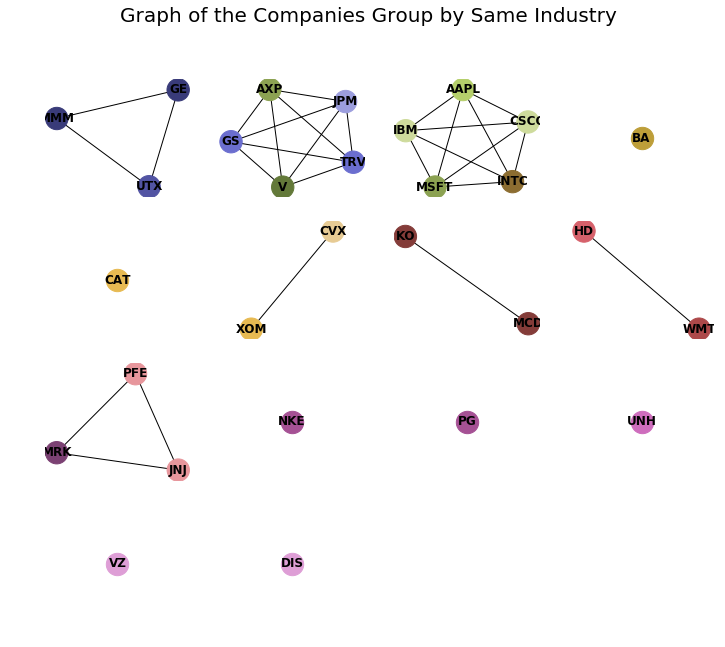

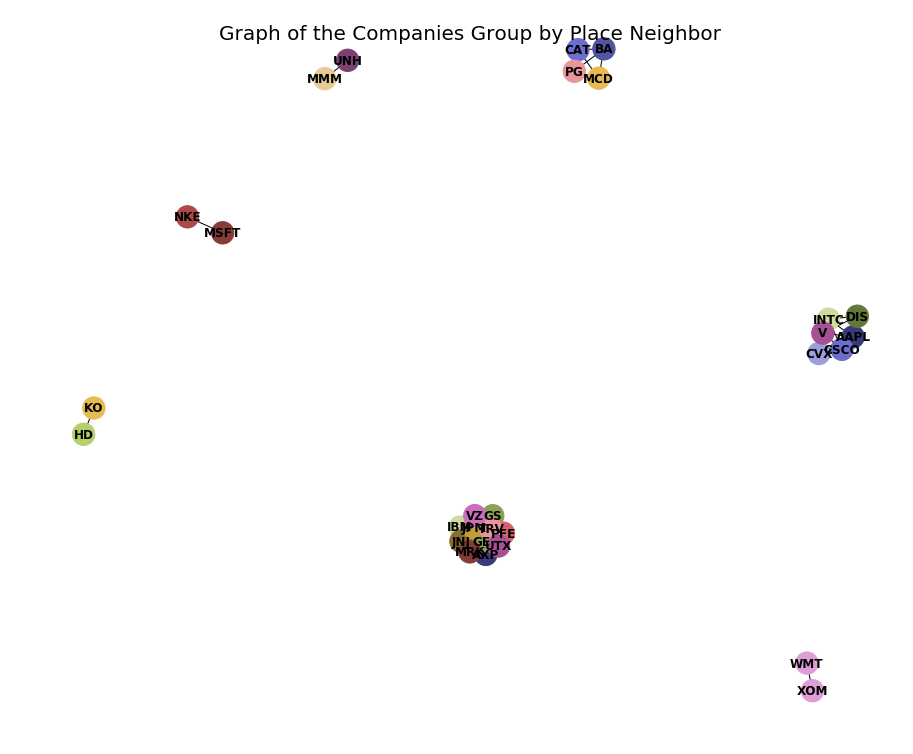

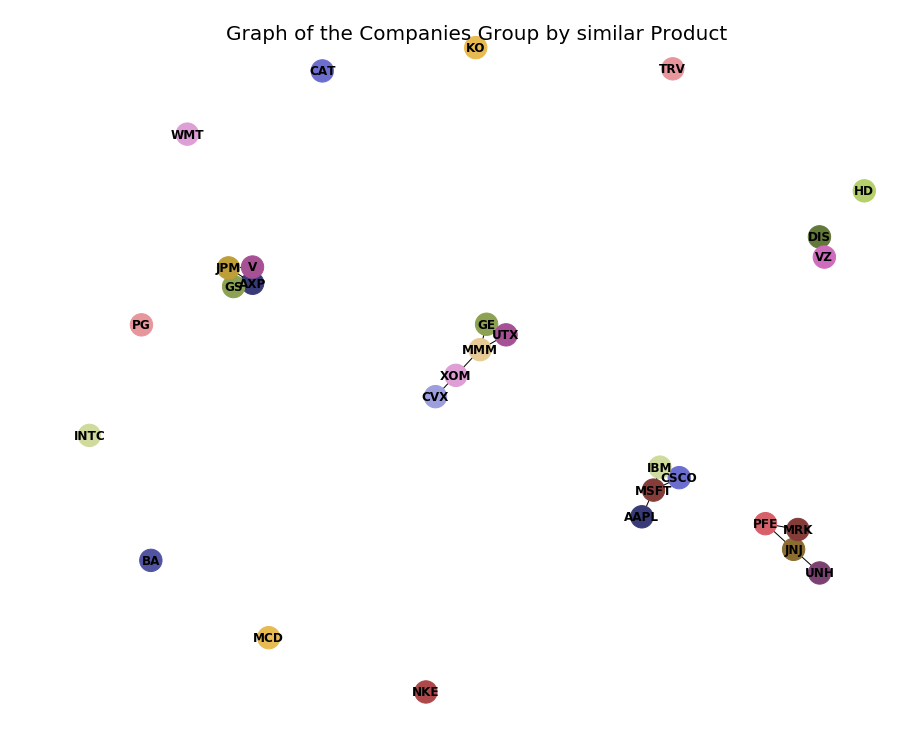

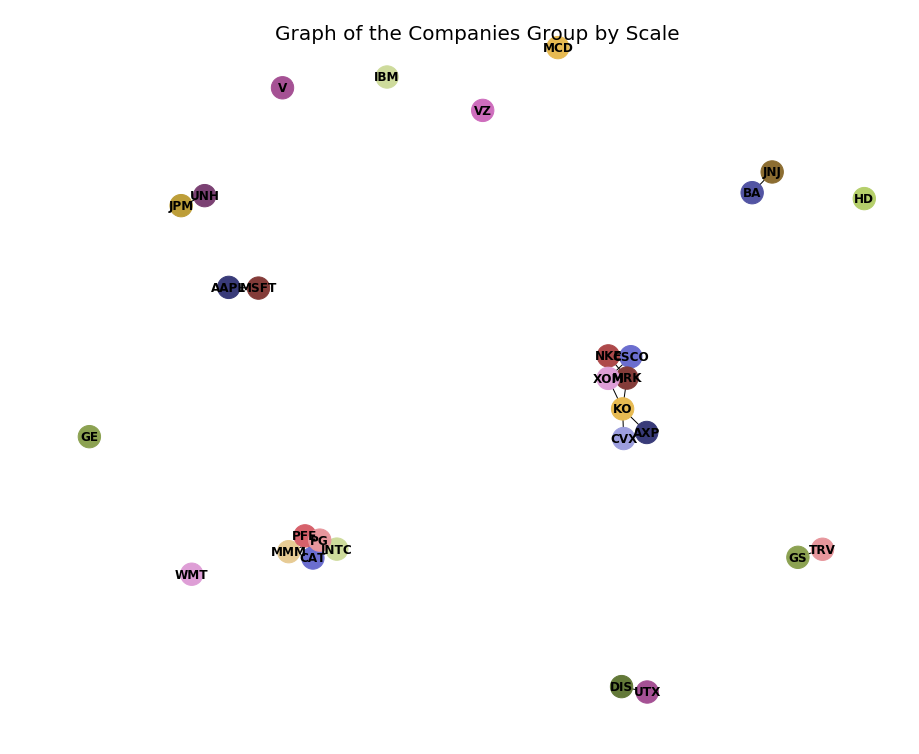

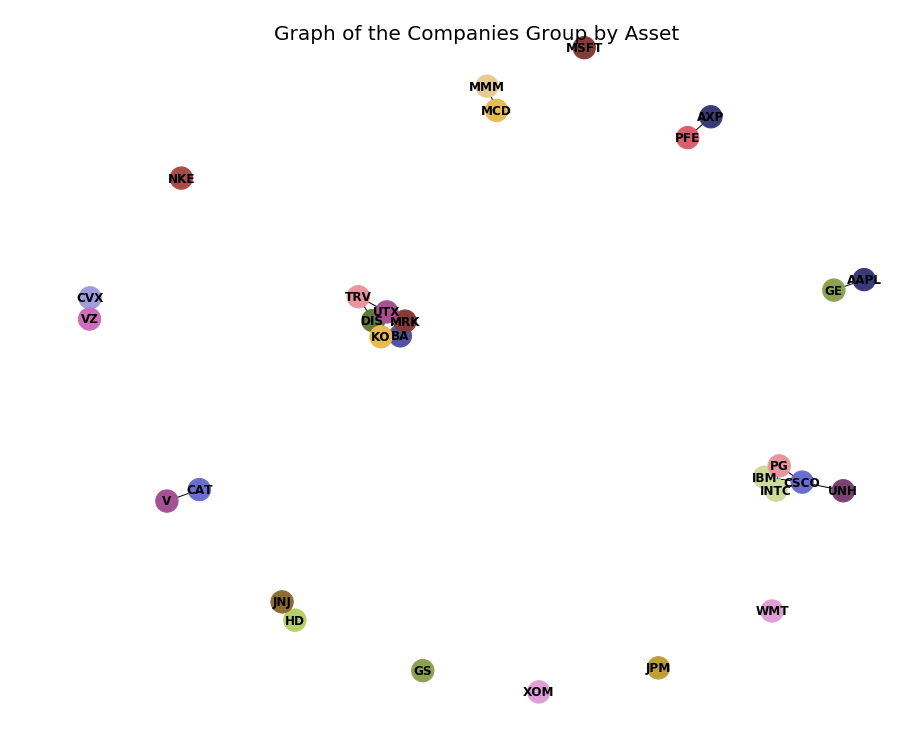

...

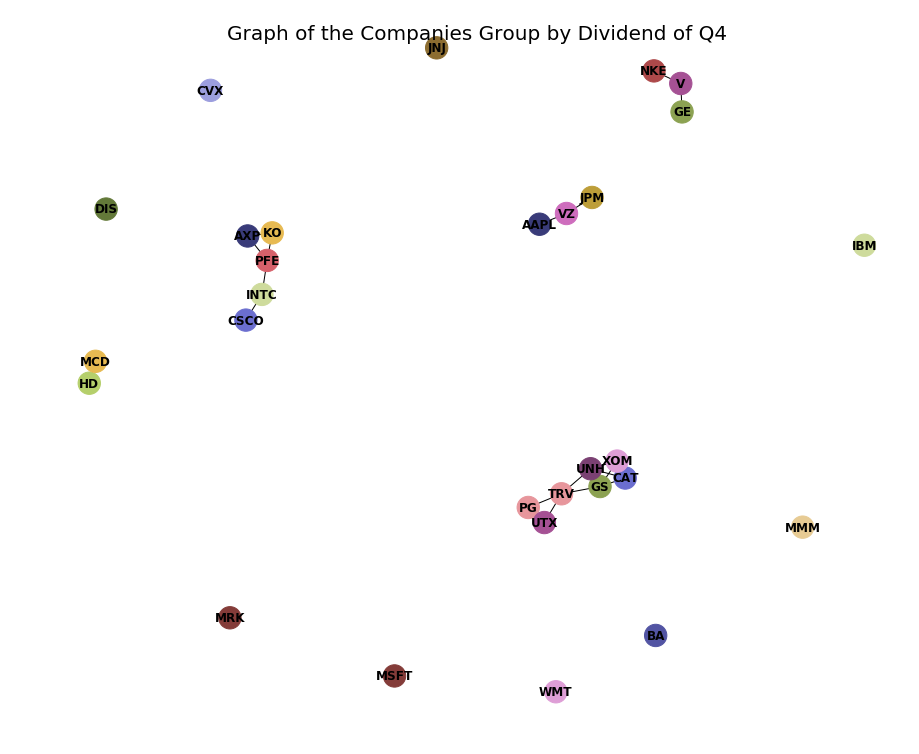

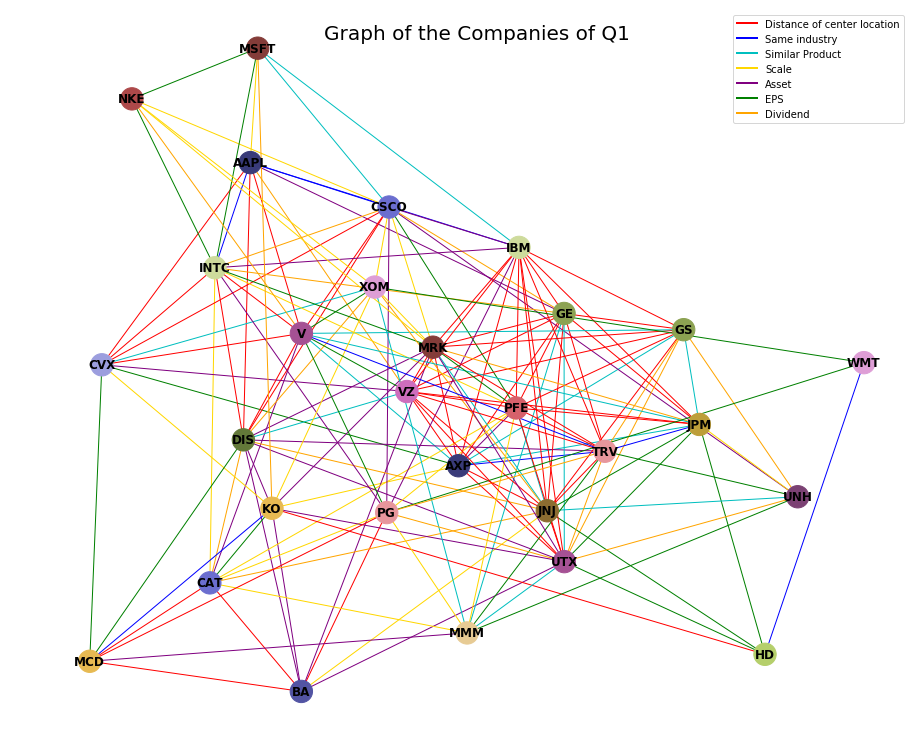

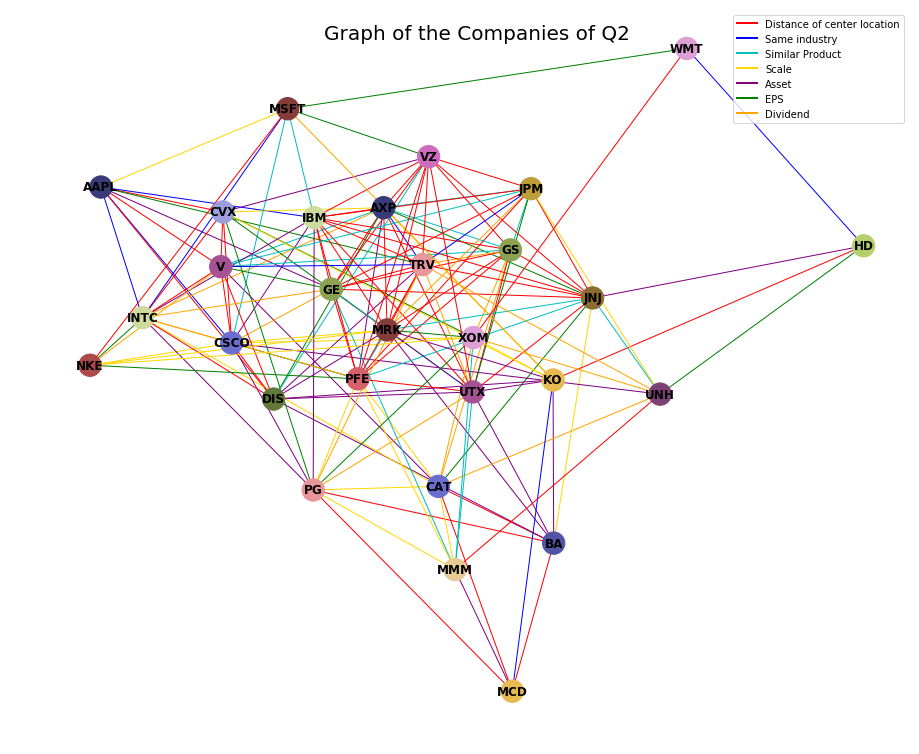

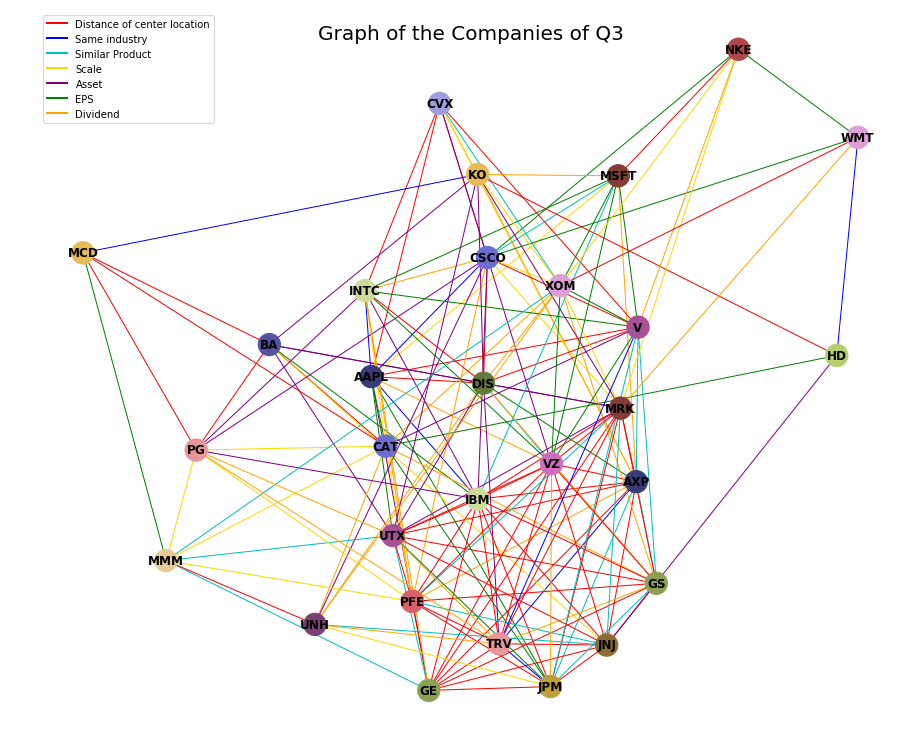

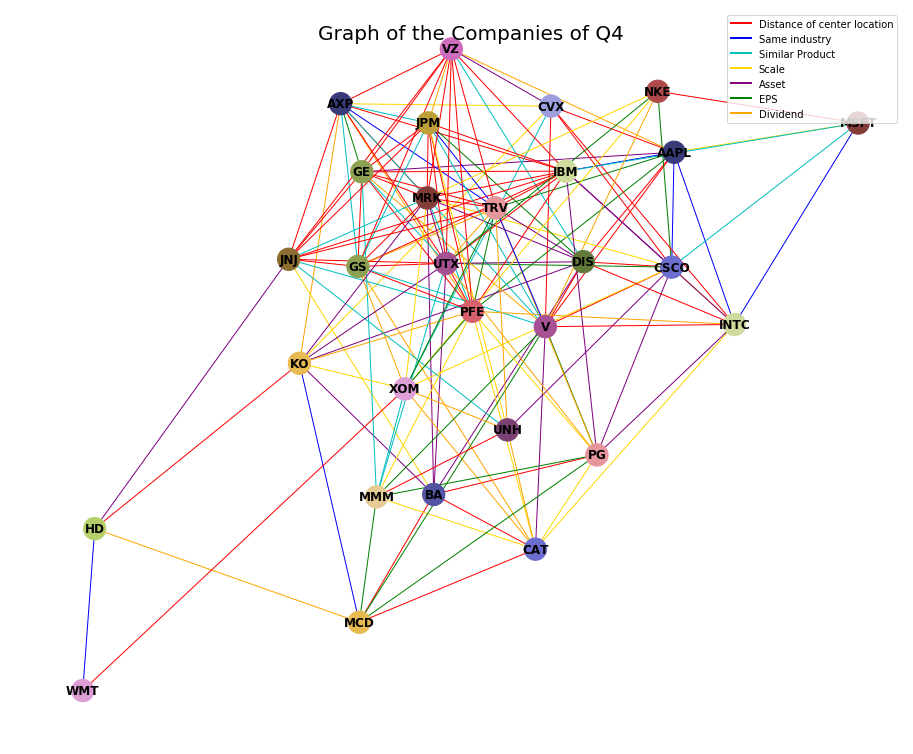

In [4]:
"""
# 建graph
"""
#==============================================================================
# 同產業者
#==============================================================================
G = nx.Graph()
# add node
G.add_nodes_from(symbolsort)
# add edge
G.add_edges_from(edge_tuple_noorder)
cmap = plt.get_cmap('tab20b')   
colors = [cmap(i) for i in np.linspace(0, 1, len(symbol))]
#nx.draw(G, with_labels=True, font_weight='bold', node_color=colors, node_size = 500, linewidths = 1)
#plt.title("Companies with Same Industry Graph")
#plt.show()
count = 0
plt.figure(figsize=(12,10))
for i in range(len(industrySameList)):
    plt.subplot(4,4,int("{0}".format(i+1)))
    sub = G.subgraph(industrySameList[i])
    nx.draw(sub, with_labels=True, font_weight='bold', node_color=colors[count:count+len(industrySameList[i])], node_size = 500, linewidths = 1)
    count += len(industrySameList[i])
    #print(count)
plt.suptitle("Graph of the Companies Group by Same Industry", fontsize = 20)
plt.show()

#==============================================================================
# 地緣關係圖
#==============================================================================
G_np = nx.Graph()
# add node
G_np.add_nodes_from(symbolsort)
# add edge
if ll == 0:
    G_np.add_edges_from(allcomPlaceRelation)
else:
    G_np.add_edges_from(allcomPlaceRelation_ll)
cmap = plt.get_cmap('tab20b')   
colors = [cmap(i) for i in np.linspace(0, 1, len(symbol))]
plt.figure(figsize=(12,10))
nx.draw(G_np, with_labels=True, font_weight='bold', node_color=colors, node_size = 500, linewidths = 1)
plt.suptitle("Graph of the Companies Group by Place Neighbor", fontsize = 20)
plt.show()

# =============================================================================
# 產品關係圖
# =============================================================================
G_prod = nx.Graph()
# add node
G_prod.add_nodes_from(symbolsort)
# add edge
G_prod.add_edges_from(productRelation)
cmap = plt.get_cmap('tab20b')   
colors = [cmap(i) for i in np.linspace(0, 1, len(symbol))]
plt.figure(figsize=(12,10))
nx.draw(G_prod, with_labels=True, font_weight='bold', node_color=colors, node_size = 500, linewidths = 1)
plt.suptitle("Graph of the Companies Group by similar Product", fontsize = 20)
plt.show()

# =============================================================================
# 規模關係圖
# =============================================================================
G_scale = nx.Graph()
# add node
G_scale.add_nodes_from(symbolsort)
# add edge
G_scale.add_edges_from(scale_graph)
cmap = plt.get_cmap('tab20b')   
colors = [cmap(i) for i in np.linspace(0, 1, len(symbol))]
plt.figure(figsize=(12,10))
nx.draw(G_scale, with_labels=True, font_weight='bold', node_color=colors, node_size = 500, linewidths = 1)
plt.suptitle("Graph of the Companies Group by Scale", fontsize = 20)
plt.show()
# =============================================================================
# 資產關係圖
# =============================================================================
G_asset = nx.Graph()
# add node
G_asset.add_nodes_from(symbolsort)
# add edge
G_asset.add_edges_from(asset_graph)
cmap = plt.get_cmap('tab20b')   
colors = [cmap(i) for i in np.linspace(0, 1, len(symbol))]
plt.figure(figsize=(12,10))
nx.draw(G_asset, with_labels=True, font_weight='bold', node_color=colors, node_size = 500, linewidths = 1)
plt.suptitle("Graph of the Companies Group by Asset", fontsize = 20)
plt.show()
# =============================================================================
# EPS關係圖
# =============================================================================
for i in range(len(quarter)):
    G_eps = nx.Graph()
    # add node
    G_eps.add_nodes_from(symbolsort)
    # add edge
    G_eps.add_edges_from(eps_graph[eps_list[i]])
    cmap = plt.get_cmap('tab20b')   
    colors = [cmap(i) for i in np.linspace(0, 1, len(symbol))]
    plt.figure(figsize=(12,10))
    nx.draw(G_eps, with_labels=True, font_weight='bold', node_color=colors, node_size = 500, linewidths = 1)
    plt.suptitle("Graph of the Companies Group by EPS of %s" % quarter[i], fontsize = 20)
    plt.show()
# =============================================================================
# Dividend關係圖
# =============================================================================
for i in range(len(quarter)):
    G_dividend = nx.Graph()
    # add node
    G_dividend.add_nodes_from(symbolsort)
    # add edge
    G_dividend.add_edges_from(dividend_graph[dividend_list[i]])
    cmap = plt.get_cmap('tab20b')   
    colors = [cmap(i) for i in np.linspace(0, 1, len(symbol))]
    plt.figure(figsize=(12,10))
    nx.draw(G_dividend, with_labels=True, font_weight='bold', node_color=colors, node_size = 500, linewidths = 1)
    plt.suptitle("Graph of the Companies Group by Dividend of %s" % quarter[i], fontsize = 20)
    plt.show()

#==============================================================================
# 綜合起來
#==============================================================================
                 
#先針對同產業的edge處理成index
edge_tuple_noorder_index = []
for i in edge_tuple_noorder:
    edge_tuple_noorder_index.append((symbolsort.index(i[0]), symbolsort.index(i[1])))

nodelist = list(np.arange(29))
for k in range(len(quarter)):
    G_all = nx.Graph()
    #pos = nx.spring_layout(G_all)
    # add node
    G_all.add_nodes_from(symbolsort)
    if ll == 0:
        for i in range(len(allcomPlaceRelation)):
            G_all.add_edge(*allcomPlaceRelation[i], color = 'r', label = 'Distance of center location')
    else:
        for i in range(len(allcomPlaceRelation_ll)):
            G_all.add_edge(*allcomPlaceRelation_ll[i], color = 'r', label = 'Distance of center location')

    for j in range(len(edge_tuple_noorder)):  
        G_all.add_edge(*edge_tuple_noorder[j], color = 'b', label = 'Same industry')

    for j in range(len(productRelation)):  
        G_all.add_edge(*productRelation[j], color = 'c', label = 'Similar Product')

    for j in range(len(scale_graph)):  
        G_all.add_edge(*scale_graph[j], color = 'gold', label = 'Scale')

    for j in range(len(asset_graph)):  
        G_all.add_edge(*asset_graph[j], color = 'purple', label = 'Asset')

    for j in range(len(eps_graph[eps_list[k]])):  
        G_all.add_edge(*eps_graph[eps_list[k]][j], color = 'g', label = 'EPS')

    for j in range(len(dividend_graph[dividend_list[k]])):  
        G_all.add_edge(*dividend_graph[dividend_list[k]][j], color = 'orange', label = 'Dividend')


    #G_all.add_edges_from(allcomPlaceRelation, colors = 'r')
    #G_all.add_edges_from(edge_tuple_noorder, colors = 'g')
    plt.figure(figsize=(12,10))

    cmap = plt.get_cmap('tab20b')
    colors = [cmap(i) for i in np.linspace(0, 1, len(symbol))]
    edges = G_all.edges()
    edge_colors = [G_all[u][v]['color'] for u,v in edges]
    nx.draw(G_all, with_labels=True, font_weight='bold', node_color=colors, edge_color = edge_colors, node_size = 500, linewidths = 1)
    #nx.draw_networkx_edges(G_all, pos,
    #                       edgelist = edge_tuple_noorder_index,
    #                       width=8, alpha=0.5, edge_color='r')
    #nx.draw_networkx_edges(G_all, pos,
    #                       edgelist = allcomwithNeighborindex,
    #                       width=8, alpha=0.5, edge_color='b')

    #labels = {}
    #for i in range(len(symbolsort)):
    #    labels[i] = symbolsort[i]
    #nx.draw_networkx_labels(G_all, pos, labels, font_size = 16)

    labels = ['Distance of center location', 'Same industry', 'Similar Product', 'Scale', 'Asset', 'EPS', 'Dividend']
    c_edge = ['r', 'b', 'c', 'gold', 'purple', 'g', 'orange']
    legend_elements = [Line2D([0], [0], color=c_edge[i], lw=2, label=labels[i]) for i in range(len(labels))]

    plt.axis('Off')
    plt.suptitle("Graph of the Companies of %s" % quarter[k], fontsize = 20)
    plt.legend(handles=legend_elements)
    plt.show()

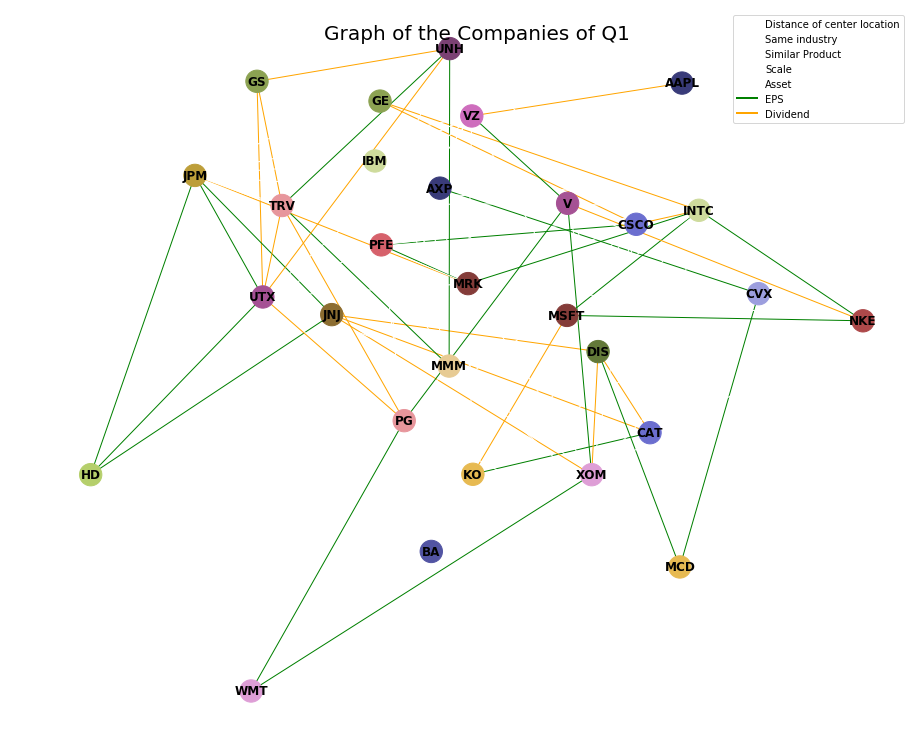

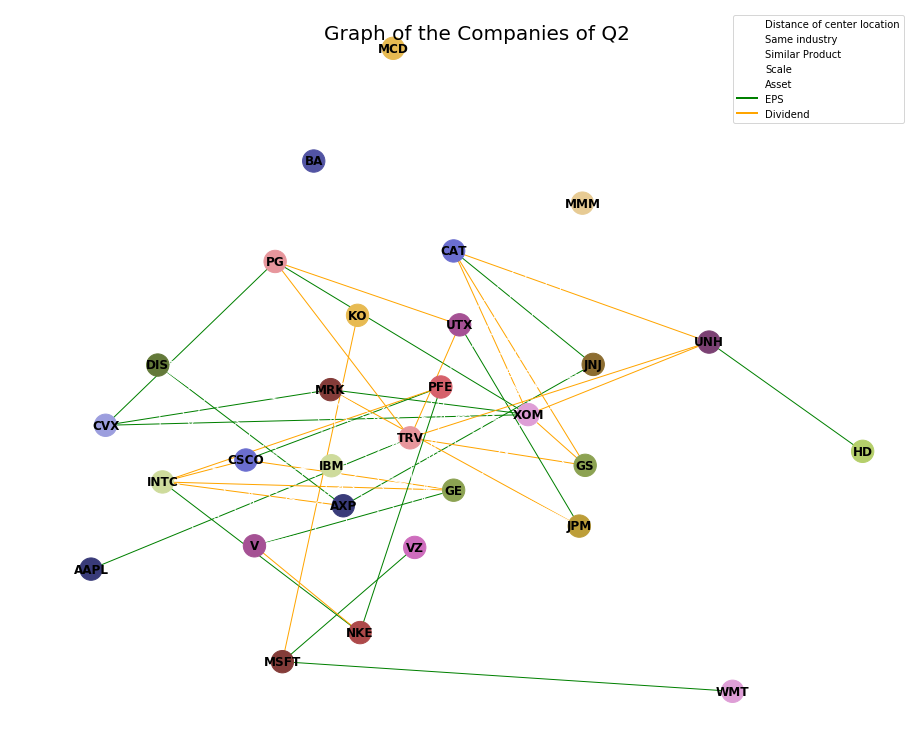

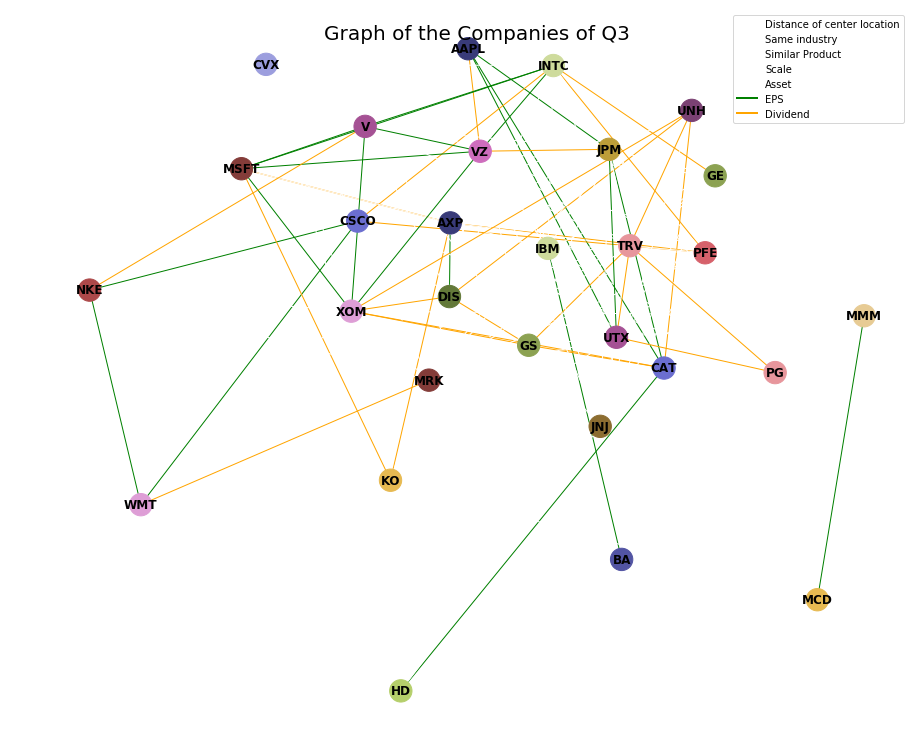

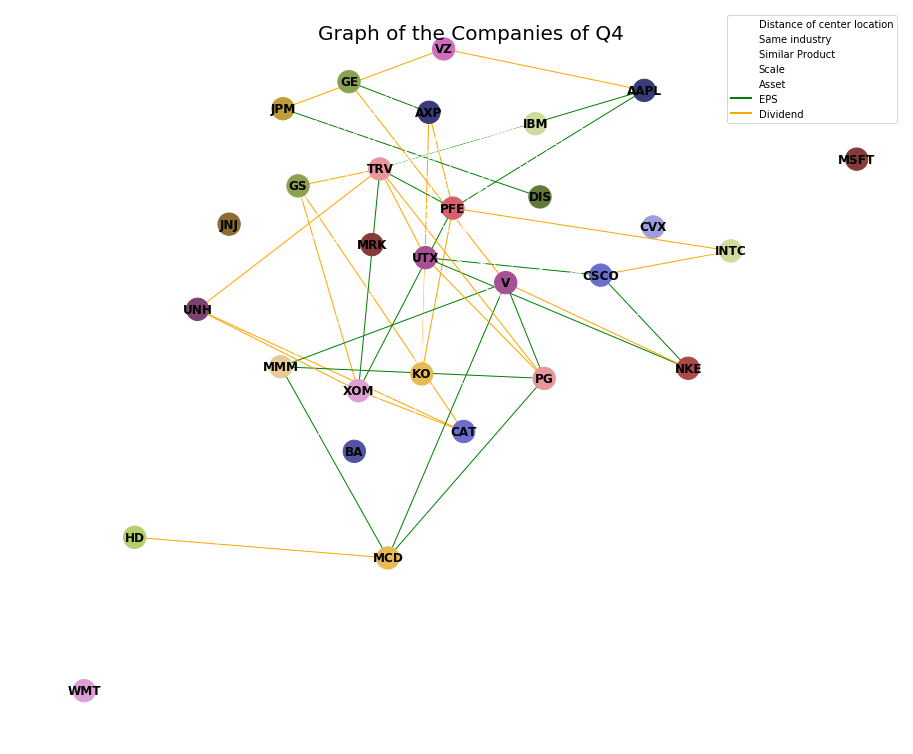

In [5]:
# 加了mask的graph示意圖，可以看一下EPS和Dividend的變化
for k in range(len(quarter)):
    G_all = nx.Graph()
    #pos = nx.spring_layout(G_all)
    # add node
    G_all.add_nodes_from(symbolsort)
    if ll == 0:
        for i in range(len(allcomPlaceRelation)):
            G_all.add_edge(*allcomPlaceRelation[i], color = 'w', label = 'Distance of center location')
    else:
        for i in range(len(allcomPlaceRelation_ll)):
            G_all.add_edge(*allcomPlaceRelation_ll[i], color = 'w', label = 'Distance of center location')

    for j in range(len(edge_tuple_noorder)):  
        G_all.add_edge(*edge_tuple_noorder[j], color = 'w', label = 'Same industry')

    for j in range(len(productRelation)):  
        G_all.add_edge(*productRelation[j], color = 'w', label = 'Similar Product')

    for j in range(len(scale_graph)):  
        G_all.add_edge(*scale_graph[j], color = 'w', label = 'Scale')

    for j in range(len(asset_graph)):  
        G_all.add_edge(*asset_graph[j], color = 'w', label = 'Asset')

    for j in range(len(eps_graph[eps_list[k]])):  
        G_all.add_edge(*eps_graph[eps_list[k]][j], color = 'g', label = 'EPS')

    for j in range(len(dividend_graph[dividend_list[k]])):  
        G_all.add_edge(*dividend_graph[dividend_list[k]][j], color = 'orange', label = 'Dividend')


    #G_all.add_edges_from(allcomPlaceRelation, colors = 'r')
    #G_all.add_edges_from(edge_tuple_noorder, colors = 'g')
    plt.figure(figsize=(12,10))

    cmap = plt.get_cmap('tab20b')
    colors = [cmap(i) for i in np.linspace(0, 1, len(symbol))]
    edges = G_all.edges()
    edge_colors = [G_all[u][v]['color'] for u,v in edges]
    nx.draw(G_all, with_labels=True, font_weight='bold', node_color=colors, edge_color = edge_colors, node_size = 500, linewidths = 1)
    #nx.draw_networkx_edges(G_all, pos,
    #                       edgelist = edge_tuple_noorder_index,
    #                       width=8, alpha=0.5, edge_color='r')
    #nx.draw_networkx_edges(G_all, pos,
    #                       edgelist = allcomwithNeighborindex,
    #                       width=8, alpha=0.5, edge_color='b')

    #labels = {}
    #for i in range(len(symbolsort)):
    #    labels[i] = symbolsort[i]
    #nx.draw_networkx_labels(G_all, pos, labels, font_size = 16)

    labels = ['Distance of center location', 'Same industry', 'Similar Product', 'Scale', 'Asset', 'EPS', 'Dividend']
    c_edge = ['w', 'w', 'w', 'w', 'w', 'g', 'orange']
    legend_elements = [Line2D([0], [0], color=c_edge[i], lw=2, label=labels[i]) for i in range(len(labels))]

    plt.axis('Off')
    plt.suptitle("Graph of the Companies of %s" % quarter[k], fontsize = 20)
    plt.legend(handles=legend_elements)
    plt.show()

In [6]:
"""""""""""""""""""""
參數設定
"""""""""""""""""""""
"""""""""
Pre-process
"""""""""
day = 180
input_length = 360    # 每一個frame所處理的時間長度，5分鐘
shift_length = 150   # 每一次shift多少時間的資料
v_length = 300    # 每一個V的時間長度
input_length = v_length + shift_length
period = [6,7,8,9,10,11]
#period = [1]
# 控制embedding或onehot
question = "onehot"
# 用另一種embedding方式
split_comques = 1
# qa_save那個function要不要用
generateAndsave = 1
temp_c = ["AAPL", "MSFT", "IBM", "INTC", "CSCO"]
# 29間公司全下
temp_c = symbolsort
question_type = ['Pairwise Price Change', 'Strength', 'Volatility']
qtype = question_type
answer_type = ['NoChange','BothRise','BothFall','Reverse','Same','Strong','Weak','Same','Big','Small']

"""""""""
Train and Validation
"""""""""
# 控制要不要存檔，1 : Yes, 0 : No
save = 1
epochs = 50
batch_size = 100
# Earlystopping參數
patience = 20
efficient_v = 1
cuda = 1
lr_rate = 8e-5
#lr_rate = 3e-6
verbal = 1
balance_class = 1
show_shape = 0
show_layer = 1
embedding_method = 'gru_2'

"""""""""
Network parameter
"""""""""
metricsmode = "cate_acc"
n_split = 0.05
lstm_unit = 16
MLP_unit = 32
out_dim = len(answer_type)
n_steps = 4
# GRU state
state_dim = 64
conv_dim = 16
n_node = len(temp_c)
if question == "embedd":
    question_dim = 3
else:
    question_dim = int(len(temp_c)*2+len(qtype))
annotation_dim = 1
split_question = 1
attention = 1
# Number of head attentions
nheads = 2
edgetypeShape = int(adjacency_matrix_Edge_dict['Q1'].shape[1] / adjacency_matrix_Edge_dict['Q1'].shape[0])
"""""""""""""""
Testing
"""""""""""""""
day_test = 30
period_test = [12]


In [7]:
# 建一個以時間為index的開高低收量表
def time_table(data):
    table = pd.DataFrame(columns = ['SIZE','PRICE'])
    table.SIZE = data['SIZE']
    table.PRICE = data['PRICE']
    table = table.set_index(data.TIME)
    
    cols = ['size','open', 'high', 'low', 'close']
    adjTable = pd.DataFrame(columns = cols)
    
    #把millisecond統合起來變成second data，開高低收
    price = table.PRICE.resample('1S',how = 'ohlc')
    presize = table.groupby(pd.TimeGrouper('1S')).aggregate(np.sum)
    
    #美股開收盤是9:30-16:00，不用考慮日光節約時間(因為wrds有先處理完了)
    start = datetime.time(9,30,0)
    end = datetime.time(15,59,59)
    price = price.between_time(start, end)
    presize = presize.between_time(start, end)
    
    #對有空值的秒數進行處理
    mask_fill = pd.isnull(price.close)    #先存下close有nan的boolean
    price = price.fillna(method = 'ffill')
    
    #把有nan的項全部改成 == 前一筆close price
    price.loc[mask_fill, 'open'] = price.close
    price.loc[mask_fill, 'high'] = price.close
    price.loc[mask_fill, 'low'] = price.close
    
    #合成新表
    adjTable = price
    adjTable.insert(0, 'size', presize.SIZE)
    adjTable = adjTable[adjTable.index.dayofweek < 5]
    
    return adjTable

# 用來算Return，有處理跨日的問題
def cal_return(data, period, return_date = 0):
    date = []
    current_year_str = str(data.index[0].year)
    for month in period: #要處理的所有月份
        month_data = data[current_year_str + '/' + str(month)] #抓出特定月份的資料
        stop_date = month_data.index[-1].date() + pd.to_timedelta(1, 'D') #跑到該月最後一天有資料的日子
        current_date = month_data.index[0].date() #目前在處理的日期
        while(current_date != stop_date):
            current_price = month_data[str(current_date)]#目前日期的資料都抓出來
            if (len(current_price) == 0) or (len(current_price[current_price['size']!=0]) == 0):#數到周休(空資料)或休市日(有資料但size都是0)
                current_date += pd.to_timedelta(1, 'D')
                continue
                
            # 回傳時間戳記
            if return_date == 1:
                date.append(current_date)
            
            close_price = np.array(current_price['close'])
            current_price = np.insert(close_price,0,0) #前補0
            after_price = np.append(close_price, 0) #後補0
            """subtract return"""
            subReturn = after_price - current_price    #後一秒(after_price) - 前一秒(current_price)
            subReturn = np.delete(subReturn, [0, len(subReturn)-1])   #去除最頭最尾
            """log return"""
            logReturn = np.log(after_price / current_price)    #後一秒(after_price) / 前一秒(current_price)取log
#            logReturn = np.log(after_price) - np.log(current_price)
            logReturn = np.delete(logReturn, [0, len(logReturn)-1])   #去除最頭最尾
            
            if month == period[0] and current_date == month_data.index[0].date():
                all_return_data = np.array([subReturn])
                all_price_data = np.array([close_price])
            else:
                all_return_data = np.vstack((all_return_data, [subReturn]))
                all_price_data = np.vstack((all_price_data, [close_price]))
            current_date += pd.to_timedelta(1, 'D')
        
    if return_date == 0:    
        return all_price_data, all_return_data #回傳二維陣列，天數*每日的return
    else:
        return all_price_data, all_return_data, date

"""""""""
draw picture
"""""""""

def draw_losses(history, network = 'CNN', split_question = 0):
    # show loss
    plt.title('Loss - ' + network)
    if isinstance(history,dict):
        if isinstance(history['loss'],list):
            #loss = np.array(history['loss']).ravel()
            #v_loss = np.array(history['val_loss']).ravel()
            plt.plot(history['loss'], label='train')
            plt.plot(history['val_loss'], label='val') 
            plt.plot(history['test_loss'], label='test')
                
        else:
            plt.plot(history['loss'], label='train')
            plt.plot(history['val_loss'], label='val')
            plt.plot(history['test_loss'], label='test')
    else:
        plt.plot(history.history['loss'], label='train')
        plt.plot(history.history['val_loss'], label='val')
        plt.plot(history.history['test_loss'], label='test')
    plt.legend()
    plt.show()
    
def draw_acc(history, data = 0, network = 'CNN', split_question = 0):
    # show acc
    plt.title('Accuracy - ' + network)
    if isinstance(history,dict):
        if isinstance(history['acc'],list):
            plt.plot(history['acc'], label='train')
            plt.plot(history['val_acc'], label='val')
            plt.plot(history['test_acc'], label='test')
        else:
            plt.plot(history['acc'], label='train')
            plt.plot(history['val_acc'], label='val')
            plt.plot(history['test_acc'], label='test')
    else:
        plt.plot(history.history['acc'], label='train')
        plt.plot(history.history['val_acc'], label='val')
        plt.plot(history.history['test_acc'], label='test')
    if (data != 0):
        plt.plot(data[:len(acc)], label='allguest-0')
    plt.legend()
    plt.ylim(0, 1)
    plt.show()
    
def draw_splitQuestion_loss(history, network = 'CNN', split_question = 1, datasetType = "Train"):
    # show loss for each question
    plt.title('%s Loss - ' % datasetType + network)
    if datasetType == "Train":
        plt.plot(history['loss'], label = datasetType + "Total loss")
        plt.plot(history['loss_q1'], label = datasetType + "Q1 loss")
        plt.plot(history['loss_q2'], label = datasetType + "Q2 loss")
        plt.plot(history['loss_q3'], label = datasetType + "Q3 loss")
    elif datasetType == "Validation":
        plt.plot(history['val_loss'], label = datasetType + "Total loss")
        plt.plot(history['val_loss_q1'], label = datasetType + "Q1 loss")
        plt.plot(history['val_loss_q2'], label = datasetType + "Q2 loss")
        plt.plot(history['val_loss_q3'], label = datasetType + "Q3 loss")
    else:
        plt.plot(history['test_loss'], label = datasetType + "Total loss")
        plt.plot(history['test_loss_q1'], label = datasetType + "Q1 loss")
        plt.plot(history['test_loss_q2'], label = datasetType + "Q2 loss")
        plt.plot(history['test_loss_q3'], label = datasetType + "Q3 loss")
    plt.xlabel('Epoch')
    plt.legend()
    plt.show()

def draw_splitQuestion_acc(history, data = 0, network = 'CNN', split_question = 0, datasetType = "Train"):
    # show acc
    plt.title('%s Accuracy - ' % datasetType + network)
    if datasetType == "Train":
        plt.plot(history['acc'], label = datasetType + "Total acc")
        plt.plot(history['acc_q1'], label = datasetType + "Q1 acc")
        plt.plot(history['acc_q2'], label = datasetType + "Q2 acc")
        plt.plot(history['acc_q3'], label = datasetType + "Q3 acc")
    elif datasetType == "Validation":
        plt.plot(history['val_acc'], label = datasetType + "Total acc")
        plt.plot(history['val_acc_q1'], label = datasetType + "Q1 acc")
        plt.plot(history['val_acc_q2'], label = datasetType + "Q2 acc")
        plt.plot(history['val_acc_q3'], label = datasetType + "Q3 acc")
    else:
        plt.plot(history['test_acc'], label = datasetType + "Total acc")
        plt.plot(history['test_acc_q1'], label = datasetType + "Q1 acc")
        plt.plot(history['test_acc_q2'], label = datasetType + "Q2 acc")
        plt.plot(history['test_acc_q3'], label = datasetType + "Q3 acc")
    if (data != 0):
        plt.plot(data[:len(acc)], label='allguest-0')
    plt.xlabel('Epoch')
    plt.legend()
    plt.ylim(0, 1)
    plt.show()
    
def draw_predict(pre, y, title = 'Train', way = 'Regression', figsize = None):
    plt.figure(figsize = figsize)
    plt.plot(y,label = "real")
    plt.plot(pre,label = "predict")
    plt.title('Correlation Prediction for ' + title + ', ' + way)
    plt.xlabel('Seconds')
    plt.ylabel('Cross Correlation')
    plt.legend()
    plt.show()

def draw_price(price, figsize = None):
    plt.figure(figsize = figsize)
    for key, value in price.items() :
        plt.plot(price, label = key)
    plt.xlabel('Seconds')
    plt.ylabel('Price')
    plt.legend()
    plt.show()
    
def draw_roc(roc):
    plt.plot([0, 1], [0, 1], 'k--')
    plt.plot(roc["train_fpr"][-1], roc["train_tpr"][-1], label = "train_roc_score_" "%.4f" % roc["train_auc"][-1])
    plt.plot(roc["val_fpr"][-1], roc["val_tpr"][-1], label = "validation_roc_score_" + "%.4f" % roc["val_auc"][-1])
    if(len(roc["test_fpr"]) != 0):
        plt.plot(roc["test_fpr"][-1], roc["test_tpr"][-1], label = "test_roc_score_" + "%.4f" % roc["test_auc"][-1])
    plt.xlim([0.0, 1.0])
    plt.ylim([0.0, 1.0])
    plt.xlabel('False Positive Rate')
    plt.ylabel('True Positive Rate')
    plt.title('ROC Curve')
    plt.legend()
    plt.show()
    
# 用來顯示VQA的V
def visual_show(return_data, day = 0, time = 0, mode = 0):
    if return_data.shape[0] > return_data.shape[1]:
        return_data = return_data.transpose(1,0)
    plt.figure(figsize = (15,10))
    plt.suptitle('Visual for ' + str(len(return_data)) + ' companys', fontsize="x-large")
    number = len(return_data)
    cmap = plt.get_cmap('tab20b')
    colors = [cmap(i) for i in np.linspace(0, 1, number)]
    count = 1
    
    # mode == 0: 公司分開畫
    if mode == 0:
        # 根據輸入資料的資料型態做不同的設定
        if isinstance(return_data,dict):
            for key in return_data.keys():
                plt.subplot(5, 1, count)
                plt.plot(return_data[key][1][day,time:time+300-1], color = colors[count-1], label = key)
                plt.legend(loc = 1)
                count += 1
        else:
            for key in temp_c:
                plt.subplot(5, 1, count)
                plt.plot(return_data[count-1,:], color = colors[count-1], label = key)
                plt.legend(loc = 1)
                count += 1
    # mode == 1: 合起來畫
    else:
        # 根據輸入資料的資料型態做不同的設定
        if isinstance(return_data,dict):
            for key in return_data.keys():
                plt.plot(return_data[key][1][day,time:time+300-1], color = colors[count-1], label = key)
                count += 1
        else:
            for key in temp_c:
                plt.plot(return_data[count-1,:], color = colors[count-1], label = key)
                count += 1
        plt.legend(loc = 1)
        
    plt.show()
    
def companycode2str(code):
    return label_company[code]
#com1 = companycode2str(0)

def str2companycode(company):
    return {v: k for k, v in label_company.items()}[company]
#com1_code = str2companycode('AAPL')

def one_hot_company(label_company):
    d = {}
    temp = np.eye((len(label_company)), dtype = int)
    for i in range(len(label_company)):
        d[i] = temp[i]
    return d

# 根據公司數來建立一個與公司名字相對應的label
label_company = {}    #0:AAPL
for i in range(len(temp_c)):
    label_company[i] = temp_c[i]

# 每一間公司轉one-hot的結果
onehotCompany = one_hot_company(label_company)

def question2onehot(array):
    c1 = [onehotCompany[k] for k in array[:,0]]
    c2 = [onehotCompany[l] for l in array[:,1]]
    q = [onehotQuestion[m] for m in array[:,2]]
    return np.concatenate((c1, c2, q), axis = 1)

"""
這邊要改成預測問題(V300秒然後A是下60秒的漲跌幅、強弱勢、波動程度、風險之類的)
所以V前處理時一次取360秒然後切300,60當作V和A的根據
這邊的overlap用60秒，也就是[0,360],[60,420],[120,480]...
"""
def set_question(com1, com2, condition):
    # set condition
    def set_question_type():
        # 目前問題設定只有四種設定：同漲(br)-0、同跌(bf)-1、反向(r)-2、不變(nc)-3
        # 2/8 改成三種問題，問漲跌、問強弱勢、問波動率
        if question == "embedd":
            d = {v: k for k, v in word_bag.items() if v in question_type}
        else:
            tmp = np.eye((len(question_type)))
            #d = {0:tmp[0],1:tmp[1],2:tmp[2]}
            d = {}
            for i in range(len(question_type)):
                d[i] = tmp[i]
        return d
    # 拼接問題
    if question == "embedd":
        return np.concatenate(([str2companycode(com1)], [str2companycode(com2)], [condition]))
    else:   # 若是one-hot
        return np.concatenate((onehotCompany[str2companycode(com1)], onehotCompany[str2companycode(com2)], set_question_type()[condition]))

def set_question_pair(data, all_com_pair):
    q_pair = {}
    
    # question_type (目前有四種小問題：同漲、同跌、反向或不變)
    # 1/2更新，變成4種問題 (問Query主體漲跌、問成對漲跌趨勢、問強弱勢、問波動率)
    # 2/8更新，變成3種問題 (問成對漲跌趨勢、問強弱勢、問波動率)
    for i in range(len(question_type)):
        tmp_q = []
        
        # 這裡的count用來表示各問題的index
        if question == "embedd":
            if split_comques == 0:
                count = i + len(label_company)
            else:
                count = i
        else:
            count = i
        
        # 塞question pairs
        for j in range(len(all_com_pair)):
            tmp_q.append(set_question(all_com_pair[j][0], all_com_pair[j][1], count))
        q_pair[i] = tmp_q
        
    return q_pair

def set_answer_pair(data, trend_data, all_com_pair):
    a_pair = {}
    
    """
    # 舊寫法，比較return的結果
    # 把data加總判斷是漲是跌
    if(data.shape[0] > data.shape[1]):
        v_trend = np.sum(data, axis = 0)
    else:
        v_trend = np.sum(data, axis = 1)
    """
        
    # 新寫法，直接把answer判定依據的第一秒與最後一秒價格取出來
    # 分別計算漲跌、漲跌幅、標準差
    """
    # 其實trend_data[0] + np.sum(data, axis = 0) 等同 trend_data[1]
    """
    # 計算漲跌幅
    if(trend_data.shape[0] > trend_data.shape[1]):
        trend_data_t = trend_data.transpose(1,0)
        v_trend = (trend_data_t[1] - trend_data_t[0]) / trend_data_t[0]
    else:
        v_trend = (trend_data[1] - trend_data[0]) / trend_data[0]
    
    # 計算標準差
    if(data.shape[0] > data.shape[1]):
        data_t = data.transpose(1,0)
        v_std = np.std(data_t, axis = 1)
    else:
        v_std = np.std(data, axis = 1)
    
    # question_type (目前有四種小問題：同漲、同跌、反向或不變)
    # 1/2更新，變成3種問題(問漲跌(問成對漲跌趨勢)、問強弱勢、問波動率)
    #   把前面公司當作Query主體，問強弱勢和波動率要比較的一定會用到
    #   答案格式為：[同漲, 同跌, 反向, 不變, 強勢, 弱勢, 大, 小]
    # 2/8更新，變成3種問題(問漲跌(問成對漲跌趨勢)、問強弱勢、問波動率)
    #   把前面公司當作Query主體，問強弱勢和波動率要比較的一定會用到
    #   答案格式為：[同漲, 同跌, 反向, 不變, 強勢, 弱勢 , 相同, 大, 小, 相同]
    # 7/8更新，把所有不變或者相同擺到第一個位置以防後面切問題出錯
    #   答案格式為：[不變, 同漲, 同跌, 反向, 相同, 強勢, 弱勢, 相同, 大, 小]
    for i in range(len(question_type)):
        tmp_a = []
        
        # 塞answer pairs
        if(i == 0): # 第一種問題 (問漲跌)
            for j in range(len(all_com_pair)):
                # 同漲
                if(v_trend[str2companycode(all_com_pair[j][0])] > 0 and v_trend[str2companycode(all_com_pair[j][1])] > 0):
                    #tmp_a.append(np.array([1,0,0,0,0,0,0,0,0,0]))
                    tmp_a.append(np.array([0,1,0,0,0,0,0,0,0,0]))
                # 同跌
                elif(v_trend[str2companycode(all_com_pair[j][0])] < 0 and v_trend[str2companycode(all_com_pair[j][1])] < 0):
                    #tmp_a.append(np.array([0,1,0,0,0,0,0,0,0,0]))
                    tmp_a.append(np.array([0,0,1,0,0,0,0,0,0,0]))
                # 反向
                elif((v_trend[str2companycode(all_com_pair[j][0])] > 0 and v_trend[str2companycode(all_com_pair[j][1])] < 0) or\
                (v_trend[str2companycode(all_com_pair[j][0])] < 0 and v_trend[str2companycode(all_com_pair[j][1])] > 0)):
                    #tmp_a.append(np.array([0,0,1,0,0,0,0,0,0,0]))
                    tmp_a.append(np.array([0,0,0,1,0,0,0,0,0,0]))
                # 不變
                else:
                    #tmp_a.append(np.array([0,0,0,1,0,0,0,0,0,0]))
                    tmp_a.append(np.array([1,0,0,0,0,0,0,0,0,0]))
                    
                    
        elif(i == 1): # 第二種問題 (問強弱勢)
            for j in range(len(all_com_pair)):
                query_c = v_trend[str2companycode(all_com_pair[j][0])]
                another_c = v_trend[str2companycode(all_com_pair[j][1])]
                # Query主體比另一間強勢
                if(query_c > another_c):
                    #tmp_a.append(np.array([0,0,0,0,1,0,0,0,0,0]))
                    tmp_a.append(np.array([0,0,0,0,0,1,0,0,0,0]))
                # Query主體比另一間弱勢    
                elif (query_c < another_c):
                    #tmp_a.append(np.array([0,0,0,0,0,1,0,0,0,0]))
                    tmp_a.append(np.array([0,0,0,0,0,0,1,0,0,0]))
                # 2/8 新增兩者相同
                else:
                    #tmp_a.append(np.array([0,0,0,0,0,0,1,0,0,0]))
                    tmp_a.append(np.array([0,0,0,0,1,0,0,0,0,0]))
                    
                    
        elif(i == 2): # 第三種問題 (問波動率)
            for j in range(len(all_com_pair)):
                query_c = v_std[str2companycode(all_com_pair[j][0])]
                another_c = v_std[str2companycode(all_com_pair[j][1])]
                # Query主體比另一間波動率大
                if (query_c > another_c):
                    #tmp_a.append(np.array([0,0,0,0,0,0,0,1,0,0]))
                    tmp_a.append(np.array([0,0,0,0,0,0,0,0,1,0]))
                # Query主體比另一間波動率小
                elif (query_c < another_c):
                    #tmp_a.append(np.array([0,0,0,0,0,0,0,0,1,0]))
                    tmp_a.append(np.array([0,0,0,0,0,0,0,0,0,1]))
                # 2/8 新增兩者相同
                else:
                    #tmp_a.append(np.array([0,0,0,0,0,0,0,0,0,1]))
                    tmp_a.append(np.array([0,0,0,0,0,0,0,1,0,0]))

        a_pair[i] = tmp_a
        
    return a_pair

def set_question_and_answer_pair(train_data, answer_data, answer_trend_data, all_com_pair):
    vqa_pair = []
    
    for i in range(train_data.shape[0]):
        vqa_pair.append((train_data[i],set_question_pair(train_data[i], all_com_pair),set_answer_pair(answer_data[i], answer_trend_data[i], all_com_pair), answer_data[i], answer_trend_data[i]))
    
    return vqa_pair

def set_vqa_efficient(input_data, answer_data, answer_trend_data, all_com_pair, q_ind, index):
    a_pair = set_answer_pair(answer_data, answer_trend_data, all_com_pair)
    a_ind = []
    for i in range(len(a_pair)):
        for value in a_pair[i]:
            a_ind.append(value)
    a_ind = np.vstack(a_ind)
    a_ind = np.vstack(a_ind)
    
    return (input_data, q_ind[index], a_ind[index], answer_data, answer_trend_data)

In [8]:
#==============================================================================
# Training data preprocess
#==============================================================================
djia30 = os.listdir('djia30')
data30 = {}
# 所有公司
#temp_c = [c.split('.')[0] for c in djia30]
## 刪去DD跟DWDP這兩間公司的資料
#remove = ['DD','DWDP']
#temp_c = [x for x in temp_c if x not in remove]
temp = [c for c in djia30 if any(tc in c for tc in temp_c)]
company_num = len(temp_c)

print("--------Training data preprocess--------")
print('Loading raw data...')
for file_name in temp:
    print("[" + file_name.split(".")[0] + "]")
    data30[file_name.split(".")[0]] = pd.read_pickle('/mnt/sda1/chia/djia30/' + file_name)
'''
# 先把交易量存起來以後可以用
trading_amount = {}
for company in temp_c:
    trading_amount[company] = np.array(data30[company]['size'])
'''

# 計算每秒的return及price
price_and_return = {}
for company in temp_c:   
    print('Calculate return and price of ' + company)
    # 計算價格、價差(跟spread好像是不同概念，這裡指的是後-前)
    price_data, return_data = cal_return(data30[company], period=period)
    # 算漲跌幅 (return，(後-前)/前)
    # 同義於 np.diff(price_data[0,:]) / price_data[0,:-1]
    change_data = return_data / price_data[:,:-1]
    price_data = np.float16(price_data)
    return_data = np.float16(return_data)
    change_data = np.float16(change_data)
    # 取需要的資料量
    price_and_return[company] = [price_data[:day], return_data[:day], change_data[:day]]

# 用來確認實際餵入的天數
day = price_and_return[company][0].shape[0]

# 放出data30的記憶體避免後面np.repeat memory error
del data30

# 處理V最重要的幾行code
visual_data = {}    #20個(78,5,299)，也就是說共有20個交易日，5間公司每300秒的收益
for i in range(day):
    # 無overlap
#    c = int(price_data.shape[1]/input_length)
    # 有overlap
    c = int((price_data.shape[1]-input_length)/shift_length)+1
    
    tmp = np.zeros((c,company_num,input_length-1))
    for j in range(c):
        count = 0
        for company in temp_c:
            # 無overlap
#            tmp[j][count] = price_and_return[company][1][i,j*input_length:(j+1)*input_length-1]
            # 有overlap
            tmp[j][count] = price_and_return[company][1][i,j*shift_length:(input_length+(j*shift_length))-1]
            count += 1
    visual_data[i] = tmp
print("[Split data finish !]")

# 把所有切好的data stack成training dataset
train_data = np.vstack(visual_data.values())    #(?,5,299)
# 第九間公司的某一筆資料出現nan先以補0處理
#train_data[np.argwhere(np.isnan(train_data))[0,0], np.argwhere(np.isnan(train_data))[0,1], np.argwhere(np.isnan(train_data))[0,2]] = 0
train_data = train_data.transpose(0,2,1)    #把後面兩個維度交換 (?,299,5)
train_data, answer_data = train_data[:,:v_length-1,:], train_data[:,v_length:,:]
train_data = train_data.transpose(0,2,1) #(?,5,299)
answer_data = answer_data.transpose(0,2,1) #(?,5,59)
#visual_show(train_data[1], day = 0, time = 0)
print("[Training and answer data finish !]")

# trend data
trend_data = {}    #20個(78,5,2)，也就是說共有20個交易日，5間公司第一秒和最後一秒的價格
for i in range(day):
    # 無overlap
#    c = int(price_data.shape[1]/input_length)
    # 有overlap
    c = int((price_data.shape[1]-input_length)/shift_length)+1
    
    tmp = np.zeros((c,company_num,2))
    for j in range(c):
        count = 0
        for company in temp_c:
            # 無overlap
#            tmp[j][count] = price_and_return[company][1][i,j*input_length:(j+1)*input_length-1]
            # 有overlap
            #tmp[j][count] = price_and_return[company][0][i,[j*shift_length+v_length,(input_length+(j*shift_length))-1]]
            tmp[j][count] = np.float16(price_and_return[company][0][i,[j*shift_length+v_length,(input_length+(j*shift_length))-1]])
            count += 1
    trend_data[i] = tmp

# 20個(78,5,第一秒和第60秒的價格共兩個值)
answer_trend_data = np.vstack(trend_data.values())    # (?,5,2)
answer_trend_data = answer_trend_data.transpose(0,2,1)    # 把後面兩個維度交換 (?,2,5)
print("[Target trend data finish !]")

# 根據公司數來建立一個與公司名字相對應的label
label_company = {}    #0:AAPL
for i in range(len(temp_c)):
    label_company[i] = temp_c[i]
    
# 每一間公司轉one-hot的結果
onehotCompany = one_hot_company(label_company)

# 建立embedding版本所需的dict
if split_comques == 0: #公司和問題一起建字典
    word_bag = label_company.copy()
    for i in range(len(question_type)):
        word_bag[i+len(label_company)] = question_type[i]
else: # 公司和問題分開建字典
    q_company = label_company.copy()
    q_qtype = {}
    for i in range(len(question_type)):
        q_qtype[i] = question_type[i]

    # 每一個問題轉one-hot的結果 (one_hot_company function就可以處理)
    onehotQuestion = one_hot_company(q_qtype)

# 窮舉所有公司pair(C5取2)    
all_com_pair = list(combinations(temp_c,2))
# 窮舉所有公司組合(P5取2，包含反向)
all_com_pair_P = list(permutations(temp_c,2))
print("Number of permutations : ", len(all_com_pair_P))

# 這裡為了簡化計算需求，就直接把Q1-Q4的EPS和Dividend相加取平均就好
adjacency_matrix_Edge = np.zeros_like(adjacency_matrix_Edge_dict["Q1"])

for m in period:
    adjacency_matrix_Edge += adjacency_matrix_Edge_dict[quarter_month[m]]
    
adjacency_matrix_Edge = adjacency_matrix_Edge / 6

--------Training data preprocess--------
Loading raw data...
[PFE]
[JNJ]
[BA]
[CAT]
[MSFT]
[DIS]
[TRV]
[GS]
[HD]
[KO]
[MRK]
[XOM]
[MMM]
[IBM]
[CSCO]
[MCD]
[INTC]
[WMT]
[JPM]
[UNH]
[PG]
[VZ]
[AAPL]
[UTX]
[AXP]
[GE]
[V]
[NKE]
[CVX]
Calculate return and price of AAPL
Calculate return and price of AXP
Calculate return and price of BA
Calculate return and price of CAT
Calculate return and price of CSCO
Calculate return and price of CVX
Calculate return and price of DIS
Calculate return and price of GE
Calculate return and price of GS
Calculate return and price of HD
Calculate return and price of IBM
Calculate return and price of INTC
Calculate return and price of JNJ
Calculate return and price of JPM
Calculate return and price of KO
Calculate return and price of MCD
Calculate return and price of MMM
Calculate return and price of MRK
Calculate return and price of MSFT
Calculate return and price of NKE
Calculate return and price of PFE
Calculate return and price of PG
Calculate return and pri

In [9]:
#==============================================================================
# Testing data preprocess
#==============================================================================
data30 = {}
print("--------Testing data preprocess--------")
print('Loading raw data...')
for file_name in temp:
    print("[" + file_name.split(".")[0] + "]")
    data30[file_name.split(".")[0]] = pd.read_pickle('/mnt/sda1/chia/djia30/' + file_name)

# 先把交易量存起來以後可以用
trading_amount_for_test = {}
for company in temp_c:
    trading_amount_for_test[company] = np.array(data30[company]['size'])

# 計算每秒的return及price
price_and_return_for_test = {}
for company in temp_c:   
    print('Calculate return and price of ' + company)
    # 計算價格、價差(跟spread好像是不同概念，這裡指的是後-前)
    price_data_for_test, return_data_for_test = cal_return(data30[company], period=period_test)
    # 算漲跌幅 (return，(後-前)/前)
    # 同義於 np.diff(price_data[0,:]) / price_data[0,:-1]
    change_data_for_test = return_data_for_test / price_data_for_test[:,:-1]
    price_data_for_test = np.float16(price_data_for_test)
    return_data_for_test = np.float16(return_data_for_test)
    change_data_for_test = np.float16(change_data_for_test)
    # 取需要的資料量
    price_and_return_for_test[company] = [price_data_for_test[:day_test], return_data_for_test[:day_test], change_data_for_test[:day_test]]

# 用來確認實際餵入的天數
day_test = price_and_return_for_test[company][0].shape[0]

# 放出data30的記憶體避免後面np.repeat memory error
del data30

visual_data_for_test = {}
for i in range(day_test):
    # 無overlap
#    c = int(price_data.shape[1]/input_length)
    # 有overlap
    c = int((price_data_for_test.shape[1]-input_length)/shift_length)+1

    tmp = np.zeros((c,company_num,input_length-1))
    for j in range(c):
        count = 0
        for company in temp_c:
            # 無overlap
#            tmp[j][count] = price_and_return[company][1][i,j*input_length:(j+1)*input_length-1]
            # 有overlap
            tmp[j][count] = price_and_return_for_test[company][1][i,j*shift_length:(input_length+(j*shift_length))-1]
            count += 1
    visual_data_for_test[i] = tmp
print("[Split data finish !]")

# 把所有切好的data stack成testing dataset
test_data = np.vstack(visual_data_for_test.values())    #(?,5,299)
test_data, test_answer_data = test_data[:,:,:v_length-1], test_data[:,:,v_length:]
#visual_show(test_data[1], day = 0, time = 0)
print("[Testing and answer data finish !]")

# trend data
trend_data_for_test = {}    #20個(78,5,2)，也就是說共有20個交易日，5間公司第一秒和最後一秒的價格
for i in range(day_test):
    # 無overlap
#    c = int(price_data.shape[1]/input_length)
    # 有overlap
    c = int((price_data_for_test.shape[1]-input_length)/shift_length)+1

    tmp = np.zeros((c,company_num,2))
    for j in range(c):
        count = 0
        for company in temp_c:
            # 無overlap
#            tmp[j][count] = price_and_return_for_test[company][1][i,j*input_length:(j+1)*input_length-1]
            # 有overlap
            tmp[j][count] = price_and_return_for_test[company][0][i,[j*shift_length+v_length,(input_length+(j*shift_length))-1]]
            count += 1
    trend_data_for_test[i] = tmp

# 20個(78,5,第一秒和第60秒的價格共兩個值)
answer_trend_data_for_test = np.vstack(trend_data_for_test.values())    # (?,5,2)
answer_trend_data_for_test = answer_trend_data_for_test.transpose(0,2,1)    # 把後面兩個維度交換 (?,2,5)
print("[Target trend data finish !]")

adjacency_matrix_Edge_test = adjacency_matrix_Edge_dict[quarter_month[period_test[0]]]

--------Testing data preprocess--------
Loading raw data...
[PFE]
[JNJ]
[BA]
[CAT]
[MSFT]
[DIS]
[TRV]
[GS]
[HD]
[KO]
[MRK]
[XOM]
[MMM]
[IBM]
[CSCO]
[MCD]
[INTC]
[WMT]
[JPM]
[UNH]
[PG]
[VZ]
[AAPL]
[UTX]
[AXP]
[GE]
[V]
[NKE]
[CVX]
Calculate return and price of AAPL
Calculate return and price of AXP
Calculate return and price of BA
Calculate return and price of CAT
Calculate return and price of CSCO
Calculate return and price of CVX
Calculate return and price of DIS
Calculate return and price of GE
Calculate return and price of GS
Calculate return and price of HD
Calculate return and price of IBM
Calculate return and price of INTC
Calculate return and price of JNJ
Calculate return and price of JPM
Calculate return and price of KO
Calculate return and price of MCD
Calculate return and price of MMM
Calculate return and price of MRK
Calculate return and price of MSFT
Calculate return and price of NKE
Calculate return and price of PFE
Calculate return and price of PG
Calculate return and pric

# Split data, Create and save qa pair

In [10]:
"""
切好data、建立index對照、建立所有qa_pair
---
0609更新，針對多公司所做的vqa新處理，可避免memory error
"""
# 先切好train, val data
training_data, val_data = train_data[:int(train_data.shape[0]*(1-n_split))], train_data[-int(train_data.shape[0]*n_split):]
answer_data_train, answer_data_val = answer_data[:int(train_data.shape[0]*(1-n_split))], answer_data[-int(train_data.shape[0]*n_split):]
answer_trend_data_train, answer_trend_data_val = answer_trend_data[:int(train_data.shape[0]*(1-n_split))], answer_trend_data[-int(train_data.shape[0]*n_split):]
# 先建好q_pair_index晚點可以拿來對
q_pair = set_question_pair(training_data, all_com_pair_P)
q_ind = []
for i in range(len(q_pair)):
    for value in q_pair[i]:
        q_ind.append(value)
q_ind = np.vstack(q_ind)

def qa_save(q_ind, answer_data, answer_trend_data, all_com_pair_P):
    """
    生成qa_pair
    """
    qa_whole = []
    for i in range(len(answer_data)):
        a_pair = set_answer_pair(answer_data[i], answer_trend_data[i], all_com_pair_P)
        a_ind = []
        for j in range(len(a_pair)):
            for value in a_pair[j]:
                a_ind.append(value)
        a_ind = np.vstack(a_ind)
        qa_whole.append(np.float16(np.concatenate([q_ind, a_ind], axis = 1)))
    qa_whole = np.vstack(qa_whole)
    
    return qa_whole

if generateAndsave == 1:
    # generate and save
    qa_whole = qa_save(q_ind, answer_data_train, answer_trend_data_train, all_com_pair_P)
    qa_whole_val = qa_save(q_ind, answer_data_val, answer_trend_data_val, all_com_pair_P)
    qa_whole_test = qa_save(q_ind, test_answer_data, answer_trend_data_for_test, all_com_pair_P)

    print("[Data amount] training_data :" + str(training_data.shape[0]) + " | val_data :" + str(val_data.shape[0]) + " | test_data :" + str(test_data.shape[0]))
    print("QA_whole shape : ", qa_whole.shape, " | QA_whole memory : %s MB" % str(qa_whole.nbytes / (1024*1024)))
    np.save("qa_pair/QA_pair_company%d_%dto%d_shift_length%d_train.npy" % (company_num, period[0], period[-1], shift_length), qa_whole)
    np.save("qa_pair/QA_pair_company%d_%dto%d_shift_length%d_val.npy" % (company_num, period[0], period[-1], shift_length), qa_whole_val)
    np.save("qa_pair/QA_pair_company%d_%dto%d_shift_length%d_test.npy" % (company_num, period[0], period[-1], shift_length), qa_whole_test)
    # save
    print("[Train QA pair save completed!]")
    print("[Validation QA pair save completed!]")
    print("[Testing QA pair save completed!]")
else:
    qa_whole = np.load("qa_pair/QA_pair_company%d_%dto%d_shift_length%d_train.npy" % (company_num, period[0], period[-1], shift_length))
    qa_whole_val = np.load("qa_pair/QA_pair_company%d_%dto%d_shift_length%d_val.npy" % (company_num, period[0], period[-1], shift_length))
    qa_whole_test = np.load("qa_pair/QA_pair_company%d_%dto%d_shift_length%d_test.npy" % (company_num, period[0], period[-1], shift_length))
    # load
    print("[Train QA pair load completed!]")
    print("[Validation QA pair load completed!]")
    print("[Testing QA pair load completed!]")

[Data amount] training_data :18726 | val_data :985 | test_data :3080
QA_whole shape :  (45616536, 71)  | QA_whole memory : 6177.471267700195 MB
[Train QA pair save completed!]
[Validation QA pair save completed!]
[Testing QA pair save completed!]


In [11]:
'''
qa_whole_val = qa_save(q_ind, answer_data_val, answer_trend_data_val, all_com_pair_P)
qa_whole_test = qa_save(q_ind, test_answer_data, answer_trend_data_for_test, all_com_pair_P)
np.save("qa_pair/QA_pair_%dto%d_val.npy" % (period[0], period[-1]), qa_whole_val)
np.save("qa_pair/QA_pair_%dto%d_test.npy" % (period[0], period[-1]), qa_whole_test)
print("[Validation QA pair save completed!]")
print("[Testing QA pair save completed!]")
'''

'\nqa_whole_val = qa_save(q_ind, answer_data_val, answer_trend_data_val, all_com_pair_P)\nqa_whole_test = qa_save(q_ind, test_answer_data, answer_trend_data_for_test, all_com_pair_P)\nnp.save("qa_pair/QA_pair_%dto%d_val.npy" % (period[0], period[-1]), qa_whole_val)\nnp.save("qa_pair/QA_pair_%dto%d_test.npy" % (period[0], period[-1]), qa_whole_test)\nprint("[Validation QA pair save completed!]")\nprint("[Testing QA pair save completed!]")\n'

In [12]:
print("Training QA_whole shape : ", qa_whole.shape, " | Training QA_whole memory : %s MB" % str(qa_whole.nbytes / (1024*1024)))
print("Validation QA_whole shape : ", qa_whole_val.shape, " | Validation QA_whole memory : %s MB" % str(qa_whole_val.nbytes / (1024*1024)))
print("Testing QA_whole shape : ", qa_whole_test.shape, " | Testing QA_whole memory : %s MB" % str(qa_whole_test.nbytes / (1024*1024)))

Training QA_whole shape :  (45616536, 71)  | Training QA_whole memory : 6177.471267700195 MB
Validation QA_whole shape :  (2399460, 71)  | Validation QA_whole memory : 324.93907928466797 MB
Testing QA_whole shape :  (7502880, 71)  | Testing QA_whole memory : 1016.0531616210938 MB


In [13]:
print("[Data amount] training_data :" + str(training_data.shape[0]) + "  val_data :" + str(val_data.shape[0]) + "  test_data :" + str(test_data.shape[0]))

[Data amount] training_data :18726  val_data :985  test_data :3080


In [14]:
def sample_index(input_data, all_com_pair_P):
    """
    用來sample index
    """
    rand_ind = []
    for i in range(input_data.shape[0]):
        # 亂數產生屆於0-59的值
        rand = np.random.randint(0, len(all_com_pair_P)*len(qtype))
        rand_ind.append(i*len(all_com_pair_P)*len(qtype) + rand)
    
    return np.array(rand_ind)

In [15]:
# 06/10 改成先sample才創vqa_pair後續，這樣可以避免mem爆掉
def vqa_pair_efficient(all_com_pair_P, is_train = 1):
    """
    生成train, val, test的vqa pair
    """
    # 切qa_pair裡的q, a用
    q_len = company_num * 2 + len(qtype)
    if is_train == 1:
        #sample_pool = len(all_com_pair_P) * len(qtype) * training_data.shape[0]
        # Training random sample : 從60種命題隨機取一個 (random smaple)，總共取V_train總數次
        rand = sample_index(training_data, all_com_pair_P)
        # Validation random sample :從60種命題隨機取一個 (random smaple)，總共取V_val總數次
        rand_val = sample_index(val_data, all_com_pair_P)
        
        vqa_pair, vqa_pair_val = [], []
        
        # create vqa pair for training
        # V
        vqa_pair.append(training_data)
        # Q
        vqa_pair.append(qa_whole[rand][:,:q_len])
        # A
        vqa_pair.append(qa_whole[rand][:,q_len:])
        # A_data
        vqa_pair.append(answer_data_train)
        # A_trend
        vqa_pair.append(answer_trend_data_train)
        
        # create vqa pair for validation
        # V
        vqa_pair_val.append(val_data)
        # Q
        vqa_pair_val.append(qa_whole_val[rand_val][:,:q_len])
        # A
        vqa_pair_val.append(qa_whole_val[rand_val][:,q_len:])
        # A_data
        vqa_pair_val.append(answer_data_val)
        # A_trend
        vqa_pair_val.append(answer_trend_data_val)
        
        return vqa_pair, vqa_pair_val
            
    else:        
        # Testing random sample :從60種命題隨機取一個 (random smaple)，總共取V_test總數次
        rand_test = sample_index(test_data, all_com_pair_P)
        vqa_pair_for_test = []
        # create vqa pair for testing
        # V
        vqa_pair_for_test.append(test_data)
        # Q
        vqa_pair_for_test.append(qa_whole_test[rand_test][:,:q_len])
        # A
        vqa_pair_for_test.append(qa_whole_test[rand_test][:,q_len:])
        # A_data
        vqa_pair_for_test.append(test_answer_data)
        # A_trend
        vqa_pair_for_test.append(answer_trend_data_for_test)
        
        return vqa_pair_for_test

In [16]:
"""
Create VQA
"""
# create random sample pair
#vqa_pair, vqa_pair_val = vqa_pair_efficient(all_com_pair_P)
#vqa_pair_for_test = vqa_pair_efficient(all_com_pair_P, is_train = 0)

def generate_vqa(vqa_pair, label = "train"):
    # 處理訓練資料
    v = vqa_pair[0]
    q = vqa_pair[1]
    a = vqa_pair[2]
    if show_shape == 1:
        print("V_%s.shape : " % (label) , v.shape, " | Memory allocated : ", str(v.nbytes/(1024*1024)) + " MB" )
        print("Q_%s.shape : " % (label) , q.shape, " | Memory allocated : ", str(q.nbytes/(1024*1024)) + " MB" )
        print("A_%s.shape : " % (label) , a.shape, " | Memory allocated : ", str(a.nbytes/(1024*1024)) + " MB" )

    return v, q, a

#v, q, a = generate_vqa(vqa_pair, "train")
#v_val, q_val, a_val = generate_vqa(vqa_pair_val, "val")
#v_test, q_test, a_test = generate_vqa(vqa_pair_for_test, "test")
#Qprint("[Data amount] v_train :" + str(v.shape[0]) + " | v_val :" + str(v_val.shape[0]) + " | v_test :" + str(v_test.shape[0]))

In [17]:
from imblearn.under_sampling import RandomUnderSampler

def undersample(v, qa_whole, check = 0):
    """
    Function purpose : 對answer做down-sampling
    ---
    先看所有q1, q2, q3的正確answer比例，
    再用imblearn的resample的方法under sample
    """
    rand = random.randint(1, 10000)
    rs = RandomUnderSampler(random_state = rand)
    q_len = company_num * 2 + len(qtype)

    a_whole_max = np.argmax(qa_whole[:,q_len:], 1)
    qa_whole_idx = np.expand_dims(np.arange(qa_whole.shape[0]), -1)
    a_whole_max_with_idx = np.concatenate((qa_whole_idx, np.expand_dims(a_whole_max,-1)),1)
    a1_idx = np.where(a_whole_max_with_idx[:,1] <= 3)[0]
    a2_idx = np.where((a_whole_max_with_idx[:,1] > 3) & (a_whole_max_with_idx[:,1] <= 6))[0]
    a3_idx = np.where(a_whole_max_with_idx[:,1] > 6)[0]

    # qa_whole_idx拚在q_whole很重要，因為後續要比對是否每120個data內要至少有一個idx在裡面(每一個V都有qa)

    q1_whole, a1_whole = qa_whole_idx[a1_idx], a_whole_max[a1_idx]
    q2_whole, a2_whole = qa_whole_idx[a2_idx], a_whole_max[a2_idx]
    q3_whole, a3_whole = qa_whole_idx[a3_idx], a_whole_max[a3_idx]

    # under sampling (只有q1需要resample)
    q1_under, a1_under = rs.fit_sample(q1_whole, a1_whole)

    # 對上面的結果排序
    q1_under_sort, a1_under_sort = q1_under[np.argsort(q1_under[:,0])], a1_under[np.argsort(q1_under[:,0])]

    # 根據q1 under sampling出來的個數來挑選q2, q3所對應的qa pair
    # q2
    temp = np.random.randint(0, q2_whole.shape[0], q1_under.shape[0])
    q2_under_sort = q2_whole[temp]
    a2_under_sort = a2_whole[temp]
    q2_sort_idx = np.argsort(q2_under_sort[:,0])
    q2_under_sort = q2_under_sort[q2_sort_idx]
    a2_under_sort = a2_under_sort[q2_sort_idx]
    
    temp = np.random.randint(0, q3_whole.shape[0], q1_under.shape[0])
    q3_under_sort = q3_whole[temp]
    a3_under_sort = a3_whole[temp]
    q3_sort_idx = np.argsort(q3_under_sort[:,0])
    q3_under_sort = q3_under_sort[q3_sort_idx]
    a3_under_sort = a3_under_sort[q3_sort_idx]
    
    # 計算每個問題各自class的占比
    a1_under_sort_count = dict(Counter(a1_under_sort))
    a2_under_sort_count = dict(Counter(a2_under_sort))
    a3_under_sort_count = dict(Counter(a3_under_sort))
    
    # 最後先把上面q1, q2, q3拼起來
    qwhole_resample, awhole_resample = np.concatenate((q1_under_sort, q2_under_sort, q3_under_sort), 0), np.concatenate((a1_under_sort, a2_under_sort, a3_under_sort), 0)
    # 從裡面挑V個idx出來
    rand_idx = np.random.randint(0, qwhole_resample.shape[0], v.shape[0])
    # 做出randqa
    randq, randa = qwhole_resample[rand_idx], awhole_resample[rand_idx]
    
    # re-sampling出來的calss真實占比
    class_dis = dict(Counter(randa))
    print("Sampling class distribution of each question after resample : %s" % (dict(collections.OrderedDict(sorted(class_dis.items())))))
    
    # 最後檢查一下是否每個V所對應的排列組合都有被選到
    randq_arg = np.argsort(randq, axis = 0)
    randq_sort = randq[np.argsort(randq[:,0])]
    
    # 生成真實qa pair
    #randq, randa = qa_whole[randq_sort[:,0],:q_len], randa[randq_arg[:,0]]    # argmax形式不對
    randq, randa = qa_whole[randq_sort[:,0],:q_len], qa_whole[randq_sort[:,0],q_len:]
    
    # 檢查各問題亂猜的比例是不是接近1 / class總數
    c = [y for (x,y) in sorted(class_dis.items())]
    # question 1
    q1 = randq[np.where(randq[:,-3] == 1)[0]]
    a1_count = sum(c[:4]) / 4 / q1.shape[0]
    # question 2
    q2 = randq[np.where(randq[:,-2] == 1)[0]]
    a2_count = sum(c[4:7]) / 3 / q1.shape[0]
    # 應該是著重在前兩個才是亂猜機率 (這邊要拿掉，因為其實29間公司就會出現很多強弱勢相等的情況了)
    #a2_count = sum(c[4:6]) / 2 / q1.shape[0]
    # question 3
    q3 = randq[np.where(randq[:,-1] == 1)[0]]
    a3_count = sum(c[7:]) / 3 / q1.shape[0]
    a3_count = sum(c[7:9]) / 2 / q1.shape[0]
    print("Q1 amount : ", q1.shape[0], " | Q2 amount : ", q2.shape[0], " | Q3 amount : ", q3.shape[0])
    print("Total amount : ", randq.shape[0])
    print("Question guess ratio : Q1 - %.4f | Q2 - %.4f | Q3 - %.4f" % (a1_count, a2_count, a3_count))
    
    if check == 1:
        check_in = []
        check_notin = []
        for i in range(v.shape[0]):
            start_idx = i*len(all_com_pair_P)*len(qtype)
            end_idx = (i+1)*len(all_com_pair_P)*len(qtype)
            #print("[Image %s] | idx between[%s, %s]" % (str(i), start_idx, end_idx))
            loc = np.where(np.logical_and(randq_sort[:,0]>=start_idx, randq_sort[:,0]<end_idx))[0]
            if len(loc) == 0:
                check_notin.append(i)
                #print("No QA pair link to image %s" % i)
            else:
                check_in.append([i, loc])
         
        return randq, randa, check_notin, randq_sort[:,0]
    
    else:
        return randq, randa, randq_sort[:,0]

Using TensorFlow backend.


In [18]:
def sampler(q_ind, adjacency_matrix, all_com_pair_P, is_train = 1, balance_class = 0, show_shape = 0):
    
    # training and validation phase
    if is_train == 1:
        # 先sample vqa pair
        if balance_class == 0:
            vqa_pair, vqa_pair_val = vqa_pair_efficient(all_com_pair_P)
            v, q, a = generate_vqa(vqa_pair, "train")
            v_val, q_val, a_val = generate_vqa(vqa_pair_val, "val")
            #print("[Data amount] v_train :" + str(v.shape[0]) + "  v_val :" + str(v_val.shape[0]))
        
        # Resample過的VQA產生器
        else:
            vqa_pair, vqa_pair_val = vqa_pair_efficient(all_com_pair_P)
            v, _, _ = generate_vqa(vqa_pair, "train")
            v_val, _, _ = generate_vqa(vqa_pair_val, "val")
            print("Resampling for training data...")
            q, a, idx = undersample(v, qa_whole)
            print("Resampling for validation data...")
            q_val, a_val, idx_val = undersample(v_val, qa_whole_val)
            v_idx = idx // (len(all_com_pair_P)*len(qtype))
            v_val_idx = idx_val // (len(all_com_pair_P)*len(qtype))
            v = v[v_idx]
            v_val = v_val[v_val_idx]
            
        # numpy to tensor
        v_train = torch.Tensor(v)
        q_train = torch.Tensor(q)
        a_train = torch.Tensor(a)
        v_validation = torch.Tensor(v_val)
        q_validation = torch.Tensor(q_val)
        a_validation = torch.Tensor(a_val)
    
        adjacency_matrix_train = torch.Tensor(np.expand_dims(adjacency_matrix, 0)).repeat(v_train.size(0),1,1)
        adjacency_matrix_val = torch.Tensor(np.expand_dims(adjacency_matrix, 0)).repeat(v_validation.size(0),1,1)
        
        if show_shape == 1:
            print("v_train.shape = ", v_train.shape)
            print("q_train.shape = ", q_train.shape)
            print("a_train.shape = ", a_train.shape)
            print("v_val.shape = ", v_validation.shape)
            print("q_val.shape = ", q_validation.shape)
            print("a_val.shape = ", a_validation.shape)
            print("Adjacency_matrix shape : adj_train - : " + str(adjacency_matrix_train.size()) + " adj_val - " + str(adjacency_matrix_val.size()))
        
        # check size
#        print("Training data shape : v_train - " + str(v_train.size()) + " q_train - " + str(q_train.size()) + " a_train - " + str(a_train.size()))
#        print("Validation data shape : v_val - " + str(v_val.size()) + " q_val - " + str(q_val.size()) + " a_val - " + str(a_val.size()))
#        print("Adjacency_matrix shape : adj_train - : " + str(adjacency_matrix_train.size()) + " adj_val - " + str(adjacency_matrix_val.size()))
        
        # train_dataset
        djiaTrainDataset = torch.utils.data.TensorDataset(v_train, q_train, a_train, adjacency_matrix_train)
        djiaTrainDataLoader = torch.utils.data.DataLoader(djiaTrainDataset, batch_size = batch_size, shuffle = True)
        
        # validation dataset
        djiaValDataset = torch.utils.data.TensorDataset(v_validation, q_validation, a_validation, adjacency_matrix_val)
        #djiaValDataLoader = torch.utils.data.DataLoader(djiaValDataset, batch_size = v_validation.size(0))
        djiaValDataLoader = torch.utils.data.DataLoader(djiaValDataset, batch_size = batch_size, shuffle = True)
        
        return djiaTrainDataLoader, djiaValDataLoader, (v, q, a), (v_val, q_val, a_val)
    
    # testing phase
    else:
        if balance_class == 0:
            vqa_pair_for_test = vqa_pair_efficient(all_com_pair_P, is_train = 0)
            v_test, q_test, a_test = generate_vqa(vqa_pair_for_test, "test")
            #print("[Data amount] v_test :" + str(v_test.shape[0]))
        
        # Resample過的VQA產生器
        else:
            vqa_pair_for_test = vqa_pair_efficient(all_com_pair_P, is_train = 0)
            v_test, _, _ = generate_vqa(vqa_pair_for_test, "test")
            print("Resampling for testing data...")
            q_test, a_test, idx_test = undersample(v_test, qa_whole_test)
            v_test_idx = idx_test // (len(all_com_pair_P)*len(qtype))
            v_test = v_test[v_test_idx]

        # numpy to tensor
        v_testing = torch.Tensor(v_test)
        q_testing = torch.Tensor(q_test)
        a_testing = torch.Tensor(a_test)
        adjacency_matrix_test = torch.Tensor(np.expand_dims(adjacency_matrix, 0)).repeat(v_testing.size(0),1,1)
        
        if show_shape == 1:
            print("v_test.shape = ", v_testing.shape)
            print("q_test.shape = ", q_testing.shape)
            print("a_test.shape = ", a_testing.shape)
            print("adjacency_matrix.shape = " + str(adjacency_matrix_test.size()))
#        print("Testing data shape : v_test - " + str(v_test.size()) + " q_test - " + str(q_test.size()) + " a_test - " + str(a_test.size()))
#        print(" adjacency_matrix - " + str(adjacency_matrix_test.size()))
        
        # testing dataset
        djiaTestDataset = torch.utils.data.TensorDataset(v_testing, q_testing, a_testing, adjacency_matrix_test)
        #djiaTestDataLoader = torch.utils.data.DataLoader(djiaTestDataset, batch_size = v_test.size(0))
        djiaTestDataLoader = torch.utils.data.DataLoader(djiaTestDataset, batch_size = batch_size, shuffle = True)
        
        return djiaTestDataLoader, (v_test, q_test, a_test)

In [19]:
"""""""""
Pytorch dataset and dataloader
"""""""""
# 用來設計採樣方法的function，dataloader的參數之一
def cus_collate(batch):
    data = [item[0] for item in batch]
    target = [item[1] for item in batch]
    target = torch.LongTensor(target)
    return [data, target]   

class djiaDataset():
    """
    Load djia Dataset
    """
    def __init__(self, v, q, a, adjacency_matrix, is_train):
        self.n_edge_types =  2
        self.n_node = adjacency_matrix.shape[0]
        self.adj = adjacency_matrix

        all_train_data, all_val_data = split_set(v, q, a, question)

        if is_train:
            self.data = all_train_data
        else:
            self.data = all_val_data

    def __getitem__(self, index):
        v_ = self.data[index][0]
        """
        05/21更新
        這裡的annotation就是question、target就是answer、多回傳一個adjacency matrix
        """
        # 下面兩行是用來生target_list annotation (target_list的start node) 跟 target node (target_list的end node)
        q_ = self.data[index][1]
        a_ = self.data[index][2]
        return v_, q_, a_, self.adj

    def __len__(self):
        return len(self.data)

class djiaDataloader(DataLoader):

    def __init__(self, *args, **kwargs):
        super(djiaDataloader, self).__init__(*args, **kwargs)

# 改到下面load data做
#train_data, val_data = split_set(v, q, a, question)
#djiaDataset = torch.utils.data.TensorDataset(v, q, a, adjacency_matrix)
#djiaDataLoader = torch.utils.data.DataLoader(djiaDataset, batch_size = batch_size)

In [20]:
"""""""""
Pytorch Model
"""""""""
class AttrProxy(object):
    """
    Translates index lookups into attribute lookups.
    To implement some trick which able to use list of nn.Module in a nn.Module
    see https://discuss.pytorch.org/t/list-of-nn-module-in-a-nn-module/219/2
    好像是為了實現list Module所添加的trick
    In PyTorch it does not currently work to have an array of variables in a
    module. These parameters will not be included in the overall module's
    parameter list. To get around this you need manually add them to the
    module. This is then a helper to access the particular sub-module from the
    "list"
    """
    def __init__(self, module, prefix):
        self.module = module
        self.prefix = prefix

    def __getitem__(self, i):
        return getattr(self.module, self.prefix + str(i))

# LSTM
class LSTM(nn.Module):
    """
    LSTM
    """
    def __init__(self, input_feature_dim, hidden_feature_dim, hidden_layer_num, batch_size, classes_num):
        super(LSTM, self).__init__()
        
        self.input_feature_dim = input_feature_dim
        self.hidden_feature_dim = hidden_feature_dim
        self.hidden_layer_num = hidden_layer_num
        self.batch_size = batch_size
        # LSTM最後一個parameter代表要stack的LSTM數
        self.lstm = nn.LSTM(input_feature_dim, hidden_feature_dim, hidden_layer_num)
        self.linear = nn.Linear(hidden_feature_dim, classes_num)
        
#    def init_hidden(self):
#        h_init = torch.randn(self.hidden_layer_num, self.batch_size, self.hidden_feature_dim)
#        c_init = torch.randn(self.hidden_layer_num, self.batch_size, self.hidden_feature_dim)

    '''
    定義正向傳播
    只需要取output的最後一組元素，也就是hn
    lstm的輸出會有output和最後一個CELL的 hidden state, cell state
    在pytorch裡面，output的值其實就是每個cell的hidden state集合起來的陣列
    ''' 
    def forward(self, input):
        h_init = torch.randn(self.hidden_layer_num, self.batch_size, self.hidden_feature_dim)
        c_init = torch.randn(self.hidden_layer_num, self.batch_size, self.hidden_feature_dim)
        output, (hn, cn) = self.lstm(input, (h_init, c_init))  
        output = self.linear(output[-1])   
        
        return output, (hn, cn)

# GRU
class GRU(nn.Module):
    """
    LSTM
    """
    def __init__(self, input_feature_dim, hidden_feature_dim, hidden_layer_num, batch_size, classes_num):
        super(GRU, self).__init__()
        
        self.input_feature_dim = input_feature_dim
        self.hidden_feature_dim = hidden_feature_dim
        self.hidden_layer_num = hidden_layer_num
        self.batch_size = batch_size
        # GRU最後一個parameter代表要stack的GRU數
        self.gru = nn.GRU(input_feature_dim, hidden_feature_dim, hidden_layer_num)
        self.linear = nn.Linear(hidden_feature_dim, classes_num)
        
#    def init_hidden(self):
#        h_init = torch.randn(self.hidden_layer_num, self.batch_size, self.hidden_feature_dim)

    '''
    定義正向傳播
    只需要取output的最後一組元素，也就是hn
    gru的輸出會有output和最後一個cell的 hidden state
    在pytorch裡面，output的值其實就是每個cell的hidden state集合起來的陣列
    ''' 
    def forward(self, input):
        h_init = torch.randn(self.hidden_layer_num, self.batch_size, self.hidden_feature_dim)
        output, hn = self.gru(input, h_init)  
        output = self.linear(output[-1])   
        
        return output, hn

In [21]:
class TimeAttention(nn.Module):
    def __init__(self, in_features, out_features):
        """
        https://pytorch.org/tutorials/intermediate/seq2seq_translation_tutorial.html
        ---
        encoder_output, prev_hidden, input分別對應到我的內容就是：
        encoder_output : init_state
        prev_hidden : prop_state (前一個時間點的hidden state)
        input : in_states (這個時間點的input)
        """
        super(TimeAttention, self).__init__()
        self.in_features = in_features
        self.out_features = out_features
        self.dropout = dropout

        self.attn = nn.Linear(self.in_features * 2, self.in_features)
        self.attn_combine = nn.Linear(self.in_features * 2, self.out_features)

    def forward(self, input, state_in, state_curr):

        attn_weights = F.softmax(
            self.attn(torch.cat((input[0], state_in[0]), -1)), dim=-1)
        attn_applied = torch.bmm(attn_weights.unsqueeze(0),
                                 state_curr.unsqueeze(0))

        output = torch.cat((input[0], attn_applied[0]), 1)
        output = self.attn_combine(output).unsqueeze(0)

        output = F.prelu(output)

        return output, hidden, attn_weights

    def initHidden(self):
        return torch.zeros(1, 1, self.in_features, device=device)

In [22]:
class EdgeAttention(nn.Module):
    """
    Attention for different edge type
    """
    def __init__(self, in_features, out_features, n_edge_types):
        super(EdgeAttention, self).__init__()
        self.in_features = in_features
        self.out_features = out_features
        self.n_edge_types = n_edge_types
        self.att_w = nn.Parameter(torch.zeros(size=(n_edge_types,1)))
        nn.init.kaiming_uniform_(self.att_w.data)
        self.projection = nn.Sequential(
            nn.Linear(in_features, 64),
            nn.PReLU(),
            nn.Linear(64, out_features)
        )

    def forward(self, inputs):
        # 先讓不同的edge type embedding結果stack起來然後過一個dense產生energy
        h = torch.stack(inputs)
        # (edge_type, node, in_f) -> (edge_type , node, out_f)
        energy = self.projection(h)
        # embedding結果做softmax
        attention = F.softmax(energy, dim = 0)
        # M = attention * attention weight
        # (node, out_f, edge_type) x (edge_type) -> (node, out_f)
        attention = attention.permute(1,2,0).matmul(self.att_w).squeeze(-1)
        
        # return score and attention weights
        return attention, self.att_w


In [23]:
class GraphAttentionLayer(nn.Module):
    """
    Simple GAT layer
    ---
    parameter : 
    edge_att : boolean, Whether using edge attention mechanism
    self.W : Learnable Attention Weight
    """

    def __init__(self, in_features, out_features, n_edge_types, dropout, alpha, concat=True, edge_att=True):
        super(GraphAttentionLayer, self).__init__()
        self.dropout = dropout
        self.in_features = in_features
        self.out_features = out_features
        self.alpha = alpha
        self.concat = concat
        self.edge_att = edge_att
        self.n_edge_types = n_edge_types

        self.W = nn.Parameter(torch.zeros(size=(in_features, out_features)))
        nn.init.xavier_uniform_(self.W.data, gain=1.414)
        self.a = nn.Parameter(torch.zeros(size=(2*out_features, 1)))
        nn.init.xavier_uniform_(self.a.data, gain=1.414)

        self.leakyrelu = nn.LeakyReLU(self.alpha)
        self.edgeatt = EdgeAttention(out_features, in_features, n_edge_types)

    def forward(self, input, adj):
        #print("Before matmul : h_(t-1) shape %s, W shape %s, adjacency matrix shape %s" % (input.size(), self.W.size(), adj.size()))
        # input : torch.Size([58, 64]), W : torch.Size([64, 64]), adj : torch.Size([29, 58])
        # linear transformation of low-layer embedding and learnable weight matrix
        h = torch.mm(input, self.W)
        #N = h.size()[0]
        #print("After matmul h_(t-1) shape : ", h.shape)
        # h : torch.Size([58, 64])
        
        # 根據edge type數來做
        each_edge_attention = []
        for e_type in range(int(adj.size(1) / adj.size(0))):
            h_edge = h[e_type*adj.size(0):(e_type+1)*adj.size(0),:]
            #print("h_edge shape : ", h_edge.shape)
            # h_edge : torch.Size([29, 64])
            N = h_edge.size()[0]
            #computes a pair-wise unnormalized attention score between two neighbors
            a_input = torch.cat([h_edge.repeat(1, N).view(N * N, -1), h_edge.repeat(N, 1)], dim = 1).view(N, -1, 2 * self.out_features)
            # pair-wise unnormalized attention score
            e = self.leakyrelu(torch.matmul(a_input, self.a).squeeze(2))
            #print("e.shape : ", e.shape)
            # e : torch.Size([29, 29])
            del a_input
        
            zero_vec = -9e15*torch.ones_like(e)
            attention = torch.where(adj[:,e_type*adj.size(0):(e_type+1)*adj.size(0)] > 0, e, zero_vec)
            attention = F.softmax(attention, dim=1)
            attention = F.dropout(attention, self.dropout, training=self.training)
            h_prime_edge = torch.matmul(attention, h_edge)
            #print("Shape of h_prime_edge : ", h_prime_edge.shape, " | edge type : ", e_type + 1)
            each_edge_attention.append(h_prime_edge)
            #print("Shape of edge attention : ", each_edge_attention[0].shape)
            # one of edge type attention result : torch.Size([29, 64])
        # 把每個edge的attention stack起來取平均當作messenge
        '''
        Edge attention
        '''
        if self.edge_att == True:
            h_prime, edge_attention_W = self.edgeatt(each_edge_attention)
            #print("Shape of h_prime after stack and mean : ", h_prime.shape)
            # h_prime : torch.Size([29, 64])
            #print("Weight of edge attention :", edge_attention_W)
        else:
            h_prime = torch.mean(torch.stack(each_edge_attention), dim = 0)
            print("Shape of h_prime after stack and mean : ", h_prime.shape)
        
        #h_prime = torch.cat(each_edge_attention, 0)
        #print("Shape of h_prime after concatenate : ", h_prime.shape)

        if self.concat:
            return F.elu(h_prime)
        else:
            return h_prime

    def __repr__(self):
        return self.__class__.__name__ + ' (' + str(self.in_features) + ' -> ' + str(self.out_features) + ')'

In [24]:
# GraphPropogator
class GraphPropogator(nn.Module):
    """
    Gated Propogator for GGNN
    Using GRU gating mechanism
    """
    def __init__(self, state_dim, n_node, n_edge_types):
        super(GraphPropogator, self).__init__()
        
        self.n_node = n_node
        self.n_edge_types = n_edge_types
        
        self.dropout = 0.5

        self.attention_layer = [GraphAttentionLayer(state_dim, state_dim, n_edge_types, dropout = self.dropout, alpha = 0.2, concat = True, edge_att = True) for _ in range(nheads)]
        #self.attention_layer = [GraphAttentionLayer_BatchMode(state_dim, state_dim, dropout = self.dropout, alpha = 0.2, concat = True) for _ in range(nheads)]
        # 有多少個head就會有多少個attention module
        for i, attention in enumerate(self.attention_layer):
            self.add_module('attentionLayerHead_{}'.format(i), attention)
        
        # 有三個gate : reset, update, new gate
        self.reset_gate = nn.Sequential(
            nn.Linear(state_dim * 2, state_dim),
            nn.Sigmoid()
        )
        self.update_gate = nn.Sequential(
            nn.Linear(state_dim * 2, state_dim),
            nn.Sigmoid()
        )
        self.tansform = nn.Sequential(
            nn.Linear(state_dim * 2, state_dim),
            nn.Tanh()
        )
    
    # 實作上用來更新node state的GRU cell
    def forward(self, state_in, state_curr, Adjacency):
        
        """
        Graph Propagater (分別做 Aggregation and Update)
        ---
        Inputs - 
        Adjacency : adjacency matrix，Shape = [batch_size, node_num, edge_type_num * node_num]
        state_in : h_(t-1), hidden state (embedding) of time t-1
        
        
        Outputs - 
        outputs : h_t, hidden state (embedding) of time t
        
        """
        # adjacency matrix (傳播矩陣)
        Adj = Adjacency
        
#        print("Adj", Adj.shape) # shape = [b, 29, 58]，看有多少個edge type
#        print("state_in", state_in.shape) # shape = [b, 29*2, state_dim]
#        print("state_curr", state_curr.shape) # shape = [b, 29, state_dim]
        
        '''
        # Messenge propogation phase : Which nodes can pass information to other nodes between edges.
        '''
        
        if attention == 1:
            # 在這邊加入attention機制
            #print("[Attention in messenge aggregation]")
            #print("Before dropout : ", " | Adj.size() - ", Adj.size(), " | state_in.size() - ", state_in.size())
            state_in_drop = F.dropout(state_in, self.dropout, training = self.training)
            #print("After dropout : ", " | Adj.size() - ", Adj.size(), " | state_in_drop.size() - ", state_in_drop.size())

            single_messenge = []
            for m in range(state_in_drop.size(0)):
                # multi-head mean
                single_messenge.append(torch.mean(torch.stack([att(state_in_drop[m], Adj[m]) for att in self.attention_layer]), dim = 0))
            #print("len of single messenge : ", len(single_messenge))
            messenge = torch.stack(single_messenge)
            del single_messenge
            torch.cuda.empty_cache()
    
        else:
        # messenge aggregate
            #print("[No attention in messenge aggregation]")
            #print(Adj.size(), state_in.size()) # [batch_size,29,58], [batch_size,58,64]
            messenge = torch.bmm(Adj, state_in) # [batch_size,29,58] * [batch_size,58,64] = [batch_size,29,64]
            #print("Messenge shape without graph attention : ", messenge.shape)
    #        ain_bmm = torch.bmm(state_in, A_in) # [5,20] * [5,5]
    #        print("ain_bmm.shape after matmul", ain_bmm.shape) # [8,5]
        
        #print("messenge.shape : ", messenge.shape, "state_curr.shape : ", state_curr.shape)
        # 把messenge和現在的state(其實就是h(t-1)) concate起來
        a = torch.cat((messenge, state_curr), 2) # concat [8,5] 3次 = [8,15]
#        print("a.shape", a.shape)

        # GRU的兩個gate
        r = self.reset_gate(a)
        z = self.update_gate(a)
#        print("r.shape", r.shape) # [29,64]
#        print("z.shape", z.shape) # [29,64]

        # Equation 5  of section 3.2 from GGNN
        # 把現在的state h(t-1)和 reset gate結果相乘以後與messenge拼起來 (GRU更新部分)
        joined_input = torch.cat((messenge, r * state_curr), 2)
#        print("(r * state_cur).shape", (r * state_cur).shape) # [8,5]
#        print("joined_input.shape", joined_input.shape) # [8,10]
        h_hat = self.tansform(joined_input)
#        print("h_hat.shape", h_hat.shape) # [8,5]
        
        # Equation 6 of section 3.2
        # output state (GRU更新部分)
        output = (1 - z) * state_curr + z * h_hat
#        print("h_hat.shape", h_hat.shape) # [8,5]

        return output

In [25]:
# improved GGNN (Gated Graph Sequence Neural Network)      
class twoPhaseGraphGRU(nn.Module):
    """
    Two Phase Graph GRU
    """
    def __init__(self, state_dim, annotation_dim, n_node, n_edge_types, n_steps, v_length, out_dim, split_question = 0):
        # pytorch 要先super nn.Module跟自己這個class
        super(twoPhaseGraphGRU, self).__init__()
        
        """
        state_dim must be no less than annotation_dim
        """
        self.state_dim = state_dim
        self.annotation_dim = annotation_dim
        self.n_edge_types = n_edge_types
        self.n_node = n_node
        self.n_steps = n_steps
        # return = v_length - 1
        self.input_feature = v_length - 1

        # 根據edge_type總數設定embedding layer
        for i in range(self.n_edge_types):
            # incoming and outgoing edge embedding
            if embedding_method == 'gru' or embedding_method == 'gru_2':
                in_fc = nn.GRU(self.n_node, self.n_node)
            else:
                in_fc = nn.Linear(1+self.n_node+self.state_dim, self.state_dim)
            self.add_module("in_{}".format(i), in_fc)
        
        if embedding_method == 'gru':
            self.feature_em = nn.Linear(1+1+self.n_node, self.state_dim)
        elif embedding_method == 'gru_2':
            self.feature_em = nn.Linear(self.state_dim+self.n_node+self.state_dim, self.state_dim)
        
        self.in_fcs = AttrProxy(self, "in_")

        # Propogation Model
        self.propogator = GraphPropogator(self.state_dim, self.n_node, self.n_edge_types)
        
        # First Phase GRU
        self.gru = nn.GRU(self.input_feature, self.state_dim, num_layers = 2)
        
        # 06/30 First Phase 改成用1DCNN embedding (這裡要特別設計L = state_dim)
        if self.state_dim >= 64:
            stride = 4
            kernel_size = self.input_feature - ((self.state_dim - 1) * stride)
            self.conv1d_embd = nn.Conv1d(self.n_node, self.n_node, 47, stride = 4) # (batch_size, 29, 299) -> (batch_size, 29, 64)
        elif self.state_dim == 32:
            self.conv1d_embd = nn.Sequential(
                nn.Conv1d(self.n_node, self.n_node, 47, stride = 4), # (batch_size, 29, 299) -> (batch_size, 29, 64)
                nn.SELU(),
                nn.Conv1d(self.n_node, self.n_node, 17, dilation = 2), # (batch_size, 29, 64) -> (batch_size, 29, 32)
            )
        elif self.state_dim == 16:
            # 透過空洞卷積(dilated conv)擴大感受野(reception field)
            self.conv1d_embd = nn.Sequential(
                nn.Conv1d(self.n_node, self.n_node, 47, stride = 4), # (batch_size, 29, 299) -> (batch_size, 29, 64)
                nn.SELU(),
                nn.Conv1d(self.n_node, self.n_node, 17, dilation = 2), # (batch_size, 29, 64) -> (batch_size, 29, 32)
                nn.SELU(),
                nn.Conv1d(self.n_node, self.n_node, 5, dilation = 4) # (batch_size, 29, 32) -> (batch_size, 29, 16)
            )
        elif self.state_dim == 8:
            # 透過空洞卷積(dilated conv)擴大感受野(reception field)
            self.conv1d_embd = nn.Sequential(
                nn.Conv1d(self.n_node, self.n_node, 47, stride = 4), # (batch_size, 29, 299) -> (batch_size, 29, 64)
                nn.SELU(),
                nn.Conv1d(self.n_node, self.n_node, 17, dilation = 2), # (batch_size, 29, 64) -> (batch_size, 29, 32)
                nn.SELU(),
                nn.Conv1d(self.n_node, self.n_node, 5, dilation = 4), # (batch_size, 29, 32) -> (batch_size, 29, 16)
                nn.SELU(),
                nn.Conv1d(self.n_node, self.n_node, 2, dilation = 8) # (batch_size, 29, 16) -> (batch_size, 29, 8)
            )
        
        # embedding layer for company one-hot
        self.com_embd = nn.Embedding(len(temp_c), 2)
        
        # Second Phase GRU
#        self.gru = nn.GRU(self.state_dim + self.annotation_dim, self.state_dim + self.annotation_dim, num_layers = 1, batch_first = True)
        
        # Linear Model
        self.mapp = nn.Sequential(
            nn.Linear(self.state_dim, self.state_dim),
#            nn.Linear(self.state_dim + self.annotation_dim, self.state_dim),
            # Activation
            #nn.SELU(),
            nn.PReLU(),
#            nn.Sigmoid(),
            nn.Linear(self.state_dim, out_dim),
            # Activation
            nn.SELU(),
            #nn.Softmax(),
            #nn.PReLU(),
#            nn.Linear(out_dim, 1)
            #nn.Sigmoid(),
            #nn.Tanh()
        )
        
        # Residial block
        self.residual = nn.Sequential(
            nn.Linear(self.state_dim, self.state_dim),
            # 恆等映射是否就不用activation了
            # Activation
            #nn.SELU()
        )
        
        # Output Model
#         self.out = nn.Sequential(
#                 nn.Linear(self.state_dim * self.state_dim, self.state_dim),
#                 nn.PReLU()
#         )
        
        self.out = nn.Sequential(
                nn.Linear(self.state_dim, self.state_dim),
                nn.PReLU()
        )
        
        '''
        07/22 改一下，先flatten後output
        '''
        # Split Output for each question
        self.out_1 = nn.Sequential(
                nn.Linear(self.state_dim*(self.n_node+1), self.state_dim),
                #nn.Sigmoid(),
                nn.PReLU(),
                nn.Linear(self.state_dim, 4)
        )
        
        self.out_2 = nn.Sequential(
                nn.Linear(self.state_dim*(self.n_node+1), self.state_dim),
                #nn.Sigmoid(),
                nn.PReLU(),
                nn.Linear(self.state_dim, 3)
        )
        
        self.out_3 = nn.Sequential(
                nn.Linear(self.state_dim*(self.n_node+1), self.state_dim),
                #nn.Sigmoid(),
                nn.PReLU(),
                nn.Linear(self.state_dim, 3)
        )

        self._initialization()
        
    # 初始化所有的weight和bias
    def _initialization(self):
        for m in self.modules():
            if isinstance(m, nn.Linear):
                nn.init.kaiming_uniform_(m.weight, mode='fan_out', nonlinearity='leaky_relu')
#                 nn.init.kaiming_normal_(m.weight, mode='fan_out', nonlinearity='relu')
#                 m.weight.data.normal_(0.0, 0.02)
#                 m.bias.data.fill_(0)
    
    # Two phase Graph GRU foward propogation
    def forward(self, init_state, annotation, Adjacency):
#        print("annotation before update", annotation, annotation.type(), annotation.shape)
#        print("adjacency matrix", Adjacency, Adjacency.shape)
#        print("prop_state and its shape before update", prop_state, prop_state.size()) # [batch_size, 29, 299]
        
        '''
        Embedding for question company
        '''
        anno_c1 = torch.max(annotation[:,:self.n_node], 1)[1].long()
        anno_c2 = torch.max(annotation[:,self.n_node:], 1)[1].long()
        if cuda == 1:
            annotation = annotation.cuda()
            if split_question == 1:
                anno_c1 = anno_c1.cuda()
                anno_c2 = anno_c1.cuda()
                anno_c1 = self.com_embd(anno_c1)
                anno_c2 = self.com_embd(anno_c2)
                annotation = torch.cat([anno_c1, anno_c2, annotation[:,-3:]], 1)
                padding = torch.zeros(annotation.size(0), self.state_dim - annotation.size(1)).cuda()
                annotation = torch.cat((annotation, padding), -1)
                
        if embedding_method == 'conv1d':
            # First phase (1DCNN)
            #print("prop_state.shape before 1DCNN", prop_state.shape)
            init_state = self.conv1d_embd(init_state)
            #print("prop_state.shape after 1DCNN", prop_state.shape) # [batch_size, 29, 64]
            #prop_state = self.conv1d_embd(prop_state.permute(0,2,1)).permute(0,2,1)
        
#         # 從總time step隨機挑出n_step個照順序不重複的idx更新graph
#         rand_idx = np.sort(np.random.choice(self.state_dim, self.n_steps, replace=False))
#         print("Random pick time step : ", rand_idx)
        
        '''
        # Graph Embedding Updater
        ---
        * 這裡的目的是把graph embedding train到fixed-point (收斂)
        2019/08/01
        嘗試另一個方法，從299個時間點sample出state_dim個時間的資料
        先過GRU得到等大的hidden state，再用graphGRU更新到收斂
        2019/07/30
        嘗試用grucell做每個時間點的變動
        2019/07/25
        嘗試各種版本的update機制 
        預計把它改成類似TCN的形式(https://arxiv.org/abs/1803.01271) 
        也就是說透過空洞卷積那樣的概念加上skip connection
        然後已經補上時間標記
        https://zhuanlan.zhihu.com/p/52477665 https://www.zhihu.com/question/278551486 可參考上面兩篇
        '''
        
        if embedding_method == 'conv1d':
            # 初始化output state
            output_state = init_state[:,:,0].unsqueeze(-1)
        
        # 08/01挑出來的時間點全過GRU，再用Graph更新到收斂
        if embedding_method == 'gru_2':
            # 為了第一階段的GRU，隨機從299個時間點取得16個時間點做GRU
            rand_idx = np.sort(np.random.choice(self.input_feature, self.state_dim, replace=False))
            print("Random pick time step : ", rand_idx)
            graphEmbedding_output = []
            # 初始化output state
            output_state = init_state[:,:,rand_idx]
            #print(output_state.shape)
            in_states = []
            for i in range(self.n_edge_types):
                # 根據edge type 把 prop state embedding
                # scalar形式
                anno_time = torch.tensor(np.tile((rand_idx / self.input_feature), (init_state.size(0), self.n_node, 1))).float() # [batch, 29, 16]
                node_label = torch.tensor(np.tile(np.eye(self.n_node), (init_state.size(0), 1, 1))).float() # [batch, 29, 29]
                if cuda == 1:
                    anno_time = anno_time.cuda()
                    node_label = node_label.cuda()
                #print(init_state[:,:,rand_idx[i_step]].unsqueeze(-1).shape, anno_time.shape)    # [batch, 29, 1], [batch, 29, 1]
                # init_input.shape = Cat([batch, 29, 16], [batch, 29, 29], [batch, 29, 16]) = [batch, 29, 61]
                init_input = torch.cat((init_state[:,:,rand_idx], node_label, anno_time), -1)

                # output shape : [batch_size, 29, state_dim]
                init_input = self.feature_em(init_input)
                # reshape to : [state_dim, batch_size, 29]
                init_input = init_input.permute(2,0,1)
                # First phase GRU (7個weight matrix)
                # reshape back to : [batch_size, 29, state_dim]
                in_states.append(self.in_fcs[i](init_input)[0].data.permute(1,2,0))

            #print(in_states[0].shape)
#            print("[in_state各項操作的結果shape]")
            in_states = torch.stack(in_states).transpose(0, 1).contiguous()
            # 在view之前需要contiguous()的原因，https://www.zhihu.com/question/60321866
#            print("torch.stack(in_states).transpose(0,1).contiguous() shape : ", in_states.shape)
            # 類似np.reshape的操作
            in_states = in_states.view(-1, self.n_node*self.n_edge_types, self.state_dim)
            #print("in_states.shape", in_states.shape) # [batch_size, 29*7, 16]
            
            # Graph embedding updater
            for i in range(self.n_steps):
                # initial prop_state == the mean embedding of t0 (沿著edge type num axis)
                if i == 0:
                    prop_state = torch.mean(in_states.contiguous().view(in_states.size(0),self.n_edge_types,self.n_node, self.state_dim), 1)
                    #print("Initial state shape : ", prop_state.shape)

                # Second phase GRU 經過graph GRU更新的state
                prop_state = self.propogator(in_states, prop_state, Adjacency)
                #print(prop_state.shape)
                #print("prop_state and its shape : ", prop_state, prop_state.shape)
                # 要做出類似keras return sequence的版本
                #output_state = torch.cat((output_state, prop_state), -1)
                # 添加skip connection
                output_state = output_state + prop_state
                graphEmbedding_output.append(output_state.data)
        else:
            # 要更新graph embedding多少次 (目的是讓graph embedding收斂至fixed point)
            for i in range(self.n_steps):

                # 07/30嘗試用grucell做每個時間點的變動
                if embedding_method == 'gru':
                    # 為了第一階段的GRU，隨機從299個時間點取得16個時間點做GRU
                    rand_idx = np.sort(np.random.choice(self.input_feature, self.state_dim, replace=False))
                    print("Random pick time step : ", rand_idx)
                    graphEmbedding_output = []
                    # 初始化output state
                    output_state = init_state[:,:,rand_idx[0]].unsqueeze(-1)
                    #print(output_state.shape)

                    for i_step in range(rand_idx.shape[0]): # 採樣多少個time step (state dim個) 

                        in_states = []
                        for i in range(self.n_edge_types):
                            # 根據edge type 把 prop state embedding
                            # scalar形式
                            anno_time = torch.tensor(np.tile([rand_idx[i_step] / self.input_feature], (init_state.size(0), self.n_node, 1))).float()
                            node_label = torch.tensor(np.tile(np.eye(self.n_node), (init_state.size(0), 1, 1))).float() # [batch, 29, 29]
                            if cuda == 1:
                                anno_time = anno_time.cuda()
                                node_label = node_label.cuda()
                            #print(init_state[:,:,rand_idx[i_step]].unsqueeze(-1).shape, anno_time.shape)    # [batch, 29, 1], [batch, 29, 1]
                            init_input = torch.cat((init_state[:,:,rand_idx[i_step]].unsqueeze(-1), node_label, anno_time), -1)

                            # output shape : [batch_size, 29, state_dim]
                            init_input = self.feature_em(init_input)
                            # reshape to : [state_dim, batch_size, 29]
                            init_input = init_input.permute(2,0,1)
                            if i_step == 0:
                                # First phase GRU (7個weight matrix)
                                in_states.append((self.in_fcs[i](init_input)[0]).data.permute(1,2,0))
                            else:
                                # First phase GRU (拿graph embedding出來的state mean當作第一個gru的hidden state)
                                #print(torch.mean(prop_state.contiguous().permute(2,0,1), 0).shape)
                                in_states.append((self.in_fcs[i](init_input, torch.mean(prop_state.contiguous().permute(2,0,1), 0).unsqueeze(0))[0]).data.permute(1,2,0))

                        #print(in_states[0].shape)
            #            print("[in_state各項操作的結果shape]")
                        in_states = torch.stack(in_states).transpose(0, 1).contiguous()
                        # 在view之前需要contiguous()的原因，https://www.zhihu.com/question/60321866
            #            print("torch.stack(in_states).transpose(0,1).contiguous() shape : ", in_states.shape)
                        # 類似np.reshape的操作
                        in_states = in_states.view(-1, self.n_node*self.n_edge_types, self.state_dim)
                        #print("in_states.shape", in_states.shape) # [batch_size, 29*7, 16]

                        # initial prop_state == the mean embedding of t0 (沿著edge type num axis)
                        if i_step == 0:
                            prop_state = torch.mean(in_states.contiguous().view(in_states.size(0),self.n_edge_types,self.n_node, self.state_dim), 1)
                            #print("Initial state shape : ", prop_state.shape)

                        # Second phase GRU 經過graph GRU更新的state
                        prop_state = self.propogator(in_states, prop_state, Adjacency)
                        #print(prop_state.shape)
                        #print("prop_state and its shape : ", prop_state, prop_state.shape)
                        # 要做出類似keras return sequence的版本
                        #output_state = torch.cat((output_state, prop_state), -1)
                        # 添加skip connection
                        output_state = output_state + prop_state
                        graphEmbedding_output.append(output_state.data)

                # 經過1d Conv的版本 (模仿TCN)
                else:
                    # 從總time step挑出state_dim / dilate個照順序不重複的idx更新graph
                    dilate = i + 1
                    #rand_idx = np.sort(np.arange(self.state_dim,0,-dilate) - 1)
                    rand_idx = np.sort(np.random.choice(self.state_dim, int(np.ceil(self.n_steps/dilate)), replace=False))
                    print("Random pick time step : ", rand_idx)

                    for i_step in range(rand_idx.shape[0]): # 採樣多少個time step
                        in_states = []
                        for i in range(self.n_edge_types):
                            # 根據edge type 把 prop state embedding
                            # scalar形式
                            #anno_time = torch.tensor(np.tile([rand_idx[i_step] / self.state_dim], (init_state.size(0), self.n_node, 1))).float()
                            # one-hot型式
                            temp = np.zeros(self.state_dim)
                            temp[rand_idx[i_step]] = 1
                            anno_time = torch.tensor(np.tile(temp, (init_state.size(0), self.n_node, 1))).float()
                            node_label = torch.tensor(np.tile(np.eye(self.n_node), (init_state.size(0), 1, 1))).float()
                            if cuda == 1:
                                anno_time = anno_time.cuda()
                                node_label = node_label.cuda()
                            #print(init_state[:,:,rand_idx[i_step]].unsqueeze(-1).shape, anno_time.shape)    # [batch, 29, 1], [batch, 1]
                            init_input = torch.cat((init_state[:,:,rand_idx[i_step]].unsqueeze(-1), node_label, anno_time), -1)
                            #in_states.append(self.in_fcs[i](init_state[:,:,rand_idx[i_step]].unsqueeze(-1)))
                            in_states.append(self.in_fcs[i](init_input))

                            # 07/14，把每個時間點的東西取出來
                            #in_states.append(init_state[:,:,rand_idx[i_step]].unsqueeze(-1))
            #            print("in_states[0].shape", in_states[0].shape) # [batch_size,29,64]，也就是(29個node)
            #            
            #            print("[in_state各項操作的結果shape]")
            #            print("torch.stack(in_states)", torch.stack(in_states).shape) # [2, batch_size, 29, 64]，把不同edge type的簡易embedding結果stack起來
            #            print("torch.stack(in_states).transpose(0,1)", torch.stack(in_states).transpose(0,1).shape) # [batch_size, 2, 29, 64]，轉置
                        in_states = torch.stack(in_states).transpose(0, 1).contiguous()
                        # 在view之前需要contiguous()的原因，https://www.zhihu.com/question/60321866
            #            print("torch.stack(in_states).transpose(0,1).contiguous() shape : ", in_states.shape)
                        # 類似np.reshape的操作
                        in_states = in_states.view(-1, self.n_node*self.n_edge_types, self.state_dim)
                        #print("in_states.shape", in_states.shape) # [batch_size, 29*2, 64]

                        # initial prop_state == the mean embedding of t0 (沿著edge type num axis)
                        if i_step == 0:
                            prop_state = torch.mean(in_states.contiguous().view(in_states.size(0),self.n_edge_types,self.n_node, self.state_dim), 1)
                            #print("Initial state shape : ", prop_state.shape)

                        # 經過graph GRU更新的state
                        prop_state = self.propogator(in_states, prop_state, Adjacency)
                        #print("prop_state and its shape : ", prop_state, prop_state.shape)
                        # 要做出類似keras return sequence的版本
                        #output_state = torch.cat((output_state, prop_state), -1)
                        #添加類似 residual block的感覺
                        output_state = self.residual(prop_state)
                        output_state = output_state + prop_state
                                
                
        # 把現在的state和annotation拚在一起
        #print("prop_state and annotation shape : ", prop_state.shape, annotation.shape)
        # 0714以前的版本
        #join_state = torch.cat((prop_state, torch.unsqueeze(annotation, 1)), 1)
        # 0730的版本
        if embedding_method == 'gru' or embedding_method == 'gru_2':
            # 把two phase GRU結果stack起來
            #print(graphEmbedding_output.shape)
            join_state = self.out(torch.mean(torch.stack(graphEmbedding_output),0))
        else:
        # 0714更新，把前面蒐集起來的state一次作預測
            join_state = self.out(output_state)
        join_state = torch.cat((join_state, torch.unsqueeze(annotation, 1)), 1)
        #print("join_state and its shape : ", join_state, join_state.shape)

        # Second phase GRU
#        gru_sec = self.gru(join_state)
        if split_question == 0:
            # multilayer dense
            mapping_value = self.mapp(join_state)
    #        print("mapping value shape", mapping_value.shape)

            # output & flatten
            output = mapping_value
    #        
    #        flat = mapping_value.view(-1, mapping_value.size()[1] * mapping_value.size()[2])
    #        output = self.out(flat)

            #print("output", output) # shape = [10,1]，用來判斷哪個label
    #        print("output.shape", output.shape)
            """
            # output.sum(2) : 把output tensor沿著某個維度相加
            在這邊的處理有點像是np.squeeze把結果降一個維度 : (10,10,1) -> (10,10)
            """
            output = output.sum(1)
            #print("output after sum", output)
            #print("output after sum.shape", output.shape)
    #        print("output and its shape : ", output, output.shape)

            return output
    
        else:
            '''
            0722
            換成flatten完過dense，不要用累積的
            '''
            join_state = join_state.view(-1,join_state.size(1)*join_state.size(2))
            output_q1 = self.out_1(join_state)
            output_q2 = self.out_2(join_state)
            output_q3 = self.out_3(join_state)

            return output_q1, output_q2, output_q3

"""

0604更新：
[把multi-label改成三個獨立的multi-class問題]
上面這個cell的output要改成三個output
然後output 1做 4 class Cross entropy, output 2做 3 class Cross entropy, output 3做 3 class Cross entropy
各自算loss以後直接取平均當做total loss(可以給各自權重，再設計)

"""

In [26]:
"""
Training model
"""

# 設定random seed
manualSeed = random.randint(1, 10000)
print("Random Seed: ", manualSeed)
random.seed(manualSeed)
torch.manual_seed(manualSeed)
# GPU version
if cuda == 1:
    torch.cuda.manual_seed_all(manualSeed)


Random Seed:  8754


In [27]:
def train(epochs, dataloader, val_loader, net, criterion, optimizer, is_train = 1, split_question = 0):
    
    net.train()  
    #print(len(dataloader))
    #print(len(val_loader))
    # train
    avg_loss = 0
    print("Training...")
    for i, (input_feature, question, answer, adj_matrix) in enumerate(dataloader, 0):
        print("[Batch %s]" % str(i+1))
        # gradient歸零
        #net.zero_grad()
        """
        # adj_matrix : 傳播矩陣
        # question_padding就是question + padding zero的結果 (大小為state_dim)
        """
#        print("Question type : ", question.type(), " | Question shape : ", question.size())
#        print("Answer type : ", answer.type(), " | Answer shape : ", answer.size())
        '''
        07/11更新，
        把question embedding處理
        '''
        if split_comques == 0:
            padding = torch.zeros(len(input_feature), state_dim - question_dim)
            question_padding = torch.cat((question, padding), -1)
        else:
            question_padding = question
        
        #question_padding = question_padding.data.cpu().numpy()
#        print("Question_padding type : ", question_padding.type(), " | Question_padding shape : ", question_padding.size())
        # pytorch吃的label好像是argmax後的東西
        if split_question == 0:
            answer = torch.Tensor(torch.max(answer, 1)[1].data.cpu().numpy())
        else:
            """
            07/08更新：
            把相同、其他問題的答案都塞成0
            """
            #print(answer.shape)
            #print(torch.max(answer,1)[1])
            a_max = torch.max(answer, 1)[1].data.cpu().numpy()
            q1_a_ind = np.where(np.logical_and(a_max >= 0, a_max < 4))[0]
            q2_a_ind = np.where(np.logical_and(a_max >= 4, a_max < 7))[0]
            q3_a_ind = np.where(np.logical_and(a_max >= 7, a_max < 10))[0]
#             answer_q1 = torch.Tensor(torch.max(answer[:,:4], 1)[1].data.cpu().numpy())
#             answer_q2 = torch.Tensor(torch.max(answer[:,4:7], 1)[1].data.cpu().numpy())
#             answer_q3 = torch.Tensor(torch.max(answer[:,7:], 1)[1].data.cpu().numpy())
            answer_q1 = torch.Tensor(torch.max(answer[q1_a_ind][:,:4], 1)[1].data.cpu().numpy())
            answer_q2 = torch.Tensor(torch.max(answer[q2_a_ind][:,4:7], 1)[1].data.cpu().numpy())
            answer_q3 = torch.Tensor(torch.max(answer[q3_a_ind][:,7:], 1)[1].data.cpu().numpy())
            print("Data amount of each question : ", len(q1_a_ind), len(q2_a_ind), len(q3_a_ind))
        
        if cuda == 1:
            input_feature = input_feature.cuda() # shape = [batch, 29, 299]
            adj_matrix = adj_matrix.cuda()
            question = question.cuda()
            if split_question == 0:
                answer = answer.cuda()
            else:
                answer_q1 = answer_q1.cuda()
                answer_q2 = answer_q2.cuda()
                answer_q3 = answer_q3.cuda()

        '''
        input_feature = Variable(input_feature.float())
        adj_matrix = Variable(adj_matrix.float())
        question_padding = Variable(question_padding.float())
       '''
        if split_question == 0:
            answer = Variable(answer.long())
        else:
            answer_q1 = Variable(answer_q1.long())
            answer_q2 = Variable(answer_q2.long())
            answer_q3 = Variable(answer_q3.long())
        

        if split_question == 0:
            output = net(input_feature, question_padding, adj_matrix)
            loss = criterion(output, answer)
        else:
            output_q1, output_q2, output_q3 = net(input_feature, question_padding, adj_matrix)
            #loss_total : 針對三個問題的loss簡單取平均就好
#             loss_q1 = criterion(output_q1, answer_q1)
#             loss_q2 = criterion(output_q2, answer_q2)
#             loss_q3 = criterion(output_q3, answer_q3)
            output_q1, output_q2, output_q3 = output_q1[q1_a_ind], output_q2[q2_a_ind], output_q3[q3_a_ind]
            loss_q1 = criterion[0](output_q1, answer_q1)
            loss_q2 = criterion[1](output_q2, answer_q2)
            loss_q3 = criterion[2](output_q3, answer_q3)
            loss = (loss_q1 + loss_q2 + loss_q3) #/ 3
            avg_loss += loss.item()

        # NN做back propagation
        # gradient zero
        optimizer.zero_grad()
        # calculate gradient
        loss.backward()
        # update parameter
        optimizer.step()
        
        if split_question == 0:
            pred_y = torch.max(output, 1)[1].data.cpu().numpy()
            accuracy = float((pred_y == answer.data.cpu().numpy()).astype(int).sum()) / float(answer.size(0))
        else:
            pred_y_q1 = torch.max(output_q1, 1)[1].data.cpu().numpy()
            pred_y_q2 = torch.max(output_q2, 1)[1].data.cpu().numpy()
            pred_y_q3 = torch.max(output_q3, 1)[1].data.cpu().numpy()
            accuracy_q1 = float((pred_y_q1 == answer_q1.data.cpu().numpy()).astype(int).sum()) / float(answer_q1.size(0))
            accuracy_q2 = float((pred_y_q2 == answer_q2.data.cpu().numpy()).astype(int).sum()) / float(answer_q2.size(0))
            accuracy_q3 = float((pred_y_q3 == answer_q3.data.cpu().numpy()).astype(int).sum()) / float(answer_q3.size(0))
            #acc_total : 針對三個問題的accuracy簡單取平均就好
            accuracy = (accuracy_q1 + accuracy_q2 + accuracy_q3) / 3
            if split_question == 0:
                print('[Batch %s / %s] Training [Total Loss: %.4f]' % (i+1, len(dataloader), loss.data))
            else:
                print('[Batch %s / %s] Training [Total Loss: %.4f] [Q1 Loss: %.4f] [Q2 Loss: %.4f] [Q3 Loss: %.4f]' % (i+1, len(dataloader), loss.data, loss_q1.data, loss_q2.data, loss_q3.data))
                print('Average loss of batch until now = %.4f' % (avg_loss / (i+1)))

            
    if split_question == 0:
        print('[Epoch %d] Training [Total Loss: %.4f]' % (epochs+1, loss.data))
    else:
        print('[Epoch %d] Training [Total Loss: %.4f] [Q1 Loss: %.4f] [Q2 Loss: %.4f] [Q3 Loss: %.4f]' % (epochs+1, avg_loss / len(dataloader), loss_q1.data, loss_q2.data, loss_q3.data))
    
    # release memory for training
    if split_question == 0:
        del output, input_feature, adj_matrix, question, question_padding, answer
    else:
        del output_q1, output_q2, output_q3, input_feature, adj_matrix, question, question_padding, answer, answer_q1, answer_q2, answer_q3
    torch.cuda.empty_cache()
    
    
    print("Validation...")
    
    net.eval()
    validation_loss = 0
    validation_accuracy = []
    if split_question == 1:
        val_q1_loss, val_q2_loss, val_q3_loss = 0, 0, 0
        val_q1_acc, val_q2_acc, val_q3_acc = [], [], []
    
    # validation
    for i, (input_feature, question, answer, adj_matrix) in enumerate(val_loader, 0):
        
        """
        # question_padding就是question + padding zero的結果 (大小為state_dim)
        """
        '''
        07/11更新，
        把question embedding處理
        '''
        if split_comques == 0:
            padding = torch.zeros(len(input_feature), state_dim - question_dim)
            question_padding = torch.cat((question, padding), -1)
        else:
            question_padding = question
        #question_padding = question_padding.data.cpu().numpy()
        # pytorch吃的label好像是argmax後的東西
        if split_question == 0:
            answer = torch.Tensor(torch.max(answer, 1)[1].data.cpu().numpy())
        else:
            """
            07/08更新：
            把相同、其他問題的答案都塞成0
            """
            a_max = torch.max(answer, 1)[1].data.cpu().numpy()
            q1_a_ind = np.where(np.logical_and(a_max >= 0, a_max < 4))[0]
            q2_a_ind = np.where(np.logical_and(a_max >= 4, a_max < 7))[0]
            q3_a_ind = np.where(np.logical_and(a_max >= 7, a_max < 10))[0]
            print("Data amount of each question : ", len(q1_a_ind), len(q2_a_ind), len(q3_a_ind))
#             answer_q1 = torch.Tensor(torch.max(answer[:,:4], 1)[1].data.cpu().numpy())
#             answer_q2 = torch.Tensor(torch.max(answer[:,4:7], 1)[1].data.cpu().numpy())
#             answer_q3 = torch.Tensor(torch.max(answer[:,7:], 1)[1].data.cpu().numpy())
            answer_q1 = torch.Tensor(torch.max(answer[q1_a_ind][:,:4], 1)[1].data.cpu().numpy())
            answer_q2 = torch.Tensor(torch.max(answer[q2_a_ind][:,4:7], 1)[1].data.cpu().numpy())
            answer_q3 = torch.Tensor(torch.max(answer[q3_a_ind][:,7:], 1)[1].data.cpu().numpy())
        
        
        if cuda == 1:
            input_feature = input_feature.cuda()
            adj_matrix = adj_matrix.cuda()
            question_padding = question_padding.cuda()
            if split_question == 0:
                answer = answer.cuda()
            else:
                answer_q1 = answer_q1.cuda()
                answer_q2 = answer_q2.cuda()
                answer_q3 = answer_q3.cuda()
        '''
        input_feature = Variable(input_feature.float())
        adj_matrix = Variable(adj_matrix.float())
        question_padding = Variable(question_padding.float())
        '''
        if split_question == 0:
            answer = Variable(answer.long())
        else:
            answer_q1 = Variable(answer_q1.long())
            answer_q2 = Variable(answer_q2.long())
            answer_q3 = Variable(answer_q3.long())
        
        if split_question == 0:
            val_output = net(input_feature, question_padding, adj_matrix)
            val_loss = criterion(val_output, answer)
            pred_y = torch.max(val_output, 1)[1].data.cpu().numpy()
            val_acc = float((pred_y == answer.data.cpu().numpy()).astype(int).sum()) / float(answer.size(0))
            validation_loss += val_loss
            validation_accuracy.append(val_acc)
        else:
            output_val_q1, output_val_q2, output_val_q3 = net(input_feature, question_padding, adj_matrix)
            #loss_total : 針對三個問題的loss簡單取平均就好
#             loss_val_q1 = criterion(output_val_q1, answer_q1).data
#             loss_val_q2 = criterion(output_val_q2, answer_q2).data
#             loss_val_q3 = criterion(output_val_q3, answer_q3).data
            output_val_q1, output_val_q2, output_val_q3 = output_val_q1[q1_a_ind], output_val_q2[q2_a_ind], output_val_q3[q3_a_ind]
            loss_val_q1 = criterion[0](output_val_q1, answer_q1).data
            loss_val_q2 = criterion[1](output_val_q2, answer_q2).data
            loss_val_q3 = criterion[2](output_val_q3, answer_q3).data
            loss_val = (loss_val_q1 + loss_val_q2 + loss_val_q3)
            
            pred_y_q1 = torch.max(output_val_q1, 1)[1].data.cpu().numpy()
            pred_y_q2 = torch.max(output_val_q2, 1)[1].data.cpu().numpy()
            pred_y_q3 = torch.max(output_val_q3, 1)[1].data.cpu().numpy()
            accuracy_val_q1 = float((pred_y_q1 == answer_q1.data.cpu().numpy()).astype(int).sum()) / float(answer_q1.size(0))
            accuracy_val_q2 = float((pred_y_q2 == answer_q2.data.cpu().numpy()).astype(int).sum()) / float(answer_q2.size(0))
            accuracy_val_q3 = float((pred_y_q3 == answer_q3.data.cpu().numpy()).astype(int).sum()) / float(answer_q3.size(0))
            #acc_total : 針對三個問題的accuracy簡單取平均就好
            accuracy_val = (accuracy_val_q1 + accuracy_val_q2 + accuracy_val_q3) / 3
            validation_loss += loss_val
            val_q1_loss += loss_val_q1
            val_q2_loss += loss_val_q2
            val_q3_loss += loss_val_q3
            val_q1_acc.append(accuracy_val_q1)
            val_q2_acc.append(accuracy_val_q2)
            val_q3_acc.append(accuracy_val_q3)
            validation_accuracy.append(accuracy_val)
            
    # release memory for validation
    if split_question == 0:
        del val_output, input_feature, adj_matrix, question, question_padding, answer
    else:
        del output_val_q1, output_val_q2, output_val_q3, input_feature, adj_matrix, question, question_padding, answer, answer_q1, answer_q2, answer_q3
    torch.cuda.empty_cache()
    
    if split_question == 0:
        validation_loss /= len(val_loader)
        validation_accuracy = np.mean(validation_accuracy)
        print('[Epoch %d] Validation [Total Loss: %.4f]' % (epochs+1, validation_loss.data))
        print('Epoch: ', epoch + 1, '| Train total loss: %.4f' % loss, '| Val total loss: %.4f' % validation_loss, '| Train total accuracy: %.4f' % accuracy, '| Val total accuracy: %.4f |' % validation_accuracy)
        
        return loss, validation_loss, accuracy, validation_accuracy
    else:
        validation_loss /= len(val_loader)
        val_q1_loss /= len(val_loader)
        val_q2_loss /= len(val_loader)
        val_q3_loss /= len(val_loader)
        validation_accuracy = np.mean(validation_accuracy)
        val_q1_acc = np.mean(val_q1_acc)
        val_q2_acc = np.mean(val_q2_acc)
        val_q3_acc = np.mean(val_q3_acc)
        print('[Epoch %d] Validation [Total Loss: %.4f] [Q1 Loss: %.4f] [Q2 Loss: %.4f] [Q3 Loss: %.4f]' % (epochs+1, validation_loss.data, val_q1_loss.data, val_q2_loss.data, val_q3_loss.data))
        print("[Training and Validation Result]")
        # Total
        print('| Train total loss: %.4f' % avg_loss, '| Val total loss: %.4f' % validation_loss, '| Train total accuracy: %.4f' % accuracy, '| Val total accuracy: %.4f |' % validation_accuracy)
        # Q1
        print('| Train Q1 loss: %.4f' % loss_q1, '| Val Q1 loss: %.4f' % val_q1_loss, '| Train Q1 accuracy: %.4f' % accuracy_q1, '| Val Q1 accuracy: %.4f |' % val_q1_acc)
        # Q2
        print('| Train Q2 loss: %.4f' % loss_q2, '| Val Q2 loss: %.4f' % val_q2_loss, '| Train Q2 accuracy: %.4f' % accuracy_q2, '| Val Q2 accuracy: %.4f |' % val_q2_acc)
        # Q3
        print('| Train Q3 loss: %.4f' % loss_q3, '| Val Q3 loss: %.4f' % val_q3_loss, '| Train Q3 accuracy: %.4f' % accuracy_q3, '| Val Q3 accuracy: %.4f |' % val_q3_acc)
        
        return (avg_loss, loss_q1, loss_q2, loss_q3), (validation_loss, val_q1_loss, val_q2_loss, val_q3_loss), (accuracy, accuracy_q1, accuracy_q2, accuracy_q3), (validation_accuracy, val_q1_acc, val_q2_acc, val_q3_acc)

In [28]:
def test(dataloader, net, criterion, optimizer, is_train = 0, split_question = 0):
    net.eval()
    testing_loss = 0
    testing_accuracy = []
    if split_question == 1:
        test_q1_loss, test_q2_loss, test_q3_loss = 0, 0, 0
        test_q1_acc, test_q2_acc, test_q3_acc = [], [], []
    print("Testing....")
    # test
    for i, (input_feature, question, answer, adj_matrix) in enumerate(dataloader, 0):

        '''
        07/11更新，
        把question embedding處理
        '''
        if split_comques == 0:
            padding = torch.zeros(len(input_feature), state_dim - question_dim)
            question_padding = torch.cat((question, padding), -1)
        else:
            question_padding = question
        #question_padding = question_padding.data.cpu().numpy()
        # pytorch吃的label好像是argmax後的東西
        if split_question == 0:
            answer = torch.Tensor(torch.max(answer, 1)[1].data.cpu().numpy())
        else:
            """
            07/08更新：
            把相同、其他問題的答案都塞成0
            """
            a_max = torch.max(answer, 1)[1].data.cpu().numpy()
            q1_a_ind = np.where(np.logical_and(a_max >= 0, a_max < 4))[0]
            q2_a_ind = np.where(np.logical_and(a_max >= 4, a_max < 7))[0]
            q3_a_ind = np.where(np.logical_and(a_max >= 7, a_max < 10))[0]
            print("Data amount of each question : ", len(q1_a_ind), len(q2_a_ind), len(q3_a_ind))
#             answer_q1 = torch.Tensor(torch.max(answer[:,:4], 1)[1].data.cpu().numpy())
#             answer_q2 = torch.Tensor(torch.max(answer[:,4:7], 1)[1].data.cpu().numpy())
#             answer_q3 = torch.Tensor(torch.max(answer[:,7:], 1)[1].data.cpu().numpy())
            answer_q1 = torch.Tensor(torch.max(answer[q1_a_ind][:,:4], 1)[1].data.cpu().numpy())
            answer_q2 = torch.Tensor(torch.max(answer[q2_a_ind][:,4:7], 1)[1].data.cpu().numpy())
            answer_q3 = torch.Tensor(torch.max(answer[q3_a_ind][:,7:], 1)[1].data.cpu().numpy())

        if cuda == 1:
#            init_input = init_input.cuda()
            input_feature = input_feature.cuda()
            adj_matrix = adj_matrix.cuda()
            question_padding = question_padding.cuda()
            if split_question == 0:
                answer = answer.cuda()
            else:
                answer_q1 = answer_q1.cuda()
                answer_q2 = answer_q2.cuda()
                answer_q3 = answer_q3.cuda()

        '''
        input_feature = Variable(input_feature.float())
        adj_matrix = Variable(adj_matrix.float())
        question_padding = Variable(question_padding.float())
        '''
        if split_question == 0:
            answer = Variable(answer.long())
        else:
            answer_q1 = Variable(answer_q1.long())
            answer_q2 = Variable(answer_q2.long())
            answer_q3 = Variable(answer_q3.long())


        if split_question == 0:
            test_output = net(input_feature, question_padding, adj_matrix)
            test_loss = criterion(test_output, answer)
            pred_y = torch.max(test_output, 1)[1].data.cpu().numpy()
            test_acc = float((pred_y == answer.data.cpu().numpy()).astype(int).sum()) / float(answer.size(0))
            testing_loss += test_loss
            testing_accuracy.append(test_acc)
            #plot model
            #net_plot = make_dot(test_output, params = dict(net.named_parameters()))
        else:
            output_test_q1, output_test_q2, output_test_q3 = net(input_feature, question_padding, adj_matrix)
            #loss_total : 針對三個問題的loss簡單取平均就好
#             loss_test_q1 = criterion(output_test_q1, answer_q1).data
#             loss_test_q2 = criterion(output_test_q2, answer_q2).data
#             loss_test_q3 = criterion(output_test_q3, answer_q3).data
            output_test_q1, output_test_q2, output_test_q3 = output_test_q1[q1_a_ind], output_test_q2[q2_a_ind], output_test_q3[q3_a_ind]
            loss_test_q1 = criterion[0](output_test_q1, answer_q1).data
            loss_test_q2 = criterion[1](output_test_q2, answer_q2).data
            loss_test_q3 = criterion[2](output_test_q3, answer_q3).data
            loss_test = (loss_test_q1 + loss_test_q3 + loss_test_q3)

            pred_y_q1 = torch.max(output_test_q1, 1)[1].data.cpu().numpy()
            pred_y_q2 = torch.max(output_test_q2, 1)[1].data.cpu().numpy()
            pred_y_q3 = torch.max(output_test_q3, 1)[1].data.cpu().numpy()
            accuracy_test_q1 = float((pred_y_q1 == answer_q1.data.cpu().numpy()).astype(int).sum()) / float(answer_q1.size(0))
            accuracy_test_q2 = float((pred_y_q2 == answer_q2.data.cpu().numpy()).astype(int).sum()) / float(answer_q2.size(0))
            accuracy_test_q3 = float((pred_y_q3 == answer_q3.data.cpu().numpy()).astype(int).sum()) / float(answer_q3.size(0))
            #acc_total : 針對三個問題的accuracy簡單取平均就好
            accuracy_test = (accuracy_test_q1 + accuracy_test_q2 + accuracy_test_q3) / 3
            testing_loss += loss_test
            test_q1_loss += loss_test_q1
            test_q2_loss += loss_test_q2
            test_q3_loss += loss_test_q3
            test_q1_acc.append(accuracy_test_q1)
            test_q2_acc.append(accuracy_test_q2)
            test_q3_acc.append(accuracy_test_q3)
            testing_accuracy.append(accuracy_test)

    # release memory for testing
    if split_question == 0:
        del test_output, input_feature, adj_matrix, question, question_padding, answer
    else:
        del output_test_q1, output_test_q2, output_test_q3, input_feature, adj_matrix, question, question_padding, answer, answer_q1, answer_q2, answer_q3
    torch.cuda.empty_cache()

    #print('Test loss: %.4f' % test_loss, '| test accuracy: %.4f' % test_acc)
    #return test_loss, test_acc, net_plot
    if split_question == 0:
        testing_loss /= len(dataloader)
        testing_accuracy = np.mean(testing_accuracy)
        print('Test loss: %.4f' % testing_loss, '| Test accuracy: %.4f |' % testing_accuracy)
        return test_loss, test_acc, net_plot
    else:
        testing_loss /= len(dataloader)
        test_q1_loss /= len(dataloader)
        test_q2_loss /= len(dataloader)
        test_q3_loss /= len(dataloader)
        testing_accuracy = np.mean(testing_accuracy)
        test_q1_acc = np.mean(test_q1_acc)
        test_q2_acc = np.mean(test_q2_acc)
        test_q3_acc = np.mean(test_q3_acc)
        print('[Epoch %d] Testing [Total Loss: %.4f] [Q1 Loss: %.4f] [Q2 Loss: %.4f] [Q3 Loss: %.4f]' % (epoch + 1, testing_loss.data, test_q1_loss.data, test_q2_loss.data, test_q3_loss.data))
        print("[Testing Result]")
        # Total
        print('| Testing total loss: %.4f' % testing_loss, '| Testing total accuracy: %.4f |' % testing_accuracy)
        # Q1
        print('| Testing Q1 loss: %.4f' % test_q1_loss, '| Testing Q1 accuracy: %.4f |' % test_q1_acc)
        # Q2
        print('| Testing Q2 loss: %.4f' % test_q2_loss, '| Testing Q2 accuracy: %.4f |' % test_q2_acc)
        # Q3
        print('| Testing Q3 loss: %.4f' % test_q3_loss, '| Testing Q3 accuracy: %.4f |' % test_q3_acc)

        return (testing_loss, test_q1_loss, test_q2_loss, test_q3_loss), (testing_accuracy, test_q1_acc, test_q2_acc, test_q3_acc)

In [29]:
def loadGraphGRUModel(adjacency_matrix, split_question, show_layer = 0):

#    opt.annotation_dim = 1  # for bAbI
    n_edge_types = n_edge_types = int(adjacency_matrix.shape[1] / adjacency_matrix.shape[0])

    net = twoPhaseGraphGRU(state_dim, annotation_dim, n_node, n_edge_types, n_steps, v_length, out_dim, split_question = split_question)
    net.float()
    # model.summary()
    if show_layer == 1:
        print("[Show model architecture]")
        print(net)
        # model怎麼流動怎麼堆疊的
        print("[Show the order of model architecture's flowing]")
        for idx, m in enumerate(net.modules()):
            print(idx, '->', m)
        # model參數量
        def count_parameters(model):
            return sum(p.numel() for p in model.parameters() if p.requires_grad)
        
        print("[Show the parameter's shape and amount in our model]")
        for parameter in net.parameters():
            print(parameter)
            print(parameter.shape)
        print("Total parameter amount requires gradient in net : ", count_parameters(net))

    # 這個module裡面已經有加softmax了
#     weights_q1 = torch.tensor([1.0, 1.0, 1.0, 1.0])
#     weights_q2 = torch.tensor([1.0, 1.0, 1.0])
#     weights_q3 = torch.tensor([0.1, 1.0, 1.0])
    criterion_q1 = nn.CrossEntropyLoss()#weight = weights_q1)
    criterion_q2 = nn.CrossEntropyLoss()#weight = weights_q2)
    criterion_q3 = nn.CrossEntropyLoss()#weight = weights_q3)
    
    if cuda == 1:
        net.cuda()
        criterion_q1.cuda()
        criterion_q2.cuda()
        criterion_q3.cuda()
    criterion = [criterion_q1, criterion_q2, criterion_q3]

    optimizer = optim.Adam(net.parameters(), lr = lr_rate)
    #optimizer = optim.RMSprop(net.parameters(), lr = 1e-2)
    #optimizer = optim.Adadelta(net.parameters(), lr = 5e-3)

#    return djiaTrainDataLoader, djiaValDataLoader, djiaTestDataLoader, net, criterion, optimizer
    return net, criterion, optimizer

[Show model architecture]
twoPhaseGraphGRU(
  (in_0): GRU(29, 29)
  (in_1): GRU(29, 29)
  (in_2): GRU(29, 29)
  (in_3): GRU(29, 29)
  (in_4): GRU(29, 29)
  (in_5): GRU(29, 29)
  (in_6): GRU(29, 29)
  (feature_em): Linear(in_features=157, out_features=64, bias=True)
  (propogator): GraphPropogator(
    (attentionLayerHead_0): GraphAttentionLayer (64 -> 64)
    (attentionLayerHead_1): GraphAttentionLayer (64 -> 64)
    (reset_gate): Sequential(
      (0): Linear(in_features=128, out_features=64, bias=True)
      (1): Sigmoid()
    )
    (update_gate): Sequential(
      (0): Linear(in_features=128, out_features=64, bias=True)
      (1): Sigmoid()
    )
    (tansform): Sequential(
      (0): Linear(in_features=128, out_features=64, bias=True)
      (1): Tanh()
    )
  )
  (gru): GRU(299, 64, num_layers=2)
  (conv1d_embd): Conv1d(29, 29, kernel_size=(47,), stride=(4,))
  (com_embd): Embedding(29, 2)
  (mapp): Sequential(
    (0): Linear(in_features=64, out_features=64, bias=True)
    (1): P

---------------[Epoch: 1]---------------
GPU memory allocated : 2.353515625 MB
Resampling for training data...
Sampling class distribution of each question after resample : {0: 1617, 1: 1542, 2: 1532, 3: 1618, 4: 1678, 5: 2248, 6: 2290, 7: 15, 8: 2991, 9: 3195}
Q1 amount :  6309  | Q2 amount :  6216  | Q3 amount :  6201
Total amount :  18726
Question guess ratio : Q1 - 0.2500 | Q2 - 0.3284 | Q3 - 0.2382
Resampling for validation data...
Sampling class distribution of each question after resample : {0: 83, 1: 74, 2: 93, 3: 68, 4: 118, 5: 105, 6: 123, 7: 16, 8: 150, 9: 155}
Q1 amount :  318  | Q2 amount :  346  | Q3 amount :  321
Total amount :  985
Question guess ratio : Q1 - 0.2500 | Q2 - 0.3627 | Q3 - 0.2610
Resampling for testing data...
Sampling class distribution of each question after resample : {0: 254, 1: 263, 2: 285, 3: 274, 4: 240, 5: 388, 6: 413, 8: 493, 9: 470}
Q1 amount :  1076  | Q2 amount :  1041  | Q3 amount :  963
Total amount :  3080
Question guess ratio : Q1 - 0.2500 

[Batch 16 / 188] Training [Total Loss: 19.6400] [Q1 Loss: 7.3151] [Q2 Loss: 5.7830] [Q3 Loss: 6.5419]
Average loss of batch until now = 20.8456
[Batch 17]
Data amount of each question :  29 42 29
Random pick time step :  [  6  10  16  21  23  24  25  30  31  44  51  54  56  71  74  77  87  92
  93  97  99 101 103 110 111 114 116 119 121 123 129 142 143 144 145 154
 155 162 166 167 169 174 178 185 187 189 202 208 214 215 216 218 231 240
 241 245 247 252 253 270 287 290 292 295]
[Batch 17 / 188] Training [Total Loss: 16.8970] [Q1 Loss: 7.2556] [Q2 Loss: 4.1887] [Q3 Loss: 5.4526]
Average loss of batch until now = 20.6133
[Batch 18]
Data amount of each question :  22 41 37
Random pick time step :  [  2   3   8  20  23  25  26  27  38  39  42  46  56  57  59  68  77  79
  80  88  96  97  98 101 105 106 108 110 111 112 122 133 137 138 139 140
 149 152 154 159 167 181 185 186 202 207 209 210 218 222 241 244 245 249
 258 260 266 268 275 285 287 288 290 297]
[Batch 18 / 188] Training [Total Los

[Batch 33 / 188] Training [Total Loss: 16.5696] [Q1 Loss: 6.5299] [Q2 Loss: 6.5693] [Q3 Loss: 3.4704]
Average loss of batch until now = 18.3238
[Batch 34]
Data amount of each question :  32 28 40
Random pick time step :  [  6   9  11  18  23  27  28  49  50  51  54  55  72  74  76  78  81  87
  95 100 102 105 111 119 120 123 128 129 130 132 133 136 141 146 148 150
 156 157 167 178 180 184 188 193 194 196 204 205 210 220 221 232 239 240
 251 253 266 268 273 276 279 290 295 297]
[Batch 34 / 188] Training [Total Loss: 17.4690] [Q1 Loss: 6.4250] [Q2 Loss: 6.4567] [Q3 Loss: 4.5874]
Average loss of batch until now = 18.2987
[Batch 35]
Data amount of each question :  41 26 33
Random pick time step :  [  1  10  15  21  24  31  36  37  38  39  42  54  57  58  63  70  72  77
  81  82 100 105 112 114 115 119 120 125 141 145 149 150 153 158 161 172
 173 178 195 201 206 215 224 229 231 239 240 246 258 262 263 264 265 269
 272 276 278 280 281 287 290 291 295 297]
[Batch 35 / 188] Training [Total Los

[Batch 50 / 188] Training [Total Loss: 11.0128] [Q1 Loss: 4.5822] [Q2 Loss: 3.3115] [Q3 Loss: 3.1191]
Average loss of batch until now = 17.2547
[Batch 51]
Data amount of each question :  32 28 40
Random pick time step :  [  1   3   8  13  14  16  23  28  35  39  40  46  52  61  67  68  70  75
  76  83  84  89 103 112 113 116 119 128 136 140 144 151 152 154 157 160
 180 183 189 192 193 196 199 200 205 207 208 217 220 222 237 240 252 261
 264 265 269 275 276 277 279 290 292 295]
[Batch 51 / 188] Training [Total Loss: 13.1019] [Q1 Loss: 5.6589] [Q2 Loss: 3.5284] [Q3 Loss: 3.9146]
Average loss of batch until now = 17.1732
[Batch 52]
Data amount of each question :  34 43 23
Random pick time step :  [  7   8  10  17  28  32  36  37  38  39  50  61  71  76  79  80  83  85
  96  99 100 105 108 111 112 113 118 120 122 125 134 146 147 150 152 153
 154 157 164 167 172 174 181 183 185 186 194 196 201 213 219 221 222 228
 250 261 263 270 273 286 288 291 294 295]
[Batch 52 / 188] Training [Total Los

[Batch 67 / 188] Training [Total Loss: 14.8295] [Q1 Loss: 7.4228] [Q2 Loss: 4.1093] [Q3 Loss: 3.2974]
Average loss of batch until now = 16.6643
[Batch 68]
Data amount of each question :  33 35 32
Random pick time step :  [  2   3   6   9  16  20  28  34  35  38  39  44  51  55  62  75  83  90
  95  96  97 101 102 107 108 117 125 126 128 130 136 138 141 144 147 155
 165 175 176 194 195 196 200 205 206 209 211 217 218 253 254 257 264 265
 275 277 282 284 289 290 291 294 296 298]
[Batch 68 / 188] Training [Total Loss: 15.4729] [Q1 Loss: 6.5679] [Q2 Loss: 4.3047] [Q3 Loss: 4.6003]
Average loss of batch until now = 16.6468
[Batch 69]
Data amount of each question :  32 32 36
Random pick time step :  [  0   6  12  16  18  19  26  28  30  35  38  42  43  49  51  62  66  68
  71  72  73  79  80  84  90  94  97  98 104 112 113 114 117 127 135 150
 152 153 168 178 181 185 191 196 201 212 229 230 236 251 255 256 258 259
 261 264 270 273 274 278 284 290 292 298]
[Batch 69 / 188] Training [Total Los

[Batch 84 / 188] Training [Total Loss: 11.0142] [Q1 Loss: 6.4791] [Q2 Loss: 2.3980] [Q3 Loss: 2.1372]
Average loss of batch until now = 16.0844
[Batch 85]
Data amount of each question :  35 32 33
Random pick time step :  [  0   1   5   9  11  16  18  22  24  29  31  32  34  37  40  48  50  65
  75  81  85  93  96  97  98 100 101 113 118 122 125 137 139 154 155 158
 161 162 174 177 188 191 193 194 200 205 210 211 215 235 236 241 245 250
 251 260 264 265 269 275 279 280 291 296]
[Batch 85 / 188] Training [Total Loss: 11.3001] [Q1 Loss: 5.9647] [Q2 Loss: 2.3040] [Q3 Loss: 3.0314]
Average loss of batch until now = 16.0282
[Batch 86]
Data amount of each question :  35 34 31
Random pick time step :  [  3   4   7   8  21  22  26  31  33  36  38  40  49  52  72  75  76  81
  82  84  85  91  92 106 108 109 123 124 127 132 138 140 143 147 149 165
 170 172 184 189 203 209 214 216 220 222 229 237 253 255 256 258 260 268
 270 279 280 281 289 291 292 293 295 296]
[Batch 86 / 188] Training [Total Los

[Batch 101 / 188] Training [Total Loss: 11.7431] [Q1 Loss: 4.7059] [Q2 Loss: 4.0396] [Q3 Loss: 2.9976]
Average loss of batch until now = 15.6012
[Batch 102]
Data amount of each question :  31 32 37
Random pick time step :  [ 15  20  21  24  27  28  41  42  55  63  70  75  88  91  92  94  95 100
 106 110 120 126 128 130 134 135 136 138 140 150 152 155 156 163 172 173
 180 190 193 199 206 207 208 213 218 227 228 233 236 237 243 246 247 248
 250 253 254 261 262 263 267 279 280 282]
[Batch 102 / 188] Training [Total Loss: 15.0789] [Q1 Loss: 6.2132] [Q2 Loss: 5.1165] [Q3 Loss: 3.7492]
Average loss of batch until now = 15.5961
[Batch 103]
Data amount of each question :  32 28 40
Random pick time step :  [  7  10  20  21  25  31  32  33  37  41  47  48  55  58  68  72  73  78
  83  87  97  99 101 105 106 107 114 115 116 119 131 139 140 141 142 144
 147 148 150 153 156 159 166 176 177 180 189 195 197 203 208 218 220 226
 229 239 240 249 253 268 276 278 280 288]
[Batch 103 / 188] Training [Tota

[Batch 118 / 188] Training [Total Loss: 13.9019] [Q1 Loss: 6.2784] [Q2 Loss: 5.8149] [Q3 Loss: 1.8086]
Average loss of batch until now = 15.2361
[Batch 119]
Data amount of each question :  32 39 29
Random pick time step :  [  1   5  16  28  32  44  45  50  53  60  74  75  78  84  99 102 106 108
 110 111 117 119 131 135 145 146 151 153 160 161 164 165 166 169 173 177
 178 179 183 186 187 201 208 212 215 223 227 230 234 240 248 251 252 253
 255 260 268 273 279 281 287 295 297 298]
[Batch 119 / 188] Training [Total Loss: 14.1623] [Q1 Loss: 6.8124] [Q2 Loss: 5.1983] [Q3 Loss: 2.1517]
Average loss of batch until now = 15.2271
[Batch 120]
Data amount of each question :  33 37 30
Random pick time step :  [  0  12  13  25  26  33  42  43  47  48  50  52  56  57  58  60  67  74
  76  77  81  82  89  92  93 105 119 124 129 136 144 148 153 154 155 158
 176 185 187 196 205 207 209 211 228 232 236 238 243 244 255 258 259 260
 271 272 276 278 280 282 283 284 285 295]
[Batch 120 / 188] Training [Tota

[Batch 135 / 188] Training [Total Loss: 9.9055] [Q1 Loss: 5.4993] [Q2 Loss: 3.0691] [Q3 Loss: 1.3371]
Average loss of batch until now = 14.9311
[Batch 136]
Data amount of each question :  38 31 31
Random pick time step :  [  2   5   8  14  18  23  28  31  44  50  54  57  59  60  64  75  79  83
  93  98 100 101 102 115 122 129 130 131 135 137 139 144 146 147 150 151
 167 168 176 182 184 194 203 208 209 214 216 221 226 232 235 239 241 246
 247 255 264 267 272 273 279 286 292 298]
[Batch 136 / 188] Training [Total Loss: 16.6808] [Q1 Loss: 5.0450] [Q2 Loss: 5.2982] [Q3 Loss: 6.3376]
Average loss of batch until now = 14.9439
[Batch 137]
Data amount of each question :  36 32 32
Random pick time step :  [  1   9  11  24  25  30  42  46  50  51  52  53  54  62  69  72  73  74
  78  79  85  86  87  94  95  99 100 101 109 113 118 121 123 130 156 160
 161 163 165 166 168 181 187 194 195 198 200 206 209 212 229 252 254 256
 264 269 271 278 282 283 284 287 292 296]
[Batch 137 / 188] Training [Total

[Batch 152 / 188] Training [Total Loss: 14.0582] [Q1 Loss: 5.7232] [Q2 Loss: 4.7442] [Q3 Loss: 3.5909]
Average loss of batch until now = 14.7341
[Batch 153]
Data amount of each question :  38 37 25
Random pick time step :  [  4  10  13  18  27  30  34  35  37  40  45  47  50  55  56  59  60  64
  67  68  69  73  75  76  78  82  84  87  89  93  97 100 126 136 142 144
 158 169 170 174 178 183 185 187 207 214 216 221 231 238 253 254 257 261
 262 266 267 270 272 283 285 291 292 295]
[Batch 153 / 188] Training [Total Loss: 12.7982] [Q1 Loss: 5.3932] [Q2 Loss: 3.3191] [Q3 Loss: 4.0859]
Average loss of batch until now = 14.7214
[Batch 154]
Data amount of each question :  35 32 33
Random pick time step :  [  0   4   7  10  12  14  17  29  33  41  42  45  51  62  67  68  73  75
  78  82  87  88  96  99 105 108 117 118 125 138 152 159 162 166 170 174
 180 181 194 195 201 203 205 213 214 215 222 232 235 236 239 253 254 256
 257 270 273 274 277 278 284 295 297 298]
[Batch 154 / 188] Training [Tota

[Batch 169 / 188] Training [Total Loss: 12.9042] [Q1 Loss: 5.9057] [Q2 Loss: 4.4468] [Q3 Loss: 2.5517]
Average loss of batch until now = 14.4917
[Batch 170]
Data amount of each question :  36 29 35
Random pick time step :  [  8   9  10  14  15  17  22  24  32  41  60  61  63  66  67  70  72  78
  82  95  99 105 115 119 130 133 146 147 154 155 158 159 163 168 172 173
 174 176 177 185 190 199 200 201 203 206 208 214 219 220 229 233 234 250
 258 262 266 270 272 275 283 290 292 295]
[Batch 170 / 188] Training [Total Loss: 12.5235] [Q1 Loss: 5.1023] [Q2 Loss: 3.5487] [Q3 Loss: 3.8726]
Average loss of batch until now = 14.4801
[Batch 171]
Data amount of each question :  41 31 28
Random pick time step :  [  3   6   9  17  19  21  28  30  32  35  42  45  48  52  55  56  57  69
  75  76  81  85  93  96 100 104 109 110 115 116 119 124 127 134 139 148
 152 154 165 166 167 177 184 185 191 199 212 217 220 221 223 225 230 240
 241 249 251 259 270 278 279 284 292 294]
[Batch 171 / 188] Training [Tota

[Batch 186 / 188] Training [Total Loss: 12.0395] [Q1 Loss: 6.0014] [Q2 Loss: 3.6969] [Q3 Loss: 2.3412]
Average loss of batch until now = 14.2526
[Batch 187]
Data amount of each question :  30 37 33
Random pick time step :  [  0   3   7  14  31  32  35  38  40  44  46  50  54  59  63  67  70  73
  81  82  87  90 103 108 115 117 129 132 142 143 150 151 152 161 174 179
 180 183 187 188 191 193 198 204 206 214 216 217 223 225 234 238 243 245
 247 262 265 267 269 273 274 276 281 283]
[Batch 187 / 188] Training [Total Loss: 9.1569] [Q1 Loss: 4.0956] [Q2 Loss: 3.4087] [Q3 Loss: 1.6527]
Average loss of batch until now = 14.2253
[Batch 188]
Data amount of each question :  12 5 9
Random pick time step :  [  9  12  19  21  23  25  28  31  36  39  40  43  54  61  66  75  76  77
  78  82  88  98 105 126 130 132 134 135 137 143 148 150 151 152 153 159
 161 171 174 183 184 193 194 195 210 214 216 217 221 222 231 232 234 245
 253 254 257 261 262 279 284 287 290 297]
[Batch 188 / 188] Training [Total L

Data amount of each question :  39 29 32
Random pick time step :  [  4  14  20  27  28  44  46  47  49  50  51  52  55  56  67  72  76  83
  89  95  97 105 107 111 114 115 122 125 126 135 141 143 154 156 160 166
 169 173 177 180 182 183 184 185 196 201 202 204 218 220 229 237 241 243
 246 250 256 262 273 277 279 282 288 294]
Data amount of each question :  34 34 32
Random pick time step :  [ 15  18  22  23  25  27  30  34  35  47  50  59  62  68  69  79  81  86
  92 100 103 107 110 114 123 124 134 137 141 143 146 155 158 162 164 165
 167 179 182 184 192 194 195 199 200 201 206 221 231 233 234 250 252 254
 258 260 262 266 272 276 285 287 291 293]
Data amount of each question :  35 37 28
Random pick time step :  [  2   8  11  12  15  24  32  48  54  56  58  61  62  67  80  82  84  86
  89 106 113 116 128 129 131 134 141 142 157 159 164 165 166 167 168 170
 172 176 186 193 196 203 207 210 212 214 218 219 221 225 226 246 249 265
 269 273 279 281 286 287 290 291 294 297]
Data amount of each

Training...
[Batch 1]
Data amount of each question :  34 36 30
Random pick time step :  [  3  14  16  18  21  23  30  38  43  44  45  47  48  62  64  66  69  77
  83  85 105 111 118 122 127 129 130 133 142 143 145 147 153 154 158 162
 166 171 179 180 194 200 201 205 207 209 210 211 214 219 226 227 228 235
 244 250 258 259 262 279 282 289 292 295]
[Batch 1 / 188] Training [Total Loss: 12.2402] [Q1 Loss: 5.1946] [Q2 Loss: 3.7982] [Q3 Loss: 3.2474]
Average loss of batch until now = 12.2402
[Batch 2]
Data amount of each question :  39 25 36
Random pick time step :  [  0   9  23  27  35  36  46  48  53  54  59  61  67  68  75  77  88  90
  95  97  98 105 114 117 118 119 120 121 132 145 148 153 158 164 168 172
 174 178 181 184 190 194 197 199 200 203 209 211 214 217 222 230 232 242
 257 261 263 265 267 268 271 272 280 295]
[Batch 2 / 188] Training [Total Loss: 14.0698] [Q1 Loss: 5.4571] [Q2 Loss: 3.1232] [Q3 Loss: 5.4896]
Average loss of batch until now = 13.1550
[Batch 3]
Data amount of eac

[Batch 18 / 188] Training [Total Loss: 12.2179] [Q1 Loss: 5.2612] [Q2 Loss: 4.1924] [Q3 Loss: 2.7643]
Average loss of batch until now = 12.0622
[Batch 19]
Data amount of each question :  42 29 29
Random pick time step :  [  0  13  15  19  20  29  36  47  48  59  63  64  65  71  78  90  94  95
 102 106 110 113 115 123 124 128 129 132 142 146 147 152 156 162 166 169
 171 185 189 191 197 204 206 208 210 215 217 225 233 234 242 245 248 250
 255 259 263 264 267 280 288 290 294 295]
[Batch 19 / 188] Training [Total Loss: 12.5125] [Q1 Loss: 5.9033] [Q2 Loss: 3.6843] [Q3 Loss: 2.9250]
Average loss of batch until now = 12.0859
[Batch 20]
Data amount of each question :  33 44 23
Random pick time step :  [  0  12  18  19  38  39  41  42  43  46  49  68  70  74  76  80  85  91
  92  93 101 104 106 107 111 116 122 124 130 132 138 143 144 156 165 170
 174 178 180 186 191 196 197 199 200 206 213 217 225 227 229 231 235 240
 242 244 247 255 259 267 271 281 290 294]
[Batch 20 / 188] Training [Total Los

[Batch 36 / 188] Training [Total Loss: 12.6234] [Q1 Loss: 4.7124] [Q2 Loss: 4.5009] [Q3 Loss: 3.4101]
Average loss of batch until now = 11.7505
[Batch 37]
Data amount of each question :  33 29 38
Random pick time step :  [ 16  18  28  30  34  37  41  53  59  60  66  69  71  75  76  79  84  87
  90  91 103 106 111 119 120 123 127 129 133 152 157 160 163 164 171 176
 179 188 192 194 211 215 217 224 227 235 238 242 251 252 253 255 256 258
 259 265 271 272 277 284 286 289 294 296]
[Batch 37 / 188] Training [Total Loss: 13.7953] [Q1 Loss: 5.4626] [Q2 Loss: 4.0992] [Q3 Loss: 4.2335]
Average loss of batch until now = 11.8058
[Batch 38]
Data amount of each question :  35 30 35
Random pick time step :  [  2   3   5  10  13  14  17  19  28  50  64  81  84  90  92  93 109 111
 121 127 128 133 134 145 149 155 156 159 165 167 171 177 185 187 190 197
 202 204 206 212 213 232 234 239 251 254 255 259 260 262 265 266 271 274
 280 283 284 285 287 289 290 291 293 296]
[Batch 38 / 188] Training [Total Los

[Batch 54 / 188] Training [Total Loss: 10.8384] [Q1 Loss: 4.5997] [Q2 Loss: 3.6279] [Q3 Loss: 2.6108]
Average loss of batch until now = 11.5920
[Batch 55]
Data amount of each question :  34 34 32
Random pick time step :  [  3   5   9  11  16  29  32  33  34  36  37  38  44  45  50  58  60  75
  81  84  95  98  99 104 105 110 119 120 127 135 138 141 143 144 145 146
 147 152 158 159 166 173 190 198 208 212 217 219 222 230 239 243 245 247
 256 263 264 278 280 284 287 291 293 294]
[Batch 55 / 188] Training [Total Loss: 12.3765] [Q1 Loss: 4.4644] [Q2 Loss: 3.6369] [Q3 Loss: 4.2752]
Average loss of batch until now = 11.6063
[Batch 56]
Data amount of each question :  31 38 31
Random pick time step :  [  2   8  13  17  20  21  23  24  29  32  38  40  50  54  55  57  61  62
  72  77  85  96 102 104 115 117 118 122 127 130 131 134 138 147 151 152
 153 155 161 163 171 173 177 187 188 191 203 208 220 228 235 237 241 243
 248 255 258 260 266 276 283 286 287 290]
[Batch 56 / 188] Training [Total Los

[Batch 72 / 188] Training [Total Loss: 11.8621] [Q1 Loss: 4.8980] [Q2 Loss: 3.8957] [Q3 Loss: 3.0684]
Average loss of batch until now = 11.5570
[Batch 73]
Data amount of each question :  31 36 33
Random pick time step :  [  1   9  10  15  31  41  42  43  44  49  59  62  64  69  71  77  81  86
  87  90  96  97 104 107 110 112 114 115 121 131 138 139 141 146 154 160
 162 165 174 191 192 195 203 204 206 207 219 220 222 223 226 227 230 233
 237 241 251 259 276 278 284 286 289 293]
[Batch 73 / 188] Training [Total Loss: 11.2645] [Q1 Loss: 5.5963] [Q2 Loss: 3.2215] [Q3 Loss: 2.4467]
Average loss of batch until now = 11.5530
[Batch 74]
Data amount of each question :  31 32 37
Random pick time step :  [  6   7  13  16  17  19  21  26  34  41  47  61  62  65  67  69  71  74
  75  77  79  85  91 101 108 109 112 115 121 124 128 132 133 137 144 160
 164 171 174 180 184 188 190 191 196 197 200 207 208 213 216 224 227 230
 231 232 237 238 260 267 270 276 278 295]
[Batch 74 / 188] Training [Total Los

[Batch 90 / 188] Training [Total Loss: 11.7125] [Q1 Loss: 6.2801] [Q2 Loss: 2.9512] [Q3 Loss: 2.4812]
Average loss of batch until now = 11.3959
[Batch 91]
Data amount of each question :  39 29 32
Random pick time step :  [  2  10  13  25  29  35  36  37  46  49  54  60  66  71  74  78  82  87
  94  95  97  98 103 112 113 116 124 128 132 150 155 157 163 164 165 176
 178 185 196 205 206 208 214 215 217 221 225 236 239 245 246 249 250 254
 259 262 264 265 267 280 282 285 291 292]
[Batch 91 / 188] Training [Total Loss: 10.9861] [Q1 Loss: 4.5399] [Q2 Loss: 3.5295] [Q3 Loss: 2.9168]
Average loss of batch until now = 11.3914
[Batch 92]
Data amount of each question :  39 32 29
Random pick time step :  [  7  11  15  20  24  30  34  36  41  43  47  48  59  69  74  75  77  79
  80  93 101 115 120 123 126 130 134 139 144 147 152 153 157 164 168 171
 172 182 184 192 194 197 202 211 214 216 218 221 223 231 233 237 243 248
 253 271 273 278 280 282 288 295 296 297]
[Batch 92 / 188] Training [Total Los

[Batch 107 / 188] Training [Total Loss: 10.5702] [Q1 Loss: 4.0607] [Q2 Loss: 4.0200] [Q3 Loss: 2.4894]
Average loss of batch until now = 11.3196
[Batch 108]
Data amount of each question :  40 35 25
Random pick time step :  [  0   7  16  21  37  39  41  42  46  58  62  63  73  76  82  86  92  99
 102 103 104 106 107 110 111 114 119 124 130 135 157 160 164 171 175 179
 183 196 197 198 203 204 207 213 214 219 225 228 229 240 242 243 246 248
 250 251 253 254 265 274 286 287 288 298]
[Batch 108 / 188] Training [Total Loss: 9.0417] [Q1 Loss: 3.2768] [Q2 Loss: 3.9774] [Q3 Loss: 1.7874]
Average loss of batch until now = 11.2986
[Batch 109]
Data amount of each question :  32 40 28
Random pick time step :  [  2   3   8  24  26  31  35  37  38  43  46  54  55  60  68  79  85  88
  89  90  96  99 107 114 120 140 144 148 150 152 153 160 161 162 168 170
 176 181 182 184 187 194 201 203 214 220 231 233 235 237 238 250 255 256
 257 260 262 272 278 286 289 290 294 296]
[Batch 109 / 188] Training [Total

[Batch 124 / 188] Training [Total Loss: 11.8459] [Q1 Loss: 6.2106] [Q2 Loss: 2.3982] [Q3 Loss: 3.2371]
Average loss of batch until now = 11.1862
[Batch 125]
Data amount of each question :  36 34 30
Random pick time step :  [  3   4  10  16  22  23  25  32  33  38  39  42  49  56  68  71  76  81
  87  90  94 100 101 102 111 113 115 120 145 154 159 168 170 177 178 184
 185 186 187 190 196 198 200 203 208 210 212 213 225 229 230 234 249 250
 256 258 260 270 280 285 295 296 297 298]
[Batch 125 / 188] Training [Total Loss: 10.8948] [Q1 Loss: 4.6628] [Q2 Loss: 3.0273] [Q3 Loss: 3.2047]
Average loss of batch until now = 11.1839
[Batch 126]
Data amount of each question :  37 32 31
Random pick time step :  [  0   9  12  14  27  31  54  68  74  76  80  88  89  90  91  92  94  96
 101 107 110 114 116 117 119 125 127 130 131 133 144 146 150 158 160 176
 181 182 184 189 191 200 205 207 209 210 211 214 217 224 225 227 240 242
 246 247 249 258 270 284 287 290 293 294]
[Batch 126 / 188] Training [Tota

[Batch 141 / 188] Training [Total Loss: 9.9591] [Q1 Loss: 5.4729] [Q2 Loss: 2.7749] [Q3 Loss: 1.7113]
Average loss of batch until now = 11.1235
[Batch 142]
Data amount of each question :  32 31 37
Random pick time step :  [  1   5   7   9  42  43  45  55  56  58  59  64  69  76  81  86  89  91
 104 106 108 109 110 114 115 128 133 134 138 139 149 150 151 158 159 163
 167 168 172 182 185 187 188 192 198 203 205 208 222 227 232 236 251 255
 256 259 263 265 266 268 272 283 292 297]
[Batch 142 / 188] Training [Total Loss: 11.5321] [Q1 Loss: 5.6306] [Q2 Loss: 3.3961] [Q3 Loss: 2.5054]
Average loss of batch until now = 11.1264
[Batch 143]
Data amount of each question :  35 35 30
Random pick time step :  [  0   2   6  14  15  24  26  27  29  30  34  39  40  41  48  50  64  75
  81  85  92  97 107 108 117 118 122 123 124 129 131 135 140 145 155 159
 168 171 172 179 181 183 189 193 201 216 217 220 224 234 236 242 243 246
 247 259 264 270 275 276 284 287 289 296]
[Batch 143 / 188] Training [Total

[Batch 158 / 188] Training [Total Loss: 9.9359] [Q1 Loss: 4.5453] [Q2 Loss: 3.6237] [Q3 Loss: 1.7669]
Average loss of batch until now = 11.0364
[Batch 159]
Data amount of each question :  33 28 39
Random pick time step :  [  0   2   8  10  15  16  21  22  25  42  43  46  53  55  56  62  69  74
  79  82  85  87  96 110 111 113 115 122 135 139 145 148 153 155 157 167
 168 169 172 182 183 187 190 192 193 206 209 210 214 217 219 227 234 235
 237 247 248 250 257 260 266 277 285 297]
[Batch 159 / 188] Training [Total Loss: 9.1091] [Q1 Loss: 4.4839] [Q2 Loss: 3.0519] [Q3 Loss: 1.5733]
Average loss of batch until now = 11.0243
[Batch 160]
Data amount of each question :  35 26 39
Random pick time step :  [  4   6  11  16  20  24  26  29  34  41  43  49  50  51  55  59  61  62
  63  70  72  75  88 102 115 124 125 126 131 136 138 147 150 154 164 167
 170 178 181 191 203 207 208 210 215 219 228 232 236 238 247 250 253 264
 267 270 276 282 286 287 288 290 292 293]
[Batch 160 / 188] Training [Total 

[Batch 175 / 188] Training [Total Loss: 8.3382] [Q1 Loss: 2.5175] [Q2 Loss: 2.8350] [Q3 Loss: 2.9856]
Average loss of batch until now = 10.9430
[Batch 176]
Data amount of each question :  35 26 39
Random pick time step :  [  1   4   9  10  12  19  20  23  24  41  42  53  67  69  72  78  79  98
 100 101 102 106 115 116 117 118 129 132 134 136 137 138 144 148 154 158
 162 171 173 174 185 195 197 200 201 203 206 209 213 223 225 233 240 249
 259 262 270 271 273 281 288 291 296 297]
[Batch 176 / 188] Training [Total Loss: 9.2605] [Q1 Loss: 3.5151] [Q2 Loss: 3.3759] [Q3 Loss: 2.3695]
Average loss of batch until now = 10.9334
[Batch 177]
Data amount of each question :  31 34 35
Random pick time step :  [  2   5   7  11  15  21  23  24  26  28  30  31  36  38  41  47  60  67
  69  83  87  88  90  96  98 101 103 105 107 111 124 125 129 130 135 144
 149 157 168 169 172 175 177 198 201 206 209 210 213 219 223 225 231 232
 237 239 240 250 260 263 268 272 286 294]
[Batch 177 / 188] Training [Total 

Data amount of each question :  34 30 36
Random pick time step :  [  0   1  24  26  29  34  39  41  46  52  60  63  69  71  79  87  88  94
  95 100 105 109 115 116 126 128 133 134 138 139 142 143 150 169 175 182
 185 188 189 194 196 204 206 212 217 218 221 227 231 235 240 243 245 246
 254 257 258 260 262 267 269 270 272 292]
Data amount of each question :  32 33 35
Random pick time step :  [  1   7  13  18  23  24  28  34  42  48  50  54  61  71  72  74  76  77
  81  83  88  98 100 103 104 107 111 115 122 128 138 143 144 149 153 156
 157 161 165 166 168 170 174 181 184 188 190 197 198 199 214 219 225 227
 243 258 276 278 279 280 282 283 291 294]
Data amount of each question :  38 31 31
Random pick time step :  [  1   8  16  30  31  35  41  46  64  70  73  74  77  79  84  91 104 108
 109 116 118 128 136 141 144 145 146 154 156 158 159 160 167 174 181 186
 200 204 210 211 212 213 218 220 225 227 229 230 232 237 241 242 245 253
 256 257 267 270 272 273 277 278 288 290]
Data amount of each

Data amount of each question :  35 34 31
Random pick time step :  [  0   4   7  14  16  19  20  26  27  29  39  41  44  54  66  67  76  86
  87  95  96 108 112 124 130 134 147 150 158 167 171 175 176 180 185 191
 194 196 197 200 207 209 210 212 217 218 220 223 226 231 236 243 244 249
 250 253 255 259 264 281 286 289 291 298]
Data amount of each question :  36 29 35
Random pick time step :  [  2   5  14  27  32  38  39  51  54  58  63  69  76  78  80  87  88  92
  98 106 109 110 111 134 135 138 141 147 159 160 163 171 172 181 182 186
 190 195 200 203 208 211 214 215 218 222 225 227 228 234 238 245 247 255
 257 258 263 266 267 268 270 273 287 290]
Data amount of each question :  31 39 30
Random pick time step :  [  1   5  18  24  33  34  41  43  49  55  59  62  69  80  83  84  88  89
  94 102 112 136 141 152 155 162 163 168 171 172 179 181 184 185 190 191
 198 201 206 210 214 224 225 230 235 239 243 244 247 249 251 254 259 263
 264 268 269 271 274 275 277 280 288 292]
Data amount of each

[Batch 7 / 188] Training [Total Loss: 7.6740] [Q1 Loss: 3.7744] [Q2 Loss: 2.5543] [Q3 Loss: 1.3453]
Average loss of batch until now = 9.4434
[Batch 8]
Data amount of each question :  31 45 24
Random pick time step :  [  2   5   6  14  40  44  54  59  64  72  73  76  78  82  83  85  87  88
 101 103 104 105 113 116 133 142 146 156 157 159 161 167 168 174 177 182
 186 197 200 204 209 216 217 223 224 226 236 242 245 251 252 258 262 263
 267 271 274 277 279 281 282 290 291 297]
[Batch 8 / 188] Training [Total Loss: 10.6016] [Q1 Loss: 4.5911] [Q2 Loss: 3.3817] [Q3 Loss: 2.6289]
Average loss of batch until now = 9.5882
[Batch 9]
Data amount of each question :  31 38 31
Random pick time step :  [  0   5  26  33  35  40  48  49  50  51  53  56  58  66  72  76  77  83
  88  91  96  99 105 114 115 126 129 131 132 137 139 143 146 148 154 156
 158 162 183 190 194 202 207 209 217 218 224 243 251 252 256 259 260 262
 263 264 265 267 268 271 275 281 284 288]
[Batch 9 / 188] Training [Total Loss: 8.484

[Batch 25 / 188] Training [Total Loss: 10.9076] [Q1 Loss: 5.4031] [Q2 Loss: 3.6709] [Q3 Loss: 1.8336]
Average loss of batch until now = 9.6797
[Batch 26]
Data amount of each question :  35 27 38
Random pick time step :  [  0   4  11  13  17  24  28  31  34  36  39  42  44  45  46  51  58  64
  69  77  84  85  98 102 112 117 125 126 132 136 145 148 153 155 157 186
 188 195 197 198 203 206 207 216 224 228 231 232 236 238 242 245 254 256
 262 267 269 273 275 278 282 288 294 296]
[Batch 26 / 188] Training [Total Loss: 10.5715] [Q1 Loss: 4.2305] [Q2 Loss: 3.1128] [Q3 Loss: 3.2282]
Average loss of batch until now = 9.7140
[Batch 27]
Data amount of each question :  38 35 27
Random pick time step :  [  0   2   5  24  37  45  49  51  54  59  60  61  63  65  68  69  79  80
  86  88  96 100 102 103 104 112 124 128 130 133 144 170 192 194 196 197
 198 203 206 209 212 216 219 227 229 230 233 235 236 237 244 249 252 253
 254 255 260 271 276 286 288 293 296 298]
[Batch 27 / 188] Training [Total Loss:

[Batch 43 / 188] Training [Total Loss: 9.2561] [Q1 Loss: 4.1982] [Q2 Loss: 2.8969] [Q3 Loss: 2.1611]
Average loss of batch until now = 9.4985
[Batch 44]
Data amount of each question :  37 37 26
Random pick time step :  [  0   9  11  12  13  16  19  30  41  51  53  58  61  64  78  82  83  89
  91  96 105 111 114 117 119 133 134 136 138 142 143 153 156 172 174 179
 180 189 190 195 203 204 207 209 213 215 224 225 231 243 244 247 248 252
 253 258 259 260 268 271 272 273 284 292]
[Batch 44 / 188] Training [Total Loss: 7.5095] [Q1 Loss: 3.5457] [Q2 Loss: 2.2697] [Q3 Loss: 1.6940]
Average loss of batch until now = 9.4533
[Batch 45]
Data amount of each question :  43 26 31
Random pick time step :  [  2   6   7  12  19  20  27  32  34  46  47  63  67  71  72  74  81  83
  84  89  99 102 109 116 120 123 126 135 136 143 145 169 181 182 186 188
 192 194 196 201 205 206 209 210 216 220 222 241 245 251 256 257 258 263
 265 275 276 277 278 280 282 285 286 291]
[Batch 45 / 188] Training [Total Loss: 9

[Batch 61 / 188] Training [Total Loss: 8.5499] [Q1 Loss: 3.9128] [Q2 Loss: 2.6398] [Q3 Loss: 1.9973]
Average loss of batch until now = 9.2476
[Batch 62]
Data amount of each question :  31 37 32
Random pick time step :  [  1   4   6  10  19  26  29  30  34  36  37  39  41  43  48  57  59  60
  61  63  69  87  91  94 117 129 132 139 141 143 146 149 152 153 156 158
 160 162 165 174 175 178 179 181 183 184 186 190 201 207 209 210 222 225
 228 229 232 237 239 240 242 253 266 289]
[Batch 62 / 188] Training [Total Loss: 8.2643] [Q1 Loss: 3.9482] [Q2 Loss: 2.5542] [Q3 Loss: 1.7619]
Average loss of batch until now = 9.2318
[Batch 63]
Data amount of each question :  37 30 33
Random pick time step :  [  4   5   7  10  12  13  17  23  25  35  37  43  55  63  64  65  66  69
  71  75  83  84  85  86  90  91  95  99 102 105 109 110 112 120 132 133
 142 147 150 151 173 174 180 201 203 209 210 215 216 220 225 226 229 233
 237 242 250 258 264 268 275 283 286 290]
[Batch 63 / 188] Training [Total Loss: 7

[Batch 79 / 188] Training [Total Loss: 8.1634] [Q1 Loss: 3.6054] [Q2 Loss: 2.7480] [Q3 Loss: 1.8100]
Average loss of batch until now = 9.2149
[Batch 80]
Data amount of each question :  25 38 37
Random pick time step :  [  3   9  10  17  19  21  22  23  38  39  41  46  48  49  53  56  62  72
  73  75  79  85  87  95  98 101 104 124 126 129 137 138 145 150 169 171
 173 178 181 186 187 202 205 210 211 216 217 218 222 223 224 225 231 232
 238 240 246 254 264 271 282 288 297 298]
[Batch 80 / 188] Training [Total Loss: 8.9431] [Q1 Loss: 3.6192] [Q2 Loss: 2.9533] [Q3 Loss: 2.3706]
Average loss of batch until now = 9.2115
[Batch 81]
Data amount of each question :  32 30 38
Random pick time step :  [ 10  12  17  24  25  28  30  33  35  37  39  41  46  49  58  60  63  64
  68  75  78  80  85  88  98 104 112 117 125 126 136 140 141 145 158 168
 171 172 186 191 192 193 198 199 211 215 216 217 223 230 232 236 242 244
 245 249 252 253 263 269 272 277 281 290]
[Batch 81 / 188] Training [Total Loss: 7

[Batch 97 / 188] Training [Total Loss: 11.0593] [Q1 Loss: 4.9529] [Q2 Loss: 3.5687] [Q3 Loss: 2.5378]
Average loss of batch until now = 9.1958
[Batch 98]
Data amount of each question :  32 38 30
Random pick time step :  [  4   5  14  18  31  33  34  36  40  47  48  66  69  76  80  82  83  85
  97 103 105 107 113 115 119 120 124 134 135 138 140 147 150 154 159 161
 166 168 174 175 176 183 188 192 193 196 213 215 217 220 234 235 237 242
 243 256 263 270 273 276 281 285 293 296]
[Batch 98 / 188] Training [Total Loss: 8.5787] [Q1 Loss: 3.8024] [Q2 Loss: 2.8098] [Q3 Loss: 1.9665]
Average loss of batch until now = 9.1895
[Batch 99]
Data amount of each question :  32 35 33
Random pick time step :  [  4   8   9  16  19  24  37  45  47  55  61  63  67  68  75  76  78  82
  86  92  95  98  99 100 101 104 115 125 132 136 139 141 146 147 151 153
 162 176 177 179 182 185 194 201 202 203 210 219 223 225 229 236 243 247
 258 262 265 271 274 275 277 278 290 296]
[Batch 99 / 188] Training [Total Loss: 

[Batch 115 / 188] Training [Total Loss: 10.1094] [Q1 Loss: 4.4017] [Q2 Loss: 2.4140] [Q3 Loss: 3.2938]
Average loss of batch until now = 9.0796
[Batch 116]
Data amount of each question :  22 34 44
Random pick time step :  [  6  12  14  22  34  38  41  54  55  59  60  63  65  78  79  83  90  92
  94  99 100 108 110 114 115 121 125 127 137 143 145 147 148 150 157 160
 163 174 176 178 186 207 214 215 221 222 227 233 234 238 239 243 245 249
 251 257 271 284 285 286 288 292 294 298]
[Batch 116 / 188] Training [Total Loss: 11.1315] [Q1 Loss: 4.6350] [Q2 Loss: 2.3809] [Q3 Loss: 4.1157]
Average loss of batch until now = 9.0973
[Batch 117]
Data amount of each question :  33 31 36
Random pick time step :  [  3   7  15  17  22  24  27  32  37  42  49  50  59  74  77  81  83  84
  87  91 102 103 111 112 124 128 130 134 137 142 147 148 150 151 152 161
 162 163 169 172 176 180 187 193 197 206 207 215 219 220 225 228 229 230
 242 244 249 264 268 270 277 287 295 297]
[Batch 117 / 188] Training [Total 

[Batch 132 / 188] Training [Total Loss: 8.7217] [Q1 Loss: 4.0334] [Q2 Loss: 2.6452] [Q3 Loss: 2.0432]
Average loss of batch until now = 9.0316
[Batch 133]
Data amount of each question :  27 35 38
Random pick time step :  [  3   5   6   9  11  12  18  19  21  23  27  28  33  35  36  37  44  50
  52  59  60  62  77  83  85  96 100 107 114 117 118 120 126 148 152 156
 157 159 161 167 171 179 193 201 206 212 213 220 225 226 230 231 234 237
 247 249 253 254 255 260 268 278 283 288]
[Batch 133 / 188] Training [Total Loss: 7.4121] [Q1 Loss: 3.1803] [Q2 Loss: 2.6663] [Q3 Loss: 1.5654]
Average loss of batch until now = 9.0195
[Batch 134]
Data amount of each question :  41 27 32
Random pick time step :  [  0   5   8  10  13  15  20  23  24  25  27  41  43  50  52  55  59  64
  65  75  76  86  94 108 109 111 115 119 128 130 132 140 144 150 155 161
 164 167 180 195 199 203 204 205 213 222 237 238 243 245 251 253 266 273
 275 276 277 278 279 282 285 290 293 297]
[Batch 134 / 188] Training [Total Lo

[Batch 149 / 188] Training [Total Loss: 8.0034] [Q1 Loss: 3.6515] [Q2 Loss: 2.4623] [Q3 Loss: 1.8896]
Average loss of batch until now = 8.9918
[Batch 150]
Data amount of each question :  47 22 31
Random pick time step :  [  0   6  10  12  15  22  25  32  34  39  41  43  49  50  62  75  76  83
  85  92  99 101 106 108 116 117 119 123 124 126 141 142 144 155 158 169
 172 179 181 184 188 200 202 203 211 218 223 224 236 238 242 243 247 251
 254 255 259 261 269 271 277 279 286 288]
[Batch 150 / 188] Training [Total Loss: 8.1371] [Q1 Loss: 3.8978] [Q2 Loss: 2.0633] [Q3 Loss: 2.1759]
Average loss of batch until now = 8.9861
[Batch 151]
Data amount of each question :  35 33 32
Random pick time step :  [ 11  12  27  29  30  34  47  48  54  56  61  71  76  84  85  90  92  94
 101 102 105 107 112 113 122 123 133 139 140 143 146 156 163 165 173 175
 177 179 180 181 189 194 198 200 204 205 208 211 214 224 228 234 245 250
 267 270 274 282 284 289 292 295 297 298]
[Batch 151 / 188] Training [Total Lo

[Batch 166 / 188] Training [Total Loss: 8.5417] [Q1 Loss: 2.7837] [Q2 Loss: 2.1174] [Q3 Loss: 3.6406]
Average loss of batch until now = 8.9583
[Batch 167]
Data amount of each question :  31 39 30
Random pick time step :  [  7  11  15  21  23  36  41  45  48  55  69  72  77  80  81  85  86  91
  97 105 108 111 114 115 119 130 135 137 138 139 142 148 153 161 162 165
 166 168 185 192 194 203 209 215 216 219 223 237 241 242 246 253 255 257
 260 261 265 268 269 270 276 277 281 288]
[Batch 167 / 188] Training [Total Loss: 6.5108] [Q1 Loss: 3.0282] [Q2 Loss: 1.7978] [Q3 Loss: 1.6848]
Average loss of batch until now = 8.9437
[Batch 168]
Data amount of each question :  32 36 32
Random pick time step :  [  1   4   6   7   9  11  20  22  25  27  31  33  36  39  51  56  59  67
  69  71  77  81  83  86  95  99 100 103 105 106 123 124 132 134 139 141
 143 158 159 161 164 166 182 197 207 212 215 219 224 225 236 237 239 244
 245 260 268 274 277 281 288 293 296 297]
[Batch 168 / 188] Training [Total Lo

[Batch 183 / 188] Training [Total Loss: 8.9632] [Q1 Loss: 4.6375] [Q2 Loss: 2.7196] [Q3 Loss: 1.6062]
Average loss of batch until now = 8.8726
[Batch 184]
Data amount of each question :  28 40 32
Random pick time step :  [  4  10  15  21  22  27  32  38  42  43  48  52  61  62  63  65  66  74
  75  76  77  79  83  93 101 104 109 112 113 118 126 130 131 139 146 153
 157 176 177 187 193 196 197 201 202 207 212 213 216 230 232 237 247 248
 250 251 253 254 262 266 267 270 274 297]
[Batch 184 / 188] Training [Total Loss: 7.0222] [Q1 Loss: 3.1620] [Q2 Loss: 2.1982] [Q3 Loss: 1.6620]
Average loss of batch until now = 8.8625
[Batch 185]
Data amount of each question :  30 34 36
Random pick time step :  [  1   3   6   8  12  19  29  31  36  37  38  50  53  54  58  59  67  69
  77  80  90  92  95 103 106 112 115 116 117 131 136 145 147 149 154 160
 165 168 169 171 185 192 194 205 207 210 221 226 228 229 234 240 245 252
 256 264 266 276 280 283 287 288 291 292]
[Batch 185 / 188] Training [Total Lo

Data amount of each question :  39 30 31
Random pick time step :  [  1   6  18  23  25  30  34  35  37  42  46  52  57  65  70  71  76  81
  84  87  89  90  93  94 102 105 108 116 119 120 122 136 139 150 153 161
 164 165 169 173 174 181 185 196 206 220 221 222 223 224 225 232 233 235
 242 243 258 259 263 268 278 280 283 294]
Data amount of each question :  35 34 31
Random pick time step :  [  1   2   4   7   9  12  16  20  24  29  30  31  33  37  40  44  45  46
  47  51  54  62  65  67  83  88  99 100 109 117 119 123 124 125 146 159
 161 162 164 167 175 176 178 179 187 189 196 202 210 219 220 223 229 230
 239 244 245 258 269 270 284 286 287 291]
Data amount of each question :  29 35 36
Random pick time step :  [ 10  20  22  29  31  32  34  36  39  47  50  58  63  64  69  77  80  82
 101 103 105 115 124 127 137 145 151 161 167 168 180 182 183 184 191 197
 200 207 209 210 211 213 217 220 221 224 227 229 232 234 235 251 253 255
 259 261 263 270 271 275 277 278 280 295]
Data amount of each

Sampling class distribution of each question after resample : {0: 1543, 1: 1529, 2: 1556, 3: 1598, 4: 1716, 5: 2286, 6: 2294, 7: 13, 8: 3129, 9: 3062}
Q1 amount :  6226  | Q2 amount :  6296  | Q3 amount :  6204
Total amount :  18726
Question guess ratio : Q1 - 0.2500 | Q2 - 0.3371 | Q3 - 0.2523
Resampling for validation data...
Sampling class distribution of each question after resample : {0: 85, 1: 88, 2: 74, 3: 78, 4: 106, 5: 114, 6: 109, 7: 15, 8: 156, 9: 160}
Q1 amount :  325  | Q2 amount :  329  | Q3 amount :  331
Total amount :  985
Question guess ratio : Q1 - 0.2500 | Q2 - 0.3374 | Q3 - 0.2631
Resampling for testing data...
Sampling class distribution of each question after resample : {0: 268, 1: 271, 2: 234, 3: 247, 4: 272, 5: 372, 6: 380, 8: 514, 9: 522}
Q1 amount :  1020  | Q2 amount :  1024  | Q3 amount :  1036
Total amount :  3080
Question guess ratio : Q1 - 0.2500 | Q2 - 0.3346 | Q3 - 0.5078
Training...
[Batch 1]
Data amount of each question :  38 26 36
Random pick time st

[Batch 16 / 188] Training [Total Loss: 7.4375] [Q1 Loss: 2.9272] [Q2 Loss: 3.0116] [Q3 Loss: 1.4986]
Average loss of batch until now = 7.7468
[Batch 17]
Data amount of each question :  31 44 25
Random pick time step :  [  3  11  22  30  32  33  36  37  38  42  43  44  49  50  58  59  69  75
  79  85  91  96  97 100 101 103 112 113 114 118 122 124 128 131 133 141
 144 150 154 159 161 166 168 169 175 178 181 184 185 195 214 221 231 236
 237 239 245 246 248 261 262 276 284 289]
[Batch 17 / 188] Training [Total Loss: 8.6393] [Q1 Loss: 3.1720] [Q2 Loss: 2.5602] [Q3 Loss: 2.9071]
Average loss of batch until now = 7.7993
[Batch 18]
Data amount of each question :  33 32 35
Random pick time step :  [  1   2  11  13  21  22  23  33  38  39  45  55  61  64  65  67  68  72
  77  78  81  86 102 103 105 111 121 126 130 135 136 137 140 141 147 149
 150 154 155 157 158 165 166 171 175 179 190 198 200 211 212 213 219 238
 242 247 254 265 268 272 278 280 282 285]
[Batch 18 / 188] Training [Total Loss: 8

[Batch 34 / 188] Training [Total Loss: 8.4697] [Q1 Loss: 4.4681] [Q2 Loss: 2.1724] [Q3 Loss: 1.8292]
Average loss of batch until now = 7.9986
[Batch 35]
Data amount of each question :  34 32 34
Random pick time step :  [  5  12  15  22  23  30  32  38  40  42  43  44  45  52  56  61  66  70
  73  79  85  89  93  94  95  98 106 113 115 118 120 121 123 128 133 149
 153 156 159 165 170 171 173 175 177 178 180 191 194 200 201 217 230 235
 242 247 252 254 267 283 286 290 294 296]
[Batch 35 / 188] Training [Total Loss: 7.4854] [Q1 Loss: 2.8629] [Q2 Loss: 2.6896] [Q3 Loss: 1.9329]
Average loss of batch until now = 7.9839
[Batch 36]
Data amount of each question :  37 29 34
Random pick time step :  [  0   4   5  13  16  25  27  29  34  35  46  49  52  55  60  65  74  75
  77  81  95  98 102 117 118 119 128 139 140 141 148 150 167 169 179 181
 186 187 188 190 192 193 200 202 212 215 219 223 224 225 226 229 231 235
 237 242 243 248 249 253 259 275 286 297]
[Batch 36 / 188] Training [Total Loss: 7

[Batch 52 / 188] Training [Total Loss: 7.1619] [Q1 Loss: 3.3593] [Q2 Loss: 2.0127] [Q3 Loss: 1.7899]
Average loss of batch until now = 7.8823
[Batch 53]
Data amount of each question :  31 40 29
Random pick time step :  [  1   4   5   8  10  11  16  19  26  30  32  39  44  48  49  51  55  66
  67  75  76  80  88  91  96 100 101 104 106 108 111 114 145 150 156 160
 164 170 174 175 177 185 191 197 204 207 208 214 216 222 227 238 240 242
 243 244 245 250 253 265 271 278 280 294]
[Batch 53 / 188] Training [Total Loss: 7.6001] [Q1 Loss: 3.2271] [Q2 Loss: 2.3416] [Q3 Loss: 2.0313]
Average loss of batch until now = 7.8769
[Batch 54]
Data amount of each question :  36 41 23
Random pick time step :  [  3   7  11  13  20  28  31  33  34  40  45  46  47  53  61  63  66  75
  77  79  83  86  94  97  98 101 102 103 113 121 126 130 139 141 144 150
 154 157 162 168 172 173 185 193 194 200 204 205 209 211 218 227 228 230
 233 236 246 252 256 257 264 282 291 294]
[Batch 54 / 188] Training [Total Loss: 7

[Batch 70 / 188] Training [Total Loss: 6.3424] [Q1 Loss: 2.9388] [Q2 Loss: 1.8374] [Q3 Loss: 1.5662]
Average loss of batch until now = 7.8194
[Batch 71]
Data amount of each question :  27 31 42
Random pick time step :  [  8  12  20  21  22  28  30  32  37  40  43  47  48  53  65  70  74  76
  80  92  98 100 106 107 108 109 111 121 123 131 134 139 141 142 147 151
 156 158 165 166 172 173 175 177 180 182 186 187 190 206 207 224 233 242
 246 247 254 263 268 272 273 282 290 291]
[Batch 71 / 188] Training [Total Loss: 8.1310] [Q1 Loss: 3.4665] [Q2 Loss: 2.7226] [Q3 Loss: 1.9418]
Average loss of batch until now = 7.8238
[Batch 72]
Data amount of each question :  35 33 32
Random pick time step :  [  0   2   8  10  12  17  18  27  34  41  44  50  51  52  61  63  64  68
  78  81  82  90  95  97  99 101 104 108 121 130 131 137 142 143 149 154
 157 159 160 162 166 170 171 173 193 198 200 206 216 220 221 230 231 236
 244 249 253 262 283 284 286 289 291 292]
[Batch 72 / 188] Training [Total Loss: 6

[Batch 88 / 188] Training [Total Loss: 7.0179] [Q1 Loss: 3.8687] [Q2 Loss: 1.7987] [Q3 Loss: 1.3505]
Average loss of batch until now = 7.7563
[Batch 89]
Data amount of each question :  21 49 30
Random pick time step :  [  5  17  22  27  28  32  33  37  38  40  44  46  48  49  64  70  73  84
  87  90  93  98  99 103 106 108 112 113 114 132 136 138 154 162 164 165
 167 171 183 187 200 210 213 214 219 220 221 231 236 238 240 242 259 260
 265 269 272 279 283 286 288 294 295 297]
[Batch 89 / 188] Training [Total Loss: 6.6649] [Q1 Loss: 3.1102] [Q2 Loss: 1.9535] [Q3 Loss: 1.6011]
Average loss of batch until now = 7.7441
[Batch 90]
Data amount of each question :  40 20 40
Random pick time step :  [ 10  12  13  17  40  47  50  54  59  66  70  77  81  83  84  89  93  96
 105 112 113 116 126 128 130 141 143 144 145 156 158 162 163 170 175 176
 181 182 183 184 187 189 192 195 196 199 201 205 210 221 222 226 233 241
 246 252 255 263 267 270 287 288 294 296]
[Batch 90 / 188] Training [Total Loss: 6

[Batch 106 / 188] Training [Total Loss: 8.4776] [Q1 Loss: 3.0669] [Q2 Loss: 3.4705] [Q3 Loss: 1.9401]
Average loss of batch until now = 7.7426
[Batch 107]
Data amount of each question :  35 25 40
Random pick time step :  [  1   6   9  13  16  22  24  25  29  32  37  41  47  48  53  54  73  82
  85  88  89  98  99 100 101 102 103 106 110 114 118 119 124 133 135 143
 147 151 160 161 169 172 182 185 190 195 201 203 214 219 226 231 232 233
 238 246 252 253 256 262 281 285 292 295]
[Batch 107 / 188] Training [Total Loss: 7.8443] [Q1 Loss: 3.7624] [Q2 Loss: 1.7202] [Q3 Loss: 2.3617]
Average loss of batch until now = 7.7436
[Batch 108]
Data amount of each question :  36 28 36
Random pick time step :  [  0   9  17  26  28  30  33  36  37  38  39  42  49  62  73  74  91  96
 101 102 108 112 115 119 124 125 129 130 135 140 155 158 159 161 167 168
 169 171 175 180 181 186 191 196 200 202 207 208 209 224 244 246 254 258
 259 269 272 273 277 284 286 290 292 297]
[Batch 108 / 188] Training [Total Lo

[Batch 123 / 188] Training [Total Loss: 7.2184] [Q1 Loss: 3.3252] [Q2 Loss: 2.2612] [Q3 Loss: 1.6320]
Average loss of batch until now = 7.6975
[Batch 124]
Data amount of each question :  33 38 29
Random pick time step :  [  3   6  11  13  19  29  34  35  43  44  46  48  49  53  63  65  71  99
 102 104 106 111 115 116 117 119 134 143 144 146 148 151 154 157 163 166
 175 178 185 187 189 191 194 195 200 207 209 214 217 226 231 239 242 247
 251 252 254 267 282 286 288 294 295 298]
[Batch 124 / 188] Training [Total Loss: 7.5262] [Q1 Loss: 3.7626] [Q2 Loss: 2.2471] [Q3 Loss: 1.5165]
Average loss of batch until now = 7.6961
[Batch 125]
Data amount of each question :  35 31 34
Random pick time step :  [  0  14  34  41  45  47  49  50  55  56  76  84  93  95  98 101 106 111
 112 115 123 135 136 137 138 144 148 149 151 153 155 159 162 172 173 184
 188 190 199 200 206 210 212 213 220 222 228 231 235 237 243 248 258 259
 263 271 272 274 280 282 291 292 296 297]
[Batch 125 / 188] Training [Total Lo

[Batch 140 / 188] Training [Total Loss: 7.2314] [Q1 Loss: 3.4990] [Q2 Loss: 2.2579] [Q3 Loss: 1.4745]
Average loss of batch until now = 7.6544
[Batch 141]
Data amount of each question :  34 30 36
Random pick time step :  [  6  10  11  15  23  32  35  42  43  45  54  56  59  71  76  78  90 100
 107 112 113 115 117 120 128 134 139 141 144 154 165 169 170 173 179 181
 186 191 197 198 200 212 215 224 230 232 233 242 249 250 254 255 256 260
 267 270 272 276 281 285 290 293 296 297]
[Batch 141 / 188] Training [Total Loss: 8.1114] [Q1 Loss: 4.2905] [Q2 Loss: 2.3913] [Q3 Loss: 1.4297]
Average loss of batch until now = 7.6577
[Batch 142]
Data amount of each question :  34 36 30
Random pick time step :  [  1   6   9  12  14  15  17  28  30  36  41  53  54  65  67  83  85  87
  92  93  96  98 109 123 124 126 129 130 135 138 145 150 151 152 154 158
 161 165 175 179 182 187 190 196 203 206 207 209 217 221 227 238 243 246
 253 254 266 270 271 275 279 285 286 298]
[Batch 142 / 188] Training [Total Lo

[Batch 157 / 188] Training [Total Loss: 7.7650] [Q1 Loss: 3.6549] [Q2 Loss: 2.4566] [Q3 Loss: 1.6535]
Average loss of batch until now = 7.6168
[Batch 158]
Data amount of each question :  43 31 26
Random pick time step :  [  8   9  17  21  23  30  34  37  41  42  50  52  63  73  77  86  88  89
  91  95  97  99 102 104 106 108 109 117 120 124 131 148 150 159 167 168
 172 175 180 184 188 199 200 206 208 214 216 226 231 234 239 240 241 242
 245 247 248 251 258 259 263 271 275 294]
[Batch 158 / 188] Training [Total Loss: 7.0983] [Q1 Loss: 2.9388] [Q2 Loss: 2.6125] [Q3 Loss: 1.5471]
Average loss of batch until now = 7.6135
[Batch 159]
Data amount of each question :  34 27 39
Random pick time step :  [  1   2   3   4   5  11  13  24  33  37  43  48  49  50  59  60  73  74
  79  84 100 105 112 115 117 120 136 139 145 149 151 155 158 159 165 173
 176 178 184 185 190 197 204 227 229 233 234 235 237 242 245 252 257 268
 274 276 279 281 282 288 291 292 293 295]
[Batch 159 / 188] Training [Total Lo

[Batch 174 / 188] Training [Total Loss: 7.3366] [Q1 Loss: 2.4949] [Q2 Loss: 2.2958] [Q3 Loss: 2.5459]
Average loss of batch until now = 7.5698
[Batch 175]
Data amount of each question :  41 25 34
Random pick time step :  [  2   3   6   7   8  13  23  27  40  41  44  46  48  55  57  60  63  65
  70  72  75  76  82  86  94  95 100 103 107 112 122 124 125 135 138 154
 158 174 189 191 201 206 209 213 214 215 217 218 221 225 228 229 241 242
 251 253 255 266 275 277 281 283 284 291]
[Batch 175 / 188] Training [Total Loss: 6.9251] [Q1 Loss: 3.1808] [Q2 Loss: 2.0838] [Q3 Loss: 1.6605]
Average loss of batch until now = 7.5661
[Batch 176]
Data amount of each question :  34 31 35
Random pick time step :  [  0   6  11  15  23  36  43  47  50  53  61  72  77  79  80  81  82  97
 102 109 127 129 130 135 139 142 147 153 160 164 165 166 178 179 182 186
 193 196 198 203 209 215 229 230 238 240 241 242 243 249 254 255 257 266
 268 271 274 284 285 288 290 294 296 297]
[Batch 176 / 188] Training [Total Lo

Data amount of each question :  38 26 36
Random pick time step :  [  2   9  15  18  23  25  26  28  32  39  54  55  63  74  76  77  78  79
  90  91  97 103 104 105 106 107 123 127 130 132 133 151 155 156 166 174
 175 181 189 198 202 206 211 212 219 221 223 231 246 258 260 261 266 269
 271 272 273 276 282 285 288 292 294 298]
Data amount of each question :  34 35 31
Random pick time step :  [  2   4   7  13  20  21  29  31  42  43  46  56  59  65  66  77  90  92
  96 104 109 110 111 114 119 120 121 126 130 134 138 142 143 157 160 166
 173 181 194 195 198 202 211 212 214 216 218 221 223 228 246 247 248 251
 256 258 263 267 276 283 288 291 293 296]
Data amount of each question :  40 27 33
Random pick time step :  [  2   8  10  14  16  19  23  30  31  35  39  40  41  42  46  52  59  65
  73 101 110 111 116 128 129 133 136 144 148 150 153 159 164 171 173 185
 186 190 191 192 205 211 214 230 231 237 240 242 243 245 248 250 257 260
 261 262 269 273 280 282 287 288 293 294]
Data amount of each

Data amount of each question :  31 34 35
Random pick time step :  [  0   2  10  13  22  29  34  38  39  44  54  56  57  60  63  71  81  83
  88  94 105 113 114 117 124 131 137 144 145 147 157 163 169 172 174 180
 183 188 191 193 201 202 210 214 216 217 224 228 237 239 240 241 247 252
 260 262 264 267 274 281 282 283 287 289]
Data amount of each question :  31 33 36
Random pick time step :  [  9  11  27  31  35  41  42  45  46  51  54  56  61  63  65  68  69  82
  83  86  90  92  95  96 103 105 111 112 114 119 123 126 127 134 137 140
 141 152 161 164 191 195 197 201 204 210 214 217 231 232 238 239 255 259
 260 262 265 268 269 271 281 283 290 297]
Data amount of each question :  29 32 39
Random pick time step :  [  0   7   8  10  17  23  38  44  46  54  59  64  65  69  86  88  92  94
 102 103 108 119 121 123 131 134 142 149 151 152 156 176 177 180 183 185
 187 189 197 199 200 207 209 212 220 222 228 230 231 235 239 242 249 258
 261 263 264 265 267 271 275 281 282 284]
Data amount of each

[Batch 6 / 188] Training [Total Loss: 8.0802] [Q1 Loss: 3.0812] [Q2 Loss: 2.9809] [Q3 Loss: 2.0181]
Average loss of batch until now = 6.8495
[Batch 7]
Data amount of each question :  28 40 32
Random pick time step :  [  0   1   3   6   7  19  20  26  28  42  53  56  57  60  65  74  75  83
  84  85  94  95 102 107 109 113 114 121 122 123 140 142 144 148 149 154
 159 163 168 169 171 173 179 181 187 195 198 204 215 225 226 228 236 238
 242 243 252 264 265 275 276 279 293 297]
[Batch 7 / 188] Training [Total Loss: 8.1928] [Q1 Loss: 4.3014] [Q2 Loss: 2.0543] [Q3 Loss: 1.8371]
Average loss of batch until now = 7.0414
[Batch 8]
Data amount of each question :  35 27 38
Random pick time step :  [  5   9  10  15  17  23  24  26  27  28  30  37  42  48  57  70  71  75
  81  83  84  89  91  94  97 100 108 123 125 126 131 132 144 151 154 158
 170 177 180 181 184 190 193 194 204 210 212 213 218 223 226 229 232 238
 239 266 267 281 284 285 287 292 294 295]
[Batch 8 / 188] Training [Total Loss: 6.4621

[Batch 24 / 188] Training [Total Loss: 6.6648] [Q1 Loss: 2.9820] [Q2 Loss: 1.5164] [Q3 Loss: 2.1664]
Average loss of batch until now = 7.1876
[Batch 25]
Data amount of each question :  40 27 33
Random pick time step :  [ 13  18  26  27  29  30  34  37  41  48  55  56  61  63  66  68  71  74
  75  80  82  85  94 103 112 116 119 124 129 133 140 141 144 148 149 154
 163 187 191 198 200 205 209 214 220 222 225 230 231 239 243 250 253 255
 256 258 260 262 265 276 283 285 294 296]
[Batch 25 / 188] Training [Total Loss: 7.2940] [Q1 Loss: 3.2121] [Q2 Loss: 2.1492] [Q3 Loss: 1.9326]
Average loss of batch until now = 7.1918
[Batch 26]
Data amount of each question :  29 35 36
Random pick time step :  [  7  20  24  25  26  32  38  41  47  50  55  64  66  68  71  72  78  80
  83  92 104 114 118 129 131 134 138 141 143 151 153 161 165 171 172 174
 175 185 188 189 190 193 197 208 209 211 212 213 231 236 238 239 243 248
 256 260 267 277 278 283 289 295 296 298]
[Batch 26 / 188] Training [Total Loss: 6

[Batch 42 / 188] Training [Total Loss: 6.6894] [Q1 Loss: 2.8558] [Q2 Loss: 1.9581] [Q3 Loss: 1.8755]
Average loss of batch until now = 7.0782
[Batch 43]
Data amount of each question :  34 32 34
Random pick time step :  [  6  10  21  29  32  33  37  41  45  46  48  50  54  56  57  63  64  73
  76  83  88  89  92  96 100 105 110 112 120 123 124 126 127 129 138 139
 146 147 148 154 162 166 168 169 173 184 186 191 198 200 207 216 219 226
 227 253 257 268 270 273 277 289 291 294]
[Batch 43 / 188] Training [Total Loss: 6.4335] [Q1 Loss: 2.9047] [Q2 Loss: 2.1837] [Q3 Loss: 1.3451]
Average loss of batch until now = 7.0632
[Batch 44]
Data amount of each question :  29 38 33
Random pick time step :  [  2  13  15  17  40  48  49  50  54  57  67  75  85  87  88  97 109 120
 121 123 128 134 135 143 146 148 152 156 157 158 168 173 174 189 198 204
 207 209 213 217 220 221 223 225 231 235 237 244 249 250 255 261 266 275
 276 278 282 283 286 287 288 289 293 294]
[Batch 44 / 188] Training [Total Loss: 5

[Batch 60 / 188] Training [Total Loss: 6.5818] [Q1 Loss: 3.1625] [Q2 Loss: 2.1115] [Q3 Loss: 1.3078]
Average loss of batch until now = 6.9693
[Batch 61]
Data amount of each question :  26 32 42
Random pick time step :  [  2  12  16  17  27  37  43  47  54  58  59  62  69  70  71  74  76  77
  79  88  91 104 108 111 112 118 124 126 135 137 138 143 145 147 148 150
 152 163 168 174 180 186 194 198 203 212 215 222 226 236 246 256 258 262
 266 273 275 276 287 290 293 294 295 297]
[Batch 61 / 188] Training [Total Loss: 6.8686] [Q1 Loss: 3.7467] [Q2 Loss: 1.8410] [Q3 Loss: 1.2809]
Average loss of batch until now = 6.9676
[Batch 62]
Data amount of each question :  42 27 31
Random pick time step :  [  0   9  26  27  29  30  31  32  33  34  35  54  62  68  73  76  81  84
  87  93  95 101 105 113 119 126 149 154 158 160 164 168 171 172 174 176
 180 182 185 196 205 208 212 215 216 218 222 223 233 234 237 240 245 246
 250 256 262 270 282 286 289 290 293 295]
[Batch 62 / 188] Training [Total Loss: 6

[Batch 78 / 188] Training [Total Loss: 6.8547] [Q1 Loss: 3.1493] [Q2 Loss: 2.3795] [Q3 Loss: 1.3259]
Average loss of batch until now = 6.9190
[Batch 79]
Data amount of each question :  31 32 37
Random pick time step :  [  9  13  18  19  22  23  24  28  34  40  47  49  51  53  72  80  82  90
  95  97  99 116 118 120 128 129 132 133 143 144 152 153 160 162 165 171
 174 176 181 191 197 200 206 214 219 220 224 230 235 237 238 240 251 252
 253 256 275 279 280 283 287 288 291 293]
[Batch 79 / 188] Training [Total Loss: 5.9495] [Q1 Loss: 2.3980] [Q2 Loss: 2.0770] [Q3 Loss: 1.4745]
Average loss of batch until now = 6.9067
[Batch 80]
Data amount of each question :  33 40 27
Random pick time step :  [  5   9  16  20  26  36  40  41  52  55  58  60  61  63  69  73  74  86
  97  98 101 102 105 108 120 128 130 133 137 138 140 143 158 169 172 173
 175 180 182 186 188 200 202 205 207 221 231 237 244 246 247 259 261 266
 269 271 272 274 276 277 286 292 293 294]
[Batch 80 / 188] Training [Total Loss: 5

[Batch 96 / 188] Training [Total Loss: 6.7755] [Q1 Loss: 2.3818] [Q2 Loss: 1.6286] [Q3 Loss: 2.7651]
Average loss of batch until now = 6.8790
[Batch 97]
Data amount of each question :  31 37 32
Random pick time step :  [  1   8  17  19  22  25  32  35  39  50  51  64  68  75  78  84  91  96
 108 110 114 117 121 130 136 138 140 149 154 157 163 167 168 170 172 174
 181 191 201 207 208 209 211 216 218 219 220 221 230 233 257 258 264 266
 272 273 281 282 283 288 289 290 291 294]
[Batch 97 / 188] Training [Total Loss: 6.6115] [Q1 Loss: 2.0255] [Q2 Loss: 2.2730] [Q3 Loss: 2.3130]
Average loss of batch until now = 6.8763
[Batch 98]
Data amount of each question :  29 38 33
Random pick time step :  [  4  10  18  20  26  29  32  42  44  59  61  65  72  74  79  83  85  91
  93  95 101 105 107 111 120 124 126 129 137 139 145 153 159 160 168 169
 170 173 175 187 191 199 204 205 215 227 228 229 231 232 238 243 249 250
 259 261 263 265 266 285 287 288 291 294]
[Batch 98 / 188] Training [Total Loss: 7

[Batch 114 / 188] Training [Total Loss: 5.8002] [Q1 Loss: 2.9793] [Q2 Loss: 1.8624] [Q3 Loss: 0.9585]
Average loss of batch until now = 6.8362
[Batch 115]
Data amount of each question :  31 30 39
Random pick time step :  [  1   6  13  16  19  21  27  33  35  46  49  50  51  58  72  73  75  77
  85  86  91  92  99 102 103 115 121 122 129 140 143 146 147 150 160 165
 170 174 176 177 188 203 206 210 211 213 218 226 229 233 238 241 251 254
 255 257 262 269 270 274 277 280 283 290]
[Batch 115 / 188] Training [Total Loss: 6.9002] [Q1 Loss: 3.2920] [Q2 Loss: 2.0491] [Q3 Loss: 1.5591]
Average loss of batch until now = 6.8367
[Batch 116]
Data amount of each question :  27 37 36
Random pick time step :  [  3   9  11  16  18  20  22  23  25  27  44  50  60  63  65  66  69  71
  82  84  92  94  95  97  99 100 111 114 123 134 148 157 173 175 176 182
 183 189 192 193 209 211 214 220 223 225 230 232 234 236 237 242 256 258
 262 264 270 275 278 279 280 284 289 293]
[Batch 116 / 188] Training [Total Lo

[Batch 131 / 188] Training [Total Loss: 5.4545] [Q1 Loss: 2.3196] [Q2 Loss: 1.7880] [Q3 Loss: 1.3470]
Average loss of batch until now = 6.7739
[Batch 132]
Data amount of each question :  41 34 25
Random pick time step :  [  5   7   8  10  11  14  18  19  20  22  25  26  28  32  42  43  68  69
  75  82  83  90  93  96 105 106 109 117 118 121 129 137 139 152 156 163
 167 173 174 190 193 194 197 200 204 208 214 221 223 224 233 237 241 248
 254 259 275 278 284 285 286 287 289 297]
[Batch 132 / 188] Training [Total Loss: 5.6341] [Q1 Loss: 3.0083] [Q2 Loss: 1.3126] [Q3 Loss: 1.3133]
Average loss of batch until now = 6.7652
[Batch 133]
Data amount of each question :  25 40 35
Random pick time step :  [  4   9  10  18  19  27  31  34  40  41  44  49  51  56  64  65  72  74
  75  80  84  87  88  95 102 110 116 119 124 128 132 147 151 158 164 165
 172 177 183 186 187 192 197 199 203 205 206 209 216 222 229 235 237 244
 261 265 270 272 276 282 285 289 296 297]
[Batch 133 / 188] Training [Total Lo

[Batch 148 / 188] Training [Total Loss: 7.0908] [Q1 Loss: 3.4418] [Q2 Loss: 1.9649] [Q3 Loss: 1.6840]
Average loss of batch until now = 6.7301
[Batch 149]
Data amount of each question :  40 37 23
Random pick time step :  [  0   8  20  21  22  25  31  38  40  44  49  52  53  58  61  72  75  76
  82  85  90  93  95 100 102 108 110 113 115 118 121 123 131 132 134 141
 145 150 163 164 166 167 176 180 185 186 190 199 202 210 213 214 230 239
 242 259 265 266 273 274 276 278 279 294]
[Batch 149 / 188] Training [Total Loss: 7.0057] [Q1 Loss: 3.5590] [Q2 Loss: 1.9558] [Q3 Loss: 1.4909]
Average loss of batch until now = 6.7319
[Batch 150]
Data amount of each question :  31 41 28
Random pick time step :  [  2  13  20  24  27  28  34  36  40  48  50  59  90  91  94  96 104 106
 107 108 109 111 118 127 130 131 132 137 140 150 153 155 156 160 164 165
 168 174 178 179 180 191 192 195 200 206 209 229 231 232 237 253 257 258
 263 264 265 267 270 271 276 280 286 298]
[Batch 150 / 188] Training [Total Lo

[Batch 165 / 188] Training [Total Loss: 6.2208] [Q1 Loss: 3.2897] [Q2 Loss: 1.4376] [Q3 Loss: 1.4935]
Average loss of batch until now = 6.6863
[Batch 166]
Data amount of each question :  27 33 40
Random pick time step :  [  4   9  13  20  21  29  30  37  38  48  57  58  59  62  72  78  79  80
  90  92  95 107 108 111 112 115 140 142 144 147 155 170 171 172 174 181
 187 192 194 196 197 202 203 210 211 214 227 231 235 240 242 247 248 254
 255 260 263 269 270 280 281 282 283 297]
[Batch 166 / 188] Training [Total Loss: 7.8007] [Q1 Loss: 3.1351] [Q2 Loss: 2.4539] [Q3 Loss: 2.2117]
Average loss of batch until now = 6.6930
[Batch 167]
Data amount of each question :  30 36 34
Random pick time step :  [  0   6  14  15  16  19  23  28  30  38  39  43  44  45  58  60  63  79
  83  85  86  87  91  93  99 100 114 117 118 128 131 134 150 151 156 157
 162 165 171 183 187 188 190 194 196 210 215 218 220 224 225 234 242 249
 269 275 278 279 282 283 285 287 292 296]
[Batch 167 / 188] Training [Total Lo

[Batch 182 / 188] Training [Total Loss: 6.9573] [Q1 Loss: 3.1970] [Q2 Loss: 1.6948] [Q3 Loss: 2.0655]
Average loss of batch until now = 6.6746
[Batch 183]
Data amount of each question :  29 40 31
Random pick time step :  [  2   9  10  14  17  23  29  34  37  44  48  55  56  57  58  63  68  71
  78  84  92  97  99 103 109 110 111 126 131 134 141 144 149 151 153 155
 158 164 169 171 173 179 180 182 185 188 191 195 198 203 204 215 226 238
 246 261 263 269 270 282 289 291 293 297]
[Batch 183 / 188] Training [Total Loss: 5.5634] [Q1 Loss: 2.5397] [Q2 Loss: 1.8440] [Q3 Loss: 1.1797]
Average loss of batch until now = 6.6685
[Batch 184]
Data amount of each question :  28 36 36
Random pick time step :  [  4  13  18  26  30  51  52  54  58  60  71  73  77  82  84  89  90  93
 110 113 114 118 119 121 123 127 134 143 144 145 151 152 154 158 161 170
 173 182 190 191 192 197 200 221 228 231 240 244 250 253 258 260 264 265
 266 267 271 272 273 283 285 289 290 294]
[Batch 184 / 188] Training [Total Lo

Data amount of each question :  36 28 36
Random pick time step :  [  0   4   6   8   9  12  31  32  33  38  44  53  56  63  66  68  71  74
  76  79  80  84  88  89  93  96  98 104 115 120 124 125 130 131 135 139
 142 143 144 151 154 166 172 173 183 196 200 205 217 225 226 231 233 240
 241 245 248 270 277 279 281 283 288 294]
Data amount of each question :  34 27 39
Random pick time step :  [  0   3  10  16  22  34  36  44  45  47  53  60  71  76  87  88  89  92
 102 106 115 118 127 130 133 134 135 142 144 146 148 155 164 167 169 174
 181 183 185 186 189 200 206 217 224 228 230 232 234 236 244 245 262 263
 266 272 275 276 282 284 285 286 287 288]
Data amount of each question :  24 38 38
Random pick time step :  [  0   1   6   9  10  24  25  27  30  33  40  41  53  73  75  76  78  79
  89  93  94  96 103 104 109 114 119 125 130 132 137 142 143 144 161 163
 164 165 175 181 189 195 210 212 222 223 230 231 236 242 243 252 258 261
 277 280 283 284 288 290 292 293 295 297]
Data amount of each

Data amount of each question :  21 29 30
Random pick time step :  [  0   2   5  11  15  19  23  25  31  33  34  47  49  51  61  70  72  74
  76  80  84  88  96 102 104 110 115 117 122 129 134 140 142 146 155 160
 164 168 170 174 177 179 188 189 191 192 193 199 204 210 212 215 216 226
 230 232 235 237 244 283 285 288 296 298]
[Epoch 5] Testing [Total Loss: 3.3616] [Q1 Loss: 1.8197] [Q2 Loss: 1.2877] [Q3 Loss: 0.7709]
[Testing Result]
| Testing total loss: 3.3616 | Testing total accuracy: 0.3933 |
| Testing Q1 loss: 1.8197 | Testing Q1 accuracy: 0.2600 |
| Testing Q2 loss: 1.2877 | Testing Q2 accuracy: 0.3845 |
| Testing Q3 loss: 0.7709 | Testing Q3 accuracy: 0.5352 |
Learning rate Now : 0.0001
Time of epoch 5 :  471.4220013618469  sec
---------------[Epoch: 6]---------------
GPU memory allocated : 7.47607421875 MB
Resampling for training data...
Sampling class distribution of each question after resample : {0: 1562, 1: 1537, 2: 1559, 3: 1643, 4: 1682, 5: 2283, 6: 2285, 7: 16, 8: 3091, 9

[Batch 14 / 188] Training [Total Loss: 6.2017] [Q1 Loss: 3.4572] [Q2 Loss: 1.4749] [Q3 Loss: 1.2695]
Average loss of batch until now = 6.5033
[Batch 15]
Data amount of each question :  33 34 33
Random pick time step :  [  2  11  22  24  29  34  44  46  48  57  65  66  70  71  75  81  82  87
  88  89  97 116 122 125 129 133 134 142 148 150 152 159 160 162 163 164
 171 175 179 182 183 184 185 187 204 205 209 212 216 221 222 223 228 232
 235 240 242 250 265 266 269 279 283 298]
[Batch 15 / 188] Training [Total Loss: 5.7077] [Q1 Loss: 2.5701] [Q2 Loss: 1.8448] [Q3 Loss: 1.2928]
Average loss of batch until now = 6.4502
[Batch 16]
Data amount of each question :  25 43 32
Random pick time step :  [  7  10  16  24  28  33  35  37  50  52  57  60  65  72  74  78  82  89
  95  97 101 102 106 117 118 122 126 127 130 133 146 147 149 155 156 157
 160 162 163 164 166 176 193 203 208 214 219 227 232 235 238 239 242 246
 249 252 261 262 264 271 280 294 296 298]
[Batch 16 / 188] Training [Total Loss: 6

[Batch 32 / 188] Training [Total Loss: 7.4746] [Q1 Loss: 3.3325] [Q2 Loss: 1.6875] [Q3 Loss: 2.4546]
Average loss of batch until now = 6.4532
[Batch 33]
Data amount of each question :  22 33 45
Random pick time step :  [  0   7  10  16  19  27  30  43  45  53  60  64  66  68  74  79  82  85
  89 101 115 117 122 127 129 133 137 138 141 151 155 157 165 166 175 184
 191 193 196 204 205 207 208 216 219 229 234 236 240 241 242 248 250 255
 256 257 260 261 265 266 281 291 292 296]
[Batch 33 / 188] Training [Total Loss: 6.0706] [Q1 Loss: 2.3657] [Q2 Loss: 2.0840] [Q3 Loss: 1.6210]
Average loss of batch until now = 6.4416
[Batch 34]
Data amount of each question :  38 32 30
Random pick time step :  [  5  16  22  23  24  27  28  29  32  34  35  36  41  42  44  49  53  62
  63  66  68  74  77  78  80  82  85  94 100 112 129 133 136 138 139 140
 144 149 157 161 176 177 179 185 187 190 197 199 212 216 217 219 223 230
 232 246 250 253 258 259 261 271 282 296]
[Batch 34 / 188] Training [Total Loss: 6

[Batch 50 / 188] Training [Total Loss: 6.6573] [Q1 Loss: 2.5690] [Q2 Loss: 1.8336] [Q3 Loss: 2.2546]
Average loss of batch until now = 6.3794
[Batch 51]
Data amount of each question :  36 33 31
Random pick time step :  [  2   4  12  19  43  44  51  58  65  66  68  80  92  96  99 106 110 121
 122 125 130 133 147 151 160 163 164 166 167 168 177 178 182 183 184 186
 188 194 195 196 198 201 207 208 211 216 219 221 231 232 237 243 247 255
 258 265 267 270 271 274 281 285 286 294]
[Batch 51 / 188] Training [Total Loss: 5.5667] [Q1 Loss: 2.4765] [Q2 Loss: 1.7463] [Q3 Loss: 1.3439]
Average loss of batch until now = 6.3635
[Batch 52]
Data amount of each question :  34 33 33
Random pick time step :  [ 11  13  17  20  27  32  34  45  49  52  54  57  58  59  68  71  72  73
  74  78  83  89  95  97 101 103 109 113 114 117 120 130 131 134 139 145
 146 147 148 149 153 158 168 169 176 177 183 184 201 209 220 222 232 234
 240 241 247 259 263 264 265 272 280 286]
[Batch 52 / 188] Training [Total Loss: 5

[Batch 68 / 188] Training [Total Loss: 6.9860] [Q1 Loss: 2.9121] [Q2 Loss: 1.9835] [Q3 Loss: 2.0903]
Average loss of batch until now = 6.3255
[Batch 69]
Data amount of each question :  32 31 37
Random pick time step :  [  0   2   3  12  24  30  33  35  37  38  40  44  45  46  56  61  63  80
  81  84  85  87 101 116 117 129 132 134 137 138 141 144 148 149 155 164
 168 177 180 183 185 187 191 196 204 205 206 209 212 228 229 243 256 257
 264 266 271 272 277 280 286 287 291 293]
[Batch 69 / 188] Training [Total Loss: 5.4985] [Q1 Loss: 2.0661] [Q2 Loss: 2.1982] [Q3 Loss: 1.2342]
Average loss of batch until now = 6.3136
[Batch 70]
Data amount of each question :  30 37 33
Random pick time step :  [  3   8  13  17  21  24  33  40  42  66  72  73  77  84  89  90  92  94
 109 121 124 134 136 152 153 165 166 176 178 181 184 185 187 189 190 195
 197 199 203 218 225 228 229 231 233 234 238 239 240 243 244 247 248 250
 252 255 256 257 259 278 281 284 294 298]
[Batch 70 / 188] Training [Total Loss: 6

[Batch 86 / 188] Training [Total Loss: 7.0465] [Q1 Loss: 3.0464] [Q2 Loss: 1.7191] [Q3 Loss: 2.2810]
Average loss of batch until now = 6.3342
[Batch 87]
Data amount of each question :  34 36 30
Random pick time step :  [  1   3  10  13  14  20  25  27  28  32  33  34  38  44  48  50  64  66
  73  90  96  97 100 103 111 116 128 132 135 138 141 146 148 149 158 160
 169 173 178 179 181 185 197 204 205 208 209 210 211 219 222 237 243 247
 251 252 259 263 277 278 282 283 284 293]
[Batch 87 / 188] Training [Total Loss: 6.4862] [Q1 Loss: 3.2817] [Q2 Loss: 1.6432] [Q3 Loss: 1.5614]
Average loss of batch until now = 6.3359
[Batch 88]
Data amount of each question :  37 24 39
Random pick time step :  [  4   6  11  18  22  33  40  46  47  49  51  56  62  63  67  72  73  78
  82  91  95  96  99 104 105 107 110 112 124 134 140 145 146 148 150 157
 159 164 166 169 173 174 178 185 189 191 194 201 204 208 212 219 224 225
 227 249 254 258 266 274 282 283 291 298]
[Batch 88 / 188] Training [Total Loss: 5

[Batch 104 / 188] Training [Total Loss: 5.8655] [Q1 Loss: 2.4999] [Q2 Loss: 1.7650] [Q3 Loss: 1.6007]
Average loss of batch until now = 6.2599
[Batch 105]
Data amount of each question :  36 27 37
Random pick time step :  [  6  14  22  30  35  36  43  46  48  54  55  61  70  73  76  81  92  93
 100 117 119 121 132 139 155 156 158 162 163 164 165 166 172 173 175 176
 177 186 188 190 196 205 206 209 210 213 214 220 221 225 241 244 245 246
 249 254 259 261 263 271 278 279 287 294]
[Batch 105 / 188] Training [Total Loss: 6.5434] [Q1 Loss: 3.0844] [Q2 Loss: 1.8865] [Q3 Loss: 1.5725]
Average loss of batch until now = 6.2626
[Batch 106]
Data amount of each question :  41 31 28
Random pick time step :  [  0   5  16  18  21  32  33  35  38  47  56  57  62  65  69  75  87  98
 100 106 107 108 113 116 120 121 125 127 129 139 147 149 154 155 159 162
 163 164 167 168 170 174 175 176 183 186 200 202 204 207 213 224 227 235
 240 246 270 273 274 276 277 278 288 298]
[Batch 106 / 188] Training [Total Lo

[Batch 121 / 188] Training [Total Loss: 4.9917] [Q1 Loss: 2.2350] [Q2 Loss: 1.7200] [Q3 Loss: 1.0367]
Average loss of batch until now = 6.1774
[Batch 122]
Data amount of each question :  28 37 35
Random pick time step :  [  3   9  10  12  14  21  23  29  30  42  48  53  58  62  65  74  75  78
  86  87  90 100 102 104 108 109 112 113 115 125 127 130 131 136 141 144
 150 155 165 175 180 181 192 193 194 201 207 209 213 214 220 224 227 241
 255 256 257 262 268 276 279 280 288 298]
[Batch 122 / 188] Training [Total Loss: 5.0894] [Q1 Loss: 2.4003] [Q2 Loss: 1.4547] [Q3 Loss: 1.2344]
Average loss of batch until now = 6.1685
[Batch 123]
Data amount of each question :  29 43 28
Random pick time step :  [  6   7  14  15  21  25  26  28  30  32  34  45  48  55  56  60  71  74
  77  78  88  99 101 104 107 111 119 120 121 125 132 137 138 151 159 165
 171 172 175 183 184 186 189 193 210 219 220 229 231 239 240 250 259 261
 264 265 268 269 271 273 280 283 287 291]
[Batch 123 / 188] Training [Total Lo

[Batch 138 / 188] Training [Total Loss: 6.2763] [Q1 Loss: 2.8280] [Q2 Loss: 1.4932] [Q3 Loss: 1.9551]
Average loss of batch until now = 6.1360
[Batch 139]
Data amount of each question :  33 27 40
Random pick time step :  [ 15  16  21  31  34  37  38  43  53  54  64  70  72  77  81  86  95 102
 105 106 112 115 133 134 137 139 140 141 142 143 148 150 155 164 168 169
 172 179 188 189 192 195 200 207 214 228 234 242 243 247 253 264 266 268
 271 272 276 278 282 283 286 292 294 295]
[Batch 139 / 188] Training [Total Loss: 5.8771] [Q1 Loss: 2.6093] [Q2 Loss: 1.8781] [Q3 Loss: 1.3896]
Average loss of batch until now = 6.1341
[Batch 140]
Data amount of each question :  31 32 37
Random pick time step :  [  6  16  17  18  26  31  32  33  65  67  71  73  75  77  86  91  92  94
  98 104 111 114 124 135 138 142 143 149 154 165 175 181 184 185 187 189
 191 198 199 200 203 208 209 212 214 226 227 234 237 240 255 259 262 264
 265 268 270 271 273 280 283 284 289 295]
[Batch 140 / 188] Training [Total Lo

[Batch 155 / 188] Training [Total Loss: 5.9515] [Q1 Loss: 2.5431] [Q2 Loss: 1.5808] [Q3 Loss: 1.8277]
Average loss of batch until now = 6.0796
[Batch 156]
Data amount of each question :  28 32 40
Random pick time step :  [  3   4   5   6   7  10  12  13  15  20  24  25  26  40  41  43  66  71
  79  87  89  93 103 104 105 109 112 113 114 117 122 123 129 135 142 152
 155 157 159 160 170 172 176 179 180 181 182 193 198 201 209 212 213 215
 225 229 230 240 243 249 254 258 282 295]
[Batch 156 / 188] Training [Total Loss: 5.9895] [Q1 Loss: 2.7450] [Q2 Loss: 1.7439] [Q3 Loss: 1.5006]
Average loss of batch until now = 6.0791
[Batch 157]
Data amount of each question :  35 36 29
Random pick time step :  [  0   2   8  10  11  15  17  20  21  23  29  34  41  45  48  49  52  60
  66  68  69  72  73  83  84  86  95 101 116 126 130 150 153 163 171 175
 176 180 185 195 197 202 204 209 211 215 220 221 224 226 229 230 233 238
 241 243 253 256 258 270 275 277 284 290]
[Batch 157 / 188] Training [Total Lo

[Batch 172 / 188] Training [Total Loss: 6.2731] [Q1 Loss: 3.0763] [Q2 Loss: 1.7037] [Q3 Loss: 1.4931]
Average loss of batch until now = 6.0575
[Batch 173]
Data amount of each question :  30 29 41
Random pick time step :  [  1  12  15  16  18  23  29  30  40  45  46  47  68  69  74  75  77  78
  80  87  92  96 101 102 105 107 109 110 111 115 117 119 121 122 129 136
 145 150 168 170 173 180 188 189 193 206 215 225 228 230 233 234 235 243
 249 253 256 258 260 263 265 285 288 295]
[Batch 173 / 188] Training [Total Loss: 5.8325] [Q1 Loss: 2.5670] [Q2 Loss: 1.8894] [Q3 Loss: 1.3760]
Average loss of batch until now = 6.0562
[Batch 174]
Data amount of each question :  37 36 27
Random pick time step :  [  1   6   7   9  15  18  29  33  34  36  39  42  45  53  55  58  59  81
  89  90 101 104 107 111 115 120 126 129 130 134 135 140 143 144 145 152
 158 170 172 176 179 182 190 198 203 209 214 215 220 221 226 229 248 252
 257 260 261 262 264 267 270 274 294 296]
[Batch 174 / 188] Training [Total Lo

Data amount of each question :  34 29 37
Random pick time step :  [  0   1   5   7   8   9  13  14  17  23  24  28  30  43  82  85  87  90
  95 107 110 111 113 114 117 119 120 126 136 140 148 155 174 183 184 186
 187 191 200 201 206 208 213 217 219 222 224 226 230 233 237 246 250 253
 261 270 271 280 281 286 293 294 295 297]
Data amount of each question :  35 36 29
Random pick time step :  [  0   3   8  15  19  20  26  29  32  44  52  58  59  60  61  63  66  72
  76  79  80 101 106 122 125 126 130 131 137 139 150 152 159 162 164 166
 167 182 189 194 200 203 206 209 210 212 213 221 227 232 233 239 240 249
 254 263 277 280 281 284 287 293 294 298]
Data amount of each question :  32 41 27
Random pick time step :  [  2  15  16  17  21  29  31  36  55  66  67  71  74  79  80  84  90  96
 100 106 112 113 120 131 135 137 139 145 146 149 158 160 163 171 177 178
 182 183 188 193 206 210 213 222 223 230 233 234 236 246 247 248 250 254
 257 258 262 263 266 277 284 290 291 294]
Data amount of each

Data amount of each question :  34 30 36
Random pick time step :  [ 10  11  22  29  36  37  42  43  54  58  59  63  68  73  79  87  89  91
  94  95  97 100 106 114 116 122 130 133 152 153 156 167 168 169 173 174
 179 183 187 192 195 202 205 229 231 235 237 239 244 246 252 254 256 261
 262 267 273 276 277 278 288 292 295 296]
Data amount of each question :  30 34 36
Random pick time step :  [  2   3   7   9  18  19  22  23  24  34  36  42  43  46  49  55  56  65
  73  76  79  84  88  89 102 104 107 108 109 110 116 118 123 128 142 143
 144 151 164 167 168 169 171 177 181 185 189 197 208 209 211 219 233 237
 239 246 247 249 252 270 273 286 290 294]
Data amount of each question :  38 28 34
Random pick time step :  [  0   2   4   5  17  26  35  38  42  43  55  60  68  69  70  71  79  82
  83  84  96  97  98 109 114 120 127 135 143 147 149 150 153 160 161 162
 165 172 183 184 190 191 207 208 211 212 213 214 225 231 233 239 246 247
 249 256 258 259 269 275 279 289 290 298]
Data amount of each

[Batch 4 / 188] Training [Total Loss: 4.9915] [Q1 Loss: 2.2160] [Q2 Loss: 1.8830] [Q3 Loss: 0.8925]
Average loss of batch until now = 5.6835
[Batch 5]
Data amount of each question :  34 30 36
Random pick time step :  [  2   7  15  19  23  25  33  37  39  45  50  52  57  58  64  66  69  71
  72  76  77  80  84  85  90  96 112 116 118 119 120 132 134 136 150 156
 158 160 169 172 183 189 190 194 195 203 204 212 214 219 222 228 229 236
 240 250 257 261 270 281 282 283 284 288]
[Batch 5 / 188] Training [Total Loss: 5.4124] [Q1 Loss: 2.5629] [Q2 Loss: 1.4826] [Q3 Loss: 1.3669]
Average loss of batch until now = 5.6293
[Batch 6]
Data amount of each question :  35 38 27
Random pick time step :  [  2   3  13  16  20  24  42  50  54  55  73  75  78  84  96  97  99 102
 103 109 121 122 135 137 139 147 148 150 160 163 166 168 172 176 193 196
 197 198 201 203 207 208 209 211 215 226 231 236 237 238 240 244 248 251
 252 254 258 260 262 284 285 287 288 290]
[Batch 6 / 188] Training [Total Loss: 5.1939

[Batch 22 / 188] Training [Total Loss: 5.7924] [Q1 Loss: 2.4753] [Q2 Loss: 1.8209] [Q3 Loss: 1.4963]
Average loss of batch until now = 5.6384
[Batch 23]
Data amount of each question :  32 35 33
Random pick time step :  [  3   6   7   8  11  13  14  17  26  32  35  37  38  39  53  57  66  69
  73  74  75  78  81  82  91  98 106 107 110 118 120 122 131 137 142 149
 156 160 161 164 181 185 190 194 195 198 216 217 222 223 224 229 234 235
 253 255 266 271 278 281 283 288 294 295]
[Batch 23 / 188] Training [Total Loss: 4.8706] [Q1 Loss: 2.2793] [Q2 Loss: 1.2231] [Q3 Loss: 1.3681]
Average loss of batch until now = 5.6050
[Batch 24]
Data amount of each question :  30 41 29
Random pick time step :  [  0   2   8  12  17  25  27  34  39  42  47  51  52  56  67  71  72  78
  82  87  92  94 103 108 111 113 117 125 129 139 143 150 153 158 162 165
 166 167 179 180 184 192 193 196 197 217 218 220 227 228 231 235 239 241
 243 244 245 261 271 275 280 283 291 294]
[Batch 24 / 188] Training [Total Loss: 5

[Batch 40 / 188] Training [Total Loss: 5.2481] [Q1 Loss: 2.4804] [Q2 Loss: 1.7140] [Q3 Loss: 1.0537]
Average loss of batch until now = 5.6842
[Batch 41]
Data amount of each question :  34 39 27
Random pick time step :  [  8  11  29  31  33  35  37  38  40  54  72  75  77  78  79  80  82  84
  97  98 101 108 115 116 117 118 121 124 126 133 137 143 146 159 171 176
 181 186 187 191 195 199 200 201 209 230 231 234 239 242 243 250 251 252
 257 258 265 277 278 289 290 292 293 298]
[Batch 41 / 188] Training [Total Loss: 5.0883] [Q1 Loss: 2.3360] [Q2 Loss: 1.5877] [Q3 Loss: 1.1646]
Average loss of batch until now = 5.6696
[Batch 42]
Data amount of each question :  30 36 34
Random pick time step :  [  0   5   9  15  17  21  22  31  42  47  51  53  60  65  71  74  75  82
  93  94  95 100 112 113 116 117 123 127 131 132 135 138 148 151 153 171
 174 178 183 185 201 204 211 213 214 220 222 223 224 225 229 230 233 238
 242 246 248 263 265 280 282 287 293 295]
[Batch 42 / 188] Training [Total Loss: 5

[Batch 58 / 188] Training [Total Loss: 5.6690] [Q1 Loss: 2.3305] [Q2 Loss: 1.8927] [Q3 Loss: 1.4457]
Average loss of batch until now = 5.6335
[Batch 59]
Data amount of each question :  26 43 31
Random pick time step :  [  4   9  12  18  21  22  24  32  44  47  49  56  71  72  89  92  95  99
 109 112 113 114 119 121 126 130 134 135 143 145 167 171 173 177 186 188
 190 192 193 197 201 204 207 209 211 217 229 231 235 237 241 242 245 250
 255 257 260 269 284 285 286 288 291 292]
[Batch 59 / 188] Training [Total Loss: 5.7264] [Q1 Loss: 2.6003] [Q2 Loss: 1.5848] [Q3 Loss: 1.5413]
Average loss of batch until now = 5.6351
[Batch 60]
Data amount of each question :  39 25 36
Random pick time step :  [  0   5   8  17  22  27  29  35  38  40  41  46  50  51  54  60  61  68
  79  80  81  86  90  91  96  97  98  99 103 116 118 127 130 135 148 166
 167 170 171 174 179 188 193 194 195 199 201 202 204 206 209 211 220 221
 224 229 241 246 250 273 276 288 295 297]
[Batch 60 / 188] Training [Total Loss: 4

[Batch 76 / 188] Training [Total Loss: 5.7942] [Q1 Loss: 2.2516] [Q2 Loss: 2.4753] [Q3 Loss: 1.0673]
Average loss of batch until now = 5.5677
[Batch 77]
Data amount of each question :  38 31 31
Random pick time step :  [  0   6  10  11  12  15  20  26  28  32  36  39  54  59  67  71  78  80
  84  89  92  95 104 106 108 111 119 122 131 138 154 160 167 168 169 170
 176 178 179 180 183 187 191 195 199 200 202 212 221 223 237 243 246 248
 255 258 261 269 270 274 280 282 283 297]
[Batch 77 / 188] Training [Total Loss: 5.3159] [Q1 Loss: 2.1123] [Q2 Loss: 1.7119] [Q3 Loss: 1.4916]
Average loss of batch until now = 5.5644
[Batch 78]
Data amount of each question :  29 29 42
Random pick time step :  [  4   5   6   7   9  12  19  20  21  23  29  30  38  42  47  50  51  53
  65  69  71  78  79  80  84  87  92  93  98 101 103 108 110 114 116 142
 145 154 159 164 169 183 184 190 191 195 198 199 202 208 210 211 214 217
 221 222 230 241 251 266 283 284 286 292]
[Batch 78 / 188] Training [Total Loss: 5

[Batch 94 / 188] Training [Total Loss: 5.6445] [Q1 Loss: 2.4995] [Q2 Loss: 1.7925] [Q3 Loss: 1.3525]
Average loss of batch until now = 5.5841
[Batch 95]
Data amount of each question :  35 35 30
Random pick time step :  [  2  16  21  26  27  29  36  40  43  44  46  48  50  55  56  57  58  60
  65  68  73  76  80  81  83  86  87  91 103 104 105 106 112 128 140 142
 144 146 148 149 151 172 174 186 187 198 202 204 207 225 226 236 239 245
 247 250 254 268 272 273 279 280 292 293]
[Batch 95 / 188] Training [Total Loss: 4.8236] [Q1 Loss: 2.4778] [Q2 Loss: 1.3063] [Q3 Loss: 1.0394]
Average loss of batch until now = 5.5761
[Batch 96]
Data amount of each question :  31 37 32
Random pick time step :  [  0   3   9  11  12  13  23  26  35  36  38  39  40  44  49  50  51  55
  57  58  83  87  89 108 112 119 133 137 139 142 143 145 146 150 153 154
 156 161 172 174 181 182 184 185 188 190 202 205 206 221 222 225 230 233
 237 242 253 257 261 267 270 284 288 295]
[Batch 96 / 188] Training [Total Loss: 5

[Batch 112 / 188] Training [Total Loss: 4.9833] [Q1 Loss: 2.2243] [Q2 Loss: 1.5016] [Q3 Loss: 1.2574]
Average loss of batch until now = 5.5474
[Batch 113]
Data amount of each question :  36 31 33
Random pick time step :  [  2  13  16  17  23  32  44  45  52  53  55  60  66  67  72  74  76  78
  81  82  85  89  90  97 100 101 104 106 109 113 119 123 125 129 134 135
 137 140 142 145 147 153 166 167 169 173 185 186 207 235 244 256 262 264
 268 275 276 279 281 282 283 292 294 295]
[Batch 113 / 188] Training [Total Loss: 4.7197] [Q1 Loss: 2.0548] [Q2 Loss: 1.6754] [Q3 Loss: 0.9896]
Average loss of batch until now = 5.5401
[Batch 114]
Data amount of each question :  32 31 37
Random pick time step :  [  4  19  20  22  27  28  29  36  38  47  48  50  54  55  56  64  69  81
  83  88  97 102 109 113 126 134 135 138 139 143 147 148 149 150 151 162
 163 174 181 184 186 189 195 197 202 207 211 216 217 218 219 223 231 236
 247 249 252 253 267 269 277 285 286 289]
[Batch 114 / 188] Training [Total Lo

[Batch 129 / 188] Training [Total Loss: 5.2372] [Q1 Loss: 1.8765] [Q2 Loss: 1.8041] [Q3 Loss: 1.5566]
Average loss of batch until now = 5.5136
[Batch 130]
Data amount of each question :  41 30 29
Random pick time step :  [  1  12  19  24  30  36  41  46  47  54  56  57  63  65  71  72  77  82
  83  88  90  93  97 123 141 146 151 153 154 159 161 162 165 171 174 178
 179 183 189 193 196 197 200 206 221 223 226 230 231 234 237 239 245 246
 258 262 265 268 273 280 282 286 290 292]
[Batch 130 / 188] Training [Total Loss: 4.6475] [Q1 Loss: 2.2836] [Q2 Loss: 1.5232] [Q3 Loss: 0.8407]
Average loss of batch until now = 5.5069
[Batch 131]
Data amount of each question :  30 34 36
Random pick time step :  [  1   8  10  12  20  23  25  27  29  33  35  36  38  39  47  61  62  70
  74  78  92  94  96 100 103 107 110 113 118 124 130 136 153 154 158 168
 170 171 173 190 196 199 200 202 205 210 215 219 222 229 233 240 244 246
 255 261 268 270 275 277 281 282 296 298]
[Batch 131 / 188] Training [Total Lo

[Batch 146 / 188] Training [Total Loss: 5.1374] [Q1 Loss: 2.0587] [Q2 Loss: 1.7520] [Q3 Loss: 1.3268]
Average loss of batch until now = 5.4572
[Batch 147]
Data amount of each question :  37 30 33
Random pick time step :  [  2   6   9  11  17  27  31  33  35  41  47  54  64  67  68  72  76  81
  84  85  89  90  96  99 104 107 109 115 116 127 143 148 154 165 172 176
 180 181 185 196 200 201 207 208 214 217 218 222 223 226 227 229 238 241
 244 245 254 262 271 272 273 275 277 296]
[Batch 147 / 188] Training [Total Loss: 4.8019] [Q1 Loss: 2.0022] [Q2 Loss: 1.9016] [Q3 Loss: 0.8981]
Average loss of batch until now = 5.4527
[Batch 148]
Data amount of each question :  42 34 24
Random pick time step :  [  1   5  20  21  27  42  45  47  48  50  54  62  64  65  74  83  87  88
  89  97 102 107 116 117 118 120 121 123 129 135 136 137 143 158 159 167
 175 178 179 185 190 196 197 205 207 220 226 229 231 239 240 241 242 248
 251 252 254 282 286 287 288 292 296 297]
[Batch 148 / 188] Training [Total Lo

[Batch 163 / 188] Training [Total Loss: 5.6865] [Q1 Loss: 2.5191] [Q2 Loss: 1.6315] [Q3 Loss: 1.5359]
Average loss of batch until now = 5.4629
[Batch 164]
Data amount of each question :  41 27 32
Random pick time step :  [  6   7   8  13  14  15  22  23  27  30  35  39  45  48  50  53  55  56
  64  75  82  84  89 102 109 120 130 132 145 150 155 157 158 159 161 165
 168 170 177 179 180 184 185 207 220 225 228 230 232 236 238 249 255 267
 270 273 281 282 283 284 286 287 290 295]
[Batch 164 / 188] Training [Total Loss: 5.4767] [Q1 Loss: 2.3189] [Q2 Loss: 1.4337] [Q3 Loss: 1.7242]
Average loss of batch until now = 5.4630
[Batch 165]
Data amount of each question :  35 34 31
Random pick time step :  [  8  12  17  20  21  24  30  31  32  41  57  58  69  71  75  81  88  90
  98 112 125 126 131 138 144 147 148 150 159 166 170 173 178 185 189 193
 198 203 205 207 208 211 216 225 229 230 232 235 242 248 249 253 257 262
 266 268 273 276 289 291 294 295 297 298]
[Batch 165 / 188] Training [Total Lo

[Batch 180 / 188] Training [Total Loss: 5.1246] [Q1 Loss: 2.3887] [Q2 Loss: 1.5441] [Q3 Loss: 1.1918]
Average loss of batch until now = 5.4559
[Batch 181]
Data amount of each question :  33 34 33
Random pick time step :  [  1   4   6  13  31  33  38  42  52  68  78  94  97 103 105 108 110 111
 116 120 135 137 138 139 143 146 148 152 153 155 156 159 160 167 168 170
 171 174 177 178 186 192 194 197 205 208 216 220 228 230 233 241 256 258
 263 265 268 272 278 281 282 285 289 290]
[Batch 181 / 188] Training [Total Loss: 6.1083] [Q1 Loss: 2.5670] [Q2 Loss: 1.8169] [Q3 Loss: 1.7244]
Average loss of batch until now = 5.4595
[Batch 182]
Data amount of each question :  33 27 40
Random pick time step :  [  3   5  17  19  32  37  40  45  50  59  61  65  71  79  81  89  91  94
  97  98  99 108 109 117 123 125 139 140 145 148 149 159 161 163 166 169
 175 176 182 190 195 202 204 208 209 211 215 219 220 222 226 228 229 230
 245 248 252 255 279 283 284 291 293 296]
[Batch 182 / 188] Training [Total Lo

Data amount of each question :  35 32 33
Random pick time step :  [ 11  12  19  21  24  29  34  41  46  52  57  58  61  62  65  74  75  77
  81  82  93  94  99 101 104 108 111 115 116 120 121 124 125 132 140 146
 147 148 149 153 182 188 192 199 202 204 205 207 208 210 216 222 224 225
 241 245 247 251 256 257 269 270 277 290]
Data amount of each question :  34 35 31
Random pick time step :  [  1   3   4  17  33  37  50  62  65  75  76  81  86  96  97  99 101 105
 112 114 116 119 120 125 132 133 141 146 162 163 166 173 174 175 176 182
 190 196 201 204 211 212 213 214 224 231 233 235 242 243 245 246 248 251
 255 257 259 260 264 272 286 289 291 297]
Data amount of each question :  23 36 41
Random pick time step :  [  0   3   4  15  17  18  22  28  37  45  53  54  61  71  74  86  88  92
  95 109 111 112 121 135 136 140 146 147 148 157 158 159 160 163 164 166
 169 171 178 184 189 192 196 199 202 213 214 224 233 234 238 239 243 246
 247 250 251 253 254 262 273 290 295 298]
Data amount of each

Data amount of each question :  31 31 38
Random pick time step :  [  2   5   9  10  11  15  16  18  19  20  35  53  55  70  74  81  84  85
  87  90  91  92  99 101 104 111 113 117 119 123 125 135 139 141 143 145
 149 150 155 157 160 162 163 166 172 179 185 189 195 210 213 221 227 228
 230 238 239 245 247 252 256 272 276 297]
Data amount of each question :  33 34 33
Random pick time step :  [  4  13  17  23  24  25  26  39  41  43  45  51  57  62  69  70  73  83
  85  88  93  94  97  98 102 104 106 107 110 118 121 138 150 152 155 156
 170 178 182 188 193 196 197 199 207 208 210 212 217 220 224 226 228 231
 234 235 237 248 257 270 278 281 287 290]
Data amount of each question :  36 32 32
Random pick time step :  [  6  16  19  20  35  36  39  45  46  50  61  64  68  70  72  79  85  87
  99 100 113 123 128 131 132 134 138 145 148 150 156 166 167 171 172 175
 181 182 196 198 209 211 214 217 221 230 236 240 246 248 249 250 254 258
 261 269 278 279 284 287 288 290 295 297]
Data amount of each

[Batch 12 / 188] Training [Total Loss: 3.9980] [Q1 Loss: 1.8976] [Q2 Loss: 1.4465] [Q3 Loss: 0.6539]
Average loss of batch until now = 5.1068
[Batch 13]
Data amount of each question :  33 40 27
Random pick time step :  [ 17  18  23  29  34  38  44  45  49  53  55  58  59  61  62  65  70  76
  82  87  89  92 104 108 111 119 121 129 132 141 144 149 150 158 159 161
 171 173 181 199 206 210 211 217 220 226 227 228 229 232 237 242 254 263
 266 270 271 277 280 286 294 295 296 298]
[Batch 13 / 188] Training [Total Loss: 4.8758] [Q1 Loss: 2.4058] [Q2 Loss: 1.1243] [Q3 Loss: 1.3458]
Average loss of batch until now = 5.0890
[Batch 14]
Data amount of each question :  35 31 34
Random pick time step :  [  1   3   9  11  17  21  26  29  33  37  42  49  50  58  62  63  64  65
  66  70  75  77  88  89  94 105 107 113 115 123 125 129 131 149 152 154
 169 174 186 190 194 195 196 197 206 214 215 217 223 230 238 241 245 247
 252 263 271 280 282 285 286 292 293 298]
[Batch 14 / 188] Training [Total Loss: 4

[Batch 30 / 188] Training [Total Loss: 5.0214] [Q1 Loss: 2.2760] [Q2 Loss: 1.4104] [Q3 Loss: 1.3350]
Average loss of batch until now = 5.1310
[Batch 31]
Data amount of each question :  31 29 40
Random pick time step :  [  5  10  11  13  15  17  28  30  40  48  65  67  69  71  74  75  76  85
  86  90  92  95 102 104 106 107 110 113 116 123 128 129 138 143 159 160
 163 167 168 180 181 183 193 194 195 197 199 201 202 203 215 218 225 230
 247 249 262 265 269 275 283 289 293 295]
[Batch 31 / 188] Training [Total Loss: 5.1711] [Q1 Loss: 2.1493] [Q2 Loss: 1.7087] [Q3 Loss: 1.3131]
Average loss of batch until now = 5.1323
[Batch 32]
Data amount of each question :  38 27 35
Random pick time step :  [  7  10  17  21  33  36  45  46  47  48  56  58  61  65  68  70  71  83
  86  89  92  94  96 103 108 119 124 130 132 146 149 156 159 160 167 171
 179 180 181 186 189 197 208 216 219 220 221 226 241 247 249 250 262 266
 267 268 272 273 276 280 282 284 286 298]
[Batch 32 / 188] Training [Total Loss: 4

[Batch 48 / 188] Training [Total Loss: 5.1026] [Q1 Loss: 1.9526] [Q2 Loss: 1.9432] [Q3 Loss: 1.2068]
Average loss of batch until now = 5.1652
[Batch 49]
Data amount of each question :  34 27 39
Random pick time step :  [  1   2   3   5  11  25  31  37  50  52  56  61  69  75  78  80  81  84
  85  86  90 100 102 108 111 120 121 130 133 135 136 163 164 165 170 179
 181 182 188 193 200 203 209 215 219 227 236 238 240 244 245 251 254 258
 263 268 270 272 274 279 281 284 295 298]
[Batch 49 / 188] Training [Total Loss: 4.3974] [Q1 Loss: 2.0930] [Q2 Loss: 1.2256] [Q3 Loss: 1.0787]
Average loss of batch until now = 5.1496
[Batch 50]
Data amount of each question :  32 35 33
Random pick time step :  [  1   5  13  30  33  37  40  48  49  53  69  74  75  77  79  83  84  94
  95  98 101 107 112 114 115 118 119 121 137 142 146 150 152 155 157 160
 164 169 174 184 187 190 191 195 199 203 206 213 215 217 225 238 242 244
 250 251 256 269 281 282 287 291 294 297]
[Batch 50 / 188] Training [Total Loss: 5

[Batch 66 / 188] Training [Total Loss: 4.3725] [Q1 Loss: 2.2011] [Q2 Loss: 1.3969] [Q3 Loss: 0.7745]
Average loss of batch until now = 5.0784
[Batch 67]
Data amount of each question :  34 27 39
Random pick time step :  [  1  10  16  19  20  28  30  32  33  34  41  44  65  68  70  81  86  88
  91  95  98  99 104 110 111 116 135 145 146 152 155 169 171 177 178 186
 193 195 200 201 202 206 210 213 216 217 221 223 226 231 233 235 243 244
 246 255 260 270 278 279 286 293 294 297]
[Batch 67 / 188] Training [Total Loss: 5.7674] [Q1 Loss: 2.5313] [Q2 Loss: 1.3496] [Q3 Loss: 1.8865]
Average loss of batch until now = 5.0887
[Batch 68]
Data amount of each question :  39 24 37
Random pick time step :  [  0   1   2   3   5  16  17  19  23  28  33  35  37  38  57  64  68  84
  86  88  91  92 105 107 109 110 115 119 122 123 124 127 134 152 159 160
 165 166 167 170 172 173 184 192 201 210 214 216 221 222 227 238 243 244
 251 256 258 267 277 278 280 281 292 296]
[Batch 68 / 188] Training [Total Loss: 4

[Batch 84 / 188] Training [Total Loss: 4.8478] [Q1 Loss: 1.8017] [Q2 Loss: 1.3433] [Q3 Loss: 1.7028]
Average loss of batch until now = 5.0986
[Batch 85]
Data amount of each question :  38 32 30
Random pick time step :  [  1   5  10  12  18  22  36  37  38  49  53  54  55  57  60  70  76  77
  81  83  88  97 107 111 115 120 122 126 135 140 147 149 162 182 183 186
 188 190 192 197 198 202 204 206 210 213 214 223 229 230 240 244 246 258
 260 261 263 269 271 273 276 277 286 289]
[Batch 85 / 188] Training [Total Loss: 4.5961] [Q1 Loss: 2.2355] [Q2 Loss: 1.1664] [Q3 Loss: 1.1943]
Average loss of batch until now = 5.0927
[Batch 86]
Data amount of each question :  39 30 31
Random pick time step :  [  5   8  10  14  18  23  27  32  50  52  54  56  63  78  81  87  89  90
  98 102 103 104 105 128 132 139 141 144 148 150 152 166 170 171 173 174
 176 177 178 181 184 186 187 194 206 209 211 214 229 230 234 236 239 244
 246 247 251 257 260 271 276 280 290 292]
[Batch 86 / 188] Training [Total Loss: 4

[Batch 102 / 188] Training [Total Loss: 5.3870] [Q1 Loss: 2.1661] [Q2 Loss: 1.7542] [Q3 Loss: 1.4667]
Average loss of batch until now = 5.1034
[Batch 103]
Data amount of each question :  33 36 31
Random pick time step :  [  0   2   5  10  13  14  25  30  33  34  43  45  48  55  56  57  71  72
  73  76  77  84  90  91  95  96 100 101 111 113 116 117 118 130 132 140
 144 153 159 187 190 195 202 203 211 212 214 217 231 234 236 239 240 241
 243 246 253 260 267 270 271 278 286 298]
[Batch 103 / 188] Training [Total Loss: 4.9358] [Q1 Loss: 2.1584] [Q2 Loss: 1.7044] [Q3 Loss: 1.0730]
Average loss of batch until now = 5.1018
[Batch 104]
Data amount of each question :  39 29 32
Random pick time step :  [ 11  12  18  20  22  23  24  29  39  40  43  48  64  66  71  72  83  85
  92  93  94  98 103 110 115 126 129 131 142 152 156 157 160 172 180 182
 184 187 190 202 208 210 212 215 222 227 229 234 240 248 249 250 253 255
 257 258 259 267 269 270 275 281 282 289]
[Batch 104 / 188] Training [Total Lo

[Batch 119 / 188] Training [Total Loss: 5.3258] [Q1 Loss: 2.4489] [Q2 Loss: 1.8142] [Q3 Loss: 1.0626]
Average loss of batch until now = 5.0837
[Batch 120]
Data amount of each question :  36 28 36
Random pick time step :  [  8  16  19  22  37  40  49  51  53  65  78  79  82  85  88  94  95  98
 103 108 123 135 136 138 140 142 143 147 155 160 167 168 172 177 178 180
 184 187 190 193 194 198 201 204 213 214 222 224 230 243 245 248 249 250
 258 259 263 266 268 271 272 287 290 294]
[Batch 120 / 188] Training [Total Loss: 4.8222] [Q1 Loss: 1.8841] [Q2 Loss: 1.8491] [Q3 Loss: 1.0891]
Average loss of batch until now = 5.0815
[Batch 121]
Data amount of each question :  27 35 38
Random pick time step :  [  6  15  18  20  26  33  35  40  46  47  49  55  56  82  87  91  94  96
 101 105 106 108 110 113 117 120 135 139 143 149 150 156 157 164 167 171
 172 174 176 178 181 206 210 211 220 221 225 228 233 237 238 246 247 248
 249 251 252 270 285 288 289 291 293 295]
[Batch 121 / 188] Training [Total Lo

[Batch 136 / 188] Training [Total Loss: 5.2466] [Q1 Loss: 2.1918] [Q2 Loss: 1.5393] [Q3 Loss: 1.5154]
Average loss of batch until now = 5.0747
[Batch 137]
Data amount of each question :  30 30 40
Random pick time step :  [  5   7   9  10  31  32  41  42  43  56  65  73  80  81  85  88  92  95
  97  98  99 104 113 114 121 131 132 139 143 148 155 163 166 171 173 176
 178 185 186 187 190 199 203 211 215 231 236 238 246 250 251 253 254 260
 263 266 271 278 281 283 286 289 291 293]
[Batch 137 / 188] Training [Total Loss: 5.4373] [Q1 Loss: 1.9167] [Q2 Loss: 1.7903] [Q3 Loss: 1.7303]
Average loss of batch until now = 5.0773
[Batch 138]
Data amount of each question :  32 40 28
Random pick time step :  [  2   7   9  11  27  33  34  37  39  46  52  53  55  58  59  62  63  64
  66  78  81  84  87  89  94  96  97  99 104 119 124 134 138 143 145 147
 151 155 157 165 177 180 182 194 207 209 215 219 222 231 233 239 252 260
 265 271 276 277 279 282 287 288 291 297]
[Batch 138 / 188] Training [Total Lo

[Batch 153 / 188] Training [Total Loss: 4.7883] [Q1 Loss: 1.8646] [Q2 Loss: 1.8452] [Q3 Loss: 1.0785]
Average loss of batch until now = 5.0748
[Batch 154]
Data amount of each question :  33 34 33
Random pick time step :  [  2   6   9  14  15  18  20  21  39  43  52  53  65  66  67  74  77  80
  82  83  84  90  91  93  94 102 112 119 124 135 138 140 142 146 148 151
 152 156 157 160 173 179 180 183 196 197 199 207 212 231 237 245 248 251
 256 259 269 275 278 286 287 288 290 291]
[Batch 154 / 188] Training [Total Loss: 4.9313] [Q1 Loss: 2.1596] [Q2 Loss: 1.3354] [Q3 Loss: 1.4363]
Average loss of batch until now = 5.0738
[Batch 155]
Data amount of each question :  43 23 34
Random pick time step :  [  1   3   9  18  21  23  26  30  51  55  62  65  68  73  74  76  78  83
  84  87  89  94  96 124 125 129 130 132 133 135 136 139 145 148 150 158
 160 175 178 179 184 185 187 207 210 213 225 227 235 238 241 245 248 263
 267 269 272 273 274 277 284 286 291 295]
[Batch 155 / 188] Training [Total Lo

[Batch 170 / 188] Training [Total Loss: 3.9712] [Q1 Loss: 1.8422] [Q2 Loss: 1.1642] [Q3 Loss: 0.9648]
Average loss of batch until now = 5.0643
[Batch 171]
Data amount of each question :  35 28 37
Random pick time step :  [  3   6   7  11  16  19  25  29  32  49  52  55  56  57  58  59  61  71
  79  80  81  84  90 103 112 118 122 123 124 130 137 142 143 149 167 180
 187 188 193 194 201 216 223 224 231 233 245 246 248 251 255 256 261 262
 263 269 275 281 286 287 288 290 293 295]
[Batch 171 / 188] Training [Total Loss: 4.9032] [Q1 Loss: 1.7866] [Q2 Loss: 1.4871] [Q3 Loss: 1.6295]
Average loss of batch until now = 5.0634
[Batch 172]
Data amount of each question :  32 35 33
Random pick time step :  [  1   2  10  13  21  29  41  43  44  49  53  54  58  60  67  68  71  92
  97 106 110 112 120 133 134 139 144 147 149 150 151 164 166 168 169 174
 176 177 180 186 188 192 194 196 209 215 220 223 228 231 232 234 235 238
 249 256 258 266 268 269 273 274 277 286]
[Batch 172 / 188] Training [Total Lo

[Batch 187 / 188] Training [Total Loss: 5.6549] [Q1 Loss: 2.5846] [Q2 Loss: 1.4421] [Q3 Loss: 1.6283]
Average loss of batch until now = 5.0601
[Batch 188]
Data amount of each question :  7 9 10
Random pick time step :  [  2   9  14  16  22  24  28  30  34  42  51  55  66  84  89  92  94  95
  96  99 106 133 142 143 148 152 153 154 155 156 167 177 186 187 191 199
 200 201 207 217 220 222 224 228 229 235 238 240 242 246 251 254 257 260
 261 266 267 268 269 270 276 281 285 296]
[Batch 188 / 188] Training [Total Loss: 4.8739] [Q1 Loss: 2.3585] [Q2 Loss: 0.8640] [Q3 Loss: 1.6513]
Average loss of batch until now = 5.0592
[Epoch 8] Training [Total Loss: 5.0592] [Q1 Loss: 2.3585] [Q2 Loss: 0.8640] [Q3 Loss: 1.6513]
Validation...
Data amount of each question :  35 30 35
Random pick time step :  [ 12  15  23  24  25  27  28  29  33  35  38  52  54  55  58  60  74  75
  79  81  84  85  87  88  92  99 100 110 112 126 127 143 151 154 157 162
 164 168 174 178 180 185 200 206 212 214 217 219 220 223 

Data amount of each question :  39 26 35
Random pick time step :  [  2  12  13  14  21  25  28  34  42  48  57  63  65  72  73  74  77  79
  80  81  89  90  94 103 105 108 110 112 114 129 131 132 141 143 147 151
 152 166 168 177 179 180 182 195 196 203 204 209 220 227 230 231 232 237
 244 245 252 260 261 263 270 275 293 297]
Data amount of each question :  27 41 32
Random pick time step :  [  3  16  34  42  44  45  46  49  52  55  62  74  77  87  89  90  92  93
  96 100 102 104 105 106 109 112 116 117 121 124 125 133 136 138 148 149
 153 155 157 162 171 174 181 196 197 203 206 218 223 224 233 234 237 242
 245 250 253 261 267 273 274 278 279 291]
Data amount of each question :  29 43 28
Random pick time step :  [  1   4   5  16  20  25  27  28  32  36  38  42  43  50  51  53  66  72
  73  83  92  93  96  97  98 101 102 106 110 111 112 115 116 118 122 123
 133 142 146 148 151 157 160 161 166 167 170 174 175 183 186 202 205 218
 221 237 245 253 267 283 286 288 296 297]
Data amount of each

[Batch 2 / 188] Training [Total Loss: 4.8025] [Q1 Loss: 1.9320] [Q2 Loss: 1.4014] [Q3 Loss: 1.4692]
Average loss of batch until now = 5.3393
[Batch 3]
Data amount of each question :  35 35 30
Random pick time step :  [  0   1   3   5   6  17  24  27  30  39  46  54  62  65  66  71  77  83
  85  91  93  97 101 104 108 113 117 118 121 146 151 153 155 158 160 164
 165 172 184 190 194 202 203 205 214 216 217 227 239 253 257 260 267 271
 272 273 275 276 277 285 289 290 291 297]
[Batch 3 / 188] Training [Total Loss: 5.1984] [Q1 Loss: 2.1465] [Q2 Loss: 1.8109] [Q3 Loss: 1.2410]
Average loss of batch until now = 5.2923
[Batch 4]
Data amount of each question :  29 34 37
Random pick time step :  [  4   9  11  19  25  29  37  40  41  49  58  61  63  65  75  85  88  89
  90  98  99 105 109 119 120 124 127 132 133 135 142 144 150 160 163 165
 167 175 183 184 190 191 198 200 204 213 220 221 222 225 227 233 236 252
 253 255 259 263 266 275 280 285 293 296]
[Batch 4 / 188] Training [Total Loss: 5.2032

[Batch 20 / 188] Training [Total Loss: 4.6855] [Q1 Loss: 1.8691] [Q2 Loss: 1.7540] [Q3 Loss: 1.0624]
Average loss of batch until now = 5.1170
[Batch 21]
Data amount of each question :  37 36 27
Random pick time step :  [  1  20  28  31  40  44  48  50  51  55  64  68  69  78  79  81  84  85
  89  95  97 101 102 103 112 116 121 131 133 135 136 140 143 145 159 161
 162 166 168 169 173 175 180 184 189 191 197 208 209 213 215 234 248 254
 255 257 261 267 277 279 282 287 295 297]
[Batch 21 / 188] Training [Total Loss: 5.0821] [Q1 Loss: 2.4803] [Q2 Loss: 1.4447] [Q3 Loss: 1.1571]
Average loss of batch until now = 5.1153
[Batch 22]
Data amount of each question :  27 31 42
Random pick time step :  [  5  10  16  17  21  29  30  33  34  36  37  38  39  54  55  60  65  70
  75  84  87  88  90  97 102 112 121 124 128 131 135 139 149 151 153 158
 163 166 172 188 192 194 200 201 205 217 223 236 237 238 242 245 246 256
 260 264 265 267 277 285 289 292 294 298]
[Batch 22 / 188] Training [Total Loss: 5

[Batch 38 / 188] Training [Total Loss: 4.4417] [Q1 Loss: 1.9582] [Q2 Loss: 1.5644] [Q3 Loss: 0.9191]
Average loss of batch until now = 5.0501
[Batch 39]
Data amount of each question :  34 40 26
Random pick time step :  [  2   3   4  11  14  18  19  21  22  25  29  31  40  49  54  64  71  75
  87  94  97 104 108 110 111 112 113 114 117 119 123 125 128 135 138 142
 150 153 154 160 183 190 191 196 210 220 222 236 237 238 242 245 246 251
 256 268 271 280 282 284 285 289 290 292]
[Batch 39 / 188] Training [Total Loss: 4.0415] [Q1 Loss: 2.1091] [Q2 Loss: 1.3094] [Q3 Loss: 0.6230]
Average loss of batch until now = 5.0242
[Batch 40]
Data amount of each question :  32 39 29
Random pick time step :  [  0   9  10  14  43  48  49  54  58  63  73  74  81  83  84  86  87  95
 100 103 108 113 117 118 133 148 150 159 162 166 171 172 175 188 189 190
 191 192 194 198 205 209 210 222 223 226 233 235 237 240 245 249 254 257
 258 270 271 278 279 281 289 290 291 296]
[Batch 40 / 188] Training [Total Loss: 5

[Batch 56 / 188] Training [Total Loss: 4.5246] [Q1 Loss: 2.2457] [Q2 Loss: 1.2396] [Q3 Loss: 1.0393]
Average loss of batch until now = 5.0003
[Batch 57]
Data amount of each question :  36 34 30
Random pick time step :  [  5  15  16  27  33  34  35  47  51  54  66  68  73  78  91  95  96 107
 108 111 114 115 120 121 128 134 136 142 151 152 163 164 169 178 181 185
 187 188 195 199 202 203 218 222 223 226 230 235 238 245 247 248 255 258
 261 266 267 271 274 276 279 285 290 291]
[Batch 57 / 188] Training [Total Loss: 5.2135] [Q1 Loss: 2.2287] [Q2 Loss: 1.3479] [Q3 Loss: 1.6368]
Average loss of batch until now = 5.0040
[Batch 58]
Data amount of each question :  42 27 31
Random pick time step :  [  3   5  14  20  21  23  25  31  32  37  39  40  43  46  48  54  57  63
  65  71  75  86  88  93 100 106 110 117 122 125 128 129 130 142 146 152
 160 161 162 163 164 166 169 170 177 187 202 209 223 227 233 235 242 247
 256 257 261 268 269 276 277 281 285 296]
[Batch 58 / 188] Training [Total Loss: 4

[Batch 74 / 188] Training [Total Loss: 4.8240] [Q1 Loss: 2.1200] [Q2 Loss: 1.5328] [Q3 Loss: 1.1712]
Average loss of batch until now = 4.9615
[Batch 75]
Data amount of each question :  37 37 26
Random pick time step :  [  2   3  10  15  28  32  33  41  42  47  50  52  53  54  57  81  84  85
  89  90  92  94  96 104 105 119 121 128 129 137 138 145 148 156 159 167
 173 183 184 189 191 196 197 201 204 206 214 215 216 221 222 225 231 238
 239 241 252 254 266 268 269 282 286 289]
[Batch 75 / 188] Training [Total Loss: 5.0748] [Q1 Loss: 1.9836] [Q2 Loss: 1.1332] [Q3 Loss: 1.9580]
Average loss of batch until now = 4.9630
[Batch 76]
Data amount of each question :  32 36 32
Random pick time step :  [  1   6  15  16  20  24  34  46  48  50  63  64  65  66  69  79  80  81
  83  84  89  99 100 101 112 127 129 135 141 143 144 145 147 151 161 167
 182 185 196 200 204 206 215 216 221 227 230 236 240 241 247 251 268 277
 278 280 282 283 285 287 288 291 293 298]
[Batch 76 / 188] Training [Total Loss: 4

[Batch 92 / 188] Training [Total Loss: 4.4259] [Q1 Loss: 1.8188] [Q2 Loss: 1.7054] [Q3 Loss: 0.9017]
Average loss of batch until now = 4.9518
[Batch 93]
Data amount of each question :  31 35 34
Random pick time step :  [  1   4   7  17  23  25  34  57  62  66  68  72  74  75  76  79  84  85
  95  97 103 107 110 116 126 133 134 137 139 154 157 159 173 174 175 180
 188 190 191 193 194 208 210 216 219 221 226 227 233 243 244 252 255 257
 259 266 270 273 274 278 284 285 288 296]
[Batch 93 / 188] Training [Total Loss: 4.5893] [Q1 Loss: 2.1677] [Q2 Loss: 1.4222] [Q3 Loss: 0.9994]
Average loss of batch until now = 4.9479
[Batch 94]
Data amount of each question :  34 33 33
Random pick time step :  [  1   5   8  13  16  19  22  26  27  30  44  47  49  52  60  61  72  76
  78  85  92  93 101 104 107 108 112 116 121 130 144 151 157 163 164 166
 169 176 177 181 182 183 188 195 198 200 210 219 222 227 229 239 240 242
 246 248 250 252 257 261 270 272 285 297]
[Batch 94 / 188] Training [Total Loss: 5

[Batch 110 / 188] Training [Total Loss: 5.2104] [Q1 Loss: 2.3569] [Q2 Loss: 1.5177] [Q3 Loss: 1.3358]
Average loss of batch until now = 4.9333
[Batch 111]
Data amount of each question :  37 30 33
Random pick time step :  [  0   5   7  11  12  16  19  28  29  33  34  35  38  40  46  55  56  57
  59  62  64  66  68  71  73  74  75  88  97 110 112 125 131 134 140 141
 145 149 169 171 184 187 191 196 205 208 210 214 217 226 237 242 248 252
 255 259 260 262 264 265 267 293 295 297]
[Batch 111 / 188] Training [Total Loss: 4.6968] [Q1 Loss: 1.8889] [Q2 Loss: 1.4698] [Q3 Loss: 1.3381]
Average loss of batch until now = 4.9312
[Batch 112]
Data amount of each question :  26 37 37
Random pick time step :  [  0   8   9  18  23  27  34  37  45  50  58  61  64  67  70  73  78  82
  89  90  99 104 105 112 115 118 121 126 144 145 150 151 152 158 164 167
 175 180 181 185 187 191 192 200 202 205 210 214 220 226 232 239 240 242
 249 255 260 261 266 283 287 288 294 296]
[Batch 112 / 188] Training [Total Lo

[Batch 127 / 188] Training [Total Loss: 5.7762] [Q1 Loss: 2.5472] [Q2 Loss: 1.8372] [Q3 Loss: 1.3918]
Average loss of batch until now = 4.8982
[Batch 128]
Data amount of each question :  32 32 36
Random pick time step :  [  0   6   7   8  12  14  15  17  19  27  28  29  30  35  42  44  52  53
  56  57  78  88  91  95  99 101 109 114 117 118 119 120 121 134 144 147
 149 154 158 161 164 171 180 189 193 204 213 214 220 233 238 260 262 263
 275 276 282 283 284 289 290 291 295 297]
[Batch 128 / 188] Training [Total Loss: 4.8187] [Q1 Loss: 1.8442] [Q2 Loss: 1.4803] [Q3 Loss: 1.4942]
Average loss of batch until now = 4.8976
[Batch 129]
Data amount of each question :  43 29 28
Random pick time step :  [  2   5   7  15  18  19  22  23  31  32  37  49  52  56  58  61  66  73
  79  84  94 100 116 117 118 119 121 124 125 129 132 137 147 152 159 169
 171 174 182 183 184 189 193 204 206 212 219 223 224 225 230 233 236 239
 244 251 259 265 275 278 279 289 294 298]
[Batch 129 / 188] Training [Total Lo

[Batch 144 / 188] Training [Total Loss: 4.6905] [Q1 Loss: 2.4799] [Q2 Loss: 1.4783] [Q3 Loss: 0.7323]
Average loss of batch until now = 4.8870
[Batch 145]
Data amount of each question :  27 41 32
Random pick time step :  [  6  10  16  29  31  32  34  49  53  59  74  75  77  78  82  84  87  90
  95 105 108 120 124 126 128 130 132 138 148 150 152 153 155 162 165 170
 182 185 194 195 197 198 214 220 222 226 233 236 239 247 250 255 257 260
 264 268 269 274 276 279 280 289 293 296]
[Batch 145 / 188] Training [Total Loss: 4.2256] [Q1 Loss: 1.8681] [Q2 Loss: 1.5480] [Q3 Loss: 0.8096]
Average loss of batch until now = 4.8824
[Batch 146]
Data amount of each question :  27 37 36
Random pick time step :  [  0   1   7  10  25  30  33  34  37  40  45  49  50  58  61  65  68  73
  76  80  82  86  94 104 107 117 118 122 126 129 152 153 154 166 169 179
 180 182 185 193 197 201 207 208 214 217 220 222 225 228 231 234 235 236
 240 244 246 250 257 262 277 288 290 296]
[Batch 146 / 188] Training [Total Lo

[Batch 161 / 188] Training [Total Loss: 4.4412] [Q1 Loss: 1.8627] [Q2 Loss: 1.4073] [Q3 Loss: 1.1712]
Average loss of batch until now = 4.8703
[Batch 162]
Data amount of each question :  35 35 30
Random pick time step :  [  1   3   6  18  26  29  32  33  37  42  46  56  58  61  63  66  74  77
  85  91  94 105 106 109 114 117 123 133 136 139 141 142 148 151 156 169
 172 175 176 187 191 203 205 206 207 213 215 217 218 220 221 230 233 242
 246 259 261 263 278 283 291 294 296 298]
[Batch 162 / 188] Training [Total Loss: 4.5814] [Q1 Loss: 2.0392] [Q2 Loss: 1.6586] [Q3 Loss: 0.8835]
Average loss of batch until now = 4.8685
[Batch 163]
Data amount of each question :  39 30 31
Random pick time step :  [ 10  18  19  21  23  25  26  29  30  31  34  36  48  50  52  55  57  67
  71  73  75  83  85  89  90  91  99 100 106 108 110 112 123 124 126 130
 140 147 148 150 154 156 157 165 185 191 195 201 205 206 209 212 215 219
 220 225 232 236 240 245 251 259 289 296]
[Batch 163 / 188] Training [Total Lo

[Batch 178 / 188] Training [Total Loss: 5.4530] [Q1 Loss: 1.9896] [Q2 Loss: 1.4414] [Q3 Loss: 2.0219]
Average loss of batch until now = 4.8652
[Batch 179]
Data amount of each question :  28 34 38
Random pick time step :  [  4   7   8  16  23  28  30  39  46  47  49  51  60  72  74  75  76  77
  87  94 105 108 111 112 117 120 123 125 126 134 135 141 147 148 159 163
 176 184 189 192 199 206 217 219 220 225 229 234 242 243 244 252 254 255
 261 265 266 280 281 290 292 295 296 298]
[Batch 179 / 188] Training [Total Loss: 4.1948] [Q1 Loss: 2.0480] [Q2 Loss: 0.9812] [Q3 Loss: 1.1656]
Average loss of batch until now = 4.8615
[Batch 180]
Data amount of each question :  36 30 34
Random pick time step :  [  0   4  26  28  41  42  43  44  49  50  51  52  53  54  55  56  59  63
  72  74  76  84  87  94  95  97 101 106 108 110 124 136 138 139 141 142
 144 148 160 161 171 182 186 190 193 198 201 202 203 209 211 230 237 240
 246 248 260 274 277 281 282 288 290 291]
[Batch 180 / 188] Training [Total Lo

[Epoch 9] Validation [Total Loss: 4.1690] [Q1 Loss: 1.5166] [Q2 Loss: 1.1331] [Q3 Loss: 1.5193]
[Training and Validation Result]
| Train total loss: 912.3464 | Val total loss: 4.1690 | Train total accuracy: 0.3000 | Val total accuracy: 0.3617 |
| Train Q1 loss: 2.0986 | Val Q1 loss: 1.5166 | Train Q1 accuracy: 0.2000 | Val Q1 accuracy: 0.2347 |
| Train Q2 loss: 1.3945 | Val Q2 loss: 1.1331 | Train Q2 accuracy: 0.2000 | Val Q2 accuracy: 0.3190 |
| Train Q3 loss: 2.0909 | Val Q3 loss: 1.5193 | Train Q3 accuracy: 0.5000 | Val Q3 accuracy: 0.5314 |
Testing....
Data amount of each question :  29 35 36
Random pick time step :  [  3   5  22  23  27  39  40  43  50  51  54  56  58  59  61  74  83  84
  91  92 111 112 121 123 131 144 148 153 158 171 176 177 180 181 182 183
 188 191 192 196 197 201 203 204 206 207 216 217 220 224 228 231 235 238
 239 251 253 270 271 272 275 278 279 290]
Data amount of each question :  41 32 27
Random pick time step :  [ 13  21  29  33  39  40  41  57  61  62  68

Data amount of each question :  27 39 34
Random pick time step :  [ 13  17  18  24  27  46  51  52  53  66  69  74  76  79  81  87  89  92
 105 107 108 110 121 123 125 138 141 143 144 147 150 152 153 162 163 165
 169 172 174 183 186 187 190 194 203 205 222 223 226 230 232 233 234 243
 245 247 248 258 261 265 275 278 293 296]
Data amount of each question :  27 37 36
Random pick time step :  [  0   2   4   7  10  17  18  19  23  30  31  37  47  48  50  64  67  70
  76  78  79  80  81  88  91 105 109 114 121 135 138 145 149 155 160 164
 166 167 174 184 185 187 189 190 197 199 201 203 209 214 219 223 224 227
 229 233 234 256 260 263 274 280 285 297]
Data amount of each question :  25 36 39
Random pick time step :  [  1   3  18  19  23  27  31  40  43  45  54  59  61  64  66  67  74  77
  85  86  87  90  91  95  98 101 107 109 119 122 129 142 152 153 175 181
 184 188 189 195 196 198 201 202 207 214 221 224 226 227 230 235 236 237
 239 246 249 259 263 265 286 287 289 290]
Data amount of each

[Batch 10 / 188] Training [Total Loss: 5.7708] [Q1 Loss: 2.3414] [Q2 Loss: 1.8553] [Q3 Loss: 1.5741]
Average loss of batch until now = 4.8570
[Batch 11]
Data amount of each question :  54 32 14
Random pick time step :  [  0   3   6  11  14  18  22  29  31  33  35  39  44  52  54  55  57  59
  61  62  66  67  75  80  85  89  91  92  93 118 127 140 148 153 156 157
 161 162 170 175 180 181 185 186 188 191 193 194 200 206 208 216 219 227
 228 235 239 252 253 271 277 289 290 296]
[Batch 11 / 188] Training [Total Loss: 4.8426] [Q1 Loss: 1.9771] [Q2 Loss: 1.3657] [Q3 Loss: 1.4999]
Average loss of batch until now = 4.8557
[Batch 12]
Data amount of each question :  37 29 34
Random pick time step :  [  2  12  21  30  32  35  39  50  53  61  64  66  67  69  72  75  77  83
  84  86  95  96  98 101 106 110 111 115 119 121 125 128 137 141 148 149
 160 166 167 168 169 177 186 194 204 218 219 221 222 223 230 231 238 247
 248 253 260 261 270 275 279 287 292 293]
[Batch 12 / 188] Training [Total Loss: 4

[Batch 28 / 188] Training [Total Loss: 4.3823] [Q1 Loss: 1.8484] [Q2 Loss: 1.0571] [Q3 Loss: 1.4769]
Average loss of batch until now = 4.8046
[Batch 29]
Data amount of each question :  26 32 42
Random pick time step :  [  5   6   7  15  18  20  21  22  28  30  37  39  42  67  74  95 106 109
 117 118 119 121 122 128 129 132 134 138 145 146 149 156 161 174 179 181
 184 186 189 192 194 195 196 201 202 203 205 238 247 248 251 258 259 260
 263 267 276 279 280 286 291 292 293 294]
[Batch 29 / 188] Training [Total Loss: 4.4337] [Q1 Loss: 2.2413] [Q2 Loss: 1.1505] [Q3 Loss: 1.0418]
Average loss of batch until now = 4.7918
[Batch 30]
Data amount of each question :  24 33 43
Random pick time step :  [  1   4   6   9  13  17  28  29  31  41  45  58  62  68  78  79  83  84
  91  94  96  97 103 110 123 127 133 135 136 138 147 150 156 164 181 184
 187 195 201 202 203 204 210 216 217 219 220 223 224 229 233 236 238 241
 248 261 262 263 270 272 277 279 286 296]
[Batch 30 / 188] Training [Total Loss: 3

[Batch 46 / 188] Training [Total Loss: 4.2224] [Q1 Loss: 1.8501] [Q2 Loss: 1.0094] [Q3 Loss: 1.3629]
Average loss of batch until now = 4.7748
[Batch 47]
Data amount of each question :  37 39 24
Random pick time step :  [  5   8  11  13  23  27  32  34  36  39  48  52  63  72  80  87  95  96
 103 104 108 116 117 121 122 123 127 151 155 156 159 170 172 176 179 181
 188 190 197 199 201 206 213 215 216 218 223 226 235 241 243 245 249 250
 252 257 264 272 275 276 277 283 288 292]
[Batch 47 / 188] Training [Total Loss: 4.2774] [Q1 Loss: 1.8749] [Q2 Loss: 1.4993] [Q3 Loss: 0.9032]
Average loss of batch until now = 4.7642
[Batch 48]
Data amount of each question :  33 25 42
Random pick time step :  [  0   5   9  10  12  13  15  17  22  23  25  27  32  34  39  43  44  48
  50  53  55  61  70  71  72  83  91 100 105 108 116 117 125 137 152 166
 171 172 177 178 188 189 192 197 198 201 214 215 216 226 229 234 236 242
 247 251 255 256 263 270 276 285 296 297]
[Batch 48 / 188] Training [Total Loss: 4

[Batch 64 / 188] Training [Total Loss: 4.2543] [Q1 Loss: 1.9266] [Q2 Loss: 1.2273] [Q3 Loss: 1.1003]
Average loss of batch until now = 4.7551
[Batch 65]
Data amount of each question :  31 33 36
Random pick time step :  [  3   4   5  17  20  24  31  33  34  37  41  51  57  60  61  66  75  77
  86  87  96 100 105 106 123 126 134 136 138 141 143 148 149 158 161 192
 196 197 198 199 201 205 206 209 213 214 221 233 235 239 250 251 253 254
 256 260 262 265 272 280 283 285 288 294]
[Batch 65 / 188] Training [Total Loss: 4.3112] [Q1 Loss: 1.9114] [Q2 Loss: 1.1277] [Q3 Loss: 1.2721]
Average loss of batch until now = 4.7483
[Batch 66]
Data amount of each question :  33 25 42
Random pick time step :  [  2   3  10  19  20  21  36  40  56  60  63  68  71  72  74  77  78  81
  85  92  94  97  99 103 108 115 127 138 140 146 161 167 171 173 176 177
 178 186 189 197 200 211 214 215 232 233 250 251 253 256 257 258 260 265
 269 273 275 277 278 284 285 287 288 298]
[Batch 66 / 188] Training [Total Loss: 4

[Batch 82 / 188] Training [Total Loss: 4.6486] [Q1 Loss: 2.2311] [Q2 Loss: 1.4491] [Q3 Loss: 0.9684]
Average loss of batch until now = 4.7199
[Batch 83]
Data amount of each question :  25 43 32
Random pick time step :  [  1  10  15  16  24  26  29  31  35  41  58  59  62  65  69  70  73  74
  76  77  81  82  86  96 100 104 114 123 128 131 133 135 136 140 142 162
 163 164 168 175 177 187 191 200 201 202 204 206 209 230 235 238 241 242
 250 257 267 269 272 277 285 290 296 297]
[Batch 83 / 188] Training [Total Loss: 4.7665] [Q1 Loss: 2.3068] [Q2 Loss: 1.3348] [Q3 Loss: 1.1249]
Average loss of batch until now = 4.7205
[Batch 84]
Data amount of each question :  38 34 28
Random pick time step :  [  6  10  12  13  18  27  28  33  34  35  37  46  48  49  50  53  65  68
  71  77  80  81  89  91  92 100 112 114 116 119 121 127 139 142 156 159
 160 161 166 174 179 196 204 218 221 222 225 231 237 249 250 254 257 261
 265 266 269 272 275 277 278 288 296 298]
[Batch 84 / 188] Training [Total Loss: 4

[Batch 100 / 188] Training [Total Loss: 3.9181] [Q1 Loss: 1.9821] [Q2 Loss: 1.1526] [Q3 Loss: 0.7834]
Average loss of batch until now = 4.6886
[Batch 101]
Data amount of each question :  38 29 33
Random pick time step :  [  1   5  10  13  14  20  29  31  32  44  45  53  55  61  65  68  76  82
  87  88  94  96 108 110 113 119 122 129 132 133 137 140 149 153 154 156
 166 179 182 184 197 199 202 206 208 213 214 219 223 236 238 243 244 255
 256 267 269 271 279 281 285 286 290 296]
[Batch 101 / 188] Training [Total Loss: 4.6880] [Q1 Loss: 1.9307] [Q2 Loss: 1.3288] [Q3 Loss: 1.4285]
Average loss of batch until now = 4.6886
[Batch 102]
Data amount of each question :  41 22 37
Random pick time step :  [  4   7  12  14  18  25  38  50  55  56  63  69  75  77  78  81  85  94
 101 102 120 126 131 132 133 135 136 137 138 148 151 154 155 158 160 161
 162 177 179 182 184 186 196 201 204 208 209 219 221 229 231 232 239 244
 245 252 254 256 274 286 287 290 294 296]
[Batch 102 / 188] Training [Total Lo

[Batch 117 / 188] Training [Total Loss: 4.7882] [Q1 Loss: 2.1168] [Q2 Loss: 1.4315] [Q3 Loss: 1.2400]
Average loss of batch until now = 4.6812
[Batch 118]
Data amount of each question :  34 33 33
Random pick time step :  [  2   5   6  10  11  12  20  21  22  34  35  47  48  49  59  64  68  73
  74  88  96  98 101 104 105 110 112 119 125 136 147 150 153 155 158 159
 160 169 170 174 175 180 186 192 197 202 214 215 220 221 227 238 242 246
 252 259 266 267 274 278 282 284 291 297]
[Batch 118 / 188] Training [Total Loss: 4.2014] [Q1 Loss: 2.0435] [Q2 Loss: 1.2514] [Q3 Loss: 0.9065]
Average loss of batch until now = 4.6771
[Batch 119]
Data amount of each question :  32 40 28
Random pick time step :  [  0   2   6   9  12  17  19  22  24  27  31  36  40  48  59  60  61  84
  88  92  99 103 104 119 120 122 132 135 137 138 139 142 147 155 166 168
 171 174 175 179 180 181 183 186 187 188 197 213 231 241 242 244 248 250
 254 257 258 262 265 269 274 288 290 294]
[Batch 119 / 188] Training [Total Lo

[Batch 134 / 188] Training [Total Loss: 5.2480] [Q1 Loss: 2.1095] [Q2 Loss: 1.3511] [Q3 Loss: 1.7875]
Average loss of batch until now = 4.6612
[Batch 135]
Data amount of each question :  36 27 37
Random pick time step :  [  1   2   3   4   8   9  12  24  30  32  44  45  51  52  53  57  62  63
  65  66  68  69  84  85  98 105 106 107 114 123 129 133 139 140 146 152
 155 159 162 166 167 168 169 176 177 185 186 206 218 221 222 226 229 238
 244 247 255 257 264 265 274 278 286 296]
[Batch 135 / 188] Training [Total Loss: 5.0500] [Q1 Loss: 2.2312] [Q2 Loss: 1.8393] [Q3 Loss: 0.9795]
Average loss of batch until now = 4.6641
[Batch 136]
Data amount of each question :  39 32 29
Random pick time step :  [  5   9  11  14  20  24  27  32  40  44  46  52  55  59  61  69  90  95
 100 101 102 106 107 114 115 118 121 122 126 130 131 134 148 149 150 153
 159 160 167 169 176 179 186 192 199 200 202 204 208 214 220 226 242 248
 259 260 268 271 274 276 279 281 286 293]
[Batch 136 / 188] Training [Total Lo

[Batch 151 / 188] Training [Total Loss: 4.5476] [Q1 Loss: 2.1146] [Q2 Loss: 1.2990] [Q3 Loss: 1.1339]
Average loss of batch until now = 4.6495
[Batch 152]
Data amount of each question :  30 42 28
Random pick time step :  [  0   6   7  10  12  17  18  22  24  36  43  52  61  65  69  71  86  88
  91 100 103 106 107 114 117 123 127 129 131 132 134 135 136 143 147 149
 153 163 167 169 173 175 181 183 185 187 192 194 197 199 206 212 213 221
 225 237 243 250 252 256 263 272 278 283]
[Batch 152 / 188] Training [Total Loss: 4.7059] [Q1 Loss: 2.3998] [Q2 Loss: 1.3039] [Q3 Loss: 1.0022]
Average loss of batch until now = 4.6499
[Batch 153]
Data amount of each question :  31 37 32
Random pick time step :  [  3   9  13  16  27  34  36  37  40  42  46  48  49  56  61  66  68  73
  79  86  89  90  93  95 106 108 109 115 121 142 144 153 158 162 165 166
 173 190 191 192 201 210 211 216 217 218 222 227 235 236 246 248 252 253
 256 261 266 267 268 276 278 279 287 290]
[Batch 153 / 188] Training [Total Lo

[Batch 168 / 188] Training [Total Loss: 4.6185] [Q1 Loss: 1.6617] [Q2 Loss: 1.2759] [Q3 Loss: 1.6808]
Average loss of batch until now = 4.6563
[Batch 169]
Data amount of each question :  30 42 28
Random pick time step :  [  4  16  19  20  24  26  37  45  51  69  71  72  76  90  92  94 100 101
 108 111 114 115 117 119 121 124 130 134 136 138 141 143 155 157 159 169
 171 176 185 187 190 193 194 196 199 207 210 214 229 232 235 236 249 266
 267 274 276 277 280 282 286 287 290 298]
[Batch 169 / 188] Training [Total Loss: 4.3460] [Q1 Loss: 1.8887] [Q2 Loss: 1.2486] [Q3 Loss: 1.2087]
Average loss of batch until now = 4.6545
[Batch 170]
Data amount of each question :  26 37 37
Random pick time step :  [  6  10  11  24  26  27  31  32  36  45  50  51  67  68  69  78  87  98
 102 105 111 112 123 125 136 145 148 150 154 159 165 166 183 184 186 188
 191 195 197 199 202 208 211 217 223 225 226 232 239 242 246 248 250 252
 256 267 270 276 277 279 280 288 296 298]
[Batch 170 / 188] Training [Total Lo

[Batch 185 / 188] Training [Total Loss: 4.7929] [Q1 Loss: 2.5119] [Q2 Loss: 1.1585] [Q3 Loss: 1.1225]
Average loss of batch until now = 4.6392
[Batch 186]
Data amount of each question :  38 30 32
Random pick time step :  [ 11  18  24  27  28  30  32  43  45  46  60  61  72  79  80  83  84  85
  91  93  94  97 105 106 113 115 128 132 133 137 139 140 144 146 152 157
 159 162 172 177 180 185 188 189 191 200 201 202 214 217 218 219 222 223
 233 235 245 248 254 264 269 274 292 296]
[Batch 186 / 188] Training [Total Loss: 4.0818] [Q1 Loss: 1.8892] [Q2 Loss: 1.3350] [Q3 Loss: 0.8577]
Average loss of batch until now = 4.6362
[Batch 187]
Data amount of each question :  32 44 24
Random pick time step :  [  1   5   7  18  23  25  27  29  33  38  39  41  52  62  64  65  66  71
  81  86  88  91  92  94  97 107 114 120 140 141 142 148 156 161 163 167
 169 173 178 179 188 194 201 208 223 237 241 242 244 245 249 252 254 265
 266 270 276 278 282 284 289 290 292 293]
[Batch 187 / 188] Training [Total Lo

Data amount of each question :  36 37 27
Random pick time step :  [  0   2  10  13  14  17  19  22  27  36  37  47  52  57  58  65  66  70
  73  75  78  81  82  86  88  90  92 101 106 108 114 122 123 125 128 142
 146 155 159 164 170 180 184 203 219 223 226 227 235 236 239 245 252 258
 260 266 267 270 274 278 283 285 296 297]
Data amount of each question :  35 30 35
Random pick time step :  [  6  13  16  36  39  46  61  62  67  69  70  77  82  93  98  99 100 110
 112 123 124 129 135 140 141 151 152 157 159 160 177 181 185 187 188 192
 195 200 206 213 215 216 217 219 222 224 225 227 232 236 238 239 241 242
 248 250 261 263 265 267 272 273 277 280]
Data amount of each question :  35 42 23
Random pick time step :  [  1   9  10  18  29  52  67  68  70  71  77  79  80  83  85  87  91  97
 103 111 112 117 124 130 131 134 143 145 148 154 161 163 164 165 177 178
 182 186 193 194 208 212 216 218 219 220 230 231 246 248 252 255 260 262
 264 266 269 273 274 280 282 286 297 298]
Data amount of each

Resampling for testing data...
Sampling class distribution of each question after resample : {0: 227, 1: 238, 2: 253, 3: 231, 4: 274, 5: 398, 6: 384, 8: 537, 9: 538}
Q1 amount :  949  | Q2 amount :  1056  | Q3 amount :  1075
Total amount :  3080
Question guess ratio : Q1 - 0.2500 | Q2 - 0.3709 | Q3 - 0.5664
Training...
[Batch 1]
Data amount of each question :  42 28 30
Random pick time step :  [  3   4   9  10  18  20  24  27  45  47  49  52  57  60  73  78  82  84
 102 109 110 117 119 120 124 130 133 137 143 150 151 161 167 169 170 175
 180 182 187 191 193 195 199 205 206 207 211 221 223 236 243 244 255 258
 261 263 266 267 270 281 283 287 288 298]
[Batch 1 / 188] Training [Total Loss: 4.1841] [Q1 Loss: 1.9716] [Q2 Loss: 1.3539] [Q3 Loss: 0.8586]
Average loss of batch until now = 4.1841
[Batch 2]
Data amount of each question :  35 31 34
Random pick time step :  [  0   1   4   6   8   9  10  13  18  20  21  37  38  39  44  47  48  50
  52  54  55  59  60  63  66  78  95  97 103 115 119

[Batch 17 / 188] Training [Total Loss: 4.6986] [Q1 Loss: 1.9385] [Q2 Loss: 1.5657] [Q3 Loss: 1.1944]
Average loss of batch until now = 4.3577
[Batch 18]
Data amount of each question :  29 34 37
Random pick time step :  [  0   5  10  23  25  26  27  28  30  36  46  49  56  61  63  64  75  81
  92  94 113 114 118 121 124 125 131 132 146 147 156 158 164 168 171 173
 175 182 183 187 199 207 227 234 237 238 245 250 251 255 258 262 265 266
 271 276 279 282 285 287 288 290 291 296]
[Batch 18 / 188] Training [Total Loss: 4.4776] [Q1 Loss: 2.1930] [Q2 Loss: 1.3703] [Q3 Loss: 0.9143]
Average loss of batch until now = 4.3644
[Batch 19]
Data amount of each question :  32 38 30
Random pick time step :  [  0   4   6   7  15  17  23  24  29  32  36  59  61  68  71  72  75  76
  80  84  85  91  93  96 100 105 107 108 109 111 115 125 128 129 131 140
 141 143 147 153 156 158 162 164 168 170 182 187 191 198 202 204 228 229
 237 265 266 269 277 280 283 284 285 289]
[Batch 19 / 188] Training [Total Loss: 4

[Batch 35 / 188] Training [Total Loss: 4.9428] [Q1 Loss: 1.8598] [Q2 Loss: 1.1991] [Q3 Loss: 1.8839]
Average loss of batch until now = 4.4014
[Batch 36]
Data amount of each question :  30 38 32
Random pick time step :  [  4   7  11  13  14  17  25  35  49  57  62  64  69  70  76  80  81  82
  91  94  95 107 110 111 115 116 122 128 132 154 162 164 174 177 178 180
 189 191 206 212 213 214 216 218 219 223 228 230 235 236 237 240 243 251
 255 257 259 260 268 275 276 283 290 297]
[Batch 36 / 188] Training [Total Loss: 4.8914] [Q1 Loss: 2.1917] [Q2 Loss: 1.5815] [Q3 Loss: 1.1182]
Average loss of batch until now = 4.4150
[Batch 37]
Data amount of each question :  43 26 31
Random pick time step :  [  3  11  32  35  36  47  50  51  52  56  59  64  72  73  77  78  79  81
  83  87  94 103 116 118 121 125 133 145 149 150 152 158 165 169 174 175
 179 183 184 187 188 189 191 192 193 196 202 214 219 230 235 243 251 261
 262 264 268 271 279 284 285 288 290 297]
[Batch 37 / 188] Training [Total Loss: 4

[Batch 53 / 188] Training [Total Loss: 4.4885] [Q1 Loss: 2.1249] [Q2 Loss: 1.3031] [Q3 Loss: 1.0604]
Average loss of batch until now = 4.4214
[Batch 54]
Data amount of each question :  36 35 29
Random pick time step :  [  2   6   7  10  30  48  50  58  62  78  79  82  92  93 105 108 112 116
 120 123 133 137 138 139 140 144 148 150 153 154 158 164 169 170 173 179
 180 183 184 189 195 202 207 210 212 218 220 223 224 228 231 246 247 251
 252 260 262 272 276 282 289 291 297 298]
[Batch 54 / 188] Training [Total Loss: 4.7184] [Q1 Loss: 2.3705] [Q2 Loss: 1.6225] [Q3 Loss: 0.7254]
Average loss of batch until now = 4.4269
[Batch 55]
Data amount of each question :  39 30 31
Random pick time step :  [  3   9  17  18  22  25  40  50  51  52  53  55  60  63  64  65  68  69
  72  75  77  83  86  89  93 103 105 106 107 112 114 125 128 134 137 139
 167 173 189 195 202 207 208 209 211 214 216 220 221 222 239 242 243 251
 253 254 261 271 274 282 288 289 290 292]
[Batch 55 / 188] Training [Total Loss: 3

[Batch 71 / 188] Training [Total Loss: 4.9337] [Q1 Loss: 2.3141] [Q2 Loss: 1.4267] [Q3 Loss: 1.1929]
Average loss of batch until now = 4.4370
[Batch 72]
Data amount of each question :  37 34 29
Random pick time step :  [  0   1   3  15  22  27  30  32  34  35  39  49  54  55  56  61  62  64
  65  74  83  86  88  93  98 101 103 107 108 114 121 123 124 134 140 141
 144 152 158 163 172 174 202 203 212 215 219 225 227 232 238 249 251 266
 268 269 275 276 277 285 286 288 294 297]
[Batch 72 / 188] Training [Total Loss: 4.4963] [Q1 Loss: 2.0964] [Q2 Loss: 1.2124] [Q3 Loss: 1.1875]
Average loss of batch until now = 4.4378
[Batch 73]
Data amount of each question :  35 31 34
Random pick time step :  [  2   4   7  14  16  26  33  37  40  45  55  56  69  70  73  75  76  80
  94  96 100 108 110 113 123 125 128 134 138 142 150 152 155 158 162 163
 170 179 185 186 194 203 204 207 213 217 222 223 225 226 227 230 239 243
 246 247 248 250 252 259 263 288 292 298]
[Batch 73 / 188] Training [Total Loss: 4

[Batch 89 / 188] Training [Total Loss: 4.6689] [Q1 Loss: 2.0594] [Q2 Loss: 1.3371] [Q3 Loss: 1.2724]
Average loss of batch until now = 4.4609
[Batch 90]
Data amount of each question :  40 25 35
Random pick time step :  [ 17  28  29  33  35  45  47  55  58  60  62  65  67  72  78  80  91  92
 100 106 110 121 124 125 127 131 132 134 135 138 149 151 161 162 169 172
 185 187 188 194 199 203 204 205 208 210 212 218 223 230 238 240 242 250
 251 254 256 265 269 271 275 279 285 288]
[Batch 90 / 188] Training [Total Loss: 5.0399] [Q1 Loss: 2.4626] [Q2 Loss: 1.2962] [Q3 Loss: 1.2811]
Average loss of batch until now = 4.4673
[Batch 91]
Data amount of each question :  25 41 34
Random pick time step :  [  6  10  11  13  20  22  23  27  29  30  38  40  42  43  50  53  55  56
  58  65  72  82  89  90  94  95  98 108 114 119 121 125 135 136 150 170
 175 182 187 192 202 210 223 225 229 232 236 241 243 249 253 255 261 266
 267 272 274 277 278 279 285 288 293 298]
[Batch 91 / 188] Training [Total Loss: 4

[Batch 107 / 188] Training [Total Loss: 4.6423] [Q1 Loss: 2.1207] [Q2 Loss: 1.1955] [Q3 Loss: 1.3260]
Average loss of batch until now = 4.4900
[Batch 108]
Data amount of each question :  28 27 45
Random pick time step :  [  0   2   5  10  11  12  13  20  27  38  40  44  45  48  53  59  61  71
  87  88  96  99 103 116 123 129 130 133 138 144 160 166 167 172 186 187
 193 195 197 210 212 216 217 219 222 225 228 229 234 235 236 240 246 248
 250 253 262 281 285 286 287 289 292 296]
[Batch 108 / 188] Training [Total Loss: 5.1069] [Q1 Loss: 2.0986] [Q2 Loss: 1.4558] [Q3 Loss: 1.5525]
Average loss of batch until now = 4.4957
[Batch 109]
Data amount of each question :  35 33 32
Random pick time step :  [  0   7   8  13  20  21  28  30  31  50  59  61  62  63  64  67  68  69
  76  82  92  97 104 112 113 116 118 119 124 126 127 130 134 139 141 143
 145 151 161 170 173 188 190 192 195 198 210 213 225 227 229 233 243 245
 255 260 262 263 269 272 280 281 282 293]
[Batch 109 / 188] Training [Total Lo

[Batch 124 / 188] Training [Total Loss: 4.4245] [Q1 Loss: 1.7067] [Q2 Loss: 1.5167] [Q3 Loss: 1.2011]
Average loss of batch until now = 4.4888
[Batch 125]
Data amount of each question :  36 30 34
Random pick time step :  [  9  10  12  22  30  39  45  51  57  64  70  74  79  82  85  86  90  95
  98 105 107 114 115 128 129 132 138 142 157 159 164 166 171 172 174 178
 179 187 190 198 202 205 206 212 216 219 223 238 242 244 247 254 257 258
 264 272 275 276 280 284 285 287 288 298]
[Batch 125 / 188] Training [Total Loss: 4.5559] [Q1 Loss: 1.7961] [Q2 Loss: 1.3896] [Q3 Loss: 1.3702]
Average loss of batch until now = 4.4893
[Batch 126]
Data amount of each question :  37 29 34
Random pick time step :  [  1   2   4   6   7  11  16  17  21  23  28  43  45  48  50  60  64  66
  75  77  83  84  93  94  99 101 104 108 110 111 116 117 118 125 141 143
 146 148 157 166 178 179 186 189 191 199 201 209 210 213 218 222 252 253
 254 267 269 270 271 281 286 288 294 297]
[Batch 126 / 188] Training [Total Lo

[Batch 141 / 188] Training [Total Loss: 4.3203] [Q1 Loss: 1.9835] [Q2 Loss: 1.1859] [Q3 Loss: 1.1509]
Average loss of batch until now = 4.4839
[Batch 142]
Data amount of each question :  38 24 38
Random pick time step :  [  9  11  16  19  21  41  43  44  45  47  48  51  56  61  64  71  76  79
  85  89  94  99 102 103 106 110 116 124 128 129 133 145 150 157 169 171
 173 174 175 180 190 193 196 200 201 202 204 208 212 222 229 232 233 240
 243 252 253 266 277 279 285 290 293 297]
[Batch 142 / 188] Training [Total Loss: 3.6071] [Q1 Loss: 1.6730] [Q2 Loss: 1.2204] [Q3 Loss: 0.7137]
Average loss of batch until now = 4.4777
[Batch 143]
Data amount of each question :  30 36 34
Random pick time step :  [  2  15  19  25  26  36  38  44  50  56  62  64  66  71  72  79  80  83
  88  89  90  97 104 105 107 109 112 121 124 130 135 139 144 146 148 149
 150 156 168 176 180 189 196 198 200 201 203 213 215 216 217 221 228 231
 233 247 251 258 260 274 288 291 292 294]
[Batch 143 / 188] Training [Total Lo

[Batch 158 / 188] Training [Total Loss: 3.9578] [Q1 Loss: 1.7571] [Q2 Loss: 1.2596] [Q3 Loss: 0.9411]
Average loss of batch until now = 4.4708
[Batch 159]
Data amount of each question :  29 38 33
Random pick time step :  [  4  16  20  23  25  31  39  40  42  56  58  65  66  70  77  79  80  88
  89 100 102 103 105 108 112 117 121 131 136 139 142 145 147 148 164 169
 181 184 185 195 197 202 206 209 214 221 225 227 232 237 244 248 256 259
 262 263 265 269 277 283 285 289 295 298]
[Batch 159 / 188] Training [Total Loss: 4.3454] [Q1 Loss: 1.9889] [Q2 Loss: 1.3293] [Q3 Loss: 1.0272]
Average loss of batch until now = 4.4700
[Batch 160]
Data amount of each question :  35 36 29
Random pick time step :  [  0   3  11  13  19  24  27  31  42  46  53  55  69  70  83  87 103 104
 106 107 118 121 126 127 128 132 134 138 150 157 159 162 165 166 169 177
 178 188 195 198 205 209 213 217 219 223 229 233 234 241 251 255 261 265
 266 268 269 270 272 276 280 287 292 293]
[Batch 160 / 188] Training [Total Lo

[Batch 175 / 188] Training [Total Loss: 4.2235] [Q1 Loss: 1.7709] [Q2 Loss: 1.2905] [Q3 Loss: 1.1622]
Average loss of batch until now = 4.4696
[Batch 176]
Data amount of each question :  37 30 33
Random pick time step :  [  1   4  10  24  28  32  35  36  47  48  49  50  51  57  62  63  69  76
  82  84  87  90  96  97  98 102 105 108 131 135 137 140 143 154 163 164
 170 179 185 194 195 196 201 203 211 214 219 229 230 233 238 248 252 257
 260 262 267 273 274 280 283 286 289 297]
[Batch 176 / 188] Training [Total Loss: 3.9796] [Q1 Loss: 1.9101] [Q2 Loss: 1.2712] [Q3 Loss: 0.7983]
Average loss of batch until now = 4.4668
[Batch 177]
Data amount of each question :  34 32 34
Random pick time step :  [  8  16  22  28  31  32  36  40  46  48  49  51  52  53  55  61  65  68
  70  75  78  83  85 101 105 106 111 116 119 130 134 139 140 148 152 161
 162 163 164 170 172 178 189 191 196 207 208 213 215 219 221 227 228 248
 255 256 262 267 268 272 279 282 287 289]
[Batch 177 / 188] Training [Total Lo

Data amount of each question :  43 22 35
Random pick time step :  [  5   8  11  12  13  20  21  22  25  29  30  31  33  41  42  60  74  77
  82  84  90  96  97 100 103 111 114 116 117 119 122 125 128 135 139 149
 153 158 161 162 165 167 177 180 186 187 188 192 197 199 204 214 216 229
 235 237 238 239 249 261 266 279 283 284]
Data amount of each question :  24 43 33
Random pick time step :  [  7  10  14  15  30  45  47  49  59  66  67  74  77  83  85  88  91  93
  96 100 103 111 113 121 125 127 128 130 135 149 153 154 156 166 167 169
 170 175 176 180 183 190 194 206 209 224 231 234 240 245 254 262 263 267
 270 274 278 282 286 288 289 290 295 296]
Data amount of each question :  27 38 35
Random pick time step :  [  2  11  16  22  34  35  39  49  52  55  58  63  68  70  75  78  82  93
  94 100 101 103 104 106 107 110 112 118 122 123 130 133 135 140 141 142
 143 150 158 169 170 171 172 183 188 209 213 216 218 221 223 255 258 261
 268 269 274 279 282 283 285 289 292 297]
Data amount of each

Data amount of each question :  30 35 35
Random pick time step :  [  1  17  32  33  36  39  40  46  48  49  50  55  56  58  65  70  74  78
  81  84  85  95  96  98 107 109 113 129 137 140 145 147 152 156 160 161
 162 164 165 167 171 173 176 180 183 192 194 205 207 212 214 231 236 242
 247 253 270 271 272 280 282 288 291 296]
Data amount of each question :  29 37 34
Random pick time step :  [  4   7  11  15  19  28  32  46  52  53  54  58  63  64  69  71  76  80
  81  84  90  99 100 108 115 121 124 129 140 150 153 165 168 171 172 173
 176 178 181 188 196 198 202 208 210 212 217 219 230 236 237 243 253 254
 255 260 263 264 268 270 284 288 294 295]
Data amount of each question :  28 39 33
Random pick time step :  [  9  10  14  18  22  25  26  30  38  43  44  51  62  63  68  70  77  93
  97 104 107 108 110 112 114 118 119 122 126 128 130 142 143 146 148 156
 168 170 176 178 184 189 191 200 203 204 207 212 215 217 223 228 230 232
 234 237 246 249 263 273 274 284 286 289]
Data amount of each

[Batch 7 / 188] Training [Total Loss: 4.1848] [Q1 Loss: 1.9850] [Q2 Loss: 1.2831] [Q3 Loss: 0.9167]
Average loss of batch until now = 4.3734
[Batch 8]
Data amount of each question :  33 30 37
Random pick time step :  [  3   5  10  20  23  25  30  35  42  56  65  67  68  70  71  78  81  83
  93  95 101 102 104 114 116 119 125 127 128 134 140 142 143 147 152 163
 166 172 178 190 192 194 210 215 220 228 233 234 235 237 238 240 241 244
 252 264 266 267 273 277 281 292 295 296]
[Batch 8 / 188] Training [Total Loss: 3.8262] [Q1 Loss: 1.7378] [Q2 Loss: 1.1159] [Q3 Loss: 0.9725]
Average loss of batch until now = 4.3050
[Batch 9]
Data amount of each question :  39 32 29
Random pick time step :  [  5   6  14  15  19  21  24  25  28  31  32  35  43  46  48  59  80  90
  92  93  94  97  99 102 106 108 109 112 116 117 123 128 130 143 155 166
 174 184 189 194 202 203 205 206 207 209 211 214 224 226 230 234 239 249
 250 253 257 267 272 275 281 284 286 295]
[Batch 9 / 188] Training [Total Loss: 4.4540

[Batch 25 / 188] Training [Total Loss: 4.4778] [Q1 Loss: 2.2197] [Q2 Loss: 1.1560] [Q3 Loss: 1.1020]
Average loss of batch until now = 4.3354
[Batch 26]
Data amount of each question :  39 26 35
Random pick time step :  [  3   5  17  23  26  28  31  33  39  41  43  52  54  63  65  66  71  87
  93 101 103 104 105 106 110 113 116 120 123 131 133 138 146 151 152 166
 167 173 177 185 188 194 197 205 206 209 213 227 234 236 238 243 247 257
 267 268 271 272 283 284 286 287 294 296]
[Batch 26 / 188] Training [Total Loss: 4.5178] [Q1 Loss: 2.1885] [Q2 Loss: 1.1900] [Q3 Loss: 1.1393]
Average loss of batch until now = 4.3425
[Batch 27]
Data amount of each question :  37 37 26
Random pick time step :  [  2   3   5  12  14  27  46  50  54  56  65  67  68  71  85  86  93  98
  99 101 105 107 109 119 121 133 141 143 150 158 160 161 166 169 178 184
 188 193 200 201 204 215 218 226 227 228 230 231 233 234 238 240 244 257
 259 261 265 268 270 271 275 285 287 295]
[Batch 27 / 188] Training [Total Loss: 4

[Batch 43 / 188] Training [Total Loss: 4.4253] [Q1 Loss: 1.8342] [Q2 Loss: 1.2681] [Q3 Loss: 1.3229]
Average loss of batch until now = 4.3576
[Batch 44]
Data amount of each question :  25 39 36
Random pick time step :  [  0   1   3   4   9  12  13  18  19  21  27  32  33  34  36  51  55  58
  63  71  76  95  97 103 104 113 114 120 122 123 124 126 127 134 139 140
 151 163 166 176 183 188 189 191 194 199 202 214 221 230 231 237 240 243
 244 259 264 266 271 273 277 282 288 296]
[Batch 44 / 188] Training [Total Loss: 3.5704] [Q1 Loss: 1.4022] [Q2 Loss: 1.2967] [Q3 Loss: 0.8715]
Average loss of batch until now = 4.3397
[Batch 45]
Data amount of each question :  38 31 31
Random pick time step :  [  1   3   8   9  11  19  23  29  36  46  49  50  53  54  64  68  71  72
  74  79  83  86  87  95 100 102 106 107 115 117 120 121 122 124 129 132
 139 142 159 172 173 185 189 190 193 195 209 213 223 228 243 246 247 248
 256 257 260 261 275 277 281 287 295 296]
[Batch 45 / 188] Training [Total Loss: 4

[Batch 61 / 188] Training [Total Loss: 4.3878] [Q1 Loss: 2.1187] [Q2 Loss: 1.3598] [Q3 Loss: 0.9093]
Average loss of batch until now = 4.3441
[Batch 62]
Data amount of each question :  29 40 31
Random pick time step :  [  0   1   3   9  16  26  32  35  37  41  45  50  52  65  67  78  81  83
  87  89  94 106 109 110 116 117 118 122 130 134 141 146 149 151 155 157
 163 165 174 175 176 178 184 197 206 217 220 223 225 232 239 242 243 248
 256 259 262 269 270 273 275 288 294 298]
[Batch 62 / 188] Training [Total Loss: 4.7100] [Q1 Loss: 1.9498] [Q2 Loss: 1.3895] [Q3 Loss: 1.3708]
Average loss of batch until now = 4.3500
[Batch 63]
Data amount of each question :  35 34 31
Random pick time step :  [ 18  21  23  30  45  46  48  66  67  83  88 101 107 108 111 115 117 118
 125 131 136 137 147 150 153 155 158 159 171 173 176 178 181 190 194 203
 205 206 207 212 213 218 223 224 227 235 239 242 243 244 246 249 252 254
 258 262 264 269 272 273 283 284 291 298]
[Batch 63 / 188] Training [Total Loss: 4

[Batch 79 / 188] Training [Total Loss: 4.1423] [Q1 Loss: 1.9706] [Q2 Loss: 1.2023] [Q3 Loss: 0.9694]
Average loss of batch until now = 4.3511
[Batch 80]
Data amount of each question :  36 39 25
Random pick time step :  [  1   7   8   9  13  17  30  38  44  47  49  51  57  65  68  69  74  76
  77  98 101 103 105 106 109 112 115 121 128 131 135 136 140 142 144 145
 152 170 173 181 182 198 199 211 212 221 231 232 233 236 237 242 247 248
 259 260 262 263 267 271 273 280 284 295]
[Batch 80 / 188] Training [Total Loss: 3.7648] [Q1 Loss: 1.8024] [Q2 Loss: 1.1096] [Q3 Loss: 0.8528]
Average loss of batch until now = 4.3437
[Batch 81]
Data amount of each question :  31 34 35
Random pick time step :  [  1  24  29  31  33  34  39  46  51  56  58  61  64  67  74  75  76  77
  79  81  86  88  91 100 131 132 134 139 142 144 148 157 161 162 166 170
 172 179 183 187 191 195 199 200 201 203 209 213 216 218 220 225 228 241
 249 251 259 260 263 267 269 274 276 280]
[Batch 81 / 188] Training [Total Loss: 4

[Batch 97 / 188] Training [Total Loss: 3.9720] [Q1 Loss: 1.8657] [Q2 Loss: 1.3327] [Q3 Loss: 0.7736]
Average loss of batch until now = 4.3622
[Batch 98]
Data amount of each question :  30 44 26
Random pick time step :  [  2   4  11  12  15  18  25  34  35  45  46  52  58  61  74  75  79  80
  83  91  99 103 104 106 112 114 120 126 127 131 134 144 146 147 153 154
 161 170 173 175 176 179 197 201 204 209 210 214 227 230 231 236 241 262
 271 272 274 280 281 282 287 295 296 297]
[Batch 98 / 188] Training [Total Loss: 4.3333] [Q1 Loss: 1.8732] [Q2 Loss: 1.3199] [Q3 Loss: 1.1402]
Average loss of batch until now = 4.3619
[Batch 99]
Data amount of each question :  39 31 30
Random pick time step :  [  7   9  13  20  27  32  33  35  40  42  43  47  50  56  60  67  73  79
  80  90 102 107 124 131 136 149 155 162 163 169 170 174 181 183 191 194
 195 201 203 204 207 213 215 216 219 220 229 231 237 239 242 243 246 252
 254 255 256 257 262 266 267 273 281 284]
[Batch 99 / 188] Training [Total Loss: 4

[Batch 115 / 188] Training [Total Loss: 4.1729] [Q1 Loss: 1.5709] [Q2 Loss: 1.2358] [Q3 Loss: 1.3663]
Average loss of batch until now = 4.3748
[Batch 116]
Data amount of each question :  31 37 32
Random pick time step :  [  0   5  14  18  20  21  28  30  31  33  34  36  37  40  46  48  49  55
  56  69  70  77  82  83  90  93  98 104 107 114 117 118 121 146 150 155
 160 161 174 175 177 178 183 189 200 202 204 205 210 212 215 220 232 233
 237 249 250 252 256 257 262 276 279 284]
[Batch 116 / 188] Training [Total Loss: 4.3890] [Q1 Loss: 2.1779] [Q2 Loss: 1.2192] [Q3 Loss: 0.9919]
Average loss of batch until now = 4.3749
[Batch 117]
Data amount of each question :  26 41 33
Random pick time step :  [  0   7   8  11  21  29  31  32  41  42  46  47  49  64  66  69  71  75
  82  96 106 108 114 116 126 131 135 143 154 160 165 167 168 174 175 180
 182 184 189 191 192 193 196 211 221 223 232 233 241 246 253 255 257 261
 264 266 267 275 276 280 286 287 288 296]
[Batch 117 / 188] Training [Total Lo

[Batch 132 / 188] Training [Total Loss: 4.3826] [Q1 Loss: 1.8744] [Q2 Loss: 1.4032] [Q3 Loss: 1.1051]
Average loss of batch until now = 4.3687
[Batch 133]
Data amount of each question :  38 28 34
Random pick time step :  [ 19  20  23  32  47  52  67  72  82  83  84  96  97  98  99 109 110 111
 115 118 119 121 131 138 142 144 147 151 152 153 161 165 166 168 173 186
 189 191 204 207 210 214 224 227 231 232 233 237 240 241 244 253 255 257
 258 259 263 264 268 270 275 276 277 286]
[Batch 133 / 188] Training [Total Loss: 4.1892] [Q1 Loss: 1.8574] [Q2 Loss: 1.2660] [Q3 Loss: 1.0659]
Average loss of batch until now = 4.3674
[Batch 134]
Data amount of each question :  33 35 32
Random pick time step :  [  3   9  14  22  26  29  31  32  37  40  41  50  54  56  57  61  66  70
  73  83 100 103 104 107 122 141 144 148 149 152 156 160 164 169 174 181
 188 194 201 202 204 205 209 213 214 226 227 232 238 240 250 251 258 260
 261 265 269 270 272 287 289 291 293 297]
[Batch 134 / 188] Training [Total Lo

[Batch 149 / 188] Training [Total Loss: 4.0768] [Q1 Loss: 2.0696] [Q2 Loss: 1.3326] [Q3 Loss: 0.6746]
Average loss of batch until now = 4.3723
[Batch 150]
Data amount of each question :  35 36 29
Random pick time step :  [  0  13  15  17  26  27  28  34  37  42  44  45  46  48  50  53  55  56
  59  61  62  64  68  71  75  79  86  96  97  98 100 111 116 118 131 136
 142 160 165 172 174 178 183 191 193 198 201 209 216 226 234 245 249 255
 256 257 261 263 267 280 291 292 295 298]
[Batch 150 / 188] Training [Total Loss: 3.5807] [Q1 Loss: 1.6375] [Q2 Loss: 1.2551] [Q3 Loss: 0.6882]
Average loss of batch until now = 4.3671
[Batch 151]
Data amount of each question :  28 30 42
Random pick time step :  [  0   3   4  18  22  24  27  29  30  32  34  41  42  48  49  52  55  60
  66  72  79  80  82  87  91  96 101 109 113 120 121 122 127 129 149 158
 166 174 177 180 187 192 198 205 208 209 210 226 228 232 248 249 252 255
 258 265 266 270 278 279 285 286 295 296]
[Batch 151 / 188] Training [Total Lo

[Batch 166 / 188] Training [Total Loss: 4.1179] [Q1 Loss: 1.9776] [Q2 Loss: 1.1387] [Q3 Loss: 1.0017]
Average loss of batch until now = 4.3451
[Batch 167]
Data amount of each question :  33 35 32
Random pick time step :  [  7  14  21  23  28  37  53  55  56  58  61  65  67  71  77  81  83  84
  86  88 102 107 117 121 124 125 127 129 135 138 139 143 153 159 165 167
 175 179 181 184 194 199 208 210 213 222 226 227 231 239 249 252 253 255
 265 272 273 276 280 286 288 292 294 297]
[Batch 167 / 188] Training [Total Loss: 4.4455] [Q1 Loss: 1.8194] [Q2 Loss: 1.1930] [Q3 Loss: 1.4332]
Average loss of batch until now = 4.3457
[Batch 168]
Data amount of each question :  32 34 34
Random pick time step :  [  0   2   6   7  12  15  17  20  22  27  31  37  39  40  50  54  56  68
  69  77  78  80  85  89  95 107 127 137 138 144 158 163 164 174 176 179
 180 183 187 190 194 200 202 203 206 209 220 224 229 234 240 242 249 251
 253 256 258 261 264 271 273 275 282 285]
[Batch 168 / 188] Training [Total Lo

[Batch 183 / 188] Training [Total Loss: 4.3010] [Q1 Loss: 2.2285] [Q2 Loss: 1.0378] [Q3 Loss: 1.0347]
Average loss of batch until now = 4.3453
[Batch 184]
Data amount of each question :  35 34 31
Random pick time step :  [ 11  16  23  26  36  38  45  49  50  52  67  68  70  72  76  79  82  93
  94  96  99 105 112 114 116 118 119 128 131 134 143 145 153 157 158 160
 164 166 177 178 180 183 199 200 201 210 222 238 243 245 250 253 256 259
 261 266 272 274 278 280 283 289 292 295]
[Batch 184 / 188] Training [Total Loss: 4.6629] [Q1 Loss: 1.9171] [Q2 Loss: 1.4891] [Q3 Loss: 1.2567]
Average loss of batch until now = 4.3471
[Batch 185]
Data amount of each question :  34 32 34
Random pick time step :  [  7  15  18  30  33  34  36  38  40  41  45  49  60  62  65  67  68  75
  78  80  81  87 104 112 113 128 132 138 142 144 157 158 162 163 165 167
 172 173 176 177 181 190 191 193 197 201 202 208 214 218 224 232 236 239
 242 243 249 250 259 262 274 278 291 292]
[Batch 185 / 188] Training [Total Lo

Data amount of each question :  24 41 35
Random pick time step :  [  1  10  14  21  22  27  40  45  50  59  64  78  81  89  91  92 100 101
 103 111 131 132 134 142 152 155 157 159 165 167 171 172 178 188 190 193
 195 202 205 206 210 212 214 215 217 221 223 230 232 237 246 250 251 259
 265 268 269 270 273 277 280 284 288 290]
Data amount of each question :  30 38 32
Random pick time step :  [  4  14  15  21  31  34  35  37  38  45  47  50  52  54  56  57  61  62
  67  69  72  92  93 100 103 105 110 112 115 121 126 128 133 135 136 159
 164 166 174 181 183 185 186 191 197 198 204 205 231 232 236 239 240 255
 257 258 264 265 267 272 284 287 292 298]
Data amount of each question :  32 31 37
Random pick time step :  [  3   5  11  29  30  32  33  34  41  43  45  47  55  56  58  63  64  76
  85  86 103 107 112 113 115 118 120 124 127 137 141 150 151 160 163 166
 172 180 182 183 195 199 202 207 209 211 212 215 217 227 234 240 242 243
 244 246 253 258 265 278 279 280 286 289]
Data amount of each

Sampling class distribution of each question after resample : {0: 1569, 1: 1564, 2: 1588, 3: 1544, 4: 1720, 5: 2263, 6: 2264, 7: 10, 8: 3073, 9: 3131}
Q1 amount :  6265  | Q2 amount :  6247  | Q3 amount :  6214
Total amount :  18726
Question guess ratio : Q1 - 0.2500 | Q2 - 0.3324 | Q3 - 0.2460
Resampling for validation data...
Sampling class distribution of each question after resample : {0: 70, 1: 95, 2: 71, 3: 77, 4: 106, 5: 132, 6: 122, 7: 13, 8: 136, 9: 163}
Q1 amount :  313  | Q2 amount :  360  | Q3 amount :  312
Total amount :  985
Question guess ratio : Q1 - 0.2500 | Q2 - 0.3834 | Q3 - 0.2380
Resampling for testing data...
Sampling class distribution of each question after resample : {0: 224, 1: 243, 2: 247, 3: 268, 4: 295, 5: 371, 6: 376, 8: 548, 9: 508}
Q1 amount :  982  | Q2 amount :  1042  | Q3 amount :  1056
Total amount :  3080
Question guess ratio : Q1 - 0.2500 | Q2 - 0.3537 | Q3 - 0.5377
Training...
[Batch 1]
Data amount of each question :  30 38 32
Random pick time ste

[Batch 16 / 188] Training [Total Loss: 4.9141] [Q1 Loss: 2.1474] [Q2 Loss: 1.3396] [Q3 Loss: 1.4270]
Average loss of batch until now = 4.2791
[Batch 17]
Data amount of each question :  38 22 40
Random pick time step :  [  1   7   9  11  12  19  21  26  27  29  36  43  49  50  53  54  55  60
  63  65  66  67  70  71  73  76  85  87  92  94 101 102 105 113 118 125
 127 129 136 137 138 149 164 172 175 193 196 197 198 206 218 227 242 246
 248 252 259 268 276 285 287 288 289 293]
[Batch 17 / 188] Training [Total Loss: 4.0293] [Q1 Loss: 1.6958] [Q2 Loss: 1.2965] [Q3 Loss: 1.0370]
Average loss of batch until now = 4.2644
[Batch 18]
Data amount of each question :  34 39 27
Random pick time step :  [ 11  12  14  16  18  24  26  30  31  33  34  35  37  51  54  60  67  68
  69  70  72  76  82  84  88  91  93  97 104 110 114 131 136 142 143 150
 154 155 161 171 179 186 187 190 191 195 206 208 209 228 231 234 236 240
 247 248 254 263 272 273 279 287 290 292]
[Batch 18 / 188] Training [Total Loss: 3

[Batch 34 / 188] Training [Total Loss: 4.2635] [Q1 Loss: 2.0461] [Q2 Loss: 1.2232] [Q3 Loss: 0.9941]
Average loss of batch until now = 4.1680
[Batch 35]
Data amount of each question :  38 30 32
Random pick time step :  [  2   6   9  17  18  20  24  32  38  40  43  44  45  50  51  60  74  77
  80  82  85  86  87  99 103 110 133 138 152 153 161 166 170 174 177 178
 189 194 196 197 209 211 216 217 221 222 227 232 239 240 241 246 251 253
 255 256 258 260 262 265 273 279 288 296]
[Batch 35 / 188] Training [Total Loss: 4.1937] [Q1 Loss: 1.7870] [Q2 Loss: 1.3340] [Q3 Loss: 1.0727]
Average loss of batch until now = 4.1687
[Batch 36]
Data amount of each question :  33 37 30
Random pick time step :  [  0   7  15  18  29  41  44  49  50  53  57  58  65  74  77  85  92  94
  96 103 111 116 120 122 128 132 133 135 146 149 150 169 170 174 187 191
 192 194 199 204 205 209 210 215 217 220 227 230 231 239 241 248 252 255
 261 267 270 271 278 287 289 291 292 296]
[Batch 36 / 188] Training [Total Loss: 4

[Batch 52 / 188] Training [Total Loss: 3.8067] [Q1 Loss: 1.4954] [Q2 Loss: 1.1291] [Q3 Loss: 1.1822]
Average loss of batch until now = 4.1796
[Batch 53]
Data amount of each question :  39 23 38
Random pick time step :  [  0   2  28  32  33  37  38  42  44  45  48  50  52  55  57  58  62  66
  72  73  91  93 103 104 110 111 114 119 123 129 137 139 140 144 146 151
 154 155 157 166 170 177 178 179 186 191 193 195 206 217 230 234 244 245
 249 259 262 265 268 270 289 295 297 298]
[Batch 53 / 188] Training [Total Loss: 3.9614] [Q1 Loss: 1.7694] [Q2 Loss: 1.2062] [Q3 Loss: 0.9858]
Average loss of batch until now = 4.1754
[Batch 54]
Data amount of each question :  40 27 33
Random pick time step :  [  7   9  13  28  33  38  41  43  49  50  55  56  59  64  66  67  75  80
  83  97 104 107 108 115 118 124 129 131 134 142 144 146 155 161 162 168
 174 179 197 201 202 204 207 211 212 224 226 229 234 236 240 244 255 256
 260 263 264 265 267 279 283 285 288 297]
[Batch 54 / 188] Training [Total Loss: 4

[Batch 70 / 188] Training [Total Loss: 4.0810] [Q1 Loss: 1.9033] [Q2 Loss: 1.1932] [Q3 Loss: 0.9844]
Average loss of batch until now = 4.1675
[Batch 71]
Data amount of each question :  28 35 37
Random pick time step :  [  2   3   4   8  23  24  27  29  30  35  40  48  49  62  76  80  81  82
  98 102 103 104 107 108 110 132 133 136 140 142 143 154 158 159 161 163
 171 173 178 180 185 188 205 206 207 211 213 216 217 218 231 233 239 241
 242 243 246 258 276 279 284 288 294 295]
[Batch 71 / 188] Training [Total Loss: 4.1392] [Q1 Loss: 2.0381] [Q2 Loss: 1.1517] [Q3 Loss: 0.9494]
Average loss of batch until now = 4.1671
[Batch 72]
Data amount of each question :  37 36 27
Random pick time step :  [  0   2   9  10  23  28  33  38  39  49  54  55  67  72  77  78  83  85
  91  92  94 103 105 106 118 119 122 126 132 136 138 141 143 152 155 157
 162 170 176 177 188 211 212 220 222 227 234 250 251 253 255 257 262 267
 272 274 276 279 281 282 283 293 295 297]
[Batch 72 / 188] Training [Total Loss: 4

[Batch 88 / 188] Training [Total Loss: 3.8713] [Q1 Loss: 1.8609] [Q2 Loss: 1.1728] [Q3 Loss: 0.8376]
Average loss of batch until now = 4.1558
[Batch 89]
Data amount of each question :  37 34 29
Random pick time step :  [  0   2  19  22  23  24  31  37  38  51  53  57  59  72  73  75  79  81
  84  87  89  94  95  97  98  99 102 109 110 114 117 126 127 131 137 142
 154 156 164 167 171 174 178 182 190 192 196 203 211 214 216 232 245 250
 258 260 262 264 267 269 274 282 284 290]
[Batch 89 / 188] Training [Total Loss: 4.4266] [Q1 Loss: 1.9413] [Q2 Loss: 1.3523] [Q3 Loss: 1.1330]
Average loss of batch until now = 4.1588
[Batch 90]
Data amount of each question :  35 32 33
Random pick time step :  [  9  11  16  22  29  30  31  32  35  59  66  71  80 104 105 108 114 115
 116 119 122 123 126 129 131 140 153 156 157 169 170 173 174 181 184 186
 193 195 196 200 201 204 206 208 209 215 221 223 224 225 226 228 240 247
 251 263 275 278 279 282 284 292 295 297]
[Batch 90 / 188] Training [Total Loss: 4

[Batch 106 / 188] Training [Total Loss: 4.2770] [Q1 Loss: 1.8313] [Q2 Loss: 1.1697] [Q3 Loss: 1.2760]
Average loss of batch until now = 4.1646
[Batch 107]
Data amount of each question :  34 32 34
Random pick time step :  [  5  12  18  23  26  31  32  35  40  42  50  54  57  59  61  64  65  71
  81  82  91  92  95  99 103 111 115 117 118 122 125 130 131 133 136 140
 168 175 184 188 189 191 192 197 201 205 207 208 220 222 226 234 242 246
 248 253 259 263 274 276 278 280 291 297]
[Batch 107 / 188] Training [Total Loss: 4.2663] [Q1 Loss: 2.2289] [Q2 Loss: 1.2755] [Q3 Loss: 0.7619]
Average loss of batch until now = 4.1655
[Batch 108]
Data amount of each question :  29 33 38
Random pick time step :  [ 10  15  25  26  37  39  40  45  55  66  69  73  74  85  90  94 100 104
 105 108 110 112 115 118 125 128 132 135 137 141 146 147 151 153 157 160
 162 165 176 181 183 210 214 217 220 224 233 235 237 243 247 249 252 256
 260 261 269 272 278 282 287 288 291 292]
[Batch 108 / 188] Training [Total Lo

[Batch 123 / 188] Training [Total Loss: 3.3756] [Q1 Loss: 1.4128] [Q2 Loss: 1.2173] [Q3 Loss: 0.7455]
Average loss of batch until now = 4.1621
[Batch 124]
Data amount of each question :  40 36 24
Random pick time step :  [  1   5   6   7   8  10  18  24  27  31  39  43  45  50  51  52  70  84
  85  86  87  92  96 100 108 109 110 122 130 131 138 141 142 161 164 167
 169 170 172 174 179 182 186 189 192 207 221 222 227 228 231 238 242 243
 248 261 265 266 274 282 286 294 296 297]
[Batch 124 / 188] Training [Total Loss: 4.1694] [Q1 Loss: 1.6996] [Q2 Loss: 1.5086] [Q3 Loss: 0.9613]
Average loss of batch until now = 4.1621
[Batch 125]
Data amount of each question :  36 27 37
Random pick time step :  [  9  11  22  23  24  30  33  35  41  43  44  46  57  62  65  75  78  79
  85  87  90  91 108 110 112 114 115 116 121 128 131 134 135 136 143 147
 152 155 159 166 179 181 198 221 226 227 230 231 237 241 243 244 245 246
 257 260 262 266 273 277 280 287 295 296]
[Batch 125 / 188] Training [Total Lo

[Batch 140 / 188] Training [Total Loss: 4.3018] [Q1 Loss: 1.8395] [Q2 Loss: 1.5302] [Q3 Loss: 0.9320]
Average loss of batch until now = 4.1733
[Batch 141]
Data amount of each question :  34 31 35
Random pick time step :  [  1  10  14  15  16  23  29  35  36  39  47  50  52  54  57  62  64  69
  70  82  83  88  93 100 104 109 140 144 145 152 153 156 157 158 159 163
 164 169 174 176 180 185 186 187 200 209 210 219 230 236 238 243 245 246
 259 273 279 283 285 286 287 290 292 298]
[Batch 141 / 188] Training [Total Loss: 3.6047] [Q1 Loss: 1.4137] [Q2 Loss: 1.1235] [Q3 Loss: 1.0676]
Average loss of batch until now = 4.1693
[Batch 142]
Data amount of each question :  28 40 32
Random pick time step :  [  0   2   5   7  13  16  27  32  35  37  38  41  42  53  58  60  63  64
  67  69  76  77  85  86  90  91  95  98 106 111 118 125 133 142 147 172
 174 175 180 184 187 188 190 192 193 200 202 227 231 235 237 241 254 256
 261 272 275 276 279 285 286 288 289 295]
[Batch 142 / 188] Training [Total Lo

[Batch 157 / 188] Training [Total Loss: 4.5779] [Q1 Loss: 1.7652] [Q2 Loss: 1.3827] [Q3 Loss: 1.4300]
Average loss of batch until now = 4.1650
[Batch 158]
Data amount of each question :  29 37 34
Random pick time step :  [  5   6  12  13  22  26  27  34  36  49  53  60  62  64  67  68  70  73
  77  80  82  92 121 127 130 131 132 134 139 141 147 148 149 152 163 165
 168 173 176 188 189 191 193 196 198 199 207 208 214 217 233 239 244 245
 248 258 259 260 271 274 277 286 295 298]
[Batch 158 / 188] Training [Total Loss: 4.1380] [Q1 Loss: 1.9452] [Q2 Loss: 1.1292] [Q3 Loss: 1.0637]
Average loss of batch until now = 4.1648
[Batch 159]
Data amount of each question :  36 30 34
Random pick time step :  [  8  20  21  31  39  43  44  47  52  57  60  72  75  88  90  91  93  94
  96 101 106 111 114 117 123 128 129 135 136 138 146 154 156 158 159 170
 173 176 191 193 194 201 210 224 233 239 240 241 246 250 255 256 257 260
 263 264 269 273 277 278 280 284 285 289]
[Batch 159 / 188] Training [Total Lo

[Batch 174 / 188] Training [Total Loss: 4.0364] [Q1 Loss: 1.5442] [Q2 Loss: 1.3055] [Q3 Loss: 1.1867]
Average loss of batch until now = 4.1618
[Batch 175]
Data amount of each question :  32 40 28
Random pick time step :  [  3   4   6  11  16  18  20  23  27  31  33  43  45  56  58  59  61  63
  64  73  77  78  81 100 102 111 113 116 120 124 127 129 130 133 135 138
 143 153 161 163 165 169 172 186 187 191 199 208 214 218 220 244 245 250
 254 257 262 263 268 274 284 286 293 294]
[Batch 175 / 188] Training [Total Loss: 4.4225] [Q1 Loss: 2.0256] [Q2 Loss: 1.2271] [Q3 Loss: 1.1698]
Average loss of batch until now = 4.1633
[Batch 176]
Data amount of each question :  32 32 36
Random pick time step :  [ 11  33  43  45  53  54  68  79  92  94  97  98 107 108 121 127 130 131
 132 141 142 150 172 176 177 182 184 192 199 204 205 208 209 212 215 216
 217 218 223 227 228 229 231 237 241 245 246 248 249 250 253 256 263 264
 267 274 275 285 287 288 290 293 295 297]
[Batch 176 / 188] Training [Total Lo

Data amount of each question :  28 42 30
Random pick time step :  [  0   3   6   8  14  15  17  23  26  34  36  53  90  92 100 111 112 115
 117 118 121 125 128 133 135 139 141 145 159 160 166 167 168 169 179 182
 183 198 200 202 211 216 218 220 226 232 234 241 242 243 251 252 256 259
 273 277 279 281 282 283 284 288 291 297]
Data amount of each question :  30 38 32
Random pick time step :  [  0   4   5  12  15  17  26  27  28  41  48  51  60  65  68  69  72  79
  80  87  89  96  98  99 105 113 114 119 125 129 132 133 148 149 156 158
 160 161 171 175 177 184 193 212 213 214 216 225 226 228 237 243 252 258
 259 260 267 274 279 284 287 289 293 295]
Data amount of each question :  25 45 30
Random pick time step :  [  1   4  15  23  24  39  43  45  47  48  67  76  77  78  79  81  82  87
  94  99 104 115 117 124 125 135 139 144 147 148 152 160 163 164 177 180
 184 185 186 189 193 196 198 199 206 207 209 217 221 224 226 232 242 244
 247 248 259 261 262 267 269 281 297 298]
Data amount of each

Data amount of each question :  32 26 42
Random pick time step :  [  5  10  12  14  18  22  25  28  32  39  41  42  46  51  53  58  59  61
  74  75  82  84  91  92  93 104 110 116 118 121 126 134 144 146 148 149
 154 160 161 180 190 192 193 194 199 203 206 212 213 223 225 237 243 244
 253 254 256 258 268 269 273 279 280 285]
Data amount of each question :  34 27 39
Random pick time step :  [  3   4   6   7  11  13  15  25  28  31  42  53  57  58  60  66  68  70
  72  76  78  79  81  87  88  90  93 100 104 105 114 121 123 132 137 143
 146 151 152 154 155 165 170 183 193 208 213 215 216 218 228 232 239 241
 243 258 264 265 271 274 276 277 287 292]
Data amount of each question :  17 38 45
Random pick time step :  [  3   4   5   9  11  16  18  19  25  29  30  41  44  45  49  54  55  60
  61  82  86  89  91  99 106 109 117 127 138 142 144 150 151 158 166 179
 180 181 183 185 199 214 216 218 233 234 237 242 248 249 251 255 256 258
 260 261 264 265 268 269 270 272 273 295]
Data amount of each

[Batch 6 / 188] Training [Total Loss: 4.8278] [Q1 Loss: 2.3287] [Q2 Loss: 1.2570] [Q3 Loss: 1.2422]
Average loss of batch until now = 4.3292
[Batch 7]
Data amount of each question :  27 34 39
Random pick time step :  [  4   5  13  15  16  23  26  33  34  35  36  39  47  49  50  56  62  66
  79  80  81 103 104 106 108 111 113 114 120 122 125 126 142 152 153 160
 173 175 178 179 188 199 202 205 217 229 231 232 239 242 243 245 247 248
 249 252 266 268 271 273 274 287 292 296]
[Batch 7 / 188] Training [Total Loss: 4.6948] [Q1 Loss: 2.1275] [Q2 Loss: 1.4930] [Q3 Loss: 1.0743]
Average loss of batch until now = 4.3814
[Batch 8]
Data amount of each question :  32 36 32
Random pick time step :  [  3   4   7  16  25  31  32  37  42  56  57  60  61  66  67  68  70  76
  80  81  82  89  95 101 103 113 119 120 131 132 142 145 152 157 161 163
 181 183 189 194 201 203 204 210 213 214 217 224 225 226 234 240 247 256
 258 259 260 264 265 267 269 270 280 289]
[Batch 8 / 188] Training [Total Loss: 4.1813

[Batch 24 / 188] Training [Total Loss: 4.4173] [Q1 Loss: 1.8831] [Q2 Loss: 1.1802] [Q3 Loss: 1.3539]
Average loss of batch until now = 4.1994
[Batch 25]
Data amount of each question :  36 34 30
Random pick time step :  [  0   6   7   9  12  15  21  32  35  39  51  54  57  63  66  69  73  80
  85  90  96 101 103 105 110 114 117 119 122 126 133 142 145 146 149 156
 163 164 168 170 174 175 176 186 188 198 205 217 223 230 231 234 240 241
 251 254 258 259 262 266 277 285 294 296]
[Batch 25 / 188] Training [Total Loss: 4.3764] [Q1 Loss: 1.6323] [Q2 Loss: 1.3076] [Q3 Loss: 1.4365]
Average loss of batch until now = 4.2065
[Batch 26]
Data amount of each question :  30 32 38
Random pick time step :  [  1   2  11  13  14  15  18  21  24  25  31  48  49  58  60  63  72  77
  78  79  88  92  99 101 104 109 110 117 121 125 131 132 136 150 162 164
 167 168 170 171 178 179 187 193 197 203 204 210 218 219 221 229 230 241
 242 254 264 269 272 280 282 284 291 295]
[Batch 26 / 188] Training [Total Loss: 4

[Batch 42 / 188] Training [Total Loss: 4.3883] [Q1 Loss: 1.8884] [Q2 Loss: 1.4374] [Q3 Loss: 1.0626]
Average loss of batch until now = 4.1830
[Batch 43]
Data amount of each question :  33 28 39
Random pick time step :  [ 21  22  25  31  34  37  38  39  40  43  46  51  57  58  59  72  77  82
  89  98 103 107 113 115 119 120 123 124 129 143 145 148 150 153 156 157
 167 176 178 193 202 207 227 229 230 232 240 242 245 248 250 251 260 262
 264 269 272 273 278 280 292 294 295 296]
[Batch 43 / 188] Training [Total Loss: 4.1143] [Q1 Loss: 1.8090] [Q2 Loss: 1.1592] [Q3 Loss: 1.1461]
Average loss of batch until now = 4.1814
[Batch 44]
Data amount of each question :  36 36 28
Random pick time step :  [  1  10  18  20  21  27  31  37  46  53  64  72  75  78  79  95 102 106
 107 109 115 117 118 121 127 128 129 131 138 140 145 147 156 157 160 174
 176 183 187 191 192 193 198 200 201 208 210 213 214 226 228 232 240 247
 255 258 260 265 268 271 277 283 292 295]
[Batch 44 / 188] Training [Total Loss: 3

[Batch 60 / 188] Training [Total Loss: 4.1617] [Q1 Loss: 1.6657] [Q2 Loss: 1.2964] [Q3 Loss: 1.1997]
Average loss of batch until now = 4.1651
[Batch 61]
Data amount of each question :  34 37 29
Random pick time step :  [  1   3   4   6   8  16  24  30  41  45  49  58  68  76  80  83 100 113
 114 117 126 129 134 137 139 142 150 151 153 154 159 164 166 167 174 175
 182 192 193 195 199 201 205 206 207 211 214 222 225 233 235 241 248 255
 262 263 272 274 275 277 279 284 293 295]
[Batch 61 / 188] Training [Total Loss: 4.2212] [Q1 Loss: 1.7900] [Q2 Loss: 1.2212] [Q3 Loss: 1.2100]
Average loss of batch until now = 4.1660
[Batch 62]
Data amount of each question :  26 36 38
Random pick time step :  [  5   7  14  15  16  17  18  27  28  29  42  46  53  54  60  62  63  73
  74  76  77  79  80  84  85  90  94  99 118 119 121 124 160 171 172 175
 190 191 192 193 198 202 203 204 205 206 210 214 217 229 233 239 240 241
 242 269 272 276 277 279 280 283 284 295]
[Batch 62 / 188] Training [Total Loss: 3

[Batch 78 / 188] Training [Total Loss: 3.8698] [Q1 Loss: 1.7108] [Q2 Loss: 1.3889] [Q3 Loss: 0.7701]
Average loss of batch until now = 4.1715
[Batch 79]
Data amount of each question :  32 36 32
Random pick time step :  [  0   3   6  11  12  16  40  52  56  57  63  67  69  70  72  74  76  79
  86  87  96 110 112 114 116 117 121 124 134 137 144 146 154 156 162 168
 172 174 178 180 183 192 193 195 200 201 202 208 216 219 222 224 227 231
 240 247 249 265 273 285 291 292 293 294]
[Batch 79 / 188] Training [Total Loss: 4.2304] [Q1 Loss: 1.8564] [Q2 Loss: 1.4261] [Q3 Loss: 0.9479]
Average loss of batch until now = 4.1723
[Batch 80]
Data amount of each question :  34 34 32
Random pick time step :  [  3   7  10  12  16  17  19  24  31  35  40  42  62  65  68  69  76  84
  94  98 107 112 121 125 131 133 138 140 141 143 145 148 158 165 166 167
 168 173 175 178 182 184 205 214 220 224 226 227 229 232 234 240 243 250
 253 265 272 276 277 281 285 294 295 298]
[Batch 80 / 188] Training [Total Loss: 3

[Batch 96 / 188] Training [Total Loss: 4.2527] [Q1 Loss: 1.6628] [Q2 Loss: 1.3073] [Q3 Loss: 1.2826]
Average loss of batch until now = 4.1547
[Batch 97]
Data amount of each question :  35 37 28
Random pick time step :  [ 11  18  23  24  30  33  42  44  45  51  54  57  58  59  60  63  64  81
  84  86  87  91  99 101 104 111 115 136 142 143 146 147 156 157 158 161
 165 166 167 168 171 172 177 182 187 189 204 209 217 220 225 227 228 230
 237 240 243 253 262 275 276 282 285 288]
[Batch 97 / 188] Training [Total Loss: 4.0975] [Q1 Loss: 1.4686] [Q2 Loss: 1.2396] [Q3 Loss: 1.3893]
Average loss of batch until now = 4.1541
[Batch 98]
Data amount of each question :  34 39 27
Random pick time step :  [  4   6  12  14  18  26  28  32  37  38  40  42  53  61  63  64  71  75
  77  78  80  83  85  86  97 104 115 116 119 123 131 137 140 141 143 145
 147 162 180 184 188 189 190 196 204 205 212 216 217 223 230 241 250 253
 260 270 273 277 280 283 287 288 293 297]
[Batch 98 / 188] Training [Total Loss: 4

[Batch 114 / 188] Training [Total Loss: 4.1866] [Q1 Loss: 1.6384] [Q2 Loss: 1.2469] [Q3 Loss: 1.3013]
Average loss of batch until now = 4.1596
[Batch 115]
Data amount of each question :  33 38 29
Random pick time step :  [  3   6  14  16  18  20  22  23  28  31  36  37  38  48  60  62  63  67
  77  80  81  96 107 111 113 114 120 126 132 136 138 153 170 172 173 183
 188 192 199 201 204 216 225 226 228 229 230 241 249 259 267 271 274 275
 280 282 285 290 291 292 293 294 296 298]
[Batch 115 / 188] Training [Total Loss: 4.4025] [Q1 Loss: 1.7202] [Q2 Loss: 1.1359] [Q3 Loss: 1.5464]
Average loss of batch until now = 4.1618
[Batch 116]
Data amount of each question :  30 29 41
Random pick time step :  [  5  18  19  22  31  40  46  48  50  60  66  69  72  86  88 105 108 114
 117 126 129 133 134 144 149 151 152 153 155 156 165 170 176 182 184 193
 197 201 203 204 206 210 219 225 228 231 236 239 242 243 244 245 247 251
 254 260 263 265 273 275 286 291 296 297]
[Batch 116 / 188] Training [Total Lo

[Batch 131 / 188] Training [Total Loss: 3.7857] [Q1 Loss: 1.6299] [Q2 Loss: 1.3347] [Q3 Loss: 0.8210]
Average loss of batch until now = 4.1422
[Batch 132]
Data amount of each question :  44 28 28
Random pick time step :  [  5  10  23  29  49  53  60  64  71  74  78  80  82  95 100 108 109 110
 118 120 136 138 140 143 145 147 161 162 163 169 170 174 175 176 177 182
 185 186 192 194 196 197 210 213 218 226 227 232 233 237 247 251 252 255
 262 269 275 280 281 292 293 296 297 298]
[Batch 132 / 188] Training [Total Loss: 4.2835] [Q1 Loss: 2.0071] [Q2 Loss: 1.2962] [Q3 Loss: 0.9802]
Average loss of batch until now = 4.1433
[Batch 133]
Data amount of each question :  29 37 34
Random pick time step :  [  2   3   4   7  17  18  23  24  25  35  40  41  49  52  58  62  66  73
  75  87  92  94  97  99 104 110 113 116 119 120 121 122 123 129 130 137
 138 141 152 161 162 175 184 185 190 192 195 197 208 209 215 216 225 228
 229 239 252 255 256 274 282 283 285 292]
[Batch 133 / 188] Training [Total Lo

[Batch 148 / 188] Training [Total Loss: 4.1526] [Q1 Loss: 1.9636] [Q2 Loss: 1.2278] [Q3 Loss: 0.9611]
Average loss of batch until now = 4.1404
[Batch 149]
Data amount of each question :  35 30 35
Random pick time step :  [  3  11  15  22  27  31  47  51  55  59  60  62  64  75  77  79  92  96
  97  99 104 106 113 119 120 131 132 136 142 146 157 161 166 170 174 176
 177 180 183 185 188 191 193 212 222 227 230 233 234 240 241 242 245 250
 255 258 269 272 275 278 279 288 290 292]
[Batch 149 / 188] Training [Total Loss: 4.2792] [Q1 Loss: 1.7410] [Q2 Loss: 1.4510] [Q3 Loss: 1.0872]
Average loss of batch until now = 4.1413
[Batch 150]
Data amount of each question :  37 34 29
Random pick time step :  [ 15  20  21  22  27  28  40  49  63  64  65  68  78  83  84  90  91  92
  93  98 105 107 110 111 117 125 129 134 135 140 143 144 147 151 154 155
 160 161 163 164 168 170 182 199 207 209 212 219 228 229 231 236 240 244
 252 259 260 272 275 279 280 287 292 295]
[Batch 150 / 188] Training [Total Lo

[Batch 165 / 188] Training [Total Loss: 4.7823] [Q1 Loss: 1.9565] [Q2 Loss: 1.4575] [Q3 Loss: 1.3683]
Average loss of batch until now = 4.1392
[Batch 166]
Data amount of each question :  37 26 37
Random pick time step :  [ 13  16  18  22  23  30  38  39  43  50  53  54  61  62  64  68  71  74
  83  84  92  93  99 104 109 110 115 117 119 121 122 131 132 133 135 142
 157 159 165 176 177 187 188 193 206 209 213 219 221 223 230 235 241 242
 247 253 255 259 262 263 270 273 288 289]
[Batch 166 / 188] Training [Total Loss: 4.3749] [Q1 Loss: 1.9056] [Q2 Loss: 1.3313] [Q3 Loss: 1.1380]
Average loss of batch until now = 4.1406
[Batch 167]
Data amount of each question :  43 28 29
Random pick time step :  [  0  10  12  15  26  28  29  36  37  38  42  51  52  60  68  72  79  82
  87  92  93 106 112 116 117 118 122 132 134 135 137 139 142 143 152 156
 168 169 176 182 184 189 197 203 207 219 228 230 234 238 239 241 247 254
 256 262 269 275 282 283 291 293 294 297]
[Batch 167 / 188] Training [Total Lo

[Batch 182 / 188] Training [Total Loss: 3.8366] [Q1 Loss: 1.6546] [Q2 Loss: 1.0980] [Q3 Loss: 1.0840]
Average loss of batch until now = 4.1372
[Batch 183]
Data amount of each question :  40 31 29
Random pick time step :  [  5   8  16  20  24  33  34  35  41  48  49  51  54  56  81  83  87  88
  89  97 101 102 107 108 110 111 115 120 121 130 134 135 141 144 148 156
 157 161 165 175 176 180 181 211 217 221 232 236 237 239 240 243 244 247
 249 259 263 266 271 275 279 286 291 292]
[Batch 183 / 188] Training [Total Loss: 3.8771] [Q1 Loss: 1.5802] [Q2 Loss: 1.3793] [Q3 Loss: 0.9176]
Average loss of batch until now = 4.1358
[Batch 184]
Data amount of each question :  29 31 40
Random pick time step :  [  3   6   7   9  15  24  25  33  45  48  49  54  56  58  61  68  79  82
  83  84  92  99 102 110 111 118 125 136 151 162 163 166 170 174 178 179
 181 184 186 188 190 191 198 204 207 210 217 218 224 228 230 232 233 234
 242 253 259 263 267 270 277 282 292 294]
[Batch 184 / 188] Training [Total Lo

Data amount of each question :  33 37 30
Random pick time step :  [  1   5   6   7   8  22  23  29  33  39  45  47  51  56  57  64  65  66
  68  73  82  86  96  98 103 112 124 135 140 141 142 144 166 173 175 180
 182 183 196 205 206 212 214 218 225 227 232 233 237 247 251 253 259 264
 265 271 272 278 280 281 283 285 287 288]
Data amount of each question :  23 37 40
Random pick time step :  [ 10  19  20  23  34  37  44  48  50  51  53  55  56  61  63  66  74  87
  98  99 101 103 105 116 120 123 124 126 132 135 141 143 150 156 169 172
 180 182 187 188 189 191 193 194 195 196 203 206 207 208 218 241 242 244
 249 259 267 268 275 277 280 283 295 296]
Data amount of each question :  30 33 37
Random pick time step :  [  0   1   5   6   8   9  11  19  22  28  31  33  37  43  47  54  63  70
  72  79  81  85  87  88 101 103 114 117 121 134 135 139 143 144 147 163
 164 166 176 177 180 188 196 198 201 203 205 209 219 220 221 224 235 238
 239 243 246 255 256 262 284 287 294 298]
Data amount of each

Data amount of each question :  27 27 26
Random pick time step :  [  0   4   7  11  12  17  20  26  30  31  32  36  37  38  44  47  49  55
  76  80  81  87  88  93  98 100 101 105 111 116 117 121 125 127 136 138
 149 155 163 165 166 167 169 170 173 175 183 193 202 209 217 231 236 237
 238 242 249 254 256 273 275 277 294 298]
[Epoch 14] Testing [Total Loss: 3.0067] [Q1 Loss: 1.4333] [Q2 Loss: 1.1420] [Q3 Loss: 0.7867]
[Testing Result]
| Testing total loss: 3.0067 | Testing total accuracy: 0.3652 |
| Testing Q1 loss: 1.4333 | Testing Q1 accuracy: 0.2543 |
| Testing Q2 loss: 1.1420 | Testing Q2 accuracy: 0.3377 |
| Testing Q3 loss: 0.7867 | Testing Q3 accuracy: 0.5035 |
Learning rate Now : 0.0001
Time of epoch 14 :  458.99350118637085  sec
---------------[Epoch: 15]---------------
GPU memory allocated : 7.47607421875 MB
Resampling for training data...
Sampling class distribution of each question after resample : {0: 1537, 1: 1613, 2: 1618, 3: 1565, 4: 1728, 5: 2273, 6: 2233, 7: 17, 8: 304

[Batch 14 / 188] Training [Total Loss: 4.0884] [Q1 Loss: 1.9793] [Q2 Loss: 1.1338] [Q3 Loss: 0.9752]
Average loss of batch until now = 4.0595
[Batch 15]
Data amount of each question :  31 36 33
Random pick time step :  [ 14  19  39  40  45  48  53  55  56  62  65  78  80  87  93  94 101 102
 105 106 114 115 124 133 135 137 140 147 148 153 154 161 164 166 178 179
 180 182 184 185 188 190 192 195 197 199 202 203 206 210 213 217 223 229
 230 238 245 247 265 272 278 282 297 298]
[Batch 15 / 188] Training [Total Loss: 4.4847] [Q1 Loss: 2.0600] [Q2 Loss: 1.1973] [Q3 Loss: 1.2274]
Average loss of batch until now = 4.0879
[Batch 16]
Data amount of each question :  49 28 23
Random pick time step :  [  4   9  10  12  13  14  18  23  26  38  39  42  45  48  57  59  71  77
  83  89  97 109 123 127 130 131 137 141 144 147 150 157 158 162 165 167
 174 179 186 191 194 195 199 200 203 206 207 208 219 227 241 243 245 251
 254 257 258 267 268 271 279 284 291 295]
[Batch 16 / 188] Training [Total Loss: 3

[Batch 32 / 188] Training [Total Loss: 4.3131] [Q1 Loss: 2.0386] [Q2 Loss: 1.3017] [Q3 Loss: 0.9729]
Average loss of batch until now = 4.1184
[Batch 33]
Data amount of each question :  33 30 37
Random pick time step :  [  5   7   8   9  10  16  18  23  26  33  41  44  53  66  67  68  71  73
  77  80  81  86  88  89  95  97 102 105 106 113 128 145 149 153 154 162
 163 168 169 170 171 174 189 192 195 202 204 208 217 221 224 227 230 236
 242 243 247 248 251 252 276 280 286 293]
[Batch 33 / 188] Training [Total Loss: 4.3307] [Q1 Loss: 1.7979] [Q2 Loss: 1.4036] [Q3 Loss: 1.1292]
Average loss of batch until now = 4.1249
[Batch 34]
Data amount of each question :  34 35 31
Random pick time step :  [  2   5   9  10  13  22  28  29  47  49  64  67  69  70  72  75  77  79
  88  91  99 105 107 108 112 118 126 130 132 134 142 144 149 151 156 171
 181 189 193 196 199 205 209 211 212 217 220 221 229 238 239 243 248 255
 257 259 260 265 275 280 286 288 289 295]
[Batch 34 / 188] Training [Total Loss: 4

[Batch 50 / 188] Training [Total Loss: 3.8321] [Q1 Loss: 1.6689] [Q2 Loss: 1.3824] [Q3 Loss: 0.7809]
Average loss of batch until now = 4.0945
[Batch 51]
Data amount of each question :  28 30 42
Random pick time step :  [  2   3   7  11  13  26  27  35  41  44  45  51  78  92  96 102 112 128
 132 133 135 140 142 144 145 159 160 162 164 168 175 177 178 179 183 188
 196 199 206 209 211 220 222 223 228 229 233 237 238 240 241 244 246 261
 267 271 273 277 278 287 288 289 293 296]
[Batch 51 / 188] Training [Total Loss: 4.2436] [Q1 Loss: 1.6833] [Q2 Loss: 1.2413] [Q3 Loss: 1.3191]
Average loss of batch until now = 4.0975
[Batch 52]
Data amount of each question :  37 35 28
Random pick time step :  [  2   9  19  30  43  45  46  48  51  54  61  69  77  79  80  82  86  94
  96 102 107 116 120 124 126 132 134 136 150 154 167 171 174 175 177 178
 181 182 187 188 193 194 195 198 202 207 215 216 223 231 242 248 253 261
 265 267 269 274 277 278 282 287 290 292]
[Batch 52 / 188] Training [Total Loss: 4

[Batch 68 / 188] Training [Total Loss: 3.7637] [Q1 Loss: 1.4336] [Q2 Loss: 1.2405] [Q3 Loss: 1.0895]
Average loss of batch until now = 4.0933
[Batch 69]
Data amount of each question :  32 33 35
Random pick time step :  [ 13  21  24  31  32  36  41  42  44  46  47  66  68  72  78  79  84  91
  96 100 101 103 106 107 119 137 138 139 143 146 148 150 152 159 168 169
 171 173 177 183 186 190 193 194 196 201 213 227 229 232 237 238 242 252
 254 258 259 270 279 282 285 288 290 296]
[Batch 69 / 188] Training [Total Loss: 4.5421] [Q1 Loss: 2.0474] [Q2 Loss: 1.1714] [Q3 Loss: 1.3233]
Average loss of batch until now = 4.0998
[Batch 70]
Data amount of each question :  28 40 32
Random pick time step :  [  1  11  13  14  24  37  38  44  46  51  56  64  67  70  71  81  82  89
  92  93  96 101 103 106 108 111 113 114 124 128 134 137 143 146 150 155
 159 160 161 168 171 173 191 192 197 207 213 215 219 222 228 231 239 240
 243 248 258 264 269 274 276 282 293 294]
[Batch 70 / 188] Training [Total Loss: 4

[Batch 86 / 188] Training [Total Loss: 3.8837] [Q1 Loss: 1.8375] [Q2 Loss: 1.0740] [Q3 Loss: 0.9723]
Average loss of batch until now = 4.0787
[Batch 87]
Data amount of each question :  35 28 37
Random pick time step :  [  0   4   6  12  14  25  32  35  36  38  43  46  47  50  51  54  55  61
  67  71  72  75  77  81  85  86  87  92  93 106 109 114 115 123 125 129
 131 133 136 138 139 145 146 154 156 167 178 185 190 194 200 222 224 229
 230 232 235 242 255 257 260 278 285 290]
[Batch 87 / 188] Training [Total Loss: 3.5954] [Q1 Loss: 1.5606] [Q2 Loss: 1.2701] [Q3 Loss: 0.7647]
Average loss of batch until now = 4.0732
[Batch 88]
Data amount of each question :  30 37 33
Random pick time step :  [  3   8  10  13  24  26  41  47  55  61  63  66  71  73  77  82  87  89
  93  94  97  98 110 117 124 125 126 127 154 159 162 165 173 181 182 184
 186 187 189 190 193 194 199 223 224 228 230 234 237 238 239 243 248 253
 256 264 266 268 271 280 283 285 294 297]
[Batch 88 / 188] Training [Total Loss: 3

[Batch 104 / 188] Training [Total Loss: 4.1554] [Q1 Loss: 1.7047] [Q2 Loss: 1.1663] [Q3 Loss: 1.2844]
Average loss of batch until now = 4.0887
[Batch 105]
Data amount of each question :  34 37 29
Random pick time step :  [  1   7   8  24  26  37  38  43  45  48  51  56  58  59  69  75  80  84
  85  88  95  99 106 118 120 129 130 146 147 150 151 152 161 168 170 180
 185 187 194 195 196 199 206 209 211 213 214 220 222 223 239 240 243 245
 247 250 267 268 279 287 288 289 292 296]
[Batch 105 / 188] Training [Total Loss: 3.6074] [Q1 Loss: 1.4694] [Q2 Loss: 1.3195] [Q3 Loss: 0.8185]
Average loss of batch until now = 4.0841
[Batch 106]
Data amount of each question :  32 31 37
Random pick time step :  [  0   2  13  16  23  30  31  37  40  45  46  50  54  55  59  63  64  67
  87  89  92  98  99 101 105 108 113 115 123 127 140 142 145 146 152 163
 165 167 171 173 185 189 191 193 194 198 200 202 216 217 223 226 231 236
 239 242 244 274 277 279 281 282 284 292]
[Batch 106 / 188] Training [Total Lo

[Batch 121 / 188] Training [Total Loss: 4.2700] [Q1 Loss: 2.2714] [Q2 Loss: 1.1456] [Q3 Loss: 0.8530]
Average loss of batch until now = 4.0909
[Batch 122]
Data amount of each question :  39 25 36
Random pick time step :  [  6   7   8  11  18  28  33  37  40  45  46  52  53  56  57  63  68  69
  74  75  97 113 114 117 124 126 127 133 134 135 136 140 142 145 146 150
 155 161 167 168 172 175 176 177 184 188 196 198 202 216 219 220 221 245
 248 253 258 261 262 266 280 288 289 293]
[Batch 122 / 188] Training [Total Loss: 3.5943] [Q1 Loss: 1.5079] [Q2 Loss: 1.2400] [Q3 Loss: 0.8465]
Average loss of batch until now = 4.0869
[Batch 123]
Data amount of each question :  29 31 40
Random pick time step :  [  7  15  16  19  24  25  30  40  42  51  54  57  61  70  79  89  91  92
  95  98 109 121 127 128 130 131 132 139 140 143 164 171 183 187 189 190
 192 194 195 197 204 207 208 222 223 225 229 231 234 237 245 246 251 253
 254 261 267 272 276 277 285 289 290 295]
[Batch 123 / 188] Training [Total Lo

[Batch 138 / 188] Training [Total Loss: 4.3778] [Q1 Loss: 1.9365] [Q2 Loss: 1.3429] [Q3 Loss: 1.0984]
Average loss of batch until now = 4.0921
[Batch 139]
Data amount of each question :  31 40 29
Random pick time step :  [  0  11  19  21  26  29  40  47  52  61  64  67  75  81  83  87  93  99
 103 106 107 109 111 114 122 124 127 132 135 136 140 142 145 161 165 167
 176 180 185 188 194 206 207 209 214 217 224 228 234 238 239 242 243 245
 255 257 259 261 264 282 283 285 290 297]
[Batch 139 / 188] Training [Total Loss: 3.5859] [Q1 Loss: 1.5869] [Q2 Loss: 1.1102] [Q3 Loss: 0.8888]
Average loss of batch until now = 4.0885
[Batch 140]
Data amount of each question :  32 39 29
Random pick time step :  [  2   8  13  21  28  30  36  37  48  49  52  62  65  68  79  80  85  87
  89  94 111 126 128 136 138 142 146 154 156 158 159 163 164 176 183 186
 187 190 193 199 201 206 209 211 212 219 221 225 228 229 234 240 241 243
 249 253 259 264 267 271 284 286 291 294]
[Batch 140 / 188] Training [Total Lo

[Batch 155 / 188] Training [Total Loss: 4.2533] [Q1 Loss: 1.5848] [Q2 Loss: 1.4686] [Q3 Loss: 1.2000]
Average loss of batch until now = 4.0848
[Batch 156]
Data amount of each question :  39 30 31
Random pick time step :  [  8   9  13  14  15  16  18  25  33  35  38  41  49  55  56  61  64  66
  67  70  72  80  81  85  89  91  92  93  97 114 116 119 123 131 133 136
 143 148 151 158 172 175 182 184 189 192 208 215 222 228 231 233 234 235
 236 237 239 240 243 256 257 267 271 291]
[Batch 156 / 188] Training [Total Loss: 3.6856] [Q1 Loss: 1.5968] [Q2 Loss: 1.0935] [Q3 Loss: 0.9953]
Average loss of batch until now = 4.0822
[Batch 157]
Data amount of each question :  35 29 36
Random pick time step :  [  5   7  12  19  43  44  48  50  59  61  62  66  68  79  87  88  93  97
 105 109 110 115 118 123 124 127 128 130 138 140 142 144 149 151 156 158
 162 182 183 185 192 194 198 199 207 208 215 220 224 229 241 253 257 264
 270 275 276 281 282 284 286 292 297 298]
[Batch 157 / 188] Training [Total Lo

[Batch 172 / 188] Training [Total Loss: 3.3548] [Q1 Loss: 1.4080] [Q2 Loss: 1.0189] [Q3 Loss: 0.9279]
Average loss of batch until now = 4.0740
[Batch 173]
Data amount of each question :  31 34 35
Random pick time step :  [  1   2   8  12  14  20  24  26  28  35  50  51  52  57  60  62  63  65
  81  85  93  97 103 104 115 117 122 124 128 134 137 139 146 147 167 170
 174 178 179 181 182 192 197 199 205 209 219 222 226 232 239 244 246 254
 256 257 259 272 277 278 279 285 290 293]
[Batch 173 / 188] Training [Total Loss: 4.3795] [Q1 Loss: 1.5455] [Q2 Loss: 1.5540] [Q3 Loss: 1.2800]
Average loss of batch until now = 4.0758
[Batch 174]
Data amount of each question :  30 31 39
Random pick time step :  [  0   2   7  13  21  24  26  33  48  51  52  59  72  79  81  87  88  91
  92  93  96  98 103 108 116 118 120 122 129 135 141 142 144 150 152 153
 157 159 161 177 192 193 195 202 205 207 217 218 223 230 235 236 240 243
 250 252 256 257 267 270 272 278 281 296]
[Batch 174 / 188] Training [Total Lo

Data amount of each question :  32 31 37
Random pick time step :  [ 14  15  17  22  24  27  34  45  46  48  49  51  57  69  83  85  97  98
  99 101 103 104 105 108 114 124 125 126 127 129 133 136 144 150 151 154
 156 158 161 164 167 171 182 190 194 196 199 203 217 220 222 232 233 236
 252 253 254 257 258 263 265 271 291 297]
Data amount of each question :  34 31 35
Random pick time step :  [  4   7  12  22  23  27  31  38  45  59  60  61  64  66  82  87  99 104
 108 113 115 116 121 124 126 127 131 139 142 147 149 155 164 171 175 177
 181 186 188 193 197 204 211 212 223 230 232 236 240 242 243 246 252 253
 257 264 265 266 267 269 284 291 294 297]
Data amount of each question :  32 31 37
Random pick time step :  [  1   2   3   4  16  20  22  23  24  30  39  42  57  60  65  72  73  76
  81  83  86  88  90  91 100 106 109 114 119 121 127 140 141 145 151 164
 171 177 180 184 196 201 207 209 212 216 228 234 235 236 238 241 247 249
 251 256 267 269 275 278 281 283 290 295]
Data amount of each

Data amount of each question :  26 36 38
Random pick time step :  [  1   6  11  13  24  27  29  32  44  46  47  55  56  68  81  82  83  84
  85  86  87  89  99 100 107 110 119 121 125 131 140 149 158 161 163 164
 169 173 187 188 190 192 200 201 207 208 210 224 226 240 248 249 253 258
 260 266 267 272 280 281 284 287 289 294]
Data amount of each question :  28 34 38
Random pick time step :  [  1   3   6   7   8  19  21  22  23  28  30  41  44  45  47  49  50  51
  54  57  81  92  99 110 113 114 128 129 131 133 136 144 145 147 148 150
 154 157 162 166 168 171 174 177 189 190 192 201 204 217 219 224 226 227
 229 234 252 261 264 274 282 290 292 297]
Data amount of each question :  35 35 30
Random pick time step :  [  3   5   8   9  12  24  25  26  27  29  34  35  37  41  48  49  55  57
  58  62  64  67  68  83  84  85  92  94  95  99 105 107 109 111 118 123
 124 128 131 140 142 145 152 160 162 171 174 176 179 181 184 186 191 197
 210 214 223 229 234 238 245 275 282 298]
Data amount of each

[Batch 4 / 188] Training [Total Loss: 3.7860] [Q1 Loss: 1.3237] [Q2 Loss: 1.4819] [Q3 Loss: 0.9804]
Average loss of batch until now = 3.7118
[Batch 5]
Data amount of each question :  32 37 31
Random pick time step :  [  0  14  22  26  29  41  48  51  53  55  62  69  80  81  83  89  91  93
  97 103 106 107 108 111 112 116 126 130 133 137 140 151 153 154 165 170
 171 175 177 180 183 190 194 197 204 206 210 213 227 229 236 237 238 240
 241 242 262 268 271 282 287 288 290 293]
[Batch 5 / 188] Training [Total Loss: 4.3670] [Q1 Loss: 1.7512] [Q2 Loss: 1.2873] [Q3 Loss: 1.3285]
Average loss of batch until now = 3.8429
[Batch 6]
Data amount of each question :  31 29 40
Random pick time step :  [  9  21  24  28  33  34  41  45  49  55  72  78  80  82  85  91  93  96
  98 102 103 105 110 115 120 123 127 128 130 131 136 138 143 145 148 157
 158 160 171 175 185 188 189 197 204 222 224 234 240 242 244 250 251 253
 256 259 266 270 273 277 286 292 296 297]
[Batch 6 / 188] Training [Total Loss: 3.6037

[Batch 22 / 188] Training [Total Loss: 3.5043] [Q1 Loss: 1.5701] [Q2 Loss: 1.1337] [Q3 Loss: 0.8005]
Average loss of batch until now = 3.8444
[Batch 23]
Data amount of each question :  36 39 25
Random pick time step :  [  2   6  13  16  17  21  25  39  47  51  61  63  64  72  79  82  93  96
 100 101 105 115 116 118 123 131 137 140 145 149 150 159 160 161 171 175
 176 177 179 182 184 186 187 192 202 204 207 214 215 216 222 235 236 238
 254 259 266 270 275 281 282 285 287 298]
[Batch 23 / 188] Training [Total Loss: 4.0268] [Q1 Loss: 2.1643] [Q2 Loss: 1.2642] [Q3 Loss: 0.5983]
Average loss of batch until now = 3.8523
[Batch 24]
Data amount of each question :  23 37 40
Random pick time step :  [  7  27  33  34  42  45  49  53  55  56  58  64  66  69  74  90  91 114
 123 124 126 128 129 130 136 142 144 147 153 154 157 162 169 176 177 180
 185 186 190 194 200 210 213 214 216 218 221 226 227 234 236 240 243 250
 253 254 256 258 259 273 274 282 283 284]
[Batch 24 / 188] Training [Total Loss: 4

[Batch 40 / 188] Training [Total Loss: 4.1309] [Q1 Loss: 1.8936] [Q2 Loss: 1.1545] [Q3 Loss: 1.0828]
Average loss of batch until now = 3.9459
[Batch 41]
Data amount of each question :  24 40 36
Random pick time step :  [  2  12  13  14  15  21  26  33  34  51  54  58  61  66  67  69  73  75
  84  89  92  93  99 102 104 116 117 121 124 131 138 145 152 153 156 164
 171 174 181 183 184 192 193 206 210 214 235 241 243 245 249 255 256 261
 262 264 267 268 269 272 277 282 287 295]
[Batch 41 / 188] Training [Total Loss: 3.9785] [Q1 Loss: 1.5373] [Q2 Loss: 1.2304] [Q3 Loss: 1.2107]
Average loss of batch until now = 3.9467
[Batch 42]
Data amount of each question :  27 32 41
Random pick time step :  [  0  10  13  15  17  18  23  28  31  33  41  46  47  50  56  63  71  86
  88  94  97 101 102 105 120 125 128 129 133 139 142 145 146 147 151 154
 158 164 165 168 177 179 187 193 197 200 201 202 205 208 213 216 221 223
 227 235 236 237 242 243 255 258 265 268]
[Batch 42 / 188] Training [Total Loss: 3

[Batch 58 / 188] Training [Total Loss: 4.1676] [Q1 Loss: 1.9754] [Q2 Loss: 1.2769] [Q3 Loss: 0.9153]
Average loss of batch until now = 3.9634
[Batch 59]
Data amount of each question :  29 37 34
Random pick time step :  [  0   4  13  20  25  27  34  42  45  60  64  71  78  82  88  90  91  92
 102 112 116 118 119 123 128 140 143 147 149 151 153 158 161 166 174 179
 181 185 187 189 193 194 200 216 219 222 227 236 241 242 250 256 264 269
 272 274 277 283 286 287 293 295 297 298]
[Batch 59 / 188] Training [Total Loss: 3.7752] [Q1 Loss: 1.6711] [Q2 Loss: 1.2407] [Q3 Loss: 0.8634]
Average loss of batch until now = 3.9602
[Batch 60]
Data amount of each question :  32 40 28
Random pick time step :  [ 14  20  40  42  43  44  46  50  56  60  63  64  68  73  76  77  87  92
  94  95 100 103 106 111 112 113 118 124 133 134 135 139 149 153 156 157
 163 165 173 185 189 192 199 202 205 207 214 219 225 226 229 242 249 250
 259 261 263 277 279 285 287 290 291 294]
[Batch 60 / 188] Training [Total Loss: 3

[Batch 76 / 188] Training [Total Loss: 3.5674] [Q1 Loss: 1.4849] [Q2 Loss: 1.2437] [Q3 Loss: 0.8388]
Average loss of batch until now = 3.9528
[Batch 77]
Data amount of each question :  35 37 28
Random pick time step :  [  0   5  12  13  17  19  23  32  36  37  52  59  60  68  72  77  79  86
  95 102 103 107 110 113 129 132 146 149 151 156 159 163 164 178 184 185
 192 198 200 208 212 216 217 218 232 240 241 246 247 249 252 261 262 273
 274 278 280 286 288 291 292 293 294 295]
[Batch 77 / 188] Training [Total Loss: 3.9853] [Q1 Loss: 1.6651] [Q2 Loss: 1.2072] [Q3 Loss: 1.1130]
Average loss of batch until now = 3.9532
[Batch 78]
Data amount of each question :  33 27 40
Random pick time step :  [  2   8  13  14  15  21  36  45  47  50  58  61  65  71  76  91  92  96
  98 109 115 118 123 124 128 129 135 138 140 145 148 151 152 155 163 165
 167 168 170 171 175 178 184 200 201 202 208 210 214 215 225 227 233 239
 240 243 246 252 253 261 267 275 276 298]
[Batch 78 / 188] Training [Total Loss: 3

[Batch 94 / 188] Training [Total Loss: 4.0082] [Q1 Loss: 1.6900] [Q2 Loss: 1.2482] [Q3 Loss: 1.0701]
Average loss of batch until now = 3.9556
[Batch 95]
Data amount of each question :  32 31 37
Random pick time step :  [  1   7  10  12  17  18  27  31  33  34  40  45  48  69  76  80  82  87
  93  96 102 106 111 112 114 116 117 122 123 126 127 133 144 145 158 163
 171 172 180 183 185 188 199 206 213 214 216 218 219 224 225 239 242 245
 249 251 257 263 264 265 276 285 287 297]
[Batch 95 / 188] Training [Total Loss: 3.5520] [Q1 Loss: 1.5527] [Q2 Loss: 1.2236] [Q3 Loss: 0.7756]
Average loss of batch until now = 3.9513
[Batch 96]
Data amount of each question :  32 28 40
Random pick time step :  [  3   7   9  11  14  16  25  28  37  38  46  47  49  50  52  53  67  74
  77  91  94 116 120 122 125 132 140 143 147 151 152 153 158 159 167 180
 184 187 189 193 200 201 205 215 224 231 232 233 239 240 241 251 252 257
 264 265 266 267 270 283 284 285 290 298]
[Batch 96 / 188] Training [Total Loss: 4

[Batch 112 / 188] Training [Total Loss: 3.7683] [Q1 Loss: 1.7176] [Q2 Loss: 1.1104] [Q3 Loss: 0.9403]
Average loss of batch until now = 3.9661
[Batch 113]
Data amount of each question :  33 29 38
Random pick time step :  [  1   6  10  16  17  24  29  30  34  37  39  49  50  59  60  64  67  71
  78  83  93  97 104 115 116 121 122 132 138 139 142 143 154 161 162 164
 170 172 191 192 197 207 210 216 217 224 225 226 231 232 233 235 245 248
 256 257 265 267 270 273 275 276 294 298]
[Batch 113 / 188] Training [Total Loss: 3.9378] [Q1 Loss: 1.5646] [Q2 Loss: 1.3719] [Q3 Loss: 1.0013]
Average loss of batch until now = 3.9659
[Batch 114]
Data amount of each question :  30 41 29
Random pick time step :  [  3   4   7  11  16  23  24  25  31  35  60  66  69  73  75  77  78  83
  85  93  97  99 101 105 114 119 131 150 151 153 159 170 172 173 175 177
 184 190 200 204 206 207 208 209 214 219 226 229 230 232 241 247 249 250
 251 255 257 259 260 265 268 274 286 293]
[Batch 114 / 188] Training [Total Lo

[Batch 129 / 188] Training [Total Loss: 3.9655] [Q1 Loss: 1.8180] [Q2 Loss: 1.3050] [Q3 Loss: 0.8425]
Average loss of batch until now = 3.9579
[Batch 130]
Data amount of each question :  32 37 31
Random pick time step :  [  0   8   9  12  16  22  30  36  46  49  53  59  60  66  71  73  85  86
  87  96 100 105 109 112 114 118 119 120 125 131 132 137 146 151 156 158
 159 163 165 166 173 179 183 185 186 189 199 200 214 218 227 230 235 239
 245 246 255 258 263 266 268 272 277 290]
[Batch 130 / 188] Training [Total Loss: 3.8556] [Q1 Loss: 1.6233] [Q2 Loss: 1.3392] [Q3 Loss: 0.8931]
Average loss of batch until now = 3.9572
[Batch 131]
Data amount of each question :  38 25 37
Random pick time step :  [  0   3   5  17  19  29  34  35  39  46  59  61  62  66  71  75  76  78
  81  87  96 100 109 113 117 118 126 128 130 131 133 140 143 151 155 159
 160 164 183 184 186 195 197 207 208 211 214 218 219 222 227 237 243 247
 252 255 257 258 272 279 280 282 284 289]
[Batch 131 / 188] Training [Total Lo

[Batch 146 / 188] Training [Total Loss: 3.8045] [Q1 Loss: 1.3815] [Q2 Loss: 1.5089] [Q3 Loss: 0.9141]
Average loss of batch until now = 3.9534
[Batch 147]
Data amount of each question :  36 37 27
Random pick time step :  [  4  16  19  22  34  44  50  53  54  60  70  74  76  82  83  88  90 105
 106 111 112 114 115 117 123 130 135 141 143 153 160 163 168 170 171 172
 175 181 182 195 200 203 208 214 216 232 235 243 253 255 256 264 265 269
 270 273 275 278 281 283 285 286 293 298]
[Batch 147 / 188] Training [Total Loss: 4.2672] [Q1 Loss: 1.9444] [Q2 Loss: 1.2498] [Q3 Loss: 1.0730]
Average loss of batch until now = 3.9555
[Batch 148]
Data amount of each question :  34 31 35
Random pick time step :  [  0   2  12  13  22  26  28  29  49  54  57  58  60  61  67  70  80  83
  94  96 105 108 109 110 112 123 128 143 144 145 153 165 167 171 175 181
 183 186 188 192 197 206 210 211 213 218 221 222 226 231 234 235 262 264
 266 269 270 273 278 282 288 289 292 298]
[Batch 148 / 188] Training [Total Lo

[Batch 163 / 188] Training [Total Loss: 4.4907] [Q1 Loss: 1.6797] [Q2 Loss: 1.2037] [Q3 Loss: 1.6073]
Average loss of batch until now = 3.9694
[Batch 164]
Data amount of each question :  32 35 33
Random pick time step :  [  2   7  16  20  23  32  33  35  36  41  44  47  49  50  52  68  69  70
  71  86  93  98 101 102 105 109 110 111 113 116 127 136 137 138 143 153
 155 159 169 176 190 198 202 203 219 221 223 240 241 243 252 258 261 267
 272 273 276 277 282 285 293 295 296 297]
[Batch 164 / 188] Training [Total Loss: 4.4321] [Q1 Loss: 1.8239] [Q2 Loss: 1.1755] [Q3 Loss: 1.4327]
Average loss of batch until now = 3.9723
[Batch 165]
Data amount of each question :  38 28 34
Random pick time step :  [  0   1   6  12  16  17  18  20  30  32  41  45  52  55  58  61  65  67
  71  72  78  86  87  90  94  96  99 103 105 107 118 120 121 128 134 136
 142 143 145 146 159 166 175 183 191 193 205 211 215 226 228 229 234 237
 243 244 246 249 263 271 273 276 281 295]
[Batch 165 / 188] Training [Total Lo

[Batch 180 / 188] Training [Total Loss: 3.6727] [Q1 Loss: 1.7545] [Q2 Loss: 1.1635] [Q3 Loss: 0.7546]
Average loss of batch until now = 3.9756
[Batch 181]
Data amount of each question :  37 29 34
Random pick time step :  [  6   9  10  11  16  21  30  31  32  34  38  48  53  60  66  69  73  75
  76  80  85  96  97 102 107 116 130 131 133 142 144 147 148 165 169 172
 182 184 188 194 195 196 198 199 203 214 217 218 220 221 228 231 232 239
 250 256 257 259 265 269 270 271 284 287]
[Batch 181 / 188] Training [Total Loss: 3.7766] [Q1 Loss: 1.6235] [Q2 Loss: 1.2748] [Q3 Loss: 0.8783]
Average loss of batch until now = 3.9745
[Batch 182]
Data amount of each question :  29 31 40
Random pick time step :  [  1   3   9  16  20  21  22  24  31  32  38  43  44  46  50  61  64  70
  81  83  85  88  91  93  94  98  99 103 110 115 120 125 126 134 135 140
 156 159 168 181 184 185 189 191 193 194 205 210 225 228 237 239 246 253
 264 266 268 271 277 278 281 283 288 295]
[Batch 182 / 188] Training [Total Lo

Data amount of each question :  39 35 26
Random pick time step :  [  6   9  21  22  24  25  27  29  31  32  37  39  46  49  54  56  64  71
  73  74  80  87  88  89 102 112 116 117 118 119 120 151 157 159 163 176
 182 186 189 191 193 196 199 200 207 208 217 231 236 241 242 244 246 265
 267 268 271 274 275 280 284 285 286 291]
Data amount of each question :  35 30 35
Random pick time step :  [  4   6   7  14  15  19  26  29  32  33  38  48  49  50  53  56  60  69
  73  79  85  86  90  95  99 108 109 113 123 127 130 135 139 140 151 154
 160 163 176 182 185 198 202 218 219 224 225 245 246 247 253 254 259 262
 264 267 268 275 277 284 285 288 289 295]
Data amount of each question :  34 32 34
Random pick time step :  [  0   5   9  11  23  24  27  33  36  41  42  44  51  56  60  63  65  68
  71  73  76  77  79  81  84  85  88  92  93 101 105 106 117 118 130 135
 136 145 147 158 165 176 177 183 186 187 188 201 202 204 205 219 227 230
 234 235 242 252 257 258 262 269 274 293]
Data amount of each

Data amount of each question :  34 29 37
Random pick time step :  [  2   3   5  10  17  18  22  24  25  29  31  35  37  49  50  53  61  66
  74  77  78  91 101 105 107 108 109 112 115 122 126 130 133 140 142 146
 151 161 167 168 185 195 202 203 204 208 210 214 215 223 228 229 236 241
 245 249 252 254 262 264 268 273 280 292]
Data amount of each question :  35 29 36
Random pick time step :  [  3   5  13  29  34  36  38  48  49  53  55  59  60  70  78  80  83  84
  86  95  98 107 114 115 116 131 132 135 136 137 148 149 152 163 172 173
 175 178 186 188 189 190 195 200 202 205 208 215 217 228 231 232 239 244
 269 271 274 278 279 280 282 283 285 288]
Data amount of each question :  35 36 29
Random pick time step :  [  3   4   8   9  15  17  25  34  35  42  49  50  52  53  58  61  62  63
  64  74  91  92  98 105 114 115 119 121 128 129 133 134 137 146 151 157
 170 173 175 180 189 197 204 205 218 220 227 228 229 237 241 242 247 250
 255 261 268 272 275 277 278 284 286 289]
Data amount of each

[Batch 12 / 188] Training [Total Loss: 4.2630] [Q1 Loss: 1.6058] [Q2 Loss: 1.2035] [Q3 Loss: 1.4537]
Average loss of batch until now = 4.0374
[Batch 13]
Data amount of each question :  33 35 32
Random pick time step :  [  6   7   9  21  22  25  26  27  32  35  41  44  48  53  58  70  75  78
  81  86  90  91 105 109 112 115 126 127 129 131 139 140 141 147 151 153
 157 158 160 162 178 181 187 197 200 203 206 211 212 216 230 231 233 251
 263 265 268 275 278 279 281 286 293 296]
[Batch 13 / 188] Training [Total Loss: 3.8965] [Q1 Loss: 1.8134] [Q2 Loss: 1.2782] [Q3 Loss: 0.8049]
Average loss of batch until now = 4.0266
[Batch 14]
Data amount of each question :  31 32 37
Random pick time step :  [  9  17  26  30  31  38  46  47  54  59  63  64  66  68  79  80  90  95
  97 102 111 113 137 149 152 158 160 161 168 171 172 177 184 186 195 196
 198 199 200 201 202 205 208 214 221 231 233 234 235 237 241 247 266 268
 269 270 273 274 276 278 284 290 294 298]
[Batch 14 / 188] Training [Total Loss: 3

[Batch 30 / 188] Training [Total Loss: 3.7989] [Q1 Loss: 1.3259] [Q2 Loss: 1.2500] [Q3 Loss: 1.2230]
Average loss of batch until now = 3.9500
[Batch 31]
Data amount of each question :  26 42 32
Random pick time step :  [  1   6  10  11  21  26  29  30  31  43  50  53  54  56  61  89  90 100
 103 106 110 111 116 121 128 132 134 140 141 144 145 151 153 158 165 173
 177 181 185 189 197 206 211 217 218 220 223 224 227 230 231 234 247 253
 254 257 258 268 270 285 286 287 288 294]
[Batch 31 / 188] Training [Total Loss: 3.8933] [Q1 Loss: 1.9520] [Q2 Loss: 1.2016] [Q3 Loss: 0.7397]
Average loss of batch until now = 3.9482
[Batch 32]
Data amount of each question :  32 40 28
Random pick time step :  [  3   8  12  14  23  24  27  35  43  44  52  62  69  72  74  78  81  84
  87  89  95  96  98 105 106 109 113 117 123 132 135 139 146 149 153 158
 160 162 164 173 176 181 186 187 192 196 205 208 221 239 246 252 253 258
 260 261 262 265 269 270 278 281 287 296]
[Batch 32 / 188] Training [Total Loss: 4

[Batch 48 / 188] Training [Total Loss: 4.0509] [Q1 Loss: 1.8017] [Q2 Loss: 1.0870] [Q3 Loss: 1.1622]
Average loss of batch until now = 3.9624
[Batch 49]
Data amount of each question :  35 37 28
Random pick time step :  [  3  11  17  22  24  39  42  43  50  51  52  53  59  60  61  62  84  91
  92  95  96 102 111 113 125 127 128 130 132 136 138 148 151 153 159 163
 165 166 174 175 179 181 186 191 196 201 202 203 204 208 211 212 213 224
 229 237 243 263 271 274 278 292 294 295]
[Batch 49 / 188] Training [Total Loss: 3.7764] [Q1 Loss: 1.6216] [Q2 Loss: 0.9910] [Q3 Loss: 1.1638]
Average loss of batch until now = 3.9586
[Batch 50]
Data amount of each question :  32 38 30
Random pick time step :  [  0   1   2   3  12  14  17  19  33  36  39  40  42  45  52  58  66  70
  73  75  77  78  82  84  90 102 105 106 109 113 115 121 129 131 141 151
 155 158 181 183 185 191 195 198 205 206 207 209 218 229 231 242 243 249
 264 272 275 276 280 282 284 290 297 298]
[Batch 50 / 188] Training [Total Loss: 3

[Batch 66 / 188] Training [Total Loss: 3.9726] [Q1 Loss: 1.9417] [Q2 Loss: 1.2482] [Q3 Loss: 0.7827]
Average loss of batch until now = 3.9776
[Batch 67]
Data amount of each question :  35 31 34
Random pick time step :  [ 12  14  31  32  33  35  39  41  44  46  52  56  65  67  68  69  75  76
  80  84  87  90  91  97 103 106 112 113 124 125 130 138 142 149 161 168
 171 172 176 179 188 193 194 196 200 201 202 207 209 211 213 217 240 261
 265 266 269 270 276 278 281 282 289 292]
[Batch 67 / 188] Training [Total Loss: 4.0800] [Q1 Loss: 1.7884] [Q2 Loss: 1.1721] [Q3 Loss: 1.1195]
Average loss of batch until now = 3.9791
[Batch 68]
Data amount of each question :  35 29 36
Random pick time step :  [  3   9  12  13  21  22  30  31  36  68  69  70  74  78  81  85  89  92
  94  98 103 105 109 111 115 119 132 135 139 141 142 145 148 150 153 154
 157 163 167 168 177 179 185 187 191 193 210 213 217 220 224 227 228 230
 241 259 275 276 277 282 285 294 297 298]
[Batch 68 / 188] Training [Total Loss: 4

[Batch 84 / 188] Training [Total Loss: 3.8647] [Q1 Loss: 1.6663] [Q2 Loss: 1.2872] [Q3 Loss: 0.9111]
Average loss of batch until now = 3.9689
[Batch 85]
Data amount of each question :  35 30 35
Random pick time step :  [  8  11  13  15  21  25  38  40  41  52  59  60  67  69  72  82  83  84
  89  90  92  94  97 106 109 110 114 122 129 130 131 133 135 136 145 150
 153 158 171 174 175 177 202 203 213 214 215 222 223 225 228 230 240 244
 247 255 256 261 273 278 281 284 285 298]
[Batch 85 / 188] Training [Total Loss: 4.1400] [Q1 Loss: 1.8573] [Q2 Loss: 1.0753] [Q3 Loss: 1.2074]
Average loss of batch until now = 3.9709
[Batch 86]
Data amount of each question :  36 32 32
Random pick time step :  [  1   4   7  11  15  21  23  25  36  38  40  60  66  76  78  79  81  83
  90  96 101 106 115 124 127 131 132 146 150 156 157 161 162 167 177 184
 188 189 190 193 194 197 200 211 217 218 221 222 227 230 238 240 242 243
 245 250 253 255 256 269 270 273 289 293]
[Batch 86 / 188] Training [Total Loss: 3

[Batch 102 / 188] Training [Total Loss: 3.7099] [Q1 Loss: 1.7280] [Q2 Loss: 1.2432] [Q3 Loss: 0.7388]
Average loss of batch until now = 3.9804
[Batch 103]
Data amount of each question :  39 22 39
Random pick time step :  [  0   2  10  16  30  36  40  50  51  52  57  58  59  60  61  64  67  72
  78  85  86  88  90  95  96 102 110 114 115 116 133 134 141 153 162 163
 164 165 168 171 176 178 180 185 186 204 207 212 218 222 225 228 235 242
 249 253 259 265 271 273 276 285 295 298]
[Batch 103 / 188] Training [Total Loss: 4.3345] [Q1 Loss: 1.8785] [Q2 Loss: 1.3772] [Q3 Loss: 1.0787]
Average loss of batch until now = 3.9838
[Batch 104]
Data amount of each question :  36 36 28
Random pick time step :  [  3   6   7  11  12  16  19  28  31  33  47  52  62  65  71  84  86  88
  91  93  96 113 126 128 134 136 138 139 144 149 155 163 168 170 171 172
 177 180 195 199 204 213 214 217 224 226 236 238 239 242 247 258 262 265
 271 275 276 277 280 285 292 294 295 298]
[Batch 104 / 188] Training [Total Lo

[Batch 119 / 188] Training [Total Loss: 4.2078] [Q1 Loss: 1.6738] [Q2 Loss: 1.1322] [Q3 Loss: 1.4019]
Average loss of batch until now = 3.9751
[Batch 120]
Data amount of each question :  38 28 34
Random pick time step :  [  7  10  15  26  28  29  34  41  48  59  61  72  73  75  76  78  80  82
  84  85  90  99 102 103 104 116 131 142 145 146 149 162 177 179 184 192
 206 209 214 215 216 223 224 225 229 233 238 241 244 246 248 255 267 271
 273 275 277 278 283 286 288 290 292 296]
[Batch 120 / 188] Training [Total Loss: 3.9697] [Q1 Loss: 1.8647] [Q2 Loss: 1.0771] [Q3 Loss: 1.0280]
Average loss of batch until now = 3.9751
[Batch 121]
Data amount of each question :  36 37 27
Random pick time step :  [  8  17  18  27  28  29  30  34  35  39  41  42  43  53  56  57  74  79
  84  85  90  99 102 105 107 108 109 111 118 135 139 147 148 151 158 160
 163 172 175 182 183 190 198 201 202 206 212 213 215 216 217 218 225 228
 229 232 234 241 254 262 265 273 276 289]
[Batch 121 / 188] Training [Total Lo

[Batch 136 / 188] Training [Total Loss: 3.5893] [Q1 Loss: 1.6631] [Q2 Loss: 1.1423] [Q3 Loss: 0.7839]
Average loss of batch until now = 3.9731
[Batch 137]
Data amount of each question :  38 37 25
Random pick time step :  [  0   2  10  16  17  18  20  21  25  26  30  40  50  53  55  57  60  61
  65  66  68  69  74  77  84  85  94 101 108 129 132 135 137 138 140 142
 145 152 155 163 173 178 189 190 192 195 204 205 211 213 222 225 229 235
 238 252 262 263 264 271 273 281 292 296]
[Batch 137 / 188] Training [Total Loss: 4.7170] [Q1 Loss: 1.5773] [Q2 Loss: 1.2845] [Q3 Loss: 1.8551]
Average loss of batch until now = 3.9785
[Batch 138]
Data amount of each question :  38 31 31
Random pick time step :  [  2   5   7   9  14  15  17  23  31  39  43  51  53  60  62  73  74  94
  96  99 103 105 107 119 121 122 123 127 132 134 137 138 141 142 143 151
 163 175 176 178 179 189 190 194 201 216 219 224 234 236 241 243 244 245
 246 247 265 271 272 274 277 280 291 297]
[Batch 138 / 188] Training [Total Lo

[Batch 153 / 188] Training [Total Loss: 3.4928] [Q1 Loss: 1.5623] [Q2 Loss: 1.2350] [Q3 Loss: 0.6955]
Average loss of batch until now = 3.9743
[Batch 154]
Data amount of each question :  35 34 31
Random pick time step :  [  3  14  19  26  33  35  46  51  52  55  57  61  62  64  70  71  83  89
  94 109 117 118 119 121 124 128 133 134 135 136 138 144 145 146 150 154
 156 158 159 165 166 168 171 173 174 181 183 186 189 191 192 194 200 201
 207 224 230 240 241 251 258 265 295 296]
[Batch 154 / 188] Training [Total Loss: 3.8307] [Q1 Loss: 1.6979] [Q2 Loss: 1.2105] [Q3 Loss: 0.9223]
Average loss of batch until now = 3.9733
[Batch 155]
Data amount of each question :  39 25 36
Random pick time step :  [  0   2  25  27  29  55  59  61  66  68  76  78 103 106 108 109 118 124
 127 132 135 136 141 142 143 144 145 148 149 151 152 161 164 168 175 182
 192 193 203 209 215 216 218 222 223 224 225 228 229 233 246 248 258 260
 261 265 266 268 272 276 278 290 292 293]
[Batch 155 / 188] Training [Total Lo

[Batch 170 / 188] Training [Total Loss: 4.2770] [Q1 Loss: 1.5695] [Q2 Loss: 1.3153] [Q3 Loss: 1.3922]
Average loss of batch until now = 3.9707
[Batch 171]
Data amount of each question :  25 36 39
Random pick time step :  [  3   5  15  16  18  19  22  27  30  31  32  43  45  51  52  54  57  62
  68  74  77  80  82  94  97 101 106 114 117 137 141 146 149 154 155 159
 162 168 170 180 189 196 198 207 212 213 215 216 218 220 222 223 226 231
 233 241 245 246 253 254 267 275 280 295]
[Batch 171 / 188] Training [Total Loss: 4.0696] [Q1 Loss: 1.8634] [Q2 Loss: 1.2799] [Q3 Loss: 0.9263]
Average loss of batch until now = 3.9713
[Batch 172]
Data amount of each question :  30 41 29
Random pick time step :  [  3   7  18  21  22  25  29  35  40  42  44  58  62  64  65  66  69  72
  73  75  76  79  83  86  99 102 105 107 109 111 115 120 125 137 147 157
 165 172 174 178 180 185 186 195 202 213 224 227 229 231 234 239 241 248
 250 252 253 256 257 263 269 286 295 296]
[Batch 172 / 188] Training [Total Lo

[Batch 187 / 188] Training [Total Loss: 3.5191] [Q1 Loss: 1.3391] [Q2 Loss: 1.1967] [Q3 Loss: 0.9833]
Average loss of batch until now = 3.9620
[Batch 188]
Data amount of each question :  12 9 5
Random pick time step :  [  1   5  11  14  23  28  32  33  34  41  47  48  57  62  63  67  69  72
  78  79  82  86  90  96 122 123 124 126 128 132 140 149 164 165 169 182
 186 191 192 196 199 201 203 211 218 219 228 237 239 243 245 247 258 259
 260 261 264 266 273 276 279 280 296 297]
[Batch 188 / 188] Training [Total Loss: 3.2741] [Q1 Loss: 1.6210] [Q2 Loss: 1.1653] [Q3 Loss: 0.4879]
Average loss of batch until now = 3.9583
[Epoch 17] Training [Total Loss: 3.9583] [Q1 Loss: 1.6210] [Q2 Loss: 1.1653] [Q3 Loss: 0.4879]
Validation...
Data amount of each question :  38 37 25
Random pick time step :  [  3   5   7  16  19  25  26  27  35  36  41  43  46  56  61  63  71  75
  77  80  81  87  88  89  90  93  97 102 103 104 106 118 121 124 133 134
 143 154 159 164 171 181 193 204 206 210 214 217 221 223

Data amount of each question :  34 32 34
Random pick time step :  [ 20  25  31  33  37  42  43  50  57  62  71  75  77  85  89  91  95  96
  98 104 117 122 123 124 125 130 135 138 149 156 171 179 180 182 187 189
 192 198 203 214 218 219 220 230 231 239 240 245 246 247 248 256 261 263
 268 272 278 280 285 286 287 292 294 295]
Data amount of each question :  36 30 34
Random pick time step :  [  4   5   8  20  27  32  36  41  46  47  49  54  58  62  63  64  66  75
  81  82  83  84  88  94 103 104 116 130 134 140 151 153 162 163 179 183
 188 192 195 205 213 220 221 224 225 226 228 230 235 241 242 249 250 251
 264 267 274 277 278 280 281 285 287 295]
Data amount of each question :  44 31 25
Random pick time step :  [  1  11  13  17  22  24  25  27  30  32  35  42  48  68  70  97 106 109
 113 114 129 138 139 142 156 158 160 162 163 164 165 167 170 172 177 179
 188 190 191 194 199 203 209 211 213 215 217 230 231 237 245 249 253 256
 260 268 273 274 279 280 281 282 289 290]
Data amount of each

[Batch 2 / 188] Training [Total Loss: 3.2812] [Q1 Loss: 1.4792] [Q2 Loss: 1.1150] [Q3 Loss: 0.6871]
Average loss of batch until now = 3.3758
[Batch 3]
Data amount of each question :  31 31 38
Random pick time step :  [  2   4   8  11  16  21  32  37  46  49  50  52  54  58  68  71  81  83
  86  87  88  89  93  96  98 108 110 116 124 126 128 135 138 150 151 152
 153 155 160 167 168 170 172 177 184 189 193 196 200 201 202 206 225 235
 239 244 249 261 264 266 271 274 282 297]
[Batch 3 / 188] Training [Total Loss: 3.9746] [Q1 Loss: 1.6641] [Q2 Loss: 1.1955] [Q3 Loss: 1.1150]
Average loss of batch until now = 3.5754
[Batch 4]
Data amount of each question :  34 34 32
Random pick time step :  [  8  11  12  13  28  32  33  39  55  57  62  63  66  72  73  74  75  84
  88  91  94  99 120 126 131 132 137 149 151 154 159 163 165 167 168 169
 170 172 177 185 187 195 197 202 206 212 213 220 222 223 224 229 237 238
 240 244 247 256 257 269 278 283 286 291]
[Batch 4 / 188] Training [Total Loss: 4.1526

[Batch 20 / 188] Training [Total Loss: 3.8059] [Q1 Loss: 1.9155] [Q2 Loss: 1.1504] [Q3 Loss: 0.7401]
Average loss of batch until now = 3.8862
[Batch 21]
Data amount of each question :  34 30 36
Random pick time step :  [  3  10  18  21  31  34  37  38  39  41  43  60  63  64  65  68  69  70
  75  76  78  85  88  90  97 101 106 107 109 110 114 115 123 125 129 140
 141 155 163 176 197 204 207 215 222 226 227 228 235 242 246 250 251 252
 260 269 273 276 281 284 285 294 295 297]
[Batch 21 / 188] Training [Total Loss: 3.9623] [Q1 Loss: 1.8250] [Q2 Loss: 1.1499] [Q3 Loss: 0.9874]
Average loss of batch until now = 3.8898
[Batch 22]
Data amount of each question :  42 27 31
Random pick time step :  [  0   1   3  10  17  24  25  30  42  44  50  51  63  66  73  76  79  81
  84  88 102 106 117 123 133 135 140 144 150 152 158 160 161 162 163 164
 168 170 181 182 187 189 190 199 200 204 205 209 212 214 215 219 222 225
 227 233 238 242 258 259 271 277 278 279]
[Batch 22 / 188] Training [Total Loss: 4

[Batch 38 / 188] Training [Total Loss: 3.9763] [Q1 Loss: 1.6499] [Q2 Loss: 1.2966] [Q3 Loss: 1.0298]
Average loss of batch until now = 3.8700
[Batch 39]
Data amount of each question :  30 41 29
Random pick time step :  [  0  10  11  13  22  31  35  39  49  50  51  55  57  66  69  70  71  78
  91  95  98 100 101 102 105 106 107 111 112 115 116 117 123 124 125 126
 129 137 140 142 147 155 166 170 172 176 179 186 211 214 221 223 232 233
 235 239 259 261 266 275 279 281 287 289]
[Batch 39 / 188] Training [Total Loss: 3.6632] [Q1 Loss: 1.6078] [Q2 Loss: 1.1359] [Q3 Loss: 0.9194]
Average loss of batch until now = 3.8647
[Batch 40]
Data amount of each question :  31 26 43
Random pick time step :  [  0   2   3   4  15  17  22  24  29  32  41  42  49  54  63  64  71  73
  74  84  93 102 118 122 123 126 127 129 130 136 137 141 142 144 145 149
 153 165 168 178 182 186 189 191 193 196 200 202 204 205 210 215 222 247
 250 252 256 259 266 273 280 282 283 297]
[Batch 40 / 188] Training [Total Loss: 4

[Batch 56 / 188] Training [Total Loss: 3.9756] [Q1 Loss: 1.8458] [Q2 Loss: 1.2705] [Q3 Loss: 0.8594]
Average loss of batch until now = 3.8777
[Batch 57]
Data amount of each question :  37 30 33
Random pick time step :  [  9  18  22  23  24  30  32  42  43  46  53  54  58  60  68  69  84  85
  96  97  99 103 113 116 120 121 122 128 129 133 135 138 143 145 149 152
 156 159 170 173 174 176 181 191 193 198 200 202 203 208 211 220 225 243
 249 254 259 268 271 281 283 285 289 298]
[Batch 57 / 188] Training [Total Loss: 3.5385] [Q1 Loss: 1.6347] [Q2 Loss: 1.1543] [Q3 Loss: 0.7496]
Average loss of batch until now = 3.8717
[Batch 58]
Data amount of each question :  34 37 29
Random pick time step :  [ 12  23  30  32  38  40  44  58  62  63  64  65  78  87  95  96  99 100
 109 112 124 125 126 127 131 135 137 142 146 150 154 156 161 162 165 167
 169 171 183 186 192 195 204 206 211 213 217 227 230 235 244 245 253 257
 259 260 261 270 275 276 282 289 290 291]
[Batch 58 / 188] Training [Total Loss: 3

[Batch 74 / 188] Training [Total Loss: 3.8011] [Q1 Loss: 1.5934] [Q2 Loss: 1.1742] [Q3 Loss: 1.0335]
Average loss of batch until now = 3.8609
[Batch 75]
Data amount of each question :  43 27 30
Random pick time step :  [  4   8   9  16  21  24  26  39  49  52  53  54  55  56  59  63  64  65
  68  85  88  94  99 103 112 113 127 128 129 130 131 133 134 140 143 144
 147 148 156 166 171 172 178 180 188 195 199 210 216 217 225 234 236 238
 251 259 264 265 277 278 284 289 290 297]
[Batch 75 / 188] Training [Total Loss: 4.1800] [Q1 Loss: 1.8609] [Q2 Loss: 1.3724] [Q3 Loss: 0.9467]
Average loss of batch until now = 3.8652
[Batch 76]
Data amount of each question :  38 36 26
Random pick time step :  [  3   4  11  15  16  17  21  22  29  41  46  53  55  59  65  68  73  81
  90  91  92 103 106 108 109 120 124 127 142 144 149 150 155 165 169 171
 176 189 193 195 202 203 219 221 223 229 230 232 240 244 245 249 254 256
 258 265 272 274 275 281 282 289 291 295]
[Batch 76 / 188] Training [Total Loss: 4

[Batch 92 / 188] Training [Total Loss: 3.8668] [Q1 Loss: 1.6940] [Q2 Loss: 1.2105] [Q3 Loss: 0.9623]
Average loss of batch until now = 3.8856
[Batch 93]
Data amount of each question :  29 31 40
Random pick time step :  [  0   6   9  10  14  19  20  26  27  29  32  33  35  36  44  45  51  53
  63  66  70  87  89  91  94 101 103 105 108 118 120 125 130 136 139 158
 163 165 167 173 193 197 198 199 202 203 209 215 216 217 218 238 241 248
 249 250 261 270 278 279 280 293 296 298]
[Batch 93 / 188] Training [Total Loss: 3.8605] [Q1 Loss: 1.6627] [Q2 Loss: 1.1084] [Q3 Loss: 1.0894]
Average loss of batch until now = 3.8854
[Batch 94]
Data amount of each question :  29 37 34
Random pick time step :  [  5   8   9  15  19  25  28  38  44  49  58  61  64  74  77  79  86  92
  93  95  97  98 108 113 114 121 132 137 138 140 143 148 151 158 161 166
 169 173 175 181 185 187 202 203 209 211 215 218 219 235 237 238 241 245
 254 256 272 274 275 281 289 290 294 298]
[Batch 94 / 188] Training [Total Loss: 4

[Batch 110 / 188] Training [Total Loss: 4.1266] [Q1 Loss: 1.5179] [Q2 Loss: 1.3885] [Q3 Loss: 1.2202]
Average loss of batch until now = 3.8952
[Batch 111]
Data amount of each question :  27 24 49
Random pick time step :  [  0   2   3   5   6  12  17  18  21  22  25  27  43  52  63  69  72  81
  85  95 104 107 109 113 114 115 117 123 133 135 140 146 148 160 165 167
 174 188 209 210 211 216 218 222 227 228 229 233 238 241 246 249 252 255
 256 260 265 268 279 280 284 293 296 298]
[Batch 111 / 188] Training [Total Loss: 3.8393] [Q1 Loss: 1.6466] [Q2 Loss: 1.2115] [Q3 Loss: 0.9812]
Average loss of batch until now = 3.8947
[Batch 112]
Data amount of each question :  40 32 28
Random pick time step :  [  1   2   3   6  18  29  33  36  48  50  56  57  58  61  62  65  77  79
  80  85  88  89  98  99 100 102 103 105 107 108 115 119 134 136 137 139
 145 160 163 165 167 174 178 180 187 190 191 195 199 200 201 206 225 229
 235 240 241 252 257 272 274 277 291 292]
[Batch 112 / 188] Training [Total Lo

[Batch 127 / 188] Training [Total Loss: 3.8180] [Q1 Loss: 1.7742] [Q2 Loss: 1.1826] [Q3 Loss: 0.8612]
Average loss of batch until now = 3.8923
[Batch 128]
Data amount of each question :  39 29 32
Random pick time step :  [ 10  11  13  20  23  26  36  37  41  44  54  63  65  68  72  74  75  77
  78  81  82  90  97 105 106 109 118 119 123 127 130 131 132 136 137 139
 141 149 157 158 159 169 170 175 180 188 191 196 199 207 219 221 231 232
 237 238 247 251 252 265 270 279 292 296]
[Batch 128 / 188] Training [Total Loss: 3.4537] [Q1 Loss: 1.6957] [Q2 Loss: 1.1611] [Q3 Loss: 0.5968]
Average loss of batch until now = 3.8889
[Batch 129]
Data amount of each question :  28 41 31
Random pick time step :  [ 15  18  20  34  39  50  51  52  53  59  62  65  69  71  72  73  74  75
  82  85  87  89  90  91 100 103 107 112 116 124 132 133 134 141 146 150
 158 164 179 182 183 185 187 194 196 199 203 207 208 209 214 215 219 228
 229 235 251 253 268 276 279 284 286 294]
[Batch 129 / 188] Training [Total Lo

[Batch 144 / 188] Training [Total Loss: 4.0016] [Q1 Loss: 1.7884] [Q2 Loss: 1.2981] [Q3 Loss: 0.9151]
Average loss of batch until now = 3.8842
[Batch 145]
Data amount of each question :  38 30 32
Random pick time step :  [  1   3   6  15  27  30  32  40  50  69  78  80  89  94  99 100 102 105
 109 111 115 124 127 128 139 150 156 158 160 161 164 171 172 173 175 184
 185 186 189 193 199 201 214 215 222 228 229 234 235 240 241 244 247 248
 249 252 265 268 271 276 278 286 294 298]
[Batch 145 / 188] Training [Total Loss: 3.6156] [Q1 Loss: 1.6545] [Q2 Loss: 1.1510] [Q3 Loss: 0.8101]
Average loss of batch until now = 3.8824
[Batch 146]
Data amount of each question :  41 29 30
Random pick time step :  [  1   3   7   9  15  16  21  30  31  37  38  48  63  70  71  81  90  95
  99 104 116 119 120 125 126 134 137 138 140 152 159 160 167 169 170 179
 182 189 190 191 192 195 198 220 221 223 232 233 234 235 239 240 242 248
 251 261 263 265 269 271 277 293 294 298]
[Batch 146 / 188] Training [Total Lo

[Batch 161 / 188] Training [Total Loss: 4.0310] [Q1 Loss: 1.7742] [Q2 Loss: 1.3843] [Q3 Loss: 0.8724]
Average loss of batch until now = 3.8791
[Batch 162]
Data amount of each question :  34 28 38
Random pick time step :  [ 10  18  26  27  28  30  34  39  50  54  55  56  62  63  68  72  79  81
  95  97 103 106 107 121 128 135 146 152 155 157 163 170 172 193 195 204
 207 209 212 214 217 224 226 230 235 236 246 248 249 252 256 261 269 271
 274 278 279 282 283 285 286 287 292 298]
[Batch 162 / 188] Training [Total Loss: 4.2277] [Q1 Loss: 1.6034] [Q2 Loss: 1.1190] [Q3 Loss: 1.5053]
Average loss of batch until now = 3.8812
[Batch 163]
Data amount of each question :  40 30 30
Random pick time step :  [  3   8  14  18  20  27  32  37  42  48  51  54  62  64  67  70  71  72
  84  89  93 106 112 114 119 120 126 135 141 143 145 152 154 159 165 166
 167 169 172 180 187 191 193 207 214 218 225 229 234 242 244 246 255 256
 266 271 272 273 274 275 277 285 286 296]
[Batch 163 / 188] Training [Total Lo

[Batch 178 / 188] Training [Total Loss: 3.7787] [Q1 Loss: 1.7299] [Q2 Loss: 1.1689] [Q3 Loss: 0.8799]
Average loss of batch until now = 3.8788
[Batch 179]
Data amount of each question :  30 30 40
Random pick time step :  [  4  20  21  31  37  46  52  58  66  73  77  88  89  90 101 104 109 110
 114 120 125 126 127 128 129 134 146 147 162 172 178 179 186 188 195 197
 199 205 206 209 213 214 216 217 219 236 238 239 241 247 254 255 260 261
 266 268 270 276 283 284 285 288 293 295]
[Batch 179 / 188] Training [Total Loss: 4.6603] [Q1 Loss: 2.0133] [Q2 Loss: 1.2817] [Q3 Loss: 1.3653]
Average loss of batch until now = 3.8832
[Batch 180]
Data amount of each question :  29 38 33
Random pick time step :  [  3   8  10  32  34  42  44  48  53  58  61  63  66  67  68  70  82  84
  92  96  98 100 106 109 111 115 118 121 129 130 133 139 151 159 161 171
 173 182 183 184 189 192 196 209 210 212 214 219 220 223 228 229 233 240
 245 246 247 254 257 266 273 289 294 298]
[Batch 180 / 188] Training [Total Lo

[Epoch 18] Validation [Total Loss: 3.8567] [Q1 Loss: 1.4472] [Q2 Loss: 1.1041] [Q3 Loss: 1.3054]
[Training and Validation Result]
| Train total loss: 729.6000 | Val total loss: 3.8567 | Train total accuracy: 0.3528 | Val total accuracy: 0.3657 |
| Train Q1 loss: 1.6093 | Val Q1 loss: 1.4472 | Train Q1 accuracy: 0.2727 | Val Q1 accuracy: 0.2694 |
| Train Q2 loss: 1.0376 | Val Q2 loss: 1.1041 | Train Q2 accuracy: 0.2857 | Val Q2 accuracy: 0.3001 |
| Train Q3 loss: 1.1948 | Val Q3 loss: 1.3054 | Train Q3 accuracy: 0.5000 | Val Q3 accuracy: 0.5274 |
Testing....
Data amount of each question :  28 39 33
Random pick time step :  [  0   7  10  14  16  17  20  25  37  41  44  50  58  59  61  64  67  70
  72  76  77  97 113 117 121 127 128 132 135 140 148 149 153 157 165 166
 169 179 180 193 194 199 213 219 222 234 237 241 242 246 250 256 259 263
 265 266 267 274 275 283 285 286 288 291]
Data amount of each question :  31 33 36
Random pick time step :  [  6  14  25  27  47  51  52  53  62  63  6

Data amount of each question :  36 35 29
Random pick time step :  [  3   7  11  13  20  24  25  39  40  45  57  62  66  67  68  79  84  95
  97 111 112 114 115 119 122 131 146 153 154 156 164 171 172 179 181 182
 185 186 188 189 190 195 200 204 216 225 227 230 231 232 237 251 254 256
 259 260 263 265 278 280 281 284 290 298]
Data amount of each question :  38 29 33
Random pick time step :  [  1   4   7   9  14  26  28  36  37  38  51  63  65  67  71  73  74  80
  85  91  93  99 100 105 108 110 111 118 123 130 134 144 147 165 174 180
 194 201 202 208 210 216 217 220 221 227 228 230 231 236 240 247 250 253
 257 259 266 267 271 278 283 292 293 298]
Data amount of each question :  30 44 26
Random pick time step :  [  0   3   4   8   9  11  18  21  39  42  43  46  66  73  82  84  88  91
  97  98 107 111 115 116 120 123 130 142 143 144 145 148 150 152 154 157
 160 164 173 175 176 188 199 205 207 212 215 220 224 225 235 243 245 250
 255 261 262 266 268 271 272 282 291 298]
Data amount of each

[Batch 10 / 188] Training [Total Loss: 3.7181] [Q1 Loss: 1.6385] [Q2 Loss: 1.0763] [Q3 Loss: 1.0033]
Average loss of batch until now = 3.7919
[Batch 11]
Data amount of each question :  39 32 29
Random pick time step :  [  0   3   4   8  14  24  31  48  50  59  62  68  75  77  80  81  87 104
 108 113 129 130 137 141 142 148 150 151 152 156 161 164 176 179 189 196
 198 201 203 204 205 206 209 211 213 221 224 225 230 235 237 239 241 243
 245 247 249 258 266 270 279 295 296 297]
[Batch 11 / 188] Training [Total Loss: 4.2567] [Q1 Loss: 1.8062] [Q2 Loss: 1.2687] [Q3 Loss: 1.1818]
Average loss of batch until now = 3.8342
[Batch 12]
Data amount of each question :  36 35 29
Random pick time step :  [  2   8  17  22  24  26  27  30  33  35  37  38  39  40  44  53  56  63
  65  67  73  78  79  82  84  86  90  99 109 113 120 122 123 132 137 141
 147 149 156 158 180 198 209 210 212 218 222 225 227 233 234 237 239 240
 241 249 259 260 261 267 277 283 284 288]
[Batch 12 / 188] Training [Total Loss: 3

[Batch 28 / 188] Training [Total Loss: 4.0235] [Q1 Loss: 1.6163] [Q2 Loss: 1.2583] [Q3 Loss: 1.1489]
Average loss of batch until now = 3.9250
[Batch 29]
Data amount of each question :  42 22 36
Random pick time step :  [  1   4   5  13  15  16  22  24  25  30  35  41  44  51  54  57  60  64
  78  85  89  90  96  97 103 106 114 118 131 132 135 140 141 142 154 161
 166 173 184 185 186 198 200 207 208 212 215 217 221 228 232 235 246 257
 265 269 272 273 275 277 290 292 295 297]
[Batch 29 / 188] Training [Total Loss: 3.8734] [Q1 Loss: 1.7147] [Q2 Loss: 1.3462] [Q3 Loss: 0.8125]
Average loss of batch until now = 3.9232
[Batch 30]
Data amount of each question :  34 30 36
Random pick time step :  [  0   2   3  11  20  51  53  54  56  57  60  62  64  65  66  68  73  75
  79  92  93  97 100 103 111 113 118 128 131 134 135 136 151 154 155 165
 171 190 192 193 201 204 206 207 210 212 213 214 215 222 225 234 238 239
 241 247 254 265 276 277 278 290 292 294]
[Batch 30 / 188] Training [Total Loss: 4

[Batch 46 / 188] Training [Total Loss: 4.0181] [Q1 Loss: 1.8072] [Q2 Loss: 1.1016] [Q3 Loss: 1.1093]
Average loss of batch until now = 3.8845
[Batch 47]
Data amount of each question :  43 33 24
Random pick time step :  [  1   3  23  30  31  33  37  42  43  48  55  57  62  63  65  66  68  70
  76  77  79  84  88  89  90  93  97  98 106 108 124 136 139 142 146 150
 155 157 161 169 171 173 174 178 189 191 198 202 206 209 218 232 236 241
 250 253 255 258 263 280 292 293 296 297]
[Batch 47 / 188] Training [Total Loss: 4.2223] [Q1 Loss: 1.9654] [Q2 Loss: 1.1433] [Q3 Loss: 1.1136]
Average loss of batch until now = 3.8917
[Batch 48]
Data amount of each question :  23 44 33
Random pick time step :  [  2   7  13  15  19  23  38  45  52  55  56  74  75  76  80  86  87  89
  92 106 110 112 118 126 127 139 141 146 150 151 153 154 155 156 159 160
 166 172 180 181 191 193 203 210 211 217 222 223 232 234 237 243 245 256
 258 262 267 268 272 273 278 283 287 293]
[Batch 48 / 188] Training [Total Loss: 4

[Batch 64 / 188] Training [Total Loss: 3.8853] [Q1 Loss: 1.6876] [Q2 Loss: 1.1582] [Q3 Loss: 1.0395]
Average loss of batch until now = 3.8936
[Batch 65]
Data amount of each question :  35 29 36
Random pick time step :  [  0   4  11  16  20  25  27  31  36  38  40  45  51  53  65  67  71  75
  80  91  97  99 107 127 130 132 134 136 138 144 145 146 148 149 150 153
 167 169 181 189 191 192 196 197 202 203 204 210 213 234 237 241 246 247
 248 250 258 264 272 275 284 289 293 294]
[Batch 65 / 188] Training [Total Loss: 3.7276] [Q1 Loss: 1.6121] [Q2 Loss: 1.2775] [Q3 Loss: 0.8380]
Average loss of batch until now = 3.8910
[Batch 66]
Data amount of each question :  36 30 34
Random pick time step :  [  9  10  15  17  20  31  33  36  46  52  53  62  63  69  72  73  85  86
  87  93  97 104 109 110 112 115 118 123 125 130 134 135 137 156 160 164
 176 177 178 179 188 203 204 208 209 212 225 230 232 233 243 252 254 255
 257 258 259 260 263 270 273 287 295 297]
[Batch 66 / 188] Training [Total Loss: 3

[Batch 82 / 188] Training [Total Loss: 4.1171] [Q1 Loss: 1.8666] [Q2 Loss: 1.3825] [Q3 Loss: 0.8680]
Average loss of batch until now = 3.8588
[Batch 83]
Data amount of each question :  32 34 34
Random pick time step :  [  4   7   9  10  11  26  30  32  35  36  41  51  60  63  70  75  81  91
  96 102 112 115 116 118 125 131 135 144 150 161 168 176 177 178 179 182
 183 192 204 206 213 217 218 220 223 229 235 236 237 241 246 249 250 256
 257 260 263 266 274 277 283 288 292 293]
[Batch 83 / 188] Training [Total Loss: 3.8752] [Q1 Loss: 1.6002] [Q2 Loss: 1.2308] [Q3 Loss: 1.0443]
Average loss of batch until now = 3.8590
[Batch 84]
Data amount of each question :  40 28 32
Random pick time step :  [  4   7  11  25  30  31  32  33  41  48  51  52  54  55  60  68  73  74
  78  80  92  97  98 103 104 115 119 134 141 152 155 157 163 164 166 167
 169 176 177 178 185 196 205 211 212 227 233 234 235 237 239 242 243 248
 251 257 263 265 266 270 280 288 292 296]
[Batch 84 / 188] Training [Total Loss: 3

[Batch 100 / 188] Training [Total Loss: 4.1705] [Q1 Loss: 1.8050] [Q2 Loss: 1.2116] [Q3 Loss: 1.1539]
Average loss of batch until now = 3.8581
[Batch 101]
Data amount of each question :  40 24 36
Random pick time step :  [  0   8  17  41  42  56  57  61  76  79  80  87  92  96  98 100 111 116
 119 121 123 125 126 127 130 137 138 152 153 158 164 168 171 175 186 191
 193 195 199 200 206 207 209 214 217 219 220 227 228 230 236 237 242 243
 244 249 264 270 276 281 282 283 284 294]
[Batch 101 / 188] Training [Total Loss: 3.5998] [Q1 Loss: 1.8544] [Q2 Loss: 1.0587] [Q3 Loss: 0.6867]
Average loss of batch until now = 3.8555
[Batch 102]
Data amount of each question :  39 32 29
Random pick time step :  [  3  14  26  28  36  37  38  39  44  50  63  67  68  74  81  84  87  88
  95  98 101 102 121 132 136 137 139 143 147 148 150 153 156 160 165 175
 178 180 183 185 186 188 197 213 216 217 220 229 232 235 237 252 260 261
 262 265 268 274 275 279 289 294 296 297]
[Batch 102 / 188] Training [Total Lo

[Batch 117 / 188] Training [Total Loss: 3.4218] [Q1 Loss: 1.5500] [Q2 Loss: 1.1842] [Q3 Loss: 0.6876]
Average loss of batch until now = 3.8482
[Batch 118]
Data amount of each question :  39 30 31
Random pick time step :  [  0   4   6   9  13  14  22  24  31  34  40  58  60  67  68  69  70  73
  76  84  86  89  95 102 103 104 105 112 117 121 122 126 127 128 129 134
 139 150 154 161 166 167 169 173 175 178 179 193 196 215 218 222 223 224
 227 229 250 258 268 276 280 285 291 298]
[Batch 118 / 188] Training [Total Loss: 4.0347] [Q1 Loss: 1.5961] [Q2 Loss: 1.2881] [Q3 Loss: 1.1505]
Average loss of batch until now = 3.8498
[Batch 119]
Data amount of each question :  37 26 37
Random pick time step :  [  0   1   6   8  15  16  17  26  27  28  29  30  36  40  45  46  47  53
  63  66  69  71  76  77  79  91 103 105 108 110 111 116 119 120 148 149
 153 164 167 168 169 173 179 181 183 184 186 187 191 199 202 207 213 215
 226 261 262 266 273 282 284 285 296 297]
[Batch 119 / 188] Training [Total Lo

[Batch 134 / 188] Training [Total Loss: 3.6286] [Q1 Loss: 1.4665] [Q2 Loss: 1.2491] [Q3 Loss: 0.9130]
Average loss of batch until now = 3.8506
[Batch 135]
Data amount of each question :  32 34 34
Random pick time step :  [ 10  19  26  35  49  51  58  62  63  65  67  69  72  73  76  80  81  86
  88  89  94  98 101 107 112 114 116 117 122 128 130 131 134 135 137 139
 143 146 156 169 171 172 181 184 187 188 198 201 203 222 226 230 241 244
 246 248 252 262 273 274 278 285 287 292]
[Batch 135 / 188] Training [Total Loss: 3.2417] [Q1 Loss: 1.3560] [Q2 Loss: 1.1268] [Q3 Loss: 0.7589]
Average loss of batch until now = 3.8461
[Batch 136]
Data amount of each question :  32 33 35
Random pick time step :  [  0   3   5   6   7  14  17  25  31  36  38  40  42  43  51  63  66  70
  71  82  87  89  92  93  99 100 101 102 110 120 125 132 141 142 145 147
 155 157 158 169 173 175 193 200 203 205 208 216 218 223 225 228 244 248
 251 255 256 264 267 277 282 284 287 288]
[Batch 136 / 188] Training [Total Lo

[Batch 151 / 188] Training [Total Loss: 4.3086] [Q1 Loss: 2.0647] [Q2 Loss: 1.2099] [Q3 Loss: 1.0341]
Average loss of batch until now = 3.8536
[Batch 152]
Data amount of each question :  36 32 32
Random pick time step :  [  0   1  12  18  19  20  25  27  38  40  47  59  68  80  83  84  85  99
 101 105 114 116 119 120 133 136 137 143 145 149 150 151 156 158 170 178
 179 192 198 200 205 213 214 217 221 223 229 232 233 237 240 241 247 252
 260 262 264 266 273 280 286 289 291 297]
[Batch 152 / 188] Training [Total Loss: 3.7973] [Q1 Loss: 1.5650] [Q2 Loss: 1.2724] [Q3 Loss: 0.9599]
Average loss of batch until now = 3.8532
[Batch 153]
Data amount of each question :  29 40 31
Random pick time step :  [  6  15  20  27  28  34  43  46  60  72  75  79  80  85  86  87  88  98
 113 115 138 139 145 146 148 149 151 155 167 179 185 196 201 204 206 208
 209 212 213 215 218 223 224 225 228 229 231 235 239 244 245 248 250 252
 253 258 261 271 272 276 279 290 293 295]
[Batch 153 / 188] Training [Total Lo

[Batch 168 / 188] Training [Total Loss: 3.9175] [Q1 Loss: 1.6257] [Q2 Loss: 1.1665] [Q3 Loss: 1.1253]
Average loss of batch until now = 3.8507
[Batch 169]
Data amount of each question :  35 33 32
Random pick time step :  [  1   7  15  18  22  36  37  44  52  55  59  62  70  83  84  89  90  98
  99 100 102 113 115 116 120 121 124 130 136 137 138 141 142 152 153 154
 156 157 168 177 181 182 184 186 189 193 201 203 204 208 211 218 226 240
 245 259 260 262 264 289 290 293 294 295]
[Batch 169 / 188] Training [Total Loss: 3.7543] [Q1 Loss: 1.5535] [Q2 Loss: 1.2029] [Q3 Loss: 0.9979]
Average loss of batch until now = 3.8501
[Batch 170]
Data amount of each question :  33 38 29
Random pick time step :  [  1  10  11  17  19  22  24  38  39  55  57  75  76  77  79  87  88  90
  91  95 102 103 110 112 116 123 127 132 133 134 140 142 144 150 157 165
 167 169 177 178 179 191 193 194 198 201 208 210 216 228 233 243 244 245
 247 252 269 272 278 283 286 287 291 293]
[Batch 170 / 188] Training [Total Lo

[Batch 185 / 188] Training [Total Loss: 4.2317] [Q1 Loss: 1.6550] [Q2 Loss: 1.0719] [Q3 Loss: 1.5048]
Average loss of batch until now = 3.8477
[Batch 186]
Data amount of each question :  26 37 37
Random pick time step :  [  5  10  11  17  26  27  31  33  39  51  52  57  60  63  65  66  73  74
  84  85  87  92  93  94  95 101 107 113 123 126 129 134 139 143 149 153
 160 163 164 169 177 179 180 185 203 205 210 215 223 234 241 242 250 258
 264 273 274 278 279 282 285 288 295 296]
[Batch 186 / 188] Training [Total Loss: 3.5868] [Q1 Loss: 1.5888] [Q2 Loss: 1.1550] [Q3 Loss: 0.8430]
Average loss of batch until now = 3.8463
[Batch 187]
Data amount of each question :  29 32 39
Random pick time step :  [  1   7  32  34  35  37  38  39  43  45  54  57  61  63  79  80  81  85
  87  88 106 110 111 112 119 124 126 128 132 147 150 151 156 164 169 173
 174 189 193 194 196 200 201 206 207 212 213 214 216 219 231 239 242 244
 247 249 259 272 279 281 292 296 297 298]
[Batch 187 / 188] Training [Total Lo

Data amount of each question :  32 34 34
Random pick time step :  [  2  12  22  25  30  32  33  37  45  47  51  54  55  60  65  78  82  85
  91  95 102 103 106 109 117 122 129 135 143 145 150 151 152 153 156 182
 184 191 193 195 196 198 208 216 219 221 237 238 241 242 245 252 254 256
 258 261 267 269 271 272 283 289 294 296]
Data amount of each question :  31 32 37
Random pick time step :  [  4   6  11  14  17  20  23  24  30  35  39  45  49  55  58  60  62  65
  71  79  81  87  89  90  93  97  99 102 117 123 124 132 133 135 160 163
 165 170 172 178 183 191 192 194 197 206 208 215 216 221 225 247 250 252
 253 263 265 269 271 276 281 284 293 297]
Data amount of each question :  33 32 35
Random pick time step :  [ 17  21  25  35  41  42  44  47  49  55  58  67  70  73  75  77  79  82
  83  91  92  93  97  98  99 100 107 118 126 132 135 139 147 148 153 156
 160 171 174 180 182 184 187 188 192 200 205 206 211 223 225 228 233 239
 242 250 251 252 272 274 279 280 284 298]
Data amount of each

Resampling for testing data...
Sampling class distribution of each question after resample : {0: 208, 1: 253, 2: 258, 3: 276, 4: 281, 5: 356, 6: 423, 8: 504, 9: 521}
Q1 amount :  995  | Q2 amount :  1060  | Q3 amount :  1025
Total amount :  3080
Question guess ratio : Q1 - 0.2500 | Q2 - 0.3551 | Q3 - 0.5151
Training...
[Batch 1]
Data amount of each question :  34 31 35
Random pick time step :  [  4  10  11  19  32  36  41  43  48  49  55  57  62  65  71  74  78  80
  81  83  84  85  86  92  94  98 104 105 110 124 134 138 163 166 168 170
 173 175 179 196 198 206 208 215 216 220 223 232 234 235 236 239 242 251
 257 259 271 278 283 289 290 292 294 298]
[Batch 1 / 188] Training [Total Loss: 4.0961] [Q1 Loss: 1.8239] [Q2 Loss: 1.1282] [Q3 Loss: 1.1440]
Average loss of batch until now = 4.0961
[Batch 2]
Data amount of each question :  38 32 30
Random pick time step :  [  5  11  13  16  19  30  31  42  50  51  54  55  58  63  64  66  67  70
  89  92  93 106 107 121 124 127 130 134 135 148 149

[Batch 17 / 188] Training [Total Loss: 4.0022] [Q1 Loss: 1.6193] [Q2 Loss: 1.1985] [Q3 Loss: 1.1844]
Average loss of batch until now = 3.8343
[Batch 18]
Data amount of each question :  34 40 26
Random pick time step :  [  0   1   2   7   9  10  14  16  31  34  41  42  46  53  57  59  60  62
  68  80  84  86  88  90  92  99 103 113 122 125 129 147 148 149 162 164
 165 172 175 195 199 200 209 211 213 214 216 219 223 227 238 239 240 252
 253 254 256 260 267 269 279 285 291 295]
[Batch 18 / 188] Training [Total Loss: 4.0690] [Q1 Loss: 1.7442] [Q2 Loss: 1.2206] [Q3 Loss: 1.1042]
Average loss of batch until now = 3.8473
[Batch 19]
Data amount of each question :  35 38 27
Random pick time step :  [  6  11  13  14  16  22  25  27  32  42  43  46  52  53  54  60  64  66
  67  75  87  99 100 107 129 148 149 157 158 168 169 171 173 174 177 181
 182 184 188 189 194 195 199 203 204 207 216 220 225 227 231 232 236 237
 238 242 256 258 272 287 288 290 292 298]
[Batch 19 / 188] Training [Total Loss: 3

[Batch 35 / 188] Training [Total Loss: 3.7412] [Q1 Loss: 1.4872] [Q2 Loss: 1.1755] [Q3 Loss: 1.0784]
Average loss of batch until now = 3.8586
[Batch 36]
Data amount of each question :  37 28 35
Random pick time step :  [ 10  16  17  20  34  36  46  52  54  56  59  60  61  67  78  87  92  95
 103 108 114 116 121 122 126 127 132 134 137 140 150 152 155 156 160 166
 168 175 181 186 195 198 203 204 209 220 221 222 228 232 240 242 245 248
 253 259 263 264 272 273 282 292 293 297]
[Batch 36 / 188] Training [Total Loss: 3.7338] [Q1 Loss: 1.7326] [Q2 Loss: 1.1269] [Q3 Loss: 0.8744]
Average loss of batch until now = 3.8551
[Batch 37]
Data amount of each question :  40 30 30
Random pick time step :  [  8  11  14  20  21  22  25  26  39  42  46  53  56  57  67  69  73  85
  87  94  96 102 107 115 121 133 137 139 141 144 148 155 156 157 160 169
 186 192 193 199 203 206 211 213 217 222 227 232 233 234 236 240 241 248
 266 270 276 277 281 284 286 289 293 294]
[Batch 37 / 188] Training [Total Loss: 3

[Batch 53 / 188] Training [Total Loss: 3.7211] [Q1 Loss: 1.6018] [Q2 Loss: 0.9877] [Q3 Loss: 1.1316]
Average loss of batch until now = 3.8386
[Batch 54]
Data amount of each question :  34 28 38
Random pick time step :  [  0   3  10  15  17  20  32  35  58  59  61  63  65  76  79  84  91  95
  99 107 136 143 148 153 155 157 159 161 168 173 174 176 179 189 193 208
 214 216 219 220 224 225 228 229 241 244 246 248 250 254 255 257 260 269
 271 272 273 278 283 285 286 294 297 298]
[Batch 54 / 188] Training [Total Loss: 3.6628] [Q1 Loss: 1.3546] [Q2 Loss: 1.3107] [Q3 Loss: 0.9975]
Average loss of batch until now = 3.8353
[Batch 55]
Data amount of each question :  44 30 26
Random pick time step :  [  3   8  15  19  21  22  26  28  39  45  51  55  60  64  66  67  68  77
 111 112 113 117 120 129 130 131 137 138 139 142 146 148 153 172 175 178
 180 182 187 188 205 208 218 219 223 224 230 231 233 235 236 249 255 259
 260 263 272 277 280 281 282 287 297 298]
[Batch 55 / 188] Training [Total Loss: 3

[Batch 71 / 188] Training [Total Loss: 4.4943] [Q1 Loss: 1.7240] [Q2 Loss: 1.1495] [Q3 Loss: 1.6209]
Average loss of batch until now = 3.8330
[Batch 72]
Data amount of each question :  42 30 28
Random pick time step :  [  0   2   4   5   7  17  30  36  43  47  48  49  51  65  66  67  71  75
  82  84  86  90  93  96  97  98 103 111 123 130 134 137 142 152 161 163
 172 175 176 188 191 194 198 199 219 224 232 237 239 240 246 253 255 265
 267 274 275 278 280 282 284 286 288 294]
[Batch 72 / 188] Training [Total Loss: 4.5665] [Q1 Loss: 1.7841] [Q2 Loss: 1.1569] [Q3 Loss: 1.6255]
Average loss of batch until now = 3.8432
[Batch 73]
Data amount of each question :  30 42 28
Random pick time step :  [  1   2   3   6  13  15  17  20  23  25  27  30  38  42  44  57  65  72
  75  80  84  87  90  91  95 102 112 122 125 128 141 144 152 154 161 167
 170 173 176 180 187 203 209 212 215 217 220 222 224 225 226 227 228 230
 239 253 257 258 259 261 263 265 282 292]
[Batch 73 / 188] Training [Total Loss: 3

[Batch 89 / 188] Training [Total Loss: 3.7585] [Q1 Loss: 1.6900] [Q2 Loss: 1.2309] [Q3 Loss: 0.8375]
Average loss of batch until now = 3.8247
[Batch 90]
Data amount of each question :  38 27 35
Random pick time step :  [ 12  14  18  21  26  29  34  37  40  44  45  48  54  57  60  71  72  76
  77  81  84  96 103 105 113 121 124 128 134 139 144 145 157 161 162 166
 176 177 178 180 194 198 199 203 204 212 213 214 220 221 223 226 230 250
 254 265 271 272 279 280 283 288 293 298]
[Batch 90 / 188] Training [Total Loss: 3.8986] [Q1 Loss: 1.6541] [Q2 Loss: 1.1975] [Q3 Loss: 1.0471]
Average loss of batch until now = 3.8255
[Batch 91]
Data amount of each question :  32 38 30
Random pick time step :  [  1   8  10  40  41  42  47  53  54  62  63  66  67  74  76  83  87  91
  92  99 103 112 120 125 130 133 143 147 153 159 162 163 166 177 184 187
 190 191 197 198 200 204 209 211 222 223 228 231 233 234 237 238 241 243
 245 268 269 271 272 275 276 281 296 297]
[Batch 91 / 188] Training [Total Loss: 3

[Batch 107 / 188] Training [Total Loss: 4.4028] [Q1 Loss: 1.6695] [Q2 Loss: 1.2430] [Q3 Loss: 1.4903]
Average loss of batch until now = 3.8354
[Batch 108]
Data amount of each question :  29 34 37
Random pick time step :  [  1   2  13  17  20  22  29  36  43  57  59  65  69  73  75  76  80  84
  88  89  93  96  97  98 103 107 110 111 115 124 125 143 151 152 153 164
 167 174 183 187 191 192 195 202 204 209 212 214 218 221 223 227 228 230
 237 238 251 266 270 271 274 276 282 294]
[Batch 108 / 188] Training [Total Loss: 3.7995] [Q1 Loss: 1.6416] [Q2 Loss: 1.2245] [Q3 Loss: 0.9334]
Average loss of batch until now = 3.8351
[Batch 109]
Data amount of each question :  36 32 32
Random pick time step :  [  3   7  14  17  18  19  25  29  34  53  60  63  65  66  67  68  69  71
  78  94  98 100 107 111 123 125 126 130 135 136 137 138 142 150 159 168
 175 185 187 195 197 208 217 225 226 229 234 249 252 254 256 258 260 264
 269 275 276 278 281 284 286 291 295 298]
[Batch 109 / 188] Training [Total Lo

[Batch 124 / 188] Training [Total Loss: 3.9255] [Q1 Loss: 1.5477] [Q2 Loss: 1.1876] [Q3 Loss: 1.1902]
Average loss of batch until now = 3.8396
[Batch 125]
Data amount of each question :  39 29 32
Random pick time step :  [ 36  40  47  48  52  62  64  69  77  80  81  84  89  92  94  96  98  99
 110 113 121 126 127 138 139 140 142 149 151 158 161 162 163 165 168 174
 178 180 190 194 199 201 208 217 220 221 222 226 229 236 239 253 258 261
 262 266 270 279 280 281 289 294 295 298]
[Batch 125 / 188] Training [Total Loss: 4.1024] [Q1 Loss: 1.7815] [Q2 Loss: 1.2678] [Q3 Loss: 1.0530]
Average loss of batch until now = 3.8417
[Batch 126]
Data amount of each question :  33 25 42
Random pick time step :  [  2  17  20  23  34  40  42  56  58  69  71  79  82  88  92  97 101 113
 116 123 126 131 141 150 153 157 158 164 166 173 177 178 191 195 196 197
 204 205 208 211 214 215 216 219 220 222 227 231 234 241 249 252 259 260
 263 264 269 274 275 279 286 287 290 292]
[Batch 126 / 188] Training [Total Lo

[Batch 141 / 188] Training [Total Loss: 3.8971] [Q1 Loss: 1.7979] [Q2 Loss: 1.1512] [Q3 Loss: 0.9481]
Average loss of batch until now = 3.8481
[Batch 142]
Data amount of each question :  27 36 37
Random pick time step :  [  3   5   6   9  12  13  23  27  39  48  50  51  53  58  62  67  81  90
  93  99 105 110 116 120 125 126 129 139 140 142 144 150 152 154 155 158
 163 166 169 171 193 200 202 203 206 216 219 222 237 247 255 256 257 259
 262 268 270 273 275 280 283 289 290 293]
[Batch 142 / 188] Training [Total Loss: 3.7915] [Q1 Loss: 1.6905] [Q2 Loss: 1.1341] [Q3 Loss: 0.9669]
Average loss of batch until now = 3.8477
[Batch 143]
Data amount of each question :  40 34 26
Random pick time step :  [  9  15  23  24  25  27  29  30  32  48  72  74  76  84  86  89  92 109
 112 115 120 121 129 132 141 142 152 155 160 161 169 170 174 175 180 181
 193 194 201 202 203 204 206 221 228 232 238 243 244 245 250 251 252 253
 256 257 259 262 269 270 274 282 291 292]
[Batch 143 / 188] Training [Total Lo

[Batch 158 / 188] Training [Total Loss: 4.2413] [Q1 Loss: 1.9047] [Q2 Loss: 1.1169] [Q3 Loss: 1.2197]
Average loss of batch until now = 3.8457
[Batch 159]
Data amount of each question :  31 38 31
Random pick time step :  [  7   9  10  18  27  31  33  34  53  54  56  57  62  66  67  69  71  73
  84  85  91  92  96 116 120 123 124 130 133 134 136 138 144 145 155 157
 165 173 174 180 181 186 189 195 196 200 212 216 227 233 234 235 236 241
 244 250 260 270 276 278 282 293 296 298]
[Batch 159 / 188] Training [Total Loss: 3.6820] [Q1 Loss: 1.5352] [Q2 Loss: 1.1693] [Q3 Loss: 0.9776]
Average loss of batch until now = 3.8447
[Batch 160]
Data amount of each question :  34 34 32
Random pick time step :  [  7   8  12  17  18  22  23  27  28  31  32  34  40  49  54  61  67  72
  73  74  78  83  86  89 107 108 109 116 119 129 131 132 136 140 150 170
 178 180 195 196 200 208 211 214 216 220 231 232 234 235 236 244 247 248
 260 265 267 268 275 280 289 290 294 295]
[Batch 160 / 188] Training [Total Lo

[Batch 175 / 188] Training [Total Loss: 3.7372] [Q1 Loss: 1.6657] [Q2 Loss: 1.2142] [Q3 Loss: 0.8572]
Average loss of batch until now = 3.8466
[Batch 176]
Data amount of each question :  37 27 36
Random pick time step :  [  5  22  32  33  34  38  39  41  42  44  48  52  57  60  75  87  88  91
  92  98 109 111 122 137 140 141 148 149 150 152 155 159 160 166 185 187
 191 197 200 201 202 208 215 227 228 231 232 236 237 238 244 252 253 260
 265 268 271 277 285 286 291 292 294 297]
[Batch 176 / 188] Training [Total Loss: 3.9519] [Q1 Loss: 1.5470] [Q2 Loss: 1.2601] [Q3 Loss: 1.1448]
Average loss of batch until now = 3.8472
[Batch 177]
Data amount of each question :  29 42 29
Random pick time step :  [  5  16  17  22  23  33  40  41  45  46  51  52  56  62  70  74  75  79
  82  85 104 105 109 112 113 120 128 129 130 139 144 153 161 164 168 172
 175 179 180 187 188 217 221 228 230 233 239 242 243 244 249 253 265 266
 267 270 274 280 282 285 287 291 292 295]
[Batch 177 / 188] Training [Total Lo

Data amount of each question :  27 40 33
Random pick time step :  [  8  11  16  21  25  26  30  31  34  36  38  42  43  47  49  55  61  63
  72  83  84  88  91  97 110 111 113 128 132 139 145 151 154 162 163 172
 190 193 195 199 205 207 212 218 222 226 227 228 230 240 247 250 251 262
 263 267 272 273 279 283 288 295 296 298]
Data amount of each question :  33 33 34
Random pick time step :  [  6   8  17  20  21  24  26  29  43  47  51  56  58  63  65  66  68  69
  72  77  79  89  93  96 110 111 123 130 132 140 143 145 149 159 163 164
 170 176 180 182 188 199 204 208 215 217 220 225 232 237 242 248 249 255
 257 262 265 267 269 276 284 286 292 298]
Data amount of each question :  34 27 39
Random pick time step :  [  4  12  25  27  42  43  55  57  58  65  66  69  75  76  79  81  83  95
 102 103 104 117 120 125 127 129 133 135 148 149 155 158 168 175 177 182
 187 191 197 199 211 213 217 219 222 223 232 236 243 244 247 249 250 251
 261 264 273 276 277 279 281 290 291 296]
Data amount of each

Data amount of each question :  35 34 31
Random pick time step :  [  4   6  15  21  22  23  24  38  41  44  45  48  50  57  71  72  79  80
  81  84  89  91  94  95 117 136 137 142 146 148 149 154 155 157 163 172
 181 186 192 196 202 204 213 233 234 235 241 242 247 249 250 252 253 264
 271 275 281 283 286 290 292 293 296 298]
Data amount of each question :  36 34 30
Random pick time step :  [  5  23  26  33  43  48  50  53  54  56  60  64  65  66  68  75  81  82
  85  88  91  92  99 100 101 106 108 113 117 123 125 128 142 147 154 162
 163 172 184 187 190 195 197 199 202 204 213 214 221 224 232 234 236 238
 243 260 262 264 265 282 287 288 293 295]
Data amount of each question :  34 31 35
Random pick time step :  [  3   4   8  10  11  23  28  30  32  33  37  48  51  52  55  60  62  77
  82  83  85  90  95 102 103 107 108 109 110 111 115 117 124 128 140 146
 151 163 166 173 174 176 185 190 194 207 208 210 211 213 234 238 243 247
 252 254 255 262 264 265 271 277 282 296]
Data amount of each

[Batch 7 / 188] Training [Total Loss: 3.5206] [Q1 Loss: 1.7256] [Q2 Loss: 1.0415] [Q3 Loss: 0.7535]
Average loss of batch until now = 3.9094
[Batch 8]
Data amount of each question :  33 33 34
Random pick time step :  [  0   6  12  18  20  28  29  33  36  38  45  49  50  61  66  68  77  86
  88 101 105 110 112 115 117 131 135 136 139 143 145 152 154 156 158 159
 162 164 166 169 171 175 179 189 197 208 209 212 214 218 219 225 229 245
 246 247 253 267 268 273 277 282 291 295]
[Batch 8 / 188] Training [Total Loss: 4.0632] [Q1 Loss: 1.8363] [Q2 Loss: 1.3458] [Q3 Loss: 0.8812]
Average loss of batch until now = 3.9287
[Batch 9]
Data amount of each question :  34 31 35
Random pick time step :  [  0   9  18  21  25  28  35  40  41  49  51  52  65  70  74  75  78  80
  85  92  94  96 100 101 107 122 125 127 130 132 134 141 152 156 166 167
 192 193 203 204 205 216 218 222 224 230 233 234 239 241 251 253 255 257
 272 276 278 279 287 289 290 295 296 297]
[Batch 9 / 188] Training [Total Loss: 3.6346

[Batch 25 / 188] Training [Total Loss: 3.2184] [Q1 Loss: 1.5228] [Q2 Loss: 1.0156] [Q3 Loss: 0.6800]
Average loss of batch until now = 3.8773
[Batch 26]
Data amount of each question :  26 39 35
Random pick time step :  [  1   4   6  13  14  21  23  46  51  54  58  64  71  72  73  75  83  84
  88  89  96  97  99 102 115 118 120 130 134 140 143 148 156 157 165 170
 174 176 178 181 187 189 191 192 206 219 221 224 237 250 253 260 261 266
 267 270 281 282 283 293 294 295 296 297]
[Batch 26 / 188] Training [Total Loss: 3.8009] [Q1 Loss: 1.5137] [Q2 Loss: 1.3053] [Q3 Loss: 0.9819]
Average loss of batch until now = 3.8743
[Batch 27]
Data amount of each question :  40 28 32
Random pick time step :  [  0   1   6   7  12  21  24  30  38  39  41  42  45  46  50  55  56  57
  61  70  82  83  87  93 105 112 117 121 138 139 141 142 143 148 153 156
 157 160 168 187 191 192 193 196 202 209 216 217 224 232 234 235 247 249
 254 257 261 262 270 272 283 293 295 296]
[Batch 27 / 188] Training [Total Loss: 3

[Batch 43 / 188] Training [Total Loss: 3.6886] [Q1 Loss: 1.6591] [Q2 Loss: 1.1696] [Q3 Loss: 0.8599]
Average loss of batch until now = 3.8347
[Batch 44]
Data amount of each question :  33 33 34
Random pick time step :  [  1   4   9  11  17  22  26  27  30  47  56  57  62  75  84  86  98  99
 105 109 111 112 116 120 121 127 128 145 150 151 152 162 169 170 171 178
 180 184 189 192 193 195 201 210 211 212 216 219 226 227 238 242 246 251
 258 262 270 279 280 286 287 288 291 294]
[Batch 44 / 188] Training [Total Loss: 4.0205] [Q1 Loss: 1.7156] [Q2 Loss: 1.2149] [Q3 Loss: 1.0900]
Average loss of batch until now = 3.8389
[Batch 45]
Data amount of each question :  35 33 32
Random pick time step :  [  2   4   6  11  16  21  26  27  28  35  46  47  50  54  61  64  67  95
  96 105 115 119 121 126 135 144 146 148 153 155 156 159 165 178 180 187
 190 193 198 199 200 201 202 203 206 214 218 220 223 224 225 229 238 241
 256 257 259 260 263 264 272 288 295 297]
[Batch 45 / 188] Training [Total Loss: 3

[Batch 61 / 188] Training [Total Loss: 3.6900] [Q1 Loss: 1.4941] [Q2 Loss: 1.0907] [Q3 Loss: 1.1053]
Average loss of batch until now = 3.8419
[Batch 62]
Data amount of each question :  35 31 34
Random pick time step :  [  0  11  20  24  28  31  32  43  46  51  56  58  61  66  74  88  93  94
  95 102 105 106 107 111 121 130 133 135 142 146 152 156 159 162 163 167
 169 171 174 193 196 199 205 209 214 218 219 223 224 225 232 233 237 241
 245 246 255 257 265 271 272 274 280 288]
[Batch 62 / 188] Training [Total Loss: 3.8557] [Q1 Loss: 1.6997] [Q2 Loss: 1.2649] [Q3 Loss: 0.8911]
Average loss of batch until now = 3.8422
[Batch 63]
Data amount of each question :  36 30 34
Random pick time step :  [  1  10  12  15  17  20  21  23  24  26  27  28  33  34  35  38  48  50
  51  54  55  56  57  63  68  74  86  89  96 101 103 112 120 137 143 146
 148 156 157 160 164 168 176 185 212 220 221 223 229 230 231 249 251 252
 253 256 260 265 266 267 269 287 290 291]
[Batch 63 / 188] Training [Total Loss: 3

[Batch 79 / 188] Training [Total Loss: 3.9756] [Q1 Loss: 1.7157] [Q2 Loss: 1.1840] [Q3 Loss: 1.0759]
Average loss of batch until now = 3.8339
[Batch 80]
Data amount of each question :  37 36 27
Random pick time step :  [  2   3   8  11  14  18  21  24  26  27  42  44  47  48  52  56  59  61
  62  83  85  86  93  94  96 105 112 115 122 133 140 148 149 158 161 162
 164 176 180 184 187 198 199 200 212 215 220 222 226 240 241 246 253 260
 262 264 270 272 274 277 291 293 294 298]
[Batch 80 / 188] Training [Total Loss: 3.8003] [Q1 Loss: 1.5549] [Q2 Loss: 1.2005] [Q3 Loss: 1.0448]
Average loss of batch until now = 3.8334
[Batch 81]
Data amount of each question :  33 35 32
Random pick time step :  [  3   4   5  14  16  18  27  29  35  36  43  44  50  51  63  65  72  73
  75 101 105 112 113 123 125 133 138 142 147 160 164 167 170 182 183 185
 189 191 194 196 201 204 215 216 217 220 221 223 237 238 240 244 250 251
 254 261 264 271 272 277 279 286 296 297]
[Batch 81 / 188] Training [Total Loss: 3

[Batch 97 / 188] Training [Total Loss: 3.4677] [Q1 Loss: 1.4711] [Q2 Loss: 1.1303] [Q3 Loss: 0.8663]
Average loss of batch until now = 3.8425
[Batch 98]
Data amount of each question :  30 35 35
Random pick time step :  [  8  23  32  33  34  40  42  45  47  49  58  61  76  77  79  81  90  93
  97 105 107 108 111 114 121 123 126 127 130 133 135 136 143 149 150 158
 160 165 179 182 184 185 186 187 193 200 212 214 218 225 226 232 234 252
 253 256 257 261 268 275 281 285 290 293]
[Batch 98 / 188] Training [Total Loss: 3.9381] [Q1 Loss: 1.8695] [Q2 Loss: 1.1220] [Q3 Loss: 0.9466]
Average loss of batch until now = 3.8435
[Batch 99]
Data amount of each question :  33 32 35
Random pick time step :  [  1  12  23  26  29  30  33  39  43  48  49  50  52  54  59  71  73  75
  78  79  80  85  90  91  98  99 103 105 112 125 137 148 158 164 182 186
 190 191 193 201 203 206 209 210 211 218 219 224 235 236 241 254 257 259
 261 262 271 272 273 276 287 293 296 297]
[Batch 99 / 188] Training [Total Loss: 3

[Batch 115 / 188] Training [Total Loss: 3.7504] [Q1 Loss: 1.5673] [Q2 Loss: 1.1911] [Q3 Loss: 0.9921]
Average loss of batch until now = 3.8339
[Batch 116]
Data amount of each question :  35 37 28
Random pick time step :  [  0   5  12  14  25  29  32  33  35  46  50  53  61  64  69  70  71  75
  82  93 125 133 139 144 146 147 150 153 155 157 162 174 175 176 177 185
 196 199 203 205 210 214 216 217 218 221 230 232 243 247 249 252 255 264
 265 269 271 275 276 279 281 285 288 293]
[Batch 116 / 188] Training [Total Loss: 4.6126] [Q1 Loss: 1.6239] [Q2 Loss: 1.1804] [Q3 Loss: 1.8083]
Average loss of batch until now = 3.8406
[Batch 117]
Data amount of each question :  36 34 30
Random pick time step :  [  3   8  10  17  18  26  27  35  39  40  46  48  53  55  60  62  66  85
  86  88  90  95  99 113 119 120 121 126 127 130 131 135 138 139 144 149
 158 165 166 169 176 177 180 181 182 188 195 199 204 222 223 227 232 246
 248 255 257 258 261 269 272 273 285 298]
[Batch 117 / 188] Training [Total Lo

[Batch 132 / 188] Training [Total Loss: 3.8260] [Q1 Loss: 1.6127] [Q2 Loss: 1.1297] [Q3 Loss: 1.0836]
Average loss of batch until now = 3.8296
[Batch 133]
Data amount of each question :  35 36 29
Random pick time step :  [  0   3   4   5   7  14  19  27  30  35  55  56  58  77  78  83  89  93
 106 111 114 115 120 121 124 125 131 133 136 137 140 141 147 151 153 154
 156 167 174 181 183 186 187 189 194 201 204 207 213 220 228 229 236 238
 243 251 254 261 269 274 276 282 289 293]
[Batch 133 / 188] Training [Total Loss: 3.5326] [Q1 Loss: 1.5141] [Q2 Loss: 1.1284] [Q3 Loss: 0.8900]
Average loss of batch until now = 3.8274
[Batch 134]
Data amount of each question :  35 37 28
Random pick time step :  [  1   3   5   6   9  15  21  29  33  37  38  39  51  52  55  56  60  61
  67  72  73  80  85  88  91  98 100 110 123 127 129 133 140 144 147 149
 150 157 158 162 166 170 186 197 209 212 215 216 220 231 245 248 255 261
 262 264 269 270 271 275 276 283 285 288]
[Batch 134 / 188] Training [Total Lo

[Batch 149 / 188] Training [Total Loss: 3.5820] [Q1 Loss: 1.3980] [Q2 Loss: 1.3086] [Q3 Loss: 0.8754]
Average loss of batch until now = 3.8223
[Batch 150]
Data amount of each question :  43 31 26
Random pick time step :  [  2   4  11  16  17  25  41  43  47  53  55  62  64  66  68  74  76  77
  79  81  82  85  86  93 100 103 105 118 127 129 142 143 147 154 157 161
 164 169 170 174 177 178 183 186 194 196 199 201 212 215 232 236 240 243
 250 257 261 265 267 284 285 288 292 298]
[Batch 150 / 188] Training [Total Loss: 3.8401] [Q1 Loss: 1.5543] [Q2 Loss: 1.1404] [Q3 Loss: 1.1454]
Average loss of batch until now = 3.8224
[Batch 151]
Data amount of each question :  27 40 33
Random pick time step :  [  0  13  16  21  28  35  39  40  42  43  49  61  63  71  73  76  78  83
  87 101 103 121 123 132 140 151 155 156 160 161 172 176 183 189 190 196
 199 202 203 205 215 216 218 221 227 228 231 233 240 244 247 249 250 254
 255 259 271 272 277 280 282 285 291 298]
[Batch 151 / 188] Training [Total Lo

[Batch 166 / 188] Training [Total Loss: 3.4162] [Q1 Loss: 1.7010] [Q2 Loss: 1.0848] [Q3 Loss: 0.6305]
Average loss of batch until now = 3.8124
[Batch 167]
Data amount of each question :  30 35 35
Random pick time step :  [  1   4   5  13  15  19  20  29  38  43  48  52  53  57  63  64  87  91
  92 100 109 110 112 119 131 138 139 158 164 166 176 178 179 182 184 185
 187 190 194 198 199 202 203 213 218 219 227 228 233 234 241 245 254 262
 267 269 272 273 274 277 280 289 291 296]
[Batch 167 / 188] Training [Total Loss: 4.1089] [Q1 Loss: 1.7182] [Q2 Loss: 1.2166] [Q3 Loss: 1.1742]
Average loss of batch until now = 3.8142
[Batch 168]
Data amount of each question :  40 26 34
Random pick time step :  [  1   4   9  13  14  16  19  28  31  35  36  38  45  48  61  62  70  73
  75  88  90 105 106 111 126 127 128 136 138 148 154 156 157 160 161 162
 163 169 171 178 181 187 189 195 209 217 222 223 229 240 246 248 249 257
 268 269 273 276 288 289 292 294 295 297]
[Batch 168 / 188] Training [Total Lo

[Batch 183 / 188] Training [Total Loss: 3.4477] [Q1 Loss: 1.5715] [Q2 Loss: 1.0584] [Q3 Loss: 0.8178]
Average loss of batch until now = 3.8064
[Batch 184]
Data amount of each question :  29 33 38
Random pick time step :  [  0   9  12  27  32  34  35  43  47  49  53  59  60  69  71  73  77  87
  92  94  97 100 102 115 116 119 120 122 127 130 141 142 145 146 157 163
 164 168 169 171 185 189 199 200 201 219 224 226 227 231 232 237 245 247
 257 264 274 278 280 283 284 287 288 290]
[Batch 184 / 188] Training [Total Loss: 4.2439] [Q1 Loss: 1.8789] [Q2 Loss: 1.1905] [Q3 Loss: 1.1745]
Average loss of batch until now = 3.8088
[Batch 185]
Data amount of each question :  38 37 25
Random pick time step :  [  1   4  26  32  35  40  51  63  67  84  87  92  97  98 101 110 112 115
 137 147 148 155 162 170 175 179 180 181 183 185 189 190 191 196 198 201
 203 204 216 217 224 225 227 229 232 235 236 237 243 246 248 249 255 256
 259 263 264 268 271 273 276 277 287 292]
[Batch 185 / 188] Training [Total Lo

Data amount of each question :  37 31 32
Random pick time step :  [  0   4   8  21  25  26  27  28  29  43  46  52  53  54  57  62  66  68
  86  87  92  96  98 101 105 108 110 115 117 122 126 127 130 131 134 137
 145 150 158 160 165 166 172 173 174 180 181 183 197 203 211 221 231 235
 241 242 255 262 263 267 274 284 295 296]
Data amount of each question :  35 32 33
Random pick time step :  [  0   4   7  12  17  20  22  25  26  27  41  43  46  47  48  52  53  54
  56  64  68  70  71  75  76  78  89  98 101 107 110 113 119 125 126 130
 131 133 141 147 152 154 167 177 181 184 185 188 193 196 198 205 217 233
 247 248 254 265 267 279 284 293 297 298]
Data amount of each question :  38 28 34
Random pick time step :  [  8  14  17  24  32  41  43  45  50  53  60  61  70  72  78  84  85  94
 100 103 105 110 117 118 120 126 127 129 130 134 139 142 147 148 153 162
 167 172 176 183 184 188 189 191 200 207 208 216 228 237 238 251 258 259
 260 265 267 277 280 281 285 287 296 298]
Data amount of each

Sampling class distribution of each question after resample : {0: 1515, 1: 1565, 2: 1544, 3: 1605, 4: 1632, 5: 2344, 6: 2232, 7: 11, 8: 3138, 9: 3140}
Q1 amount :  6229  | Q2 amount :  6208  | Q3 amount :  6289
Total amount :  18726
Question guess ratio : Q1 - 0.2500 | Q2 - 0.3322 | Q3 - 0.2528
Resampling for validation data...
Sampling class distribution of each question after resample : {0: 99, 1: 96, 2: 68, 3: 90, 4: 85, 5: 118, 6: 101, 7: 21, 8: 147, 9: 160}
Q1 amount :  353  | Q2 amount :  304  | Q3 amount :  328
Total amount :  985
Question guess ratio : Q1 - 0.2500 | Q2 - 0.2871 | Q3 - 0.2380
Resampling for testing data...
Sampling class distribution of each question after resample : {0: 249, 1: 255, 2: 265, 3: 248, 4: 271, 5: 356, 6: 360, 8: 533, 9: 543}
Q1 amount :  1017  | Q2 amount :  987  | Q3 amount :  1076
Total amount :  3080
Question guess ratio : Q1 - 0.2500 | Q2 - 0.3235 | Q3 - 0.5290
Training...
[Batch 1]
Data amount of each question :  34 35 31
Random pick time step

[Batch 16 / 188] Training [Total Loss: 3.7316] [Q1 Loss: 1.8634] [Q2 Loss: 1.0775] [Q3 Loss: 0.7907]
Average loss of batch until now = 3.7421
[Batch 17]
Data amount of each question :  30 26 44
Random pick time step :  [  0   1   7   9  11  12  14  18  29  31  35  38  44  51  55  67  75  77
  78  81  82  88  89  90  94 103 111 115 119 123 125 127 130 131 132 139
 141 147 154 161 169 173 176 182 198 202 203 208 211 213 214 219 226 229
 231 232 235 236 247 252 256 263 264 275]
[Batch 17 / 188] Training [Total Loss: 3.7356] [Q1 Loss: 1.6214] [Q2 Loss: 1.1453] [Q3 Loss: 0.9689]
Average loss of batch until now = 3.7417
[Batch 18]
Data amount of each question :  34 28 38
Random pick time step :  [  1   5   6  15  21  29  32  44  47  49  50  51  55  56  58  66  71  73
  80 105 107 108 110 119 129 130 133 144 145 146 148 153 164 166 172 179
 183 191 200 206 207 208 216 217 218 219 223 227 233 240 244 248 252 253
 256 258 264 265 267 268 272 294 295 297]
[Batch 18 / 188] Training [Total Loss: 3

[Batch 34 / 188] Training [Total Loss: 3.7268] [Q1 Loss: 1.5934] [Q2 Loss: 1.1221] [Q3 Loss: 1.0113]
Average loss of batch until now = 3.7361
[Batch 35]
Data amount of each question :  26 34 40
Random pick time step :  [  3   5  11  14  15  18  19  20  28  31  38  40  43  49  62  68  69  72
  75  77  81  87  94 111 116 119 126 137 138 145 152 155 156 157 166 170
 174 182 183 188 199 203 205 207 209 214 224 228 230 238 246 248 254 259
 270 272 273 277 280 284 286 291 295 298]
[Batch 35 / 188] Training [Total Loss: 3.8068] [Q1 Loss: 1.5812] [Q2 Loss: 1.2753] [Q3 Loss: 0.9503]
Average loss of batch until now = 3.7381
[Batch 36]
Data amount of each question :  31 33 36
Random pick time step :  [  4  14  19  22  27  28  29  31  36  43  48  59  60  68  69  71  72  79
  86  89  90  92  93  99 105 106 109 111 127 132 139 151 155 168 177 180
 184 186 187 191 195 200 211 212 231 233 237 240 241 243 252 255 259 260
 261 262 263 267 274 280 281 286 290 296]
[Batch 36 / 188] Training [Total Loss: 3

[Batch 52 / 188] Training [Total Loss: 3.7127] [Q1 Loss: 1.7290] [Q2 Loss: 1.2447] [Q3 Loss: 0.7390]
Average loss of batch until now = 3.7373
[Batch 53]
Data amount of each question :  35 32 33
Random pick time step :  [  7   9  10  12  13  14  15  23  30  32  36  38  40  42  45  48  49  55
  59  60  67  79  85  93  97  98 102 116 120 130 136 140 144 145 151 164
 167 168 169 171 177 192 199 201 202 203 207 216 218 225 228 234 240 258
 259 261 266 268 277 278 280 286 288 295]
[Batch 53 / 188] Training [Total Loss: 3.7917] [Q1 Loss: 1.5602] [Q2 Loss: 1.2034] [Q3 Loss: 1.0281]
Average loss of batch until now = 3.7383
[Batch 54]
Data amount of each question :  29 32 39
Random pick time step :  [  5  10  20  21  22  23  24  29  30  32  48  58  63  64  69  79  84  87
  88  89  90  91  94  97 105 108 117 119 121 122 123 133 141 145 147 150
 155 158 165 166 169 177 183 184 187 188 201 229 230 232 239 247 249 258
 264 267 268 270 272 274 280 281 294 296]
[Batch 54 / 188] Training [Total Loss: 3

[Batch 70 / 188] Training [Total Loss: 3.7843] [Q1 Loss: 1.6550] [Q2 Loss: 1.2749] [Q3 Loss: 0.8543]
Average loss of batch until now = 3.7328
[Batch 71]
Data amount of each question :  37 33 30
Random pick time step :  [  3   4  11  12  16  22  23  27  39  42  43  51  57  58  60  66  71  91
  92  96  97  98 105 114 123 138 139 141 142 144 147 151 158 162 163 165
 172 173 178 186 190 196 209 210 213 216 219 221 222 228 232 237 239 243
 247 256 259 262 266 271 272 276 278 286]
[Batch 71 / 188] Training [Total Loss: 3.5422] [Q1 Loss: 1.5785] [Q2 Loss: 1.2034] [Q3 Loss: 0.7602]
Average loss of batch until now = 3.7301
[Batch 72]
Data amount of each question :  36 32 32
Random pick time step :  [  0   4   6  11  13  16  33  43  44  51  53  54  68  70  76  85  88  89
  90  91  97  99 103 105 109 113 115 126 128 136 143 148 151 158 162 166
 172 176 188 195 198 205 214 216 217 220 224 227 230 234 236 245 251 252
 253 263 274 275 277 281 282 290 295 296]
[Batch 72 / 188] Training [Total Loss: 4

[Batch 88 / 188] Training [Total Loss: 3.8241] [Q1 Loss: 1.7178] [Q2 Loss: 1.2619] [Q3 Loss: 0.8444]
Average loss of batch until now = 3.7499
[Batch 89]
Data amount of each question :  42 30 28
Random pick time step :  [  1   9  13  17  18  20  23  26  37  40  76  77  81  85  87  91  98 101
 107 110 120 122 126 136 139 141 142 152 156 170 171 174 176 177 178 186
 188 189 190 195 196 204 213 215 216 218 223 227 239 243 245 246 247 250
 257 259 267 268 269 274 278 294 295 298]
[Batch 89 / 188] Training [Total Loss: 3.4293] [Q1 Loss: 1.6054] [Q2 Loss: 1.1145] [Q3 Loss: 0.7093]
Average loss of batch until now = 3.7463
[Batch 90]
Data amount of each question :  23 39 38
Random pick time step :  [ 15  22  24  31  37  38  40  50  65  66  72  75  76  79  80  91  99 103
 104 115 116 118 122 124 127 128 130 133 136 139 142 154 158 161 163 166
 167 171 177 181 183 186 187 203 209 216 222 226 233 235 236 246 248 255
 259 264 268 273 280 282 287 292 295 296]
[Batch 90 / 188] Training [Total Loss: 4

[Batch 106 / 188] Training [Total Loss: 3.3913] [Q1 Loss: 1.4717] [Q2 Loss: 0.9991] [Q3 Loss: 0.9205]
Average loss of batch until now = 3.7473
[Batch 107]
Data amount of each question :  37 27 36
Random pick time step :  [  0  28  31  35  37  38  41  42  45  48  51  62  69  81  82  86  96  97
 100 104 112 114 116 118 123 124 129 130 131 133 141 159 162 163 164 170
 172 174 178 179 181 188 204 206 208 212 215 220 226 234 236 245 251 256
 259 265 267 269 271 274 279 285 290 298]
[Batch 107 / 188] Training [Total Loss: 4.2432] [Q1 Loss: 1.6531] [Q2 Loss: 1.2711] [Q3 Loss: 1.3189]
Average loss of batch until now = 3.7519
[Batch 108]
Data amount of each question :  36 32 32
Random pick time step :  [  0   9  24  46  47  49  53  56  59  60  64  65  69  77  81  82  94 101
 114 116 122 126 130 132 134 151 153 158 163 169 175 176 177 179 184 186
 193 210 211 212 214 220 221 224 227 235 236 238 241 244 246 248 256 257
 258 260 266 267 268 281 286 296 297 298]
[Batch 108 / 188] Training [Total Lo

[Batch 123 / 188] Training [Total Loss: 3.6264] [Q1 Loss: 1.6998] [Q2 Loss: 1.1300] [Q3 Loss: 0.7966]
Average loss of batch until now = 3.7381
[Batch 124]
Data amount of each question :  33 36 31
Random pick time step :  [  0   1   4  10  16  18  29  31  32  36  37  38  39  40  41  48  49  50
  55  57  61  73  78  81  84  95  98 108 115 120 135 136 138 141 144 147
 152 158 163 186 193 198 202 216 217 219 221 222 231 233 247 248 252 254
 258 260 261 262 264 267 274 279 291 297]
[Batch 124 / 188] Training [Total Loss: 3.5901] [Q1 Loss: 1.5954] [Q2 Loss: 1.1208] [Q3 Loss: 0.8739]
Average loss of batch until now = 3.7369
[Batch 125]
Data amount of each question :  35 34 31
Random pick time step :  [  0   9  11  12  15  16  22  24  28  30  33  38  39  43  48  57  60  66
  75  79  83  93  99 113 114 116 117 123 135 140 145 148 158 162 163 165
 176 177 181 185 187 193 194 197 201 205 223 228 233 246 250 254 258 259
 270 272 275 278 283 287 289 290 291 295]
[Batch 125 / 188] Training [Total Lo

[Batch 140 / 188] Training [Total Loss: 3.3091] [Q1 Loss: 1.4803] [Q2 Loss: 1.1094] [Q3 Loss: 0.7194]
Average loss of batch until now = 3.7301
[Batch 141]
Data amount of each question :  36 29 35
Random pick time step :  [  3   5   9  15  16  20  25  36  39  41  45  46  49  52  53  65  71  77
  78  81  90 102 103 106 108 112 116 117 119 129 132 134 137 139 148 151
 153 159 162 183 193 197 198 202 207 208 219 227 229 232 239 245 248 262
 264 266 267 273 274 277 279 281 283 288]
[Batch 141 / 188] Training [Total Loss: 3.8639] [Q1 Loss: 1.6610] [Q2 Loss: 1.1434] [Q3 Loss: 1.0595]
Average loss of batch until now = 3.7311
[Batch 142]
Data amount of each question :  36 36 28
Random pick time step :  [  5  11  14  31  38  40  47  48  50  51  53  58  60  62  66  71  73  74
  84  85  91 102 105 106 107 110 111 113 120 122 127 130 139 143 168 176
 180 182 190 198 203 206 207 208 211 213 217 224 226 231 237 240 244 255
 266 268 274 275 277 278 280 282 292 295]
[Batch 142 / 188] Training [Total Lo

[Batch 157 / 188] Training [Total Loss: 3.8500] [Q1 Loss: 1.5474] [Q2 Loss: 1.2075] [Q3 Loss: 1.0952]
Average loss of batch until now = 3.7337
[Batch 158]
Data amount of each question :  33 29 38
Random pick time step :  [  4  10  14  17  19  20  21  22  26  27  34  38  41  43  57  58  59  66
  69  70  78  80  86  89  90  94  99 100 103 104 113 124 125 128 129 145
 147 153 157 158 162 165 176 178 183 191 192 200 211 224 225 228 231 233
 235 249 259 263 266 268 279 281 294 298]
[Batch 158 / 188] Training [Total Loss: 3.4902] [Q1 Loss: 1.4787] [Q2 Loss: 1.2401] [Q3 Loss: 0.7714]
Average loss of batch until now = 3.7321
[Batch 159]
Data amount of each question :  32 33 35
Random pick time step :  [  0   1  10  12  18  22  28  34  41  43  46  52  56  58  65  73  81  86
  88  91  92  93  95  96  97  98 102 111 114 117 126 127 129 132 136 137
 139 142 148 158 159 163 166 175 178 181 192 197 203 207 212 222 238 241
 247 263 264 271 272 279 281 288 291 294]
[Batch 159 / 188] Training [Total Lo

[Batch 174 / 188] Training [Total Loss: 3.7438] [Q1 Loss: 1.6142] [Q2 Loss: 1.2512] [Q3 Loss: 0.8783]
Average loss of batch until now = 3.7281
[Batch 175]
Data amount of each question :  35 31 34
Random pick time step :  [  0   2   6   9  15  16  18  21  24  28  29  31  37  39  40  45  50  67
  71  74  81  90  92  98 100 103 109 112 126 139 145 147 148 149 152 160
 162 164 165 166 168 169 177 183 188 198 202 206 212 225 229 231 237 257
 259 260 264 266 281 282 285 287 292 294]
[Batch 175 / 188] Training [Total Loss: 3.5399] [Q1 Loss: 1.5819] [Q2 Loss: 1.2515] [Q3 Loss: 0.7065]
Average loss of batch until now = 3.7270
[Batch 176]
Data amount of each question :  27 38 35
Random pick time step :  [  8   9  10  15  17  20  26  28  29  34  41  51  53  56  60  66  67  70
  82  84  87  95  96 102 103 111 120 123 124 133 137 145 154 156 161 163
 170 173 174 198 203 223 227 230 232 237 240 242 248 249 252 256 257 258
 259 264 265 275 279 281 284 290 294 298]
[Batch 176 / 188] Training [Total Lo

Data amount of each question :  34 37 29
Random pick time step :  [  2   7  15  23  24  34  36  37  39  45  46  51  65  68  75  76  77  82
  88  89  92 102 110 118 123 124 125 131 132 142 144 146 147 148 167 169
 171 175 176 179 183 187 189 196 200 206 212 213 215 225 229 233 239 253
 254 262 266 270 272 282 283 289 292 297]
Data amount of each question :  30 28 42
Random pick time step :  [  2   9  10  11  14  15  31  32  33  38  43  44  45  57  60  62  65  69
  70  73  74  76  82  84  85  90  91  97 104 106 110 112 125 128 136 137
 140 146 149 163 165 173 175 176 180 187 188 200 214 216 221 222 228 229
 239 241 255 257 258 259 267 274 283 290]
Data amount of each question :  39 27 34
Random pick time step :  [  2  14  24  25  41  42  43  44  46  48  49  52  53  55  59  61  73  80
  82  86  87  94 104 108 110 114 117 124 127 128 137 146 152 156 157 169
 170 171 175 177 185 186 193 195 203 211 218 221 222 223 225 235 243 244
 250 251 258 260 262 264 267 274 280 293]
Data amount of each

Data amount of each question :  37 36 27
Random pick time step :  [  7  11  14  22  23  33  35  41  57  60  67  68  71  72  76  77  94  95
 101 109 118 123 126 128 133 136 144 145 151 152 158 160 162 163 164 171
 173 174 179 195 196 204 214 216 217 218 225 229 231 232 235 240 248 255
 259 260 262 274 277 280 281 283 296 297]
Data amount of each question :  21 36 43
Random pick time step :  [  2   6   9  11  23  27  34  37  39  40  45  47  48  57  59  61  63  72
  77  78  92  93  96  97  99 101 104 105 112 115 116 121 122 129 134 138
 142 145 148 150 161 173 177 183 184 192 201 206 214 221 222 224 225 232
 235 245 248 258 277 279 284 286 290 296]
Data amount of each question :  32 29 39
Random pick time step :  [  1   2   3   9  20  25  31  35  37  40  42  50  62  71  81  91  93  96
 100 102 103 110 113 123 125 126 127 134 138 143 148 152 157 165 173 175
 180 186 187 188 191 199 203 206 207 212 215 223 230 244 245 251 254 256
 257 259 261 263 271 274 281 282 285 288]
Data amount of each

[Batch 6 / 188] Training [Total Loss: 3.3767] [Q1 Loss: 1.3457] [Q2 Loss: 1.2419] [Q3 Loss: 0.7891]
Average loss of batch until now = 3.6168
[Batch 7]
Data amount of each question :  38 32 30
Random pick time step :  [  2   4  16  20  26  30  33  39  41  48  52  54  57  59  60  64  66  75
  79  91  92  95  97 103 112 113 119 125 126 128 129 135 139 143 145 150
 151 170 180 181 182 193 197 207 212 215 222 224 235 263 264 267 268 269
 272 273 274 278 284 285 288 290 294 296]
[Batch 7 / 188] Training [Total Loss: 3.6843] [Q1 Loss: 1.7273] [Q2 Loss: 1.1427] [Q3 Loss: 0.8143]
Average loss of batch until now = 3.6265
[Batch 8]
Data amount of each question :  39 34 27
Random pick time step :  [  1   4   5  16  29  40  46  47  48  57  65  69  72  76  77  83  86  93
  97 101 103 113 117 128 131 132 133 137 141 142 145 151 152 153 158 168
 170 171 174 178 179 181 182 183 191 195 200 205 213 216 223 226 240 253
 258 264 265 277 281 283 288 290 294 296]
[Batch 8 / 188] Training [Total Loss: 4.0357

[Batch 24 / 188] Training [Total Loss: 4.4108] [Q1 Loss: 2.1313] [Q2 Loss: 1.1132] [Q3 Loss: 1.1662]
Average loss of batch until now = 3.7623
[Batch 25]
Data amount of each question :  29 38 33
Random pick time step :  [  1   7   8  11  15  20  27  29  31  44  45  49  55  65  66  67  69  77
  78  80  83  87  90 106 111 116 119 125 135 137 140 143 144 147 149 150
 155 159 172 173 174 175 182 192 194 206 208 231 232 243 245 252 254 255
 257 264 268 277 286 288 291 295 296 298]
[Batch 25 / 188] Training [Total Loss: 3.8561] [Q1 Loss: 1.8657] [Q2 Loss: 1.0738] [Q3 Loss: 0.9167]
Average loss of batch until now = 3.7661
[Batch 26]
Data amount of each question :  38 33 29
Random pick time step :  [  8   9  10  21  27  34  35  41  42  50  52  61  63  75  80  83  88 100
 103 104 107 114 115 120 125 127 128 130 138 154 155 157 160 166 167 171
 174 187 190 193 197 200 203 206 207 223 224 227 230 234 239 241 248 250
 252 256 262 266 267 269 274 289 293 298]
[Batch 26 / 188] Training [Total Loss: 3

[Batch 42 / 188] Training [Total Loss: 3.7530] [Q1 Loss: 1.5840] [Q2 Loss: 1.3190] [Q3 Loss: 0.8500]
Average loss of batch until now = 3.8002
[Batch 43]
Data amount of each question :  40 31 29
Random pick time step :  [  0   1  11  17  19  23  41  46  54  57  62  63  72  75  78  80  83  85
  88  89  91  93 101 102 104 108 113 116 117 118 122 127 138 139 141 143
 146 155 178 187 190 195 197 202 208 209 213 215 218 219 228 231 233 235
 241 247 249 259 268 279 280 281 284 295]
[Batch 43 / 188] Training [Total Loss: 3.7872] [Q1 Loss: 1.7671] [Q2 Loss: 1.1323] [Q3 Loss: 0.8878]
Average loss of batch until now = 3.7999
[Batch 44]
Data amount of each question :  27 39 34
Random pick time step :  [ 10  11  15  20  21  23  24  25  29  34  44  45  48  54  55  56  65  76
  82  90  92  93  95  96 108 110 111 115 123 124 127 133 134 136 137 143
 144 149 150 154 168 184 187 198 202 209 212 215 221 225 229 232 238 241
 251 252 263 270 271 278 283 284 291 295]
[Batch 44 / 188] Training [Total Loss: 3

[Batch 60 / 188] Training [Total Loss: 3.4681] [Q1 Loss: 1.4715] [Q2 Loss: 1.0904] [Q3 Loss: 0.9062]
Average loss of batch until now = 3.7852
[Batch 61]
Data amount of each question :  28 30 42
Random pick time step :  [  1   2   5   6   8  10  17  20  24  27  31  33  35  36  50  51  52  63
  65  72  90  91  92  94 100 108 113 127 131 132 141 147 162 176 177 180
 181 185 191 197 199 209 210 226 227 231 232 233 241 242 247 249 262 265
 266 268 270 271 273 281 285 287 288 298]
[Batch 61 / 188] Training [Total Loss: 3.8602] [Q1 Loss: 1.7573] [Q2 Loss: 1.2304] [Q3 Loss: 0.8724]
Average loss of batch until now = 3.7864
[Batch 62]
Data amount of each question :  27 39 34
Random pick time step :  [  3  10  21  23  33  35  39  45  50  56  68  70  73  74  75  96 100 107
 109 115 117 123 127 134 137 141 148 151 155 160 168 178 185 186 201 212
 213 214 215 221 227 230 233 234 238 239 241 243 244 247 251 254 259 260
 261 264 274 276 281 284 287 292 293 295]
[Batch 62 / 188] Training [Total Loss: 3

[Batch 78 / 188] Training [Total Loss: 3.6048] [Q1 Loss: 1.6467] [Q2 Loss: 1.0346] [Q3 Loss: 0.9235]
Average loss of batch until now = 3.7539
[Batch 79]
Data amount of each question :  49 25 26
Random pick time step :  [  1   6   7  22  27  28  29  33  35  40  45  49  54  55  66  84  86  87
  88  94 106 107 112 116 129 135 141 142 148 150 152 157 161 163 164 166
 171 181 183 186 187 193 198 205 207 214 219 220 226 228 230 235 236 238
 240 244 245 247 252 277 278 287 291 296]
[Batch 79 / 188] Training [Total Loss: 3.4484] [Q1 Loss: 1.4262] [Q2 Loss: 1.1280] [Q3 Loss: 0.8942]
Average loss of batch until now = 3.7500
[Batch 80]
Data amount of each question :  27 35 38
Random pick time step :  [  0   1   5  13  14  21  37  40  47  51  55  65  68  71  74  77  78  83
  85  90  91  93  99 101 102 112 116 124 126 130 136 137 140 141 144 147
 151 176 180 183 188 196 204 206 213 214 217 218 219 229 237 247 248 250
 255 258 259 265 268 280 286 287 292 298]
[Batch 80 / 188] Training [Total Loss: 3

[Batch 96 / 188] Training [Total Loss: 3.9152] [Q1 Loss: 1.7345] [Q2 Loss: 1.1729] [Q3 Loss: 1.0078]
Average loss of batch until now = 3.7538
[Batch 97]
Data amount of each question :  30 40 30
Random pick time step :  [ 11  22  25  26  30  32  34  36  41  42  52  59  62  63  70  72  74  80
  84  85  88 102 104 110 111 117 127 133 134 135 138 147 174 176 179 183
 191 194 196 198 214 224 229 230 232 234 240 241 243 248 254 261 265 270
 271 272 277 278 284 287 289 293 297 298]
[Batch 97 / 188] Training [Total Loss: 3.4440] [Q1 Loss: 1.7080] [Q2 Loss: 1.0606] [Q3 Loss: 0.6755]
Average loss of batch until now = 3.7506
[Batch 98]
Data amount of each question :  35 32 33
Random pick time step :  [  3   6  15  16  19  21  24  32  33  36  37  40  42  43  49  55  69  74
  76  77  83  85  87  89  97 105 106 107 111 113 115 119 120 124 129 131
 146 150 152 153 155 159 175 177 179 182 183 193 206 212 222 225 226 229
 245 247 259 261 263 277 278 279 291 297]
[Batch 98 / 188] Training [Total Loss: 3

[Batch 114 / 188] Training [Total Loss: 3.8465] [Q1 Loss: 1.7413] [Q2 Loss: 1.2420] [Q3 Loss: 0.8632]
Average loss of batch until now = 3.7431
[Batch 115]
Data amount of each question :  37 35 28
Random pick time step :  [  0   3   6  11  14  20  33  34  35  36  37  39  40  41  62  73  74  75
  76  79  94  98  99 102 103 111 121 130 144 158 163 174 176 177 183 185
 190 194 196 198 203 204 210 211 219 220 221 226 227 231 233 237 240 243
 253 261 268 269 275 279 280 291 294 295]
[Batch 115 / 188] Training [Total Loss: 3.7198] [Q1 Loss: 1.6134] [Q2 Loss: 1.1605] [Q3 Loss: 0.9459]
Average loss of batch until now = 3.7429
[Batch 116]
Data amount of each question :  39 34 27
Random pick time step :  [  3   6  16  24  25  39  44  47  49  53  57  63  66  69  73  75  76  81
  91  92  98 102 104 106 118 136 142 148 151 152 153 165 172 175 176 179
 186 187 202 203 204 207 210 216 217 219 221 224 230 234 238 242 243 244
 248 253 260 276 277 283 287 288 291 293]
[Batch 116 / 188] Training [Total Lo

[Batch 131 / 188] Training [Total Loss: 3.7977] [Q1 Loss: 1.5664] [Q2 Loss: 1.2150] [Q3 Loss: 1.0163]
Average loss of batch until now = 3.7415
[Batch 132]
Data amount of each question :  30 29 41
Random pick time step :  [  2   6   9  11  17  29  33  40  41  42  43  44  46  50  52  61  67  72
  80  81  96  97 100 112 119 127 128 133 136 149 154 162 164 165 167 170
 172 175 186 189 194 200 202 203 204 208 210 212 219 221 224 225 228 232
 244 245 250 254 255 256 262 291 293 294]
[Batch 132 / 188] Training [Total Loss: 3.9071] [Q1 Loss: 1.6393] [Q2 Loss: 1.2731] [Q3 Loss: 0.9948]
Average loss of batch until now = 3.7428
[Batch 133]
Data amount of each question :  38 29 33
Random pick time step :  [  1   8  10  13  16  22  31  34  42  43  49  56  69  78  89  93  94  95
 105 108 110 119 122 123 128 132 136 137 149 153 156 161 171 173 177 178
 181 187 190 195 198 202 205 207 209 213 217 222 236 242 246 249 251 256
 262 266 268 270 279 281 284 285 293 296]
[Batch 133 / 188] Training [Total Lo

[Batch 148 / 188] Training [Total Loss: 3.6464] [Q1 Loss: 1.5529] [Q2 Loss: 1.0886] [Q3 Loss: 1.0049]
Average loss of batch until now = 3.7463
[Batch 149]
Data amount of each question :  38 38 24
Random pick time step :  [  9  13  22  26  28  40  41  43  47  58  63  78  86  87  88  94  99 106
 107 109 113 118 120 142 155 160 164 168 171 172 180 181 186 187 190 196
 198 201 209 210 211 216 217 218 219 227 231 234 243 245 246 253 257 262
 265 267 271 272 275 281 283 292 297 298]
[Batch 149 / 188] Training [Total Loss: 3.8717] [Q1 Loss: 1.6908] [Q2 Loss: 1.1773] [Q3 Loss: 1.0036]
Average loss of batch until now = 3.7471
[Batch 150]
Data amount of each question :  24 39 37
Random pick time step :  [  0   1   2   5   8   9  10  26  29  32  37  44  45  46  50  51  52  54
  64  67  71  80  83  85 100 104 113 126 128 129 131 132 136 144 145 147
 149 156 160 163 164 166 175 178 185 188 193 194 195 203 208 211 229 236
 244 245 252 257 259 273 274 281 285 290]
[Batch 150 / 188] Training [Total Lo

[Batch 165 / 188] Training [Total Loss: 3.5098] [Q1 Loss: 1.6265] [Q2 Loss: 1.1480] [Q3 Loss: 0.7353]
Average loss of batch until now = 3.7466
[Batch 166]
Data amount of each question :  24 42 34
Random pick time step :  [ 12  13  16  23  24  30  31  34  49  57  67  72  76  77  81  83  87  89
  91 100 101 106 112 115 118 124 126 137 142 144 145 152 153 154 159 161
 165 170 171 172 180 185 186 191 197 203 204 205 209 213 214 218 236 244
 246 253 254 268 272 277 285 288 289 296]
[Batch 166 / 188] Training [Total Loss: 3.6910] [Q1 Loss: 1.5755] [Q2 Loss: 1.2249] [Q3 Loss: 0.8907]
Average loss of batch until now = 3.7462
[Batch 167]
Data amount of each question :  35 31 34
Random pick time step :  [  0   2   3   7  23  33  48  49  51  58  59  66  70  73  74  77  87  90
  92  99 103 112 118 124 125 128 129 136 140 143 145 153 154 159 162 171
 174 175 179 187 189 198 207 214 222 224 232 235 237 238 239 245 252 261
 266 269 273 276 280 286 287 291 295 297]
[Batch 167 / 188] Training [Total Lo

[Batch 182 / 188] Training [Total Loss: 3.8850] [Q1 Loss: 1.6781] [Q2 Loss: 1.3574] [Q3 Loss: 0.8495]
Average loss of batch until now = 3.7571
[Batch 183]
Data amount of each question :  40 29 31
Random pick time step :  [  1   5   7   8  10  12  13  24  27  28  29  37  39  41  45  49  50  54
  57  61  62  66  69  74  76  86  91  93 115 123 128 129 137 154 163 165
 170 171 182 183 197 209 219 226 230 234 235 236 241 242 245 249 252 253
 257 261 266 274 280 284 286 287 292 295]
[Batch 183 / 188] Training [Total Loss: 3.6586] [Q1 Loss: 1.6054] [Q2 Loss: 1.1428] [Q3 Loss: 0.9104]
Average loss of batch until now = 3.7566
[Batch 184]
Data amount of each question :  43 31 26
Random pick time step :  [  0   2   8  39  40  50  56  75  76  77  84  87  92  93 106 112 115 121
 132 133 140 143 151 152 154 155 164 165 168 169 171 179 180 181 189 190
 191 192 196 202 204 205 211 213 221 224 226 228 234 237 239 252 264 265
 268 271 272 275 279 282 286 287 288 293]
[Batch 184 / 188] Training [Total Lo

Data amount of each question :  36 32 32
Random pick time step :  [  1   2   4   5   6   9  10  20  27  28  30  33  34  49  55  58  59  64
  66  74  78  81  86  91 104 105 107 109 112 115 116 126 138 141 148 151
 162 164 167 179 180 182 185 190 191 195 203 205 207 211 215 218 225 235
 243 244 245 246 251 252 269 285 290 298]
Data amount of each question :  35 36 29
Random pick time step :  [  1   7  10  15  18  23  26  28  29  33  40  46  50  54  57  66  77  78
  80  84  92  93  99 100 101 103 111 112 116 128 136 138 141 152 153 161
 162 167 172 179 184 189 207 208 220 221 227 228 230 240 241 246 247 249
 253 254 257 275 277 285 293 294 296 297]
Data amount of each question :  34 25 41
Random pick time step :  [  0   2   8  12  22  24  31  38  44  46  56  68  75  83  89  90  92  97
  98 104 111 116 119 124 125 135 140 144 147 151 153 156 158 161 163 166
 170 172 173 174 181 188 195 196 200 201 206 210 229 230 232 260 262 263
 265 272 274 275 281 282 291 294 295 296]
Data amount of each

Data amount of each question :  21 35 24
Random pick time step :  [  0  11  12  13  14  15  16  31  32  33  35  36  42  44  52  54  58  69
  73  78  96  98 103 109 111 116 122 124 126 136 138 140 144 149 150 153
 156 165 168 174 176 177 181 182 184 188 193 196 200 217 222 224 229 234
 250 255 258 259 271 275 276 279 283 291]
[Epoch 23] Testing [Total Loss: 2.7977] [Q1 Loss: 1.4345] [Q2 Loss: 1.0985] [Q3 Loss: 0.6816]
[Testing Result]
| Testing total loss: 2.7977 | Testing total accuracy: 0.3985 |
| Testing Q1 loss: 1.4345 | Testing Q1 accuracy: 0.2522 |
| Testing Q2 loss: 1.0985 | Testing Q2 accuracy: 0.3766 |
| Testing Q3 loss: 0.6816 | Testing Q3 accuracy: 0.5668 |
Learning rate Now : 0.0000
Time of epoch 23 :  465.79892444610596  sec
---------------[Epoch: 24]---------------
GPU memory allocated : 7.47607421875 MB
Resampling for training data...
Sampling class distribution of each question after resample : {0: 1558, 1: 1534, 2: 1593, 3: 1563, 4: 1719, 5: 2270, 6: 2264, 7: 12, 8: 322

[Batch 14 / 188] Training [Total Loss: 3.5916] [Q1 Loss: 1.4982] [Q2 Loss: 1.1842] [Q3 Loss: 0.9092]
Average loss of batch until now = 3.7008
[Batch 15]
Data amount of each question :  33 38 29
Random pick time step :  [  3   8  13  17  21  27  32  42  62  64  69  72  75  77  84  85  86  92
 104 106 110 117 118 120 125 128 131 132 136 137 138 139 140 141 143 151
 152 155 159 165 169 178 181 187 195 200 213 216 217 218 220 221 223 226
 227 234 235 236 264 273 274 281 282 297]
[Batch 15 / 188] Training [Total Loss: 3.8309] [Q1 Loss: 1.7277] [Q2 Loss: 1.2069] [Q3 Loss: 0.8964]
Average loss of batch until now = 3.7094
[Batch 16]
Data amount of each question :  35 30 35
Random pick time step :  [  0   2   9  13  14  19  31  37  38  41  54  58  62  67  71  75  86  94
 101 103 105 107 108 110 111 112 122 127 140 144 148 150 151 158 163 167
 170 173 174 180 181 187 192 193 203 206 210 214 215 231 238 239 241 248
 257 260 265 266 269 278 279 280 284 288]
[Batch 16 / 188] Training [Total Loss: 3

[Batch 32 / 188] Training [Total Loss: 3.4969] [Q1 Loss: 1.5962] [Q2 Loss: 1.1257] [Q3 Loss: 0.7750]
Average loss of batch until now = 3.6684
[Batch 33]
Data amount of each question :  31 31 38
Random pick time step :  [  4   7  12  14  26  30  44  48  59  65  69  76  77  80  81  84  93  99
 102 108 109 111 117 119 121 122 124 132 134 139 144 151 157 158 160 162
 166 170 177 179 186 187 189 193 196 207 212 218 223 224 225 228 229 236
 242 246 267 280 281 282 284 285 291 295]
[Batch 33 / 188] Training [Total Loss: 3.7559] [Q1 Loss: 1.6024] [Q2 Loss: 1.1266] [Q3 Loss: 1.0269]
Average loss of batch until now = 3.6710
[Batch 34]
Data amount of each question :  38 33 29
Random pick time step :  [  6   7   8  10  15  16  18  22  24  26  32  33  39  48  49  55  58  63
  64  65  77  78  81  88 100 102 121 124 126 130 131 133 144 148 152 156
 159 167 175 178 179 186 188 192 193 194 195 197 209 211 217 220 229 233
 237 240 241 252 262 264 272 279 291 295]
[Batch 34 / 188] Training [Total Loss: 3

[Batch 50 / 188] Training [Total Loss: 3.9351] [Q1 Loss: 1.7620] [Q2 Loss: 1.0656] [Q3 Loss: 1.1075]
Average loss of batch until now = 3.6856
[Batch 51]
Data amount of each question :  35 28 37
Random pick time step :  [  1  12  17  18  29  33  35  39  43  45  47  49  53  54  58  59  70  71
  75  79  84  87  90 100 104 106 113 114 115 117 119 121 129 138 142 144
 154 157 164 181 187 201 203 207 209 223 231 233 235 238 241 242 245 247
 263 264 270 276 277 278 281 288 290 293]
[Batch 51 / 188] Training [Total Loss: 3.6479] [Q1 Loss: 1.4965] [Q2 Loss: 1.1272] [Q3 Loss: 1.0242]
Average loss of batch until now = 3.6849
[Batch 52]
Data amount of each question :  31 35 34
Random pick time step :  [  1  13  17  31  38  39  41  42  44  53  56  57  63  65  66  69  80  83
  84  94 102 103 106 110 111 115 117 122 125 128 138 156 161 162 164 167
 170 171 176 182 183 190 193 198 199 205 211 214 224 227 228 230 232 238
 240 242 251 261 263 264 280 281 289 290]
[Batch 52 / 188] Training [Total Loss: 4

[Batch 68 / 188] Training [Total Loss: 3.3859] [Q1 Loss: 1.4716] [Q2 Loss: 1.1075] [Q3 Loss: 0.8068]
Average loss of batch until now = 3.6959
[Batch 69]
Data amount of each question :  37 35 28
Random pick time step :  [  4   9  13  18  19  24  25  26  28  48  52  59  61  64  65  72  75  77
  82  92  94  98 102 104 108 111 115 117 120 125 130 148 153 155 158 159
 166 177 181 185 202 204 207 218 219 229 231 235 236 241 245 247 252 258
 259 263 264 265 266 270 275 276 295 296]
[Batch 69 / 188] Training [Total Loss: 3.4233] [Q1 Loss: 1.4503] [Q2 Loss: 1.0855] [Q3 Loss: 0.8876]
Average loss of batch until now = 3.6919
[Batch 70]
Data amount of each question :  40 24 36
Random pick time step :  [  2  11  13  15  20  21  28  38  42  53  55  56  61  62  65  69  72  76
  81  87  91  94 100 102 111 116 120 125 130 135 143 144 148 152 154 157
 162 173 177 180 181 182 184 189 192 193 197 201 207 208 230 234 246 247
 250 252 253 260 276 282 288 292 295 296]
[Batch 70 / 188] Training [Total Loss: 3

[Batch 86 / 188] Training [Total Loss: 4.1096] [Q1 Loss: 1.5005] [Q2 Loss: 1.0779] [Q3 Loss: 1.5312]
Average loss of batch until now = 3.6993
[Batch 87]
Data amount of each question :  30 39 31
Random pick time step :  [  6  14  15  22  23  28  30  36  37  45  51  54  57  66  67  69  75  76
  81  88  89  92 105 107 109 110 114 131 132 136 139 141 150 151 162 163
 164 167 173 175 180 181 186 198 201 203 216 227 229 232 242 244 245 247
 249 254 256 273 277 286 290 292 293 298]
[Batch 87 / 188] Training [Total Loss: 4.4518] [Q1 Loss: 1.6140] [Q2 Loss: 1.0553] [Q3 Loss: 1.7826]
Average loss of batch until now = 3.7079
[Batch 88]
Data amount of each question :  43 29 28
Random pick time step :  [  6   7   8  20  23  31  43  63  65  68  69  78  80  83  84  92  93  94
 101 103 104 106 107 110 115 116 120 127 128 130 134 137 140 146 147 156
 158 160 161 166 168 174 177 180 186 187 192 197 201 203 214 217 225 226
 239 244 252 254 260 263 264 266 274 280]
[Batch 88 / 188] Training [Total Loss: 3

[Batch 104 / 188] Training [Total Loss: 4.2362] [Q1 Loss: 1.6490] [Q2 Loss: 1.1628] [Q3 Loss: 1.4244]
Average loss of batch until now = 3.6972
[Batch 105]
Data amount of each question :  34 28 38
Random pick time step :  [  3   5  10  13  17  22  26  33  35  37  38  41  52  54  56  57  62  63
  73  77  82  84  86  87  90 103 105 123 128 133 136 141 145 148 150 153
 159 164 174 177 182 185 187 192 198 203 212 213 215 219 229 231 248 252
 256 262 265 270 271 275 280 285 287 295]
[Batch 105 / 188] Training [Total Loss: 3.5598] [Q1 Loss: 1.5695] [Q2 Loss: 1.2577] [Q3 Loss: 0.7326]
Average loss of batch until now = 3.6959
[Batch 106]
Data amount of each question :  36 35 29
Random pick time step :  [ 10  15  22  29  31  33  39  50  62  69  70  72  78  82  88  89  91  98
 104 106 109 115 120 124 127 131 132 133 134 137 142 144 146 149 153 166
 170 176 186 191 194 197 201 210 215 217 218 219 225 232 234 238 242 249
 250 251 254 261 269 274 278 280 283 294]
[Batch 106 / 188] Training [Total Lo

[Batch 121 / 188] Training [Total Loss: 3.9134] [Q1 Loss: 1.7587] [Q2 Loss: 1.1591] [Q3 Loss: 0.9956]
Average loss of batch until now = 3.6931
[Batch 122]
Data amount of each question :  38 28 34
Random pick time step :  [  2   3   5   7  20  21  23  30  34  38  48  49  61  62  63  65  68  69
  74  75  81  82  83  88  97  99 100 107 116 120 124 125 129 134 136 137
 154 159 163 167 170 171 173 181 185 188 191 194 195 201 207 214 216 228
 233 247 248 251 258 259 270 287 293 294]
[Batch 122 / 188] Training [Total Loss: 3.5175] [Q1 Loss: 1.5252] [Q2 Loss: 1.1042] [Q3 Loss: 0.8881]
Average loss of batch until now = 3.6917
[Batch 123]
Data amount of each question :  25 43 32
Random pick time step :  [ 10  15  17  19  20  30  32  36  42  43  54  59  60  63  65  67  70  72
  76  81  83  87  90  93  97  98  99 100 109 113 117 123 136 139 140 141
 152 161 168 169 174 178 181 184 198 214 215 218 219 224 237 239 243 244
 250 251 252 263 264 269 276 291 297 298]
[Batch 123 / 188] Training [Total Lo

[Batch 138 / 188] Training [Total Loss: 3.7668] [Q1 Loss: 1.6302] [Q2 Loss: 1.1288] [Q3 Loss: 1.0078]
Average loss of batch until now = 3.6877
[Batch 139]
Data amount of each question :  35 33 32
Random pick time step :  [  1   8  11  13  22  26  27  28  40  46  50  52  63  64  72  74  79  80
  88  89  94 106 112 114 125 127 129 139 141 145 146 155 160 161 164 165
 167 175 181 183 187 190 197 205 208 216 224 227 232 235 240 243 247 255
 258 263 264 268 270 280 282 289 294 296]
[Batch 139 / 188] Training [Total Loss: 3.4061] [Q1 Loss: 1.6337] [Q2 Loss: 1.0609] [Q3 Loss: 0.7115]
Average loss of batch until now = 3.6857
[Batch 140]
Data amount of each question :  30 37 33
Random pick time step :  [  3   6   7   9  16  17  20  23  24  26  30  41  44  46  50  51  65  68
  70  75  77  93  94  96 102 105 111 114 118 126 139 148 169 173 181 183
 185 186 187 190 191 194 195 198 200 206 207 210 214 215 231 233 247 253
 255 258 263 270 276 278 280 288 291 294]
[Batch 140 / 188] Training [Total Lo

[Batch 155 / 188] Training [Total Loss: 3.6658] [Q1 Loss: 1.6468] [Q2 Loss: 1.2471] [Q3 Loss: 0.7719]
Average loss of batch until now = 3.6852
[Batch 156]
Data amount of each question :  32 33 35
Random pick time step :  [  6  11  13  21  44  46  51  53  68  73  76  92  94  96  97 108 110 114
 117 121 126 128 130 149 154 155 171 177 178 184 186 188 200 201 202 203
 204 217 220 226 227 228 229 230 231 235 238 242 245 250 257 258 261 262
 264 269 272 281 285 290 292 293 296 298]
[Batch 156 / 188] Training [Total Loss: 3.5174] [Q1 Loss: 1.4803] [Q2 Loss: 1.2622] [Q3 Loss: 0.7749]
Average loss of batch until now = 3.6841
[Batch 157]
Data amount of each question :  34 26 40
Random pick time step :  [  0   1   3   4  10  23  25  28  30  33  35  39  45  47  51  61  64  67
  68  72  78  85  86  87 110 115 122 126 132 140 141 146 150 153 154 161
 163 164 172 178 181 187 188 189 190 206 221 227 231 237 238 241 250 254
 259 260 274 275 281 282 284 290 293 295]
[Batch 157 / 188] Training [Total Lo

[Batch 172 / 188] Training [Total Loss: 4.0627] [Q1 Loss: 1.8451] [Q2 Loss: 1.2002] [Q3 Loss: 1.0174]
Average loss of batch until now = 3.6878
[Batch 173]
Data amount of each question :  35 35 30
Random pick time step :  [  0   1   4   5  15  23  33  44  46  48  55  61  63  65  66  67  78  88
 101 104 105 124 125 129 139 142 144 146 153 155 156 160 164 165 171 172
 174 180 187 193 195 198 210 213 218 222 227 236 239 247 252 253 264 267
 269 273 276 278 280 283 286 287 294 295]
[Batch 173 / 188] Training [Total Loss: 3.6143] [Q1 Loss: 1.4597] [Q2 Loss: 1.2022] [Q3 Loss: 0.9524]
Average loss of batch until now = 3.6874
[Batch 174]
Data amount of each question :  31 38 31
Random pick time step :  [  6   9  21  22  37  43  44  54  57  64  65  66  74  83  87  90  92  94
  97  98 103 104 120 125 127 129 130 136 137 142 146 153 158 159 171 175
 181 185 186 189 194 195 197 206 214 215 220 225 228 234 236 238 254 257
 264 265 269 270 278 281 283 288 290 296]
[Batch 174 / 188] Training [Total Lo

Data amount of each question :  32 43 25
Random pick time step :  [  1   3  17  18  19  26  28  36  37  38  47  49  50  58  62  65  66  76
  80  95 101 104 109 126 130 133 139 145 146 148 156 161 163 170 185 190
 192 205 208 213 217 225 231 232 235 236 242 244 245 248 249 257 263 270
 274 275 278 281 283 286 287 288 291 297]
Data amount of each question :  32 32 36
Random pick time step :  [  1   9  14  19  23  26  33  35  40  41  50  60  61  68  70  73  77  80
  96 114 116 117 118 119 123 124 128 132 135 143 145 153 159 162 170 176
 185 187 188 189 192 196 200 202 209 210 217 218 219 224 225 241 250 255
 259 265 266 267 268 275 278 285 291 294]
Data amount of each question :  43 25 32
Random pick time step :  [  5  13  14  16  17  19  26  27  29  50  51  52  53  62  68  85  88 100
 103 108 114 119 122 124 131 136 139 145 147 148 156 159 163 169 181 182
 185 192 208 209 216 218 224 229 235 239 244 249 255 257 261 264 266 267
 271 272 273 277 281 286 287 292 293 297]
Data amount of each

Data amount of each question :  42 34 24
Random pick time step :  [  0   2   3  28  32  36  37  38  41  49  56  61  64  70  74  76  81  83
  93 101 102 105 113 125 132 133 149 151 155 169 172 173 176 181 183 184
 185 187 189 190 206 209 210 221 224 229 230 239 245 248 251 253 259 264
 265 266 268 269 271 272 284 288 291 294]
Data amount of each question :  33 37 30
Random pick time step :  [  6   7   9  10  14  16  22  24  31  33  35  36  41  42  49  55  57  58
  64  66  84  88  96  97 103 114 115 116 124 126 135 136 139 140 149 158
 168 169 172 173 175 176 179 181 186 192 199 206 214 218 220 221 226 228
 229 245 258 262 267 268 272 280 289 290]
Data amount of each question :  35 31 34
Random pick time step :  [  1   2   4  14  15  17  20  22  32  39  42  43  46  60  62  73  77  81
  85  87  90 101 102 104 105 112 113 115 120 127 129 140 150 156 161 164
 167 183 185 191 192 195 203 204 206 207 209 225 226 227 228 230 241 249
 250 253 258 261 275 276 280 281 283 295]
Data amount of each

[Batch 4 / 188] Training [Total Loss: 4.6696] [Q1 Loss: 1.6851] [Q2 Loss: 1.1130] [Q3 Loss: 1.8714]
Average loss of batch until now = 4.1055
[Batch 5]
Data amount of each question :  36 33 31
Random pick time step :  [  2   6   8   9  15  17  21  23  31  41  47  49  50  59  78  83  90  95
 108 111 119 122 123 127 133 137 138 139 143 144 147 149 150 152 153 154
 156 158 178 179 185 192 195 204 205 208 215 216 218 220 225 228 240 243
 252 259 260 267 270 273 276 278 282 287]
[Batch 5 / 188] Training [Total Loss: 3.9100] [Q1 Loss: 1.8825] [Q2 Loss: 1.2782] [Q3 Loss: 0.7493]
Average loss of batch until now = 4.0664
[Batch 6]
Data amount of each question :  33 29 38
Random pick time step :  [  1   5  14  15  17  24  33  39  49  50  53  54  63  64  70  76  83  87
  90  98 100 103 106 110 119 127 134 149 155 156 158 163 169 170 176 180
 182 184 188 192 196 199 200 210 215 218 219 221 225 230 232 233 236 239
 243 246 248 251 255 266 268 274 276 286]
[Batch 6 / 188] Training [Total Loss: 3.5852

[Batch 22 / 188] Training [Total Loss: 4.0320] [Q1 Loss: 1.6703] [Q2 Loss: 1.1352] [Q3 Loss: 1.2266]
Average loss of batch until now = 3.8308
[Batch 23]
Data amount of each question :  42 23 35
Random pick time step :  [  2   3   4  17  18  19  21  24  27  31  32  35  44  51  53  58  61  65
  67  74  76  83  87  91  97 102 108 112 121 130 133 136 137 139 150 157
 159 167 168 172 173 174 175 188 199 213 215 219 232 235 236 237 241 249
 250 253 255 266 270 277 278 279 292 297]
[Batch 23 / 188] Training [Total Loss: 3.7141] [Q1 Loss: 1.5855] [Q2 Loss: 1.2181] [Q3 Loss: 0.9105]
Average loss of batch until now = 3.8257
[Batch 24]
Data amount of each question :  37 33 30
Random pick time step :  [  4  10  25  29  31  34  35  47  53  57  58  71  76  85  92  98 107 109
 112 115 116 118 123 136 137 142 155 158 159 162 170 177 182 187 192 193
 195 201 202 204 205 210 219 221 226 227 233 235 237 239 244 245 246 248
 252 263 266 269 270 277 280 285 293 296]
[Batch 24 / 188] Training [Total Loss: 3

[Batch 40 / 188] Training [Total Loss: 3.5866] [Q1 Loss: 1.6385] [Q2 Loss: 1.0851] [Q3 Loss: 0.8629]
Average loss of batch until now = 3.7256
[Batch 41]
Data amount of each question :  30 31 39
Random pick time step :  [  4   5  16  18  20  24  33  37  44  45  48  56  65  75  78  79  81  88
  90  95 112 118 123 125 131 137 142 149 157 160 168 169 174 180 181 189
 190 198 200 204 206 208 209 216 220 223 228 229 233 236 240 246 249 252
 253 254 255 260 262 269 275 282 292 295]
[Batch 41 / 188] Training [Total Loss: 3.3478] [Q1 Loss: 1.5196] [Q2 Loss: 1.0590] [Q3 Loss: 0.7692]
Average loss of batch until now = 3.7164
[Batch 42]
Data amount of each question :  30 33 37
Random pick time step :  [  4   7  10  16  19  27  30  34  41  45  46  51  52  55  62  64  65  67
  68  75  76  79  91  94 100 104 108 109 121 123 130 133 144 149 156 158
 161 164 167 168 169 174 177 178 192 197 198 205 209 219 226 227 246 247
 253 255 256 265 266 267 272 282 290 297]
[Batch 42 / 188] Training [Total Loss: 3

[Batch 58 / 188] Training [Total Loss: 3.6187] [Q1 Loss: 1.5896] [Q2 Loss: 1.0588] [Q3 Loss: 0.9703]
Average loss of batch until now = 3.7113
[Batch 59]
Data amount of each question :  31 39 30
Random pick time step :  [  2   8  15  16  18  20  22  27  34  39  43  48  57  67  73  76  79  85
  86  95  99 107 111 112 131 132 134 143 145 149 158 174 175 178 179 185
 188 191 200 202 211 227 228 232 235 240 245 249 252 253 261 262 270 271
 272 279 283 285 286 288 290 291 292 293]
[Batch 59 / 188] Training [Total Loss: 3.7567] [Q1 Loss: 1.5931] [Q2 Loss: 1.1869] [Q3 Loss: 0.9767]
Average loss of batch until now = 3.7121
[Batch 60]
Data amount of each question :  30 38 32
Random pick time step :  [  1   2   5  11  14  15  27  30  33  37  41  43  50  52  55  59  60  61
  62  70  89  93 102 103 110 123 125 129 139 143 151 155 163 164 179 189
 196 199 205 206 209 213 217 222 223 232 238 239 242 244 245 247 248 251
 258 263 267 271 276 282 283 289 292 293]
[Batch 60 / 188] Training [Total Loss: 3

[Batch 76 / 188] Training [Total Loss: 4.0115] [Q1 Loss: 1.7029] [Q2 Loss: 1.1965] [Q3 Loss: 1.1121]
Average loss of batch until now = 3.6865
[Batch 77]
Data amount of each question :  34 34 32
Random pick time step :  [  6   7  16  26  39  45  48  50  55  56  60  70  76  79  81  84  87  89
  95  96 104 105 125 131 135 146 147 149 152 153 157 159 165 166 168 170
 172 177 181 182 184 190 199 200 204 219 235 237 238 246 250 256 258 266
 270 271 272 273 276 281 290 291 292 298]
[Batch 77 / 188] Training [Total Loss: 3.5203] [Q1 Loss: 1.6240] [Q2 Loss: 1.1411] [Q3 Loss: 0.7552]
Average loss of batch until now = 3.6843
[Batch 78]
Data amount of each question :  39 33 28
Random pick time step :  [  6   8  18  19  21  26  35  43  47  58  61  62  64  76  78  79  80  81
  82 101 109 113 116 123 126 127 129 143 146 154 159 167 170 175 177 188
 194 196 206 208 224 226 227 229 236 237 238 247 249 250 252 253 257 259
 261 263 271 275 277 278 284 295 296 298]
[Batch 78 / 188] Training [Total Loss: 3

[Batch 94 / 188] Training [Total Loss: 3.4874] [Q1 Loss: 1.4144] [Q2 Loss: 1.0919] [Q3 Loss: 0.9811]
Average loss of batch until now = 3.6767
[Batch 95]
Data amount of each question :  32 31 37
Random pick time step :  [  7  11  12  15  20  22  27  31  41  48  49  53  60  65  73  78  79  83
  94  97  98 102 104 107 109 111 128 130 137 139 142 153 154 156 158 161
 164 166 170 172 178 193 198 200 209 219 231 233 234 235 237 242 250 252
 255 270 272 281 286 287 288 290 296 298]
[Batch 95 / 188] Training [Total Loss: 3.5056] [Q1 Loss: 1.6208] [Q2 Loss: 1.0962] [Q3 Loss: 0.7886]
Average loss of batch until now = 3.6749
[Batch 96]
Data amount of each question :  31 31 38
Random pick time step :  [  2   8   9  19  23  27  35  36  47  49  54  71  72  80  91  93  97 101
 113 114 119 126 129 133 135 136 143 144 146 149 154 155 157 160 161 164
 170 179 182 183 186 187 190 195 196 202 205 208 218 224 225 231 234 243
 247 250 252 260 266 269 273 275 277 291]
[Batch 96 / 188] Training [Total Loss: 3

[Batch 112 / 188] Training [Total Loss: 3.8705] [Q1 Loss: 1.7884] [Q2 Loss: 1.2330] [Q3 Loss: 0.8490]
Average loss of batch until now = 3.6691
[Batch 113]
Data amount of each question :  29 37 34
Random pick time step :  [  4  20  25  27  31  32  35  38  39  47  60  63  78  79  81  83  87  89
 101 103 107 108 112 116 119 139 141 146 154 159 160 166 171 184 188 196
 200 202 203 208 209 212 219 220 222 226 230 238 242 248 252 261 264 270
 271 274 275 276 278 282 285 287 290 297]
[Batch 113 / 188] Training [Total Loss: 4.0485] [Q1 Loss: 1.9275] [Q2 Loss: 1.1394] [Q3 Loss: 0.9816]
Average loss of batch until now = 3.6725
[Batch 114]
Data amount of each question :  36 24 40
Random pick time step :  [  2   7  11  13  19  23  27  28  29  31  46  54  55  57  58  62  70  76
  89  92  99 106 107 110 114 117 122 123 126 127 135 144 147 150 159 161
 164 176 178 180 181 182 184 197 200 211 213 215 221 225 227 233 238 243
 244 245 251 260 265 268 269 272 280 292]
[Batch 114 / 188] Training [Total Lo

[Batch 129 / 188] Training [Total Loss: 3.7797] [Q1 Loss: 1.6281] [Q2 Loss: 1.2389] [Q3 Loss: 0.9128]
Average loss of batch until now = 3.6841
[Batch 130]
Data amount of each question :  33 35 32
Random pick time step :  [  3   5   9  15  16  25  32  35  40  42  48  52  53  55  62  77  87  91
  95  96  98 108 127 128 136 139 142 143 147 149 150 151 155 156 158 161
 162 187 188 192 198 200 201 202 203 206 211 213 221 227 231 233 235 240
 250 258 260 264 268 272 281 284 293 297]
[Batch 130 / 188] Training [Total Loss: 3.9219] [Q1 Loss: 1.8179] [Q2 Loss: 1.1574] [Q3 Loss: 0.9466]
Average loss of batch until now = 3.6859
[Batch 131]
Data amount of each question :  37 33 30
Random pick time step :  [  0   9  16  22  23  24  27  32  34  37  54  57  61  63  65  67  69  73
  77  79  80  82  85  88  90 102 103 106 107 117 120 121 123 125 128 135
 146 147 148 166 175 181 182 184 194 202 205 214 218 225 231 232 233 249
 264 268 273 274 285 288 290 291 295 296]
[Batch 131 / 188] Training [Total Lo

[Batch 146 / 188] Training [Total Loss: 3.5812] [Q1 Loss: 1.4357] [Q2 Loss: 1.3267] [Q3 Loss: 0.8189]
Average loss of batch until now = 3.6953
[Batch 147]
Data amount of each question :  37 31 32
Random pick time step :  [  5   9  10  12  19  24  27  31  34  50  53  65  69  74  79  80  83  84
  88  90  91  97 102 106 107 120 121 126 128 131 134 139 154 155 161 165
 167 169 170 181 197 198 200 202 205 207 211 216 233 235 238 248 251 258
 260 264 267 270 271 273 279 285 288 291]
[Batch 147 / 188] Training [Total Loss: 3.6231] [Q1 Loss: 1.6587] [Q2 Loss: 1.1204] [Q3 Loss: 0.8440]
Average loss of batch until now = 3.6948
[Batch 148]
Data amount of each question :  29 33 38
Random pick time step :  [  5  10  13  15  16  23  34  40  51  57  59  65  66  75  76  78  81  85
  86  88  89  94  95  99 100 103 104 109 112 115 116 120 121 124 125 126
 129 141 143 146 155 157 159 178 186 195 206 215 233 235 238 240 242 243
 244 245 257 266 273 278 281 291 293 295]
[Batch 148 / 188] Training [Total Lo

[Batch 163 / 188] Training [Total Loss: 3.6492] [Q1 Loss: 1.5483] [Q2 Loss: 1.0890] [Q3 Loss: 1.0119]
Average loss of batch until now = 3.6895
[Batch 164]
Data amount of each question :  31 33 36
Random pick time step :  [  3   5  12  15  16  20  23  27  30  32  36  38  45  58  59  76  79  81
  92  95 106 107 108 109 112 113 114 119 123 130 133 136 140 145 152 154
 158 176 180 187 196 197 202 203 212 215 221 223 231 235 242 243 246 248
 260 262 266 271 275 281 288 293 294 297]
[Batch 164 / 188] Training [Total Loss: 3.9310] [Q1 Loss: 1.6676] [Q2 Loss: 1.2376] [Q3 Loss: 1.0257]
Average loss of batch until now = 3.6910
[Batch 165]
Data amount of each question :  42 30 28
Random pick time step :  [  0   2   8   9  16  24  27  32  33  38  39  43  44  46  50  52  65  67
  68  73  74  75  81  83  87  95  98 106 110 119 147 148 150 152 161 174
 179 182 183 190 208 216 217 220 226 227 229 233 241 244 245 250 251 254
 255 259 264 269 271 279 280 290 292 298]
[Batch 165 / 188] Training [Total Lo

[Batch 180 / 188] Training [Total Loss: 3.5184] [Q1 Loss: 1.4606] [Q2 Loss: 1.1772] [Q3 Loss: 0.8806]
Average loss of batch until now = 3.6837
[Batch 181]
Data amount of each question :  32 32 36
Random pick time step :  [  3   5  13  14  16  34  42  43  45  49  54  62  76  78  81  84  85  93
 101 102 106 110 112 125 128 134 142 149 150 156 157 158 161 167 170 171
 176 185 190 200 207 208 210 211 214 227 230 236 239 242 254 255 258 259
 260 263 267 268 270 273 274 277 289 296]
[Batch 181 / 188] Training [Total Loss: 4.0826] [Q1 Loss: 1.5580] [Q2 Loss: 1.2999] [Q3 Loss: 1.2247]
Average loss of batch until now = 3.6859
[Batch 182]
Data amount of each question :  34 28 38
Random pick time step :  [  0   7   9  13  27  30  33  35  36  40  47  49  53  58  64  82  83  89
 102 113 115 116 129 133 135 137 138 139 140 143 144 146 164 165 174 177
 188 189 193 200 208 212 219 225 229 230 231 234 241 245 246 247 250 252
 260 264 267 270 276 278 279 280 281 292]
[Batch 182 / 188] Training [Total Lo

Data amount of each question :  34 36 30
Random pick time step :  [  2   5   6   7   9  12  19  25  36  37  49  54  55  56  62  70  73  76
  82  87  89 102 104 108 110 111 115 122 123 129 131 134 135 138 158 161
 173 177 193 194 195 198 201 205 209 215 220 229 230 233 235 238 244 250
 251 256 265 266 270 280 285 290 295 297]
Data amount of each question :  32 42 26
Random pick time step :  [  0   8  15  18  19  20  22  26  27  29  30  31  32  39  42  43  47  49
  52  54  57  59  65  70  71  73  78  83  89  90  96 100 103 107 109 120
 124 127 131 137 141 151 152 160 161 162 192 195 196 197 201 208 231 237
 240 245 257 267 271 273 279 282 285 293]
Data amount of each question :  28 43 29
Random pick time step :  [  1   5  12  14  22  31  33  45  50  52  61  63  64  88  90  96 101 102
 105 108 109 119 122 124 125 137 154 163 164 166 171 176 180 181 185 188
 195 199 200 204 217 221 222 230 232 233 235 236 240 244 245 249 252 257
 258 263 264 271 272 273 276 277 292 295]
Data amount of each

Data amount of each question :  38 29 33
Random pick time step :  [  0   7  11  15  19  24  30  33  36  39  42  47  48  51  62  67  81  92
  93  96  97 101 113 115 117 128 134 139 143 148 156 159 161 167 170 171
 174 182 189 199 201 211 212 213 228 230 236 238 241 242 246 247 248 249
 265 266 267 270 271 281 287 289 294 295]
Data amount of each question :  29 41 30
Random pick time step :  [  1  11  16  19  23  24  27  36  39  48  52  53  58  60  64  68  69  78
  79  80  87  92  97 105 113 117 119 120 123 129 131 137 138 140 144 145
 147 151 165 171 173 180 190 191 193 195 199 201 204 206 212 213 218 219
 222 242 246 248 250 252 255 256 278 285]
Data amount of each question :  36 30 34
Random pick time step :  [  8  13  14  18  22  44  46  53  55  56  57  59  64  80  84  90  92 104
 105 108 110 112 114 117 121 123 126 128 130 140 146 149 150 164 169 187
 188 195 196 198 201 202 203 209 211 215 218 219 227 228 236 237 238 251
 253 255 260 268 272 280 284 287 293 295]
Data amount of each

[Batch 12 / 188] Training [Total Loss: 3.5069] [Q1 Loss: 1.4773] [Q2 Loss: 1.2045] [Q3 Loss: 0.8251]
Average loss of batch until now = 3.5729
[Batch 13]
Data amount of each question :  27 35 38
Random pick time step :  [  0   7  10  13  24  30  32  48  54  56  62  64  66  68  74  77  78  79
  95 106 109 115 117 119 125 128 138 147 150 152 158 161 164 169 176 178
 186 195 199 204 205 217 220 225 226 233 239 241 244 247 248 260 261 271
 273 274 280 284 285 286 287 289 292 297]
[Batch 13 / 188] Training [Total Loss: 3.9086] [Q1 Loss: 1.6200] [Q2 Loss: 1.1631] [Q3 Loss: 1.1254]
Average loss of batch until now = 3.5987
[Batch 14]
Data amount of each question :  30 35 35
Random pick time step :  [  5  19  20  25  57  58  63  73  76  80  81  96  98 103 105 107 115 117
 121 122 126 127 128 131 132 138 141 152 158 159 161 164 165 168 171 173
 175 176 177 189 193 195 205 206 211 214 216 219 225 228 229 239 243 247
 252 253 258 267 271 272 276 283 288 291]
[Batch 14 / 188] Training [Total Loss: 4

[Batch 30 / 188] Training [Total Loss: 3.5905] [Q1 Loss: 1.4952] [Q2 Loss: 1.1478] [Q3 Loss: 0.9475]
Average loss of batch until now = 3.5918
[Batch 31]
Data amount of each question :  32 42 26
Random pick time step :  [  1   3   7   9  24  29  30  38  51  54  64  65  69  76  82  83  87  90
  91  93  95  96 108 109 111 117 118 121 126 148 153 159 161 166 171 176
 182 184 189 195 206 207 213 217 219 234 236 239 241 243 246 254 260 262
 265 269 271 272 273 276 285 286 293 296]
[Batch 31 / 188] Training [Total Loss: 3.7260] [Q1 Loss: 1.5627] [Q2 Loss: 1.1583] [Q3 Loss: 1.0050]
Average loss of batch until now = 3.5961
[Batch 32]
Data amount of each question :  33 32 35
Random pick time step :  [  1   2   9  15  34  37  40  47  48  51  53  55  58  59  61  65  67  83
  93  94  99 102 105 111 123 127 140 145 147 150 151 157 158 164 169 185
 192 193 196 200 202 215 217 220 224 226 228 229 236 248 250 257 258 259
 260 267 271 273 274 279 282 286 293 298]
[Batch 32 / 188] Training [Total Loss: 3

[Batch 48 / 188] Training [Total Loss: 3.5331] [Q1 Loss: 1.6149] [Q2 Loss: 1.1043] [Q3 Loss: 0.8140]
Average loss of batch until now = 3.6161
[Batch 49]
Data amount of each question :  26 45 29
Random pick time step :  [  1   7  17  18  19  24  26  29  34  44  49  64  66  68  69  79  80  92
  96 109 113 115 118 121 124 131 132 135 142 146 149 157 159 160 162 167
 169 176 179 180 181 184 187 188 191 192 198 205 210 213 248 256 263 266
 268 275 276 278 279 288 290 291 297 298]
[Batch 49 / 188] Training [Total Loss: 3.7675] [Q1 Loss: 1.6749] [Q2 Loss: 1.1096] [Q3 Loss: 0.9831]
Average loss of batch until now = 3.6192
[Batch 50]
Data amount of each question :  31 37 32
Random pick time step :  [  8   9  21  22  24  32  41  45  51  52  54  56  60  62  69  76  97 110
 115 120 121 122 125 127 130 133 136 138 141 146 147 151 157 161 165 168
 169 172 175 187 193 194 198 200 206 208 213 215 225 227 233 237 240 242
 244 247 248 258 273 279 283 287 292 294]
[Batch 50 / 188] Training [Total Loss: 3

[Batch 66 / 188] Training [Total Loss: 3.4636] [Q1 Loss: 1.6143] [Q2 Loss: 1.1769] [Q3 Loss: 0.6723]
Average loss of batch until now = 3.6157
[Batch 67]
Data amount of each question :  32 39 29
Random pick time step :  [  1   5  12  13  27  29  34  35  37  52  53  54  57  60  61  63  71  82
  90  92  94  95 101 103 112 113 134 138 143 149 151 153 157 160 162 163
 164 169 175 179 183 184 187 188 195 214 217 222 228 238 242 243 247 249
 257 259 261 266 269 271 272 273 280 287]
[Batch 67 / 188] Training [Total Loss: 4.7366] [Q1 Loss: 1.8190] [Q2 Loss: 1.1744] [Q3 Loss: 1.7432]
Average loss of batch until now = 3.6324
[Batch 68]
Data amount of each question :  34 33 33
Random pick time step :  [  1  17  19  22  23  33  39  41  44  47  49  54  56  57  58  61  67  74
  75  76  83  85  86  88  90  91 106 108 109 110 120 133 155 159 161 163
 165 174 179 180 181 185 197 199 201 209 211 213 216 218 220 227 230 240
 241 244 252 255 263 282 286 287 291 296]
[Batch 68 / 188] Training [Total Loss: 3

[Batch 84 / 188] Training [Total Loss: 3.7303] [Q1 Loss: 1.5911] [Q2 Loss: 1.1754] [Q3 Loss: 0.9638]
Average loss of batch until now = 3.6336
[Batch 85]
Data amount of each question :  24 43 33
Random pick time step :  [  0  13  14  21  25  28  43  48  52  59  63  64  66  67  68  73  75  78
  79  93  96 100 101 106 107 117 124 128 131 145 152 163 164 165 171 172
 178 179 180 181 183 193 197 198 201 206 209 212 214 221 222 234 235 239
 242 260 264 266 271 275 284 287 288 297]
[Batch 85 / 188] Training [Total Loss: 3.6410] [Q1 Loss: 1.7351] [Q2 Loss: 1.1801] [Q3 Loss: 0.7258]
Average loss of batch until now = 3.6337
[Batch 86]
Data amount of each question :  30 38 32
Random pick time step :  [  2   5   7   8  16  24  26  32  38  42  47  48  53  61  66  69  70  75
  87  88  92  94  96  98  99 105 106 107 123 125 127 143 147 148 158 159
 161 168 173 190 192 194 204 208 210 212 213 218 219 225 229 241 248 256
 257 264 272 273 274 276 281 288 290 295]
[Batch 86 / 188] Training [Total Loss: 4

[Batch 102 / 188] Training [Total Loss: 3.6216] [Q1 Loss: 1.6123] [Q2 Loss: 1.1486] [Q3 Loss: 0.8606]
Average loss of batch until now = 3.6349
[Batch 103]
Data amount of each question :  38 39 23
Random pick time step :  [  0   6  10  35  37  57  58  65  67  79  82  85  87  90  96 107 113 114
 117 123 125 132 136 138 140 142 143 145 148 152 153 157 160 169 170 172
 173 180 186 200 208 220 226 231 237 239 242 244 246 250 251 260 262 264
 266 272 275 276 278 279 284 289 295 297]
[Batch 103 / 188] Training [Total Loss: 3.8275] [Q1 Loss: 1.7389] [Q2 Loss: 1.1943] [Q3 Loss: 0.8942]
Average loss of batch until now = 3.6368
[Batch 104]
Data amount of each question :  30 37 33
Random pick time step :  [  0   1   5   7  11  20  27  34  51  53  59  64  70  71  75  78  80  84
  91  93 102 108 109 112 116 125 126 127 138 139 147 151 155 160 173 181
 183 185 188 194 199 202 203 205 210 212 213 219 221 228 233 243 245 252
 255 267 269 277 278 285 288 290 293 294]
[Batch 104 / 188] Training [Total Lo

[Batch 119 / 188] Training [Total Loss: 3.7687] [Q1 Loss: 1.6639] [Q2 Loss: 0.9609] [Q3 Loss: 1.1440]
Average loss of batch until now = 3.6421
[Batch 120]
Data amount of each question :  36 30 34
Random pick time step :  [ 11  12  18  20  21  22  24  25  31  33  34  38  48  49  56  59  71  87
  92  96  99 113 123 137 139 147 149 150 151 154 163 165 166 168 183 190
 197 198 199 202 206 208 209 214 217 218 219 222 224 238 240 249 252 261
 262 266 269 270 271 274 276 282 288 298]
[Batch 120 / 188] Training [Total Loss: 3.7252] [Q1 Loss: 1.5987] [Q2 Loss: 1.1724] [Q3 Loss: 0.9540]
Average loss of batch until now = 3.6428
[Batch 121]
Data amount of each question :  38 29 33
Random pick time step :  [  0   3   9  20  28  36  42  44  53  59  61  62  65  76  83  91  96 100
 103 106 107 109 113 114 123 124 126 127 128 137 141 150 155 164 165 168
 173 179 180 181 182 192 208 210 219 222 224 226 229 230 236 237 246 256
 257 258 268 277 280 284 285 291 293 296]
[Batch 121 / 188] Training [Total Lo

[Batch 136 / 188] Training [Total Loss: 3.5499] [Q1 Loss: 1.7765] [Q2 Loss: 1.0338] [Q3 Loss: 0.7396]
Average loss of batch until now = 3.6442
[Batch 137]
Data amount of each question :  46 27 27
Random pick time step :  [  4  13  14  18  19  26  31  35  36  46  52  64  67  68  69  73  83  85
  93  94  98 100 105 108 109 117 128 136 137 140 142 143 144 148 153 160
 162 171 183 195 208 210 214 217 227 230 232 234 235 238 241 242 243 248
 249 269 270 273 276 279 283 285 292 296]
[Batch 137 / 188] Training [Total Loss: 3.9339] [Q1 Loss: 1.6239] [Q2 Loss: 1.1476] [Q3 Loss: 1.1624]
Average loss of batch until now = 3.6463
[Batch 138]
Data amount of each question :  26 37 37
Random pick time step :  [  5  13  20  22  24  27  34  44  54  55  57  59  70  76  95 102 106 107
 108 116 117 122 137 146 149 150 152 155 156 157 159 161 171 175 178 181
 188 190 205 209 221 223 224 227 228 232 235 237 243 249 259 262 265 273
 276 283 285 292 293 294 295 296 297 298]
[Batch 138 / 188] Training [Total Lo

[Batch 153 / 188] Training [Total Loss: 3.6599] [Q1 Loss: 1.4779] [Q2 Loss: 1.2103] [Q3 Loss: 0.9716]
Average loss of batch until now = 3.6448
[Batch 154]
Data amount of each question :  34 31 35
Random pick time step :  [  2   3   4   6  12  13  14  17  19  23  25  27  31  34  42  58  62  66
  88 100 102 114 116 117 121 123 124 127 133 138 140 141 148 163 164 165
 168 169 170 173 181 186 187 211 216 220 227 231 233 235 238 239 241 244
 246 249 252 256 267 269 280 284 287 289]
[Batch 154 / 188] Training [Total Loss: 3.7353] [Q1 Loss: 1.5398] [Q2 Loss: 1.0547] [Q3 Loss: 1.1407]
Average loss of batch until now = 3.6454
[Batch 155]
Data amount of each question :  22 35 43
Random pick time step :  [  0  12  16  23  25  29  37  38  41  42  46  55  68  73  76  88  96  98
  99 100 105 121 129 130 140 141 142 143 145 150 153 157 162 171 175 176
 181 187 188 193 194 206 207 213 215 216 221 235 239 243 245 250 255 258
 267 271 273 274 278 280 281 282 284 290]
[Batch 155 / 188] Training [Total Lo

[Batch 170 / 188] Training [Total Loss: 3.6651] [Q1 Loss: 1.5365] [Q2 Loss: 1.2058] [Q3 Loss: 0.9228]
Average loss of batch until now = 3.6375
[Batch 171]
Data amount of each question :  37 29 34
Random pick time step :  [  1   7   8   9  16  22  32  40  46  52  57  58  65  68  72  76  77  78
  82  83  89  96 101 112 119 121 128 129 136 142 145 148 152 168 173 178
 179 184 189 199 202 204 219 228 229 230 234 239 240 241 242 255 261 262
 263 264 270 273 280 281 284 286 288 296]
[Batch 171 / 188] Training [Total Loss: 3.6503] [Q1 Loss: 1.4552] [Q2 Loss: 1.0239] [Q3 Loss: 1.1712]
Average loss of batch until now = 3.6376
[Batch 172]
Data amount of each question :  32 41 27
Random pick time step :  [  1   7   9  18  19  21  22  23  38  42  44  47  50  52  54  55  65  67
  70  77  83  84  91  93  97 102 103 113 116 126 128 130 133 137 138 148
 155 166 172 175 179 181 182 183 190 201 212 214 224 231 239 245 246 250
 255 263 265 267 269 273 277 284 286 289]
[Batch 172 / 188] Training [Total Lo

[Batch 187 / 188] Training [Total Loss: 3.6596] [Q1 Loss: 1.6964] [Q2 Loss: 1.1637] [Q3 Loss: 0.7994]
Average loss of batch until now = 3.6321
[Batch 188]
Data amount of each question :  6 9 11
Random pick time step :  [  0   5  18  22  23  29  33  39  40  42  48  58  59  64  67  75  78  84
  91  94  97 104 105 106 107 109 121 127 140 144 151 153 161 163 164 166
 172 175 183 190 193 195 200 201 204 207 216 219 223 225 228 229 239 242
 243 245 246 255 269 271 278 289 292 297]
[Batch 188 / 188] Training [Total Loss: 3.8581] [Q1 Loss: 1.7018] [Q2 Loss: 1.1271] [Q3 Loss: 1.0292]
Average loss of batch until now = 3.6333
[Epoch 26] Training [Total Loss: 3.6333] [Q1 Loss: 1.7018] [Q2 Loss: 1.1271] [Q3 Loss: 1.0292]
Validation...
Data amount of each question :  27 38 35
Random pick time step :  [  1   5   9  18  23  33  34  37  39  48  50  57  64  70  72  75  80  85
  86  89  93  99 100 104 105 109 113 122 125 128 134 135 137 141 143 150
 155 158 173 176 179 188 195 196 198 207 216 218 222 224

Data amount of each question :  43 33 24
Random pick time step :  [  1   2   5   9  13  19  23  24  29  30  40  46  54  68  69  71  79  81
  90  94  95  99 100 104 105 109 120 122 132 140 153 157 158 170 178 181
 186 191 194 196 199 202 204 208 211 216 220 222 228 229 231 234 239 242
 244 245 246 250 252 262 267 273 274 281]
Data amount of each question :  31 35 34
Random pick time step :  [  4  11  18  19  29  30  34  42  54  59  63  66  75  76  77  82  84  90
  92  94  95  96 101 103 110 112 116 117 118 134 136 138 139 140 166 168
 169 179 180 183 187 189 198 199 200 212 214 218 222 227 229 231 235 236
 237 247 255 256 257 262 277 280 286 289]
Data amount of each question :  27 32 41
Random pick time step :  [  0  16  21  31  35  45  49  53  57  58  64  68  69  83  84  94  97  98
 100 103 105 106 113 125 128 136 140 142 146 148 153 157 161 162 168 171
 184 191 192 196 199 210 212 215 217 219 220 221 238 243 246 251 253 256
 261 262 264 267 276 277 282 284 288 298]
Data amount of each

[Batch 2 / 188] Training [Total Loss: 3.6043] [Q1 Loss: 1.5032] [Q2 Loss: 1.0863] [Q3 Loss: 1.0148]
Average loss of batch until now = 3.5376
[Batch 3]
Data amount of each question :  35 41 24
Random pick time step :  [  1   8   9  11  26  32  47  50  52  58  65  72  76  81  88  90  92  94
 100 104 109 112 113 115 123 124 135 136 141 144 148 152 154 155 158 165
 170 172 178 192 193 196 199 212 213 214 219 221 224 225 237 243 245 250
 253 256 258 267 269 274 284 289 290 297]
[Batch 3 / 188] Training [Total Loss: 3.5418] [Q1 Loss: 1.4774] [Q2 Loss: 1.2206] [Q3 Loss: 0.8439]
Average loss of batch until now = 3.5390
[Batch 4]
Data amount of each question :  24 33 43
Random pick time step :  [  5  19  20  22  30  31  39  40  47  48  53  54  61  65  67  68  70  73
  74  75  82  84  90  92  94  95  98 106 108 116 132 134 141 145 148 149
 153 155 162 164 169 171 174 178 198 200 210 213 215 217 219 224 230 246
 247 251 252 258 261 262 263 266 271 298]
[Batch 4 / 188] Training [Total Loss: 3.4447

[Batch 20 / 188] Training [Total Loss: 3.5100] [Q1 Loss: 1.4266] [Q2 Loss: 1.1473] [Q3 Loss: 0.9360]
Average loss of batch until now = 3.6752
[Batch 21]
Data amount of each question :  38 36 26
Random pick time step :  [  7   9  16  17  23  25  37  42  49  54  56  69  74  77  85  93  96 100
 112 113 116 127 128 130 131 132 146 148 155 158 159 160 161 165 170 173
 175 181 183 185 189 190 192 193 195 196 210 212 214 221 229 233 242 244
 251 258 264 266 267 269 276 280 284 293]
[Batch 21 / 188] Training [Total Loss: 4.0941] [Q1 Loss: 1.7202] [Q2 Loss: 1.2352] [Q3 Loss: 1.1387]
Average loss of batch until now = 3.6951
[Batch 22]
Data amount of each question :  28 31 41
Random pick time step :  [  5   6  10  13  15  19  26  27  37  40  43  44  45  51  52  58  62  68
  73  76  77  79  82  88  91  94  98 102 104 116 117 118 121 127 128 139
 147 148 149 160 162 164 167 187 189 193 199 211 234 237 239 263 264 266
 272 273 277 279 280 286 289 290 292 296]
[Batch 22 / 188] Training [Total Loss: 3

[Batch 38 / 188] Training [Total Loss: 3.8934] [Q1 Loss: 1.6559] [Q2 Loss: 1.2347] [Q3 Loss: 1.0028]
Average loss of batch until now = 3.6652
[Batch 39]
Data amount of each question :  37 33 30
Random pick time step :  [  9  10  14  24  25  40  42  62  64  71  75  76  80  82  92  93  98  99
 104 107 112 114 119 124 134 139 141 142 148 159 173 175 176 180 188 189
 195 203 206 208 217 218 219 228 230 235 236 247 250 252 258 259 260 262
 263 265 268 269 272 273 283 285 288 289]
[Batch 39 / 188] Training [Total Loss: 3.3602] [Q1 Loss: 1.4953] [Q2 Loss: 1.0756] [Q3 Loss: 0.7893]
Average loss of batch until now = 3.6574
[Batch 40]
Data amount of each question :  28 40 32
Random pick time step :  [  2  13  14  40  42  46  56  60  65  70  76  81  82  83  89  90  96  99
 107 114 115 120 121 128 129 138 143 144 145 153 158 169 172 173 175 178
 181 183 185 186 189 203 204 214 215 216 217 230 233 242 247 250 251 252
 258 260 271 273 274 279 280 282 291 295]
[Batch 40 / 188] Training [Total Loss: 3

[Batch 56 / 188] Training [Total Loss: 3.9421] [Q1 Loss: 1.6916] [Q2 Loss: 1.1058] [Q3 Loss: 1.1447]
Average loss of batch until now = 3.6647
[Batch 57]
Data amount of each question :  29 34 37
Random pick time step :  [  0   3   4  21  23  27  32  33  37  39  45  50  53  57  68  77  79  80
  97  98 101 104 108 130 133 134 140 144 146 148 149 157 158 162 165 176
 182 184 188 190 201 209 215 218 221 225 229 243 244 245 248 252 258 259
 260 261 276 280 284 290 291 294 295 297]
[Batch 57 / 188] Training [Total Loss: 3.7291] [Q1 Loss: 1.6979] [Q2 Loss: 1.2420] [Q3 Loss: 0.7892]
Average loss of batch until now = 3.6659
[Batch 58]
Data amount of each question :  32 43 25
Random pick time step :  [  0   5  14  25  36  46  50  55  58  61  66  70  74  79  80  92 100 101
 102 104 105 106 108 111 120 124 126 134 145 146 148 149 153 156 165 168
 175 176 183 187 189 208 213 217 220 223 224 228 230 237 243 246 249 252
 258 261 262 263 268 273 275 276 289 295]
[Batch 58 / 188] Training [Total Loss: 3

[Batch 74 / 188] Training [Total Loss: 3.8219] [Q1 Loss: 1.6766] [Q2 Loss: 1.2372] [Q3 Loss: 0.9082]
Average loss of batch until now = 3.6679
[Batch 75]
Data amount of each question :  29 37 34
Random pick time step :  [ 11  12  13  23  29  31  34  35  37  41  43  44  48  53  71  77  83  84
  87  90 106 112 120 124 126 135 144 145 147 151 152 153 154 156 163 167
 170 172 173 176 188 190 195 196 201 205 208 215 228 231 232 234 237 238
 240 241 242 245 247 257 267 278 283 285]
[Batch 75 / 188] Training [Total Loss: 3.4905] [Q1 Loss: 1.5045] [Q2 Loss: 1.1107] [Q3 Loss: 0.8753]
Average loss of batch until now = 3.6656
[Batch 76]
Data amount of each question :  38 28 34
Random pick time step :  [  2   9  13  16  17  34  48  51  52  55  63  65  68  70  88  90  94 101
 107 122 128 129 135 139 144 146 151 153 160 166 167 170 172 176 179 180
 184 188 189 201 202 203 205 208 215 220 224 225 227 230 231 232 237 243
 253 256 264 267 279 282 288 290 292 293]
[Batch 76 / 188] Training [Total Loss: 3

[Batch 92 / 188] Training [Total Loss: 3.5831] [Q1 Loss: 1.6178] [Q2 Loss: 1.1599] [Q3 Loss: 0.8053]
Average loss of batch until now = 3.6760
[Batch 93]
Data amount of each question :  29 37 34
Random pick time step :  [  9  10  13  15  27  38  42  55  57  58  62  69  97 100 104 105 115 117
 118 119 135 137 141 143 145 148 152 156 158 159 162 165 169 178 181 183
 184 191 194 201 204 206 207 208 209 215 216 221 222 223 229 234 235 242
 243 253 254 255 256 265 274 291 292 293]
[Batch 93 / 188] Training [Total Loss: 3.7335] [Q1 Loss: 1.5782] [Q2 Loss: 1.2714] [Q3 Loss: 0.8839]
Average loss of batch until now = 3.6766
[Batch 94]
Data amount of each question :  29 29 42
Random pick time step :  [  1   3   9  11  17  20  25  33  40  42  46  48  50  59  60  66  75  77
  90  93  96 105 106 113 121 134 138 139 142 145 146 148 154 155 163 164
 171 172 177 179 183 185 189 190 191 192 198 202 203 206 207 209 216 223
 226 238 241 243 262 277 280 286 295 296]
[Batch 94 / 188] Training [Total Loss: 3

[Batch 110 / 188] Training [Total Loss: 3.5172] [Q1 Loss: 1.5413] [Q2 Loss: 1.1587] [Q3 Loss: 0.8172]
Average loss of batch until now = 3.6673
[Batch 111]
Data amount of each question :  37 29 34
Random pick time step :  [  5  21  23  25  26  27  29  32  36  37  47  48  50  51  53  55  62  65
  71  73  82  90  97 101 103 116 119 120 121 122 127 130 138 139 140 142
 151 153 155 157 162 165 175 181 186 190 192 193 195 201 212 220 223 226
 227 233 245 254 256 259 264 266 268 284]
[Batch 111 / 188] Training [Total Loss: 3.6794] [Q1 Loss: 1.5639] [Q2 Loss: 1.0770] [Q3 Loss: 1.0386]
Average loss of batch until now = 3.6675
[Batch 112]
Data amount of each question :  35 39 26
Random pick time step :  [  5  13  18  20  22  26  36  45  51  53  59  71  82  85  89  94 107 109
 112 113 118 120 121 125 131 134 137 138 140 141 143 152 153 159 160 162
 165 167 172 178 181 188 190 197 201 209 210 217 222 228 230 234 238 251
 267 270 272 275 276 277 279 284 288 294]
[Batch 112 / 188] Training [Total Lo

[Batch 127 / 188] Training [Total Loss: 3.4865] [Q1 Loss: 1.5322] [Q2 Loss: 1.1062] [Q3 Loss: 0.8482]
Average loss of batch until now = 3.6560
[Batch 128]
Data amount of each question :  41 24 35
Random pick time step :  [  9  13  30  36  41  43  45  46  51  61  68  70  72  74  76  85  99 103
 105 117 118 124 133 146 151 157 160 163 168 173 175 179 182 186 196 203
 208 214 221 222 226 228 234 236 244 245 247 250 257 259 261 263 264 265
 270 272 275 279 280 281 283 286 288 298]
[Batch 128 / 188] Training [Total Loss: 3.4168] [Q1 Loss: 1.6374] [Q2 Loss: 1.2322] [Q3 Loss: 0.5471]
Average loss of batch until now = 3.6541
[Batch 129]
Data amount of each question :  28 36 36
Random pick time step :  [  1   2   8  15  17  35  39  46  50  57  62  63  65  67  73  74  80  95
 105 108 113 122 130 131 136 143 147 148 158 159 161 166 169 171 172 173
 178 181 182 195 199 200 201 207 228 234 243 244 245 246 248 251 261 263
 264 268 269 270 275 278 281 284 290 295]
[Batch 129 / 188] Training [Total Lo

[Batch 144 / 188] Training [Total Loss: 3.9261] [Q1 Loss: 1.6057] [Q2 Loss: 1.0809] [Q3 Loss: 1.2395]
Average loss of batch until now = 3.6575
[Batch 145]
Data amount of each question :  31 40 29
Random pick time step :  [  3  12  13  14  18  20  22  31  35  38  40  42  45  47  49  51  54  56
  57  73  81  83  85  86  87  91  93  94  97 100 102 104 121 134 141 151
 155 160 162 166 176 178 186 193 194 198 202 203 209 211 232 241 251 252
 254 256 257 258 266 268 272 291 293 294]
[Batch 145 / 188] Training [Total Loss: 3.4493] [Q1 Loss: 1.4276] [Q2 Loss: 1.1471] [Q3 Loss: 0.8745]
Average loss of batch until now = 3.6561
[Batch 146]
Data amount of each question :  32 38 30
Random pick time step :  [  2   3   8  14  17  26  31  33  38  41  51  56  57  58  61  69  70  83
  88  89  93  96 100 109 125 144 147 151 153 164 165 172 176 181 184 185
 192 201 202 203 214 216 226 228 232 238 240 251 253 255 258 266 267 270
 272 279 280 282 289 290 291 296 297 298]
[Batch 146 / 188] Training [Total Lo

[Batch 161 / 188] Training [Total Loss: 3.3884] [Q1 Loss: 1.4849] [Q2 Loss: 1.2053] [Q3 Loss: 0.6982]
Average loss of batch until now = 3.6494
[Batch 162]
Data amount of each question :  32 40 28
Random pick time step :  [  1   8  13  14  16  23  28  37  47  49  50  52  75  81  85  87  91  97
 100 101 105 113 115 116 117 126 127 128 138 142 145 150 153 155 161 174
 176 179 182 183 197 198 200 204 212 223 228 238 243 246 247 249 252 256
 258 266 269 276 277 281 288 289 291 297]
[Batch 162 / 188] Training [Total Loss: 3.9801] [Q1 Loss: 1.6996] [Q2 Loss: 1.1232] [Q3 Loss: 1.1573]
Average loss of batch until now = 3.6515
[Batch 163]
Data amount of each question :  27 39 34
Random pick time step :  [  1   5  11  15  35  39  52  56  60  70  73  75  77  78  86  88  89  93
 100 113 126 127 133 136 138 146 155 160 167 169 175 176 180 181 185 187
 188 191 192 195 196 200 201 207 212 214 215 224 226 229 242 243 248 252
 255 256 262 268 269 273 274 286 287 293]
[Batch 163 / 188] Training [Total Lo

[Batch 178 / 188] Training [Total Loss: 3.5869] [Q1 Loss: 1.4685] [Q2 Loss: 1.1542] [Q3 Loss: 0.9641]
Average loss of batch until now = 3.6514
[Batch 179]
Data amount of each question :  27 37 36
Random pick time step :  [  1  12  14  18  26  34  40  45  46  56  62  63  68  71  80  85  87  95
  96  97 111 114 116 118 120 125 135 136 144 150 160 167 169 174 175 176
 181 183 185 190 193 194 195 197 209 211 213 221 231 236 237 242 252 258
 261 262 267 277 280 281 282 290 293 296]
[Batch 179 / 188] Training [Total Loss: 4.0031] [Q1 Loss: 1.9881] [Q2 Loss: 1.1135] [Q3 Loss: 0.9015]
Average loss of batch until now = 3.6533
[Batch 180]
Data amount of each question :  34 34 32
Random pick time step :  [  0   3   5  15  17  29  31  40  41  49  56  68  75  79  80  87  89  90
  92  98 100 103 111 112 117 127 128 130 136 140 142 146 154 155 156 157
 160 163 164 168 169 179 192 193 202 206 208 212 213 219 224 226 229 234
 236 243 246 253 270 276 280 285 290 295]
[Batch 180 / 188] Training [Total Lo

[Epoch 27] Validation [Total Loss: 3.7537] [Q1 Loss: 1.4431] [Q2 Loss: 1.1072] [Q3 Loss: 1.2035]
[Training and Validation Result]
| Train total loss: 686.5660 | Val total loss: 3.7537 | Train total accuracy: 0.3417 | Val total accuracy: 0.3621 |
| Train Q1 loss: 1.6719 | Val Q1 loss: 1.4431 | Train Q1 accuracy: 0.4000 | Val Q1 accuracy: 0.2465 |
| Train Q2 loss: 1.0149 | Val Q2 loss: 1.1072 | Train Q2 accuracy: 0.3750 | Val Q2 accuracy: 0.3394 |
| Train Q3 loss: 1.0206 | Val Q3 loss: 1.2035 | Train Q3 accuracy: 0.2500 | Val Q3 accuracy: 0.5004 |
Testing....
Data amount of each question :  37 30 33
Random pick time step :  [  7  12  22  25  29  44  48  51  56  62  65  69  70  74  81  89  96  97
 100 103 105 114 119 124 126 130 139 144 161 171 173 174 178 181 184 194
 195 196 197 205 210 212 213 218 220 227 235 236 238 240 241 243 250 251
 253 256 258 261 262 264 273 276 289 294]
Data amount of each question :  32 27 41
Random pick time step :  [  0   3  28  32  43  44  45  51  54  55  5

Data amount of each question :  37 37 26
Random pick time step :  [  8  14  15  17  19  23  26  27  28  34  36  39  40  41  43  48  51  54
  70  72  74  80 100 103 106 116 119 121 136 137 138 151 161 162 164 166
 167 169 175 177 181 185 187 189 191 195 200 209 222 225 226 237 242 244
 248 250 252 262 266 280 283 289 294 298]
Data amount of each question :  42 31 27
Random pick time step :  [  4   6   7   8  17  26  30  32  41  45  48  50  56  59  69  78  82  84
  87  98 112 113 120 122 123 131 132 134 141 143 145 146 147 148 149 151
 164 168 171 181 182 188 190 200 205 209 215 218 220 226 229 245 248 249
 254 259 264 267 271 273 279 280 282 293]
Data amount of each question :  29 36 35
Random pick time step :  [  1   2   7  13  16  20  25  33  36  39  41  44  47  50  51  54  62  65
  66  68  70  71  73  77  81  83  86  93 104 107 110 121 131 133 142 147
 154 156 166 175 177 186 190 193 194 201 213 218 230 235 237 241 242 248
 249 252 257 258 266 268 272 285 293 295]
Data amount of each

[Batch 10 / 188] Training [Total Loss: 3.3102] [Q1 Loss: 1.3495] [Q2 Loss: 1.0219] [Q3 Loss: 0.9388]
Average loss of batch until now = 3.5820
[Batch 11]
Data amount of each question :  29 40 31
Random pick time step :  [  8  17  20  26  28  48  61  66  70  74  77  83  84  88  98 101 108 109
 110 111 113 118 122 131 134 139 140 143 147 150 160 165 173 175 177 179
 181 191 196 210 211 221 225 227 229 231 239 241 242 247 251 253 254 255
 259 260 262 264 269 271 281 282 293 298]
[Batch 11 / 188] Training [Total Loss: 3.5693] [Q1 Loss: 1.5178] [Q2 Loss: 1.1540] [Q3 Loss: 0.8975]
Average loss of batch until now = 3.5809
[Batch 12]
Data amount of each question :  37 31 32
Random pick time step :  [  1   3   9  12  14  19  27  31  36  38  53  54  57  59  60  71  75  81
  91  92 109 114 116 118 132 135 136 142 149 156 165 171 174 176 183 186
 188 198 199 205 206 210 211 215 216 217 221 223 225 227 228 229 230 234
 236 239 245 254 265 267 277 279 289 296]
[Batch 12 / 188] Training [Total Loss: 3

[Batch 28 / 188] Training [Total Loss: 3.3735] [Q1 Loss: 1.4875] [Q2 Loss: 1.0705] [Q3 Loss: 0.8154]
Average loss of batch until now = 3.6239
[Batch 29]
Data amount of each question :  34 36 30
Random pick time step :  [  0   4  12  13  16  23  24  25  27  34  41  42  53  59  60  61  63  67
  80  85  87  88  95  97 102 111 115 119 131 155 156 157 158 165 166 167
 169 171 173 174 175 176 180 181 183 189 190 212 219 221 223 229 235 239
 240 246 252 259 260 269 270 274 289 294]
[Batch 29 / 188] Training [Total Loss: 3.7885] [Q1 Loss: 1.7452] [Q2 Loss: 1.1008] [Q3 Loss: 0.9425]
Average loss of batch until now = 3.6296
[Batch 30]
Data amount of each question :  33 35 32
Random pick time step :  [ 13  16  17  24  27  32  41  47  53  66  68  69  70  71  76  77  82  84
  85  86  96 103 104 108 113 114 119 126 127 131 136 139 145 148 151 152
 156 157 159 164 168 172 173 175 176 180 196 205 206 208 219 222 227 234
 241 243 251 252 254 269 286 287 291 295]
[Batch 30 / 188] Training [Total Loss: 3

[Batch 46 / 188] Training [Total Loss: 3.5441] [Q1 Loss: 1.4235] [Q2 Loss: 1.2923] [Q3 Loss: 0.8282]
Average loss of batch until now = 3.6228
[Batch 47]
Data amount of each question :  33 22 45
Random pick time step :  [  3   5  10  12  24  39  43  46  48  61  65  85  87  93  99 100 106 108
 114 116 121 122 127 128 131 136 148 154 159 164 166 168 171 174 179 192
 196 199 203 209 219 226 228 229 232 233 237 239 250 260 266 267 268 269
 270 271 273 275 279 280 282 285 286 295]
[Batch 47 / 188] Training [Total Loss: 3.8779] [Q1 Loss: 1.8867] [Q2 Loss: 1.1860] [Q3 Loss: 0.8053]
Average loss of batch until now = 3.6282
[Batch 48]
Data amount of each question :  29 37 34
Random pick time step :  [ 10  11  12  16  33  49  51  56  59  63  66  67  69  70  76  78  87  89
  92  99 100 104 113 117 118 126 138 143 152 154 156 158 178 179 183 186
 192 209 210 214 215 216 222 233 234 238 240 242 244 245 246 250 251 255
 260 262 264 266 267 268 271 277 284 293]
[Batch 48 / 188] Training [Total Loss: 4

[Batch 64 / 188] Training [Total Loss: 3.4421] [Q1 Loss: 1.5530] [Q2 Loss: 1.1027] [Q3 Loss: 0.7864]
Average loss of batch until now = 3.6107
[Batch 65]
Data amount of each question :  41 29 30
Random pick time step :  [  2   3   6   9  10  11  12  16  19  30  36  40  42  46  60  75  77  85
  86  87  88  95 101 102 106 112 114 118 130 131 142 148 149 158 159 162
 164 170 177 178 180 184 193 205 207 219 224 228 237 247 248 250 251 252
 259 274 275 278 279 280 285 289 291 296]
[Batch 65 / 188] Training [Total Loss: 3.8364] [Q1 Loss: 1.6674] [Q2 Loss: 1.1461] [Q3 Loss: 1.0229]
Average loss of batch until now = 3.6142
[Batch 66]
Data amount of each question :  39 28 33
Random pick time step :  [  6   7  10  12  13  14  15  20  23  38  40  45  61  64  65  70  74  76
  77  79  99 100 107 108 109 117 120 125 134 136 139 145 147 150 157 161
 167 169 171 174 176 177 189 193 198 199 211 212 218 232 236 248 252 260
 266 269 272 277 278 279 283 285 291 298]
[Batch 66 / 188] Training [Total Loss: 3

[Batch 82 / 188] Training [Total Loss: 3.5793] [Q1 Loss: 1.5281] [Q2 Loss: 1.1882] [Q3 Loss: 0.8631]
Average loss of batch until now = 3.6347
[Batch 83]
Data amount of each question :  38 30 32
Random pick time step :  [  2   3  10  11  14  17  22  24  28  31  33  37  52  56  62  71  73  74
  77  79  80  88  89 101 110 112 130 139 141 142 147 149 152 155 157 161
 168 169 177 178 188 192 195 196 198 200 203 209 220 223 226 229 231 233
 249 256 268 272 278 280 283 289 294 297]
[Batch 83 / 188] Training [Total Loss: 3.7322] [Q1 Loss: 1.6880] [Q2 Loss: 1.1304] [Q3 Loss: 0.9138]
Average loss of batch until now = 3.6359
[Batch 84]
Data amount of each question :  31 36 33
Random pick time step :  [  8   9  22  23  24  31  34  41  44  51  52  53  55  56  59  62  63  67
  68  74  79  83  88  90 104 111 116 118 120 121 123 124 128 149 157 164
 172 177 184 187 195 197 199 200 212 213 218 221 234 235 239 245 246 253
 256 260 262 265 270 272 289 295 296 298]
[Batch 84 / 188] Training [Total Loss: 3

[Batch 100 / 188] Training [Total Loss: 3.9535] [Q1 Loss: 1.8131] [Q2 Loss: 1.1210] [Q3 Loss: 1.0193]
Average loss of batch until now = 3.6487
[Batch 101]
Data amount of each question :  27 39 34
Random pick time step :  [  1   4   5   9  16  27  35  36  37  41  44  46  47  55  57  63  64  68
  72  81  84  96  98 101 102 107 109 116 125 137 143 146 150 152 154 157
 158 164 166 168 173 192 194 199 210 221 224 225 228 229 231 242 252 254
 259 267 271 277 280 281 284 290 294 298]
[Batch 101 / 188] Training [Total Loss: 3.5496] [Q1 Loss: 1.6850] [Q2 Loss: 1.1303] [Q3 Loss: 0.7343]
Average loss of batch until now = 3.6477
[Batch 102]
Data amount of each question :  37 38 25
Random pick time step :  [  7  10  13  24  26  30  31  32  34  44  47  48  56  62  64  65  69  79
  80  84  85  98 102 105 106 108 118 120 122 140 141 153 157 160 165 168
 171 189 203 205 206 209 210 219 222 225 226 230 232 234 243 247 248 252
 255 256 257 259 263 272 287 288 289 293]
[Batch 102 / 188] Training [Total Lo

[Batch 117 / 188] Training [Total Loss: 3.4150] [Q1 Loss: 1.5717] [Q2 Loss: 1.0183] [Q3 Loss: 0.8250]
Average loss of batch until now = 3.6432
[Batch 118]
Data amount of each question :  24 37 39
Random pick time step :  [  2   6   8  12  16  25  33  40  46  48  58  62  66  71  75  83  86  88
  94 104 113 118 121 124 129 132 133 135 142 144 147 150 153 156 157 163
 165 179 183 187 199 200 203 207 211 217 219 229 240 243 246 247 248 258
 269 271 273 277 279 283 284 286 290 292]
[Batch 118 / 188] Training [Total Loss: 3.1463] [Q1 Loss: 1.2224] [Q2 Loss: 1.0721] [Q3 Loss: 0.8519]
Average loss of batch until now = 3.6390
[Batch 119]
Data amount of each question :  49 27 24
Random pick time step :  [  2  14  16  25  30  33  45  47  51  52  53  65  68  75  76  83  84  90
  92  95  97 103 105 110 125 127 129 132 142 144 145 146 148 150 152 153
 158 164 170 173 174 176 177 185 189 191 193 194 199 203 208 210 211 217
 222 229 230 232 235 242 274 279 293 297]
[Batch 119 / 188] Training [Total Lo

[Batch 134 / 188] Training [Total Loss: 3.9786] [Q1 Loss: 1.6669] [Q2 Loss: 1.1591] [Q3 Loss: 1.1526]
Average loss of batch until now = 3.6343
[Batch 135]
Data amount of each question :  37 26 37
Random pick time step :  [  5   7  10  13  19  21  23  25  27  29  39  40  41  43  46  48  52  55
  58  61  63  73  74  80  85  88 103 107 108 118 119 128 129 131 137 142
 143 148 151 166 168 169 171 179 181 182 186 191 192 202 205 211 212 213
 218 236 238 248 253 266 272 274 280 297]
[Batch 135 / 188] Training [Total Loss: 3.6870] [Q1 Loss: 1.6209] [Q2 Loss: 1.2184] [Q3 Loss: 0.8477]
Average loss of batch until now = 3.6347
[Batch 136]
Data amount of each question :  36 26 38
Random pick time step :  [ 17  18  21  24  30  31  34  39  50  51  63  65  75  76  80  88  90  93
 100 104 105 106 107 111 125 131 133 136 139 144 147 150 154 169 172 174
 182 184 185 188 194 196 197 205 206 215 219 222 224 228 229 233 235 242
 245 249 251 260 262 265 266 273 290 295]
[Batch 136 / 188] Training [Total Lo

[Batch 151 / 188] Training [Total Loss: 3.4282] [Q1 Loss: 1.4614] [Q2 Loss: 1.0356] [Q3 Loss: 0.9313]
Average loss of batch until now = 3.6315
[Batch 152]
Data amount of each question :  28 34 38
Random pick time step :  [  0  10  11  14  21  24  34  38  39  43  54  56  62  64  71  72  74  80
  82  83  92 103 104 108 122 135 137 140 142 156 157 160 163 164 166 171
 183 191 195 197 199 202 206 207 215 217 224 225 232 233 235 238 239 241
 248 262 264 274 287 289 292 294 296 297]
[Batch 152 / 188] Training [Total Loss: 3.4162] [Q1 Loss: 1.4934] [Q2 Loss: 0.9972] [Q3 Loss: 0.9256]
Average loss of batch until now = 3.6301
[Batch 153]
Data amount of each question :  35 33 32
Random pick time step :  [  3   7  10  11  13  23  25  35  47  52  55  66  77  78  84  85  97 100
 104 112 121 124 127 143 144 145 149 150 152 156 158 160 162 166 167 175
 178 185 188 195 196 202 207 209 211 216 223 226 228 234 238 239 240 249
 252 255 258 261 269 280 283 285 293 294]
[Batch 153 / 188] Training [Total Lo

[Batch 168 / 188] Training [Total Loss: 3.5179] [Q1 Loss: 1.4372] [Q2 Loss: 1.1608] [Q3 Loss: 0.9200]
Average loss of batch until now = 3.6265
[Batch 169]
Data amount of each question :  33 34 33
Random pick time step :  [  8  12  16  21  22  29  32  36  38  42  44  47  51  57  62  64  68  71
  73  78  79  82  88  98 107 114 135 138 139 140 145 146 147 151 154 161
 175 176 177 180 183 185 190 192 197 217 222 226 228 234 235 240 244 255
 256 259 263 270 276 277 280 286 292 293]
[Batch 169 / 188] Training [Total Loss: 3.7312] [Q1 Loss: 1.5806] [Q2 Loss: 1.2158] [Q3 Loss: 0.9347]
Average loss of batch until now = 3.6271
[Batch 170]
Data amount of each question :  22 34 44
Random pick time step :  [  0   5   8  17  19  23  26  31  33  38  46  47  53  55  57  66  70  72
  85  96  98  99 105 114 118 123 132 133 135 136 144 148 153 159 170 171
 180 185 186 189 193 199 200 204 209 211 213 218 219 222 240 250 252 261
 267 276 278 279 280 285 292 294 296 297]
[Batch 170 / 188] Training [Total Lo

[Batch 185 / 188] Training [Total Loss: 3.7886] [Q1 Loss: 1.6021] [Q2 Loss: 1.0994] [Q3 Loss: 1.0871]
Average loss of batch until now = 3.6269
[Batch 186]
Data amount of each question :  39 28 33
Random pick time step :  [  6  15  19  26  28  33  38  41  46  47  55  64  65  69  78  82  89  96
 102 105 112 119 126 133 135 136 139 149 154 157 158 159 160 166 170 176
 177 184 185 203 207 208 210 211 217 222 223 224 232 234 236 238 249 251
 254 257 259 262 266 267 273 274 293 298]
[Batch 186 / 188] Training [Total Loss: 3.9855] [Q1 Loss: 1.8927] [Q2 Loss: 1.0806] [Q3 Loss: 1.0121]
Average loss of batch until now = 3.6289
[Batch 187]
Data amount of each question :  26 35 39
Random pick time step :  [  1   2   4   7   9  16  21  25  26  27  34  38  46  54  55  56  57  60
  61  65  68  81  84  88  90  93  95 101 102 105 114 115 116 126 127 132
 136 138 140 143 145 147 148 151 169 177 185 194 201 202 210 224 230 231
 234 246 255 259 266 269 271 289 290 297]
[Batch 187 / 188] Training [Total Lo

Data amount of each question :  35 33 32
Random pick time step :  [  2   6  12  14  16  17  20  32  35  36  37  39  53  54  68  69  74  78
  81  83  84  85  92  96  98 108 115 116 118 130 143 150 152 154 158 169
 183 184 190 195 202 203 208 211 215 221 228 231 237 241 249 250 257 266
 267 271 283 286 287 288 289 291 295 298]
Data amount of each question :  42 36 22
Random pick time step :  [ 10  16  21  22  30  33  36  41  51  59  64  70  81  86  91  93  94  98
 100 101 112 114 117 119 120 125 126 131 140 144 146 147 158 159 162 169
 171 173 174 179 197 199 204 205 206 219 223 225 227 228 234 240 243 251
 254 262 278 280 282 290 291 295 297 298]
Data amount of each question :  38 35 27
Random pick time step :  [  2  10  12  18  30  31  35  42  43  47  55  60  77  80  85  86  90  97
 107 109 114 121 122 126 127 137 139 140 143 149 151 152 154 155 157 160
 167 171 187 194 202 204 224 226 227 230 231 237 242 249 250 251 254 255
 256 265 266 270 274 278 281 284 293 294]
Data amount of each

Resampling for testing data...
Sampling class distribution of each question after resample : {0: 252, 1: 235, 2: 246, 3: 252, 4: 249, 5: 416, 6: 396, 8: 549, 9: 485}
Q1 amount :  985  | Q2 amount :  1061  | Q3 amount :  1034
Total amount :  3080
Question guess ratio : Q1 - 0.2500 | Q2 - 0.3591 | Q3 - 0.5249
Training...
[Batch 1]
Data amount of each question :  38 29 33
Random pick time step :  [  3   4   5   6  10  12  16  18  22  24  28  29  34  54  57  58  63  72
  77  78  80  93  94  95  97 104 108 112 116 126 131 137 141 144 155 160
 166 172 187 188 195 200 203 212 225 227 232 234 235 246 252 253 254 258
 259 264 267 270 285 286 289 290 294 297]
[Batch 1 / 188] Training [Total Loss: 3.4396] [Q1 Loss: 1.6079] [Q2 Loss: 1.1799] [Q3 Loss: 0.6519]
Average loss of batch until now = 3.4396
[Batch 2]
Data amount of each question :  21 34 45
Random pick time step :  [  1   9  14  21  23  26  30  33  34  43  47  51  52  53  60  61  67  80
  88  95  97  98 101 104 110 113 123 129 138 140 142

[Batch 17 / 188] Training [Total Loss: 3.6183] [Q1 Loss: 1.5743] [Q2 Loss: 1.1777] [Q3 Loss: 0.8663]
Average loss of batch until now = 3.5284
[Batch 18]
Data amount of each question :  29 29 42
Random pick time step :  [ 10  11  15  27  29  37  38  41  42  45  48  52  53  62  70  72  78  87
  91  94  97 105 112 117 118 124 130 131 135 140 147 148 152 187 190 195
 196 197 199 202 207 210 211 212 224 225 226 231 234 247 254 255 257 259
 263 269 272 275 280 284 290 292 296 298]
[Batch 18 / 188] Training [Total Loss: 3.6099] [Q1 Loss: 1.7070] [Q2 Loss: 1.1031] [Q3 Loss: 0.7999]
Average loss of batch until now = 3.5329
[Batch 19]
Data amount of each question :  39 30 31
Random pick time step :  [  4   6   7  12  15  17  21  23  29  31  34  39  44  51  62  86  95 101
 102 108 109 111 119 123 124 129 131 136 137 145 146 159 170 171 172 179
 183 193 194 195 198 199 201 204 207 209 211 212 216 227 228 233 241 244
 248 252 257 264 272 285 288 291 294 296]
[Batch 19 / 188] Training [Total Loss: 3

[Batch 35 / 188] Training [Total Loss: 3.5983] [Q1 Loss: 1.5123] [Q2 Loss: 1.2115] [Q3 Loss: 0.8745]
Average loss of batch until now = 3.5956
[Batch 36]
Data amount of each question :  24 39 37
Random pick time step :  [  2   6  11  12  13  17  18  24  33  38  41  42  44  45  48  59  62  66
  73  78  87  94  98 102 108 112 117 118 119 128 133 135 139 142 145 150
 153 159 167 179 180 182 186 193 199 203 204 210 215 217 223 229 237 248
 259 263 269 273 275 282 285 288 291 292]
[Batch 36 / 188] Training [Total Loss: 3.7122] [Q1 Loss: 1.8092] [Q2 Loss: 1.0718] [Q3 Loss: 0.8312]
Average loss of batch until now = 3.5989
[Batch 37]
Data amount of each question :  42 32 26
Random pick time step :  [  3   5   9  19  21  22  23  30  54  58  65  76  78  86  87  89  90  93
  94 100 106 109 112 113 121 140 143 148 153 156 157 159 164 166 167 168
 169 173 176 180 186 188 189 197 202 206 209 218 225 226 232 234 238 242
 243 244 247 258 265 266 276 284 285 286]
[Batch 37 / 188] Training [Total Loss: 3

[Batch 53 / 188] Training [Total Loss: 3.7168] [Q1 Loss: 1.6157] [Q2 Loss: 1.2126] [Q3 Loss: 0.8885]
Average loss of batch until now = 3.5854
[Batch 54]
Data amount of each question :  38 28 34
Random pick time step :  [  2  12  16  21  30  31  40  41  43  44  46  56  59  63  65  71  83  84
  85  87  92  93  94  95  98  99 100 102 106 108 111 112 113 122 137 143
 151 160 163 169 172 179 183 196 199 205 206 208 209 214 220 221 222 229
 244 252 254 257 258 271 276 279 296 298]
[Batch 54 / 188] Training [Total Loss: 3.3514] [Q1 Loss: 1.5248] [Q2 Loss: 1.1230] [Q3 Loss: 0.7036]
Average loss of batch until now = 3.5810
[Batch 55]
Data amount of each question :  35 41 24
Random pick time step :  [  5   9  17  19  22  28  31  35  45  46  49  63  67  80  91  99 100 103
 110 117 120 121 126 128 129 135 139 142 168 173 174 177 178 185 189 192
 194 197 198 203 204 215 216 219 222 227 228 229 242 243 246 250 251 256
 260 268 269 271 275 277 281 285 288 297]
[Batch 55 / 188] Training [Total Loss: 3

[Batch 71 / 188] Training [Total Loss: 3.5278] [Q1 Loss: 1.5533] [Q2 Loss: 1.2095] [Q3 Loss: 0.7651]
Average loss of batch until now = 3.6041
[Batch 72]
Data amount of each question :  46 28 26
Random pick time step :  [  1   4   8  14  17  24  25  26  27  50  61  72  80  85  91  98 106 108
 113 114 120 124 129 139 143 147 157 158 165 176 178 179 183 190 191 194
 203 209 216 218 220 221 222 226 227 228 234 235 243 245 250 251 252 253
 260 263 267 276 280 281 285 287 291 298]
[Batch 72 / 188] Training [Total Loss: 3.5998] [Q1 Loss: 1.6554] [Q2 Loss: 1.0158] [Q3 Loss: 0.9286]
Average loss of batch until now = 3.6040
[Batch 73]
Data amount of each question :  39 34 27
Random pick time step :  [  0  22  27  28  34  35  47  51  54  55  56  58  60  62  72  81  89  90
  91 105 113 114 118 136 139 140 141 153 154 157 159 166 170 172 175 177
 179 180 190 194 204 205 208 219 221 225 226 231 233 235 237 251 253 260
 261 264 265 268 270 274 276 280 281 293]
[Batch 73 / 188] Training [Total Loss: 3

[Batch 89 / 188] Training [Total Loss: 3.8115] [Q1 Loss: 1.6227] [Q2 Loss: 1.2275] [Q3 Loss: 0.9613]
Average loss of batch until now = 3.6239
[Batch 90]
Data amount of each question :  40 28 32
Random pick time step :  [  1   3  11  13  19  20  26  28  35  46  48  49  51  55  68  75  80  86
  90  91  98 100 103 113 119 127 129 134 137 140 144 146 151 152 154 155
 166 167 181 185 186 187 191 193 203 206 207 211 216 222 225 229 233 239
 248 257 264 265 271 279 284 287 288 294]
[Batch 90 / 188] Training [Total Loss: 3.8153] [Q1 Loss: 1.4930] [Q2 Loss: 1.1870] [Q3 Loss: 1.1353]
Average loss of batch until now = 3.6260
[Batch 91]
Data amount of each question :  33 29 38
Random pick time step :  [  5   6   9  13  14  18  25  33  42  44  47  48  56  60  70  71  75  78
  86  89  96 102 118 124 125 127 129 130 132 138 140 143 145 147 148 155
 167 176 178 190 191 193 197 201 203 206 217 228 237 239 241 243 245 246
 247 249 252 262 270 272 274 278 284 285]
[Batch 91 / 188] Training [Total Loss: 3

[Batch 107 / 188] Training [Total Loss: 3.7811] [Q1 Loss: 1.6736] [Q2 Loss: 1.1950] [Q3 Loss: 0.9126]
Average loss of batch until now = 3.6343
[Batch 108]
Data amount of each question :  33 36 31
Random pick time step :  [  6  12  19  25  30  34  39  43  44  45  47  49  53  56  68  71  78  80
  83  89  92  93  96  99 101 116 118 119 120 124 131 132 134 138 139 140
 142 148 151 153 158 159 162 170 174 183 185 195 207 212 215 220 228 253
 256 268 278 280 281 282 287 291 295 297]
[Batch 108 / 188] Training [Total Loss: 3.6437] [Q1 Loss: 1.5589] [Q2 Loss: 1.1830] [Q3 Loss: 0.9018]
Average loss of batch until now = 3.6344
[Batch 109]
Data amount of each question :  35 30 35
Random pick time step :  [  9  11  12  13  14  20  24  25  28  32  46  48  49  52  58  61  62  68
  93  95  97 101 109 110 111 122 123 125 129 130 136 143 144 149 158 159
 161 162 164 168 171 172 186 189 194 204 211 216 219 220 224 226 241 245
 248 256 258 259 268 270 286 287 288 296]
[Batch 109 / 188] Training [Total Lo

[Batch 124 / 188] Training [Total Loss: 3.7949] [Q1 Loss: 1.5794] [Q2 Loss: 1.1757] [Q3 Loss: 1.0398]
Average loss of batch until now = 3.6306
[Batch 125]
Data amount of each question :  34 35 31
Random pick time step :  [  6   8  15  17  19  22  33  43  46  48  49  50  62  63  65  68  69  84
  89  94  96  97 101 108 113 118 138 140 142 155 157 160 164 165 170 172
 177 179 190 193 195 199 209 210 218 221 222 224 243 250 253 254 259 265
 269 270 273 277 278 281 290 292 293 294]
[Batch 125 / 188] Training [Total Loss: 3.1763] [Q1 Loss: 1.4325] [Q2 Loss: 1.0948] [Q3 Loss: 0.6490]
Average loss of batch until now = 3.6270
[Batch 126]
Data amount of each question :  32 28 40
Random pick time step :  [  5   9  10  12  19  22  25  28  33  35  45  48  55  56  59  69  70  82
  88  93  99 109 120 123 127 130 132 133 136 140 143 157 160 162 163 164
 166 170 181 182 184 186 193 199 223 226 227 228 229 230 234 242 244 250
 251 261 262 270 272 276 277 284 287 291]
[Batch 126 / 188] Training [Total Lo

[Batch 141 / 188] Training [Total Loss: 3.4731] [Q1 Loss: 1.6961] [Q2 Loss: 1.0911] [Q3 Loss: 0.6858]
Average loss of batch until now = 3.6176
[Batch 142]
Data amount of each question :  31 35 34
Random pick time step :  [  1   5   6  18  19  23  26  28  31  32  34  39  40  48  49  54  58  60
  64  65  67  76  89  93 102 109 115 118 132 139 141 157 162 165 169 174
 180 186 187 188 191 194 199 201 205 215 221 222 226 228 234 238 241 242
 244 248 256 258 260 278 279 282 284 290]
[Batch 142 / 188] Training [Total Loss: 3.5196] [Q1 Loss: 1.4742] [Q2 Loss: 1.1154] [Q3 Loss: 0.9300]
Average loss of batch until now = 3.6169
[Batch 143]
Data amount of each question :  32 29 39
Random pick time step :  [  1   9  13  14  27  30  33  34  46  52  58  59  71  73  86 100 102 103
 105 107 110 122 123 139 143 147 160 163 164 168 170 172 173 174 185 189
 190 196 199 200 201 204 208 212 215 218 221 225 227 230 235 238 239 254
 258 267 268 269 277 283 291 293 297 298]
[Batch 143 / 188] Training [Total Lo

[Batch 158 / 188] Training [Total Loss: 3.5576] [Q1 Loss: 1.3898] [Q2 Loss: 1.2074] [Q3 Loss: 0.9605]
Average loss of batch until now = 3.6064
[Batch 159]
Data amount of each question :  26 35 39
Random pick time step :  [  5   6  12  17  19  31  33  35  36  38  43  56  58  59  63  65  67  68
  73  76  77  94  95  98 100 102 108 110 112 128 129 131 133 135 140 155
 162 167 177 182 187 188 189 191 194 205 207 211 218 221 223 224 231 241
 247 249 251 252 265 270 277 280 290 297]
[Batch 159 / 188] Training [Total Loss: 3.5960] [Q1 Loss: 1.6109] [Q2 Loss: 1.0726] [Q3 Loss: 0.9126]
Average loss of batch until now = 3.6063
[Batch 160]
Data amount of each question :  21 38 41
Random pick time step :  [  2   3   6   8   9  10  13  15  21  22  27  29  33  35  40  45  48  65
  67  81  83  91 101 107 109 115 117 118 120 123 128 135 136 141 144 149
 164 165 201 204 205 210 222 225 226 227 231 234 240 243 246 248 250 251
 254 257 258 264 267 270 279 280 286 291]
[Batch 160 / 188] Training [Total Lo

[Batch 175 / 188] Training [Total Loss: 3.6756] [Q1 Loss: 1.7041] [Q2 Loss: 1.0595] [Q3 Loss: 0.9120]
Average loss of batch until now = 3.6077
[Batch 176]
Data amount of each question :  34 30 36
Random pick time step :  [ 16  20  25  27  33  35  38  39  44  46  50  53  57  63  68  70  71  75
  82  83  94 113 114 131 140 141 144 154 159 160 161 165 169 170 173 184
 186 191 192 200 209 211 213 221 225 229 230 232 233 241 245 246 247 250
 261 263 270 272 277 284 286 293 294 298]
[Batch 176 / 188] Training [Total Loss: 3.7141] [Q1 Loss: 1.7032] [Q2 Loss: 1.1573] [Q3 Loss: 0.8537]
Average loss of batch until now = 3.6083
[Batch 177]
Data amount of each question :  28 26 46
Random pick time step :  [  1  12  14  24  28  30  33  34  35  39  47  53  57  63  65  66  73  79
  80  90  96  99 103 108 112 113 118 124 131 142 144 147 150 154 159 163
 164 167 174 180 183 185 186 194 197 205 213 214 225 227 229 239 249 252
 254 258 262 269 273 277 281 285 287 288]
[Batch 177 / 188] Training [Total Lo

Data amount of each question :  33 28 39
Random pick time step :  [  0   2   3   5   7  18  23  26  28  31  33  34  40  50  52  59  60  63
  64  66  68  71  73  74  79  81  86  91  92  94  97 111 117 120 122 148
 156 161 165 169 178 183 187 190 196 199 207 208 209 235 239 248 254 257
 265 268 272 273 274 284 286 291 295 297]
Data amount of each question :  36 35 29
Random pick time step :  [  3   7  10  13  17  21  22  29  30  43  45  47  52  58  64  65  66  68
  69  72  74  75  76  86  88  98 106 108 114 124 127 132 138 144 145 147
 157 163 164 168 171 177 178 183 184 191 194 196 201 203 205 210 220 224
 225 234 243 245 255 256 273 287 290 296]
Data amount of each question :  38 31 31
Random pick time step :  [  0   3   9  16  17  18  34  40  46  51  53  58  59  60  61  64  66  80
  81  82  84  96  98 100 101 108 111 116 117 122 123 125 132 134 137 141
 164 169 175 179 180 184 188 216 217 218 221 222 225 237 243 245 248 250
 255 265 269 270 272 273 278 286 290 295]
Data amount of each

Data amount of each question :  30 40 30
Random pick time step :  [  3   6  10  11  29  32  38  44  63  65  67  70  88  91  94  98 100 101
 103 104 106 108 112 118 120 128 130 131 140 143 146 148 159 164 168 177
 184 189 191 194 196 200 202 207 214 215 217 218 224 228 229 231 232 235
 245 248 253 258 262 266 273 280 291 296]
Data amount of each question :  33 33 34
Random pick time step :  [  0   3  11  15  19  24  25  32  39  43  49  52  54  56  79  82  83  87
  89  90  92  93  97 104 115 116 119 120 122 123 127 131 132 148 154 155
 162 166 171 172 182 193 197 198 199 200 203 217 222 223 226 233 234 237
 245 253 258 266 268 271 275 283 289 297]
Data amount of each question :  39 23 38
Random pick time step :  [  0   4   7  11  20  21  23  31  32  35  36  56  57  67  71  73  75  77
  83  86  87  94  99 104 107 113 115 118 119 122 128 131 133 135 137 138
 140 145 154 158 175 178 180 184 187 191 192 197 201 204 210 213 223 229
 236 254 256 257 258 263 280 288 292 293]
Data amount of each

[Batch 7 / 188] Training [Total Loss: 3.9344] [Q1 Loss: 1.7818] [Q2 Loss: 1.1917] [Q3 Loss: 0.9609]
Average loss of batch until now = 3.7207
[Batch 8]
Data amount of each question :  28 35 37
Random pick time step :  [  3   4   5  12  14  31  35  36  39  40  43  50  51  63  72  74  75  77
  78  82  85  91  95 102 106 123 127 134 135 149 150 156 157 158 171 173
 186 188 191 192 196 201 203 204 205 211 213 214 215 219 220 225 239 248
 252 262 267 272 281 286 289 292 293 297]
[Batch 8 / 188] Training [Total Loss: 3.3494] [Q1 Loss: 1.5675] [Q2 Loss: 1.0750] [Q3 Loss: 0.7069]
Average loss of batch until now = 3.6743
[Batch 9]
Data amount of each question :  30 36 34
Random pick time step :  [  0   5  16  17  24  34  36  50  54  55  58  70  74  75  82  84  88  89
  91  92 102 105 112 120 125 129 130 132 133 152 155 159 165 168 170 174
 177 179 192 195 201 207 210 216 229 230 233 234 235 237 241 244 246 252
 253 254 259 272 277 283 288 291 293 298]
[Batch 9 / 188] Training [Total Loss: 4.0552

[Batch 25 / 188] Training [Total Loss: 3.8919] [Q1 Loss: 1.7099] [Q2 Loss: 1.1486] [Q3 Loss: 1.0334]
Average loss of batch until now = 3.6716
[Batch 26]
Data amount of each question :  35 30 35
Random pick time step :  [  0   1   2   4   5  16  18  23  24  33  37  44  48  53  58  65  70  73
  74  78  84  85  88  89  96 103 105 121 127 128 135 146 149 154 157 163
 168 176 177 178 185 189 204 206 210 213 218 222 247 248 250 255 259 264
 265 267 270 279 281 285 287 291 293 297]
[Batch 26 / 188] Training [Total Loss: 3.6628] [Q1 Loss: 1.5670] [Q2 Loss: 1.2665] [Q3 Loss: 0.8292]
Average loss of batch until now = 3.6712
[Batch 27]
Data amount of each question :  34 39 27
Random pick time step :  [  1  10  20  33  42  44  47  48  51  58  60  61  66  69  74  78  84  86
  92 103 110 114 118 120 133 134 135 140 152 154 157 166 169 172 177 178
 186 189 194 195 196 198 206 207 210 212 213 215 220 228 229 233 236 238
 242 260 266 268 270 272 273 279 284 289]
[Batch 27 / 188] Training [Total Loss: 3

[Batch 43 / 188] Training [Total Loss: 3.6184] [Q1 Loss: 1.5533] [Q2 Loss: 1.1882] [Q3 Loss: 0.8769]
Average loss of batch until now = 3.6539
[Batch 44]
Data amount of each question :  30 29 41
Random pick time step :  [  3   5   6   9  27  33  35  36  37  45  48  53  57  59  65  68  73  80
  92  96  98 100 103 105 106 114 130 137 139 140 148 151 154 159 162 172
 175 177 179 183 187 190 191 197 198 201 202 206 209 211 213 224 247 248
 251 253 259 260 262 265 272 288 290 295]
[Batch 44 / 188] Training [Total Loss: 3.7646] [Q1 Loss: 1.8197] [Q2 Loss: 1.0608] [Q3 Loss: 0.8842]
Average loss of batch until now = 3.6564
[Batch 45]
Data amount of each question :  36 37 27
Random pick time step :  [  7  22  29  33  38  39  49  53  55  56  66  67  68  71  73  74  77  85
  90  94  97 105 115 120 123 126 127 138 139 141 145 157 159 165 168 175
 181 183 189 194 195 200 201 204 206 208 210 221 232 236 239 245 255 259
 260 262 263 265 267 270 274 277 289 298]
[Batch 45 / 188] Training [Total Loss: 3

[Batch 61 / 188] Training [Total Loss: 3.9761] [Q1 Loss: 1.5796] [Q2 Loss: 1.1514] [Q3 Loss: 1.2451]
Average loss of batch until now = 3.6538
[Batch 62]
Data amount of each question :  31 32 37
Random pick time step :  [  0   8  10  22  23  25  27  30  33  34  40  41  46  53  61  63  64  71
  78  79  81  91  93  96 101 111 112 119 124 126 130 133 134 142 147 152
 157 158 162 166 175 178 185 186 187 195 200 202 203 207 208 214 228 241
 247 264 265 267 274 278 283 285 288 296]
[Batch 62 / 188] Training [Total Loss: 3.4826] [Q1 Loss: 1.4868] [Q2 Loss: 1.1057] [Q3 Loss: 0.8901]
Average loss of batch until now = 3.6511
[Batch 63]
Data amount of each question :  30 37 33
Random pick time step :  [  0  11  13  15  19  25  28  29  30  33  36  41  47  55  56  59  62  66
  76  88  90  98 100 103 110 114 115 129 134 135 138 153 154 157 158 164
 165 174 176 186 188 191 193 198 205 214 218 233 235 241 244 250 253 255
 256 260 268 269 272 275 276 284 291 294]
[Batch 63 / 188] Training [Total Loss: 3

[Batch 79 / 188] Training [Total Loss: 3.6319] [Q1 Loss: 1.4649] [Q2 Loss: 1.0971] [Q3 Loss: 1.0699]
Average loss of batch until now = 3.6277
[Batch 80]
Data amount of each question :  30 42 28
Random pick time step :  [ 11  13  15  21  26  30  35  37  38  42  47  56  57  58  63  64  66  67
  69  73  78  84  92  95 101 103 106 107 110 117 119 120 123 135 137 145
 148 162 164 167 169 182 186 191 193 196 201 205 209 218 226 227 234 251
 257 263 266 268 271 283 287 289 295 297]
[Batch 80 / 188] Training [Total Loss: 3.3136] [Q1 Loss: 1.4172] [Q2 Loss: 1.1161] [Q3 Loss: 0.7802]
Average loss of batch until now = 3.6238
[Batch 81]
Data amount of each question :  31 42 27
Random pick time step :  [  0   6   8   9  10  16  23  26  30  31  35  41  43  46  47  51  54  58
  60  66  68  69  82  86  89  90  94  97 112 119 122 133 142 151 155 159
 171 173 175 176 178 185 198 202 209 212 213 215 216 230 244 245 249 255
 262 267 274 278 280 281 284 287 291 293]
[Batch 81 / 188] Training [Total Loss: 3

[Batch 97 / 188] Training [Total Loss: 3.3419] [Q1 Loss: 1.5391] [Q2 Loss: 1.0563] [Q3 Loss: 0.7466]
Average loss of batch until now = 3.6095
[Batch 98]
Data amount of each question :  31 38 31
Random pick time step :  [  0  14  22  23  27  29  30  31  32  35  38  39  40  45  67  73  83  91
  95  99 106 116 119 121 124 128 137 138 142 145 158 163 166 167 169 170
 179 181 187 190 192 197 205 211 219 223 228 235 236 240 250 251 256 258
 261 262 265 266 270 275 281 288 291 292]
[Batch 98 / 188] Training [Total Loss: 3.6724] [Q1 Loss: 1.7232] [Q2 Loss: 1.1510] [Q3 Loss: 0.7982]
Average loss of batch until now = 3.6101
[Batch 99]
Data amount of each question :  31 36 33
Random pick time step :  [  7   9  12  20  21  22  25  27  31  39  41  43  45  47  50  52  53  57
  61  62  73  74  81  82  88  90  91  93  96 101 113 118 125 127 142 144
 155 157 160 169 174 187 198 201 203 204 214 217 218 221 226 227 231 234
 247 249 252 258 260 263 266 272 290 298]
[Batch 99 / 188] Training [Total Loss: 3

[Batch 115 / 188] Training [Total Loss: 3.3191] [Q1 Loss: 1.5303] [Q2 Loss: 1.1455] [Q3 Loss: 0.6432]
Average loss of batch until now = 3.5901
[Batch 116]
Data amount of each question :  36 31 33
Random pick time step :  [  2  12  19  20  25  28  47  49  50  57  67  82  85  91  96 102 108 112
 114 116 123 124 125 129 131 135 144 149 153 155 174 177 179 189 192 195
 196 203 204 206 207 214 217 229 230 233 236 237 241 244 253 255 257 264
 268 274 279 281 283 285 290 294 296 298]
[Batch 116 / 188] Training [Total Loss: 3.0610] [Q1 Loss: 1.2606] [Q2 Loss: 1.0936] [Q3 Loss: 0.7068]
Average loss of batch until now = 3.5855
[Batch 117]
Data amount of each question :  32 33 35
Random pick time step :  [  4   8  15  25  27  33  34  37  41  42  43  44  46  47  51  53  63  69
  70  78  97  98 103 112 115 119 130 131 134 141 143 148 154 167 168 169
 170 185 211 213 214 215 217 221 227 241 242 247 248 249 250 257 259 261
 266 268 272 274 281 282 283 284 293 295]
[Batch 117 / 188] Training [Total Lo

[Batch 132 / 188] Training [Total Loss: 3.5213] [Q1 Loss: 1.4922] [Q2 Loss: 1.1531] [Q3 Loss: 0.8760]
Average loss of batch until now = 3.5817
[Batch 133]
Data amount of each question :  37 27 36
Random pick time step :  [  2   8  10  12  16  18  20  28  31  45  50  51  52  53  56  59  64  74
  78  80  86  89  90  94  97  99 101 105 107 111 112 114 119 132 156 159
 161 174 176 184 188 193 195 196 198 199 207 211 226 230 238 245 250 253
 257 260 266 269 271 278 281 283 296 297]
[Batch 133 / 188] Training [Total Loss: 3.6725] [Q1 Loss: 1.5500] [Q2 Loss: 1.2711] [Q3 Loss: 0.8514]
Average loss of batch until now = 3.5824
[Batch 134]
Data amount of each question :  32 39 29
Random pick time step :  [  0   7  12  14  16  18  19  27  31  32  33  38  41  47  51  52  53  59
  60  62  63  64  65  66  68  86  98 106 109 112 113 116 120 122 129 147
 150 151 154 156 168 175 177 183 188 193 203 204 206 212 216 222 230 238
 247 250 266 270 275 278 288 289 290 291]
[Batch 134 / 188] Training [Total Lo

[Batch 149 / 188] Training [Total Loss: 3.8199] [Q1 Loss: 1.7919] [Q2 Loss: 1.0249] [Q3 Loss: 1.0032]
Average loss of batch until now = 3.5865
[Batch 150]
Data amount of each question :  37 29 34
Random pick time step :  [  3  16  22  23  28  30  37  38  41  47  54  55  56  60  63  64  65  69
  79  80  82  84  91  94 106 107 125 126 127 131 136 153 156 163 180 182
 196 198 202 203 212 213 216 218 220 221 228 239 240 248 249 250 251 257
 258 262 266 273 276 277 280 286 290 295]
[Batch 150 / 188] Training [Total Loss: 3.4611] [Q1 Loss: 1.5683] [Q2 Loss: 1.1210] [Q3 Loss: 0.7718]
Average loss of batch until now = 3.5856
[Batch 151]
Data amount of each question :  22 49 29
Random pick time step :  [  2   4   5  14  20  26  34  38  45  52  69  73  76  80  92  95  96  97
 105 107 109 123 131 137 140 147 148 153 156 157 164 175 183 186 191 201
 206 209 210 216 218 223 226 229 232 233 234 240 246 250 255 259 263 264
 265 267 276 277 283 284 286 290 291 292]
[Batch 151 / 188] Training [Total Lo

[Batch 166 / 188] Training [Total Loss: 3.9983] [Q1 Loss: 1.3991] [Q2 Loss: 1.1956] [Q3 Loss: 1.4037]
Average loss of batch until now = 3.5905
[Batch 167]
Data amount of each question :  43 28 29
Random pick time step :  [  2   3  10  21  22  23  24  27  31  33  35  36  44  45  49  54  57  58
  65  66  73  81  83  84  85  86  89  91  93  97 104 113 121 134 135 136
 147 150 153 155 174 177 180 185 186 199 201 214 219 221 222 227 228 230
 234 243 248 258 262 275 285 289 293 295]
[Batch 167 / 188] Training [Total Loss: 3.5528] [Q1 Loss: 1.5094] [Q2 Loss: 1.1988] [Q3 Loss: 0.8446]
Average loss of batch until now = 3.5903
[Batch 168]
Data amount of each question :  34 26 40
Random pick time step :  [  3   8  13  17  18  33  36  38  53  66  67  68  73  76  77  81  86  87
  91 106 107 109 112 132 133 140 142 147 155 164 165 166 178 180 186 189
 194 196 202 207 214 217 218 219 222 225 226 232 233 242 245 246 254 261
 272 274 275 284 285 288 291 292 293 297]
[Batch 168 / 188] Training [Total Lo

[Batch 183 / 188] Training [Total Loss: 3.5781] [Q1 Loss: 1.4937] [Q2 Loss: 1.3161] [Q3 Loss: 0.7683]
Average loss of batch until now = 3.5790
[Batch 184]
Data amount of each question :  37 33 30
Random pick time step :  [  1   6   7  10  13  14  19  25  30  44  53  63  76  81  82  86  94  98
 105 108 109 119 122 125 127 131 132 137 147 149 153 155 156 168 174 176
 189 191 204 205 213 214 215 216 217 231 233 238 243 245 250 254 256 264
 266 268 272 274 283 284 290 291 295 298]
[Batch 184 / 188] Training [Total Loss: 3.6532] [Q1 Loss: 1.6555] [Q2 Loss: 1.1561] [Q3 Loss: 0.8417]
Average loss of batch until now = 3.5794
[Batch 185]
Data amount of each question :  41 25 34
Random pick time step :  [  2   3   6  10  17  18  21  22  23  29  31  32  34  35  37  42  45  46
  47  49  60  64  65  73  99 100 102 104 106 112 122 124 128 130 149 150
 152 153 164 171 176 177 182 191 195 199 203 205 214 217 224 240 243 251
 252 254 265 270 276 277 284 287 289 294]
[Batch 185 / 188] Training [Total Lo

Data amount of each question :  34 33 33
Random pick time step :  [  4   8   9  10  16  23  30  31  36  41  42  45  48  52  58  59  60  72
  78  82  87  88  90  92  95 101 106 112 113 117 119 121 136 137 146 150
 153 157 172 193 195 197 213 226 227 228 232 237 238 240 245 246 247 254
 255 258 265 271 273 280 281 286 293 297]
Data amount of each question :  35 33 32
Random pick time step :  [  7   8   9  12  20  23  24  26  27  33  37  38  45  48  52  53  87  88
  92  93  94  99 106 107 113 123 133 141 144 145 147 154 159 163 166 167
 173 179 181 186 188 189 201 202 207 212 217 223 227 234 236 244 245 247
 254 257 270 276 278 282 284 287 293 296]
Data amount of each question :  38 30 32
Random pick time step :  [  0   5   9  30  32  33  36  39  40  50  53  54  55  57  59  60  66  69
  70  74  75  76  77  80  81 124 125 129 133 135 136 138 144 155 157 172
 173 177 178 188 193 195 208 212 221 225 227 231 241 244 245 248 258 270
 271 276 278 279 282 285 288 292 295 298]
Data amount of each

Sampling class distribution of each question after resample : {0: 1615, 1: 1555, 2: 1598, 3: 1496, 4: 1685, 5: 2222, 6: 2327, 7: 9, 8: 3096, 9: 3123}
Q1 amount :  6264  | Q2 amount :  6234  | Q3 amount :  6228
Total amount :  18726
Question guess ratio : Q1 - 0.2500 | Q2 - 0.3317 | Q3 - 0.2478
Resampling for validation data...
Sampling class distribution of each question after resample : {0: 62, 1: 93, 2: 74, 3: 80, 4: 96, 5: 117, 6: 125, 7: 9, 8: 172, 9: 157}
Q1 amount :  309  | Q2 amount :  338  | Q3 amount :  338
Total amount :  985
Question guess ratio : Q1 - 0.2500 | Q2 - 0.3646 | Q3 - 0.2929
Resampling for testing data...
Sampling class distribution of each question after resample : {0: 276, 1: 234, 2: 257, 3: 239, 4: 290, 5: 376, 6: 384, 8: 497, 9: 527}
Q1 amount :  1006  | Q2 amount :  1050  | Q3 amount :  1024
Total amount :  3080
Question guess ratio : Q1 - 0.2500 | Q2 - 0.3479 | Q3 - 0.5089
Training...
[Batch 1]
Data amount of each question :  33 34 33
Random pick time step 

[Batch 16 / 188] Training [Total Loss: 3.4997] [Q1 Loss: 1.6756] [Q2 Loss: 1.1489] [Q3 Loss: 0.6751]
Average loss of batch until now = 3.5836
[Batch 17]
Data amount of each question :  34 38 28
Random pick time step :  [  1   6   8  10  18  22  29  32  33  34  36  40  52  54  58  62  69  70
  72  77  78  79  91 103 105 108 109 116 118 120 133 136 140 160 166 167
 178 186 190 193 196 209 210 217 218 224 237 238 241 260 264 265 270 272
 273 278 280 282 283 286 288 290 292 294]
[Batch 17 / 188] Training [Total Loss: 3.7764] [Q1 Loss: 1.6209] [Q2 Loss: 1.1733] [Q3 Loss: 0.9822]
Average loss of batch until now = 3.5949
[Batch 18]
Data amount of each question :  33 36 31
Random pick time step :  [  4   6  14  23  30  32  34  35  38  39  40  45  47  50  51  56  57  73
  79  81  82  83  87  91 104 105 115 118 128 130 134 135 144 150 151 153
 156 162 167 168 170 173 182 183 185 186 188 191 195 196 222 227 230 235
 241 243 245 259 266 280 281 288 289 296]
[Batch 18 / 188] Training [Total Loss: 3

[Batch 34 / 188] Training [Total Loss: 3.3784] [Q1 Loss: 1.5869] [Q2 Loss: 1.2322] [Q3 Loss: 0.5593]
Average loss of batch until now = 3.5579
[Batch 35]
Data amount of each question :  31 34 35
Random pick time step :  [ 11  14  16  19  40  41  44  46  49  55  60  74  77  80  82  87  89  91
  92  97  98 103 119 122 123 124 139 141 149 152 157 176 178 182 198 199
 205 206 214 217 219 223 226 228 232 233 235 236 243 244 248 249 256 260
 262 263 271 274 277 280 287 288 295 296]
[Batch 35 / 188] Training [Total Loss: 3.5818] [Q1 Loss: 1.5798] [Q2 Loss: 1.1638] [Q3 Loss: 0.8381]
Average loss of batch until now = 3.5586
[Batch 36]
Data amount of each question :  41 25 34
Random pick time step :  [  0   6   8   9  10  17  18  34  35  36  45  47  49  52  53  54  61  62
  75  82  83  84 105 114 127 132 134 139 141 144 145 149 158 168 186 187
 188 192 194 201 202 210 212 216 217 218 230 231 232 234 239 240 241 248
 252 267 268 269 272 276 277 280 288 290]
[Batch 36 / 188] Training [Total Loss: 3

[Batch 52 / 188] Training [Total Loss: 3.7337] [Q1 Loss: 1.7933] [Q2 Loss: 1.0409] [Q3 Loss: 0.8995]
Average loss of batch until now = 3.5923
[Batch 53]
Data amount of each question :  37 33 30
Random pick time step :  [ 13  14  15  16  18  26  34  35  45  48  50  52  56  58  59  64  81  89
  92  99 101 102 113 127 128 130 135 137 141 142 151 157 165 167 170 175
 181 183 188 192 194 201 203 204 206 209 218 219 221 243 245 250 253 255
 260 262 265 268 275 280 283 286 289 297]
[Batch 53 / 188] Training [Total Loss: 3.5478] [Q1 Loss: 1.7005] [Q2 Loss: 1.0624] [Q3 Loss: 0.7848]
Average loss of batch until now = 3.5915
[Batch 54]
Data amount of each question :  36 37 27
Random pick time step :  [ 11  16  20  25  30  35  40  41  45  47  50  51  69  74  76  79  82  83
  85  86  91  93  95  98 100 104 105 110 113 116 130 133 134 143 153 155
 171 180 187 189 190 197 200 204 213 220 225 226 229 230 237 239 245 247
 255 261 262 263 264 271 274 287 288 292]
[Batch 54 / 188] Training [Total Loss: 3

[Batch 70 / 188] Training [Total Loss: 3.7152] [Q1 Loss: 1.8406] [Q2 Loss: 1.1561] [Q3 Loss: 0.7186]
Average loss of batch until now = 3.5903
[Batch 71]
Data amount of each question :  35 34 31
Random pick time step :  [  0  17  29  41  43  46  47  48  49  52  55  57  58  61  64  75  76  78
  85  88  90  91  92 104 122 125 126 132 158 160 161 165 170 171 175 178
 179 186 187 188 189 193 198 216 221 235 236 237 242 247 248 251 252 253
 256 257 259 263 264 274 277 279 284 293]
[Batch 71 / 188] Training [Total Loss: 3.4389] [Q1 Loss: 1.4283] [Q2 Loss: 1.1635] [Q3 Loss: 0.8471]
Average loss of batch until now = 3.5881
[Batch 72]
Data amount of each question :  33 37 30
Random pick time step :  [  1   6  15  16  22  29  32  35  40  41  45  46  47  49  55  56  58  62
  67  73  79  81  83  89 106 107 108 110 111 112 115 121 137 140 145 147
 148 159 163 164 174 175 183 188 194 198 201 210 216 218 224 229 235 249
 252 255 260 261 265 275 281 282 284 292]
[Batch 72 / 188] Training [Total Loss: 3

[Batch 88 / 188] Training [Total Loss: 3.4790] [Q1 Loss: 1.5495] [Q2 Loss: 1.1427] [Q3 Loss: 0.7868]
Average loss of batch until now = 3.5677
[Batch 89]
Data amount of each question :  38 34 28
Random pick time step :  [  2  13  14  15  19  31  32  33  37  38  42  45  46  52  54  55  59  61
  67  68  81  86  87  88  90  92  96 106 108 110 112 113 118 120 123 124
 126 132 133 135 142 150 154 156 160 169 174 175 177 192 208 212 221 222
 232 238 240 247 252 255 256 269 275 283]
[Batch 89 / 188] Training [Total Loss: 3.5070] [Q1 Loss: 1.5465] [Q2 Loss: 1.2267] [Q3 Loss: 0.7338]
Average loss of batch until now = 3.5670
[Batch 90]
Data amount of each question :  32 30 38
Random pick time step :  [  2  16  19  24  27  33  34  43  44  45  49  50  51  78  79  81  82  94
  97  98 101 103 104 108 109 112 113 123 124 125 126 135 150 154 157 158
 159 161 163 166 168 171 173 174 176 183 185 187 194 200 201 223 224 226
 235 240 245 247 253 257 271 282 283 298]
[Batch 90 / 188] Training [Total Loss: 3

[Batch 106 / 188] Training [Total Loss: 3.8881] [Q1 Loss: 1.7710] [Q2 Loss: 1.1124] [Q3 Loss: 1.0046]
Average loss of batch until now = 3.5739
[Batch 107]
Data amount of each question :  34 32 34
Random pick time step :  [  6  10  12  17  25  33  34  36  38  39  44  50  61  68  75  77  79  80
  86  90  92  97 109 112 116 117 123 134 136 137 146 147 154 155 159 166
 169 170 172 176 186 195 198 201 207 209 226 228 234 237 240 258 265 268
 269 270 271 275 282 284 293 294 295 298]
[Batch 107 / 188] Training [Total Loss: 3.5496] [Q1 Loss: 1.4875] [Q2 Loss: 1.1217] [Q3 Loss: 0.9404]
Average loss of batch until now = 3.5737
[Batch 108]
Data amount of each question :  43 25 32
Random pick time step :  [  5  29  39  43  44  46  47  50  51  52  53  55  60  61  71  73  81  85
  91 104 110 113 115 119 120 123 126 128 157 162 163 166 167 168 171 174
 180 187 196 199 200 202 203 205 215 216 219 227 231 233 235 240 244 245
 264 266 270 275 286 287 290 291 297 298]
[Batch 108 / 188] Training [Total Lo

[Batch 123 / 188] Training [Total Loss: 3.6825] [Q1 Loss: 1.5707] [Q2 Loss: 1.2025] [Q3 Loss: 0.9093]
Average loss of batch until now = 3.5732
[Batch 124]
Data amount of each question :  40 25 35
Random pick time step :  [  2   8  15  19  20  25  27  31  32  36  47  49  50  56  65  73  75  87
  88  89  91 102 104 105 107 109 118 123 128 129 138 146 151 153 156 159
 169 175 187 188 195 201 207 225 228 229 235 246 251 252 254 256 258 265
 267 269 274 276 280 281 282 283 293 294]
[Batch 124 / 188] Training [Total Loss: 4.0543] [Q1 Loss: 1.7557] [Q2 Loss: 1.2617] [Q3 Loss: 1.0369]
Average loss of batch until now = 3.5771
[Batch 125]
Data amount of each question :  30 39 31
Random pick time step :  [  2   5   9  10  16  22  30  32  37  45  50  55  56  57  59  63  64  68
  71  76  78  91  93  97 103 112 113 114 116 129 145 164 173 178 187 193
 196 210 211 217 220 223 224 228 237 242 244 246 247 248 252 257 258 262
 266 268 270 271 273 277 281 284 286 292]
[Batch 125 / 188] Training [Total Lo

[Batch 140 / 188] Training [Total Loss: 3.8468] [Q1 Loss: 1.4253] [Q2 Loss: 1.2786] [Q3 Loss: 1.1429]
Average loss of batch until now = 3.5759
[Batch 141]
Data amount of each question :  35 29 36
Random pick time step :  [  5  19  24  27  33  37  38  42  44  47  53  60  63  69  70  73  74  78
  79  84  87  94  95 100 102 103 104 112 115 122 123 131 137 142 158 159
 162 163 164 167 170 172 176 179 180 185 191 194 201 208 217 221 231 238
 249 251 255 263 266 272 276 279 280 282]
[Batch 141 / 188] Training [Total Loss: 3.2082] [Q1 Loss: 1.4649] [Q2 Loss: 1.1357] [Q3 Loss: 0.6077]
Average loss of batch until now = 3.5733
[Batch 142]
Data amount of each question :  38 30 32
Random pick time step :  [  5   6   9  11  13  17  20  25  31  37  42  45  50  67  77  80  87  88
 100 103 105 109 114 121 131 138 139 146 148 150 151 153 154 156 170 172
 177 178 191 197 201 204 212 219 225 226 236 239 242 248 249 256 257 260
 262 263 266 270 274 277 278 280 281 297]
[Batch 142 / 188] Training [Total Lo

[Batch 157 / 188] Training [Total Loss: 3.5884] [Q1 Loss: 1.6113] [Q2 Loss: 1.0347] [Q3 Loss: 0.9424]
Average loss of batch until now = 3.5735
[Batch 158]
Data amount of each question :  27 44 29
Random pick time step :  [  1   3  10  17  21  24  26  30  36  39  49  53  57  67  70  71  75  76
  78  81  82  89  94  99 105 107 113 116 124 125 127 129 131 132 147 153
 163 164 166 170 171 175 185 188 191 205 207 211 218 219 222 223 224 229
 231 244 245 252 266 271 279 283 287 291]
[Batch 158 / 188] Training [Total Loss: 3.4894] [Q1 Loss: 1.5452] [Q2 Loss: 1.0738] [Q3 Loss: 0.8704]
Average loss of batch until now = 3.5730
[Batch 159]
Data amount of each question :  40 27 33
Random pick time step :  [  0   1   7  19  20  21  50  53  54  58  60  63  66  68  69  74  78  79
  81  83  89 105 108 112 115 120 126 131 132 136 158 164 168 170 173 177
 179 184 185 187 188 192 195 201 202 203 205 207 210 211 212 214 220 226
 238 242 246 257 265 279 284 289 290 294]
[Batch 159 / 188] Training [Total Lo

[Batch 174 / 188] Training [Total Loss: 3.3888] [Q1 Loss: 1.6333] [Q2 Loss: 1.0010] [Q3 Loss: 0.7545]
Average loss of batch until now = 3.5769
[Batch 175]
Data amount of each question :  28 40 32
Random pick time step :  [  9  18  19  21  22  32  33  37  38  43  45  49  54  58  63  72  73  74
  75  76  79  86  90  95 105 106 107 113 114 115 117 118 123 125 136 146
 148 154 158 169 173 182 189 196 197 202 203 208 215 220 223 230 257 258
 262 267 269 273 276 280 285 291 292 295]
[Batch 175 / 188] Training [Total Loss: 3.7335] [Q1 Loss: 1.7094] [Q2 Loss: 1.1198] [Q3 Loss: 0.9043]
Average loss of batch until now = 3.5778
[Batch 176]
Data amount of each question :  32 41 27
Random pick time step :  [  7   9  13  17  21  31  40  42  46  50  56  59  63  65  67  70  72  75
  76  77  84  87  90  93  97 101 104 106 110 112 121 122 124 125 127 136
 144 152 155 156 160 161 171 172 173 178 183 184 187 198 208 211 225 237
 245 251 254 257 258 261 269 271 282 287]
[Batch 176 / 188] Training [Total Lo

Data amount of each question :  30 41 29
Random pick time step :  [  6   7  23  26  31  34  36  47  49  56  57  61  73  75  81  85  89  91
  97  98  99 111 118 120 122 125 126 130 134 135 139 141 148 158 165 172
 173 174 178 188 192 201 204 211 219 222 224 225 232 239 240 250 252 264
 265 279 280 282 287 290 291 292 294 298]
Data amount of each question :  27 33 40
Random pick time step :  [  1   3  16  17  21  22  25  28  31  33  42  44  45  64  67  79  86  91
  92  97 106 107 116 121 122 128 129 133 135 138 146 148 155 175 177 179
 181 191 194 199 200 204 205 214 217 219 222 224 227 231 234 248 249 252
 260 262 264 265 267 271 280 289 290 295]
Data amount of each question :  30 40 30
Random pick time step :  [  3  10  13  14  15  23  24  38  46  48  56  58  72  73  78  80  82  85
  87  91  96 102 103 104 108 110 115 125 133 134 142 147 148 153 157 161
 165 169 173 179 186 188 189 192 195 196 202 203 204 219 220 227 229 230
 239 243 249 250 254 260 270 275 283 288]
Data amount of each

Data amount of each question :  32 35 33
Random pick time step :  [  0   2   5  13  17  22  23  24  28  32  34  44  46  48  52  67  72  75
  76  78  83  86  87  92  95 103 108 123 125 128 135 136 140 145 149 151
 179 180 181 183 187 189 194 196 214 219 223 225 232 233 234 238 240 241
 243 254 265 270 272 273 278 283 286 290]
Data amount of each question :  33 33 34
Random pick time step :  [  3   7  10  20  27  29  31  32  46  48  50  51  53  66  68  71  75  76
  78  81  88  92  96 112 124 130 137 140 145 150 154 158 160 170 172 179
 182 184 186 190 192 193 199 203 204 220 221 223 225 236 239 240 254 255
 269 274 278 279 283 285 289 292 293 294]
Data amount of each question :  35 31 34
Random pick time step :  [  1  19  24  25  40  48  51  53  54  61  67  71  75  81  84  92 109 110
 111 112 123 124 129 136 143 151 154 159 163 167 171 175 176 180 184 192
 194 195 196 203 205 206 209 211 215 218 220 224 228 235 239 243 244 245
 246 247 251 258 265 266 279 287 290 291]
Data amount of each

[Batch 6 / 188] Training [Total Loss: 3.6898] [Q1 Loss: 1.6039] [Q2 Loss: 1.1551] [Q3 Loss: 0.9307]
Average loss of batch until now = 3.5989
[Batch 7]
Data amount of each question :  36 31 33
Random pick time step :  [  3   6  13  16  18  25  27  29  37  38  47  50  52  61  62  64  67  69
  74  75  78  80  84  96  97 110 111 115 116 118 119 138 142 143 146 150
 160 162 164 171 176 180 196 197 210 211 216 221 222 231 234 245 250 252
 253 257 260 268 269 285 287 288 290 294]
[Batch 7 / 188] Training [Total Loss: 3.7182] [Q1 Loss: 1.6483] [Q2 Loss: 1.2087] [Q3 Loss: 0.8612]
Average loss of batch until now = 3.6159
[Batch 8]
Data amount of each question :  36 30 34
Random pick time step :  [  1   6  14  15  18  29  30  31  38  44  45  47  49  50  51  54  59  60
  63  66  69  72  79  88  90  91  97  99 103 106 109 121 126 131 132 138
 139 141 144 148 157 160 165 166 169 170 176 181 186 187 194 198 204 205
 210 220 235 247 248 267 276 286 291 296]
[Batch 8 / 188] Training [Total Loss: 3.5862

[Batch 24 / 188] Training [Total Loss: 3.3776] [Q1 Loss: 1.5006] [Q2 Loss: 1.0730] [Q3 Loss: 0.8040]
Average loss of batch until now = 3.5481
[Batch 25]
Data amount of each question :  28 43 29
Random pick time step :  [  4   5  13  25  29  35  38  46  47  49  50  52  75  76  78  81  86  90
  91  93 105 108 109 110 116 118 128 131 132 133 134 142 143 153 155 158
 164 166 168 176 177 178 180 188 203 205 211 215 219 222 228 234 239 240
 243 245 246 251 254 265 268 285 286 289]
[Batch 25 / 188] Training [Total Loss: 3.8718] [Q1 Loss: 1.5166] [Q2 Loss: 1.1506] [Q3 Loss: 1.2046]
Average loss of batch until now = 3.5610
[Batch 26]
Data amount of each question :  46 32 22
Random pick time step :  [ 16  17  21  24  27  30  34  39  42  46  50  51  55  58  82  83  84  87
  88  89  95 104 117 118 124 128 130 133 136 138 140 143 144 148 157 165
 166 169 170 174 179 187 196 203 205 206 207 220 224 227 235 240 246 250
 251 253 261 281 283 287 292 295 296 298]
[Batch 26 / 188] Training [Total Loss: 3

[Batch 42 / 188] Training [Total Loss: 3.5975] [Q1 Loss: 1.5507] [Q2 Loss: 1.1640] [Q3 Loss: 0.8829]
Average loss of batch until now = 3.5572
[Batch 43]
Data amount of each question :  34 29 37
Random pick time step :  [  8  24  26  28  30  31  33  34  35  36  37  41  43  44  48  49  56  57
  65  67  81  96  99 108 113 114 118 123 133 144 151 153 158 164 166 171
 184 186 192 194 200 203 214 219 224 230 233 235 236 237 238 243 247 261
 263 264 266 267 277 279 281 291 293 294]
[Batch 43 / 188] Training [Total Loss: 3.5599] [Q1 Loss: 1.5111] [Q2 Loss: 1.1150] [Q3 Loss: 0.9338]
Average loss of batch until now = 3.5573
[Batch 44]
Data amount of each question :  33 32 35
Random pick time step :  [  5  13  17  18  20  24  25  37  38  45  47  62  64  68  72  76  77  80
  82  89 100 102 103 104 111 123 126 129 135 140 141 147 155 169 171 175
 177 178 179 185 189 195 198 202 204 209 213 217 222 223 224 231 236 243
 244 246 259 261 262 272 275 277 294 295]
[Batch 44 / 188] Training [Total Loss: 4

[Batch 60 / 188] Training [Total Loss: 3.5538] [Q1 Loss: 1.7209] [Q2 Loss: 1.1744] [Q3 Loss: 0.6585]
Average loss of batch until now = 3.5519
[Batch 61]
Data amount of each question :  33 36 31
Random pick time step :  [  8  13  14  20  21  22  25  27  28  37  38  49  51  69  76  79  80  87
 102 107 108 109 113 132 139 142 145 147 153 156 161 164 175 177 179 186
 199 202 203 206 208 213 218 219 223 224 225 230 232 233 236 245 248 253
 255 258 262 270 271 274 275 282 286 293]
[Batch 61 / 188] Training [Total Loss: 3.5621] [Q1 Loss: 1.5674] [Q2 Loss: 1.1790] [Q3 Loss: 0.8157]
Average loss of batch until now = 3.5521
[Batch 62]
Data amount of each question :  34 40 26
Random pick time step :  [  4  11  28  29  30  32  33  34  37  47  50  51  56  57  60  61  63  67
  71  74  75  78  84  86  93  99 101 104 112 115 118 126 127 142 146 156
 164 165 167 174 183 188 190 204 218 219 224 233 234 236 242 248 249 253
 254 255 256 257 265 269 273 274 277 282]
[Batch 62 / 188] Training [Total Loss: 3

[Batch 78 / 188] Training [Total Loss: 3.5336] [Q1 Loss: 1.7045] [Q2 Loss: 1.1695] [Q3 Loss: 0.6596]
Average loss of batch until now = 3.5554
[Batch 79]
Data amount of each question :  38 40 22
Random pick time step :  [  2   7  14  15  16  17  18  19  22  29  44  45  46  51  61  63  64  67
  83  84  87  96 100 106 108 121 123 128 131 153 154 159 164 179 180 182
 183 189 193 196 199 202 213 215 218 219 220 225 235 236 245 247 251 254
 263 266 269 270 272 274 276 289 291 295]
[Batch 79 / 188] Training [Total Loss: 3.3910] [Q1 Loss: 1.6342] [Q2 Loss: 1.1042] [Q3 Loss: 0.6526]
Average loss of batch until now = 3.5533
[Batch 80]
Data amount of each question :  33 31 36
Random pick time step :  [  0   1   3  10  15  20  25  29  31  37  44  47  55  58  63  65  69  70
  73  82  88  92 102 112 116 118 120 136 143 148 166 168 169 173 175 181
 183 187 191 199 202 203 204 214 216 219 222 224 226 243 247 248 249 250
 251 253 254 255 260 266 275 276 290 292]
[Batch 80 / 188] Training [Total Loss: 3

[Batch 96 / 188] Training [Total Loss: 3.5415] [Q1 Loss: 1.5962] [Q2 Loss: 1.1751] [Q3 Loss: 0.7702]
Average loss of batch until now = 3.5671
[Batch 97]
Data amount of each question :  39 32 29
Random pick time step :  [  1   2   3   6   7  13  20  26  28  31  33  37  39  44  57  62  67  68
  71  80  82  83  85  92  97 101 105 120 127 134 136 141 142 151 157 159
 164 165 170 178 179 181 184 196 197 200 226 230 232 234 237 242 245 248
 249 252 253 256 258 260 265 269 278 289]
[Batch 97 / 188] Training [Total Loss: 3.6546] [Q1 Loss: 1.5985] [Q2 Loss: 1.1021] [Q3 Loss: 0.9541]
Average loss of batch until now = 3.5680
[Batch 98]
Data amount of each question :  46 26 28
Random pick time step :  [  8  18  21  25  26  31  32  34  41  51  56  58  59  61  67  70  73  81
  82  85  87  96 100 102 105 106 107 108 110 112 117 127 130 137 148 161
 164 165 168 170 174 179 192 203 205 206 210 211 216 230 237 243 244 246
 248 249 250 258 264 271 272 277 278 293]
[Batch 98 / 188] Training [Total Loss: 3

[Batch 114 / 188] Training [Total Loss: 3.5110] [Q1 Loss: 1.4959] [Q2 Loss: 1.1937] [Q3 Loss: 0.8215]
Average loss of batch until now = 3.5641
[Batch 115]
Data amount of each question :  35 28 37
Random pick time step :  [  5   8  12  14  19  28  30  31  37  43  49  51  55  63  66  70  80  82
  95  99 100 106 121 124 126 127 130 138 140 147 149 152 155 161 166 169
 171 177 179 192 193 197 202 203 204 206 207 213 216 219 220 237 243 250
 252 257 261 270 276 279 282 285 296 297]
[Batch 115 / 188] Training [Total Loss: 3.3473] [Q1 Loss: 1.4589] [Q2 Loss: 1.0966] [Q3 Loss: 0.7918]
Average loss of batch until now = 3.5622
[Batch 116]
Data amount of each question :  33 33 34
Random pick time step :  [  2  10  13  16  22  25  31  32  33  44  49  52  69  79  85  90  93  95
  96 109 110 111 130 131 133 140 141 148 153 156 160 164 165 167 170 173
 182 185 191 204 208 213 222 223 224 227 229 231 233 234 243 245 247 249
 252 260 262 264 266 270 272 281 294 295]
[Batch 116 / 188] Training [Total Lo

[Batch 131 / 188] Training [Total Loss: 3.8276] [Q1 Loss: 1.7023] [Q2 Loss: 1.1601] [Q3 Loss: 0.9651]
Average loss of batch until now = 3.5719
[Batch 132]
Data amount of each question :  35 38 27
Random pick time step :  [  4  12  19  21  27  29  38  39  40  41  43  45  52  57  63  65  67  69
  77  89  92  93  96 101 119 122 124 125 132 135 137 143 146 152 159 161
 164 167 182 185 187 188 193 194 199 204 210 211 226 237 239 240 258 261
 263 264 267 268 277 281 284 288 291 295]
[Batch 132 / 188] Training [Total Loss: 3.6047] [Q1 Loss: 1.5602] [Q2 Loss: 1.1814] [Q3 Loss: 0.8630]
Average loss of batch until now = 3.5722
[Batch 133]
Data amount of each question :  38 37 25
Random pick time step :  [  0   3   9  10  13  15  23  27  40  42  43  45  59  79  81  84  87  88
  89  93  96  97 108 109 110 115 116 121 125 129 130 133 134 135 142 152
 158 160 167 170 172 174 175 178 179 192 194 198 210 211 215 219 221 227
 229 234 241 243 244 245 267 272 288 290]
[Batch 133 / 188] Training [Total Lo

[Batch 148 / 188] Training [Total Loss: 3.7823] [Q1 Loss: 1.4677] [Q2 Loss: 1.1963] [Q3 Loss: 1.1182]
Average loss of batch until now = 3.5742
[Batch 149]
Data amount of each question :  35 35 30
Random pick time step :  [  2  13  24  36  39  41  47  49  51  68  72  80  81  83  85  90 100 101
 102 107 108 113 116 126 128 141 143 146 147 162 164 165 168 170 171 175
 186 188 189 199 204 207 208 214 229 233 234 236 237 239 243 246 248 251
 257 264 265 266 274 275 276 279 284 294]
[Batch 149 / 188] Training [Total Loss: 3.3645] [Q1 Loss: 1.4223] [Q2 Loss: 1.2372] [Q3 Loss: 0.7050]
Average loss of batch until now = 3.5728
[Batch 150]
Data amount of each question :  36 33 31
Random pick time step :  [  0   4  11  13  17  25  30  31  37  44  49  51  53  54  56  59  61  62
  63  64  65  66  68  75  90  94  98 104 108 113 116 117 118 130 132 138
 142 156 158 159 167 169 177 184 187 202 206 221 224 232 240 241 243 256
 261 263 268 279 286 288 289 292 296 298]
[Batch 150 / 188] Training [Total Lo

[Batch 165 / 188] Training [Total Loss: 3.7772] [Q1 Loss: 1.4641] [Q2 Loss: 1.1682] [Q3 Loss: 1.1449]
Average loss of batch until now = 3.5719
[Batch 166]
Data amount of each question :  32 32 36
Random pick time step :  [ 11  14  17  23  24  27  32  41  45  46  56  57  62  65  70  72  76  78
  84  86  90  96 106 107 111 112 120 126 130 131 140 147 159 161 165 176
 181 193 200 201 204 205 208 212 217 225 233 234 237 239 240 243 251 256
 263 266 271 278 282 285 289 291 294 295]
[Batch 166 / 188] Training [Total Loss: 3.4156] [Q1 Loss: 1.3965] [Q2 Loss: 1.1188] [Q3 Loss: 0.9003]
Average loss of batch until now = 3.5709
[Batch 167]
Data amount of each question :  33 34 33
Random pick time step :  [ 14  22  28  32  37  40  43  48  49  52  53  54  69  73  74  75  77  78
  81  91  92 101 102 107 113 114 115 117 121 127 132 133 140 152 156 163
 172 173 177 181 182 187 190 194 198 199 207 210 213 217 220 223 227 234
 239 246 262 267 271 274 276 285 286 297]
[Batch 167 / 188] Training [Total Lo

[Batch 182 / 188] Training [Total Loss: 3.5064] [Q1 Loss: 1.5640] [Q2 Loss: 1.0664] [Q3 Loss: 0.8760]
Average loss of batch until now = 3.5694
[Batch 183]
Data amount of each question :  33 29 38
Random pick time step :  [  4  11  15  28  35  45  46  48  50  55  66  67  68  81  83  91  94  96
  98 101 103 107 110 112 114 115 118 132 136 144 146 149 150 155 166 168
 176 178 187 188 189 195 203 204 208 209 215 216 219 221 226 228 234 236
 237 241 245 251 259 266 274 275 283 285]
[Batch 183 / 188] Training [Total Loss: 3.5017] [Q1 Loss: 1.4884] [Q2 Loss: 1.1271] [Q3 Loss: 0.8862]
Average loss of batch until now = 3.5690
[Batch 184]
Data amount of each question :  31 29 40
Random pick time step :  [  1   2   7   9  13  14  18  30  31  34  39  52  53  62  65  67  69  72
  88  90  98  99 106 109 116 118 122 124 134 136 141 143 144 154 155 159
 160 162 165 171 180 181 182 193 195 196 197 202 203 222 229 237 239 242
 246 248 251 254 263 271 274 286 287 288]
[Batch 184 / 188] Training [Total Lo

Data amount of each question :  27 37 36
Random pick time step :  [  2  13  15  19  20  21  22  24  25  30  34  55  56  58  65  67  72  86
  91 101 111 112 117 135 145 149 155 156 163 166 181 182 185 190 191 192
 193 200 201 202 203 208 212 216 225 243 249 254 258 259 261 263 268 275
 277 279 280 282 283 284 291 294 297 298]
Data amount of each question :  35 33 32
Random pick time step :  [  2  10  15  27  29  35  38  43  44  45  46  55  57  59  73  77  78  80
  82  85  91 103 107 109 118 122 123 139 145 149 150 152 156 157 162 165
 167 192 194 201 208 210 212 214 217 219 220 222 225 226 229 230 235 238
 239 241 255 257 264 267 269 272 274 296]
Data amount of each question :  25 42 33
Random pick time step :  [  2   4   6  28  30  36  38  47  51  53  54  55  62  66  69  71  86  92
  98 102 106 117 123 125 130 133 135 138 147 155 156 166 170 172 175 179
 180 184 185 191 192 195 197 199 200 203 217 223 224 225 227 233 235 237
 267 269 270 282 285 286 289 293 296 298]
Data amount of each

Data amount of each question :  25 22 33
Random pick time step :  [  0   7  11  13  19  23  24  32  33  48  59  61  63  68  79 100 102 103
 107 113 114 124 125 129 134 141 145 146 152 155 156 159 160 164 166 170
 174 175 179 181 182 190 193 196 206 207 210 211 217 219 230 234 236 240
 245 247 250 259 271 275 286 287 288 292]
[Epoch 32] Testing [Total Loss: 2.7685] [Q1 Loss: 1.4121] [Q2 Loss: 1.0868] [Q3 Loss: 0.6782]
[Testing Result]
| Testing total loss: 2.7685 | Testing total accuracy: 0.3951 |
| Testing Q1 loss: 1.4121 | Testing Q1 accuracy: 0.2452 |
| Testing Q2 loss: 1.0868 | Testing Q2 accuracy: 0.3709 |
| Testing Q3 loss: 0.6782 | Testing Q3 accuracy: 0.5693 |
Learning rate Now : 0.0000
Time of epoch 32 :  460.66809368133545  sec
---------------[Epoch: 33]---------------
GPU memory allocated : 7.47607421875 MB
Resampling for training data...
Sampling class distribution of each question after resample : {0: 1566, 1: 1536, 2: 1587, 3: 1527, 4: 1707, 5: 2274, 6: 2310, 7: 12, 8: 304

[Batch 14 / 188] Training [Total Loss: 3.6800] [Q1 Loss: 1.5417] [Q2 Loss: 1.2394] [Q3 Loss: 0.8989]
Average loss of batch until now = 3.5490
[Batch 15]
Data amount of each question :  31 33 36
Random pick time step :  [  9  14  23  30  32  44  45  50  52  57  59  66  73  75  79  88  90 102
 106 107 109 111 118 126 127 129 136 137 142 144 147 149 156 157 162 165
 166 172 181 182 185 190 195 203 204 223 227 229 233 235 237 238 240 245
 247 250 267 269 274 279 282 289 290 291]
[Batch 15 / 188] Training [Total Loss: 3.7445] [Q1 Loss: 1.6070] [Q2 Loss: 1.0686] [Q3 Loss: 1.0689]
Average loss of batch until now = 3.5620
[Batch 16]
Data amount of each question :  34 44 22
Random pick time step :  [  5   6   7  12  27  30  33  42  43  44  47  48  52  53  61  62  66  69
  74  79  81  87  93  97  98 103 108 109 110 113 123 126 127 131 137 140
 153 163 166 167 168 169 178 179 182 186 187 194 200 203 228 231 234 239
 243 245 246 255 256 278 283 294 296 298]
[Batch 16 / 188] Training [Total Loss: 3

[Batch 32 / 188] Training [Total Loss: 3.5136] [Q1 Loss: 1.4833] [Q2 Loss: 1.0570] [Q3 Loss: 0.9734]
Average loss of batch until now = 3.5569
[Batch 33]
Data amount of each question :  26 36 38
Random pick time step :  [  0   8  12  13  15  24  31  32  38  45  50  52  59  60  62  65  76  79
  81  82  84  89  98 100 104 110 118 120 124 128 131 140 141 153 162 165
 183 184 189 192 196 198 204 212 218 230 233 235 236 248 251 259 263 266
 268 274 277 279 281 283 284 286 291 295]
[Batch 33 / 188] Training [Total Loss: 3.5187] [Q1 Loss: 1.4019] [Q2 Loss: 1.1886] [Q3 Loss: 0.9282]
Average loss of batch until now = 3.5557
[Batch 34]
Data amount of each question :  27 35 38
Random pick time step :  [  0   3   6   9  13  14  17  21  22  29  30  31  41  48  49  50  53  57
  59  62  63  68  72  80  83  84  87  88  89  92 107 130 138 144 146 153
 164 170 175 193 198 199 200 211 212 217 219 225 226 230 243 244 246 247
 252 253 261 263 279 280 285 286 287 290]
[Batch 34 / 188] Training [Total Loss: 3

[Batch 50 / 188] Training [Total Loss: 3.2691] [Q1 Loss: 1.5902] [Q2 Loss: 1.1225] [Q3 Loss: 0.5564]
Average loss of batch until now = 3.5526
[Batch 51]
Data amount of each question :  32 46 22
Random pick time step :  [  0   3   5   6  10  12  15  17  20  23  42  48  51  55  56  59  63  65
  67  77  84  99 102 107 112 122 128 131 138 142 149 151 156 158 161 179
 183 185 191 196 197 200 203 204 205 213 221 222 243 244 247 251 252 254
 255 261 263 273 276 277 279 284 297 298]
[Batch 51 / 188] Training [Total Loss: 3.7792] [Q1 Loss: 1.6340] [Q2 Loss: 1.1274] [Q3 Loss: 1.0178]
Average loss of batch until now = 3.5570
[Batch 52]
Data amount of each question :  25 42 33
Random pick time step :  [ 13  17  19  25  26  30  31  35  36  39  40  41  42  45  54  60  61  62
  70  71  73  87  89 105 110 116 126 139 140 145 154 156 157 158 160 163
 170 173 174 180 186 196 201 202 211 218 226 227 229 230 231 233 234 237
 252 255 259 261 263 264 266 271 279 290]
[Batch 52 / 188] Training [Total Loss: 3

[Batch 68 / 188] Training [Total Loss: 3.5623] [Q1 Loss: 1.5839] [Q2 Loss: 1.1576] [Q3 Loss: 0.8209]
Average loss of batch until now = 3.5513
[Batch 69]
Data amount of each question :  39 35 26
Random pick time step :  [  0   1   5   7  14  16  19  22  24  25  26  30  35  39  41  50  59  61
  62  65  73  74  86  91  99 105 108 112 114 118 128 130 132 136 138 147
 149 151 155 165 171 173 187 189 192 203 206 212 214 219 222 228 230 231
 232 235 254 255 263 264 267 268 279 282]
[Batch 69 / 188] Training [Total Loss: 3.5475] [Q1 Loss: 1.4965] [Q2 Loss: 1.1712] [Q3 Loss: 0.8798]
Average loss of batch until now = 3.5513
[Batch 70]
Data amount of each question :  32 34 34
Random pick time step :  [  6  16  19  21  28  33  37  41  61  63  67  77  78  83  86  88  92  96
 105 108 114 127 128 129 136 145 147 151 153 154 158 161 162 163 164 166
 174 177 180 189 191 196 200 208 209 210 211 213 216 221 222 243 248 250
 253 258 267 270 274 275 276 283 289 293]
[Batch 70 / 188] Training [Total Loss: 3

[Batch 86 / 188] Training [Total Loss: 3.2931] [Q1 Loss: 1.5228] [Q2 Loss: 1.0575] [Q3 Loss: 0.7128]
Average loss of batch until now = 3.5496
[Batch 87]
Data amount of each question :  37 26 37
Random pick time step :  [  0   7   9  10  16  17  26  31  37  47  48  52  60  61  67  71  78  80
  87  88  91  95 101 115 116 118 124 137 139 141 142 150 152 156 160 167
 168 171 180 184 187 200 203 210 213 216 230 231 232 234 237 238 246 252
 256 263 267 268 269 279 284 287 295 296]
[Batch 87 / 188] Training [Total Loss: 3.3240] [Q1 Loss: 1.5737] [Q2 Loss: 1.0635] [Q3 Loss: 0.6868]
Average loss of batch until now = 3.5470
[Batch 88]
Data amount of each question :  34 26 40
Random pick time step :  [  0   5  16  29  41  44  48  53  55  66  82  85  89  92  95 101 104 105
 111 115 117 122 123 124 126 130 133 134 136 139 141 143 146 150 153 160
 162 167 174 175 176 190 191 193 194 199 210 213 214 216 234 236 247 254
 261 267 270 278 280 287 289 291 294 295]
[Batch 88 / 188] Training [Total Loss: 3

[Batch 104 / 188] Training [Total Loss: 3.7967] [Q1 Loss: 1.5072] [Q2 Loss: 1.1102] [Q3 Loss: 1.1793]
Average loss of batch until now = 3.5498
[Batch 105]
Data amount of each question :  35 30 35
Random pick time step :  [  7   9  11  12  14  16  18  20  21  23  29  32  33  48  62  65  68  69
  77  83  90  99 101 102 122 126 129 131 132 139 142 147 149 151 157 161
 162 163 165 167 174 176 177 179 180 183 189 194 202 203 212 213 215 217
 221 231 252 257 258 260 272 278 286 291]
[Batch 105 / 188] Training [Total Loss: 3.2424] [Q1 Loss: 1.4731] [Q2 Loss: 1.0615] [Q3 Loss: 0.7078]
Average loss of batch until now = 3.5469
[Batch 106]
Data amount of each question :  51 21 28
Random pick time step :  [  1   6  11  13  15  20  25  28  32  45  50  52  56  58  59  60  61  65
  69  71  84  89  93  94  96  97 103 105 107 113 131 136 140 143 159 161
 165 168 174 177 182 198 201 203 210 212 217 218 222 226 227 230 237 241
 258 269 271 274 275 278 279 280 283 292]
[Batch 106 / 188] Training [Total Lo

[Batch 121 / 188] Training [Total Loss: 3.4385] [Q1 Loss: 1.5786] [Q2 Loss: 1.1353] [Q3 Loss: 0.7246]
Average loss of batch until now = 3.5380
[Batch 122]
Data amount of each question :  39 30 31
Random pick time step :  [  3   7  10  11  15  27  28  29  33  39  42  60  61  64  74  75  82  85
  86  87  88  96  98 102 103 115 117 128 131 143 147 148 152 153 163 171
 174 184 189 193 202 209 213 214 215 217 223 229 233 242 244 246 248 252
 253 271 272 275 279 281 282 284 290 291]
[Batch 122 / 188] Training [Total Loss: 3.3327] [Q1 Loss: 1.5711] [Q2 Loss: 1.1402] [Q3 Loss: 0.6214]
Average loss of batch until now = 3.5363
[Batch 123]
Data amount of each question :  30 30 40
Random pick time step :  [  0   8  11  18  22  26  27  30  36  46  60  68  69  71  78  79  99 105
 108 124 127 129 139 146 148 149 152 153 156 159 165 177 182 186 189 190
 191 200 208 212 215 216 217 222 223 224 233 239 244 245 246 250 251 252
 253 259 269 270 271 272 276 279 282 285]
[Batch 123 / 188] Training [Total Lo

[Batch 138 / 188] Training [Total Loss: 3.5071] [Q1 Loss: 1.5648] [Q2 Loss: 1.1291] [Q3 Loss: 0.8132]
Average loss of batch until now = 3.5461
[Batch 139]
Data amount of each question :  35 33 32
Random pick time step :  [  6  12  14  21  37  42  44  45  51  53  57  67  70  71  73  86  90  93
  94 109 117 123 124 131 132 133 134 136 139 144 147 152 155 170 172 174
 175 180 182 185 186 190 193 202 210 217 221 234 235 247 250 252 255 257
 258 261 267 271 275 284 285 288 290 297]
[Batch 139 / 188] Training [Total Loss: 3.5054] [Q1 Loss: 1.5219] [Q2 Loss: 1.1028] [Q3 Loss: 0.8807]
Average loss of batch until now = 3.5458
[Batch 140]
Data amount of each question :  41 32 27
Random pick time step :  [  0   1   6  23  24  26  32  35  39  50  55  58  61  65  66  74  76  79
  81  82  84  92 103 109 112 116 120 129 136 138 139 143 172 176 177 178
 180 186 198 199 200 201 203 204 207 212 214 215 217 230 231 232 247 248
 249 257 269 276 277 278 281 282 286 289]
[Batch 140 / 188] Training [Total Lo

[Batch 155 / 188] Training [Total Loss: 3.5231] [Q1 Loss: 1.5622] [Q2 Loss: 1.0516] [Q3 Loss: 0.9093]
Average loss of batch until now = 3.5485
[Batch 156]
Data amount of each question :  39 36 25
Random pick time step :  [  3   5   9  10  11  16  22  24  27  32  34  37  38  40  44  49  53  55
  58  60  76  78  85  87  98  99 111 112 116 118 120 129 137 143 146 148
 160 162 169 170 172 174 176 177 182 185 187 188 199 201 202 203 206 209
 211 219 230 238 256 258 259 264 276 281]
[Batch 156 / 188] Training [Total Loss: 3.5995] [Q1 Loss: 1.5890] [Q2 Loss: 1.2062] [Q3 Loss: 0.8043]
Average loss of batch until now = 3.5489
[Batch 157]
Data amount of each question :  41 31 28
Random pick time step :  [  0   4   6  13  17  22  23  24  41  45  46  50  57  60  69  82  84  90
  94 101 103 109 113 123 130 131 138 139 140 148 149 151 152 155 158 164
 167 173 177 190 193 196 200 203 207 208 209 210 214 216 217 219 222 228
 231 236 242 249 254 265 270 289 290 291]
[Batch 157 / 188] Training [Total Lo

[Batch 172 / 188] Training [Total Loss: 3.7393] [Q1 Loss: 1.7448] [Q2 Loss: 1.2434] [Q3 Loss: 0.7511]
Average loss of batch until now = 3.5492
[Batch 173]
Data amount of each question :  37 32 31
Random pick time step :  [  1   2   5   7  14  18  27  30  34  49  55  57  59  65  68  79  80  83
  84  94  97  99 102 111 112 115 122 131 141 144 149 159 176 177 178 183
 184 194 198 199 201 205 209 213 215 218 222 223 231 233 237 240 241 245
 250 251 255 263 267 273 276 287 293 297]
[Batch 173 / 188] Training [Total Loss: 3.3628] [Q1 Loss: 1.5615] [Q2 Loss: 1.1280] [Q3 Loss: 0.6733]
Average loss of batch until now = 3.5481
[Batch 174]
Data amount of each question :  33 31 36
Random pick time step :  [  0  11  12  19  27  35  39  43  46  49  51  55  56  57  61  67  71  74
  83  85  91  93 102 107 111 115 119 124 125 132 134 140 158 159 160 165
 174 180 181 183 186 190 201 202 204 210 212 213 218 220 221 222 223 242
 245 252 258 259 262 263 266 271 277 290]
[Batch 174 / 188] Training [Total Lo

Data amount of each question :  26 34 40
Random pick time step :  [  4  10  17  18  20  32  37  57  60  63  66  70  72  73  76  79  86  93
  99 100 105 112 115 121 140 147 148 150 154 158 170 172 173 175 177 179
 186 191 193 197 205 207 212 213 217 220 232 234 240 241 243 244 249 254
 258 265 267 283 285 290 293 295 297 298]
Data amount of each question :  39 35 26
Random pick time step :  [ 10  20  21  30  31  38  39  44  46  56  62  63  68  70  71  74  77  79
  80  82  90  95  97  99 107 113 115 124 133 139 142 149 165 169 170 172
 173 179 180 183 185 210 211 214 215 220 225 227 230 238 243 246 247 251
 258 268 277 285 286 287 288 293 295 296]
Data amount of each question :  24 44 32
Random pick time step :  [ 15  20  21  22  26  28  34  42  49  51  56  63  70  72  76  79  80  81
  83  86  96 106 111 114 116 119 123 125 129 130 135 137 139 149 150 160
 161 163 166 173 184 189 197 202 204 209 210 212 221 226 229 230 239 243
 245 247 251 252 264 265 269 280 286 294]
Data amount of each

Data amount of each question :  41 28 31
Random pick time step :  [  2   7  33  36  38  43  46  54  58  61  63  67  73  77  78  80  82  89
  93 100 103 104 106 107 110 114 118 132 143 146 149 153 156 161 162 166
 167 182 187 191 193 205 210 212 219 224 227 228 235 236 239 240 242 243
 244 249 250 255 259 265 271 279 295 298]
Data amount of each question :  34 36 30
Random pick time step :  [  3   4   6   8   9  10  11  13  16  24  26  28  33  35  40  42  46  49
  54  56  57  65  76  80  91  93  97 110 113 120 123 127 132 142 146 147
 156 157 162 164 176 184 188 197 199 217 231 233 240 243 250 261 265 270
 275 276 277 278 282 283 285 291 292 297]
Data amount of each question :  37 36 27
Random pick time step :  [  4  14  15  16  19  22  23  27  39  40  41  46  53  56  57  58  59  64
  65  70  74  76  77  82  87  95  98 112 113 115 122 132 137 139 141 142
 146 150 153 154 155 157 175 188 189 205 212 214 217 218 222 225 226 237
 241 244 247 253 262 263 282 288 290 291]
Data amount of each

[Batch 4 / 188] Training [Total Loss: 3.2279] [Q1 Loss: 1.4044] [Q2 Loss: 1.1012] [Q3 Loss: 0.7222]
Average loss of batch until now = 3.3884
[Batch 5]
Data amount of each question :  45 24 31
Random pick time step :  [  7  19  22  24  25  36  37  39  42  44  46  47  49  50  56  58  61  72
  76  84  92 101 103 112 116 121 131 135 137 143 148 149 158 165 166 172
 177 181 182 185 202 214 223 225 226 231 232 235 237 245 246 252 257 258
 264 267 270 278 279 280 283 291 294 296]
[Batch 5 / 188] Training [Total Loss: 3.5070] [Q1 Loss: 1.5329] [Q2 Loss: 1.0590] [Q3 Loss: 0.9151]
Average loss of batch until now = 3.4121
[Batch 6]
Data amount of each question :  31 40 29
Random pick time step :  [  0  15  28  29  39  42  49  59  61  62  63  64  67  68  70  77  79  90
  98 103 108 110 116 121 129 130 131 134 140 146 150 156 157 169 172 173
 180 181 189 190 196 198 200 201 203 209 212 215 217 222 227 233 239 242
 243 244 247 256 263 267 269 270 281 298]
[Batch 6 / 188] Training [Total Loss: 3.4763

[Batch 22 / 188] Training [Total Loss: 3.4168] [Q1 Loss: 1.6676] [Q2 Loss: 1.0895] [Q3 Loss: 0.6598]
Average loss of batch until now = 3.4767
[Batch 23]
Data amount of each question :  28 45 27
Random pick time step :  [  5  15  22  24  32  35  38  41  49  55  56  59  60  61  65  67  68  73
  76  78  80  81  87  88  92  94  98 100 108 114 115 131 135 142 144 149
 160 170 171 174 176 191 196 209 211 213 215 218 221 223 230 244 245 254
 260 262 274 276 279 283 291 292 295 297]
[Batch 23 / 188] Training [Total Loss: 3.7428] [Q1 Loss: 1.6361] [Q2 Loss: 1.1242] [Q3 Loss: 0.9825]
Average loss of batch until now = 3.4883
[Batch 24]
Data amount of each question :  38 34 28
Random pick time step :  [  8  11  24  33  35  40  42  44  51  56  71  78  87  90  95 100 101 102
 110 116 119 121 125 126 131 132 141 142 145 153 154 155 161 163 166 167
 170 174 176 179 181 186 191 195 208 209 210 212 217 234 236 241 251 253
 256 262 271 274 278 282 283 286 289 297]
[Batch 24 / 188] Training [Total Loss: 3

[Batch 40 / 188] Training [Total Loss: 3.7052] [Q1 Loss: 1.6700] [Q2 Loss: 1.1991] [Q3 Loss: 0.8360]
Average loss of batch until now = 3.5443
[Batch 41]
Data amount of each question :  35 35 30
Random pick time step :  [ 12  13  22  25  26  36  40  44  51  55  58  62  63  66  74  77  78  85
  94  98 106 110 111 116 118 123 125 134 140 145 152 159 168 172 180 186
 187 189 190 194 196 203 209 219 226 228 231 236 237 241 247 250 253 261
 267 269 279 283 284 285 286 287 290 297]
[Batch 41 / 188] Training [Total Loss: 3.8678] [Q1 Loss: 1.5367] [Q2 Loss: 1.1434] [Q3 Loss: 1.1877]
Average loss of batch until now = 3.5522
[Batch 42]
Data amount of each question :  28 39 33
Random pick time step :  [  1   3   6  12  13  14  19  28  40  53  59  63  64  65  80  81  87  91
  92  99 101 103 104 105 106 108 112 120 128 132 134 140 144 146 154 155
 170 171 175 176 197 205 206 210 212 215 217 221 223 232 235 238 239 257
 274 275 281 283 289 291 292 295 296 297]
[Batch 42 / 188] Training [Total Loss: 3

[Batch 58 / 188] Training [Total Loss: 3.6341] [Q1 Loss: 1.4631] [Q2 Loss: 1.1706] [Q3 Loss: 1.0004]
Average loss of batch until now = 3.5479
[Batch 59]
Data amount of each question :  37 26 37
Random pick time step :  [  4   5   6   8  16  18  22  25  32  34  37  39  40  48  56  62  68  72
  80  88  96  98 100 115 117 128 130 142 146 152 156 159 161 162 163 166
 174 175 177 187 193 205 215 216 226 234 239 242 244 245 253 256 267 268
 269 270 272 274 280 288 292 293 295 298]
[Batch 59 / 188] Training [Total Loss: 3.4800] [Q1 Loss: 1.5977] [Q2 Loss: 1.1912] [Q3 Loss: 0.6912]
Average loss of batch until now = 3.5467
[Batch 60]
Data amount of each question :  33 35 32
Random pick time step :  [  0  10  15  28  31  43  45  48  49  52  56  57  66  71  80  81  84  87
  94  98 115 116 125 127 135 138 141 142 145 148 149 155 165 169 170 171
 174 183 185 192 199 204 209 210 214 220 231 234 236 237 241 247 263 268
 269 273 277 287 288 289 290 291 292 298]
[Batch 60 / 188] Training [Total Loss: 3

[Batch 76 / 188] Training [Total Loss: 3.4055] [Q1 Loss: 1.4404] [Q2 Loss: 1.1283] [Q3 Loss: 0.8367]
Average loss of batch until now = 3.5467
[Batch 77]
Data amount of each question :  33 37 30
Random pick time step :  [  0   3   4  11  17  20  31  33  42  43  52  56  57  58  60  61  65  66
  68  74  75  79  85  88  89  94 112 121 122 129 131 146 150 159 168 173
 176 178 179 190 193 194 196 199 201 202 203 208 221 224 228 231 232 235
 242 244 249 265 269 273 274 277 278 285]
[Batch 77 / 188] Training [Total Loss: 3.8470] [Q1 Loss: 1.6893] [Q2 Loss: 1.1540] [Q3 Loss: 1.0037]
Average loss of batch until now = 3.5506
[Batch 78]
Data amount of each question :  37 27 36
Random pick time step :  [  1   3   8  10  15  16  20  26  33  39  50  53  54  60  66  68  72  75
 102 105 111 119 123 131 132 137 138 141 145 150 153 155 163 167 169 171
 172 174 178 189 191 193 194 195 204 224 229 230 233 234 238 242 245 248
 251 254 257 262 267 279 284 286 293 294]
[Batch 78 / 188] Training [Total Loss: 3

[Batch 94 / 188] Training [Total Loss: 3.5621] [Q1 Loss: 1.6442] [Q2 Loss: 1.1189] [Q3 Loss: 0.7991]
Average loss of batch until now = 3.5567
[Batch 95]
Data amount of each question :  30 38 32
Random pick time step :  [  2  15  16  18  23  35  41  45  47  49  53  57  58  60  66  72  74  85
  88  96 103 114 115 117 121 125 131 142 146 149 153 162 165 168 170 177
 178 181 182 184 196 200 203 221 228 231 233 238 241 246 248 250 253 258
 263 264 273 276 278 282 285 287 291 298]
[Batch 95 / 188] Training [Total Loss: 3.4352] [Q1 Loss: 1.3559] [Q2 Loss: 1.0968] [Q3 Loss: 0.9824]
Average loss of batch until now = 3.5555
[Batch 96]
Data amount of each question :  32 43 25
Random pick time step :  [  3   6   8  10  24  26  32  33  39  47  52  56  59  61  63  66  72  73
  74  82  89  98 105 109 114 120 124 125 136 142 144 161 163 167 191 195
 197 202 203 207 212 213 214 227 232 234 235 242 249 253 254 257 260 261
 262 269 272 273 274 280 281 286 295 296]
[Batch 96 / 188] Training [Total Loss: 3

[Batch 112 / 188] Training [Total Loss: 3.4808] [Q1 Loss: 1.6744] [Q2 Loss: 1.1945] [Q3 Loss: 0.6119]
Average loss of batch until now = 3.5541
[Batch 113]
Data amount of each question :  31 36 33
Random pick time step :  [  1   4   7  11  14  16  21  22  28  34  35  40  44  48  49  50  53  62
  63  69  75  79  85  95  97 101 112 117 118 119 120 131 133 134 145 148
 149 150 151 155 157 159 161 185 189 194 197 200 206 212 221 222 225 234
 236 239 240 269 277 278 281 287 289 296]
[Batch 113 / 188] Training [Total Loss: 3.6707] [Q1 Loss: 1.4896] [Q2 Loss: 1.1095] [Q3 Loss: 1.0715]
Average loss of batch until now = 3.5551
[Batch 114]
Data amount of each question :  40 33 27
Random pick time step :  [  3   5   7   9  16  18  21  23  25  39  44  52  54  55  66  75  76  84
  87 103 108 109 112 113 115 119 122 124 125 129 131 135 140 144 155 160
 162 167 170 171 184 188 192 195 196 209 212 215 218 227 229 238 240 242
 247 251 259 260 265 272 276 281 292 293]
[Batch 114 / 188] Training [Total Lo

[Batch 129 / 188] Training [Total Loss: 3.5510] [Q1 Loss: 1.4957] [Q2 Loss: 1.1448] [Q3 Loss: 0.9105]
Average loss of batch until now = 3.5601
[Batch 130]
Data amount of each question :  30 37 33
Random pick time step :  [  2   6   7  11  12  20  25  39  46  47  48  54  56  58  71  78  85  86
  90  92  93  96  97 102 110 112 113 114 115 123 124 127 128 130 134 149
 164 167 181 182 187 189 191 194 211 214 215 217 233 234 235 239 240 241
 245 249 250 261 266 275 276 284 285 296]
[Batch 130 / 188] Training [Total Loss: 3.4208] [Q1 Loss: 1.4659] [Q2 Loss: 1.1134] [Q3 Loss: 0.8415]
Average loss of batch until now = 3.5590
[Batch 131]
Data amount of each question :  34 23 43
Random pick time step :  [  2  15  20  28  33  36  37  40  50  51  58  59  63  66  67  68  71  84
  86  91  92  97 100 107 110 115 132 135 140 147 148 149 150 153 156 165
 175 176 178 179 186 193 202 203 204 214 217 221 223 225 237 238 239 243
 247 251 255 259 260 262 263 268 270 275]
[Batch 131 / 188] Training [Total Lo

[Batch 146 / 188] Training [Total Loss: 3.8541] [Q1 Loss: 1.6900] [Q2 Loss: 1.2140] [Q3 Loss: 0.9500]
Average loss of batch until now = 3.5618
[Batch 147]
Data amount of each question :  34 29 37
Random pick time step :  [  2   5   8  12  18  20  22  34  39  40  41  43  49  54  61  62  65  69
  71  72  74  81  85  89 101 110 124 129 142 146 152 154 174 181 182 183
 186 189 192 193 197 200 203 213 214 215 216 219 222 235 237 238 239 240
 241 244 250 252 268 269 270 288 293 294]
[Batch 147 / 188] Training [Total Loss: 3.5432] [Q1 Loss: 1.5479] [Q2 Loss: 1.1922] [Q3 Loss: 0.8031]
Average loss of batch until now = 3.5617
[Batch 148]
Data amount of each question :  38 35 27
Random pick time step :  [  2   4   6  12  15  19  23  25  32  38  40  48  52  59  60  65  71  72
  77  81  86  94  95  98 106 107 125 126 127 131 139 147 151 156 157 160
 164 170 177 191 195 197 207 215 219 223 224 231 233 235 236 240 248 249
 250 261 263 275 279 282 285 289 295 298]
[Batch 148 / 188] Training [Total Lo

[Batch 163 / 188] Training [Total Loss: 3.4418] [Q1 Loss: 1.5361] [Q2 Loss: 1.1343] [Q3 Loss: 0.7714]
Average loss of batch until now = 3.5572
[Batch 164]
Data amount of each question :  35 38 27
Random pick time step :  [  3   7  13  15  18  22  27  37  44  46  48  54  56  59  66  68  76  80
  87  95  96  98 100 108 115 124 127 132 143 144 148 149 152 156 164 167
 175 181 184 195 197 204 207 209 210 213 221 224 232 235 247 248 249 250
 262 264 271 276 280 287 294 295 296 298]
[Batch 164 / 188] Training [Total Loss: 3.5767] [Q1 Loss: 1.4688] [Q2 Loss: 1.1012] [Q3 Loss: 1.0066]
Average loss of batch until now = 3.5573
[Batch 165]
Data amount of each question :  39 31 30
Random pick time step :  [  2   4   8  12  15  18  19  24  26  28  29  32  37  38  49  52  54  56
  57  63  66  73  76  83  86  88  93  96 104 106 116 131 144 152 153 154
 157 162 172 178 179 188 189 198 199 203 204 206 226 228 231 232 233 234
 236 253 256 259 262 269 278 286 295 297]
[Batch 165 / 188] Training [Total Lo

[Batch 180 / 188] Training [Total Loss: 3.6048] [Q1 Loss: 1.5261] [Q2 Loss: 1.1466] [Q3 Loss: 0.9321]
Average loss of batch until now = 3.5590
[Batch 181]
Data amount of each question :  32 27 41
Random pick time step :  [  0   5  12  14  16  17  24  33  37  38  41  43  46  49  51  60  61  62
  65  69  72  73  77  79  97 112 114 116 125 129 131 134 135 145 151 153
 163 174 175 177 187 188 189 193 194 197 204 211 221 224 228 232 233 242
 254 257 258 259 265 268 271 282 286 291]
[Batch 181 / 188] Training [Total Loss: 3.2676] [Q1 Loss: 1.4388] [Q2 Loss: 1.0696] [Q3 Loss: 0.7591]
Average loss of batch until now = 3.5574
[Batch 182]
Data amount of each question :  30 44 26
Random pick time step :  [  0   4  10  21  26  30  35  36  37  38  47  49  56  57  75  82  88  93
 104 106 108 110 113 122 124 132 133 135 142 147 157 164 165 167 172 180
 182 192 197 199 200 206 212 214 215 216 217 219 222 225 227 237 238 240
 244 246 251 256 267 269 277 285 290 291]
[Batch 182 / 188] Training [Total Lo

Data amount of each question :  33 30 37
Random pick time step :  [  0   6  20  22  27  28  29  42  43  53  63  64  67  68  71  73  74  78
  80  83  90  91  94 119 120 124 126 133 134 135 149 151 152 154 164 165
 167 174 177 185 196 203 207 209 210 221 226 229 230 232 234 241 253 254
 256 262 263 276 279 280 281 288 291 292]
Data amount of each question :  33 35 32
Random pick time step :  [  1   6  15  28  32  37  38  40  42  43  52  53  62  63  71  72  82  86
  88  90  92  94 101 104 114 115 116 129 140 142 146 158 162 166 171 175
 178 180 185 187 189 190 196 198 210 213 214 221 222 223 225 226 232 233
 240 250 259 262 274 285 288 295 297 298]
Data amount of each question :  34 36 30
Random pick time step :  [  0  11  16  21  29  32  34  38  42  48  53  58  63  75  84  86  89  90
  92  93  98 101 105 106 115 126 134 142 150 152 153 154 158 163 174 180
 181 192 198 203 204 206 208 209 210 216 233 238 244 247 252 253 256 261
 266 269 275 276 278 280 286 287 294 297]
Data amount of each

Data amount of each question :  29 38 33
Random pick time step :  [  5   8   9  13  17  22  31  34  38  47  54  62  64  65  66  67  70  72
  74  75  82  89 107 110 115 121 129 131 135 137 138 145 147 162 166 167
 170 174 183 184 192 193 202 207 211 214 223 230 233 235 236 241 250 255
 261 265 268 269 271 273 275 281 286 293]
Data amount of each question :  36 34 30
Random pick time step :  [  5   6   8  13  19  21  23  25  27  28  38  56  61  70  72  74  75  83
  87  94 103 109 111 115 116 117 123 124 131 145 146 151 166 171 174 176
 188 189 194 196 203 207 210 211 216 221 222 230 239 240 242 243 246 247
 251 261 263 265 267 275 280 289 294 298]
Data amount of each question :  31 39 30
Random pick time step :  [  4  12  16  19  21  26  28  33  34  40  42  49  60  62  71  86  98  99
 104 105 107 108 110 111 118 121 124 126 129 133 147 148 149 155 159 160
 165 173 178 180 184 189 190 197 211 221 224 227 228 230 231 234 236 239
 241 243 246 254 263 264 272 276 280 284]
Data amount of each

[Batch 12 / 188] Training [Total Loss: 3.5752] [Q1 Loss: 1.5640] [Q2 Loss: 1.1398] [Q3 Loss: 0.8713]
Average loss of batch until now = 3.5609
[Batch 13]
Data amount of each question :  39 33 28
Random pick time step :  [  6  11  14  21  23  33  41  48  52  54  56  58  60  65  76  77  78  80
  85  86  88  89  90  95 115 116 118 120 127 134 136 139 140 149 150 160
 163 165 170 173 185 187 189 194 197 199 201 202 209 210 217 223 226 229
 236 238 244 258 262 263 266 281 284 285]
[Batch 13 / 188] Training [Total Loss: 3.4073] [Q1 Loss: 1.6055] [Q2 Loss: 1.0888] [Q3 Loss: 0.7129]
Average loss of batch until now = 3.5491
[Batch 14]
Data amount of each question :  35 28 37
Random pick time step :  [  2   5  11  15  21  23  29  32  44  46  54  55  58  61  65  73  75  96
  98 111 126 130 132 133 139 145 146 151 154 155 159 162 163 177 180 182
 186 190 191 197 204 205 207 217 227 229 237 243 244 245 248 252 257 259
 262 263 270 271 275 279 281 286 289 293]
[Batch 14 / 188] Training [Total Loss: 3

[Batch 30 / 188] Training [Total Loss: 3.5004] [Q1 Loss: 1.4836] [Q2 Loss: 1.1278] [Q3 Loss: 0.8889]
Average loss of batch until now = 3.5861
[Batch 31]
Data amount of each question :  35 29 36
Random pick time step :  [  0   7   9  12  14  16  20  21  24  29  30  31  34  39  41  43  46  55
  59  60  73  79  85  91 105 112 113 121 123 126 127 130 136 150 152 160
 161 162 169 170 174 177 182 193 194 195 196 201 214 216 217 221 229 238
 242 245 261 264 271 282 283 295 296 298]
[Batch 31 / 188] Training [Total Loss: 3.9030] [Q1 Loss: 1.4220] [Q2 Loss: 1.1487] [Q3 Loss: 1.3323]
Average loss of batch until now = 3.5963
[Batch 32]
Data amount of each question :  31 36 33
Random pick time step :  [  0   3  21  30  33  36  38  51  52  59  60  65  70  71  72  73  74  84
  92  97  99 103 109 114 118 131 134 136 138 141 146 157 159 162 164 167
 169 170 173 178 186 192 207 208 220 223 228 229 245 248 253 257 258 259
 260 261 268 274 275 277 280 289 294 295]
[Batch 32 / 188] Training [Total Loss: 3

[Batch 48 / 188] Training [Total Loss: 3.4765] [Q1 Loss: 1.5096] [Q2 Loss: 1.1991] [Q3 Loss: 0.7678]
Average loss of batch until now = 3.5829
[Batch 49]
Data amount of each question :  28 40 32
Random pick time step :  [  0   2   7   9  11  13  23  27  30  47  50  52  54  62  63  66  71  72
  80  90  91 102 112 113 117 118 125 126 127 128 148 153 158 160 164 169
 181 184 190 196 200 201 204 205 214 221 224 227 229 236 239 240 249 254
 255 256 258 265 272 279 288 291 292 297]
[Batch 49 / 188] Training [Total Loss: 3.3201] [Q1 Loss: 1.4140] [Q2 Loss: 1.1885] [Q3 Loss: 0.7176]
Average loss of batch until now = 3.5775
[Batch 50]
Data amount of each question :  40 26 34
Random pick time step :  [  0   5   7  11  12  17  19  28  37  39  41  43  44  50  59  71  72  75
  78  87  89  97 103 104 105 108 110 112 117 120 123 133 153 155 157 165
 170 184 187 195 203 206 207 210 217 227 234 235 246 249 253 254 256 260
 263 273 274 275 281 283 285 286 294 295]
[Batch 50 / 188] Training [Total Loss: 3

[Batch 66 / 188] Training [Total Loss: 3.7460] [Q1 Loss: 1.4482] [Q2 Loss: 1.1402] [Q3 Loss: 1.1577]
Average loss of batch until now = 3.5739
[Batch 67]
Data amount of each question :  33 30 37
Random pick time step :  [  3   6  21  23  30  31  32  34  44  49  69  72  74  77  82  88  89  95
 104 105 107 110 112 113 129 132 139 141 142 152 154 162 163 164 166 174
 176 180 185 187 189 191 192 196 197 200 201 206 211 226 237 251 256 261
 267 270 272 279 281 285 290 291 293 296]
[Batch 67 / 188] Training [Total Loss: 3.8501] [Q1 Loss: 1.8012] [Q2 Loss: 1.1773] [Q3 Loss: 0.8717]
Average loss of batch until now = 3.5780
[Batch 68]
Data amount of each question :  34 39 27
Random pick time step :  [ 10  20  21  23  25  28  31  33  34  41  42  47  53  63  72  75  80  84
  86  96  98  99 100 103 108 109 112 114 116 119 121 125 126 127 136 142
 144 147 148 151 160 162 165 167 175 178 185 194 201 209 210 212 215 239
 243 244 255 256 257 263 264 265 267 285]
[Batch 68 / 188] Training [Total Loss: 3

[Batch 84 / 188] Training [Total Loss: 3.6450] [Q1 Loss: 1.4067] [Q2 Loss: 1.1433] [Q3 Loss: 1.0950]
Average loss of batch until now = 3.5879
[Batch 85]
Data amount of each question :  34 29 37
Random pick time step :  [  5   6   7   8  12  20  22  23  25  29  35  38  40  42  43  55  70  72
  76  77  78  88 101 106 114 130 134 139 144 164 167 174 179 186 191 200
 201 203 205 208 209 212 216 219 220 221 227 230 231 234 242 248 250 255
 259 260 261 265 272 283 290 292 296 297]
[Batch 85 / 188] Training [Total Loss: 3.6274] [Q1 Loss: 1.7015] [Q2 Loss: 1.1375] [Q3 Loss: 0.7884]
Average loss of batch until now = 3.5883
[Batch 86]
Data amount of each question :  26 38 36
Random pick time step :  [  4   7  10  19  24  30  34  43  47  55  58  59  62  65  66  67  73  75
  83  91  93 101 105 110 111 113 116 129 135 143 144 146 148 151 160 161
 166 184 185 187 191 193 194 195 210 213 224 225 226 228 237 244 251 255
 258 264 270 280 282 286 291 292 295 298]
[Batch 86 / 188] Training [Total Loss: 3

[Batch 102 / 188] Training [Total Loss: 3.5304] [Q1 Loss: 1.6608] [Q2 Loss: 1.1764] [Q3 Loss: 0.6932]
Average loss of batch until now = 3.5827
[Batch 103]
Data amount of each question :  34 32 34
Random pick time step :  [  0  12  14  20  29  32  35  36  37  39  42  50  53  60  64  66  68  69
  70  71  91  97  98 100 103 108 109 115 126 130 131 137 145 147 153 155
 156 157 179 181 182 196 197 204 211 214 221 232 241 248 250 253 255 257
 259 262 269 270 272 277 282 285 290 291]
[Batch 103 / 188] Training [Total Loss: 3.8039] [Q1 Loss: 1.6381] [Q2 Loss: 1.1204] [Q3 Loss: 1.0454]
Average loss of batch until now = 3.5848
[Batch 104]
Data amount of each question :  37 34 29
Random pick time step :  [  1   6   7  10  14  15  26  29  44  48  50  61  64  69  71  88  89  91
  97 105 107 112 113 114 119 120 127 129 132 145 149 162 164 167 169 173
 175 177 180 181 187 188 194 199 202 205 213 216 227 242 250 252 253 257
 265 266 269 272 277 278 283 288 295 296]
[Batch 104 / 188] Training [Total Lo

[Batch 119 / 188] Training [Total Loss: 3.7499] [Q1 Loss: 1.6243] [Q2 Loss: 1.1663] [Q3 Loss: 0.9594]
Average loss of batch until now = 3.5770
[Batch 120]
Data amount of each question :  33 32 35
Random pick time step :  [  3  12  20  21  24  26  35  40  45  46  50  60  64  69  73  77  96  99
 101 102 104 106 108 110 115 123 126 130 132 133 135 137 154 162 165 167
 178 180 186 194 200 201 203 204 207 209 210 216 230 231 232 233 237 241
 242 247 250 251 259 265 269 272 280 294]
[Batch 120 / 188] Training [Total Loss: 3.5552] [Q1 Loss: 1.5867] [Q2 Loss: 1.0780] [Q3 Loss: 0.8905]
Average loss of batch until now = 3.5768
[Batch 121]
Data amount of each question :  41 31 28
Random pick time step :  [  7  11  16  17  22  28  29  32  36  47  51  64  65  67  70  71  79  84
  86 103 115 116 118 119 123 124 138 140 142 143 146 154 155 171 177 178
 182 190 193 194 195 197 201 207 216 218 228 229 240 241 246 251 255 256
 258 259 261 265 273 275 278 280 289 295]
[Batch 121 / 188] Training [Total Lo

[Batch 136 / 188] Training [Total Loss: 3.4639] [Q1 Loss: 1.5672] [Q2 Loss: 1.0732] [Q3 Loss: 0.8234]
Average loss of batch until now = 3.5680
[Batch 137]
Data amount of each question :  40 28 32
Random pick time step :  [  4   5  17  19  22  31  44  46  49  56  60  66  69  71  73  75  77  80
  86  89  92  95 101 107 110 112 114 127 129 138 139 143 148 153 160 167
 170 172 179 184 185 191 193 201 208 223 229 232 234 235 241 250 251 255
 258 264 268 272 275 279 280 283 287 295]
[Batch 137 / 188] Training [Total Loss: 3.4522] [Q1 Loss: 1.6525] [Q2 Loss: 1.1278] [Q3 Loss: 0.6719]
Average loss of batch until now = 3.5672
[Batch 138]
Data amount of each question :  28 32 40
Random pick time step :  [  4   7  10  19  24  27  31  46  51  62  67  68  72  73  76  80  86  88
  90  93  94  95  96 107 110 112 117 118 138 144 148 152 154 176 177 182
 185 187 191 192 193 198 199 200 202 206 207 209 214 224 245 251 256 257
 258 263 273 274 275 276 277 278 285 292]
[Batch 138 / 188] Training [Total Lo

[Batch 153 / 188] Training [Total Loss: 3.6782] [Q1 Loss: 1.6410] [Q2 Loss: 1.0806] [Q3 Loss: 0.9567]
Average loss of batch until now = 3.5614
[Batch 154]
Data amount of each question :  28 43 29
Random pick time step :  [  2   4   7   8  16  20  21  22  23  38  43  47  49  59  67  68  72  74
  80  84  87  88  90  91  92 106 111 115 116 117 118 122 134 140 142 144
 145 147 168 177 183 192 200 203 209 215 221 223 224 231 240 242 245 250
 251 253 264 265 271 273 278 286 289 291]
[Batch 154 / 188] Training [Total Loss: 3.5079] [Q1 Loss: 1.4829] [Q2 Loss: 1.1496] [Q3 Loss: 0.8754]
Average loss of batch until now = 3.5611
[Batch 155]
Data amount of each question :  41 27 32
Random pick time step :  [  0   3   7   9  14  16  24  25  28  30  34  36  37  38  39  42  45  46
  51  54  57  59  66  75  76  77  81  83  85  91  93  98 106 110 113 116
 121 123 127 131 135 136 153 156 165 166 170 171 190 196 198 207 225 237
 240 245 266 269 272 274 278 286 287 296]
[Batch 155 / 188] Training [Total Lo

[Batch 170 / 188] Training [Total Loss: 3.4498] [Q1 Loss: 1.5166] [Q2 Loss: 1.1753] [Q3 Loss: 0.7579]
Average loss of batch until now = 3.5606
[Batch 171]
Data amount of each question :  35 39 26
Random pick time step :  [  8  10  12  15  17  19  20  21  24  25  33  37  45  54  60  61  65  67
  70  83  87  88  92  93  99 108 110 114 119 122 123 124 127 133 140 141
 142 150 159 161 162 170 171 179 180 183 184 185 188 193 198 201 208 218
 225 228 233 234 250 256 270 275 289 297]
[Batch 171 / 188] Training [Total Loss: 3.6257] [Q1 Loss: 1.5161] [Q2 Loss: 1.0688] [Q3 Loss: 1.0408]
Average loss of batch until now = 3.5610
[Batch 172]
Data amount of each question :  35 37 28
Random pick time step :  [  0   4  34  38  39  40  49  54  61  62  66  91  93  94  95  96 104 109
 112 117 119 120 126 129 131 134 140 141 147 148 154 162 163 166 172 174
 178 179 180 185 192 197 198 199 202 203 208 215 222 227 229 230 231 232
 237 249 253 258 266 269 275 284 287 290]
[Batch 172 / 188] Training [Total Lo

[Batch 187 / 188] Training [Total Loss: 3.6352] [Q1 Loss: 1.6717] [Q2 Loss: 1.1765] [Q3 Loss: 0.7870]
Average loss of batch until now = 3.5585
[Batch 188]
Data amount of each question :  5 8 13
Random pick time step :  [  3  11  15  19  24  25  29  30  37  40  52  59  75  77  79  86  89  97
  98 103 104 109 110 113 116 120 121 129 144 152 153 157 162 163 166 167
 171 172 173 174 175 182 185 187 192 199 202 204 209 212 213 220 237 245
 253 254 260 262 266 274 283 286 288 296]
[Batch 188 / 188] Training [Total Loss: 3.4342] [Q1 Loss: 1.4943] [Q2 Loss: 1.1396] [Q3 Loss: 0.8003]
Average loss of batch until now = 3.5578
[Epoch 35] Training [Total Loss: 3.5578] [Q1 Loss: 1.4943] [Q2 Loss: 1.1396] [Q3 Loss: 0.8003]
Validation...
Data amount of each question :  33 37 30
Random pick time step :  [  0   1   2   5   8  18  22  29  31  32  34  40  41  44  46  51  52  61
  62  73  74  77  88  91  93  97  98 109 110 112 115 123 126 128 130 133
 151 158 160 163 169 173 181 184 190 192 208 214 217 228

Data amount of each question :  32 40 28
Random pick time step :  [  8  10  16  25  30  31  36  37  40  42  63  64  67  68  73  74  78  80
  84  86  87  91  94  95 102 106 108 109 110 116 127 140 147 148 153 157
 160 161 164 175 180 182 184 192 195 196 200 212 218 219 236 241 244 247
 250 251 271 273 275 278 282 284 286 287]
Data amount of each question :  40 34 26
Random pick time step :  [  6  19  24  25  28  33  37  40  45  56  58  63  64  67  74  94  98 104
 106 112 114 116 119 122 124 129 138 142 143 144 146 148 154 157 163 166
 168 169 175 176 177 179 181 184 191 196 204 208 226 230 232 241 245 249
 261 265 275 290 292 293 295 296 297 298]
Data amount of each question :  36 34 30
Random pick time step :  [  3   4   5   6  12  21  23  24  30  48  54  56  67  76  78  83  88  91
 100 103 104 106 107 109 110 114 118 126 151 159 163 171 173 181 186 188
 189 190 191 193 194 196 199 200 201 203 209 210 215 219 223 226 238 242
 245 249 253 256 259 263 272 277 282 291]
Data amount of each

[Batch 2 / 188] Training [Total Loss: 3.5955] [Q1 Loss: 1.6057] [Q2 Loss: 1.1587] [Q3 Loss: 0.8310]
Average loss of batch until now = 3.4946
[Batch 3]
Data amount of each question :  35 28 37
Random pick time step :  [  1   3   6  15  16  19  25  26  27  37  42  44  45  48  50  54  58  66
  80  92  93  95  97  99 101 109 113 114 121 124 125 132 138 140 143 144
 145 146 156 158 161 169 179 181 189 193 201 219 220 224 225 243 245 255
 267 270 271 272 277 280 285 288 294 298]
[Batch 3 / 188] Training [Total Loss: 3.4570] [Q1 Loss: 1.5353] [Q2 Loss: 1.0664] [Q3 Loss: 0.8554]
Average loss of batch until now = 3.4821
[Batch 4]
Data amount of each question :  44 24 32
Random pick time step :  [  1   7  11  16  19  20  29  33  34  37  38  42  48  54  60  61  63  67
  78  82  84  89  94 103 105 107 108 114 119 122 135 137 143 146 156 158
 162 163 167 180 185 200 203 204 207 209 215 217 227 237 241 242 244 245
 252 254 256 258 259 260 263 270 285 286]
[Batch 4 / 188] Training [Total Loss: 3.5437

[Batch 20 / 188] Training [Total Loss: 3.3996] [Q1 Loss: 1.5037] [Q2 Loss: 1.1453] [Q3 Loss: 0.7506]
Average loss of batch until now = 3.5276
[Batch 21]
Data amount of each question :  31 25 44
Random pick time step :  [  3   6  10  25  27  29  39  40  42  45  57  73  80  81  82  83  94 100
 101 103 108 119 123 130 136 140 141 143 160 162 165 167 173 180 181 184
 190 191 195 202 204 207 210 212 215 217 222 224 228 236 238 240 249 250
 252 253 255 256 260 265 267 268 271 274]
[Batch 21 / 188] Training [Total Loss: 4.0965] [Q1 Loss: 1.5773] [Q2 Loss: 1.1834] [Q3 Loss: 1.3358]
Average loss of batch until now = 3.5547
[Batch 22]
Data amount of each question :  32 35 33
Random pick time step :  [  1  21  25  29  30  31  33  35  43  45  52  54  55  67  69  79  84  89
  90  91  93 111 125 129 131 137 140 141 142 144 150 152 154 155 156 157
 169 176 178 182 185 190 191 197 198 202 206 218 221 229 231 235 238 239
 247 259 264 266 275 285 289 291 293 296]
[Batch 22 / 188] Training [Total Loss: 3

[Batch 38 / 188] Training [Total Loss: 3.2047] [Q1 Loss: 1.4265] [Q2 Loss: 1.1032] [Q3 Loss: 0.6751]
Average loss of batch until now = 3.5351
[Batch 39]
Data amount of each question :  36 28 36
Random pick time step :  [  2   6  11  20  22  23  33  38  39  40  42  46  47  55  56  61  64  66
  68  74  79  85  92  94  99 105 108 119 122 130 139 148 151 158 170 171
 178 179 181 182 188 191 194 198 199 207 210 216 217 219 227 236 251 252
 256 265 270 273 278 280 281 282 285 290]
[Batch 39 / 188] Training [Total Loss: 3.5686] [Q1 Loss: 1.6176] [Q2 Loss: 1.0972] [Q3 Loss: 0.8538]
Average loss of batch until now = 3.5359
[Batch 40]
Data amount of each question :  38 31 31
Random pick time step :  [  0   3   6   9  19  29  30  31  33  36  40  45  48  51  52  61  62  76
  87  88  89  96 102 107 116 129 135 137 143 146 154 157 168 175 181 183
 184 186 187 191 193 201 202 206 220 223 229 236 239 247 249 253 255 257
 258 259 260 264 269 270 282 286 289 291]
[Batch 40 / 188] Training [Total Loss: 3

[Batch 56 / 188] Training [Total Loss: 3.3930] [Q1 Loss: 1.4503] [Q2 Loss: 1.1443] [Q3 Loss: 0.7984]
Average loss of batch until now = 3.5432
[Batch 57]
Data amount of each question :  34 38 28
Random pick time step :  [  3   5   6  11  15  16  19  21  26  28  33  38  42  43  46  54  57  61
  62  64  69  72  74  75  77  78  81  83  95  97 112 113 122 123 126 144
 145 162 164 166 173 177 200 202 215 223 227 228 234 238 241 243 245 246
 248 251 252 265 267 275 281 294 296 298]
[Batch 57 / 188] Training [Total Loss: 3.6339] [Q1 Loss: 1.8292] [Q2 Loss: 1.1353] [Q3 Loss: 0.6693]
Average loss of batch until now = 3.5448
[Batch 58]
Data amount of each question :  37 34 29
Random pick time step :  [  1   9  13  14  17  23  31  33  34  40  43  45  46  51  53  58  59  61
  71  73  76  77  78  82  91 100 109 113 116 122 123 125 131 152 154 156
 162 165 171 172 185 187 199 201 203 205 208 209 216 220 221 233 237 239
 245 247 259 264 275 276 286 289 293 294]
[Batch 58 / 188] Training [Total Loss: 3

[Batch 74 / 188] Training [Total Loss: 3.6491] [Q1 Loss: 1.6230] [Q2 Loss: 1.1581] [Q3 Loss: 0.8680]
Average loss of batch until now = 3.5446
[Batch 75]
Data amount of each question :  28 34 38
Random pick time step :  [  3   6   8  11  12  18  24  38  44  47  55  69  70  71  85  86  94  96
  97 106 109 111 119 120 122 123 124 126 132 137 149 151 155 157 158 163
 164 167 173 179 184 196 201 214 219 220 221 223 226 229 235 238 239 250
 252 255 264 272 273 274 284 289 291 296]
[Batch 75 / 188] Training [Total Loss: 3.4754] [Q1 Loss: 1.6308] [Q2 Loss: 1.0580] [Q3 Loss: 0.7866]
Average loss of batch until now = 3.5437
[Batch 76]
Data amount of each question :  44 30 26
Random pick time step :  [  3   4  17  18  19  20  22  26  27  29  54  66  69  71  75  76  78  83
  85  87  88 102 106 116 117 119 125 129 132 135 140 144 150 152 157 160
 163 164 176 184 191 192 205 208 210 212 216 218 219 230 236 238 240 242
 244 265 266 270 275 277 279 282 283 295]
[Batch 76 / 188] Training [Total Loss: 3

[Batch 92 / 188] Training [Total Loss: 3.4826] [Q1 Loss: 1.5799] [Q2 Loss: 1.0296] [Q3 Loss: 0.8731]
Average loss of batch until now = 3.5643
[Batch 93]
Data amount of each question :  33 36 31
Random pick time step :  [  2   5   9  12  17  18  19  20  25  29  32  33  34  42  44  48  49  54
  57  62  67  76  86  90 101 102 108 114 119 120 127 128 137 139 141 142
 143 163 165 176 190 197 211 224 225 226 227 236 241 242 244 248 249 251
 254 258 264 280 281 282 285 286 289 292]
[Batch 93 / 188] Training [Total Loss: 3.4696] [Q1 Loss: 1.6126] [Q2 Loss: 1.1303] [Q3 Loss: 0.7266]
Average loss of batch until now = 3.5633
[Batch 94]
Data amount of each question :  37 29 34
Random pick time step :  [  1   9  13  18  19  22  23  27  28  31  32  33  44  47  49  66  68  69
  78  89  93  94 101 114 115 117 129 131 141 146 148 150 154 164 169 176
 185 186 198 201 210 212 221 222 225 229 235 237 239 241 244 256 258 260
 263 271 272 276 279 287 288 289 292 296]
[Batch 94 / 188] Training [Total Loss: 3

[Batch 110 / 188] Training [Total Loss: 3.5289] [Q1 Loss: 1.6202] [Q2 Loss: 1.1812] [Q3 Loss: 0.7274]
Average loss of batch until now = 3.5649
[Batch 111]
Data amount of each question :  34 29 37
Random pick time step :  [  9  11  12  15  19  21  22  25  42  45  59  66  77  79  81  84  85  92
  94  95  96  99 114 117 123 132 135 137 138 142 144 145 147 148 152 172
 178 180 183 186 188 190 197 201 207 214 216 217 225 226 227 229 230 233
 239 248 252 255 260 263 265 281 291 295]
[Batch 111 / 188] Training [Total Loss: 3.4096] [Q1 Loss: 1.4715] [Q2 Loss: 1.1096] [Q3 Loss: 0.8284]
Average loss of batch until now = 3.5635
[Batch 112]
Data amount of each question :  33 38 29
Random pick time step :  [  9  10  13  17  18  23  35  43  44  47  54  56  58  64  65  66  69  99
 104 106 108 120 123 128 133 134 143 149 150 153 155 159 160 163 169 170
 172 177 183 190 203 207 210 215 217 219 220 233 236 245 255 260 261 263
 267 269 272 280 281 282 285 293 294 295]
[Batch 112 / 188] Training [Total Lo

[Batch 127 / 188] Training [Total Loss: 3.5083] [Q1 Loss: 1.5190] [Q2 Loss: 1.1604] [Q3 Loss: 0.8289]
Average loss of batch until now = 3.5572
[Batch 128]
Data amount of each question :  33 37 30
Random pick time step :  [ 18  20  23  25  26  31  32  36  44  45  51  63  64  65  66  71  72  78
  80  81  87  89  90  91  95  98 106 111 118 123 124 126 129 130 132 136
 140 142 145 156 158 161 171 173 206 211 216 222 226 231 232 235 236 239
 246 252 253 262 263 264 274 275 280 286]
[Batch 128 / 188] Training [Total Loss: 3.8166] [Q1 Loss: 1.6222] [Q2 Loss: 1.1068] [Q3 Loss: 1.0876]
Average loss of batch until now = 3.5592
[Batch 129]
Data amount of each question :  39 29 32
Random pick time step :  [  5  13  15  18  23  28  31  35  45  46  53  57  64  73  92 104 109 115
 124 129 130 160 161 162 177 178 183 187 192 194 197 207 209 211 213 218
 224 232 233 234 235 236 238 239 241 250 255 256 257 258 260 262 263 267
 274 280 281 285 286 290 292 293 294 295]
[Batch 129 / 188] Training [Total Lo

[Batch 144 / 188] Training [Total Loss: 3.6327] [Q1 Loss: 1.6325] [Q2 Loss: 1.1556] [Q3 Loss: 0.8446]
Average loss of batch until now = 3.5550
[Batch 145]
Data amount of each question :  35 32 33
Random pick time step :  [  2   3  12  14  17  21  34  35  50  59  66  67  79  80  82  91 101 102
 105 106 113 121 122 134 136 141 146 154 155 157 158 159 161 170 172 185
 189 195 205 214 215 218 220 221 224 226 237 238 242 244 255 256 257 264
 265 268 273 279 282 283 285 289 292 294]
[Batch 145 / 188] Training [Total Loss: 3.4750] [Q1 Loss: 1.4840] [Q2 Loss: 1.1276] [Q3 Loss: 0.8634]
Average loss of batch until now = 3.5544
[Batch 146]
Data amount of each question :  34 41 25
Random pick time step :  [  1   3   4   6   8   9  24  27  29  30  31  38  40  49  58  68  75  77
  78  85  87  91  93  96  97 104 109 113 118 119 122 125 128 130 133 139
 151 157 166 171 183 191 194 197 203 204 211 213 214 220 228 229 231 234
 249 257 275 277 284 291 292 295 297 298]
[Batch 146 / 188] Training [Total Lo

[Batch 161 / 188] Training [Total Loss: 3.3036] [Q1 Loss: 1.3492] [Q2 Loss: 1.1041] [Q3 Loss: 0.8503]
Average loss of batch until now = 3.5492
[Batch 162]
Data amount of each question :  35 29 36
Random pick time step :  [  3  13  17  20  21  24  29  30  32  43  44  51  52  55  70  73  74  77
  81  84  85  86  91  92 104 106 110 118 127 128 136 138 142 144 147 150
 152 162 166 178 191 192 205 208 210 211 212 218 225 226 229 234 239 241
 243 254 256 257 261 274 281 282 283 298]
[Batch 162 / 188] Training [Total Loss: 3.5709] [Q1 Loss: 1.6167] [Q2 Loss: 1.0149] [Q3 Loss: 0.9393]
Average loss of batch until now = 3.5493
[Batch 163]
Data amount of each question :  36 41 23
Random pick time step :  [  5   8  10  20  32  34  35  44  46  47  49  54  55  58  61  64  67  70
  81  99 104 109 116 122 125 126 129 131 136 142 146 147 152 162 172 176
 178 179 181 190 196 220 222 224 226 231 234 239 241 249 250 256 258 260
 264 265 267 277 285 291 292 293 295 298]
[Batch 163 / 188] Training [Total Lo

[Batch 178 / 188] Training [Total Loss: 3.5648] [Q1 Loss: 1.4357] [Q2 Loss: 1.1438] [Q3 Loss: 0.9853]
Average loss of batch until now = 3.5424
[Batch 179]
Data amount of each question :  33 43 24
Random pick time step :  [  7   8  15  24  27  29  38  41  43  44  50  51  53  55  58  64  68  69
  74  84  85  90  91  94  97 104 107 108 124 126 128 134 149 156 163 167
 169 175 178 190 191 192 204 213 215 224 227 230 232 242 248 249 251 256
 259 269 272 273 280 283 288 293 294 295]
[Batch 179 / 188] Training [Total Loss: 3.7515] [Q1 Loss: 1.7906] [Q2 Loss: 1.1541] [Q3 Loss: 0.8068]
Average loss of batch until now = 3.5436
[Batch 180]
Data amount of each question :  33 31 36
Random pick time step :  [  2   3  11  16  17  18  19  21  28  40  46  48  50  63  67  68  70  72
  75  80  90  92  93  94 105 106 114 121 128 131 135 139 140 148 149 152
 158 160 161 178 179 185 196 197 198 200 201 207 217 219 228 233 236 238
 241 242 254 255 269 270 271 272 289 295]
[Batch 180 / 188] Training [Total Lo

[Epoch 36] Validation [Total Loss: 3.4213] [Q1 Loss: 1.4003] [Q2 Loss: 1.1054] [Q3 Loss: 0.9155]
[Training and Validation Result]
| Train total loss: 666.5696 | Val total loss: 3.4213 | Train total accuracy: 0.2765 | Val total accuracy: 0.3733 |
| Train Q1 loss: 1.5182 | Val Q1 loss: 1.4003 | Train Q1 accuracy: 0.0000 | Val Q1 accuracy: 0.2557 |
| Train Q2 loss: 1.1218 | Val Q2 loss: 1.1054 | Train Q2 accuracy: 0.3750 | Val Q2 accuracy: 0.3535 |
| Train Q3 loss: 1.0421 | Val Q3 loss: 0.9155 | Train Q3 accuracy: 0.4545 | Val Q3 accuracy: 0.5107 |
Testing....
Data amount of each question :  35 36 29
Random pick time step :  [  1   5   7  10  29  30  42  43  45  51  52  54  56  64  67  73  75  80
  85  90  95  98 115 116 118 122 123 124 125 126 128 134 138 139 140 151
 162 166 172 173 191 196 198 200 202 203 220 221 223 228 229 233 235 236
 237 247 250 252 256 269 276 277 282 284]
Data amount of each question :  41 23 36
Random pick time step :  [  2   4   6  16  17  25  32  37  38  42  4

Data amount of each question :  32 32 36
Random pick time step :  [  4   8  16  19  25  27  30  33  36  39  41  49  50  52  55  60  62  63
  70  73  76  83  84  89  96 107 108 110 112 124 130 131 137 143 151 187
 190 195 197 199 200 203 206 210 218 219 223 226 229 232 233 235 242 246
 251 262 268 271 279 281 282 288 292 296]
Data amount of each question :  31 40 29
Random pick time step :  [  3   7  10  15  16  21  35  39  40  69  71  72  76  78  81  84  86  91
  99 106 108 111 119 127 131 142 144 148 163 170 174 176 179 187 188 195
 201 203 210 212 216 219 220 224 225 232 241 245 246 247 248 249 250 252
 264 267 269 277 283 284 285 289 294 297]
Data amount of each question :  44 28 28
Random pick time step :  [  0   6  11  22  26  32  39  41  45  47  51  59  67  76  90  93 101 105
 110 113 133 146 149 151 156 158 159 162 173 178 179 183 184 191 193 195
 196 199 207 208 209 212 218 220 222 223 233 234 238 255 260 262 264 265
 266 267 268 270 277 280 281 286 293 294]
Data amount of each

[Batch 10 / 188] Training [Total Loss: 3.2821] [Q1 Loss: 1.3853] [Q2 Loss: 1.1388] [Q3 Loss: 0.7581]
Average loss of batch until now = 3.3719
[Batch 11]
Data amount of each question :  26 39 35
Random pick time step :  [  3   4  18  24  30  36  39  42  45  46  48  50  56  58  61  64  66  71
  74  77  84  85  88  97  98 104 109 120 124 139 141 148 149 150 159 162
 169 170 171 177 181 193 194 195 199 202 209 210 213 228 242 243 244 245
 246 251 257 259 269 270 278 279 286 296]
[Batch 11 / 188] Training [Total Loss: 3.1528] [Q1 Loss: 1.2950] [Q2 Loss: 1.1311] [Q3 Loss: 0.7267]
Average loss of batch until now = 3.3520
[Batch 12]
Data amount of each question :  45 31 24
Random pick time step :  [  8   9  13  21  33  37  42  51  52  60  61  65  72  74  76  85  86  87
  91  92  99 101 107 114 118 125 126 131 133 135 146 148 159 162 163 171
 179 191 192 193 196 199 210 218 219 226 227 228 236 237 244 249 254 258
 263 265 272 273 275 280 284 288 290 296]
[Batch 12 / 188] Training [Total Loss: 3

[Batch 28 / 188] Training [Total Loss: 3.5644] [Q1 Loss: 1.5300] [Q2 Loss: 1.2721] [Q3 Loss: 0.7623]
Average loss of batch until now = 3.4640
[Batch 29]
Data amount of each question :  36 24 40
Random pick time step :  [  5   7  12  18  19  32  36  38  44  45  49  56  59  61  65  81  82  84
  87  95 103 117 118 123 124 130 135 140 146 152 156 161 163 166 177 181
 186 192 197 199 200 201 205 208 211 212 217 218 220 222 224 225 228 233
 241 247 248 253 255 258 272 276 280 284]
[Batch 29 / 188] Training [Total Loss: 3.5441] [Q1 Loss: 1.5023] [Q2 Loss: 1.0492] [Q3 Loss: 0.9926]
Average loss of batch until now = 3.4667
[Batch 30]
Data amount of each question :  33 38 29
Random pick time step :  [  0   5  10  17  19  20  21  34  35  38  48  51  56  63  65  77  79  82
  87  88  90  93  94 101 103 108 120 121 122 128 129 135 145 147 150 157
 161 165 166 168 174 178 183 185 186 212 217 223 237 239 240 244 247 257
 259 261 275 281 282 283 288 289 292 294]
[Batch 30 / 188] Training [Total Loss: 3

[Batch 46 / 188] Training [Total Loss: 3.4155] [Q1 Loss: 1.5327] [Q2 Loss: 1.0673] [Q3 Loss: 0.8155]
Average loss of batch until now = 3.5080
[Batch 47]
Data amount of each question :  31 32 37
Random pick time step :  [  7  10  11  13  17  21  22  28  29  30  31  33  36  43  45  47  58  65
  71  75  79  85  89  93  95 117 133 134 136 138 150 156 165 171 188 194
 195 198 200 202 203 210 214 226 228 235 241 247 248 249 250 252 263 269
 274 279 282 283 284 287 289 290 291 297]
[Batch 47 / 188] Training [Total Loss: 3.2690] [Q1 Loss: 1.5425] [Q2 Loss: 1.1261] [Q3 Loss: 0.6004]
Average loss of batch until now = 3.5029
[Batch 48]
Data amount of each question :  33 33 34
Random pick time step :  [ 16  17  21  33  35  39  42  47  54  55  60  63  67  68  73  76  88  97
  98 104 108 111 116 119 122 124 125 126 128 135 139 140 141 144 145 149
 150 153 154 155 160 167 176 182 187 212 220 225 228 231 233 240 249 253
 256 264 266 277 281 287 288 291 297 298]
[Batch 48 / 188] Training [Total Loss: 3

[Batch 64 / 188] Training [Total Loss: 3.4342] [Q1 Loss: 1.4128] [Q2 Loss: 1.1783] [Q3 Loss: 0.8432]
Average loss of batch until now = 3.4975
[Batch 65]
Data amount of each question :  28 36 36
Random pick time step :  [  8  13  15  25  33  38  39  47  53  57  68  70  76  81 102 108 109 111
 112 126 140 150 170 171 173 175 176 179 180 184 185 186 193 200 202 205
 206 208 210 212 214 217 225 228 230 231 235 236 238 252 255 258 259 260
 274 275 276 280 282 287 289 294 295 298]
[Batch 65 / 188] Training [Total Loss: 3.7316] [Q1 Loss: 1.7645] [Q2 Loss: 1.1110] [Q3 Loss: 0.8562]
Average loss of batch until now = 3.5011
[Batch 66]
Data amount of each question :  33 36 31
Random pick time step :  [  0   2   3   4  15  22  25  26  27  31  33  42  44  48  54  56  60  64
  65  73  90  94  95 101 112 122 140 153 155 156 162 164 167 175 176 177
 179 183 184 187 193 194 198 201 207 209 226 230 237 239 244 254 262 271
 273 274 276 278 280 283 285 286 287 292]
[Batch 66 / 188] Training [Total Loss: 3

[Batch 82 / 188] Training [Total Loss: 3.3084] [Q1 Loss: 1.4754] [Q2 Loss: 1.1020] [Q3 Loss: 0.7310]
Average loss of batch until now = 3.5086
[Batch 83]
Data amount of each question :  34 38 28
Random pick time step :  [  1   4   6  10  14  17  21  32  37  40  42  48  51  57  77  79  82  91
  99 109 112 113 114 115 132 133 136 137 146 148 149 151 154 164 165 172
 179 182 186 188 189 195 208 211 212 217 221 222 243 244 248 255 257 258
 259 262 265 267 275 279 287 288 291 298]
[Batch 83 / 188] Training [Total Loss: 3.6843] [Q1 Loss: 1.4754] [Q2 Loss: 1.0552] [Q3 Loss: 1.1537]
Average loss of batch until now = 3.5107
[Batch 84]
Data amount of each question :  33 30 37
Random pick time step :  [  4   6  16  18  19  21  25  31  36  38  39  40  45  54  65  75  76  78
  79  81  96 103 104 105 106 112 113 115 117 119 120 125 130 135 136 140
 152 156 158 163 184 191 192 193 195 197 215 220 225 241 243 246 247 249
 253 265 269 273 275 277 280 284 288 290]
[Batch 84 / 188] Training [Total Loss: 3

[Batch 100 / 188] Training [Total Loss: 3.2344] [Q1 Loss: 1.3488] [Q2 Loss: 1.1063] [Q3 Loss: 0.7793]
Average loss of batch until now = 3.5072
[Batch 101]
Data amount of each question :  34 28 38
Random pick time step :  [  1   5   6  11  14  17  28  29  33  36  41  51  53  54  57  59  92  94
  96  99 100 103 105 119 123 127 130 133 135 149 150 151 154 157 158 164
 168 171 176 180 183 191 194 196 199 205 210 212 215 216 217 218 220 237
 239 241 242 254 259 262 265 268 285 288]
[Batch 101 / 188] Training [Total Loss: 3.4807] [Q1 Loss: 1.4995] [Q2 Loss: 1.1732] [Q3 Loss: 0.8081]
Average loss of batch until now = 3.5069
[Batch 102]
Data amount of each question :  29 26 45
Random pick time step :  [  1   3   5  13  19  20  23  31  36  38  40  43  44  54  57  61  62  68
  78  84  85  93  96 105 107 111 115 119 121 122 126 127 130 137 138 139
 151 153 156 160 161 163 167 172 176 177 187 193 198 212 224 232 241 242
 243 245 248 251 252 255 275 282 293 295]
[Batch 102 / 188] Training [Total Lo

[Batch 117 / 188] Training [Total Loss: 3.6985] [Q1 Loss: 1.5277] [Q2 Loss: 1.1476] [Q3 Loss: 1.0232]
Average loss of batch until now = 3.5091
[Batch 118]
Data amount of each question :  25 37 38
Random pick time step :  [  3   6  12  13  17  27  34  36  43  45  52  61  72  84  90  93  94 101
 118 119 120 125 136 138 140 144 151 160 166 172 175 178 179 183 185 189
 197 198 213 214 215 226 239 243 245 250 251 255 264 265 266 268 269 271
 272 273 274 275 277 281 282 283 291 292]
[Batch 118 / 188] Training [Total Loss: 3.4764] [Q1 Loss: 1.5414] [Q2 Loss: 1.1486] [Q3 Loss: 0.7864]
Average loss of batch until now = 3.5089
[Batch 119]
Data amount of each question :  32 34 34
Random pick time step :  [  3   6   8  16  17  25  32  35  44  54  55  56  64  68  76  82  83  89
  92  99 100 101 103 104 105 107 112 115 125 128 134 139 144 149 150 152
 155 164 184 185 187 195 198 200 203 205 217 222 224 232 234 235 240 242
 255 257 272 276 277 282 287 289 295 297]
[Batch 119 / 188] Training [Total Lo

[Batch 134 / 188] Training [Total Loss: 3.2666] [Q1 Loss: 1.3789] [Q2 Loss: 1.0572] [Q3 Loss: 0.8306]
Average loss of batch until now = 3.5064
[Batch 135]
Data amount of each question :  37 36 27
Random pick time step :  [ 10  11  13  14  15  20  23  29  30  31  33  41  43  47  49  56  63  67
  69  97  98 101 105 108 111 114 119 126 143 146 151 155 158 159 161 163
 168 173 181 183 184 189 192 199 208 211 214 223 228 232 234 240 242 243
 248 249 252 253 259 261 262 263 264 290]
[Batch 135 / 188] Training [Total Loss: 3.5064] [Q1 Loss: 1.6514] [Q2 Loss: 1.1826] [Q3 Loss: 0.6725]
Average loss of batch until now = 3.5064
[Batch 136]
Data amount of each question :  34 26 40
Random pick time step :  [  1   2  16  17  20  21  24  27  33  34  37  38  39  41  46  52  62  63
  64  68  69  88  91  97  98  99 105 109 111 121 124 132 134 139 159 173
 174 179 184 187 197 200 206 207 208 225 231 232 236 243 245 248 251 252
 255 263 264 269 270 275 281 286 287 292]
[Batch 136 / 188] Training [Total Lo

[Batch 151 / 188] Training [Total Loss: 3.4555] [Q1 Loss: 1.4618] [Q2 Loss: 1.0652] [Q3 Loss: 0.9285]
Average loss of batch until now = 3.5048
[Batch 152]
Data amount of each question :  24 37 39
Random pick time step :  [  5  10  11  24  25  27  51  52  56  62  85  88  89  94  95  99 104 106
 109 112 113 114 118 125 126 128 135 138 160 165 167 171 184 187 193 196
 197 199 200 206 212 216 218 223 228 229 230 234 237 242 243 245 249 252
 260 262 264 266 277 283 284 288 295 296]
[Batch 152 / 188] Training [Total Loss: 3.2260] [Q1 Loss: 1.3514] [Q2 Loss: 1.1150] [Q3 Loss: 0.7596]
Average loss of batch until now = 3.5029
[Batch 153]
Data amount of each question :  25 37 38
Random pick time step :  [  6   7  10  13  22  25  26  34  40  42  50  51  58  66  67  70  76  77
  80  82  88  93  97  99 104 105 107 109 118 137 138 146 149 163 165 166
 173 176 177 178 188 190 191 203 205 206 208 216 223 234 236 239 247 251
 258 259 261 262 266 268 273 279 287 288]
[Batch 153 / 188] Training [Total Lo

[Batch 168 / 188] Training [Total Loss: 3.4903] [Q1 Loss: 1.4950] [Q2 Loss: 1.1546] [Q3 Loss: 0.8407]
Average loss of batch until now = 3.4922
[Batch 169]
Data amount of each question :  33 33 34
Random pick time step :  [  0  10  15  22  23  27  33  37  39  45  48  49  50  54  55  62  63  64
  79  83  86  94 101 102 113 116 123 131 139 142 151 154 155 158 162 174
 176 181 182 186 189 195 204 210 214 215 217 221 225 227 231 237 246 252
 255 269 271 276 279 281 285 289 291 293]
[Batch 169 / 188] Training [Total Loss: 3.4994] [Q1 Loss: 1.6043] [Q2 Loss: 1.1306] [Q3 Loss: 0.7645]
Average loss of batch until now = 3.4922
[Batch 170]
Data amount of each question :  36 33 31
Random pick time step :  [  0   3  10  12  22  24  29  34  36  38  42  53  62  64  66  67  70  71
  73  77  82  90  97 102 113 115 119 126 129 130 132 135 137 143 146 150
 151 155 156 166 176 189 194 195 207 211 214 221 224 225 227 230 231 238
 244 245 256 263 264 276 279 280 283 287]
[Batch 170 / 188] Training [Total Lo

[Batch 185 / 188] Training [Total Loss: 3.3964] [Q1 Loss: 1.4849] [Q2 Loss: 1.1760] [Q3 Loss: 0.7355]
Average loss of batch until now = 3.4986
[Batch 186]
Data amount of each question :  35 37 28
Random pick time step :  [  0   8  10  11  19  25  29  33  36  38  52  61  63  66  68  71  72  74
  77  82  94  95 103 107 110 111 128 129 130 136 140 142 147 156 160 161
 162 164 179 187 196 201 209 219 221 228 231 232 236 238 240 242 247 252
 261 263 264 268 277 278 280 289 292 296]
[Batch 186 / 188] Training [Total Loss: 3.3457] [Q1 Loss: 1.4948] [Q2 Loss: 1.1226] [Q3 Loss: 0.7283]
Average loss of batch until now = 3.4978
[Batch 187]
Data amount of each question :  28 36 36
Random pick time step :  [  1   3  10  17  22  23  35  45  48  49  51  52  63  65  67  74  81  86
  90  96 100 106 110 112 117 118 120 129 140 150 154 156 160 161 172 177
 182 189 191 199 204 206 212 219 222 223 227 228 229 234 236 244 245 249
 259 261 263 267 276 283 284 289 294 295]
[Batch 187 / 188] Training [Total Lo

Data amount of each question :  31 34 35
Random pick time step :  [  9  10  11  17  19  20  34  40  46  49  52  56  57  58  59  60  64  73
  76  77  82  84  87  99 107 115 132 138 142 145 148 150 162 163 164 166
 168 173 181 190 193 198 199 200 208 209 213 218 219 228 233 243 245 250
 261 270 271 273 274 278 286 288 296 297]
Data amount of each question :  30 31 39
Random pick time step :  [  3  13  14  18  21  22  33  34  47  48  52  56  58  66  67  68  80  82
  87  88  95  99 107 110 124 125 129 132 134 137 138 150 151 165 175 179
 181 185 186 187 188 198 200 202 206 208 209 220 222 225 231 237 256 263
 271 275 278 279 284 286 288 291 295 296]
Data amount of each question :  30 39 31
Random pick time step :  [  6   9  17  22  25  31  48  54  63  64  66  70  72  73  75  79  81  99
 105 107 108 113 115 116 117 120 132 133 143 144 146 151 158 170 173 175
 179 186 189 191 192 197 199 204 209 212 219 222 231 243 245 247 249 261
 263 271 274 277 279 281 282 283 292 293]
Data amount of each

Resampling for testing data...
Sampling class distribution of each question after resample : {0: 261, 1: 256, 2: 263, 3: 255, 4: 282, 5: 380, 6: 367, 8: 491, 9: 525}
Q1 amount :  1035  | Q2 amount :  1029  | Q3 amount :  1016
Total amount :  3080
Question guess ratio : Q1 - 0.2500 | Q2 - 0.3314 | Q3 - 0.4908
Training...
[Batch 1]
Data amount of each question :  31 33 36
Random pick time step :  [  0   7  12  13  19  21  30  31  40  42  43  44  46  49  50  53  54  56
  60  64  73  75  79  82  85  93  96 101 104 110 120 131 138 147 149 159
 168 169 170 173 175 189 194 200 202 204 207 210 213 215 217 222 229 244
 254 259 264 266 275 283 287 290 295 296]
[Batch 1 / 188] Training [Total Loss: 4.0374] [Q1 Loss: 1.7027] [Q2 Loss: 1.0547] [Q3 Loss: 1.2801]
Average loss of batch until now = 4.0374
[Batch 2]
Data amount of each question :  35 29 36
Random pick time step :  [  7  10  22  23  25  26  31  40  44  52  67  76  77  79  87  89 103 105
 109 113 115 119 120 125 126 136 139 142 143 155 15

[Batch 17 / 188] Training [Total Loss: 3.1808] [Q1 Loss: 1.2957] [Q2 Loss: 1.0789] [Q3 Loss: 0.8061]
Average loss of batch until now = 3.5249
[Batch 18]
Data amount of each question :  30 38 32
Random pick time step :  [  3  10  11  15  18  24  26  27  29  35  36  37  38  39  44  45  48  52
  56  60  62  75  79  91  93  97  98 102 104 107 113 114 123 127 130 135
 151 155 170 180 181 186 200 201 202 203 207 212 217 225 227 228 242 243
 249 258 261 263 265 268 285 286 294 296]
[Batch 18 / 188] Training [Total Loss: 3.3443] [Q1 Loss: 1.3634] [Q2 Loss: 1.0423] [Q3 Loss: 0.9386]
Average loss of batch until now = 3.5148
[Batch 19]
Data amount of each question :  28 40 32
Random pick time step :  [  8  11  16  17  22  23  26  28  30  32  35  36  40  46  52  62  64  71
  84  87  89  92  93  94 100 125 126 129 133 134 135 138 144 150 151 152
 153 157 164 182 185 200 201 207 208 211 217 223 226 227 233 237 240 242
 247 250 254 260 261 262 270 271 273 276]
[Batch 19 / 188] Training [Total Loss: 3

[Batch 35 / 188] Training [Total Loss: 3.5374] [Q1 Loss: 1.4801] [Q2 Loss: 1.1910] [Q3 Loss: 0.8663]
Average loss of batch until now = 3.5184
[Batch 36]
Data amount of each question :  39 35 26
Random pick time step :  [  6   7   8  10  12  15  21  25  26  28  29  31  37  42  53  57  65  75
  83  93 102 103 105 108 124 126 128 133 135 136 140 148 151 160 168 171
 172 173 183 184 189 190 192 193 195 196 207 208 209 210 213 218 225 226
 232 233 234 243 246 248 255 268 282 285]
[Batch 36 / 188] Training [Total Loss: 3.2545] [Q1 Loss: 1.5270] [Q2 Loss: 1.1055] [Q3 Loss: 0.6221]
Average loss of batch until now = 3.5111
[Batch 37]
Data amount of each question :  39 37 24
Random pick time step :  [  2   4   6  13  14  22  27  30  35  50  54  55  58  62  66  71  75  81
  86  90  92  95  99 113 118 124 128 136 137 138 140 142 148 158 167 169
 173 175 182 188 192 197 199 205 212 223 225 226 227 235 243 252 258 274
 275 284 285 287 290 291 293 294 295 297]
[Batch 37 / 188] Training [Total Loss: 3

[Batch 53 / 188] Training [Total Loss: 3.3823] [Q1 Loss: 1.3336] [Q2 Loss: 1.0911] [Q3 Loss: 0.9576]
Average loss of batch until now = 3.5089
[Batch 54]
Data amount of each question :  41 28 31
Random pick time step :  [  2   6  11  12  15  16  30  33  34  37  42  48  54  57  58  67  68  71
  74  81  83  84  85  90  92 102 106 108 114 117 118 120 122 127 129 142
 145 146 147 155 157 158 159 160 170 172 192 199 207 208 211 224 237 244
 256 257 261 264 268 281 282 284 287 293]
[Batch 54 / 188] Training [Total Loss: 3.1813] [Q1 Loss: 1.4279] [Q2 Loss: 1.1641] [Q3 Loss: 0.5893]
Average loss of batch until now = 3.5028
[Batch 55]
Data amount of each question :  32 32 36
Random pick time step :  [  6   9  17  19  24  29  32  33  40  43  45  52  53  67  74  75  81  86
  87  93 104 105 108 109 114 117 119 133 141 147 148 149 157 158 160 169
 173 175 177 180 181 186 202 205 212 218 222 223 226 234 235 240 247 251
 252 257 260 263 269 274 280 281 287 290]
[Batch 55 / 188] Training [Total Loss: 3

[Batch 71 / 188] Training [Total Loss: 3.6483] [Q1 Loss: 1.5104] [Q2 Loss: 1.2213] [Q3 Loss: 0.9166]
Average loss of batch until now = 3.5294
[Batch 72]
Data amount of each question :  32 35 33
Random pick time step :  [  2  11  12  13  23  25  30  41  50  52  54  55  59  66  80  82  87  93
  99 107 108 109 114 116 119 123 124 128 131 139 140 144 154 155 161 167
 170 189 190 193 195 202 205 208 211 216 218 224 225 227 230 237 251 259
 272 275 278 286 287 288 289 290 293 294]
[Batch 72 / 188] Training [Total Loss: 3.3900] [Q1 Loss: 1.4820] [Q2 Loss: 1.2045] [Q3 Loss: 0.7035]
Average loss of batch until now = 3.5275
[Batch 73]
Data amount of each question :  32 27 41
Random pick time step :  [ 21  24  28  30  32  33  39  43  46  50  52  53  54  56  62  72  78  91
  94 106 112 118 120 122 124 132 135 139 140 141 148 149 152 168 169 173
 178 181 184 186 187 191 195 197 200 202 203 206 207 221 231 232 234 241
 244 254 255 258 259 271 276 280 282 296]
[Batch 73 / 188] Training [Total Loss: 3

[Batch 89 / 188] Training [Total Loss: 3.9314] [Q1 Loss: 1.5287] [Q2 Loss: 1.1245] [Q3 Loss: 1.2783]
Average loss of batch until now = 3.5171
[Batch 90]
Data amount of each question :  27 38 35
Random pick time step :  [  0   4   6  16  17  58  59  62  65  66  67  75  78  83  92  93  94 102
 104 108 112 114 115 116 124 128 131 133 136 143 146 147 151 153 154 160
 162 170 171 174 179 182 183 188 189 190 195 202 213 216 218 219 223 227
 236 241 246 262 265 270 278 291 292 293]
[Batch 90 / 188] Training [Total Loss: 3.2936] [Q1 Loss: 1.3922] [Q2 Loss: 1.1047] [Q3 Loss: 0.7967]
Average loss of batch until now = 3.5147
[Batch 91]
Data amount of each question :  36 28 36
Random pick time step :  [  0   1   2   7  18  25  37  39  42  45  46  47  51  52  57  70  71  74
  75  76  81  85  88  90  92  93 100 109 111 115 123 125 129 137 145 150
 155 156 158 165 169 170 185 196 204 206 214 219 228 231 232 234 243 245
 249 253 254 255 266 267 270 280 283 298]
[Batch 91 / 188] Training [Total Loss: 3

[Batch 107 / 188] Training [Total Loss: 3.4618] [Q1 Loss: 1.4872] [Q2 Loss: 1.2005] [Q3 Loss: 0.7741]
Average loss of batch until now = 3.5182
[Batch 108]
Data amount of each question :  24 34 42
Random pick time step :  [  6  17  21  27  28  31  32  38  52  57  58  72  79  84  88  95 100 105
 109 110 111 118 128 132 137 140 148 155 164 167 175 180 181 182 184 186
 192 198 201 204 207 208 213 216 218 221 223 226 239 241 243 245 251 253
 256 257 258 277 282 284 287 288 291 292]
[Batch 108 / 188] Training [Total Loss: 3.4885] [Q1 Loss: 1.3591] [Q2 Loss: 1.1620] [Q3 Loss: 0.9673]
Average loss of batch until now = 3.5179
[Batch 109]
Data amount of each question :  29 33 38
Random pick time step :  [  1  11  13  27  28  29  33  44  51  52  54  58  64  65  66  72  74  76
  81  85  88  91  97 112 114 118 121 125 126 131 134 151 153 161 164 167
 172 180 181 185 195 198 199 202 205 208 210 218 220 230 235 245 252 256
 262 265 266 269 274 282 286 287 288 297]
[Batch 109 / 188] Training [Total Lo

[Batch 124 / 188] Training [Total Loss: 3.3973] [Q1 Loss: 1.4575] [Q2 Loss: 1.1600] [Q3 Loss: 0.7799]
Average loss of batch until now = 3.5085
[Batch 125]
Data amount of each question :  33 30 37
Random pick time step :  [  5   6   7  14  16  18  24  26  27  29  32  36  41  44  45  49  51  61
  62  66  80  85  88  94  95  96 106 109 116 118 121 123 129 130 139 141
 143 147 148 157 160 163 164 168 172 173 178 180 182 184 193 197 210 214
 226 240 242 245 247 249 271 273 279 286]
[Batch 125 / 188] Training [Total Loss: 3.5276] [Q1 Loss: 1.5605] [Q2 Loss: 1.1494] [Q3 Loss: 0.8177]
Average loss of batch until now = 3.5087
[Batch 126]
Data amount of each question :  36 26 38
Random pick time step :  [  4   5   6   7   8  18  20  24  26  29  33  34  37  39  43  52  57  59
  61  66  72  81  85  86  93  94  97 105 107 119 120 124 125 127 148 152
 154 160 170 179 189 200 201 208 209 211 217 219 223 227 235 241 250 261
 262 266 267 270 272 274 279 294 297 298]
[Batch 126 / 188] Training [Total Lo

[Batch 141 / 188] Training [Total Loss: 3.1434] [Q1 Loss: 1.4436] [Q2 Loss: 1.0473] [Q3 Loss: 0.6525]
Average loss of batch until now = 3.5068
[Batch 142]
Data amount of each question :  33 42 25
Random pick time step :  [ 13  14  18  20  23  35  37  57  66  67  73  74  81  86  93  95  99 107
 113 116 118 132 141 143 144 160 163 165 166 171 179 180 185 187 189 192
 194 201 204 205 213 215 216 217 222 223 225 228 233 236 239 240 241 257
 259 261 268 270 271 273 282 288 291 295]
[Batch 142 / 188] Training [Total Loss: 3.4085] [Q1 Loss: 1.6272] [Q2 Loss: 1.1478] [Q3 Loss: 0.6335]
Average loss of batch until now = 3.5062
[Batch 143]
Data amount of each question :  38 26 36
Random pick time step :  [ 11  15  17  18  21  26  32  33  35  38  44  55  65  66  68  74  80  86
  88  90  93  94 100 105 108 112 115 127 133 144 145 146 147 151 154 156
 157 160 161 167 183 184 187 194 195 199 201 203 204 213 216 222 234 241
 242 248 249 251 259 262 274 276 288 292]
[Batch 143 / 188] Training [Total Lo

[Batch 158 / 188] Training [Total Loss: 3.4609] [Q1 Loss: 1.5266] [Q2 Loss: 1.0595] [Q3 Loss: 0.8748]
Average loss of batch until now = 3.4995
[Batch 159]
Data amount of each question :  24 40 36
Random pick time step :  [  6   7   9  11  13  26  29  34  47  49  50  54  58  62  65  66  75  81
  95  96 100 103 111 112 113 115 116 123 125 132 133 148 149 152 163 164
 171 177 178 183 184 196 204 207 208 210 213 217 219 224 226 228 236 244
 256 261 262 263 276 279 280 282 283 296]
[Batch 159 / 188] Training [Total Loss: 3.7437] [Q1 Loss: 1.4739] [Q2 Loss: 1.1343] [Q3 Loss: 1.1354]
Average loss of batch until now = 3.5010
[Batch 160]
Data amount of each question :  44 30 26
Random pick time step :  [  8  10  21  26  32  33  37  42  51  53  55  62  64  66  67  69  85  91
  95  99 103 112 115 117 118 123 125 132 136 137 143 148 152 153 154 161
 162 165 173 175 186 191 194 198 199 206 207 208 211 216 221 222 237 239
 243 244 270 271 276 282 284 291 297 298]
[Batch 160 / 188] Training [Total Lo

[Batch 175 / 188] Training [Total Loss: 3.4855] [Q1 Loss: 1.4582] [Q2 Loss: 1.0887] [Q3 Loss: 0.9386]
Average loss of batch until now = 3.4996
[Batch 176]
Data amount of each question :  30 38 32
Random pick time step :  [  3  10  26  29  31  33  40  56  58  60  69  70  73  76  79  83  94  97
 101 106 118 127 128 134 135 137 144 146 150 152 153 160 162 168 174 185
 189 192 196 198 199 200 206 209 215 218 232 237 238 245 247 256 257 263
 267 273 275 278 279 283 286 287 290 296]
[Batch 176 / 188] Training [Total Loss: 3.8614] [Q1 Loss: 1.6729] [Q2 Loss: 1.0887] [Q3 Loss: 1.0997]
Average loss of batch until now = 3.5016
[Batch 177]
Data amount of each question :  39 40 21
Random pick time step :  [  1   4   8  10  12  17  19  23  29  31  50  55  56  63  80  89  92  93
 105 108 117 120 122 129 132 137 141 143 148 159 162 166 168 170 175 176
 179 188 190 194 196 198 199 205 212 215 217 221 225 232 233 236 240 254
 255 259 262 264 270 271 273 289 291 295]
[Batch 177 / 188] Training [Total Lo

Data amount of each question :  26 37 37
Random pick time step :  [  2   5  29  41  49  52  53  54  56  59  61  64  69  70  73  76  78  85
  87  95  97 104 109 110 123 126 135 139 141 142 143 154 157 163 164 167
 168 171 172 180 184 187 193 197 198 200 201 204 215 217 218 223 228 230
 231 237 239 240 246 251 258 277 280 286]
Data amount of each question :  31 34 35
Random pick time step :  [  1   3   6  11  12  13  19  21  23  32  36  37  38  42  43  50  60  71
  73  76  82  99 105 108 110 111 112 114 118 119 122 123 137 138 140 146
 149 157 167 172 174 175 178 191 193 199 200 216 222 223 224 225 229 250
 254 255 256 257 262 274 278 279 292 297]
Data amount of each question :  44 27 29
Random pick time step :  [  0   7  11  15  18  19  21  25  30  33  34  36  39  41  61  64  76  86
  93 109 111 122 124 127 128 129 135 148 149 152 153 158 164 166 167 169
 171 173 177 178 181 189 195 199 203 204 209 212 217 223 234 236 240 253
 261 262 265 268 269 273 274 283 294 298]
Data amount of each

Data amount of each question :  26 37 37
Random pick time step :  [  6   7  13  15  19  21  23  26  27  33  38  43  47  50  54  58  61  76
  77  78  80  84  86  87  88 101 111 112 118 120 123 125 128 131 134 141
 144 145 152 159 162 194 197 211 214 217 225 226 231 237 248 251 265 269
 270 271 272 281 282 285 286 288 291 296]
Data amount of each question :  33 39 28
Random pick time step :  [  0   5   8  21  24  29  30  32  34  35  36  47  55  56  62  63  64  65
  67  74  76  77  88  90  92 106 109 113 114 120 123 127 137 149 166 172
 174 185 186 205 215 216 218 222 226 229 233 238 240 242 244 248 257 265
 268 270 274 277 278 282 283 287 291 294]
Data amount of each question :  35 23 42
Random pick time step :  [  1   4  18  27  29  48  51  53  58  60  80  88  91  92  97 100 101 102
 107 112 119 122 130 131 136 147 151 154 160 168 173 178 179 180 183 188
 189 192 194 201 203 207 208 213 218 221 222 224 225 227 232 234 238 244
 257 259 263 264 272 277 279 280 286 287]
Data amount of each

[Batch 7 / 188] Training [Total Loss: 3.4667] [Q1 Loss: 1.3645] [Q2 Loss: 1.2733] [Q3 Loss: 0.8288]
Average loss of batch until now = 3.5409
[Batch 8]
Data amount of each question :  37 34 29
Random pick time step :  [  4   5   8  10  11  13  15  19  29  32  37  40  42  46  56  57  60  64
  69  82  91  95  96 106 109 110 112 114 118 120 124 130 150 155 158 159
 171 177 185 190 195 207 209 211 213 216 218 222 224 227 238 242 243 248
 249 253 261 264 266 273 279 287 289 294]
[Batch 8 / 188] Training [Total Loss: 3.5124] [Q1 Loss: 1.4687] [Q2 Loss: 1.1458] [Q3 Loss: 0.8979]
Average loss of batch until now = 3.5374
[Batch 9]
Data amount of each question :  37 34 29
Random pick time step :  [  3   7   8  30  32  40  49  54  60  62  68  73  74  75  79  80  81  86
  89  91  95  98 111 121 122 125 129 132 137 140 142 145 156 158 160 163
 169 180 186 187 188 191 192 199 204 214 228 233 236 238 243 244 247 248
 249 252 253 258 267 270 272 289 290 298]
[Batch 9 / 188] Training [Total Loss: 3.9028

[Batch 25 / 188] Training [Total Loss: 3.3216] [Q1 Loss: 1.3375] [Q2 Loss: 1.2191] [Q3 Loss: 0.7651]
Average loss of batch until now = 3.4830
[Batch 26]
Data amount of each question :  35 36 29
Random pick time step :  [  3   4   9  10  12  14  16  17  22  24  27  28  29  36  37  38  48  58
  59  68  73  75  80  81  82  83  87  94  99 100 103 106 108 112 119 121
 126 133 144 150 151 154 156 159 172 176 179 180 192 193 194 198 229 240
 241 242 243 255 256 281 282 283 291 295]
[Batch 26 / 188] Training [Total Loss: 3.4298] [Q1 Loss: 1.4406] [Q2 Loss: 1.1389] [Q3 Loss: 0.8503]
Average loss of batch until now = 3.4810
[Batch 27]
Data amount of each question :  42 35 23
Random pick time step :  [  0   2  16  17  19  20  22  23  24  26  33  36  37  39  44  51  54  63
  67  68  72  87  93  98  99 108 111 113 116 118 123 127 141 144 146 148
 159 164 166 170 173 178 183 185 188 189 199 200 203 225 226 238 241 243
 251 259 260 262 270 275 279 291 296 298]
[Batch 27 / 188] Training [Total Loss: 3

[Batch 43 / 188] Training [Total Loss: 3.5539] [Q1 Loss: 1.6609] [Q2 Loss: 1.0949] [Q3 Loss: 0.7980]
Average loss of batch until now = 3.4725
[Batch 44]
Data amount of each question :  29 35 36
Random pick time step :  [  3   4   6  17  19  21  22  27  29  31  37  39  54  55  59  61  67  75
  78  79  82  89  91  95 100 102 104 106 112 113 115 122 131 136 142 144
 148 153 154 155 157 159 169 183 184 215 233 239 245 247 255 256 257 259
 260 261 264 269 273 282 283 289 295 297]
[Batch 44 / 188] Training [Total Loss: 3.3874] [Q1 Loss: 1.4385] [Q2 Loss: 1.0965] [Q3 Loss: 0.8524]
Average loss of batch until now = 3.4706
[Batch 45]
Data amount of each question :  29 27 44
Random pick time step :  [  3   4   7   9  10  22  26  28  33  43  57  60  67  75  77  79  81  86
  88  89 104 106 107 116 122 125 134 136 138 141 149 154 155 161 163 174
 179 180 189 193 195 201 205 208 214 215 219 224 225 233 235 245 246 255
 258 264 266 267 274 280 282 285 289 293]
[Batch 45 / 188] Training [Total Loss: 3

[Batch 61 / 188] Training [Total Loss: 3.4981] [Q1 Loss: 1.5940] [Q2 Loss: 1.0429] [Q3 Loss: 0.8612]
Average loss of batch until now = 3.4668
[Batch 62]
Data amount of each question :  27 38 35
Random pick time step :  [  3   8  11  15  18  35  40  50  51  56  65  66  67  68  73  79  81  87
  94  95  96  98 101 103 113 116 120 121 128 134 147 149 151 158 161 173
 179 180 183 188 192 198 199 202 205 206 214 217 218 225 230 244 245 246
 258 262 264 267 272 278 279 282 289 292]
[Batch 62 / 188] Training [Total Loss: 3.4164] [Q1 Loss: 1.4479] [Q2 Loss: 1.1707] [Q3 Loss: 0.7978]
Average loss of batch until now = 3.4660
[Batch 63]
Data amount of each question :  34 34 32
Random pick time step :  [  1   2   9  10  15  26  32  36  38  52  60  63  64  65  70  72  78  87
  90  95 100 101 103 107 113 114 123 137 139 140 154 157 158 163 174 182
 186 188 202 207 208 210 216 217 224 248 250 251 259 260 261 263 264 267
 268 270 272 278 281 284 286 289 295 297]
[Batch 63 / 188] Training [Total Loss: 3

[Batch 79 / 188] Training [Total Loss: 3.5531] [Q1 Loss: 1.6374] [Q2 Loss: 1.1188] [Q3 Loss: 0.7970]
Average loss of batch until now = 3.4756
[Batch 80]
Data amount of each question :  28 34 38
Random pick time step :  [  0   2   7  14  17  18  19  21  22  26  27  28  30  32  40  45  49  50
  55  63  65  69  74  82  84  85 102 109 123 129 130 140 143 146 147 149
 151 153 159 164 166 169 185 192 196 202 208 217 221 222 224 232 239 247
 249 259 262 274 280 285 288 292 293 298]
[Batch 80 / 188] Training [Total Loss: 3.2922] [Q1 Loss: 1.4582] [Q2 Loss: 1.0662] [Q3 Loss: 0.7678]
Average loss of batch until now = 3.4733
[Batch 81]
Data amount of each question :  37 33 30
Random pick time step :  [  6  18  19  24  49  50  51  52  55  61  62  70  73  78  79  82  84  88
  91  93 103 105 106 114 116 122 124 129 133 141 143 146 165 168 169 173
 178 186 190 192 193 197 205 207 210 212 214 215 221 226 230 238 242 243
 244 249 250 264 268 274 284 288 294 298]
[Batch 81 / 188] Training [Total Loss: 3

[Batch 97 / 188] Training [Total Loss: 3.4555] [Q1 Loss: 1.4553] [Q2 Loss: 1.1433] [Q3 Loss: 0.8569]
Average loss of batch until now = 3.4786
[Batch 98]
Data amount of each question :  30 29 41
Random pick time step :  [  2   3   4   5   9  10  18  23  28  34  40  41  44  48  49  51  53  55
  56  60  68  70  73  75  80  82  85  98 102 106 114 120 125 131 133 135
 144 146 158 165 166 168 169 183 184 191 192 205 207 214 222 223 233 248
 255 257 263 266 268 277 286 290 293 298]
[Batch 98 / 188] Training [Total Loss: 3.5428] [Q1 Loss: 1.5340] [Q2 Loss: 1.0562] [Q3 Loss: 0.9525]
Average loss of batch until now = 3.4793
[Batch 99]
Data amount of each question :  41 34 25
Random pick time step :  [  5  15  16  17  26  28  29  31  36  40  42  54  62  66  70  73  74  79
  82  85  87  92  97  99 103 104 105 106 107 108 111 118 119 124 125 139
 144 145 155 161 168 170 175 180 193 194 202 207 209 210 216 218 222 229
 242 253 274 278 280 286 287 288 289 297]
[Batch 99 / 188] Training [Total Loss: 3

[Batch 115 / 188] Training [Total Loss: 3.4196] [Q1 Loss: 1.5533] [Q2 Loss: 1.1643] [Q3 Loss: 0.7020]
Average loss of batch until now = 3.4937
[Batch 116]
Data amount of each question :  30 34 36
Random pick time step :  [  0   7  26  36  50  57  60  65  67  70  72  80  85  90  94  95 101 104
 107 114 118 123 124 129 130 133 135 143 144 148 150 156 157 161 168 170
 172 183 186 187 191 192 194 201 207 208 212 229 231 237 238 248 249 259
 260 265 268 271 274 275 278 285 286 290]
[Batch 116 / 188] Training [Total Loss: 3.4555] [Q1 Loss: 1.5395] [Q2 Loss: 1.1225] [Q3 Loss: 0.7935]
Average loss of batch until now = 3.4934
[Batch 117]
Data amount of each question :  34 35 31
Random pick time step :  [ 16  23  26  34  35  39  44  49  52  53  59  67  70  74  78  79  80  82
  88  94 119 141 146 154 157 163 165 166 170 176 179 185 188 192 195 201
 202 203 206 211 219 221 222 225 226 229 230 239 241 246 247 252 258 260
 261 264 265 267 268 271 274 287 290 294]
[Batch 117 / 188] Training [Total Lo

[Batch 132 / 188] Training [Total Loss: 3.3368] [Q1 Loss: 1.4605] [Q2 Loss: 1.1355] [Q3 Loss: 0.7408]
Average loss of batch until now = 3.4999
[Batch 133]
Data amount of each question :  32 36 32
Random pick time step :  [  0   2   4   8   9  13  14  23  30  33  36  44  48  50  57  58  59  61
  66  73  86  99 100 101 104 108 116 128 130 149 152 162 163 169 174 178
 186 187 188 192 203 204 210 217 220 227 233 234 236 237 241 242 247 248
 253 263 276 277 279 282 285 286 291 297]
[Batch 133 / 188] Training [Total Loss: 3.3299] [Q1 Loss: 1.4008] [Q2 Loss: 1.1525] [Q3 Loss: 0.7767]
Average loss of batch until now = 3.4987
[Batch 134]
Data amount of each question :  33 36 31
Random pick time step :  [  2   9  13  17  24  25  27  28  34  35  40  45  52  56  58  68  89  92
 101 102 104 105 106 113 114 117 122 125 126 128 132 135 149 152 163 166
 173 177 179 188 190 200 206 207 210 214 217 222 238 242 244 245 250 258
 259 262 264 272 280 281 283 288 294 295]
[Batch 134 / 188] Training [Total Lo

[Batch 149 / 188] Training [Total Loss: 3.4149] [Q1 Loss: 1.5361] [Q2 Loss: 1.1436] [Q3 Loss: 0.7352]
Average loss of batch until now = 3.5037
[Batch 150]
Data amount of each question :  38 36 26
Random pick time step :  [  7  10  13  16  17  19  20  23  29  32  33  39  44  45  46  52  53  54
  60  66  69  73  76  77  79 101 102 105 113 115 135 142 143 152 153 157
 158 159 160 161 163 172 175 180 185 188 191 206 207 209 215 218 224 228
 236 237 242 245 257 265 272 281 283 288]
[Batch 150 / 188] Training [Total Loss: 3.4173] [Q1 Loss: 1.5786] [Q2 Loss: 1.1182] [Q3 Loss: 0.7205]
Average loss of batch until now = 3.5032
[Batch 151]
Data amount of each question :  37 28 35
Random pick time step :  [  4  10  13  16  18  48  50  61  67  68  72  77  78  84  87  94  96 101
 107 110 111 114 121 123 126 128 129 148 149 151 153 163 164 168 175 191
 195 196 200 201 209 210 211 212 213 214 217 219 222 233 236 253 254 257
 261 268 269 274 278 281 283 284 285 288]
[Batch 151 / 188] Training [Total Lo

[Batch 166 / 188] Training [Total Loss: 3.8038] [Q1 Loss: 1.8048] [Q2 Loss: 1.1180] [Q3 Loss: 0.8810]
Average loss of batch until now = 3.5051
[Batch 167]
Data amount of each question :  33 29 38
Random pick time step :  [  5  12  13  18  22  23  28  29  33  36  42  43  55  57  60  66  79  85
  91  93  98  99 108 112 113 119 120 122 133 138 146 149 150 155 157 162
 171 176 180 181 182 183 184 205 208 209 213 223 227 228 231 233 235 237
 243 244 247 255 268 276 277 290 295 296]
[Batch 167 / 188] Training [Total Loss: 3.5105] [Q1 Loss: 1.6958] [Q2 Loss: 1.0765] [Q3 Loss: 0.7382]
Average loss of batch until now = 3.5051
[Batch 168]
Data amount of each question :  35 27 38
Random pick time step :  [  1   5   7  12  14  18  24  36  38  48  49  51  55  59  64  65  67  72
  73  74  76  82  93 109 124 125 126 127 128 131 134 139 146 149 153 154
 160 165 172 175 179 190 194 195 197 200 202 208 214 223 237 240 250 251
 264 266 267 274 279 284 289 291 293 297]
[Batch 168 / 188] Training [Total Lo

[Batch 183 / 188] Training [Total Loss: 3.6251] [Q1 Loss: 1.4755] [Q2 Loss: 1.1784] [Q3 Loss: 0.9711]
Average loss of batch until now = 3.5033
[Batch 184]
Data amount of each question :  32 37 31
Random pick time step :  [  2   3   4   8  25  26  28  35  39  47  53  57  58  60  74  75  77  80
  88  89 102 107 114 116 118 120 126 127 128 134 135 140 141 143 144 155
 160 165 170 179 180 183 188 189 197 201 203 206 208 210 224 228 229 232
 234 244 245 247 253 264 270 284 287 290]
[Batch 184 / 188] Training [Total Loss: 3.6274] [Q1 Loss: 1.7524] [Q2 Loss: 1.0452] [Q3 Loss: 0.8297]
Average loss of batch until now = 3.5039
[Batch 185]
Data amount of each question :  37 27 36
Random pick time step :  [  2   5  11  14  16  18  19  21  25  34  38  39  48  50  54  68  69  75
  77  80  86  87 100 106 110 115 116 124 126 129 135 137 147 148 152 160
 168 171 173 178 180 191 200 205 214 215 220 223 224 226 240 246 248 249
 253 254 264 266 271 273 274 280 281 283]
[Batch 185 / 188] Training [Total Lo

Data amount of each question :  37 36 27
Random pick time step :  [ 13  15  23  25  38  41  46  58  60  65  67  68  69  71  75  84  97  98
  99 100 104 113 125 127 138 139 142 143 147 149 150 151 153 157 164 174
 175 176 178 181 185 187 188 195 196 198 199 204 208 211 217 224 229 231
 242 259 271 272 278 280 281 283 289 295]
Data amount of each question :  35 36 29
Random pick time step :  [  6  11  12  18  23  35  39  47  50  52  54  55  56  57  59  60  61  62
  73  76  78  81  84  85  98  99 104 105 106 112 113 117 127 133 142 144
 161 162 166 170 183 186 190 202 208 212 227 229 231 233 235 241 242 243
 249 252 258 260 266 268 279 281 289 296]
Data amount of each question :  34 37 29
Random pick time step :  [  4   9  14  34  43  44  46  47  58  64  69  71  72  73  87  88  94  95
  99 100 101 102 106 111 115 120 129 132 133 147 157 158 159 163 170 176
 187 194 195 202 213 216 228 232 236 237 238 241 244 246 248 251 263 268
 269 270 271 272 274 277 286 290 293 295]
Data amount of each

Sampling class distribution of each question after resample : {0: 1558, 1: 1509, 2: 1568, 3: 1586, 4: 1747, 5: 2206, 6: 2291, 7: 14, 8: 3108, 9: 3139}
Q1 amount :  6221  | Q2 amount :  6244  | Q3 amount :  6261
Total amount :  18726
Question guess ratio : Q1 - 0.2500 | Q2 - 0.3346 | Q3 - 0.2509
Resampling for validation data...
Sampling class distribution of each question after resample : {0: 77, 1: 90, 2: 73, 3: 97, 4: 98, 5: 103, 6: 111, 7: 22, 8: 151, 9: 163}
Q1 amount :  337  | Q2 amount :  312  | Q3 amount :  336
Total amount :  985
Question guess ratio : Q1 - 0.2500 | Q2 - 0.3086 | Q3 - 0.2567
Resampling for testing data...
Sampling class distribution of each question after resample : {0: 272, 1: 230, 2: 263, 3: 234, 4: 262, 5: 412, 6: 359, 8: 544, 9: 504}
Q1 amount :  999  | Q2 amount :  1033  | Q3 amount :  1048
Total amount :  3080
Question guess ratio : Q1 - 0.2500 | Q2 - 0.3447 | Q3 - 0.5245
Training...
[Batch 1]
Data amount of each question :  31 36 33
Random pick time step

[Batch 16 / 188] Training [Total Loss: 3.5485] [Q1 Loss: 1.5946] [Q2 Loss: 1.0858] [Q3 Loss: 0.8680]
Average loss of batch until now = 3.5346
[Batch 17]
Data amount of each question :  36 32 32
Random pick time step :  [  6  13  24  27  32  34  37  38  43  50  56  62  63  68  85  92  94  95
  96 107 111 114 118 121 123 126 131 148 149 151 155 158 159 168 169 171
 172 174 175 177 185 187 188 195 196 200 203 206 207 208 213 215 221 226
 234 243 246 251 266 269 270 275 282 286]
[Batch 17 / 188] Training [Total Loss: 3.3890] [Q1 Loss: 1.5103] [Q2 Loss: 1.1901] [Q3 Loss: 0.6886]
Average loss of batch until now = 3.5260
[Batch 18]
Data amount of each question :  36 26 38
Random pick time step :  [  7  20  21  24  26  27  30  31  32  39  40  43  57  60  65  66  67  73
  75  77  80  83  85  88  91  96  97 100 102 107 108 133 142 144 146 153
 158 161 172 175 179 190 192 195 196 208 209 212 219 225 232 235 236 244
 248 250 254 256 260 264 265 270 278 289]
[Batch 18 / 188] Training [Total Loss: 3

[Batch 34 / 188] Training [Total Loss: 3.7863] [Q1 Loss: 1.6440] [Q2 Loss: 1.1614] [Q3 Loss: 0.9809]
Average loss of batch until now = 3.5342
[Batch 35]
Data amount of each question :  26 38 36
Random pick time step :  [  1   3   5   8  13  17  26  28  30  31  45  46  48  57  70  71  74  75
  77  79  87  88  95 102 103 105 106 110 112 123 125 126 127 132 133 134
 136 139 142 149 153 173 185 186 195 197 206 208 226 228 235 240 245 247
 248 255 262 263 273 275 284 291 292 295]
[Batch 35 / 188] Training [Total Loss: 3.6211] [Q1 Loss: 1.6205] [Q2 Loss: 1.1146] [Q3 Loss: 0.8860]
Average loss of batch until now = 3.5367
[Batch 36]
Data amount of each question :  31 28 41
Random pick time step :  [ 16  20  22  26  27  30  31  32  33  35  41  47  49  54  59  62  70  77
  81  82  83  92  96  98 102 111 120 126 132 133 134 137 145 147 153 156
 159 160 165 170 172 177 185 191 192 194 197 200 215 219 228 238 239 242
 245 256 261 264 268 272 274 286 290 294]
[Batch 36 / 188] Training [Total Loss: 3

[Batch 52 / 188] Training [Total Loss: 3.5148] [Q1 Loss: 1.5097] [Q2 Loss: 1.1643] [Q3 Loss: 0.8409]
Average loss of batch until now = 3.5155
[Batch 53]
Data amount of each question :  37 26 37
Random pick time step :  [ 10  12  13  15  19  21  33  37  44  53  56  65  68  70  73  79  87  88
  96 102 106 111 119 132 133 137 139 145 152 153 156 157 159 162 171 172
 173 183 194 195 199 217 222 229 230 232 233 234 236 244 246 250 256 259
 266 268 271 274 276 283 285 289 293 296]
[Batch 53 / 188] Training [Total Loss: 3.7587] [Q1 Loss: 1.4247] [Q2 Loss: 1.1242] [Q3 Loss: 1.2099]
Average loss of batch until now = 3.5201
[Batch 54]
Data amount of each question :  40 26 34
Random pick time step :  [  0   5   8  14  17  24  31  32  33  47  49  50  52  53  56  58  62  67
  69  70  77  95  97  98 102 104 107 113 114 117 118 129 131 137 146 151
 161 162 172 173 184 185 193 197 199 200 211 220 221 228 231 233 234 240
 246 249 251 253 258 269 273 278 296 298]
[Batch 54 / 188] Training [Total Loss: 3

[Batch 70 / 188] Training [Total Loss: 3.2788] [Q1 Loss: 1.4398] [Q2 Loss: 1.1518] [Q3 Loss: 0.6872]
Average loss of batch until now = 3.4848
[Batch 71]
Data amount of each question :  36 35 29
Random pick time step :  [  0   1   3   7   8  11  15  26  28  29  33  38  47  52  55  56  68  69
  71  87  88  89  90  94 101 112 116 118 122 126 131 133 138 143 144 161
 168 170 186 187 190 192 197 199 205 217 222 223 224 225 234 238 240 262
 264 270 272 274 276 277 279 282 287 295]
[Batch 71 / 188] Training [Total Loss: 3.3916] [Q1 Loss: 1.5549] [Q2 Loss: 1.1776] [Q3 Loss: 0.6591]
Average loss of batch until now = 3.4835
[Batch 72]
Data amount of each question :  36 36 28
Random pick time step :  [  3   4   5  10  11  13  14  28  29  31  34  35  36  40  62  75  79  87
  93  95 110 115 119 121 123 132 133 136 141 149 150 151 159 162 163 168
 172 175 176 182 187 189 201 208 214 222 223 226 232 237 245 250 251 253
 255 260 262 271 277 278 280 286 291 297]
[Batch 72 / 188] Training [Total Loss: 3

[Batch 88 / 188] Training [Total Loss: 3.6712] [Q1 Loss: 1.4578] [Q2 Loss: 1.2209] [Q3 Loss: 0.9924]
Average loss of batch until now = 3.4987
[Batch 89]
Data amount of each question :  30 25 45
Random pick time step :  [  0  23  29  30  38  48  50  51  52  54  62  63  84  87  91  96  97  98
  99 102 103 104 113 116 121 122 124 125 126 128 129 131 133 138 142 149
 156 159 164 170 172 176 180 189 193 204 205 208 214 220 231 232 236 238
 239 254 262 268 269 278 279 282 293 295]
[Batch 89 / 188] Training [Total Loss: 3.4868] [Q1 Loss: 1.6136] [Q2 Loss: 1.2088] [Q3 Loss: 0.6644]
Average loss of batch until now = 3.4986
[Batch 90]
Data amount of each question :  38 27 35
Random pick time step :  [  6   9  15  19  25  28  33  40  48  58  61  62  67  68  72  90  94 111
 116 118 123 124 125 131 133 137 138 151 152 154 155 163 170 171 177 182
 192 193 194 197 199 203 211 212 224 225 226 228 235 238 245 251 253 257
 260 264 269 272 276 279 283 286 287 293]
[Batch 90 / 188] Training [Total Loss: 3

[Batch 106 / 188] Training [Total Loss: 3.7815] [Q1 Loss: 1.5979] [Q2 Loss: 1.2006] [Q3 Loss: 0.9831]
Average loss of batch until now = 3.5029
[Batch 107]
Data amount of each question :  40 33 27
Random pick time step :  [  9  14  16  19  31  35  36  39  43  44  55  57  59  63  74  89  94  95
  98 105 109 129 130 134 140 146 156 158 160 161 164 166 167 168 172 175
 177 184 186 188 194 199 207 210 215 220 226 236 244 248 250 253 256 258
 270 271 273 278 281 284 285 294 295 296]
[Batch 107 / 188] Training [Total Loss: 3.3705] [Q1 Loss: 1.4185] [Q2 Loss: 1.1551] [Q3 Loss: 0.7969]
Average loss of batch until now = 3.5017
[Batch 108]
Data amount of each question :  26 40 34
Random pick time step :  [  2   8  15  18  19  21  28  31  34  35  37  39  41  58  65  71  80  86
  88  91  94  99 101 106 112 113 114 118 120 128 145 152 166 167 169 171
 175 176 181 184 185 197 200 202 204 215 216 220 222 226 227 230 238 240
 250 251 254 261 268 272 276 281 287 292]
[Batch 108 / 188] Training [Total Lo

[Batch 123 / 188] Training [Total Loss: 3.4366] [Q1 Loss: 1.5142] [Q2 Loss: 1.1400] [Q3 Loss: 0.7824]
Average loss of batch until now = 3.5008
[Batch 124]
Data amount of each question :  28 28 44
Random pick time step :  [  2   6  13  14  21  28  30  32  38  45  47  48  50  51  53  60  67  72
  82  85  88  91 100 101 105 107 114 115 117 120 129 141 143 147 153 154
 158 162 169 183 185 187 193 195 202 204 207 208 211 218 221 228 232 236
 240 242 247 251 252 254 258 260 262 279]
[Batch 124 / 188] Training [Total Loss: 3.4331] [Q1 Loss: 1.5175] [Q2 Loss: 1.0979] [Q3 Loss: 0.8178]
Average loss of batch until now = 3.5002
[Batch 125]
Data amount of each question :  30 39 31
Random pick time step :  [  2   3   7   8  11  13  17  18  20  23  24  30  34  46  47  55  56  58
  61  63  69  74  80  81  84  86  95 102 105 107 112 125 127 128 129 133
 137 138 143 145 152 161 164 169 171 173 184 191 193 196 200 201 203 209
 215 223 231 247 249 259 266 269 279 298]
[Batch 125 / 188] Training [Total Lo

[Batch 140 / 188] Training [Total Loss: 3.2340] [Q1 Loss: 1.4700] [Q2 Loss: 1.0840] [Q3 Loss: 0.6801]
Average loss of batch until now = 3.4935
[Batch 141]
Data amount of each question :  41 23 36
Random pick time step :  [  0   1   2  11  12  14  16  20  21  30  31  48  54  59  64  67  68  71
  87  94 107 115 120 123 127 130 131 134 137 139 141 143 145 147 153 155
 156 161 162 165 166 179 184 193 200 212 222 225 231 248 253 255 258 259
 260 263 264 271 272 280 287 289 292 296]
[Batch 141 / 188] Training [Total Loss: 3.6428] [Q1 Loss: 1.6555] [Q2 Loss: 1.2300] [Q3 Loss: 0.7573]
Average loss of batch until now = 3.4946
[Batch 142]
Data amount of each question :  37 37 26
Random pick time step :  [  1   4   5  12  16  26  30  35  36  41  43  44  46  66  68  69  74  79
  84  97  98 101 109 111 116 121 123 132 143 149 153 155 157 158 165 168
 171 173 175 176 181 183 187 188 189 197 198 201 212 222 228 230 242 245
 246 249 260 264 277 279 289 291 292 298]
[Batch 142 / 188] Training [Total Lo

[Batch 157 / 188] Training [Total Loss: 3.3800] [Q1 Loss: 1.4828] [Q2 Loss: 1.0701] [Q3 Loss: 0.8272]
Average loss of batch until now = 3.4913
[Batch 158]
Data amount of each question :  27 30 43
Random pick time step :  [  1   7   8  12  15  16  17  28  29  30  34  37  41  42  53  56  65  70
  71  73  76  83  84  85  95  96 103 107 110 118 119 123 125 127 129 133
 140 147 149 163 166 167 170 174 178 179 180 184 205 212 225 227 232 235
 240 242 246 251 266 278 290 291 292 297]
[Batch 158 / 188] Training [Total Loss: 3.4080] [Q1 Loss: 1.4536] [Q2 Loss: 1.1110] [Q3 Loss: 0.8434]
Average loss of batch until now = 3.4908
[Batch 159]
Data amount of each question :  30 34 36
Random pick time step :  [  8  11  20  30  31  42  44  52  54  60  62  68  69  71  75  78  79  83
  89  91  92 104 105 111 114 119 121 126 129 140 142 154 156 157 160 164
 170 172 174 177 179 181 200 202 204 205 206 207 217 236 238 246 249 256
 261 267 273 277 281 288 290 293 296 298]
[Batch 159 / 188] Training [Total Lo

[Batch 174 / 188] Training [Total Loss: 3.3753] [Q1 Loss: 1.5172] [Q2 Loss: 1.1365] [Q3 Loss: 0.7215]
Average loss of batch until now = 3.4940
[Batch 175]
Data amount of each question :  36 30 34
Random pick time step :  [  1   2   7  10  12  27  29  30  36  43  44  50  59  66  68  75  81  83
  88  91  92  94 102 103 109 111 112 119 123 139 141 147 166 169 179 180
 183 184 185 186 190 194 199 200 204 205 208 215 216 220 221 225 230 237
 248 250 254 255 260 273 274 287 290 294]
[Batch 175 / 188] Training [Total Loss: 3.6752] [Q1 Loss: 1.5806] [Q2 Loss: 1.0254] [Q3 Loss: 1.0692]
Average loss of batch until now = 3.4951
[Batch 176]
Data amount of each question :  32 37 31
Random pick time step :  [  0   6  12  22  23  30  35  38  40  41  42  45  48  51  61  62  76  87
  96 104 107 112 113 116 123 132 136 137 141 147 149 153 155 159 172 180
 183 184 187 193 196 198 200 205 210 211 212 220 224 226 227 228 233 238
 239 245 262 265 267 273 288 294 297 298]
[Batch 176 / 188] Training [Total Lo

Data amount of each question :  27 33 40
Random pick time step :  [  5   6  13  19  23  29  30  37  43  49  52  54  62  64  66  69  71  76
  78  86 109 110 113 120 121 130 132 134 138 145 148 151 152 156 157 161
 163 164 169 171 173 174 175 183 187 199 206 214 216 225 227 231 234 235
 238 240 245 253 254 257 280 288 292 293]
Data amount of each question :  32 37 31
Random pick time step :  [  2   8  12  13  16  22  23  24  37  39  42  45  54  55  56  57  59  61
  62  64  67  70  81  82  88  93  95 100 101 105 106 109 114 131 134 142
 147 148 151 164 172 175 190 194 201 205 212 221 224 225 228 232 240 241
 247 248 250 261 262 269 275 284 289 295]
Data amount of each question :  39 31 30
Random pick time step :  [  6   8  13  14  16  24  32  34  35  36  39  53  58  61  63  72  74  77
  86  87  95  98 100 112 121 122 126 137 141 144 149 157 164 166 167 176
 177 181 189 193 196 200 202 203 204 207 210 219 220 231 233 243 247 249
 250 253 257 258 268 272 278 288 296 297]
Data amount of each

Data amount of each question :  37 29 34
Random pick time step :  [  1   5   7  10  12  19  41  54  57  58  59  66  67  68  69  75  79  82
  84  92 103 108 111 114 117 118 127 129 131 132 135 141 154 158 168 173
 175 179 182 189 190 195 198 200 205 211 212 218 225 230 234 238 242 244
 251 254 262 275 276 277 281 284 285 292]
Data amount of each question :  37 37 26
Random pick time step :  [  5  10  18  22  39  43  44  46  52  54  56  59  66  68  70  71  72  78
  80  81  87  88  94 101 108 112 114 117 120 121 135 136 143 151 155 156
 158 168 171 173 181 183 190 191 201 205 209 212 213 215 225 229 231 233
 235 240 255 258 270 276 282 292 295 297]
Data amount of each question :  30 39 31
Random pick time step :  [  2   3   5   6  12  13  14  19  23  27  28  42  49  55  59  60  64  70
  71  73  79  83  84  92  93  95  97 102 109 110 117 121 124 126 132 134
 135 141 148 152 155 156 175 176 181 184 194 210 212 215 225 226 231 233
 235 255 259 263 264 266 278 285 291 295]
Data amount of each

[Batch 6 / 188] Training [Total Loss: 3.4772] [Q1 Loss: 1.5025] [Q2 Loss: 1.2082] [Q3 Loss: 0.7665]
Average loss of batch until now = 3.5493
[Batch 7]
Data amount of each question :  36 30 34
Random pick time step :  [  0   4  14  19  22  24  26  28  33  35  41  43  49  54  60  61  64  71
  72  79  80  87  88  95 103 104 110 113 117 124 125 130 135 136 138 149
 150 153 154 156 162 169 177 192 200 201 209 212 213 219 220 221 223 228
 242 243 256 257 260 279 286 289 290 297]
[Batch 7 / 188] Training [Total Loss: 3.5032] [Q1 Loss: 1.4255] [Q2 Loss: 1.1435] [Q3 Loss: 0.9341]
Average loss of batch until now = 3.5427
[Batch 8]
Data amount of each question :  40 34 26
Random pick time step :  [  2   4   7  10  15  18  23  38  42  49  51  52  66  67  71  75  81  94
  96  98 105 108 112 113 115 120 122 124 126 128 139 147 148 150 154 156
 161 165 174 187 188 199 200 207 216 217 221 223 233 236 239 243 244 246
 250 257 260 265 272 273 274 280 289 298]
[Batch 8 / 188] Training [Total Loss: 3.5048

[Batch 24 / 188] Training [Total Loss: 3.8688] [Q1 Loss: 1.5561] [Q2 Loss: 1.1264] [Q3 Loss: 1.1862]
Average loss of batch until now = 3.5725
[Batch 25]
Data amount of each question :  35 37 28
Random pick time step :  [  2   4   5  14  15  16  20  22  30  34  35  44  59  66  72  74  79  85
  87  92 100 103 114 119 141 143 155 160 169 171 173 175 179 186 190 196
 202 203 204 206 208 209 212 213 215 217 218 220 221 227 232 233 237 245
 255 258 263 271 272 274 277 293 296 298]
[Batch 25 / 188] Training [Total Loss: 3.5492] [Q1 Loss: 1.4958] [Q2 Loss: 1.1263] [Q3 Loss: 0.9271]
Average loss of batch until now = 3.5716
[Batch 26]
Data amount of each question :  25 26 49
Random pick time step :  [  0   3   5  20  27  31  34  40  45  54  59  67  69  70  79  92  94  98
 101 103 105 108 110 111 113 123 128 139 141 145 151 154 156 157 158 168
 172 173 175 187 188 189 192 209 210 213 222 223 227 229 242 247 250 251
 255 257 259 261 268 269 270 272 282 290]
[Batch 26 / 188] Training [Total Loss: 3

[Batch 42 / 188] Training [Total Loss: 3.4311] [Q1 Loss: 1.5283] [Q2 Loss: 1.1022] [Q3 Loss: 0.8006]
Average loss of batch until now = 3.5273
[Batch 43]
Data amount of each question :  37 39 24
Random pick time step :  [  2   3   5   7  12  14  22  24  30  39  41  42  50  51  58  62  67  70
  90  97 100 103 114 115 120 126 129 132 134 135 137 144 148 149 151 156
 165 178 183 188 189 200 201 203 204 211 212 229 232 235 243 246 248 263
 268 272 274 283 287 289 290 294 296 298]
[Batch 43 / 188] Training [Total Loss: 3.4117] [Q1 Loss: 1.4396] [Q2 Loss: 1.1728] [Q3 Loss: 0.7993]
Average loss of batch until now = 3.5246
[Batch 44]
Data amount of each question :  26 32 42
Random pick time step :  [  4   5   6  10  11  12  14  23  27  36  39  43  59  62  74  80  87  92
 100 103 107 119 134 136 137 138 140 141 142 145 146 148 150 152 161 164
 166 174 175 177 196 200 206 207 209 210 212 214 222 224 236 241 243 245
 247 248 255 257 261 263 265 267 286 287]
[Batch 44 / 188] Training [Total Loss: 3

[Batch 60 / 188] Training [Total Loss: 3.4008] [Q1 Loss: 1.5020] [Q2 Loss: 1.1315] [Q3 Loss: 0.7673]
Average loss of batch until now = 3.5077
[Batch 61]
Data amount of each question :  34 37 29
Random pick time step :  [  0   2   3   7  11  12  17  21  23  25  30  32  37  38  39  40  41  51
  52  62  68  74  93 109 113 116 121 124 126 128 141 142 143 158 162 166
 170 171 173 174 177 178 180 185 186 204 215 224 236 242 243 249 255 256
 257 262 269 281 283 287 289 290 295 296]
[Batch 61 / 188] Training [Total Loss: 3.4652] [Q1 Loss: 1.4978] [Q2 Loss: 1.1736] [Q3 Loss: 0.7938]
Average loss of batch until now = 3.5070
[Batch 62]
Data amount of each question :  39 33 28
Random pick time step :  [  5   9  10  29  36  37  40  46  51  61  64  66  69  76  78  80  81  86
  91  95  99 100 104 110 119 122 124 126 127 136 139 140 145 149 151 152
 168 178 184 187 188 192 197 202 203 205 216 224 228 230 236 249 250 256
 260 272 273 282 283 284 289 290 294 295]
[Batch 62 / 188] Training [Total Loss: 3

[Batch 78 / 188] Training [Total Loss: 3.2965] [Q1 Loss: 1.4615] [Q2 Loss: 1.1291] [Q3 Loss: 0.7059]
Average loss of batch until now = 3.5091
[Batch 79]
Data amount of each question :  33 37 30
Random pick time step :  [  9  12  13  26  35  44  46  52  56  68  76  77  79  81  82  97  98 105
 107 108 110 119 120 122 127 128 131 133 134 136 144 151 152 164 168 176
 178 182 185 188 190 193 195 196 197 199 202 206 209 218 220 223 240 248
 249 251 266 273 281 291 292 293 294 298]
[Batch 79 / 188] Training [Total Loss: 3.6847] [Q1 Loss: 1.5228] [Q2 Loss: 1.1631] [Q3 Loss: 0.9987]
Average loss of batch until now = 3.5113
[Batch 80]
Data amount of each question :  35 30 35
Random pick time step :  [  5   8  12  13  16  20  21  23  26  28  33  43  48  53  54  73  76  77
  82  85  87  89  96  98 103 104 108 111 115 123 134 138 150 151 156 160
 162 169 173 177 178 185 186 197 201 203 208 209 211 214 220 222 227 233
 234 237 239 253 260 262 279 288 294 295]
[Batch 80 / 188] Training [Total Loss: 3

[Batch 96 / 188] Training [Total Loss: 3.3040] [Q1 Loss: 1.3985] [Q2 Loss: 1.1189] [Q3 Loss: 0.7866]
Average loss of batch until now = 3.5052
[Batch 97]
Data amount of each question :  21 40 39
Random pick time step :  [  0   1   3   9  24  26  34  37  39  44  52  58  60  62  70  71  75  85
  86  91  93  95  98  99 101 102 112 113 118 119 124 127 129 131 141 146
 153 158 168 172 179 180 182 186 200 206 228 230 235 236 245 249 252 254
 259 264 268 269 274 275 283 285 287 292]
[Batch 97 / 188] Training [Total Loss: 3.6387] [Q1 Loss: 1.4788] [Q2 Loss: 1.0854] [Q3 Loss: 1.0745]
Average loss of batch until now = 3.5065
[Batch 98]
Data amount of each question :  32 35 33
Random pick time step :  [  7  16  23  25  26  28  32  37  38  39  47  50  52  53  57  65  74  76
  86 101 109 112 113 118 121 129 132 140 169 170 173 176 179 181 182 183
 185 187 188 189 197 201 204 206 207 213 215 218 222 225 227 235 238 245
 246 249 254 258 262 264 270 276 290 294]
[Batch 98 / 188] Training [Total Loss: 3

[Batch 114 / 188] Training [Total Loss: 3.9035] [Q1 Loss: 1.6894] [Q2 Loss: 1.1189] [Q3 Loss: 1.0952]
Average loss of batch until now = 3.5028
[Batch 115]
Data amount of each question :  40 27 33
Random pick time step :  [  3  11  12  13  17  26  31  32  45  46  49  50  51  55  63  76  79  81
  86  92  97 110 113 114 124 126 127 137 138 143 144 147 150 154 157 162
 167 169 170 172 175 177 189 190 197 202 203 208 215 219 235 248 250 261
 263 265 266 267 277 278 282 283 285 293]
[Batch 115 / 188] Training [Total Loss: 3.2539] [Q1 Loss: 1.5439] [Q2 Loss: 1.1166] [Q3 Loss: 0.5933]
Average loss of batch until now = 3.5007
[Batch 116]
Data amount of each question :  32 36 32
Random pick time step :  [  1   6   9  14  16  17  22  23  25  36  39  46  60  64  65  73  81  83
  85  88  90 102 104 107 108 110 112 117 122 126 134 136 139 140 147 151
 157 160 161 165 169 170 172 173 175 183 188 190 192 201 202 207 214 218
 224 231 234 236 255 262 263 270 276 291]
[Batch 116 / 188] Training [Total Lo

[Batch 131 / 188] Training [Total Loss: 3.5090] [Q1 Loss: 1.6584] [Q2 Loss: 1.1209] [Q3 Loss: 0.7297]
Average loss of batch until now = 3.4893
[Batch 132]
Data amount of each question :  35 32 33
Random pick time step :  [  2   4  14  20  25  30  36  42  46  52  53  54  61  63  73  75  78  86
  87  90  94  96  99 109 112 118 124 137 145 147 151 152 153 159 165 172
 181 182 186 192 204 206 213 214 216 218 224 225 228 230 235 242 243 247
 251 252 255 256 263 275 281 286 290 293]
[Batch 132 / 188] Training [Total Loss: 3.5146] [Q1 Loss: 1.6132] [Q2 Loss: 1.1048] [Q3 Loss: 0.7966]
Average loss of batch until now = 3.4895
[Batch 133]
Data amount of each question :  35 29 36
Random pick time step :  [  6   8  13  16  18  20  26  28  31  32  36  41  59  61  78  80  83  92
  93 106 111 113 120 126 131 133 134 138 142 148 150 175 179 180 194 195
 197 202 209 211 216 218 220 221 223 227 231 232 237 238 252 253 254 257
 260 264 265 266 267 271 273 290 295 296]
[Batch 133 / 188] Training [Total Lo

[Batch 148 / 188] Training [Total Loss: 3.3890] [Q1 Loss: 1.4730] [Q2 Loss: 1.0976] [Q3 Loss: 0.8183]
Average loss of batch until now = 3.4821
[Batch 149]
Data amount of each question :  32 36 32
Random pick time step :  [  3  12  15  29  37  38  42  52  54  66  75  81  92  93  96  98 102 116
 128 130 131 137 140 141 145 146 147 148 151 152 153 159 164 172 173 179
 180 181 184 186 197 198 201 206 214 218 221 226 228 237 242 245 246 247
 259 267 275 278 283 286 291 292 293 294]
[Batch 149 / 188] Training [Total Loss: 3.4600] [Q1 Loss: 1.4969] [Q2 Loss: 1.1294] [Q3 Loss: 0.8337]
Average loss of batch until now = 3.4819
[Batch 150]
Data amount of each question :  25 35 40
Random pick time step :  [  1  10  14  16  17  22  33  36  37  38  49  50  52  54  61  68  73  78
  85  88  90  91  96 114 116 118 119 124 132 135 137 141 147 150 151 156
 160 167 172 174 180 181 183 184 185 186 187 193 197 201 207 217 231 232
 243 253 270 271 274 277 280 281 283 293]
[Batch 150 / 188] Training [Total Lo

[Batch 165 / 188] Training [Total Loss: 3.5939] [Q1 Loss: 1.4255] [Q2 Loss: 1.2092] [Q3 Loss: 0.9591]
Average loss of batch until now = 3.4847
[Batch 166]
Data amount of each question :  25 36 39
Random pick time step :  [  1   5  10  13  18  29  32  37  45  46  49  54  55  57  61  65  68  69
  73  79  81  85  91  95  97 106 114 120 130 135 137 138 146 152 173 175
 189 211 212 213 215 216 217 219 223 233 239 243 245 247 250 252 255 256
 260 263 264 270 272 273 282 287 291 295]
[Batch 166 / 188] Training [Total Loss: 3.5265] [Q1 Loss: 1.5506] [Q2 Loss: 1.1524] [Q3 Loss: 0.8235]
Average loss of batch until now = 3.4849
[Batch 167]
Data amount of each question :  29 35 36
Random pick time step :  [  2   3   4  15  16  17  23  35  36  43  45  46  47  56  60  61  62  65
  69  72  78  80  82  85  95  97  99 110 113 114 127 132 136 146 154 155
 159 160 161 169 174 176 180 184 192 196 202 203 226 228 238 249 250 253
 254 259 275 284 287 289 291 292 293 297]
[Batch 167 / 188] Training [Total Lo

[Batch 182 / 188] Training [Total Loss: 3.3130] [Q1 Loss: 1.4870] [Q2 Loss: 1.0740] [Q3 Loss: 0.7521]
Average loss of batch until now = 3.4823
[Batch 183]
Data amount of each question :  32 25 43
Random pick time step :  [  5   7   8  13  15  20  22  25  27  45  46  49  54  61  65  66  67  69
  78  80  85  88  92  95  97 100 105 107 112 125 133 134 136 137 140 150
 152 153 155 158 160 164 169 172 177 186 188 219 226 228 232 239 258 259
 266 274 277 279 280 283 287 289 293 298]
[Batch 183 / 188] Training [Total Loss: 3.1743] [Q1 Loss: 1.3960] [Q2 Loss: 1.0680] [Q3 Loss: 0.7103]
Average loss of batch until now = 3.4807
[Batch 184]
Data amount of each question :  37 35 28
Random pick time step :  [  7  13  14  19  21  22  23  29  43  47  57  59  77  78  80  81  84  85
  92  97 100 102 108 123 124 134 135 137 139 141 144 146 152 163 165 177
 180 182 183 190 192 199 201 203 205 212 213 214 215 232 233 234 245 248
 256 262 267 273 280 284 291 293 294 296]
[Batch 184 / 188] Training [Total Lo

Data amount of each question :  36 32 32
Random pick time step :  [  0   1   2   6  12  23  37  45  46  54  62  71  78  93  98 104 105 106
 111 134 135 142 152 154 155 156 157 161 168 171 175 176 179 180 184 187
 189 191 194 200 201 202 203 213 214 217 222 226 237 240 241 243 251 253
 254 258 261 263 266 271 272 282 291 294]
Data amount of each question :  42 29 29
Random pick time step :  [ 10  12  15  21  27  30  31  33  36  38  44  46  47  53  63  65  69  72
  73  77  81  82  85  93 102 106 107 109 112 115 125 131 132 138 146 153
 173 183 184 189 194 202 209 211 212 217 225 230 239 240 242 250 254 255
 257 260 263 265 276 278 286 290 296 298]
Data amount of each question :  28 29 43
Random pick time step :  [  6   8   9  14  15  18  29  30  31  37  38  40  41  42  56  57  59  67
  72  76  78  79  87  94  96 111 112 114 116 122 130 134 139 140 141 144
 147 156 158 159 161 168 174 175 178 180 189 198 218 219 225 232 234 244
 261 265 266 268 270 273 276 278 285 287]
Data amount of each

Data amount of each question :  22 33 25
Random pick time step :  [  4   5   7   9  10  14  16  20  36  38  42  44  47  51  60  63  64  79
  82  91 105 108 119 122 123 124 125 128 129 131 141 144 147 148 161 163
 165 167 170 171 172 178 179 197 201 204 209 215 218 221 226 227 232 235
 240 243 246 247 270 271 280 284 285 286]
[Epoch 41] Testing [Total Loss: 2.8096] [Q1 Loss: 1.4326] [Q2 Loss: 1.0898] [Q3 Loss: 0.6885]
[Testing Result]
| Testing total loss: 2.8096 | Testing total accuracy: 0.3960 |
| Testing Q1 loss: 1.4326 | Testing Q1 accuracy: 0.2600 |
| Testing Q2 loss: 1.0898 | Testing Q2 accuracy: 0.3593 |
| Testing Q3 loss: 0.6885 | Testing Q3 accuracy: 0.5688 |
Learning rate Now : 0.0000
Time of epoch 41 :  466.13467836380005  sec
---------------[Epoch: 42]---------------
GPU memory allocated : 7.47607421875 MB
Resampling for training data...
Sampling class distribution of each question after resample : {0: 1546, 1: 1563, 2: 1605, 3: 1552, 4: 1703, 5: 2223, 6: 2378, 7: 18, 8: 311

[Batch 14 / 188] Training [Total Loss: 3.6338] [Q1 Loss: 1.6314] [Q2 Loss: 1.1126] [Q3 Loss: 0.8898]
Average loss of batch until now = 3.4930
[Batch 15]
Data amount of each question :  43 31 26
Random pick time step :  [  6  13  17  19  22  27  29  46  49  51  54  55  63  74  80  84  87  92
  93  94 102 106 109 124 129 132 133 136 138 140 149 153 162 163 166 170
 172 174 176 177 178 189 192 201 204 208 216 220 228 233 238 246 250 251
 256 257 258 263 264 266 279 280 295 298]
[Batch 15 / 188] Training [Total Loss: 3.6531] [Q1 Loss: 1.4624] [Q2 Loss: 1.2035] [Q3 Loss: 0.9873]
Average loss of batch until now = 3.5037
[Batch 16]
Data amount of each question :  30 29 41
Random pick time step :  [  4   7   9  12  24  29  31  40  45  49  52  53  70  74  75  78  91 102
 103 105 112 114 118 120 121 122 123 127 128 129 131 136 141 143 150 151
 156 165 169 173 175 181 187 188 189 192 208 209 218 222 225 245 247 249
 268 271 275 276 281 283 285 286 287 290]
[Batch 16 / 188] Training [Total Loss: 3

[Batch 32 / 188] Training [Total Loss: 3.3113] [Q1 Loss: 1.5566] [Q2 Loss: 1.0894] [Q3 Loss: 0.6653]
Average loss of batch until now = 3.4911
[Batch 33]
Data amount of each question :  39 33 28
Random pick time step :  [  1   4   7  13  15  16  18  20  23  24  34  43  45  53  57  59  63  66
  70  73  76  81  83  85  94  99 103 104 107 108 123 124 137 144 145 148
 150 156 175 182 184 193 195 201 207 211 214 215 216 218 226 229 232 233
 235 244 248 249 258 262 266 274 290 294]
[Batch 33 / 188] Training [Total Loss: 3.3947] [Q1 Loss: 1.4463] [Q2 Loss: 1.1727] [Q3 Loss: 0.7757]
Average loss of batch until now = 3.4882
[Batch 34]
Data amount of each question :  36 32 32
Random pick time step :  [  6   9  11  12  14  19  24  29  41  43  45  49  61  63  64  68  76  77
  82  84 100 104 105 111 115 118 128 136 137 139 142 145 147 154 156 160
 167 171 181 182 186 191 204 209 210 213 218 223 227 229 252 259 260 268
 269 272 273 274 277 285 289 290 293 298]
[Batch 34 / 188] Training [Total Loss: 3

[Batch 50 / 188] Training [Total Loss: 3.5789] [Q1 Loss: 1.5071] [Q2 Loss: 1.1507] [Q3 Loss: 0.9212]
Average loss of batch until now = 3.4847
[Batch 51]
Data amount of each question :  37 26 37
Random pick time step :  [  0  13  14  15  17  24  25  30  34  35  42  44  47  53  58  61  67  71
  80  85  86  95  99 102 114 128 132 133 134 138 142 145 149 150 154 165
 168 169 170 173 174 176 180 199 206 213 215 218 239 241 242 245 258 259
 264 265 267 269 270 286 288 289 294 298]
[Batch 51 / 188] Training [Total Loss: 3.6417] [Q1 Loss: 1.5926] [Q2 Loss: 1.1510] [Q3 Loss: 0.8981]
Average loss of batch until now = 3.4878
[Batch 52]
Data amount of each question :  38 35 27
Random pick time step :  [  3   6  12  14  15  24  25  28  30  37  38  39  44  49  63  64  70  78
  82  83  87  88  89  92  95 108 112 117 118 122 128 131 134 150 155 158
 159 160 161 177 181 193 195 197 199 206 208 210 216 221 224 228 229 233
 237 245 264 266 268 270 273 284 296 297]
[Batch 52 / 188] Training [Total Loss: 3

[Batch 68 / 188] Training [Total Loss: 3.3350] [Q1 Loss: 1.4802] [Q2 Loss: 1.0551] [Q3 Loss: 0.7997]
Average loss of batch until now = 3.4949
[Batch 69]
Data amount of each question :  39 36 25
Random pick time step :  [  0   2   5   8  14  15  19  27  32  33  43  48  53  55  61  66  69  72
  73  75  77  84  87  88 106 108 111 114 116 119 120 130 133 138 147 148
 151 153 157 159 160 172 174 179 183 184 185 195 201 204 210 222 224 258
 261 265 266 268 278 283 284 290 294 297]
[Batch 69 / 188] Training [Total Loss: 3.3266] [Q1 Loss: 1.5435] [Q2 Loss: 1.0273] [Q3 Loss: 0.7558]
Average loss of batch until now = 3.4924
[Batch 70]
Data amount of each question :  37 39 24
Random pick time step :  [  6  12  15  16  18  26  27  30  33  39  43  45  47  50  51  60  65  73
  76  82  84  87  88  89  91  94 100 102 114 116 117 123 133 134 138 141
 146 153 154 157 162 166 169 180 181 187 193 197 202 209 226 239 245 247
 253 254 260 263 273 278 281 283 289 297]
[Batch 70 / 188] Training [Total Loss: 3

[Batch 86 / 188] Training [Total Loss: 3.4766] [Q1 Loss: 1.4722] [Q2 Loss: 1.1464] [Q3 Loss: 0.8580]
Average loss of batch until now = 3.4799
[Batch 87]
Data amount of each question :  28 36 36
Random pick time step :  [  5   8  17  26  35  40  42  45  47  51  52  58  61  62  63  64  69  71
  72  79  82  87  90  92 102 104 107 116 121 122 125 129 140 144 149 155
 172 173 174 175 177 179 185 190 199 201 202 203 214 218 222 231 234 252
 255 269 273 278 280 281 282 286 289 296]
[Batch 87 / 188] Training [Total Loss: 4.1907] [Q1 Loss: 1.5560] [Q2 Loss: 1.0838] [Q3 Loss: 1.5509]
Average loss of batch until now = 3.4881
[Batch 88]
Data amount of each question :  27 30 43
Random pick time step :  [  5   6   8  11  13  14  22  23  25  29  31  36  59  62  64  67  85  86
  88 101 104 112 114 117 130 133 138 142 144 148 159 160 164 179 192 200
 201 202 203 205 208 211 213 224 228 231 232 236 238 241 245 252 253 259
 262 268 270 273 276 278 284 287 289 290]
[Batch 88 / 188] Training [Total Loss: 3

[Batch 104 / 188] Training [Total Loss: 3.3277] [Q1 Loss: 1.3469] [Q2 Loss: 1.0942] [Q3 Loss: 0.8866]
Average loss of batch until now = 3.4775
[Batch 105]
Data amount of each question :  38 32 30
Random pick time step :  [  2   3   4  15  17  19  20  22  36  37  41  51  61  63  64  75  78  82
  87  88 106 111 113 115 116 120 121 125 127 135 136 149 150 151 157 163
 172 173 184 185 186 190 193 214 221 223 224 229 230 232 240 244 246 251
 254 260 261 263 283 287 291 295 296 297]
[Batch 105 / 188] Training [Total Loss: 3.2256] [Q1 Loss: 1.4067] [Q2 Loss: 1.0864] [Q3 Loss: 0.7325]
Average loss of batch until now = 3.4751
[Batch 106]
Data amount of each question :  36 37 27
Random pick time step :  [  2   7   8  13  18  19  24  36  39  42  48  49  50  57  68  71  72  82
  87  90  91  95  96 102 104 106 110 112 125 127 128 129 135 140 149 153
 155 158 176 177 180 182 183 184 189 190 192 201 216 225 228 231 245 249
 250 255 269 270 274 275 277 283 292 297]
[Batch 106 / 188] Training [Total Lo

[Batch 121 / 188] Training [Total Loss: 3.5788] [Q1 Loss: 1.4460] [Q2 Loss: 1.0948] [Q3 Loss: 1.0380]
Average loss of batch until now = 3.4759
[Batch 122]
Data amount of each question :  32 37 31
Random pick time step :  [  2  23  24  28  31  44  45  53  56  64  66  69  81  86  91  92  93  97
  98 100 101 104 105 109 110 112 116 127 130 133 134 141 142 143 155 156
 159 163 165 167 174 181 187 199 202 206 213 217 219 221 237 241 245 249
 251 257 263 267 270 271 274 277 283 294]
[Batch 122 / 188] Training [Total Loss: 3.4399] [Q1 Loss: 1.6073] [Q2 Loss: 1.0833] [Q3 Loss: 0.7492]
Average loss of batch until now = 3.4756
[Batch 123]
Data amount of each question :  34 34 32
Random pick time step :  [  4   9  10  20  24  29  30  31  32  36  49  52  54  59  62  64  71  81
  84  94  95 100 105 106 107 109 110 111 117 132 146 149 150 162 164 165
 170 172 173 178 189 193 195 196 204 211 213 232 233 234 239 242 245 246
 247 250 260 265 272 273 282 288 293 294]
[Batch 123 / 188] Training [Total Lo

[Batch 138 / 188] Training [Total Loss: 3.4134] [Q1 Loss: 1.5830] [Q2 Loss: 1.1709] [Q3 Loss: 0.6595]
Average loss of batch until now = 3.4771
[Batch 139]
Data amount of each question :  27 43 30
Random pick time step :  [  1   6  11  22  24  25  29  32  38  43  46  50  54  57  63  67  68  69
  72  76  83  85  86  95  96 101 107 114 115 118 119 121 129 137 139 150
 155 161 166 170 176 180 181 186 187 200 202 213 217 222 223 226 228 233
 238 245 246 254 262 266 281 282 285 297]
[Batch 139 / 188] Training [Total Loss: 3.5584] [Q1 Loss: 1.4956] [Q2 Loss: 1.1517] [Q3 Loss: 0.9111]
Average loss of batch until now = 3.4777
[Batch 140]
Data amount of each question :  31 38 31
Random pick time step :  [  1   5  12  15  27  28  34  38  48  49  55  59  61  66  71  75  76  77
  82  93  98 118 124 125 146 154 163 164 170 173 175 180 189 190 193 195
 197 198 200 206 208 216 218 221 226 228 231 236 238 244 247 249 252 255
 257 268 269 280 281 286 287 294 297 298]
[Batch 140 / 188] Training [Total Lo

[Batch 155 / 188] Training [Total Loss: 3.6776] [Q1 Loss: 1.6153] [Q2 Loss: 1.0727] [Q3 Loss: 0.9896]
Average loss of batch until now = 3.4799
[Batch 156]
Data amount of each question :  34 33 33
Random pick time step :  [  4  12  17  19  22  27  28  32  34  41  47  50  53  68  74  77  80  82
  83  85  89 103 111 114 115 122 125 132 136 138 139 140 142 162 164 166
 169 173 183 184 195 196 211 214 218 224 227 235 236 244 248 251 255 260
 264 265 267 268 271 276 284 285 286 293]
[Batch 156 / 188] Training [Total Loss: 3.6250] [Q1 Loss: 1.5990] [Q2 Loss: 1.0955] [Q3 Loss: 0.9305]
Average loss of batch until now = 3.4809
[Batch 157]
Data amount of each question :  25 37 38
Random pick time step :  [ 16  22  24  28  39  40  42  56  72  73  75  84  85  86  88  89  96 100
 102 105 108 110 113 115 119 123 125 128 141 144 145 151 157 168 169 181
 188 190 191 193 203 211 213 220 232 235 236 243 245 247 248 250 252 254
 258 262 264 265 267 275 279 287 288 292]
[Batch 157 / 188] Training [Total Lo

[Batch 172 / 188] Training [Total Loss: 3.2751] [Q1 Loss: 1.5094] [Q2 Loss: 1.1326] [Q3 Loss: 0.6331]
Average loss of batch until now = 3.4796
[Batch 173]
Data amount of each question :  28 41 31
Random pick time step :  [  3   4   6  11  13  22  23  34  35  52  53  54  57  63  66  67  71  75
  84  86  95  96  99 104 115 120 121 123 125 127 132 133 139 142 151 155
 166 168 169 174 176 185 188 191 192 199 213 225 228 230 231 234 236 245
 246 249 253 259 268 270 285 289 290 297]
[Batch 173 / 188] Training [Total Loss: 3.1158] [Q1 Loss: 1.2980] [Q2 Loss: 1.1807] [Q3 Loss: 0.6371]
Average loss of batch until now = 3.4775
[Batch 174]
Data amount of each question :  29 40 31
Random pick time step :  [  0   4   5  16  18  19  21  28  29  50  54  61  63  70  71  74  75  76
  77  81  82  94  96  97  99 104 106 108 114 119 120 122 127 134 135 138
 148 157 161 162 168 174 177 178 182 190 191 193 220 225 235 236 237 243
 244 246 251 255 258 260 262 292 294 298]
[Batch 174 / 188] Training [Total Lo

Data amount of each question :  40 33 27
Random pick time step :  [  3  11  18  20  21  23  39  44  47  48  55  65  74  81  84  87  92  94
  95  97  99 102 110 114 122 127 134 138 139 152 155 158 159 164 172 174
 175 176 179 180 200 203 209 210 212 219 221 227 228 232 257 259 262 267
 271 272 275 277 284 286 287 291 293 298]
Data amount of each question :  39 27 34
Random pick time step :  [  1   4   5   9  14  25  27  29  32  34  38  50  52  57  58  59  60  67
  68  77  78  81  88 103 107 117 132 133 134 136 142 144 146 148 156 175
 178 181 184 185 188 189 194 198 200 210 211 217 220 224 226 234 235 238
 240 241 247 248 249 262 269 281 283 290]
Data amount of each question :  34 26 40
Random pick time step :  [  7   8  12  19  22  30  34  36  38  41  44  47  51  53  57  58  68  78
  86  87  97 108 118 123 125 129 134 138 153 155 156 160 164 181 182 184
 185 191 192 197 199 208 219 223 224 230 231 233 240 243 247 253 256 266
 271 272 273 276 280 282 283 285 296 298]
Data amount of each

Data amount of each question :  31 32 37
Random pick time step :  [  7  11  13  18  20  23  24  27  28  29  33  35  40  43  47  48  71  78
  87  90  91  93  94 101 106 116 137 143 146 148 149 150 152 155 156 159
 160 165 167 169 173 179 181 182 185 186 190 198 203 211 221 235 236 241
 248 253 256 261 272 276 285 288 296 297]
Data amount of each question :  38 31 31
Random pick time step :  [  1   2   3  20  30  36  37  38  42  44  50  54  55  58  59  63  67  68
  73  86  87  97 100 108 113 123 145 149 155 156 165 167 168 177 180 182
 192 198 203 211 219 220 225 226 229 234 236 241 242 246 250 251 253 257
 259 260 262 263 264 272 280 281 290 292]
Data amount of each question :  44 34 22
Random pick time step :  [  0   1   2   6  10  12  13  14  18  21  22  24  29  32  36  41  59  65
  68  72  75  79  82  87  88  96 102 106 112 113 115 117 131 133 142 153
 158 162 163 168 172 178 182 187 196 197 200 207 209 210 214 216 219 220
 223 227 228 234 253 256 270 274 281 283]
Data amount of each

[Batch 4 / 188] Training [Total Loss: 3.3683] [Q1 Loss: 1.5471] [Q2 Loss: 1.0098] [Q3 Loss: 0.8115]
Average loss of batch until now = 3.4152
[Batch 5]
Data amount of each question :  38 32 30
Random pick time step :  [  2   3   4   9  11  13  15  17  19  24  28  31  34  43  48  52  61  63
  65  81  88  98  99 100 104 117 120 136 149 154 155 157 161 163 169 182
 189 193 198 200 204 205 209 221 225 226 228 233 236 243 244 247 248 255
 258 266 274 278 281 288 290 291 292 298]
[Batch 5 / 188] Training [Total Loss: 3.5863] [Q1 Loss: 1.6550] [Q2 Loss: 1.1270] [Q3 Loss: 0.8043]
Average loss of batch until now = 3.4494
[Batch 6]
Data amount of each question :  35 29 36
Random pick time step :  [ 10  12  14  23  25  29  35  36  42  45  51  54  60  65  67  73  74  76
  88  93  94 101 106 109 114 119 121 122 124 135 140 145 148 151 157 159
 164 169 170 181 187 193 204 207 208 210 225 226 236 237 241 250 257 258
 268 270 272 278 284 287 291 292 293 294]
[Batch 6 / 188] Training [Total Loss: 3.5943

[Batch 22 / 188] Training [Total Loss: 3.3538] [Q1 Loss: 1.5870] [Q2 Loss: 1.1096] [Q3 Loss: 0.6573]
Average loss of batch until now = 3.4424
[Batch 23]
Data amount of each question :  33 32 35
Random pick time step :  [  4   9  16  20  26  29  37  39  45  46  48  53  64  69  70  78  89  97
 101 108 109 111 122 125 126 129 140 141 147 151 152 155 162 163 171 177
 186 191 193 201 207 208 214 215 218 220 222 226 227 229 236 239 240 241
 256 261 263 264 266 271 279 283 290 291]
[Batch 23 / 188] Training [Total Loss: 3.3051] [Q1 Loss: 1.4229] [Q2 Loss: 1.0759] [Q3 Loss: 0.8063]
Average loss of batch until now = 3.4364
[Batch 24]
Data amount of each question :  30 38 32
Random pick time step :  [ 12  15  16  22  24  25  30  36  40  47  49  53  54  63  73  79  83  90
  92  93 100 112 120 121 124 126 141 142 143 144 145 147 155 156 158 179
 180 187 192 193 194 195 202 205 207 213 216 220 222 227 228 230 235 236
 245 247 250 255 269 278 289 290 294 297]
[Batch 24 / 188] Training [Total Loss: 3

[Batch 40 / 188] Training [Total Loss: 3.5073] [Q1 Loss: 1.4919] [Q2 Loss: 1.1429] [Q3 Loss: 0.8726]
Average loss of batch until now = 3.4519
[Batch 41]
Data amount of each question :  32 31 37
Random pick time step :  [  0   2   4   6   8  10  17  19  26  27  29  31  47  49  50  53  77  78
  80  89  93  94  98 100 109 115 117 119 126 134 140 141 148 151 152 157
 163 164 171 176 178 187 196 204 211 216 219 220 223 226 228 229 239 242
 256 258 265 271 275 276 284 288 294 298]
[Batch 41 / 188] Training [Total Loss: 3.7088] [Q1 Loss: 1.7828] [Q2 Loss: 1.0953] [Q3 Loss: 0.8306]
Average loss of batch until now = 3.4581
[Batch 42]
Data amount of each question :  36 27 37
Random pick time step :  [  5   6   9  12  18  22  25  29  31  32  38  39  41  43  53  64  73  74
  78  83  84  87  88  97 102 103 104 117 122 125 133 135 142 143 149 154
 164 180 183 184 191 198 202 215 216 219 227 232 236 239 248 254 256 260
 261 263 271 277 280 285 286 287 293 297]
[Batch 42 / 188] Training [Total Loss: 3

[Batch 58 / 188] Training [Total Loss: 3.5991] [Q1 Loss: 1.7065] [Q2 Loss: 1.1112] [Q3 Loss: 0.7814]
Average loss of batch until now = 3.4493
[Batch 59]
Data amount of each question :  40 29 31
Random pick time step :  [ 11  12  20  31  39  41  42  43  45  47  49  51  52  56  57  58  63  66
  72  73  74  76  83  91  96  99 109 112 116 128 131 132 137 141 151 152
 160 169 177 180 182 183 184 187 191 193 200 207 213 215 217 232 235 240
 256 258 270 271 273 275 281 286 293 296]
[Batch 59 / 188] Training [Total Loss: 3.3332] [Q1 Loss: 1.5319] [Q2 Loss: 1.0997] [Q3 Loss: 0.7015]
Average loss of batch until now = 3.4473
[Batch 60]
Data amount of each question :  36 25 39
Random pick time step :  [  3   4  16  17  18  19  20  23  26  29  32  48  51  52  74  87  88  89
  95 107 113 114 115 118 120 123 126 127 131 140 144 147 155 159 162 173
 176 178 180 190 195 198 205 208 224 232 235 236 237 238 249 252 254 261
 268 273 276 277 278 283 285 287 288 294]
[Batch 60 / 188] Training [Total Loss: 3

[Batch 76 / 188] Training [Total Loss: 3.6029] [Q1 Loss: 1.6245] [Q2 Loss: 1.1013] [Q3 Loss: 0.8771]
Average loss of batch until now = 3.4616
[Batch 77]
Data amount of each question :  35 34 31
Random pick time step :  [  7  10  11  20  28  32  35  37  48  52  55  60  65  67  68  71  72  73
  75  89 103 105 118 126 132 134 136 145 148 149 158 163 167 173 176 179
 181 183 187 189 190 191 204 207 209 214 215 220 221 222 226 237 256 257
 259 260 262 268 273 275 278 281 283 285]
[Batch 77 / 188] Training [Total Loss: 3.6252] [Q1 Loss: 1.5262] [Q2 Loss: 1.0344] [Q3 Loss: 1.0645]
Average loss of batch until now = 3.4637
[Batch 78]
Data amount of each question :  30 32 38
Random pick time step :  [  0   4  11  12  22  23  27  28  32  52  61  65  66  76  77  83  86  87
  88  89  93  99 103 110 113 114 117 119 122 125 132 145 147 156 162 168
 175 179 181 184 188 199 204 209 213 215 218 219 226 230 238 243 245 251
 253 255 261 263 273 279 287 289 296 298]
[Batch 78 / 188] Training [Total Loss: 3

[Batch 94 / 188] Training [Total Loss: 3.2956] [Q1 Loss: 1.4811] [Q2 Loss: 1.1036] [Q3 Loss: 0.7110]
Average loss of batch until now = 3.4554
[Batch 95]
Data amount of each question :  34 38 28
Random pick time step :  [  0   2   4   5  12  15  17  18  20  24  37  38  46  49  50  52  56  71
  79  85  93  94  96  97 101 103 104 105 106 123 126 128 133 135 136 139
 146 147 149 153 157 159 162 167 179 181 197 217 220 222 235 236 245 253
 260 264 265 267 269 275 281 285 290 291]
[Batch 95 / 188] Training [Total Loss: 3.5754] [Q1 Loss: 1.5799] [Q2 Loss: 1.1102] [Q3 Loss: 0.8853]
Average loss of batch until now = 3.4567
[Batch 96]
Data amount of each question :  31 33 36
Random pick time step :  [  8   9  15  21  28  44  62  66  72  80  81  86  87  92  96 100 103 114
 116 118 119 120 125 130 140 142 143 150 162 169 170 183 184 185 189 190
 192 194 196 198 207 208 209 214 216 224 227 236 245 248 251 257 262 263
 264 269 272 274 278 287 288 290 292 295]
[Batch 96 / 188] Training [Total Loss: 3

[Batch 112 / 188] Training [Total Loss: 3.3682] [Q1 Loss: 1.4757] [Q2 Loss: 1.1168] [Q3 Loss: 0.7757]
Average loss of batch until now = 3.4520
[Batch 113]
Data amount of each question :  36 26 38
Random pick time step :  [  0   2   5  14  17  20  22  25  48  60  63  70  71  73  74  75  81  86
  88  99 102 106 108 111 116 117 119 120 124 125 132 135 137 138 141 144
 146 154 168 169 172 177 180 187 188 196 199 205 208 211 212 213 230 233
 234 237 240 241 242 248 261 263 277 295]
[Batch 113 / 188] Training [Total Loss: 3.3763] [Q1 Loss: 1.4373] [Q2 Loss: 1.1189] [Q3 Loss: 0.8201]
Average loss of batch until now = 3.4513
[Batch 114]
Data amount of each question :  30 34 36
Random pick time step :  [ 13  14  16  19  24  27  31  39  40  42  45  50  60  63  68  80  82  84
  86  97 101 107 115 121 124 126 128 129 130 133 136 137 144 156 160 161
 167 175 176 180 187 190 193 195 198 204 206 213 215 229 236 241 246 252
 253 259 266 272 273 275 282 291 294 297]
[Batch 114 / 188] Training [Total Lo

[Batch 129 / 188] Training [Total Loss: 3.2542] [Q1 Loss: 1.3731] [Q2 Loss: 1.1466] [Q3 Loss: 0.7346]
Average loss of batch until now = 3.4466
[Batch 130]
Data amount of each question :  34 35 31
Random pick time step :  [  0   4  11  15  22  24  29  33  40  49  51  54  57  58  59  69  72  78
  97  99 102 103 113 120 122 131 134 138 139 150 153 159 168 172 174 181
 183 184 187 188 189 197 210 212 213 214 221 226 227 230 236 238 247 248
 249 254 260 261 263 266 272 275 291 297]
[Batch 130 / 188] Training [Total Loss: 3.2903] [Q1 Loss: 1.4093] [Q2 Loss: 1.0723] [Q3 Loss: 0.8087]
Average loss of batch until now = 3.4454
[Batch 131]
Data amount of each question :  31 33 36
Random pick time step :  [  0   2  15  21  25  29  36  38  40  41  43  56  57  60  66  76  77  81
  82  96  98 104 107 108 109 123 129 131 132 140 148 160 168 173 178 180
 181 185 193 200 202 212 216 221 223 225 233 235 236 237 243 247 258 260
 264 266 272 283 285 287 290 292 293 298]
[Batch 131 / 188] Training [Total Lo

[Batch 146 / 188] Training [Total Loss: 3.3864] [Q1 Loss: 1.2727] [Q2 Loss: 1.0900] [Q3 Loss: 1.0237]
Average loss of batch until now = 3.4518
[Batch 147]
Data amount of each question :  34 39 27
Random pick time step :  [  2   3   4  11  19  21  28  30  31  48  49  69  71  74  78  79  86  89
  91  92  96  97  98 105 106 111 112 113 126 127 133 152 158 176 180 185
 186 188 193 194 200 202 203 210 213 215 225 227 231 232 233 236 237 244
 245 264 265 273 275 276 283 287 289 293]
[Batch 147 / 188] Training [Total Loss: 3.4133] [Q1 Loss: 1.3960] [Q2 Loss: 1.0900] [Q3 Loss: 0.9272]
Average loss of batch until now = 3.4515
[Batch 148]
Data amount of each question :  34 35 31
Random pick time step :  [  6  15  21  26  27  30  31  33  37  54  58  64  65  76  82  83  89  90
  91  92  94  99 110 117 119 120 125 130 140 142 144 148 152 153 154 159
 161 169 177 179 199 201 203 209 218 222 226 234 239 242 243 250 251 259
 261 262 267 269 273 277 287 293 295 297]
[Batch 148 / 188] Training [Total Lo

[Batch 163 / 188] Training [Total Loss: 3.4207] [Q1 Loss: 1.5422] [Q2 Loss: 1.0753] [Q3 Loss: 0.8033]
Average loss of batch until now = 3.4584
[Batch 164]
Data amount of each question :  35 32 33
Random pick time step :  [  7  10  11  15  22  23  28  37  40  44  46  47  48  54  63  66  67  71
  72  84  86  88  94  97  99 104 105 107 118 120 121 122 130 131 132 134
 145 150 157 166 197 204 227 229 236 239 243 244 246 249 251 254 255 258
 268 274 275 278 279 282 285 295 297 298]
[Batch 164 / 188] Training [Total Loss: 3.4233] [Q1 Loss: 1.4901] [Q2 Loss: 1.0576] [Q3 Loss: 0.8756]
Average loss of batch until now = 3.4582
[Batch 165]
Data amount of each question :  29 36 35
Random pick time step :  [  3   4   8  15  16  17  18  23  24  38  41  44  50  52  61  63  65  69
  75  76  78  87  89  99 100 102 104 105 106 112 116 123 124 128 132 144
 145 146 157 158 159 163 165 175 180 182 191 196 197 201 204 206 209 215
 226 231 234 242 247 251 258 283 287 292]
[Batch 165 / 188] Training [Total Lo

[Batch 180 / 188] Training [Total Loss: 3.1608] [Q1 Loss: 1.3123] [Q2 Loss: 1.0595] [Q3 Loss: 0.7890]
Average loss of batch until now = 3.4543
[Batch 181]
Data amount of each question :  35 33 32
Random pick time step :  [  3   8  18  20  25  40  41  49  51  55  56  67  68  73  76  78  79  85
  91  92  96  98 101 108 110 112 114 116 123 131 138 142 145 150 164 169
 171 172 176 185 191 195 197 201 204 217 219 223 228 232 234 241 245 255
 257 278 281 282 286 288 289 291 292 293]
[Batch 181 / 188] Training [Total Loss: 3.3004] [Q1 Loss: 1.4768] [Q2 Loss: 1.1365] [Q3 Loss: 0.6872]
Average loss of batch until now = 3.4534
[Batch 182]
Data amount of each question :  31 38 31
Random pick time step :  [  6  10  20  21  24  25  30  31  38  39  48  49  60  61  69  77  84  87
  97 102 104 108 114 119 123 132 135 138 148 158 163 165 172 173 176 180
 185 187 191 194 195 197 198 205 207 213 219 222 227 228 229 232 238 239
 241 244 248 252 262 266 273 274 279 292]
[Batch 182 / 188] Training [Total Lo

Data amount of each question :  35 26 39
Random pick time step :  [  7  14  17  25  26  29  31  36  37  39  41  44  47  48  55  68  69  71
  75  80  89  99 114 116 118 120 122 123 126 127 137 139 140 143 144 148
 154 159 162 166 169 173 180 181 184 187 194 198 199 215 220 221 226 237
 246 249 252 262 264 277 281 283 288 294]
Data amount of each question :  34 28 38
Random pick time step :  [  1   2   8  10  12  13  15  16  21  23  32  39  40  58  67  68  74  75
  89  93  94  96  98 110 111 118 133 134 144 160 162 177 178 186 192 195
 207 209 211 213 214 215 224 228 230 233 242 246 249 254 257 261 264 266
 271 273 274 275 280 282 289 292 293 297]
Data amount of each question :  35 38 27
Random pick time step :  [  8  14  20  27  32  39  41  52  56  59  63  66  75  76  85  89  94  98
  99 106 107 108 112 138 139 141 144 150 151 155 160 166 172 183 187 189
 191 193 194 204 207 210 215 224 226 229 232 239 242 246 248 253 254 262
 269 271 273 277 285 288 289 291 293 297]
Data amount of each

Data amount of each question :  40 31 29
Random pick time step :  [  1   3  12  18  22  25  27  28  43  53  58  61  63  66  67  69  74  80
  81  90  95 100 109 113 116 121 124 126 127 129 148 151 154 161 162 165
 167 169 170 172 177 189 195 210 217 223 224 226 233 237 242 244 247 261
 263 264 265 267 270 280 287 291 295 297]
Data amount of each question :  32 40 28
Random pick time step :  [  0   3   7   9  13  15  16  21  27  31  36  37  44  46  52  53  55  56
  58  87  91  92  93 103 104 107 110 117 120 122 127 131 139 143 144 154
 155 156 159 160 164 167 178 183 193 200 202 208 210 211 233 240 242 243
 245 251 267 273 282 287 288 292 293 294]
Data amount of each question :  41 38 21
Random pick time step :  [  0   1   2   9  27  31  32  35  44  51  56  58  65  71  72  73  76  78
  81  84  86 100 106 119 125 129 134 138 142 146 153 157 158 160 164 178
 183 185 189 193 197 200 201 208 209 213 214 215 219 223 225 234 235 236
 239 244 246 249 254 256 277 282 293 298]
Data amount of each

[Batch 12 / 188] Training [Total Loss: 3.6662] [Q1 Loss: 1.6733] [Q2 Loss: 1.0604] [Q3 Loss: 0.9325]
Average loss of batch until now = 3.4784
[Batch 13]
Data amount of each question :  34 33 33
Random pick time step :  [  7  10  18  24  27  31  32  42  45  49  53  57  59  63  71  76  84  85
  87  88  96 106 125 126 131 140 152 158 159 160 170 175 176 180 185 192
 198 199 206 207 209 213 215 224 226 229 230 239 240 244 245 248 249 252
 264 265 268 277 280 284 285 287 290 296]
[Batch 13 / 188] Training [Total Loss: 3.3377] [Q1 Loss: 1.3291] [Q2 Loss: 1.1735] [Q3 Loss: 0.8351]
Average loss of batch until now = 3.4676
[Batch 14]
Data amount of each question :  31 32 37
Random pick time step :  [  7  19  24  36  40  42  48  51  53  55  56  58  59  68  70  74  78  85
  93 102 114 115 119 120 123 130 132 133 137 143 147 159 172 173 174 176
 182 183 187 188 189 192 193 198 200 208 246 249 251 254 259 263 264 266
 267 278 282 285 288 290 291 293 294 298]
[Batch 14 / 188] Training [Total Loss: 3

[Batch 30 / 188] Training [Total Loss: 3.9109] [Q1 Loss: 1.8195] [Q2 Loss: 1.1679] [Q3 Loss: 0.9236]
Average loss of batch until now = 3.5126
[Batch 31]
Data amount of each question :  36 32 32
Random pick time step :  [ 10  12  14  16  18  19  21  22  25  28  32  38  43  47  57  63  64  65
  68  77  79  80  88  90  93  99 104 111 116 123 128 130 137 139 142 144
 147 149 153 154 155 163 167 169 175 176 181 189 194 195 208 217 224 229
 233 236 248 252 253 261 263 266 271 278]
[Batch 31 / 188] Training [Total Loss: 3.4273] [Q1 Loss: 1.4608] [Q2 Loss: 1.1312] [Q3 Loss: 0.8354]
Average loss of batch until now = 3.5099
[Batch 32]
Data amount of each question :  33 32 35
Random pick time step :  [  8  12  13  15  22  24  29  32  34  49  51  60  74  76  80  84  88  90
  97  99 107 109 112 115 122 129 136 139 140 144 151 155 160 168 169 175
 188 190 198 199 205 207 212 215 219 220 233 235 238 239 244 245 246 253
 257 261 264 266 270 271 276 278 290 292]
[Batch 32 / 188] Training [Total Loss: 3

[Batch 48 / 188] Training [Total Loss: 3.4395] [Q1 Loss: 1.6211] [Q2 Loss: 1.1850] [Q3 Loss: 0.6335]
Average loss of batch until now = 3.5035
[Batch 49]
Data amount of each question :  29 33 38
Random pick time step :  [  8  10  11  12  13  17  22  27  35  36  42  49  61  62  63  65  68  71
  76  77  80  82  84  86  87  91  92  93 102 106 114 117 120 126 130 134
 139 146 149 153 157 163 166 173 176 193 195 197 208 214 228 235 241 255
 260 264 270 277 278 281 284 291 297 298]
[Batch 49 / 188] Training [Total Loss: 3.5066] [Q1 Loss: 1.4789] [Q2 Loss: 1.1085] [Q3 Loss: 0.9192]
Average loss of batch until now = 3.5035
[Batch 50]
Data amount of each question :  28 34 38
Random pick time step :  [  1   7  16  21  22  23  25  27  29  38  45  49  53  57  60  61  62  65
  72  73  74  82  84  90  99 106 109 111 116 119 121 122 123 128 133 134
 136 143 147 165 172 176 181 188 191 200 201 203 207 218 220 222 224 232
 236 243 244 254 259 261 291 295 297 298]
[Batch 50 / 188] Training [Total Loss: 3

[Batch 66 / 188] Training [Total Loss: 3.5747] [Q1 Loss: 1.6393] [Q2 Loss: 1.0922] [Q3 Loss: 0.8432]
Average loss of batch until now = 3.4948
[Batch 67]
Data amount of each question :  39 27 34
Random pick time step :  [  2   3   7   8  10  28  44  45  53  68  71  79  80  81  86  88  90  92
  95  99 100 109 111 118 123 124 130 132 144 153 160 163 165 182 183 187
 191 194 196 197 199 202 203 208 212 216 219 228 232 237 239 247 252 265
 266 269 271 275 281 285 289 292 297 298]
[Batch 67 / 188] Training [Total Loss: 3.5995] [Q1 Loss: 1.7330] [Q2 Loss: 1.1282] [Q3 Loss: 0.7384]
Average loss of batch until now = 3.4963
[Batch 68]
Data amount of each question :  35 34 31
Random pick time step :  [  3   4   7   9  12  16  19  20  28  30  35  36  39  40  47  55  59  62
  76  78  79  81  86 100 103 105 107 113 117 118 121 123 128 132 133 134
 135 137 144 162 163 165 187 193 200 202 206 214 217 224 225 227 236 242
 244 255 263 264 270 284 288 289 290 292]
[Batch 68 / 188] Training [Total Loss: 3

[Batch 84 / 188] Training [Total Loss: 3.4067] [Q1 Loss: 1.4716] [Q2 Loss: 1.0537] [Q3 Loss: 0.8814]
Average loss of batch until now = 3.4868
[Batch 85]
Data amount of each question :  39 32 29
Random pick time step :  [  1   2   5   6  13  16  17  28  30  33  36  45  51  64  67  73  76  77
  82  84  92  93  96  98 101 108 111 113 117 118 119 129 136 147 157 165
 166 167 171 180 184 194 198 207 208 209 210 222 225 227 229 231 241 247
 253 263 268 274 281 285 287 288 289 296]
[Batch 85 / 188] Training [Total Loss: 3.1964] [Q1 Loss: 1.3715] [Q2 Loss: 1.0476] [Q3 Loss: 0.7773]
Average loss of batch until now = 3.4834
[Batch 86]
Data amount of each question :  33 31 36
Random pick time step :  [  5   9  14  16  19  26  27  31  33  35  49  61  70  88  91  92  96  99
 100 106 108 113 120 123 126 127 128 130 133 134 141 149 155 157 158 162
 163 167 170 172 173 174 176 202 204 211 212 216 218 225 226 227 230 232
 234 242 247 250 252 253 274 277 280 286]
[Batch 86 / 188] Training [Total Loss: 3

[Batch 102 / 188] Training [Total Loss: 3.3637] [Q1 Loss: 1.2729] [Q2 Loss: 1.1024] [Q3 Loss: 0.9884]
Average loss of batch until now = 3.4763
[Batch 103]
Data amount of each question :  34 36 30
Random pick time step :  [  7  11  20  29  36  38  46  47  54  57  58  64  79  88  90  94  96 106
 109 121 122 124 128 134 140 149 150 153 155 160 165 168 174 175 176 181
 185 186 187 190 193 197 201 208 209 211 212 214 221 224 235 241 242 248
 251 256 259 263 264 265 278 285 293 296]
[Batch 103 / 188] Training [Total Loss: 3.4097] [Q1 Loss: 1.5048] [Q2 Loss: 1.2088] [Q3 Loss: 0.6961]
Average loss of batch until now = 3.4757
[Batch 104]
Data amount of each question :  30 31 39
Random pick time step :  [  0  11  16  17  21  22  25  26  32  36  37  39  46  51  53  56  59  63
  66  67  80  81  87  90  92  94  97 103 109 111 112 113 123 125 129 131
 137 141 144 153 161 175 181 184 186 193 194 200 201 204 208 212 213 218
 227 239 253 268 271 280 283 288 291 294]
[Batch 104 / 188] Training [Total Lo

[Batch 119 / 188] Training [Total Loss: 4.2843] [Q1 Loss: 1.8165] [Q2 Loss: 1.1022] [Q3 Loss: 1.3656]
Average loss of batch until now = 3.4891
[Batch 120]
Data amount of each question :  32 32 36
Random pick time step :  [  3   9  17  18  26  36  37  41  48  51  61  71  76  79  82  87  92  93
  96 100 101 106 108 115 122 124 125 130 140 152 154 157 158 162 166 168
 170 172 175 181 190 194 195 196 198 207 216 222 223 225 228 230 234 240
 259 262 263 264 270 274 279 281 282 294]
[Batch 120 / 188] Training [Total Loss: 3.3347] [Q1 Loss: 1.4142] [Q2 Loss: 1.1415] [Q3 Loss: 0.7791]
Average loss of batch until now = 3.4878
[Batch 121]
Data amount of each question :  36 27 37
Random pick time step :  [ 18  21  22  31  32  35  36  46  51  54  59  62  63  64  70  75  85  89
  90  93  97 102 104 115 117 120 122 135 138 139 141 145 148 151 167 171
 172 173 178 182 184 188 193 196 210 214 216 218 224 229 234 235 236 241
 248 249 251 269 274 280 288 289 292 293]
[Batch 121 / 188] Training [Total Lo

[Batch 136 / 188] Training [Total Loss: 3.2801] [Q1 Loss: 1.5024] [Q2 Loss: 1.1090] [Q3 Loss: 0.6686]
Average loss of batch until now = 3.4946
[Batch 137]
Data amount of each question :  30 42 28
Random pick time step :  [ 17  20  23  31  35  40  45  49  50  55  68  69  76  78  83  92  94  97
  98 100 102 104 105 106 112 113 114 118 129 134 135 137 140 145 157 162
 174 178 179 187 191 197 209 213 215 225 228 235 236 238 239 243 253 261
 262 264 265 274 278 282 285 292 294 297]
[Batch 137 / 188] Training [Total Loss: 3.4615] [Q1 Loss: 1.6218] [Q2 Loss: 1.0814] [Q3 Loss: 0.7582]
Average loss of batch until now = 3.4943
[Batch 138]
Data amount of each question :  33 30 37
Random pick time step :  [  5   9  13  25  27  33  36  40  44  56  57  77  78  84  91  95  96  97
 102 105 109 112 113 114 117 119 127 128 129 133 136 145 146 153 158 159
 176 178 179 180 182 186 189 191 193 197 199 204 214 215 216 222 226 238
 240 245 251 255 257 259 265 266 275 290]
[Batch 138 / 188] Training [Total Lo

[Batch 153 / 188] Training [Total Loss: 3.4149] [Q1 Loss: 1.6030] [Q2 Loss: 1.0392] [Q3 Loss: 0.7727]
Average loss of batch until now = 3.4893
[Batch 154]
Data amount of each question :  33 31 36
Random pick time step :  [  2   5   8  13  24  28  39  40  53  62  64  68  71  85  99 103 105 106
 109 123 125 137 142 146 150 151 156 160 164 165 168 170 173 181 185 190
 196 197 198 199 201 203 206 209 214 217 219 225 227 228 229 237 239 245
 250 251 258 261 264 274 281 284 290 291]
[Batch 154 / 188] Training [Total Loss: 3.2529] [Q1 Loss: 1.5315] [Q2 Loss: 1.0615] [Q3 Loss: 0.6599]
Average loss of batch until now = 3.4878
[Batch 155]
Data amount of each question :  35 28 37
Random pick time step :  [  0   8  12  14  18  26  33  37  39  45  48  50  53  56  69  72  80  84
  87  94  95  99 101 111 118 124 125 133 135 143 144 148 150 158 160 161
 172 182 190 196 198 201 204 217 219 220 222 225 230 237 239 241 249 253
 254 260 266 269 273 280 284 285 293 294]
[Batch 155 / 188] Training [Total Lo

[Batch 170 / 188] Training [Total Loss: 3.2476] [Q1 Loss: 1.4302] [Q2 Loss: 1.1391] [Q3 Loss: 0.6783]
Average loss of batch until now = 3.4848
[Batch 171]
Data amount of each question :  30 32 38
Random pick time step :  [  0   6   8   9  12  18  19  33  41  48  49  51  57  58  62  63  65  66
  70  79  82  90 103 116 118 124 129 133 146 148 149 151 156 165 166 175
 188 190 195 196 202 214 217 219 223 225 227 232 236 237 244 250 254 258
 262 265 270 271 275 278 279 287 292 298]
[Batch 171 / 188] Training [Total Loss: 3.4861] [Q1 Loss: 1.5277] [Q2 Loss: 1.1497] [Q3 Loss: 0.8087]
Average loss of batch until now = 3.4848
[Batch 172]
Data amount of each question :  35 30 35
Random pick time step :  [  4   7  15  19  22  25  26  35  37  51  56  59  61  70  73  76  83  87
  91  92  95 103 105 108 110 114 116 119 120 124 126 128 129 133 137 140
 142 148 149 158 170 171 172 180 184 185 202 204 210 235 237 239 243 245
 246 253 261 263 264 276 279 282 284 285]
[Batch 172 / 188] Training [Total Lo

[Batch 187 / 188] Training [Total Loss: 3.5680] [Q1 Loss: 1.6654] [Q2 Loss: 1.1984] [Q3 Loss: 0.7041]
Average loss of batch until now = 3.4892
[Batch 188]
Data amount of each question :  8 8 10
Random pick time step :  [  0   7   8  16  19  26  27  30  36  40  42  43  49  58  61  62  65  69
  70  79  80  81  85  88  91  92  93  98 106 109 113 116 117 118 127 128
 134 143 158 166 167 174 175 199 201 208 211 217 223 225 228 236 237 244
 247 251 267 276 284 285 288 290 295 296]
[Batch 188 / 188] Training [Total Loss: 4.0846] [Q1 Loss: 2.0173] [Q2 Loss: 1.0370] [Q3 Loss: 1.0303]
Average loss of batch until now = 3.4924
[Epoch 44] Training [Total Loss: 3.4924] [Q1 Loss: 2.0173] [Q2 Loss: 1.0370] [Q3 Loss: 1.0303]
Validation...
Data amount of each question :  46 25 29
Random pick time step :  [  0   3   7   8  13  17  20  22  26  27  35  40  41  43  58  61  81 102
 104 115 117 120 122 123 126 129 131 136 143 145 149 152 155 158 164 168
 169 189 207 208 210 215 218 220 221 222 226 238 240 248

Data amount of each question :  26 41 33
Random pick time step :  [ 14  16  22  28  29  34  38  39  40  49  51  57  59  60  65  67  74  75
  78  79  83  88  99 105 113 114 129 143 156 158 161 162 164 170 171 172
 173 179 180 187 189 197 204 206 217 227 231 233 235 236 247 248 250 252
 256 258 264 265 274 278 282 283 291 292]
Data amount of each question :  28 36 36
Random pick time step :  [  6  15  18  25  26  31  32  35  39  42  44  45  46  47  52  56  58  63
  68  72  74  75  80  85  86  87  89  95 110 116 122 127 134 136 157 160
 161 169 171 173 179 185 188 190 191 193 205 213 215 218 220 223 234 241
 244 247 249 252 253 254 258 260 284 287]
Data amount of each question :  40 31 29
Random pick time step :  [ 11  20  23  24  32  35  41  51  55  58  70  72  74  79  86  94  98 100
 104 105 106 121 122 130 132 142 143 150 173 184 186 187 188 189 196 201
 206 210 223 224 225 227 228 230 231 235 240 241 246 248 253 258 259 265
 274 275 278 284 286 288 289 294 297 298]
Data amount of each

[Batch 2 / 188] Training [Total Loss: 3.2363] [Q1 Loss: 1.5121] [Q2 Loss: 1.0876] [Q3 Loss: 0.6367]
Average loss of batch until now = 3.3298
[Batch 3]
Data amount of each question :  32 33 35
Random pick time step :  [  1  10  11  12  24  29  30  33  34  35  41  42  43  46  55  63  64  65
  66  68  69  73  84  87  90 102 107 108 113 114 119 126 136 144 154 156
 165 174 176 177 190 191 193 195 200 201 212 214 216 223 236 244 250 252
 258 262 265 269 275 283 290 291 293 295]
[Batch 3 / 188] Training [Total Loss: 3.6154] [Q1 Loss: 1.5614] [Q2 Loss: 1.2352] [Q3 Loss: 0.8188]
Average loss of batch until now = 3.4250
[Batch 4]
Data amount of each question :  32 33 35
Random pick time step :  [  0   7  10  11  12  13  16  18  19  25  28  34  45  57  60  61  65  68
  70  75  77  78  79  91  94  98 105 113 115 118 122 125 127 139 141 150
 154 158 173 175 184 188 190 196 208 210 220 221 229 231 237 240 259 263
 265 278 281 285 286 288 289 293 296 297]
[Batch 4 / 188] Training [Total Loss: 3.4262

[Batch 20 / 188] Training [Total Loss: 3.5286] [Q1 Loss: 1.5712] [Q2 Loss: 1.1468] [Q3 Loss: 0.8106]
Average loss of batch until now = 3.4998
[Batch 21]
Data amount of each question :  44 30 26
Random pick time step :  [  1   4   8  14  18  19  25  26  32  34  36  38  49  56  59  64  68  78
  91  93  97  99 102 106 111 125 132 137 138 141 155 162 179 185 190 192
 194 200 206 208 210 214 216 217 222 227 230 232 238 239 253 254 256 262
 265 266 272 273 277 280 282 286 287 292]
[Batch 21 / 188] Training [Total Loss: 3.4142] [Q1 Loss: 1.4383] [Q2 Loss: 1.1566] [Q3 Loss: 0.8193]
Average loss of batch until now = 3.4958
[Batch 22]
Data amount of each question :  37 34 29
Random pick time step :  [  4   6  10  19  23  27  28  30  39  46  57  58  60  63  64  68  69  76
  81  85  87  90  92 101 103 107 126 127 132 133 137 138 141 143 144 149
 152 155 160 162 163 171 173 178 179 181 182 194 198 219 222 224 232 241
 248 251 253 254 263 269 285 289 290 296]
[Batch 22 / 188] Training [Total Loss: 3

[Batch 38 / 188] Training [Total Loss: 3.2967] [Q1 Loss: 1.5441] [Q2 Loss: 1.0358] [Q3 Loss: 0.7167]
Average loss of batch until now = 3.4407
[Batch 39]
Data amount of each question :  28 33 39
Random pick time step :  [  0   9  10  11  14  20  21  23  28  33  35  37  38  39  42  45  47  48
  50  52  61  64  70  74  81  87  99 108 115 130 135 136 142 147 151 170
 174 182 189 202 207 213 226 236 238 240 243 245 252 255 261 262 263 265
 268 270 273 274 276 283 284 288 292 296]
[Batch 39 / 188] Training [Total Loss: 3.3867] [Q1 Loss: 1.4046] [Q2 Loss: 1.2127] [Q3 Loss: 0.7694]
Average loss of batch until now = 3.4394
[Batch 40]
Data amount of each question :  33 41 26
Random pick time step :  [  2   5   8   9  15  18  24  26  33  36  50  58  59  61  66  68  73  74
  81  83  84  85  95 112 121 122 123 125 135 143 150 165 169 172 174 181
 183 184 186 189 192 194 198 201 208 217 219 221 231 236 237 238 247 259
 261 271 277 278 279 285 291 292 293 295]
[Batch 40 / 188] Training [Total Loss: 3

[Batch 56 / 188] Training [Total Loss: 3.3806] [Q1 Loss: 1.6092] [Q2 Loss: 1.1232] [Q3 Loss: 0.6482]
Average loss of batch until now = 3.4373
[Batch 57]
Data amount of each question :  31 29 40
Random pick time step :  [  4   9  10  15  17  18  20  22  24  25  28  29  32  33  34  43  55  56
  60  75  84  94  99 101 102 107 114 118 122 124 130 142 146 147 149 156
 157 164 165 168 176 180 181 184 186 198 202 206 207 210 213 223 228 246
 247 250 254 257 263 269 279 283 288 296]
[Batch 57 / 188] Training [Total Loss: 3.7689] [Q1 Loss: 1.6836] [Q2 Loss: 1.1728] [Q3 Loss: 0.9124]
Average loss of batch until now = 3.4431
[Batch 58]
Data amount of each question :  42 31 27
Random pick time step :  [  3   6   8   9  15  17  18  19  21  23  26  39  44  48  53  54  59  63
  68  87  88  95 101 104 105 111 115 125 131 132 136 139 143 144 157 158
 160 166 171 172 174 183 184 191 192 194 199 211 216 219 236 238 240 245
 251 252 258 259 279 285 288 293 295 296]
[Batch 58 / 188] Training [Total Loss: 3

[Batch 74 / 188] Training [Total Loss: 3.3102] [Q1 Loss: 1.4919] [Q2 Loss: 1.0710] [Q3 Loss: 0.7473]
Average loss of batch until now = 3.4340
[Batch 75]
Data amount of each question :  28 32 40
Random pick time step :  [  1  11  12  13  18  23  24  27  29  35  38  39  46  50  60  61  66  67
  68  86  87  91  92  93  94  97  99 103 106 110 114 123 134 147 150 155
 158 165 166 171 173 186 193 204 207 213 217 221 239 248 249 253 254 264
 265 268 273 277 279 284 288 293 296 298]
[Batch 75 / 188] Training [Total Loss: 3.5014] [Q1 Loss: 1.5217] [Q2 Loss: 1.1049] [Q3 Loss: 0.8749]
Average loss of batch until now = 3.4349
[Batch 76]
Data amount of each question :  33 35 32
Random pick time step :  [ 19  21  22  27  28  37  43  44  45  52  56  61  68  77  78  85  94  95
 103 105 114 119 129 131 132 134 136 139 140 142 144 164 166 169 171 175
 179 184 187 188 197 205 208 214 215 221 223 224 230 236 245 246 248 249
 250 251 265 267 270 276 279 280 283 286]
[Batch 76 / 188] Training [Total Loss: 3

[Batch 92 / 188] Training [Total Loss: 3.3077] [Q1 Loss: 1.4801] [Q2 Loss: 1.1491] [Q3 Loss: 0.6785]
Average loss of batch until now = 3.4377
[Batch 93]
Data amount of each question :  37 36 27
Random pick time step :  [  4   6  16  21  27  33  35  41  42  53  54  58  59  63  71  74  78  79
  95 101 102 106 108 116 118 124 136 140 142 146 156 157 163 167 186 188
 190 196 199 207 208 210 215 218 223 224 235 238 240 250 251 252 253 254
 256 257 259 267 270 276 281 283 291 297]
[Batch 93 / 188] Training [Total Loss: 3.5568] [Q1 Loss: 1.6450] [Q2 Loss: 1.0694] [Q3 Loss: 0.8424]
Average loss of batch until now = 3.4390
[Batch 94]
Data amount of each question :  39 31 30
Random pick time step :  [  1  11  18  20  23  28  31  35  51  52  53  56  57  64  68  70  79  90
  97  99 104 105 118 120 123 131 136 137 154 157 162 163 178 182 185 186
 189 190 191 195 198 200 204 206 207 209 222 223 224 228 240 242 246 248
 268 274 278 282 283 290 292 293 296 297]
[Batch 94 / 188] Training [Total Loss: 3

[Batch 110 / 188] Training [Total Loss: 3.1758] [Q1 Loss: 1.4134] [Q2 Loss: 1.1263] [Q3 Loss: 0.6361]
Average loss of batch until now = 3.4467
[Batch 111]
Data amount of each question :  26 34 40
Random pick time step :  [  0   4  13  27  37  41  47  52  57  58  61  62  82  85  88  93  94  95
  98  99 101 106 109 110 111 114 117 127 128 133 136 140 150 156 157 181
 189 196 201 208 211 212 220 223 224 225 227 232 233 234 238 239 248 249
 250 263 271 274 276 278 282 283 286 288]
[Batch 111 / 188] Training [Total Loss: 3.4067] [Q1 Loss: 1.5374] [Q2 Loss: 1.0815] [Q3 Loss: 0.7878]
Average loss of batch until now = 3.4464
[Batch 112]
Data amount of each question :  32 32 36
Random pick time step :  [  1   2   8  15  17  26  38  40  50  51  73  78  79  84  85  86  98 102
 103 104 110 112 114 115 116 121 124 125 127 128 129 132 137 139 148 149
 154 156 158 164 166 169 176 191 192 193 208 212 213 214 216 221 236 245
 250 257 259 263 265 267 281 284 287 295]
[Batch 112 / 188] Training [Total Lo

[Batch 127 / 188] Training [Total Loss: 3.5343] [Q1 Loss: 1.5912] [Q2 Loss: 1.1315] [Q3 Loss: 0.8116]
Average loss of batch until now = 3.4436
[Batch 128]
Data amount of each question :  29 39 32
Random pick time step :  [  3   4   6  11  14  30  31  34  39  42  43  44  45  46  47  52  53  56
  58  62  70  77  78  84  85  86 102 109 110 111 117 121 123 138 145 146
 148 149 168 173 185 188 191 201 202 205 207 208 213 217 219 237 248 250
 254 255 262 273 274 283 285 286 293 297]
[Batch 128 / 188] Training [Total Loss: 3.4484] [Q1 Loss: 1.4126] [Q2 Loss: 1.1046] [Q3 Loss: 0.9312]
Average loss of batch until now = 3.4437
[Batch 129]
Data amount of each question :  30 38 32
Random pick time step :  [  0   2   7  18  21  33  37  43  47  54  55  56  58  59  72  78  83  90
  95  97 105 106 109 114 116 120 121 130 132 147 151 152 153 154 157 159
 169 176 181 191 201 203 209 210 217 224 228 229 235 238 241 246 247 251
 257 259 261 270 273 274 279 286 295 296]
[Batch 129 / 188] Training [Total Lo

[Batch 144 / 188] Training [Total Loss: 3.1056] [Q1 Loss: 1.2968] [Q2 Loss: 1.0629] [Q3 Loss: 0.7458]
Average loss of batch until now = 3.4404
[Batch 145]
Data amount of each question :  39 28 33
Random pick time step :  [  0   5  11  14  16  17  19  21  22  30  31  36  40  43  45  50  53  54
  69  75  82  84  88  89  90  95  99 106 116 124 129 131 134 139 144 147
 152 166 169 170 187 198 205 209 211 213 221 231 235 241 245 259 264 270
 276 277 278 282 283 285 288 291 292 298]
[Batch 145 / 188] Training [Total Loss: 3.3229] [Q1 Loss: 1.4896] [Q2 Loss: 1.0962] [Q3 Loss: 0.7371]
Average loss of batch until now = 3.4396
[Batch 146]
Data amount of each question :  39 33 28
Random pick time step :  [  4  10  11  15  22  32  38  45  49  60  63  70  74  79  81  83  87  90
  94  96 100 102 104 105 112 121 122 128 129 132 135 136 141 146 149 150
 163 171 174 175 182 195 197 201 207 208 217 219 224 228 232 237 238 247
 249 250 270 271 277 279 286 289 290 292]
[Batch 146 / 188] Training [Total Lo

[Batch 161 / 188] Training [Total Loss: 3.5017] [Q1 Loss: 1.5962] [Q2 Loss: 1.0179] [Q3 Loss: 0.8876]
Average loss of batch until now = 3.4427
[Batch 162]
Data amount of each question :  31 36 33
Random pick time step :  [  8  17  18  25  38  39  46  53  55  58  61  63  68  69  72  73  80  82
  84  87  96 103 106 110 111 119 121 127 138 144 145 151 166 167 168 169
 170 177 179 182 184 188 194 197 224 228 232 234 235 237 238 242 245 252
 262 266 267 271 275 283 286 287 293 295]
[Batch 162 / 188] Training [Total Loss: 3.4048] [Q1 Loss: 1.4037] [Q2 Loss: 1.1182] [Q3 Loss: 0.8829]
Average loss of batch until now = 3.4424
[Batch 163]
Data amount of each question :  34 29 37
Random pick time step :  [  3   5   8   9  10  11  14  18  24  29  32  35  37  38  39  47  50  78
  87  88  89  98 102 107 109 119 131 133 141 146 150 154 157 160 165 166
 169 171 181 194 195 210 217 219 221 229 230 232 241 243 244 245 249 251
 253 257 260 261 272 275 285 289 292 298]
[Batch 163 / 188] Training [Total Lo

[Batch 178 / 188] Training [Total Loss: 3.3469] [Q1 Loss: 1.4142] [Q2 Loss: 1.1704] [Q3 Loss: 0.7623]
Average loss of batch until now = 3.4423
[Batch 179]
Data amount of each question :  35 35 30
Random pick time step :  [  5   9  14  16  19  31  35  44  46  47  52  56  58  64  66  67  75  77
  83  85  86  90 109 113 124 132 138 141 144 150 154 159 160 162 163 164
 168 180 189 203 206 208 209 213 222 223 227 232 234 238 240 241 245 247
 262 265 272 278 279 282 284 287 293 296]
[Batch 179 / 188] Training [Total Loss: 3.7101] [Q1 Loss: 1.4148] [Q2 Loss: 1.1522] [Q3 Loss: 1.1431]
Average loss of batch until now = 3.4438
[Batch 180]
Data amount of each question :  44 29 27
Random pick time step :  [  2  11  12  17  23  26  28  32  37  42  47  50  57  68  70  71  74  76
  79  83 103 111 114 117 120 123 125 131 138 139 143 144 149 155 156 162
 165 168 169 174 177 190 193 196 199 202 208 213 216 226 229 234 239 241
 260 268 270 278 279 281 282 284 288 296]
[Batch 180 / 188] Training [Total Lo

[Epoch 45] Validation [Total Loss: 3.5422] [Q1 Loss: 1.4275] [Q2 Loss: 1.1227] [Q3 Loss: 0.9920]
[Training and Validation Result]
| Train total loss: 648.4741 | Val total loss: 3.5422 | Train total accuracy: 0.2889 | Val total accuracy: 0.3662 |
| Train Q1 loss: 1.4792 | Val Q1 loss: 1.4275 | Train Q1 accuracy: 0.1667 | Val Q1 accuracy: 0.2325 |
| Train Q2 loss: 1.2237 | Val Q2 loss: 1.1227 | Train Q2 accuracy: 0.2000 | Val Q2 accuracy: 0.3274 |
| Train Q3 loss: 0.9564 | Val Q3 loss: 0.9920 | Train Q3 accuracy: 0.5000 | Val Q3 accuracy: 0.5387 |
Testing....
Data amount of each question :  31 31 38
Random pick time step :  [  3   8  11  20  27  47  48  54  55  59  61  62  65  75  79  81  85  91
 105 113 125 134 136 142 148 150 152 156 173 175 176 184 187 188 192 196
 197 203 205 218 219 221 223 224 225 227 230 237 246 250 258 259 267 268
 269 270 272 276 278 280 282 283 285 291]
Data amount of each question :  35 33 32
Random pick time step :  [  3   5   7  15  18  21  34  55  65  67  6

Data amount of each question :  37 29 34
Random pick time step :  [  4   5   9  12  17  18  19  22  23  24  27  39  42  44  46  47  53  61
  78  93  94  96 103 106 108 111 116 120 122 123 127 133 144 162 163 169
 174 180 182 183 184 191 194 198 201 206 208 211 216 217 221 222 223 225
 243 245 248 261 262 268 272 281 288 298]
Data amount of each question :  35 29 36
Random pick time step :  [  3   8  10  19  23  24  26  29  32  33  34  45  46  51  53  54  59  61
  66  76  78  79  86  89  90  97 108 110 111 112 114 124 144 156 159 162
 166 169 175 179 202 207 208 215 218 223 225 230 231 235 239 242 247 249
 250 251 254 255 256 263 265 282 287 294]
Data amount of each question :  20 52 28
Random pick time step :  [  1   2   6  12  24  30  31  36  38  42  54  57  60  61  66  68  70  72
  78  81  86  87  95  97  99 107 113 118 127 133 143 144 146 150 152 153
 156 157 159 162 176 188 196 199 200 203 207 208 230 231 233 239 240 242
 263 264 267 269 270 278 281 290 292 298]
Data amount of each

[Batch 10 / 188] Training [Total Loss: 3.3503] [Q1 Loss: 1.5338] [Q2 Loss: 1.1315] [Q3 Loss: 0.6850]
Average loss of batch until now = 3.3990
[Batch 11]
Data amount of each question :  30 38 32
Random pick time step :  [  1  11  12  16  25  53  58  60  65  69  71  77  79  82  89  90  94  99
 100 102 103 104 106 107 108 110 115 116 120 122 125 126 128 135 141 143
 147 149 153 162 168 169 172 179 187 195 199 201 202 203 204 205 209 210
 225 242 253 274 281 285 286 287 291 297]
[Batch 11 / 188] Training [Total Loss: 3.6528] [Q1 Loss: 1.6644] [Q2 Loss: 1.1393] [Q3 Loss: 0.8491]
Average loss of batch until now = 3.4221
[Batch 12]
Data amount of each question :  42 28 30
Random pick time step :  [  3   4  15  16  17  32  35  43  44  55  62  63  68  70  78  80  81  84
  85  94 101 107 116 117 121 125 134 136 137 139 162 180 183 196 203 205
 206 207 211 217 220 221 225 226 230 236 237 239 242 243 244 247 252 254
 258 265 278 284 289 292 293 294 295 296]
[Batch 12 / 188] Training [Total Loss: 3

[Batch 28 / 188] Training [Total Loss: 3.4369] [Q1 Loss: 1.6593] [Q2 Loss: 1.0701] [Q3 Loss: 0.7074]
Average loss of batch until now = 3.4471
[Batch 29]
Data amount of each question :  39 33 28
Random pick time step :  [ 13  20  25  35  38  41  42  43  60  62  68  70  89  90  91 104 112 113
 114 117 124 126 128 130 138 142 146 147 163 166 171 172 173 178 179 180
 185 187 190 191 197 207 208 211 219 221 224 230 234 235 239 245 251 263
 266 267 268 269 277 284 286 293 297 298]
[Batch 29 / 188] Training [Total Loss: 3.1142] [Q1 Loss: 1.4620] [Q2 Loss: 1.0959] [Q3 Loss: 0.5563]
Average loss of batch until now = 3.4356
[Batch 30]
Data amount of each question :  39 34 27
Random pick time step :  [  1   6  10  15  17  19  24  26  29  35  37  43  45  46  53  63  67  72
  77  79  84  92  93  97  99 100 101 107 116 119 121 125 134 143 153 154
 163 168 175 179 184 185 189 190 193 194 203 223 224 230 231 242 244 247
 255 258 261 262 265 271 280 290 291 297]
[Batch 30 / 188] Training [Total Loss: 3

[Batch 46 / 188] Training [Total Loss: 3.6701] [Q1 Loss: 1.6442] [Q2 Loss: 1.1768] [Q3 Loss: 0.8491]
Average loss of batch until now = 3.4514
[Batch 47]
Data amount of each question :  24 34 42
Random pick time step :  [  6  10  12  13  16  26  27  29  32  35  41  42  44  48  54  72  74  80
  85  86  90  93  97 101 106 119 135 141 142 147 148 149 152 156 163 165
 169 171 174 177 184 188 199 201 207 213 216 219 220 226 233 238 245 246
 257 261 263 273 276 287 288 294 297 298]
[Batch 47 / 188] Training [Total Loss: 3.3531] [Q1 Loss: 1.6067] [Q2 Loss: 1.0680] [Q3 Loss: 0.6785]
Average loss of batch until now = 3.4493
[Batch 48]
Data amount of each question :  37 34 29
Random pick time step :  [  4   7   8  11  24  32  34  35  41  43  57  62  66  67  76  78  81  84
  92  93  97  98 105 109 119 135 138 139 141 148 152 154 157 162 168 176
 177 185 191 197 204 207 210 215 217 218 221 230 231 232 236 238 243 244
 247 251 252 266 271 274 275 282 291 296]
[Batch 48 / 188] Training [Total Loss: 3

[Batch 64 / 188] Training [Total Loss: 3.3000] [Q1 Loss: 1.4908] [Q2 Loss: 1.0019] [Q3 Loss: 0.8073]
Average loss of batch until now = 3.4273
[Batch 65]
Data amount of each question :  43 32 25
Random pick time step :  [  0   1   3   9  10  11  12  17  22  27  28  39  41  42  43  44  65  79
  85  86  88  95  98 105 110 118 119 125 126 129 146 148 149 150 151 160
 163 169 172 178 188 190 195 216 217 221 224 228 230 233 237 240 245 247
 253 257 259 263 265 271 272 285 286 295]
[Batch 65 / 188] Training [Total Loss: 3.4602] [Q1 Loss: 1.4778] [Q2 Loss: 1.0513] [Q3 Loss: 0.9310]
Average loss of batch until now = 3.4278
[Batch 66]
Data amount of each question :  29 36 35
Random pick time step :  [  6   7   8  14  21  24  26  27  41  42  43  45  49  54  56  65  67  72
  77  79  83  90  92 116 117 119 121 122 134 144 157 163 168 169 181 185
 191 196 198 200 203 204 213 214 215 231 236 239 241 243 245 252 254 256
 264 266 271 275 277 279 285 290 292 295]
[Batch 66 / 188] Training [Total Loss: 3

[Batch 82 / 188] Training [Total Loss: 3.4818] [Q1 Loss: 1.5437] [Q2 Loss: 1.1203] [Q3 Loss: 0.8178]
Average loss of batch until now = 3.4301
[Batch 83]
Data amount of each question :  30 30 40
Random pick time step :  [ 13  18  26  30  31  37  39  41  48  49  61  68  70  76  78  82  84  91
  92  94  99 110 113 125 126 127 132 134 135 143 144 145 148 150 155 159
 162 163 170 173 179 182 199 201 209 210 214 220 222 225 232 240 241 243
 244 247 260 264 265 273 283 288 289 290]
[Batch 83 / 188] Training [Total Loss: 3.4487] [Q1 Loss: 1.6196] [Q2 Loss: 1.1461] [Q3 Loss: 0.6829]
Average loss of batch until now = 3.4303
[Batch 84]
Data amount of each question :  42 38 20
Random pick time step :  [  3   6  12  16  19  23  24  25  31  32  38  47  57  58  69  70  76  86
 100 101 102 103 105 119 122 134 137 138 146 152 154 164 167 168 170 176
 181 192 195 200 202 207 210 214 227 228 230 232 234 237 241 247 251 263
 265 267 269 270 272 274 276 278 285 290]
[Batch 84 / 188] Training [Total Loss: 3

[Batch 100 / 188] Training [Total Loss: 3.3941] [Q1 Loss: 1.5067] [Q2 Loss: 1.1021] [Q3 Loss: 0.7853]
Average loss of batch until now = 3.4409
[Batch 101]
Data amount of each question :  42 35 23
Random pick time step :  [  2  10  11  13  14  15  20  30  33  35  39  41  49  53  56  57  61  69
  78  82  83  88  98 106 107 111 118 119 121 126 128 131 132 134 137 140
 144 145 146 148 155 157 161 166 172 178 180 191 201 202 211 219 238 240
 247 250 257 261 264 269 273 284 296 297]
[Batch 101 / 188] Training [Total Loss: 3.6079] [Q1 Loss: 1.5679] [Q2 Loss: 1.1083] [Q3 Loss: 0.9317]
Average loss of batch until now = 3.4425
[Batch 102]
Data amount of each question :  34 32 34
Random pick time step :  [  0   9  11  14  18  27  28  30  33  34  35  36  41  44  47  55  56  62
  65  68  70  72  77  81  82  86  88  92 100 105 109 116 119 120 121 123
 126 128 130 132 137 140 141 143 156 159 164 166 168 180 182 189 190 191
 194 196 199 207 217 223 236 253 264 295]
[Batch 102 / 188] Training [Total Lo

[Batch 117 / 188] Training [Total Loss: 3.4560] [Q1 Loss: 1.5479] [Q2 Loss: 1.2285] [Q3 Loss: 0.6795]
Average loss of batch until now = 3.4462
[Batch 118]
Data amount of each question :  39 30 31
Random pick time step :  [  2   4  10  12  18  27  32  33  36  45  47  52  54  60  61  62  73  79
  81  82  85  87  99 106 112 113 118 119 122 123 127 130 132 142 149 150
 152 153 162 164 169 174 179 182 192 193 202 203 207 210 214 216 223 231
 256 262 264 265 267 268 273 281 286 291]
[Batch 118 / 188] Training [Total Loss: 3.5057] [Q1 Loss: 1.5974] [Q2 Loss: 1.1758] [Q3 Loss: 0.7326]
Average loss of batch until now = 3.4467
[Batch 119]
Data amount of each question :  40 25 35
Random pick time step :  [  0   3   4   8  14  19  20  22  28  33  42  47  51  55  60  65  68  71
  73  75  76  82  86  91  97 100 102 109 120 133 135 136 139 142 164 165
 168 169 170 171 175 179 183 184 188 195 206 213 216 217 218 226 228 229
 237 241 242 249 250 251 262 270 278 285]
[Batch 119 / 188] Training [Total Lo

[Batch 134 / 188] Training [Total Loss: 3.4283] [Q1 Loss: 1.5797] [Q2 Loss: 1.1028] [Q3 Loss: 0.7457]
Average loss of batch until now = 3.4474
[Batch 135]
Data amount of each question :  36 31 33
Random pick time step :  [  2   3   4   5   8  12  18  24  26  29  33  48  53  57  70  77  87  94
 100 107 109 112 127 135 137 148 150 160 162 166 172 175 182 183 192 199
 201 203 208 220 222 227 231 236 237 239 242 243 247 257 261 262 264 273
 277 279 283 284 288 289 290 293 296 298]
[Batch 135 / 188] Training [Total Loss: 3.5630] [Q1 Loss: 1.5424] [Q2 Loss: 1.1880] [Q3 Loss: 0.8326]
Average loss of batch until now = 3.4482
[Batch 136]
Data amount of each question :  39 28 33
Random pick time step :  [  1  16  17  24  28  31  34  36  38  41  50  59  61  65  66  75  88  97
  99 103 108 109 119 122 124 130 135 136 138 140 147 148 150 155 171 175
 180 182 184 187 191 192 196 199 204 213 215 227 229 231 233 235 238 247
 254 263 266 270 280 281 287 288 293 297]
[Batch 136 / 188] Training [Total Lo

[Batch 151 / 188] Training [Total Loss: 3.3206] [Q1 Loss: 1.5118] [Q2 Loss: 1.1364] [Q3 Loss: 0.6724]
Average loss of batch until now = 3.4488
[Batch 152]
Data amount of each question :  32 30 38
Random pick time step :  [  3   6   7  12  15  24  26  27  28  30  37  39  42  45  50  57  69  81
  87  90  95  96  97 103 108 111 115 116 121 123 129 140 143 146 149 151
 153 164 167 170 171 178 179 180 188 192 193 195 196 198 205 214 217 224
 225 228 234 244 262 267 281 285 296 297]
[Batch 152 / 188] Training [Total Loss: 3.6669] [Q1 Loss: 1.6403] [Q2 Loss: 1.0855] [Q3 Loss: 0.9411]
Average loss of batch until now = 3.4503
[Batch 153]
Data amount of each question :  34 33 33
Random pick time step :  [  2   3   8  13  21  25  27  28  33  39  47  48  51  55  61  71  79  99
 107 109 133 134 139 141 143 145 146 149 152 154 158 161 162 168 173 178
 179 186 191 193 196 202 208 212 219 224 240 243 244 251 252 254 257 258
 261 265 277 278 281 284 290 291 294 295]
[Batch 153 / 188] Training [Total Lo

[Batch 168 / 188] Training [Total Loss: 3.9181] [Q1 Loss: 1.4564] [Q2 Loss: 1.0368] [Q3 Loss: 1.4249]
Average loss of batch until now = 3.4518
[Batch 169]
Data amount of each question :  26 42 32
Random pick time step :  [  0   2   7  16  18  20  26  32  41  45  48  52  57  63  64  65  67  73
  75  89  98 100 103 107 110 121 135 139 145 149 153 155 157 162 164 169
 170 175 177 178 186 189 197 202 203 207 208 209 215 217 228 233 237 246
 247 254 269 273 276 277 280 281 284 298]
[Batch 169 / 188] Training [Total Loss: 3.3638] [Q1 Loss: 1.5224] [Q2 Loss: 1.1194] [Q3 Loss: 0.7220]
Average loss of batch until now = 3.4512
[Batch 170]
Data amount of each question :  28 38 34
Random pick time step :  [ 18  21  22  23  31  32  34  38  39  44  51  53  58  60  71  76  86  87
  88  93 106 107 111 123 126 134 139 141 142 160 167 172 178 180 182 185
 194 195 211 212 213 221 225 231 233 236 239 245 246 247 254 256 257 259
 264 265 280 284 286 290 293 295 297 298]
[Batch 170 / 188] Training [Total Lo

[Batch 185 / 188] Training [Total Loss: 3.1675] [Q1 Loss: 1.4707] [Q2 Loss: 1.0269] [Q3 Loss: 0.6699]
Average loss of batch until now = 3.4488
[Batch 186]
Data amount of each question :  31 27 42
Random pick time step :  [  1   4   6  16  22  25  53  57  60  66  69  70  71  77  82  84  85  92
  93  99 106 121 128 133 135 139 145 157 159 163 165 169 171 172 173 176
 184 201 204 207 211 217 218 219 220 222 229 230 231 238 239 260 261 264
 267 268 270 272 275 281 286 292 294 298]
[Batch 186 / 188] Training [Total Loss: 3.3240] [Q1 Loss: 1.4189] [Q2 Loss: 1.1031] [Q3 Loss: 0.8020]
Average loss of batch until now = 3.4481
[Batch 187]
Data amount of each question :  39 32 29
Random pick time step :  [  0   1   2   4  15  25  26  27  47  53  55  60  61  65  68  72  80  87
  89  92  96  98 102 108 110 114 117 118 131 134 138 140 160 163 169 170
 175 182 187 189 197 199 203 204 210 211 228 231 237 239 241 246 248 256
 268 275 277 278 280 284 285 286 290 296]
[Batch 187 / 188] Training [Total Lo

Data amount of each question :  31 30 39
Random pick time step :  [  8  17  24  25  30  46  49  51  56  58  60  62  65  66  81  87  98 100
 112 115 123 124 127 132 137 140 141 144 146 151 154 161 168 169 170 172
 181 188 189 196 198 199 214 218 223 224 225 235 243 246 247 248 249 259
 261 264 273 274 275 279 283 284 285 290]
Data amount of each question :  36 34 30
Random pick time step :  [  3   7  18  23  31  47  48  57  60  66  69  70  78  85  86  97 100 101
 108 115 118 124 125 128 129 138 147 155 156 157 169 174 179 180 181 184
 189 193 194 195 199 203 204 207 209 211 215 220 222 232 237 252 259 260
 262 263 268 271 275 276 286 291 296 298]
Data amount of each question :  31 35 34
Random pick time step :  [  1   8  12  13  15  17  18  22  24  25  28  29  30  31  32  34  35  47
  60  68  72  77  80  86  87  94  96  99 100 103 105 110 112 113 119 122
 124 126 128 138 140 144 146 148 152 159 165 168 184 187 198 208 213 215
 218 230 231 235 257 259 267 284 288 297]
Data amount of each

Resampling for testing data...
Sampling class distribution of each question after resample : {0: 268, 1: 237, 2: 247, 3: 267, 4: 258, 5: 357, 6: 411, 8: 489, 9: 546}
Q1 amount :  1019  | Q2 amount :  1026  | Q3 amount :  1035
Total amount :  3080
Question guess ratio : Q1 - 0.2500 | Q2 - 0.3356 | Q3 - 0.5079
Training...
[Batch 1]
Data amount of each question :  31 37 32
Random pick time step :  [  1  12  18  21  22  31  35  41  44  49  52  58  66  70  82 111 118 123
 136 137 138 142 146 147 148 150 151 156 168 169 170 175 182 184 192 194
 196 203 206 209 210 211 212 214 216 220 221 225 236 240 249 252 254 263
 266 271 274 275 279 281 284 285 295 296]
[Batch 1 / 188] Training [Total Loss: 3.7711] [Q1 Loss: 1.4785] [Q2 Loss: 1.1475] [Q3 Loss: 1.1451]
Average loss of batch until now = 3.7711
[Batch 2]
Data amount of each question :  32 39 29
Random pick time step :  [  2   3   4   6  11  21  27  28  31  32  35  37  49  51  52  55  56  64
  66  67  71  75  77  94  96 101 110 115 126 136 13

[Batch 17 / 188] Training [Total Loss: 3.1438] [Q1 Loss: 1.3414] [Q2 Loss: 1.0400] [Q3 Loss: 0.7625]
Average loss of batch until now = 3.4827
[Batch 18]
Data amount of each question :  35 28 37
Random pick time step :  [  9  20  25  28  29  32  34  39  42  43  53  64  66  67  73  79  80  83
  93  95 100 105 108 109 110 113 120 132 139 145 163 165 166 169 171 172
 195 196 197 203 206 213 216 220 225 229 230 232 237 239 242 246 248 259
 268 269 273 274 276 278 281 286 294 298]
[Batch 18 / 188] Training [Total Loss: 3.1679] [Q1 Loss: 1.3644] [Q2 Loss: 1.1155] [Q3 Loss: 0.6880]
Average loss of batch until now = 3.4652
[Batch 19]
Data amount of each question :  45 24 31
Random pick time step :  [  0   2  15  18  31  39  43  46  56  61  65  66  69  76  93  94 102 108
 110 114 117 125 137 139 143 156 158 163 164 167 172 173 179 181 185 189
 194 195 196 205 209 210 212 224 225 226 227 229 236 256 259 262 266 270
 271 275 283 286 288 292 293 294 296 298]
[Batch 19 / 188] Training [Total Loss: 3

[Batch 35 / 188] Training [Total Loss: 3.2464] [Q1 Loss: 1.4677] [Q2 Loss: 1.0598] [Q3 Loss: 0.7189]
Average loss of batch until now = 3.4515
[Batch 36]
Data amount of each question :  30 38 32
Random pick time step :  [  3   5   6   8  10  12  30  34  45  49  61  63  66  76  81 100 102 104
 105 108 109 110 113 122 127 128 142 151 153 154 159 166 174 181 186 188
 189 190 197 201 203 205 215 216 223 225 228 231 233 243 244 249 257 261
 263 265 268 270 276 280 282 283 290 298]
[Batch 36 / 188] Training [Total Loss: 3.6150] [Q1 Loss: 1.5953] [Q2 Loss: 1.1953] [Q3 Loss: 0.8244]
Average loss of batch until now = 3.4560
[Batch 37]
Data amount of each question :  36 30 34
Random pick time step :  [  3   4   5  10  13  14  23  25  27  28  29  30  34  35  66  67  71  74
  83  85  88  90  93  98 103 104 111 113 121 134 144 146 147 151 159 175
 177 179 184 190 196 199 205 210 213 222 228 233 234 236 238 245 249 250
 253 254 265 269 272 279 283 287 288 297]
[Batch 37 / 188] Training [Total Loss: 3

[Batch 53 / 188] Training [Total Loss: 3.4119] [Q1 Loss: 1.4813] [Q2 Loss: 1.1733] [Q3 Loss: 0.7573]
Average loss of batch until now = 3.4367
[Batch 54]
Data amount of each question :  32 37 31
Random pick time step :  [  1   7   8  11  23  29  30  31  34  35  36  38  45  55  68  70  74  78
  81  92 102 103 108 114 119 125 126 136 138 142 147 150 152 157 163 165
 167 169 173 175 187 202 203 208 210 219 225 227 230 232 238 239 241 249
 254 262 263 271 272 276 279 290 294 297]
[Batch 54 / 188] Training [Total Loss: 3.1905] [Q1 Loss: 1.3908] [Q2 Loss: 1.0835] [Q3 Loss: 0.7163]
Average loss of batch until now = 3.4321
[Batch 55]
Data amount of each question :  30 30 40
Random pick time step :  [  5   7  17  19  31  32  42  54  57  58  61  82  86  88  89  94  96 100
 107 108 112 114 116 118 120 121 122 131 132 133 137 140 155 168 171 175
 176 182 184 186 189 195 197 200 205 213 216 222 231 232 238 241 242 245
 253 257 263 264 265 271 281 282 285 288]
[Batch 55 / 188] Training [Total Loss: 3

[Batch 71 / 188] Training [Total Loss: 3.1676] [Q1 Loss: 1.4891] [Q2 Loss: 1.0657] [Q3 Loss: 0.6128]
Average loss of batch until now = 3.4330
[Batch 72]
Data amount of each question :  19 45 36
Random pick time step :  [  5  11  17  18  20  23  25  36  48  51  53  54  63  70  79  83  92  94
  98 111 119 124 132 133 135 140 149 150 164 169 173 177 178 183 186 190
 191 194 197 204 205 206 207 208 211 213 215 231 238 246 253 254 257 258
 266 268 270 273 276 277 283 284 289 291]
[Batch 72 / 188] Training [Total Loss: 3.3757] [Q1 Loss: 1.4752] [Q2 Loss: 1.0800] [Q3 Loss: 0.8205]
Average loss of batch until now = 3.4322
[Batch 73]
Data amount of each question :  38 36 26
Random pick time step :  [  3   4   5   6   8  17  20  21  22  26  33  36  40  42  53  57  61  65
  67  68  69  71  76  80  85  93 107 109 114 115 122 127 139 142 149 152
 153 156 162 169 172 173 174 176 178 179 186 202 203 212 218 226 244 256
 257 258 259 261 265 272 289 291 294 295]
[Batch 73 / 188] Training [Total Loss: 3

[Batch 89 / 188] Training [Total Loss: 3.4751] [Q1 Loss: 1.5560] [Q2 Loss: 1.1341] [Q3 Loss: 0.7851]
Average loss of batch until now = 3.4344
[Batch 90]
Data amount of each question :  32 41 27
Random pick time step :  [  3   9  18  21  22  25  32  35  37  43  47  48  54  55  56  60  61  64
  66  70  75  78  80  82  90  97 100 103 109 129 130 135 149 154 159 165
 172 176 178 182 198 204 207 214 215 217 222 228 230 232 236 243 248 253
 255 257 258 263 265 268 280 284 287 295]
[Batch 90 / 188] Training [Total Loss: 4.0658] [Q1 Loss: 1.6432] [Q2 Loss: 1.1912] [Q3 Loss: 1.2314]
Average loss of batch until now = 3.4414
[Batch 91]
Data amount of each question :  32 28 40
Random pick time step :  [  0   5   7  14  17  20  23  24  33  38  50  56  59  62  63  67  79  86
  87  94  99 101 106 107 116 121 124 126 127 145 148 157 160 162 166 172
 184 185 187 189 197 205 215 216 224 230 240 252 253 257 258 260 262 264
 266 279 281 285 287 291 292 293 295 297]
[Batch 91 / 188] Training [Total Loss: 3

[Batch 107 / 188] Training [Total Loss: 3.1676] [Q1 Loss: 1.3701] [Q2 Loss: 1.1209] [Q3 Loss: 0.6767]
Average loss of batch until now = 3.4299
[Batch 108]
Data amount of each question :  36 33 31
Random pick time step :  [  5  10  13  15  17  19  22  23  29  33  34  37  38  50  56  75  82  88
  93  95 106 112 118 121 123 141 145 154 155 157 158 171 175 178 186 187
 188 190 194 201 202 203 206 208 210 218 222 223 235 237 241 245 246 257
 270 271 274 275 279 284 288 289 291 295]
[Batch 108 / 188] Training [Total Loss: 3.4582] [Q1 Loss: 1.4441] [Q2 Loss: 1.1097] [Q3 Loss: 0.9043]
Average loss of batch until now = 3.4302
[Batch 109]
Data amount of each question :  30 40 30
Random pick time step :  [  3  20  25  26  28  30  33  38  39  40  48  60  64  69  70  74  76  81
  82  83  89 100 109 112 115 118 122 130 132 135 136 138 144 145 149 152
 161 164 169 179 181 187 188 192 201 207 209 210 214 216 220 228 231 252
 254 256 266 275 279 280 287 293 296 297]
[Batch 109 / 188] Training [Total Lo

[Batch 124 / 188] Training [Total Loss: 3.3385] [Q1 Loss: 1.5403] [Q2 Loss: 1.1156] [Q3 Loss: 0.6826]
Average loss of batch until now = 3.4384
[Batch 125]
Data amount of each question :  33 30 37
Random pick time step :  [  8  17  18  27  30  33  37  38  39  44  53  58  60  63  66  70  71  74
  77  81  84  89  90  98 101 102 106 109 122 123 131 136 137 141 143 148
 149 151 164 169 179 184 186 191 199 200 201 207 210 212 222 226 241 245
 258 260 261 266 269 271 285 286 290 297]
[Batch 125 / 188] Training [Total Loss: 3.2668] [Q1 Loss: 1.4282] [Q2 Loss: 1.1356] [Q3 Loss: 0.7030]
Average loss of batch until now = 3.4370
[Batch 126]
Data amount of each question :  41 27 32
Random pick time step :  [  0   4  10  20  21  24  31  32  33  35  37  43  47  52  56  59  63  71
  80  81  82  83  84  90  92  99 100 102 103 104 122 132 135 149 154 155
 157 160 162 170 172 174 177 178 179 191 195 211 216 218 227 229 240 249
 252 254 259 271 274 279 282 287 292 293]
[Batch 126 / 188] Training [Total Lo

[Batch 141 / 188] Training [Total Loss: 3.3971] [Q1 Loss: 1.4252] [Q2 Loss: 1.0529] [Q3 Loss: 0.9190]
Average loss of batch until now = 3.4356
[Batch 142]
Data amount of each question :  27 43 30
Random pick time step :  [  0   6  10  33  34  35  40  43  44  45  56  59  64  66  70  72  76  77
  89  91  97 106 110 114 117 119 124 125 133 136 147 155 159 160 178 181
 182 186 188 190 191 193 196 198 199 201 207 211 220 225 230 235 243 256
 258 262 265 274 275 278 284 291 294 296]
[Batch 142 / 188] Training [Total Loss: 3.6919] [Q1 Loss: 1.6668] [Q2 Loss: 1.0683] [Q3 Loss: 0.9569]
Average loss of batch until now = 3.4374
[Batch 143]
Data amount of each question :  28 41 31
Random pick time step :  [  4   9  11  13  16  25  30  32  48  49  51  54  57  61  64  65  66  69
  72  81  84  85  87  89  90 101 103 104 106 108 109 128 129 131 132 134
 137 146 153 155 156 158 167 169 174 176 191 195 198 207 221 238 242 246
 266 268 271 273 275 283 288 292 295 298]
[Batch 143 / 188] Training [Total Lo

[Batch 158 / 188] Training [Total Loss: 3.2560] [Q1 Loss: 1.4787] [Q2 Loss: 1.0991] [Q3 Loss: 0.6783]
Average loss of batch until now = 3.4380
[Batch 159]
Data amount of each question :  25 29 46
Random pick time step :  [  0   2   4   5   8  20  27  32  34  50  53  64  74  75  84  90  96  97
  99 104 112 114 116 117 126 127 135 138 142 146 150 151 155 159 164 165
 167 172 173 191 198 206 209 214 216 218 228 233 246 249 250 254 257 258
 261 264 269 270 271 275 279 280 285 291]
[Batch 159 / 188] Training [Total Loss: 3.6083] [Q1 Loss: 1.6233] [Q2 Loss: 1.1294] [Q3 Loss: 0.8556]
Average loss of batch until now = 3.4391
[Batch 160]
Data amount of each question :  36 36 28
Random pick time step :  [  0   8  13  19  27  28  34  56  59  62  67  68  74  75  77  79  87 104
 111 120 121 122 135 138 141 146 149 152 155 158 159 161 163 165 174 176
 182 183 184 187 192 198 213 216 217 220 227 238 245 247 248 254 256 263
 264 265 266 267 271 276 279 280 291 292]
[Batch 160 / 188] Training [Total Lo

[Batch 175 / 188] Training [Total Loss: 3.5726] [Q1 Loss: 1.5926] [Q2 Loss: 1.1269] [Q3 Loss: 0.8531]
Average loss of batch until now = 3.4488
[Batch 176]
Data amount of each question :  36 31 33
Random pick time step :  [ 14  17  19  31  32  37  38  39  49  60  63  65  73  81  83  86  87  91
 100 116 120 125 128 131 133 135 144 145 152 153 156 159 163 164 167 169
 172 174 177 181 182 185 187 207 215 226 235 246 248 249 251 259 261 267
 277 285 286 287 288 289 290 292 295 297]
[Batch 176 / 188] Training [Total Loss: 3.4627] [Q1 Loss: 1.4780] [Q2 Loss: 1.1051] [Q3 Loss: 0.8797]
Average loss of batch until now = 3.4489
[Batch 177]
Data amount of each question :  26 39 35
Random pick time step :  [  2   6  10  19  23  24  31  35  37  49  57  66  71  72  74  75  79  82
  86  89  91  93  99 103 107 108 109 118 119 124 128 131 134 135 139 145
 148 169 174 178 185 190 192 193 196 202 204 211 216 219 221 225 227 231
 233 240 242 248 251 253 257 261 269 290]
[Batch 177 / 188] Training [Total Lo

Data amount of each question :  34 30 36
Random pick time step :  [  2   3   8  14  16  17  35  37  38  42  65  67  80  91  92 102 104 112
 113 117 120 122 131 134 137 139 147 155 157 158 159 161 162 169 170 177
 183 184 186 192 201 204 213 220 221 225 232 240 243 245 247 250 259 261
 265 266 267 271 274 275 276 279 292 294]
Data amount of each question :  36 32 32
Random pick time step :  [  1   6  14  22  26  27  34  35  38  40  42  44  59  63  67  71  72  76
  80  83  84  86  94  96  98 101 102 116 119 135 139 144 145 151 154 157
 160 165 166 170 179 183 188 192 194 196 199 201 203 209 210 214 221 226
 229 233 237 254 263 267 270 274 285 288]
Data amount of each question :  32 38 30
Random pick time step :  [  4   9  19  25  32  53  54  65  66  70  74  82  84  85  88  92  93  98
 107 108 112 117 120 121 123 125 130 132 135 140 147 152 154 162 163 165
 168 175 188 192 196 200 215 219 224 225 226 227 229 230 231 233 237 239
 245 246 254 260 262 266 280 289 295 298]
Data amount of each

Data amount of each question :  36 30 34
Random pick time step :  [  0   1  12  17  23  27  28  31  34  35  39  42  45  48  52  56  60  63
  71  74  75  82  88  89 103 104 108 109 111 112 123 127 133 135 140 149
 154 157 165 180 187 199 204 205 206 223 226 228 230 234 235 238 240 241
 242 243 249 253 269 275 277 279 288 293]
Data amount of each question :  35 34 31
Random pick time step :  [  0   2   7  10  11  13  22  24  28  51  53  63  64  67  68  72  76  85
  89  96  97 102 108 112 114 137 140 149 160 162 166 171 172 174 176 183
 184 185 194 196 197 199 200 207 209 214 219 222 228 230 234 235 240 243
 248 256 261 262 269 273 276 291 292 294]
Data amount of each question :  36 33 31
Random pick time step :  [ 41  43  47  49  50  56  60  61  64  66  74  77  81  91 104 105 108 112
 114 115 116 117 120 125 129 133 140 142 154 155 156 157 160 163 164 169
 172 175 180 183 188 199 203 204 211 214 219 223 233 238 240 241 245 246
 249 254 256 259 261 267 268 269 280 291]
Data amount of each

[Batch 7 / 188] Training [Total Loss: 3.3313] [Q1 Loss: 1.5629] [Q2 Loss: 1.1312] [Q3 Loss: 0.6372]
Average loss of batch until now = 3.3667
[Batch 8]
Data amount of each question :  23 38 39
Random pick time step :  [  0   2   7  16  18  19  24  25  32  36  44  45  47  58  69  74  83  85
  89  95 100 101 116 117 130 133 138 142 144 155 157 159 164 165 167 172
 174 192 195 200 201 212 213 222 225 227 231 232 238 245 246 252 260 265
 267 273 276 280 281 283 284 285 291 296]
[Batch 8 / 188] Training [Total Loss: 3.1075] [Q1 Loss: 1.3532] [Q2 Loss: 1.0964] [Q3 Loss: 0.6579]
Average loss of batch until now = 3.3343
[Batch 9]
Data amount of each question :  40 32 28
Random pick time step :  [  6   8  10  13  15  18  29  33  41  42  46  57  59  60  62  66  77  78
  80  84  91  96  98 109 116 127 132 134 139 141 147 149 152 161 169 170
 171 172 176 178 180 181 185 192 208 209 210 219 221 222 238 243 250 253
 255 259 261 266 269 271 272 282 285 292]
[Batch 9 / 188] Training [Total Loss: 3.7189

[Batch 25 / 188] Training [Total Loss: 3.2905] [Q1 Loss: 1.5168] [Q2 Loss: 1.0935] [Q3 Loss: 0.6802]
Average loss of batch until now = 3.4166
[Batch 26]
Data amount of each question :  41 27 32
Random pick time step :  [  0   4   9  14  15  18  24  29  32  33  35  36  45  47  51  61  64  69
  76  78  86  97 103 108 110 127 135 138 145 151 152 153 159 161 162 168
 169 170 173 176 180 192 209 210 221 226 227 230 234 236 238 243 245 246
 248 249 258 262 265 266 282 291 294 298]
[Batch 26 / 188] Training [Total Loss: 3.5285] [Q1 Loss: 1.5853] [Q2 Loss: 1.0672] [Q3 Loss: 0.8760]
Average loss of batch until now = 3.4209
[Batch 27]
Data amount of each question :  39 20 41
Random pick time step :  [  5   7  15  16  41  42  51  58  65  70  75  89  91 100 101 112 114 115
 125 127 129 133 134 135 136 138 139 147 148 149 150 152 159 161 171 172
 177 190 200 204 212 219 222 223 232 235 239 241 246 250 251 252 254 256
 259 261 267 268 274 279 290 291 293 297]
[Batch 27 / 188] Training [Total Loss: 3

[Batch 43 / 188] Training [Total Loss: 3.3421] [Q1 Loss: 1.4819] [Q2 Loss: 1.0553] [Q3 Loss: 0.8049]
Average loss of batch until now = 3.4302
[Batch 44]
Data amount of each question :  27 40 33
Random pick time step :  [  2   8  10  15  19  28  38  49  53  60  62  79  81  84  87  95  98 104
 107 109 116 119 126 130 133 135 137 140 158 159 161 163 165 166 169 175
 176 198 199 202 204 206 207 211 221 223 224 226 230 234 235 236 255 260
 265 266 269 270 273 276 277 286 290 291]
[Batch 44 / 188] Training [Total Loss: 3.4914] [Q1 Loss: 1.5587] [Q2 Loss: 1.0547] [Q3 Loss: 0.8780]
Average loss of batch until now = 3.4316
[Batch 45]
Data amount of each question :  32 33 35
Random pick time step :  [  6   9  15  18  19  26  28  32  33  40  43  44  47  51  54  58  60  63
  73  75  78  88  92  96 105 112 117 118 119 121 124 130 140 141 145 148
 159 161 178 182 193 195 201 205 208 219 224 226 227 232 243 246 256 257
 259 263 270 271 273 274 280 290 297 298]
[Batch 45 / 188] Training [Total Loss: 3

[Batch 61 / 188] Training [Total Loss: 3.4855] [Q1 Loss: 1.6198] [Q2 Loss: 1.0961] [Q3 Loss: 0.7697]
Average loss of batch until now = 3.4415
[Batch 62]
Data amount of each question :  28 32 40
Random pick time step :  [  3   7  10  12  21  31  50  51  68  72  78  79  80  81  83  84  86  91
  94  97 112 127 129 133 135 136 138 139 141 144 157 160 161 162 166 167
 168 169 174 182 185 187 188 190 207 209 211 226 230 232 244 249 250 252
 257 268 273 274 275 277 278 282 284 297]
[Batch 62 / 188] Training [Total Loss: 3.4802] [Q1 Loss: 1.4569] [Q2 Loss: 1.1414] [Q3 Loss: 0.8818]
Average loss of batch until now = 3.4421
[Batch 63]
Data amount of each question :  36 31 33
Random pick time step :  [  1   5  13  22  23  30  32  35  39  41  44  61  64  65  82  84  88  93
 100 101 107 108 112 113 115 116 119 127 129 132 139 153 156 159 165 174
 178 181 191 194 199 209 210 221 222 227 231 234 235 238 243 244 251 256
 259 264 267 269 271 284 286 287 289 296]
[Batch 63 / 188] Training [Total Loss: 3

[Batch 79 / 188] Training [Total Loss: 3.5377] [Q1 Loss: 1.6103] [Q2 Loss: 1.1635] [Q3 Loss: 0.7639]
Average loss of batch until now = 3.4404
[Batch 80]
Data amount of each question :  28 40 32
Random pick time step :  [  7   9  10  13  14  25  34  35  36  37  42  49  53  55  63  68  69  72
  78  79  89 101 102 115 116 117 122 124 125 126 129 145 156 161 163 167
 172 174 175 180 183 185 186 187 196 200 204 205 218 219 220 227 234 235
 238 243 253 267 268 284 285 286 288 296]
[Batch 80 / 188] Training [Total Loss: 3.5309] [Q1 Loss: 1.5790] [Q2 Loss: 1.1370] [Q3 Loss: 0.8149]
Average loss of batch until now = 3.4416
[Batch 81]
Data amount of each question :  35 33 32
Random pick time step :  [  2   7  13  16  30  33  35  38  39  45  51  54  56  57  65  71  78  85
  86  88  89 115 125 137 140 147 152 157 163 164 173 176 188 189 192 193
 197 200 203 205 207 215 216 219 222 229 232 237 238 241 242 246 260 265
 267 271 277 278 279 286 287 288 291 294]
[Batch 81 / 188] Training [Total Loss: 3

[Batch 97 / 188] Training [Total Loss: 3.5480] [Q1 Loss: 1.6258] [Q2 Loss: 1.0944] [Q3 Loss: 0.8278]
Average loss of batch until now = 3.4443
[Batch 98]
Data amount of each question :  25 40 35
Random pick time step :  [  0   1   5  10  13  15  19  26  28  31  49  51  53  54  57  58  64  69
  73  77  78  80  82  84  85  86  89  92  95  97 100 105 112 115 116 132
 136 147 150 151 158 159 165 173 177 188 189 190 194 202 203 211 215 222
 230 245 248 252 264 281 285 288 290 293]
[Batch 98 / 188] Training [Total Loss: 3.1809] [Q1 Loss: 1.5210] [Q2 Loss: 1.0448] [Q3 Loss: 0.6151]
Average loss of batch until now = 3.4417
[Batch 99]
Data amount of each question :  39 32 29
Random pick time step :  [  1   2   5   6   7  11  13  15  16  27  30  34  39  53  58  65  67  71
  79  83  92  98 101 103 104 108 116 117 122 130 137 148 151 153 154 166
 168 170 172 175 176 179 186 188 192 196 199 215 219 222 226 227 233 242
 246 249 252 253 259 275 277 280 283 294]
[Batch 99 / 188] Training [Total Loss: 3

[Batch 115 / 188] Training [Total Loss: 3.3500] [Q1 Loss: 1.4435] [Q2 Loss: 1.0713] [Q3 Loss: 0.8352]
Average loss of batch until now = 3.4422
[Batch 116]
Data amount of each question :  31 32 37
Random pick time step :  [  0   2  10  11  16  17  18  22  34  42  47  50  52  53  62  63  75  78
  84  88  91  95  96  98  99 105 106 108 110 123 124 125 126 133 134 140
 146 160 177 182 185 186 196 199 201 203 205 209 214 219 220 230 239 245
 246 250 251 252 253 254 255 270 286 290]
[Batch 116 / 188] Training [Total Loss: 3.2558] [Q1 Loss: 1.4357] [Q2 Loss: 1.0774] [Q3 Loss: 0.7427]
Average loss of batch until now = 3.4406
[Batch 117]
Data amount of each question :  40 22 38
Random pick time step :  [  6   7   8  15  16  26  28  29  32  34  38  43  51  52  59  60  61  69
  71  82  91  93 102 105 109 110 112 115 120 123 125 128 137 138 140 147
 155 165 171 181 185 188 191 195 198 203 208 211 213 228 234 235 249 250
 251 252 257 266 269 273 274 292 295 298]
[Batch 117 / 188] Training [Total Lo

[Batch 132 / 188] Training [Total Loss: 3.4042] [Q1 Loss: 1.6001] [Q2 Loss: 1.0511] [Q3 Loss: 0.7529]
Average loss of batch until now = 3.4354
[Batch 133]
Data amount of each question :  32 32 36
Random pick time step :  [  0   3   5  11  18  19  24  31  37  47  54  58  61  62  71  78  81  86
  87  90  92 102 105 107 115 119 120 124 131 133 134 136 139 146 155 159
 160 162 179 180 182 197 199 212 215 222 223 228 234 238 241 242 243 247
 248 249 250 254 258 260 266 281 283 286]
[Batch 133 / 188] Training [Total Loss: 3.3995] [Q1 Loss: 1.4765] [Q2 Loss: 1.1192] [Q3 Loss: 0.8038]
Average loss of batch until now = 3.4351
[Batch 134]
Data amount of each question :  41 24 35
Random pick time step :  [  6   7  12  14  16  19  20  22  23  27  37  38  40  43  57  63  65  75
  83  84  88  91 106 111 114 116 118 119 123 126 131 135 145 147 150 155
 164 166 183 185 197 201 203 204 205 211 212 214 222 225 227 230 231 235
 239 249 253 268 269 272 287 288 293 298]
[Batch 134 / 188] Training [Total Lo

[Batch 149 / 188] Training [Total Loss: 3.7513] [Q1 Loss: 1.7124] [Q2 Loss: 1.1603] [Q3 Loss: 0.8786]
Average loss of batch until now = 3.4350
[Batch 150]
Data amount of each question :  39 30 31
Random pick time step :  [  3   4  36  38  43  49  53  54  57  58  62  65  69  82  85  87  88  90
  96 100 120 121 122 124 130 133 139 144 146 150 152 153 157 163 168 169
 175 190 194 197 201 207 208 209 213 218 227 231 235 237 238 251 255 259
 264 268 278 283 285 286 289 290 293 295]
[Batch 150 / 188] Training [Total Loss: 3.7703] [Q1 Loss: 1.4951] [Q2 Loss: 1.1119] [Q3 Loss: 1.1633]
Average loss of batch until now = 3.4373
[Batch 151]
Data amount of each question :  37 37 26
Random pick time step :  [  0   4   8  11  12  15  19  21  22  33  35  40  42  44  46  52  54  61
  65  81  86  87  88  98 116 126 127 129 130 139 140 141 142 143 144 147
 155 163 165 167 171 177 189 190 194 210 214 220 232 235 237 244 247 251
 252 265 266 267 284 285 286 287 290 293]
[Batch 151 / 188] Training [Total Lo

[Batch 166 / 188] Training [Total Loss: 3.3368] [Q1 Loss: 1.4764] [Q2 Loss: 1.1236] [Q3 Loss: 0.7368]
Average loss of batch until now = 3.4368
[Batch 167]
Data amount of each question :  26 35 39
Random pick time step :  [  2   5  10  11  13  15  18  21  32  36  37  41  45  47  48  61  62  67
  72  76  78  85  92  97 102 107 108 110 111 112 113 118 120 121 134 136
 139 142 146 162 174 177 178 189 198 199 203 215 222 225 228 249 252 254
 258 262 267 269 271 272 277 281 283 289]
[Batch 167 / 188] Training [Total Loss: 3.2893] [Q1 Loss: 1.5297] [Q2 Loss: 1.1118] [Q3 Loss: 0.6478]
Average loss of batch until now = 3.4359
[Batch 168]
Data amount of each question :  31 34 35
Random pick time step :  [  5  11  18  20  22  24  29  30  31  34  35  37  40  51  58  61  63  65
  68  69  71  78  84  87  91  96  97 103 108 110 111 119 124 126 145 148
 156 166 170 171 172 174 176 184 185 189 192 199 215 221 223 226 239 240
 245 260 261 264 267 268 273 274 279 292]
[Batch 168 / 188] Training [Total Lo

[Batch 183 / 188] Training [Total Loss: 3.5407] [Q1 Loss: 1.3734] [Q2 Loss: 1.1105] [Q3 Loss: 1.0568]
Average loss of batch until now = 3.4304
[Batch 184]
Data amount of each question :  29 30 41
Random pick time step :  [ 12  14  21  23  26  27  29  30  33  47  49  56  67  68  72  77  83  87
  91 107 108 111 113 114 115 117 121 129 132 133 136 137 147 150 151 156
 160 161 166 168 172 173 174 180 186 187 189 194 198 206 212 223 233 235
 245 251 254 261 265 272 273 280 282 284]
[Batch 184 / 188] Training [Total Loss: 3.3984] [Q1 Loss: 1.5621] [Q2 Loss: 1.0742] [Q3 Loss: 0.7621]
Average loss of batch until now = 3.4302
[Batch 185]
Data amount of each question :  30 32 38
Random pick time step :  [  0   1   4   8  11  12  13  14  16  19  20  22  28  31  33  37  41  47
  50  57  59  60  62  65  66  73  77  80  81  85  90  91  93  96 110 115
 120 126 131 174 183 186 189 196 200 209 211 214 221 222 223 224 226 228
 230 241 252 257 260 261 262 272 273 296]
[Batch 185 / 188] Training [Total Lo

Data amount of each question :  26 40 34
Random pick time step :  [  7   8  14  16  18  21  25  28  32  33  35  43  45  46  48  60  62  63
  66  79  82  84  90  92  96  97  98 111 120 128 136 143 144 151 169 172
 175 176 180 190 194 198 201 204 207 213 215 222 226 227 229 231 237 241
 248 274 276 277 278 281 282 284 290 297]
Data amount of each question :  37 32 31
Random pick time step :  [  1   4   8   9  13  15  16  22  25  27  33  38  45  48  50  51  55  56
  64  66  67  69  75  78  79  85  90  91  94  98 101 103 108 110 112 119
 125 134 135 139 141 144 146 163 167 168 176 181 188 189 199 200 204 206
 214 216 226 227 229 232 236 255 291 293]
Data amount of each question :  31 32 37
Random pick time step :  [ 24  27  29  31  44  47  49  51  52  54  55  62  69  81  85  88  89  93
  94 109 113 117 118 125 126 130 140 145 153 155 156 157 170 179 181 183
 194 201 207 209 213 214 218 220 224 226 231 232 234 236 241 243 253 254
 255 258 259 266 272 279 281 284 288 291]
Data amount of each

Sampling class distribution of each question after resample : {0: 1534, 1: 1607, 2: 1580, 3: 1521, 4: 1674, 5: 2280, 6: 2257, 7: 25, 8: 3061, 9: 3187}
Q1 amount :  6242  | Q2 amount :  6211  | Q3 amount :  6273
Total amount :  18726
Question guess ratio : Q1 - 0.2500 | Q2 - 0.3317 | Q3 - 0.2472
Resampling for validation data...
Sampling class distribution of each question after resample : {0: 91, 1: 91, 2: 75, 3: 92, 4: 98, 5: 116, 6: 102, 7: 19, 8: 161, 9: 140}
Q1 amount :  349  | Q2 amount :  316  | Q3 amount :  320
Total amount :  985
Question guess ratio : Q1 - 0.2500 | Q2 - 0.3018 | Q3 - 0.2579
Resampling for testing data...
Sampling class distribution of each question after resample : {0: 255, 1: 245, 2: 260, 3: 271, 4: 250, 5: 395, 6: 371, 8: 533, 9: 500}
Q1 amount :  1031  | Q2 amount :  1016  | Q3 amount :  1033
Total amount :  3080
Question guess ratio : Q1 - 0.2500 | Q2 - 0.3285 | Q3 - 0.5010
Training...
[Batch 1]
Data amount of each question :  25 36 39
Random pick time ste

[Batch 16 / 188] Training [Total Loss: 3.3858] [Q1 Loss: 1.6105] [Q2 Loss: 1.0367] [Q3 Loss: 0.7386]
Average loss of batch until now = 3.4157
[Batch 17]
Data amount of each question :  36 30 34
Random pick time step :  [  2  18  23  24  37  39  41  42  48  54  56  75  78  91  99 116 118 122
 124 126 131 142 143 158 161 163 164 166 167 172 174 178 179 182 186 187
 195 204 205 211 212 214 215 220 221 239 241 244 246 250 253 254 259 262
 266 277 280 283 285 288 289 290 295 296]
[Batch 17 / 188] Training [Total Loss: 3.2678] [Q1 Loss: 1.5562] [Q2 Loss: 0.9929] [Q3 Loss: 0.7187]
Average loss of batch until now = 3.4070
[Batch 18]
Data amount of each question :  35 29 36
Random pick time step :  [  0   1   4   9  14  16  18  30  35  41  48  53  56  69  73  75  80  81
  83  84  93  98 100 101 102 111 114 115 125 132 135 139 141 143 153 168
 176 180 181 189 193 195 202 209 210 214 222 224 226 227 229 233 236 237
 238 241 244 246 252 263 267 271 291 293]
[Batch 18 / 188] Training [Total Loss: 3

[Batch 34 / 188] Training [Total Loss: 3.2526] [Q1 Loss: 1.3309] [Q2 Loss: 1.1063] [Q3 Loss: 0.8154]
Average loss of batch until now = 3.4061
[Batch 35]
Data amount of each question :  36 34 30
Random pick time step :  [  6   9  15  21  22  23  25  32  35  36  44  46  47  50  52  53  61  64
  65  66  83  85  87  88  91  92 108 109 117 120 121 124 125 127 128 135
 138 147 148 149 153 154 158 165 174 175 178 180 185 190 195 218 226 230
 246 247 252 254 263 265 266 272 280 296]
[Batch 35 / 188] Training [Total Loss: 3.2692] [Q1 Loss: 1.4328] [Q2 Loss: 1.0744] [Q3 Loss: 0.7619]
Average loss of batch until now = 3.4021
[Batch 36]
Data amount of each question :  32 41 27
Random pick time step :  [  2   7   9  12  14  16  18  28  30  42  43  46  66  68  69  70  76  80
  95 100 109 110 120 128 129 134 138 140 143 146 149 152 153 154 157 164
 166 169 172 180 182 184 189 196 198 212 223 237 244 254 255 265 271 272
 274 275 276 279 286 287 290 291 292 294]
[Batch 36 / 188] Training [Total Loss: 3

[Batch 52 / 188] Training [Total Loss: 3.3033] [Q1 Loss: 1.3852] [Q2 Loss: 1.1147] [Q3 Loss: 0.8033]
Average loss of batch until now = 3.4277
[Batch 53]
Data amount of each question :  36 26 38
Random pick time step :  [  0   5  17  19  22  23  31  36  39  41  44  48  66  68  70  75  77  85
  91  92  97  99 109 111 112 119 121 126 129 130 135 142 149 150 160 162
 164 165 167 176 184 188 189 193 199 200 202 205 206 207 216 231 232 235
 245 248 250 251 254 265 271 280 283 284]
[Batch 53 / 188] Training [Total Loss: 3.3249] [Q1 Loss: 1.4789] [Q2 Loss: 1.1109] [Q3 Loss: 0.7351]
Average loss of batch until now = 3.4258
[Batch 54]
Data amount of each question :  39 21 40
Random pick time step :  [  2  13  26  30  31  32  37  41  43  48  50  56  58  61  69  71  78  86
  90  91  93  97 101 106 107 113 115 127 137 141 142 144 145 146 154 160
 164 166 173 176 177 178 190 195 199 205 207 209 219 226 231 240 241 242
 246 257 258 267 270 275 279 280 290 292]
[Batch 54 / 188] Training [Total Loss: 3

[Batch 70 / 188] Training [Total Loss: 3.0381] [Q1 Loss: 1.2883] [Q2 Loss: 1.1084] [Q3 Loss: 0.6414]
Average loss of batch until now = 3.4163
[Batch 71]
Data amount of each question :  28 38 34
Random pick time step :  [  1   2   3   5   6   7  11  14  20  21  26  27  29  33  39  51  55  56
  70  73  80  85  89  97 108 110 122 133 142 145 148 152 157 159 160 161
 164 165 175 189 196 203 206 207 210 214 219 220 226 228 231 232 233 239
 244 245 247 266 271 273 274 285 292 297]
[Batch 71 / 188] Training [Total Loss: 3.2209] [Q1 Loss: 1.3403] [Q2 Loss: 1.1045] [Q3 Loss: 0.7762]
Average loss of batch until now = 3.4135
[Batch 72]
Data amount of each question :  35 36 29
Random pick time step :  [  4   8  11  14  15  16  18  28  29  31  33  35  36  46  47  52  58  60
  63  70  73  81 107 109 125 127 128 139 142 143 152 161 165 167 169 174
 175 181 184 186 196 197 201 203 213 214 219 220 225 226 231 232 240 241
 251 252 253 273 276 278 281 282 285 286]
[Batch 72 / 188] Training [Total Loss: 3

[Batch 88 / 188] Training [Total Loss: 3.3338] [Q1 Loss: 1.6137] [Q2 Loss: 1.1567] [Q3 Loss: 0.5634]
Average loss of batch until now = 3.4261
[Batch 89]
Data amount of each question :  23 36 41
Random pick time step :  [  1  10  33  34  39  40  42  47  51  56  65  67  69  75  79  83  95  98
 105 109 117 124 126 129 134 136 137 145 146 150 155 156 162 163 164 165
 181 182 183 190 192 194 195 202 214 215 220 221 224 230 236 237 245 248
 254 257 258 277 279 289 290 294 296 297]
[Batch 89 / 188] Training [Total Loss: 3.2689] [Q1 Loss: 1.4567] [Q2 Loss: 1.0958] [Q3 Loss: 0.7165]
Average loss of batch until now = 3.4243
[Batch 90]
Data amount of each question :  34 36 30
Random pick time step :  [  6  27  30  36  39  41  44  56  62  63  71  77  78  79  86  94  95  97
 105 106 112 114 122 123 126 133 146 149 156 159 164 165 174 179 180 185
 189 192 201 202 208 210 211 215 216 221 225 231 234 240 251 257 258 261
 264 268 270 277 279 281 282 284 285 288]
[Batch 90 / 188] Training [Total Loss: 3

[Batch 106 / 188] Training [Total Loss: 3.5811] [Q1 Loss: 1.5727] [Q2 Loss: 1.1508] [Q3 Loss: 0.8576]
Average loss of batch until now = 3.4353
[Batch 107]
Data amount of each question :  39 28 33
Random pick time step :  [  3   4   8  11  20  22  23  28  33  34  39  49  56  63  64  70  71  76
  81  82  83  84  88  92  96 107 108 109 110 112 115 119 124 139 142 155
 158 162 169 175 183 186 187 193 195 206 215 217 222 224 237 241 242 250
 259 266 267 275 278 280 283 287 293 294]
[Batch 107 / 188] Training [Total Loss: 3.6195] [Q1 Loss: 1.6400] [Q2 Loss: 1.1124] [Q3 Loss: 0.8672]
Average loss of batch until now = 3.4370
[Batch 108]
Data amount of each question :  30 29 41
Random pick time step :  [  2   3   6  10  15  23  27  30  34  36  37  38  40  45  46  52  55  60
  62  69  92  94  96  97  98 100 105 106 107 108 111 116 118 124 129 136
 145 152 153 155 163 168 171 173 186 199 201 202 204 211 214 240 255 257
 259 265 267 268 271 276 280 288 293 296]
[Batch 108 / 188] Training [Total Lo

[Batch 123 / 188] Training [Total Loss: 3.4718] [Q1 Loss: 1.5939] [Q2 Loss: 1.1112] [Q3 Loss: 0.7667]
Average loss of batch until now = 3.4441
[Batch 124]
Data amount of each question :  27 32 41
Random pick time step :  [  3   6  10  15  17  20  27  34  39  41  53  54  56  67  72  76  78  85
  92  96 104 105 110 112 118 120 121 127 129 132 135 141 152 154 159 162
 180 189 193 205 207 209 211 217 237 239 240 242 246 248 252 253 255 259
 261 268 271 272 276 281 287 293 295 297]
[Batch 124 / 188] Training [Total Loss: 4.0447] [Q1 Loss: 1.7126] [Q2 Loss: 1.1471] [Q3 Loss: 1.1851]
Average loss of batch until now = 3.4490
[Batch 125]
Data amount of each question :  28 33 39
Random pick time step :  [  3   7   8  12  13  15  23  31  32  37  43  44  47  48  49  50  53  58
  59  66  71  77  86  89  90  92 104 105 113 114 118 121 122 123 125 133
 139 149 159 163 171 176 177 182 185 189 198 206 207 221 233 238 241 243
 245 246 252 261 268 270 274 278 284 296]
[Batch 125 / 188] Training [Total Lo

[Batch 140 / 188] Training [Total Loss: 3.6405] [Q1 Loss: 1.5226] [Q2 Loss: 1.0799] [Q3 Loss: 1.0380]
Average loss of batch until now = 3.4498
[Batch 141]
Data amount of each question :  35 34 31
Random pick time step :  [  5   6  12  13  14  17  18  20  26  27  28  34  39  40  44  51  54  56
  66  68  73  82  83  84  94 100 104 106 107 113 114 116 122 123 128 144
 145 149 151 165 166 172 178 188 196 209 212 214 217 221 222 226 231 238
 242 243 244 257 261 274 282 283 284 297]
[Batch 141 / 188] Training [Total Loss: 3.1778] [Q1 Loss: 1.3787] [Q2 Loss: 1.1228] [Q3 Loss: 0.6763]
Average loss of batch until now = 3.4479
[Batch 142]
Data amount of each question :  34 36 30
Random pick time step :  [  6   7   9  18  20  21  24  31  35  38  42  44  50  60  61  63  74  77
  83  86  93  94 101 105 110 116 118 119 126 132 134 135 137 140 143 148
 157 159 162 176 180 181 190 192 196 210 211 218 221 225 226 231 238 243
 251 252 265 267 274 282 283 286 292 293]
[Batch 142 / 188] Training [Total Lo

[Batch 157 / 188] Training [Total Loss: 3.7248] [Q1 Loss: 1.4146] [Q2 Loss: 1.0800] [Q3 Loss: 1.2301]
Average loss of batch until now = 3.4492
[Batch 158]
Data amount of each question :  27 35 38
Random pick time step :  [  0   3  10  11  18  20  30  34  35  41  43  44  51  52  55  57  58  62
  72  81  83  97 100 101 106 109 112 113 117 121 131 135 137 146 151 155
 158 161 166 169 170 189 193 200 201 210 211 222 239 241 242 253 259 260
 261 265 270 274 275 276 285 286 288 298]
[Batch 158 / 188] Training [Total Loss: 3.2424] [Q1 Loss: 1.5329] [Q2 Loss: 1.0577] [Q3 Loss: 0.6518]
Average loss of batch until now = 3.4479
[Batch 159]
Data amount of each question :  38 29 33
Random pick time step :  [  3  13  16  21  23  26  30  31  32  49  55  75  79  83  85  89  92  93
 104 105 107 112 116 117 120 121 123 132 134 138 147 158 160 165 170 186
 190 200 203 206 210 212 221 227 235 236 238 239 245 249 252 255 261 266
 267 270 275 278 283 286 287 289 290 294]
[Batch 159 / 188] Training [Total Lo

[Batch 174 / 188] Training [Total Loss: 3.3223] [Q1 Loss: 1.4267] [Q2 Loss: 1.0956] [Q3 Loss: 0.8000]
Average loss of batch until now = 3.4453
[Batch 175]
Data amount of each question :  25 39 36
Random pick time step :  [  6  10  17  27  29  36  37  41  49  60  65  73  77  78  85  88  93  95
 101 102 106 107 108 110 113 114 115 116 122 132 150 156 158 159 160 165
 169 173 175 181 182 187 188 197 199 201 202 209 211 212 239 240 242 244
 248 250 252 260 266 271 280 288 294 298]
[Batch 175 / 188] Training [Total Loss: 3.2444] [Q1 Loss: 1.3810] [Q2 Loss: 1.1196] [Q3 Loss: 0.7437]
Average loss of batch until now = 3.4442
[Batch 176]
Data amount of each question :  40 28 32
Random pick time step :  [ 13  15  24  25  28  35  37  39  41  44  48  51  54  62  74  77  83  84
  87  88  90  98 100 103 105 114 115 133 136 139 144 148 150 151 161 175
 183 188 189 195 201 206 208 210 217 223 230 232 234 237 240 241 249 251
 254 257 265 266 268 270 275 294 296 297]
[Batch 176 / 188] Training [Total Lo

Data amount of each question :  37 33 30
Random pick time step :  [  2   3   4   8  10  33  37  48  50  62  64  70  74  75  78  89  92  94
  95  98 101 102 103 106 107 117 119 123 126 131 132 134 136 138 151 153
 154 162 164 168 172 174 180 183 190 192 193 195 208 212 215 221 224 227
 229 231 234 243 245 247 270 279 292 298]
Data amount of each question :  31 42 27
Random pick time step :  [  2   4  16  24  28  34  35  36  37  42  44  46  48  54  61  62  64  66
  85  91  96 101 106 108 123 127 128 131 134 136 137 141 146 148 151 158
 159 160 165 169 176 178 181 183 192 195 209 211 212 213 217 221 223 227
 233 243 250 252 258 264 265 269 279 286]
Data amount of each question :  42 22 36
Random pick time step :  [  4   7   9  23  27  40  44  53  56  57  58  59  67  76  77  79  84  85
  91  96 104 108 109 110 115 120 130 133 143 145 150 154 169 170 175 178
 181 182 185 193 196 199 202 207 209 213 219 221 223 225 243 245 248 256
 262 265 268 276 280 283 285 289 290 297]
Data amount of each

Data amount of each question :  31 32 37
Random pick time step :  [  7   8   9  15  18  19  30  33  35  39  40  42  43  51  56  59  65  70
  71  91 107 112 115 116 117 124 131 133 135 139 148 153 155 165 178 181
 183 186 191 196 199 200 211 215 220 221 222 231 236 237 238 241 251 254
 260 261 264 277 281 285 288 291 294 298]
Data amount of each question :  40 34 26
Random pick time step :  [  3   5   7  13  16  25  28  31  39  43  45  53  56  59  63  65  67  71
  73  74  76  82  85  88  96 109 111 114 117 120 125 127 128 129 132 140
 146 154 155 167 168 170 171 172 185 188 190 191 201 205 210 213 220 225
 231 237 254 267 269 272 279 285 288 290]
Data amount of each question :  35 31 34
Random pick time step :  [  7  11  16  17  20  26  30  31  38  45  52  67  73  76  77  80  84  85
  87  90  94  95  96  99 101 108 114 117 118 130 132 134 139 142 146 148
 150 151 161 162 165 166 171 172 173 177 181 185 186 196 198 212 215 222
 227 231 234 237 248 266 272 274 275 293]
Data amount of each

[Batch 6 / 188] Training [Total Loss: 3.6088] [Q1 Loss: 1.5308] [Q2 Loss: 1.1352] [Q3 Loss: 0.9428]
Average loss of batch until now = 3.4028
[Batch 7]
Data amount of each question :  36 35 29
Random pick time step :  [  9  10  17  24  25  26  27  28  35  36  39  42  48  49  53  54  59  61
  66  75  78  81  84  94  96  99 100 101 106 111 113 114 121 141 142 149
 150 157 171 175 215 217 218 219 222 226 227 228 231 236 238 254 257 269
 271 272 273 274 277 282 285 291 293 297]
[Batch 7 / 188] Training [Total Loss: 3.8562] [Q1 Loss: 1.4317] [Q2 Loss: 1.1182] [Q3 Loss: 1.3063]
Average loss of batch until now = 3.4676
[Batch 8]
Data amount of each question :  30 26 44
Random pick time step :  [  7  16  19  23  24  25  28  39  42  43  45  53  56  64  68  69  71  72
  79  80  93  99 120 132 134 146 149 153 157 159 161 162 164 168 174 178
 181 185 195 196 198 205 213 215 218 222 239 240 241 247 251 257 259 260
 264 269 271 277 279 291 292 293 296 298]
[Batch 8 / 188] Training [Total Loss: 3.2549

[Batch 24 / 188] Training [Total Loss: 3.3102] [Q1 Loss: 1.5923] [Q2 Loss: 1.0899] [Q3 Loss: 0.6279]
Average loss of batch until now = 3.4931
[Batch 25]
Data amount of each question :  30 35 35
Random pick time step :  [  5  10  11  14  15  16  21  25  31  34  37  38  39  40  44  49  50  65
  67  77  78  80  85  89  91  95 101 102 105 110 113 116 119 120 121 128
 135 145 159 163 167 171 173 174 184 190 210 213 227 231 234 236 237 247
 253 254 255 271 273 277 278 282 284 290]
[Batch 25 / 188] Training [Total Loss: 3.7377] [Q1 Loss: 1.5631] [Q2 Loss: 1.1026] [Q3 Loss: 1.0719]
Average loss of batch until now = 3.5029
[Batch 26]
Data amount of each question :  27 37 36
Random pick time step :  [  2  13  15  16  19  23  25  26  30  37  41  45  69  72  78  79  88  89
  96  99 102 105 106 109 111 120 123 124 141 143 148 151 152 160 171 181
 185 187 197 198 199 201 208 209 215 219 227 231 233 235 239 240 241 242
 243 249 257 259 275 287 291 294 295 297]
[Batch 26 / 188] Training [Total Loss: 3

[Batch 42 / 188] Training [Total Loss: 3.2436] [Q1 Loss: 1.4470] [Q2 Loss: 1.0584] [Q3 Loss: 0.7382]
Average loss of batch until now = 3.4477
[Batch 43]
Data amount of each question :  36 28 36
Random pick time step :  [  6  13  14  15  19  25  33  38  42  43  44  48  52  54  56  59  60  63
  64  68  70  74  75  78  79  81  88  94  96  97 106 109 114 128 133 134
 138 151 158 160 165 169 175 194 208 213 216 222 228 229 240 242 248 249
 256 260 262 264 267 269 271 274 280 289]
[Batch 43 / 188] Training [Total Loss: 3.4343] [Q1 Loss: 1.6698] [Q2 Loss: 1.0046] [Q3 Loss: 0.7599]
Average loss of batch until now = 3.4474
[Batch 44]
Data amount of each question :  26 39 35
Random pick time step :  [  1   5  11  12  20  22  25  29  30  36  37  40  45  50  51  53  64  68
  71  77  78  83  92  95 100 104 105 112 113 115 117 130 134 139 152 162
 168 169 173 180 181 182 186 189 191 195 197 201 207 224 230 237 250 254
 259 262 270 272 273 284 289 291 295 297]
[Batch 44 / 188] Training [Total Loss: 3

[Batch 60 / 188] Training [Total Loss: 3.3047] [Q1 Loss: 1.3684] [Q2 Loss: 1.1921] [Q3 Loss: 0.7442]
Average loss of batch until now = 3.4376
[Batch 61]
Data amount of each question :  39 33 28
Random pick time step :  [  0  13  20  21  27  30  34  35  38  40  47  49  59  64  67  68  77  80
  86  87 101 110 113 119 120 128 131 134 139 141 142 144 147 154 155 164
 170 171 172 176 178 180 197 204 208 212 214 215 216 224 225 237 243 246
 248 256 260 265 266 267 274 278 280 284]
[Batch 61 / 188] Training [Total Loss: 3.3573] [Q1 Loss: 1.4535] [Q2 Loss: 1.0737] [Q3 Loss: 0.8301]
Average loss of batch until now = 3.4363
[Batch 62]
Data amount of each question :  29 36 35
Random pick time step :  [  1   7  13  16  17  24  30  40  41  53  54  58  62  63  67  72  76  90
  92  95  96  97 100 101 104 114 125 126 134 137 152 154 160 161 165 167
 168 171 177 189 193 197 199 203 210 219 220 234 237 239 240 242 245 246
 251 255 264 267 270 276 284 290 294 296]
[Batch 62 / 188] Training [Total Loss: 3

[Batch 78 / 188] Training [Total Loss: 3.2631] [Q1 Loss: 1.5031] [Q2 Loss: 1.0644] [Q3 Loss: 0.6957]
Average loss of batch until now = 3.4313
[Batch 79]
Data amount of each question :  36 31 33
Random pick time step :  [  0   4   8   9  14  22  42  45  47  54  57  59  62  67  74  80  88  97
  98 108 111 116 124 127 128 130 131 135 136 138 143 145 146 147 149 160
 163 166 167 175 201 203 207 208 209 210 214 217 224 227 228 234 235 248
 249 251 253 270 276 286 288 289 290 298]
[Batch 79 / 188] Training [Total Loss: 3.3951] [Q1 Loss: 1.5055] [Q2 Loss: 1.0928] [Q3 Loss: 0.7968]
Average loss of batch until now = 3.4308
[Batch 80]
Data amount of each question :  33 29 38
Random pick time step :  [  2   9  11  14  18  21  36  47  56  61  65  68  69  70  72  77  86  96
  97 104 105 112 122 130 131 133 145 147 154 158 160 170 171 173 176 177
 182 183 188 199 202 211 213 215 216 218 219 220 224 225 236 239 240 242
 251 262 269 274 277 279 283 287 288 295]
[Batch 80 / 188] Training [Total Loss: 3

[Batch 96 / 188] Training [Total Loss: 3.4763] [Q1 Loss: 1.6085] [Q2 Loss: 1.1265] [Q3 Loss: 0.7413]
Average loss of batch until now = 3.4336
[Batch 97]
Data amount of each question :  35 29 36
Random pick time step :  [  2   3   6   8  10  13  14  36  43  47  49  52  57  62  65  75  78  81
  96 102 104 108 116 119 124 127 128 131 138 140 141 148 153 158 162 165
 169 172 174 189 196 199 201 210 211 225 230 233 235 236 237 238 251 254
 256 257 266 271 272 283 288 292 295 296]
[Batch 97 / 188] Training [Total Loss: 3.4594] [Q1 Loss: 1.6212] [Q2 Loss: 1.0938] [Q3 Loss: 0.7444]
Average loss of batch until now = 3.4339
[Batch 98]
Data amount of each question :  37 39 24
Random pick time step :  [  5   6   9  11  12  13  24  29  31  35  53  56  57  62  66  67  68  72
  83  84  85  86  87  88  92  95 100 102 108 116 122 131 151 154 161 162
 167 169 172 174 176 177 181 193 202 205 208 212 214 233 241 242 243 244
 247 249 251 262 268 277 284 286 287 288]
[Batch 98 / 188] Training [Total Loss: 3

[Batch 114 / 188] Training [Total Loss: 3.5388] [Q1 Loss: 1.4287] [Q2 Loss: 1.0482] [Q3 Loss: 1.0619]
Average loss of batch until now = 3.4278
[Batch 115]
Data amount of each question :  36 33 31
Random pick time step :  [  4   5  12  15  18  20  22  25  37  40  42  43  48  56  59  64  65  66
  68  76  77  78  80  83  84  85  97  99 103 108 113 114 115 116 120 124
 152 155 160 161 172 176 179 180 181 184 185 187 191 195 199 200 219 229
 234 236 241 244 248 267 270 278 289 296]
[Batch 115 / 188] Training [Total Loss: 3.3551] [Q1 Loss: 1.4605] [Q2 Loss: 1.1548] [Q3 Loss: 0.7398]
Average loss of batch until now = 3.4271
[Batch 116]
Data amount of each question :  38 34 28
Random pick time step :  [  5  11  14  18  23  38  41  44  45  59  60  64  67  68  83  90  91  93
  99 107 111 112 118 124 125 126 129 132 134 136 142 148 151 154 156 168
 172 180 198 200 205 206 215 216 217 220 227 232 233 236 238 241 250 260
 263 267 268 270 272 274 275 281 283 294]
[Batch 116 / 188] Training [Total Lo

[Batch 131 / 188] Training [Total Loss: 3.3672] [Q1 Loss: 1.4574] [Q2 Loss: 1.1540] [Q3 Loss: 0.7559]
Average loss of batch until now = 3.4175
[Batch 132]
Data amount of each question :  34 28 38
Random pick time step :  [  9  23  34  41  48  50  54  55  58  69  75  78  81  83  85  88  93  95
 102 104 108 110 117 119 121 127 130 131 132 144 148 150 161 165 172 177
 182 183 185 189 205 206 207 212 217 220 223 230 236 241 244 248 250 252
 262 265 269 272 274 275 277 282 284 294]
[Batch 132 / 188] Training [Total Loss: 3.3409] [Q1 Loss: 1.4229] [Q2 Loss: 1.1837] [Q3 Loss: 0.7342]
Average loss of batch until now = 3.4169
[Batch 133]
Data amount of each question :  31 34 35
Random pick time step :  [  3   5   6   9  12  16  17  26  31  33  36  38  47  65  69  72  80  85
  88  92  94  97 104 114 118 121 127 132 133 142 148 155 157 163 176 184
 185 188 192 193 196 198 202 205 206 210 212 214 220 229 236 249 252 255
 256 262 266 267 268 272 288 290 294 297]
[Batch 133 / 188] Training [Total Lo

[Batch 148 / 188] Training [Total Loss: 3.3487] [Q1 Loss: 1.4598] [Q2 Loss: 1.1250] [Q3 Loss: 0.7639]
Average loss of batch until now = 3.4220
[Batch 149]
Data amount of each question :  34 37 29
Random pick time step :  [  3   7   9  23  38  47  57  63  67  68  69  76  86  88  92  93  99 108
 109 117 118 121 123 124 126 131 134 135 137 151 152 153 161 162 163 179
 192 194 198 203 208 210 213 215 220 233 235 236 246 248 252 257 263 267
 268 272 273 277 279 282 285 286 295 297]
[Batch 149 / 188] Training [Total Loss: 3.1479] [Q1 Loss: 1.3257] [Q2 Loss: 1.0724] [Q3 Loss: 0.7498]
Average loss of batch until now = 3.4201
[Batch 150]
Data amount of each question :  30 30 40
Random pick time step :  [  2   5   7  19  20  25  27  32  41  42  55  56  57  59  63  66  68  79
  81  91 101 102 104 105 108 111 113 115 117 124 128 132 139 158 160 163
 165 169 171 173 175 184 187 189 198 201 209 223 233 235 246 247 252 259
 262 267 277 278 280 285 288 291 294 295]
[Batch 150 / 188] Training [Total Lo

[Batch 165 / 188] Training [Total Loss: 3.4021] [Q1 Loss: 1.4523] [Q2 Loss: 1.0992] [Q3 Loss: 0.8506]
Average loss of batch until now = 3.4164
[Batch 166]
Data amount of each question :  40 31 29
Random pick time step :  [  4  12  19  23  30  41  50  55  57  62  67  81  82  85  87  91  95 100
 102 108 112 124 127 128 131 135 136 137 140 145 148 167 169 172 174 178
 179 181 185 197 200 209 210 213 217 220 222 232 233 239 242 243 246 260
 264 267 268 270 271 273 278 279 282 287]
[Batch 166 / 188] Training [Total Loss: 3.3869] [Q1 Loss: 1.6112] [Q2 Loss: 1.0733] [Q3 Loss: 0.7024]
Average loss of batch until now = 3.4162
[Batch 167]
Data amount of each question :  35 32 33
Random pick time step :  [  1   9  22  24  31  33  42  43  45  47  52  61  71  74  79  84  88  92
 100 105 111 116 118 125 130 144 152 153 156 170 171 173 177 179 181 183
 190 191 194 197 198 203 205 206 207 214 221 222 223 232 234 238 250 255
 259 264 265 269 271 273 275 282 284 297]
[Batch 167 / 188] Training [Total Lo

[Batch 182 / 188] Training [Total Loss: 3.7417] [Q1 Loss: 1.6183] [Q2 Loss: 1.1405] [Q3 Loss: 0.9830]
Average loss of batch until now = 3.4152
[Batch 183]
Data amount of each question :  28 31 41
Random pick time step :  [  1   4   9  10  14  17  24  31  39  55  58  59  63  64  65  71  80  86
  87  97  98 109 125 147 151 152 154 156 159 160 162 169 173 179 181 184
 185 190 192 204 209 212 214 218 225 226 228 230 232 237 245 246 255 256
 257 261 265 281 282 283 286 287 288 296]
[Batch 183 / 188] Training [Total Loss: 3.5220] [Q1 Loss: 1.5718] [Q2 Loss: 1.0440] [Q3 Loss: 0.9061]
Average loss of batch until now = 3.4158
[Batch 184]
Data amount of each question :  38 32 30
Random pick time step :  [  6  12  16  25  30  32  37  38  41  42  43  49  52  57  58  63  65  66
  73  74  89  90  97  99 116 127 133 138 141 151 157 160 162 173 177 179
 183 186 188 192 193 195 198 200 205 206 210 216 218 222 223 224 226 232
 233 251 254 260 266 267 270 276 282 290]
[Batch 184 / 188] Training [Total Lo

Data amount of each question :  34 28 38
Random pick time step :  [  2  10  14  15  16  20  23  24  26  36  38  41  47  51  57  63  65  72
  81  83  86  92  93  99 106 109 113 115 119 129 133 135 138 140 141 152
 160 162 168 169 171 175 178 202 205 210 221 223 227 228 235 237 246 250
 258 259 264 269 273 276 279 280 281 282]
Data amount of each question :  24 33 43
Random pick time step :  [ 18  27  29  32  33  34  36  45  48  56  63  70  84  85  89  90  93  97
 104 105 113 114 115 124 125 131 135 139 140 143 150 157 162 165 175 180
 183 191 197 202 206 207 209 210 221 224 226 236 237 243 248 249 259 261
 265 266 274 278 279 281 286 289 297 298]
Data amount of each question :  33 38 29
Random pick time step :  [  3   4   6   7  12  13  14  15  22  23  36  43  49  55  63  67  71  74
  79  84  90  92  96  98 100 103 106 112 113 121 133 136 142 144 151 154
 162 167 169 184 187 193 195 200 207 217 218 222 224 229 231 234 237 246
 249 250 256 259 260 279 284 293 294 298]
Data amount of each

Data amount of each question :  31 25 24
Random pick time step :  [  3   5   6   8  10  12  14  15  17  20  27  28  31  52  53  60  82  92
  94  95  96  97 102 107 112 113 119 128 133 136 137 146 150 158 162 168
 173 174 176 185 187 188 191 195 206 218 219 221 227 242 243 246 248 254
 259 263 264 266 270 275 282 284 294 297]
[Epoch 50] Testing [Total Loss: 2.7823] [Q1 Loss: 1.4062] [Q2 Loss: 1.1128] [Q3 Loss: 0.6880]
[Testing Result]
| Testing total loss: 2.7823 | Testing total accuracy: 0.3913 |
| Testing Q1 loss: 1.4062 | Testing Q1 accuracy: 0.2692 |
| Testing Q2 loss: 1.1128 | Testing Q2 accuracy: 0.3433 |
| Testing Q3 loss: 0.6880 | Testing Q3 accuracy: 0.5615 |
Learning rate Now : 0.0000
Time of epoch 50 :  462.13449120521545  sec
Time :  23201.67939567566  sec


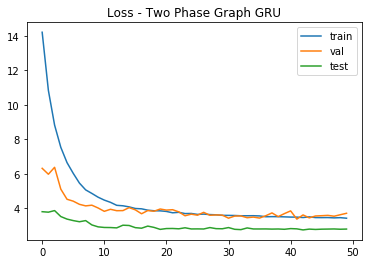

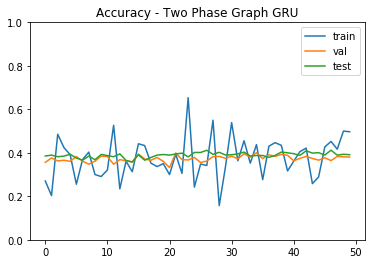

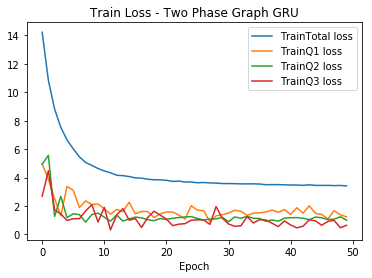

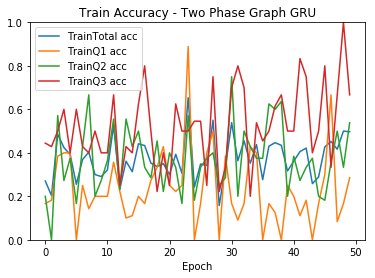

In [30]:
#==============================================================================
#  Main.py (有針對output model split question的case)
#==============================================================================
if split_question == 1:
    net, criterion, optimizer = loadGraphGRUModel(adjacency_matrix_Edge, split_question, show_layer = show_layer)
    history = {"loss":[], "val_loss":[], "test_loss":[], 
               "loss_q1":[], "val_loss_q1":[], "test_loss_q1":[],
               "loss_q2":[], "val_loss_q2":[], "test_loss_q2":[],
               "loss_q3":[], "val_loss_q3":[], "test_loss_q3":[],
               "acc":[], "val_acc":[], "test_acc":[], 
               "acc_q1":[], "val_acc_q1":[], "test_acc_q1":[],
               "acc_q2":[], "val_acc_q2":[], "test_acc_q2":[],
               "acc_q3":[], "val_acc_q3":[], "test_acc_q3":[]}
    earlyStopping_loss = 100000
    earlyStopping_count = 0
    start = time.time()
    scheduler = torch.optim.lr_scheduler.StepLR(optimizer, step_size=3, gamma=0.9)
    for epoch in range(epochs):
        print('---------------[Epoch: ' + str(epoch + 1) + ']---------------')
        if cuda == 1:
            # release no use GPU memory
            torch.cuda.empty_cache() 
            print("GPU memory allocated : " + str(torch.cuda.memory_allocated() / (1024*1024)) + " MB")
        start_epoch = time.time()
        # create dataloader
        train_dataloader, val_dataloader, (v, q, a), (v_val, q_val, a_val) = sampler(q_ind, adjacency_matrix_Edge, all_com_pair_P, is_train = 1, balance_class = balance_class, show_shape = show_shape)
        test_dataloader, (v_test, q_test, a_test) = sampler(q_ind, adjacency_matrix_Edge_test, all_com_pair_P, is_train = 0, balance_class = balance_class, show_shape = show_shape)
    #        train_dataloader, val_dataloader = sampler(v, q, a, adjacency_matrix_5_twoEdge, all_com_pair_P, 1)
    #        test_dataloader = sampler(v_test, q_test, a_test, adjacency_matrix_5_twoEdge, all_com_pair_P, 0)
        # train & validation
        train_loss, val_loss, train_acc, val_acc = train(epoch, train_dataloader, val_dataloader, net, criterion, optimizer, split_question = split_question)
        # test
        test_loss, test_acc = test(test_dataloader, net, criterion, optimizer, split_question = split_question)
        
        # learning rate decay
        scheduler.step()
        for param_group in optimizer.param_groups:
            print("Learning rate Now : %.4f" % (param_group['lr']))
        
        # early stopping setting
        if earlyStopping_loss > val_loss[0].item():
            earlyStopping_loss = val_loss[0].item()
            earlyStopping_count = 0
        earlyStopping_count = earlyStopping_count + 1
        
        end_epoch = time.time()
        print("Time of epoch %s : " % str(epoch + 1), end_epoch - start_epoch, " sec")
        
        # save total loss
        if type(train_loss[0]) == torch.Tensor:
            history["loss"].append(train_loss[0].item())
        else:
            history["loss"].append(train_loss[0]/len(train_dataloader))
        history["val_loss"].append(val_loss[0].item())
        history["acc"].append(train_acc[0])
        history["val_acc"].append(val_acc[0])
        history["test_loss"].append(test_loss[0].item())
        history["test_acc"].append(test_acc[0])
        
        # save each question loss
        for i in range(len(qtype)):
            history["loss_q{0}".format(str(i+1))].append(train_loss[i+1].item())
            history["val_loss_q{0}".format(str(i+1))].append(val_loss[i+1].item())
            history["acc_q{0}".format(str(i+1))].append(train_acc[i+1])
            history["val_acc_q{0}".format(str(i+1))].append(val_acc[i+1])
            history["test_loss_q{0}".format(str(i+1))].append(test_loss[i+1].item())
            history["test_acc_q{0}".format(str(i+1))].append(test_acc[i+1])
            
        if earlyStopping_count == patience:
            print("Early Stopping!!!!!!!!!!")
            break

    end = time.time()
    print("Time : ", end-start, " sec")
    # draw loss and accuracy
    draw_losses(history, network = "Two Phase Graph GRU")
    draw_acc(history, network = "Two Phase Graph GRU")
    draw_splitQuestion_loss(history, network = "Two Phase Graph GRU", split_question = split_question)
    draw_splitQuestion_acc(history, network = "Two Phase Graph GRU", split_question = split_question)

    # 平均accuracy
    test_mean = np.mean(history["test_acc"])
    test_mean_q1 = np.mean(history["test_acc_q1"])
    test_mean_q2 = np.mean(history["test_acc_q2"])
    test_mean_q3 = np.mean(history["test_acc_q3"])

# 回傳每一個問題亂猜的機率大小
- 最多數量的類別 / 該問題總資料量

In [31]:
def highest_ratio(v,q,a, datatype = "Train"):
    """
    回傳每個問題的亂猜accuracy
    ---
    也就是說找出現最多次的class
    """
    print("[Each class amount of %s data]" % datatype)
    print("Total data amount: ", q.shape)
    # question 1
    rand_q1 = q[np.where(q[:,-3] == 1)[0]]
    #rand_a1 = a[:,:4]
    rand_a1 = a[np.where(q[:,-3] == 1)[0],:]
    rand_a1_max = np.argmax(rand_a1,1)
    a1_count = dict(Counter(rand_a1_max))
    print(a1_count)
    # question 2
    rand_q2 = q[np.where(q[:,-2] == 1)[0]]
    #rand_a2 = a[:,4:7]
    rand_a2 = a[np.where(q[:,-2] == 1)[0],:]
    rand_a2_max = np.argmax(rand_a2,1)
    a2_count = dict(Counter(rand_a2_max))
    print(a2_count)
    # question 3
    rand_q3 = q[np.where(q[:,-1] == 1)[0]]
    #rand_a3 = a[:,7:]
    rand_a3 = a[np.where(q[:,-1] == 1)[0],:]
    rand_a3_max = np.argmax(rand_a3,1)
    a3_count = dict(Counter(rand_a3_max))
    print(a3_count)

    # 算三個問題各自猜出現次數最多category的機率
    q1_guess = a1_count[max(a1_count, key=a1_count.get)] / rand_q1.shape[0]
    q2_guess = a2_count[max(a2_count, key=a2_count.get)] / rand_q2.shape[0]
    q3_guess = a3_count[max(a3_count, key=a3_count.get)] / rand_q3.shape[0]
    q_guess = [q1_guess, q2_guess, q3_guess]
    
    return q_guess, a1_count, a2_count, a3_count

In [32]:
if split_question == 0:
    print("Time : ", end-start, " sec")
    # draw loss and accuracy
    draw_losses(history, network = "Two Phase Graph GRU")
    draw_acc(history, network = "Two Phase Graph GRU")

    # 平均accuracy
    test_mean = np.mean(history["test_acc"])
    print("Testing Accuracy Average of two phase graph GRU : %.4f"% test_mean)
    
    # Maximum accuracy
    test_max = np.max(history["test_acc"])
    print("Testing Accuracy Maximum of two phase graph GRU : %.4f"% test_max)

Time :  23201.67939567566  sec


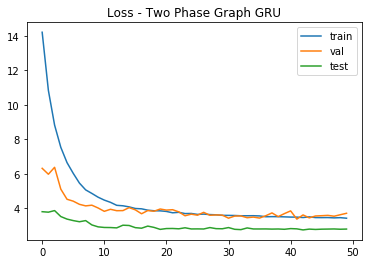

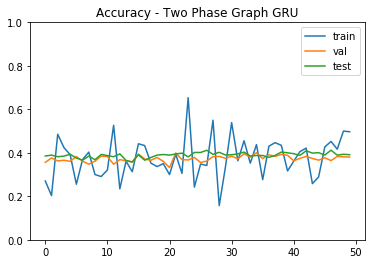

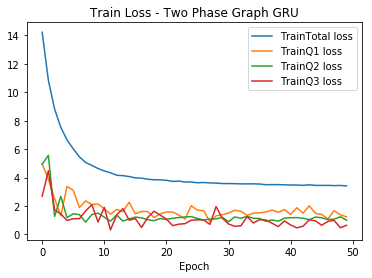

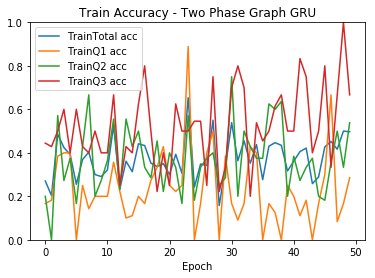

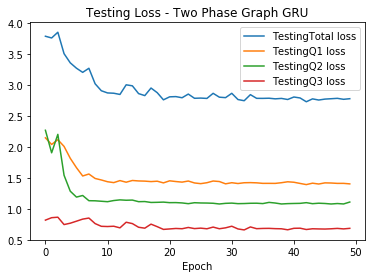

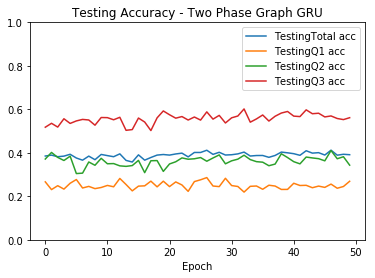

Testing [Total Accuracy] Average of two phase graph GRU : 0.3897
Testing [Pairwise Price Change Accuracy] Average of two phase graph GRU : 0.2499
Testing [Strength Accuracy] Average of two phase graph GRU : 0.3618
Testing [Volatility Accuracy] Average of two phase graph GRU : 0.5572
Testing [Total Accuracy] Max. of two phase graph GRU : 0.4121
Testing [Pairwise Price Change Accuracy] Max. of two phase graph GRU : 0.2861
Testing [Strength Accuracy] Max. of two phase graph GRU : 0.4106
Testing [Volatility Accuracy] Max. of two phase graph GRU : 0.6019


In [33]:
if split_question == 1:
    print("Time : ", end-start, " sec")
    # draw loss and accuracy
    draw_losses(history, network = "Two Phase Graph GRU")
    draw_acc(history, network = "Two Phase Graph GRU")
    draw_splitQuestion_loss(history, network = "Two Phase Graph GRU", split_question = split_question)
    draw_splitQuestion_acc(history, network = "Two Phase Graph GRU", split_question = split_question)
    draw_splitQuestion_loss(history, network = "Two Phase Graph GRU", split_question = split_question, datasetType = "Testing")
    draw_splitQuestion_acc(history, network = "Two Phase Graph GRU", split_question = split_question, datasetType = "Testing")

    # 平均accuracy for testing
    test_mean = np.mean(history["test_acc"])
    test_mean_q1 = np.mean(history["test_acc_q1"])
    test_mean_q2 = np.mean(history["test_acc_q2"])
    test_mean_q3 = np.mean(history["test_acc_q3"])
    
    # test average
    print("Testing [Total Accuracy] Average of two phase graph GRU : %.4f"% test_mean)
    print("Testing [%s Accuracy] Average of two phase graph GRU : %.4f"% (question_type[0], test_mean_q1))
    print("Testing [%s Accuracy] Average of two phase graph GRU : %.4f"% (question_type[1], test_mean_q2))
    print("Testing [%s Accuracy] Average of two phase graph GRU : %.4f"% (question_type[2], test_mean_q3))
    
     # test max
    print("Testing [Total Accuracy] Max. of two phase graph GRU : %.4f"% np.max(history["test_acc"]))
    print("Testing [%s Accuracy] Max. of two phase graph GRU : %.4f"% (question_type[0], np.max(history["test_acc_q1"])))
    print("Testing [%s Accuracy] Max. of two phase graph GRU : %.4f"% (question_type[1], np.max(history["test_acc_q2"])))
    print("Testing [%s Accuracy] Max. of two phase graph GRU : %.4f"% (question_type[2], np.max(history["test_acc_q3"])))

In [34]:
# 平均accuracy for validation
val_mean = np.mean(history["val_acc"])
val_mean_q1 = np.mean(history["val_acc_q1"])
val_mean_q2 = np.mean(history["val_acc_q2"])
val_mean_q3 = np.mean(history["val_acc_q3"])

# validation average
print("Validation [Total Accuracy] Average of two phase graph GRU : %.4f"% val_mean)
print("Validation [%s Accuracy] Average of two phase graph GRU : %.4f"% (question_type[0], val_mean_q1))
print("Validation [%s Accuracy] Average of two phase graph GRU : %.4f"% (question_type[1], val_mean_q2))
print("Validation [%s Accuracy] Average of two phase graph GRU : %.4f"% (question_type[2], val_mean_q3))

Validation [Total Accuracy] Average of two phase graph GRU : 0.3734
Validation [Pairwise Price Change Accuracy] Average of two phase graph GRU : 0.2501
Validation [Strength Accuracy] Average of two phase graph GRU : 0.3459
Validation [Volatility Accuracy] Average of two phase graph GRU : 0.5242


In [35]:
a_guess, a1_count, a2_count, a3_count = highest_ratio(v, q, a, "Training")
a_guess_val, a1_count_val, a2_count_val, a3_count_val = highest_ratio(v_val, q_val, a_val, "Validation")
a_guess_test, a1_count_test, a2_count_test, a3_count_test = highest_ratio(v_test, q_test, a_test, "Testing")
print("Training guess ratio : Q1 - %.4f | Q2 - %.4f | Q3 - %.4f" % (a_guess[0], a_guess[1], a_guess[2]))
print("Validation guess ratio : Q1 - %.4f | Q2 - %.4f | Q3 - %.4f" % (a_guess_val[0], a_guess_val[1], a_guess_val[2]))
print("Testing guess ratio : Q1 - %.4f | Q2 - %.4f | Q3 - %.4f" % (a_guess_test[0], a_guess_test[1], a_guess_test[2]))
print("Average guess ratio : Train - %.4f | Val - %.4f | Test - %.4f" % (np.mean(a_guess), np.mean(a_guess_val), np.mean(a_guess_test)))

[Each class amount of Training data]
Total data amount:  (18726, 61)
{3: 1554, 2: 1651, 1: 1553, 0: 1536}
{5: 2290, 6: 2265, 4: 1631}
{9: 3117, 8: 3119, 7: 10}
[Each class amount of Validation data]
Total data amount:  (985, 61)
{0: 72, 3: 88, 2: 80, 1: 86}
{5: 117, 6: 112, 4: 97}
{8: 162, 9: 148, 7: 23}
[Each class amount of Testing data]
Total data amount:  (3080, 61)
{3: 271, 1: 247, 2: 270, 0: 241}
{5: 375, 6: 336, 4: 266}
{9: 545, 8: 529}
Training guess ratio : Q1 - 0.2623 | Q2 - 0.3702 | Q3 - 0.4994
Validation guess ratio : Q1 - 0.2699 | Q2 - 0.3589 | Q3 - 0.4865
Testing guess ratio : Q1 - 0.2634 | Q2 - 0.3838 | Q3 - 0.5074
Average guess ratio : Train - 0.3773 | Val - 0.3718 | Test - 0.3849


In [36]:
"""
plot pytorch model
"""
#net_plot

'\nplot pytorch model\n'

In [37]:
"""
Save model
"""
time = str(datetime.datetime.now()).split(' ')[0]
flag = ['Off', 'On']
if split_question == 0:
    if attention == 0:
        torch.save(net.state_dict(), 'model/twoPhaseGraphGRU_resample%s_%s_nstep%d_stateDim%d_nNode%d_Epoch%d_LinearOutput_allin_efficientVQA'%(flag[balance_class], time, n_steps, state_dim, n_node, epochs))
    else:
        torch.save(net.state_dict(), 'model/twoPhaseGraphGRU_attentionOn_resample%s_%s_nstep%d_stateDim%d_nNode%d_Epoch%d_LinearOutput_allin_efficientVQA'%(flag[balance_class], time, n_steps, state_dim, n_node, epochs))
else:
    if attention == 0:
        torch.save(net.state_dict(), 'model/twoPhaseGraphGRU_splitQuestion_resample%s_%s_nstep%d_stateDim%d_nNode%d_Epoch%d_LinearOutput_allin_efficientVQA'%(flag[balance_class], time, n_steps, state_dim, n_node, epochs))
    else:
        torch.save(net.state_dict(), 'model/twoPhaseGraphGRU_attentionOn_resample%s_splitQuestion_%s_nstep%d_stateDim%d_nNode%d_Epoch%d_LinearOutput_allin_efficientVQA'%(flag[balance_class], time, n_steps, state_dim, n_node, epochs))

In [38]:
"""
確認目前所有tensor的使用量
"""
import gc
def memory_usage_check():
    print("Checking GPU memory usage...")
    cal_mem = []
    for obj in gc.get_objects():
        try:
            if torch.is_tensor(obj) or (hasattr(obj, 'data') and torch.is_tensor(obj.data)):
                print("------------------------------------------------------------------")
                print(type(obj), obj.size())
                print("Memory allocated of obj: ", obj.element_size() * obj.nelement() * 2 / (1024*1024), "MB")
                cal_mem.append(obj.element_size() * obj.nelement() * 2)
        except:
            pass
    print("Total GPU memory usage", sum(cal_mem) / (1024*1024), "MB")
memory_usage_check()

Checking GPU memory usage...
------------------------------------------------------------------
<class 'torch.nn.parameter.Parameter'> torch.Size([87, 29])
Memory allocated of obj:  0.01924896240234375 MB
------------------------------------------------------------------
<class 'torch.nn.parameter.Parameter'> torch.Size([87, 29])
Memory allocated of obj:  0.01924896240234375 MB
------------------------------------------------------------------
<class 'torch.nn.parameter.Parameter'> torch.Size([87])
Memory allocated of obj:  0.00066375732421875 MB
------------------------------------------------------------------
<class 'torch.nn.parameter.Parameter'> torch.Size([87])
Memory allocated of obj:  0.00066375732421875 MB
------------------------------------------------------------------
<class 'torch.nn.parameter.Parameter'> torch.Size([87, 29])
Memory allocated of obj:  0.01924896240234375 MB
------------------------------------------------------------------
<class 'torch.nn.parameter.Param

In [39]:
"""
測試free GPU memory有沒有用
"""
print("GPU memory allocated : " + str(torch.cuda.memory_allocated() / (1024*1024)) + " MB")
torch.cuda.empty_cache()

GPU memory allocated : 7.47607421875 MB



# 設計pair trading實驗
## 算pair-trading return的方法
* https://quant.stackexchange.com/questions/7488/what-is-the-proper-way-to-calculate-returns-for-pair-trading
* 在我的例子就是把兩個初始價格相加，計算兩支股票各自的價差(清算價格 - 初始價格)，然後(價差 / 初始價格相加) * 100
* long, short兩支股票的初始價應該一樣 (A == B * ratio(B/A))，如果A是100塊，那B也要是100塊
'''
美股交易稅：稅金很低，僅0.0000231 (2017)
新制參考：https://etfs.tw/sec-fee/　（我的資料還不用用到這個，用0.0013%就好）
'''

In [40]:
'''
用testing資料來做pair trading
'''
djia30 = os.listdir('djia30')
data30 = {}
# 挑pair company
temp_c = ["AAPL","MSFT"]
temp_c.sort()
temp_c = symbolsort
# 找出這幾間公司在目錄下的檔案名稱
temp = [c for c in djia30 if any(tc in c for tc in temp_c)]
# 這裡建議要取n個月的資料就n*30天
day = 30
company_num = len(temp_c)
period_test = [12]

print('Loading raw data...')
for file_name in temp:
    print("[" + file_name.split(".")[0] + "]")
    data30[file_name.split(".")[0]] = pd.read_pickle('/mnt/sda1/chia/djia30/' + file_name)

# 計算每秒的return及price
price_and_return_for_test = {}
for company in temp_c:   
    print('Calculate return and price of ' + company)
    price_data_for_test, return_data_for_test, date_test = cal_return(data30[company], period=period_test, return_date = 1)
    # 算漲跌幅 
    # 同義於 np.diff(price_data[0,:]) / price_data[0,:-1]
    change_data_for_test = return_data_for_test / price_data_for_test[:,:-1]
    price_data_for_test = np.float16(price_data_for_test)
    return_data_for_test = np.float16(return_data_for_test)
    change_data_for_test = np.float16(change_data_for_test)
    # 取需要的資料量
    price_and_return_for_test[company] = [price_data_for_test[:day_test], return_data_for_test[:day_test], change_data_for_test[:day_test]]

# 用來確認實際餵入的天數
day_test = price_and_return_for_test[company][0].shape[0]

# 儲存日期資料
date_test_noyear = [str(date_test[i])[5:] for i in range(len(date_test))]

adjacency_matrix_Edge_test = adjacency_matrix_Edge_dict[quarter_month[period_test[0]]]

del data30

Loading raw data...
[PFE]
[JNJ]
[BA]
[CAT]
[MSFT]
[DIS]
[TRV]
[GS]
[HD]
[KO]
[MRK]
[XOM]
[MMM]
[IBM]
[CSCO]
[MCD]
[INTC]
[WMT]
[JPM]
[UNH]
[PG]
[VZ]
[AAPL]
[UTX]
[AXP]
[GE]
[V]
[NKE]
[CVX]
Calculate return and price of AAPL
Calculate return and price of AXP
Calculate return and price of BA
Calculate return and price of CAT
Calculate return and price of CSCO
Calculate return and price of CVX
Calculate return and price of DIS
Calculate return and price of GE
Calculate return and price of GS
Calculate return and price of HD
Calculate return and price of IBM
Calculate return and price of INTC
Calculate return and price of JNJ
Calculate return and price of JPM
Calculate return and price of KO
Calculate return and price of MCD
Calculate return and price of MMM
Calculate return and price of MRK
Calculate return and price of MSFT
Calculate return and price of NKE
Calculate return and price of PFE
Calculate return and price of PG
Calculate return and price of TRV
Calculate return and price of U

In [41]:
# rolling function
def rolling(data, price_and_return, window, shift, day, mode = 'return', show_shape = 0):    # 後面的數字是資料的第幾天
    # rolling data
    rolling_data = {}
    position = []
    input_length = window + shift
    shift_length = shift
    if show_shape == 1:
        print("------Rolling for %s ------" % mode)
        print("window size : %s" % window)
        print("shift length : %s" % shift)
    
    # 有overlap
    if mode == 'return' or mode == 'change':
        c = int((data.shape[1] - input_length)/ shift_length) + 1
        tmp = np.zeros((c,company_num,input_length-1))
    else:
        c = int((data.shape[1] - input_length)/ shift_length) + 1
        tmp = np.zeros((c,company_num,input_length))

    for j in range(c):
        count = 0
        for company in temp_c:
            if mode == 'return': # return
                # 有overlap
                tmp[j][count] = price_and_return[company][1][day,j*shift_length:(input_length+(j*shift_length))-1]
                # 把每次切的frame位置記下來
                position.append([day, j*shift_length, (input_length+(j*shift_length))-1])
            elif mode == 'change': # return
                # 有overlap
                tmp[j][count] = price_and_return[company][2][day,j*shift_length:(input_length+(j*shift_length))-1]
                # 把每次切的frame位置記下來
                position.append([day, j*shift_length, (input_length+(j*shift_length))-1])
            else:    # price
                # 有overlap
                tmp[j][count] = price_and_return[company][0][day,j*shift_length:(input_length+(j*shift_length))]
                # 把每次切的frame位置記下來
                position.append([day, j*shift_length, window+j*shift_length, (input_length+(j*shift_length))])
            count += 1

        rolling_data[day] = tmp
    #print("[Split data finish !]")

    # 把所有切好的data stack成testing dataset
    roll_data = np.vstack(rolling_data.values())    #(?,5,299)
    if mode == 'return' or mode == 'change':
        v_data, v_answer_data = roll_data[:,:,:window-1], roll_data[:,:,window:]
    else:
        v_data, v_answer_data = roll_data[:,:,:window], roll_data[:,:,window:]
    #print("[Rolling data finish !]")
    
    return v_data, v_answer_data, position

def ratio_pair(pairs, price_data, price_and_return, window, shift, day, mode = 'price'):
    c1 = sorted(temp_c).index(pairs[0])
    c2 = sorted(temp_c).index(pairs[1])
    
    roll_pair = rolling(price_data, price_and_return, window, shift, day, mode = mode)[0][:,[c1,c2],:]
    position = rolling(price_data, price_and_return, window, shift, day, mode = mode)[2]
    roll_pair_ratio = roll_pair[:,0,:] / roll_pair[:,1,:]
    
    return roll_pair_ratio, position

# Rule-based Pair Trading Strategy

In [42]:

# Trade using a simple strategy
def zscore_trade_old(S1, S2, c1, c2, window1, window2, show_print = 0, fee = 0, rollingMode = 'pd', profit_Mode = 0):
    '''
    buys 1 ratio (buy 1 AAPL stock and sell ratio x MSFT stock) when ratio is low, 
    sell 1 ratio (sell 1 AAPL stock and buy ratio x MSFT stock) when it’s high, 
    and calculate PnL (profit and loss，損益) of these trades.
    '''
    
    # If window length is 0, algorithm doesn't make sense, so exit
    if (window1 == 0) or (window2 == 0):
        return 0
    
    # Compute rolling mean and rolling standard deviation
    ratios = pd.DataFrame({"ratios" : (S1.values/S2.values).ravel()})
    
    if rollingMode == 'pd':
        ma1 = ratios.rolling(window=window1,
                                   center=False).mean()
        ma2 = ratios.rolling(window=window2,
                                   center=False).mean()
        std = ratios.rolling(window=window2,
                                   center=False).std()
        zscore = (ma1 - ma2)/std
    
    else:
        # 這裡就有先決定要挑哪兩間公司
        mavg_slow = np.mean(ratio_pair(pairs[0], price_data_for_test, window2, shift_length, day)[0], 1)
        mavg_fast = np.mean(ratio_pair(pairs[0], price_data_for_test, window1, shift_length, day)[0], 1)
        std_slow = np.std(ratio_pair(pairs[0], price_data_for_test, window2, shift_length, day)[0], 1)
        
        zscore = (mavg_fast[int((window2-window1)/shift_length):] - mavg_slow) / std_slow  
        zscore = pd.Series(zscore, name = "zscore")
    
    # Simulate trading
    # Start with no money and no positions
    b_s, s_s = [], []
    if profit_Mode == 0:
        money = 0
    else:
        money = 1
        temp_S1, temp_S2 = 0, 0 # 用來記錄
        
    countS1 = 0
    countS2 = 0
    # 每n秒強制交割一次
    time_count = 0
    # 若每n秒內已經買賣過股票就不再入場
    flag = 0
    for i in range(len(ratios)):
        time_count += 1
        # 前300秒不交易
        if i + 1 > v_length:
            #time_count += 1
            if show_print == 1:
                print("---------[Time = %s]---------" % i)
                print("Current profit and postion : ", " profit - ", money, " | S1 pos - ", countS1, " | S2 pos - ", countS2)
                
            # Sell short if the z-score is > 1
            if zscore.iloc[i][0] > 1 and abs(countS1) <= 0 and flag == 0:    # 限制一次只能買賣一股
                # 交易成本部分： 0.00231%的交易稅、各0.5%的手續費
                ratio = S1.iloc[i][0] / S2.iloc[i][0]
                if profit_Mode == 0:
                    if fee == 1:
                        money += S1.iloc[i][0] - S2.iloc[i][0] * ratio - 0.0000231 * S1.iloc[i][0] - 0.005 * S1.iloc[i][0] - 0.005 * S2.iloc[i][0] * ratio
                    else:
                        money += S1.iloc[i][0] - S2.iloc[i][0] * ratio
                countS1 -= 1
                countS2 += ratio
                temp_S1, temp_S2 = S1.iloc[i][0], S2.iloc[i][0]
                s_s.append(i)
                flag = 1
                if show_print == 1:
                    print('[Selling Ratio] profit %s | price ratios %s | S1 %s pos | S2 %s pos'% (money, ratio, countS1, countS2))
                    print('[Sell %s and Buy %s] profit %s | price ratios %s | C1 %s pos | C2 %s pos'% (c1, c2, money, ratio, countS1, countS2))
                    print('%s price - %s revenue - %s | %s price - %s payment - %s |' % (c1, S1.iloc[i][0], S1.iloc[i][0], c2, S2.iloc[i][0], S2.iloc[i][0] * ratio))
            
            # Buy long if the z-score is < -1
            elif zscore.iloc[i][0] < -1 and abs(countS1) <= 0 and flag == 0:    # 限制一次只能買賣一股
                # 交易成本部分： 0.00231%的交易稅、各0.5%的手續費
                ratio = S1.iloc[i][0] / S2.iloc[i][0]
                if profit_Mode == 0:
                    if fee == 1:
                        money -= S1.iloc[i][0] - S2.iloc[i][0] * ratio - 0.0000231 * S2.iloc[i][0] * ratio - 0.005 * S1.iloc[i][0] - 0.005 * S2.iloc[i][0] * ratio
                    else:
                        money -= S1.iloc[i][0] - S2.iloc[i][0] * ratio
                countS1 += 1
                countS2 -= ratio
                temp_S1, temp_S2 = S1.iloc[i][0], S2.iloc[i][0]
                b_s.append(i)
                flag = 1
                if show_print == 1:
                    print('[Buying Ratio] profit %s | price ratios %s | S1 %s pos | S2 %s pos'% (money, ratio, countS1, countS2))
                    print('[Buy %s and Sell %s] profit %s | price ratios %s | C1 %s pos | C2 %s pos'% (c1, c2, money, ratio, countS1, countS2))
                    print('%s price - %s payment - %s | %s price - %s revenue - %s |' % (c1, S1.iloc[i][0], S1.iloc[i][0], c2, S2.iloc[i][0], S2.iloc[i][0] * ratio))
            
            # Clear positions if the z-score between -.5 and .5 
            # 手上持有一股或者決策時間到的時候需要清算時執行
            elif ((abs(zscore.iloc[i][0]) < 0.5 and abs(countS1) == 1) or (time_count == shift_length and abs(countS1) == 1)):
            #elif abs(zscore.iloc[i][0]) < 0.5:
                # 交易成本部分： 0.00231%的交易稅、各0.5%的手續費
                ratio = S1.iloc[i][0] / S2.iloc[i][0]
                if profit_Mode == 0:
                    if fee == 1:
                        money += countS1 * S1.iloc[i][0] + S2.iloc[i][0] * countS2 - 0.0000231 * (countS1 * S1.iloc[i][0] + countS2 * S2.iloc[i][0]) - 0.005 * (S1.iloc[i][0] * countS1 + S2.iloc[i][0] * countS2)
                    else:
                        money += countS1 * S1.iloc[i][0] + S2.iloc[i][0] * countS2
                else:    #profit rate
                    if fee == 1:
                        money *= 1 + (countS1 * S1.iloc[i][0] + S2.iloc[i][0] * countS2 - 0.0000231 * (countS1 * S1.iloc[i][0] + countS2 * S2.iloc[i][0]) - 0.005 * (S1.iloc[i][0] * countS1 + S2.iloc[i][0] * countS2)) / (temp_S1 + temp_S2)
                    else:
                        money *= 1 + (countS1 * S1.iloc[i][0] + S2.iloc[i][0] * countS2) / (temp_S1 + temp_S2)
                
                if show_print == 1:
                    print('[Exit position] profit %s | price ratios %s | S1 %s pos | S2 %s pos'% (money, ratio, -countS1, -countS2))
                    print('%s price - %s, earn : %s | %s price - %s, earn : %s |' % (c1, S1.iloc[i][0], countS1 * S1.iloc[i][0], c2, S2.iloc[i][0], countS2 * S2.iloc[i][0]))
        
                countS1, countS2 = 0, 0
        
        if time_count == shift_length:
            time_count = 0
            flag = 0
            
    return money, b_s, s_s


In [43]:
# 07/23新增，為了避免overfitting所做的處理
# Trade using a simple strategy
def zscore_trade_train(S1, S2, c1, c2, price_data, price_and_return, window1, window2, day, show_print = 0, fee = 0, rollingMode = 'pd', profit_Mode = 0):
    '''
    和下面的NN trading strategy一樣，把交易過程分成train, test階段，
    對每一個frame而言：
    　　拿前300秒price data進去train(找最好的window size)，answer data拿來test(這個frame最適合的window size)
    ---
    buys 1 ratio (buy 1 AAPL stock and sell ratio x MSFT stock) when ratio is low, 
    sell 1 ratio (sell 1 AAPL stock and buy ratio x MSFT stock) when it's high, 
    and calculate PnL (profit and loss，損益) of these trades.
    '''
    c1_idx = symbolsort.index(c1)
    c2_idx = symbolsort.index(c2)
    # 交易日當天rolling出來的所有frame
    train, test, position = rolling(price_data, price_and_return, v_length, shift_length, day, mode = 'price')
    train_S1, train_S2 = train[:,c1_idx,:], train[:,c2_idx,:]
    test_S1, test_S2 = test[:,c1_idx,:], test[:,c2_idx,:]
    position = sorted([list(x) for x in set(tuple(x) for x in position)])
    
    # lock住長時間的window
    window2 = 60
    
    # Simulate trading
    # Start with no money and no positions
    b_s, s_s = [], []
    if profit_Mode == 0:
        money = 0
    else:
        money = 1
        temp_S1, temp_S2 = 0, 0 # 用來記錄
        
    countS1 = 0
    countS2 = 0
    # 在這邊改成check一下Series和真實的價格是否相等
    time_count = 0
    # 總共有v_test.shape[0]個決策點，一天的前300秒不做決策，每150秒做一次決策，一次買賣一口
    flag = 0
    for i in range(len(test_S1)):
        print("------------------------Frame %s------------------------" % str(i+1))
        '''
        對每一個frame做策略
        ---
        用train的zscore去判斷是否要進場 (60MA - 300MA)
        '''
        flag = 0
        data_S1 = np.concatenate((train_S1[i], test_S1[i]))
        data_S2 = np.concatenate((train_S2[i], test_S2[i]))
        ratios = pd.DataFrame({"ratios" : (data_S1 / data_S2)})
        if rollingMode == "pd":
            ma1 = ratios.rolling(window=window1,
                                   center=False).mean()
            ma2 = ratios.rolling(window=window2,
                                   center=False).mean()
            std = ratios.rolling(window=window2,
                                   center=False).std()
            # 防止150秒內所有值都一樣的情況
            std = std.replace({0: 1e-12})
            zscore = (ma1 - ma2)/std
        else:
            print("Numpy Mode Rolling Window")
            pairs = (c1, c2)
            mavg_slow = np.mean(ratio_pair(pairs, price_data, price_and_return, window2, shift_length, day)[0], 1)
            mavg_fast = np.mean(ratio_pair(pairs, price_data, price_and_return, window1, shift_length, day)[0], 1)
            std_slow = np.std(ratio_pair(pairs, price_data, price_and_return, window2, shift_length, day)[0], 1)

            zscore = (mavg_fast[int((window2-window1)/shift_length):] - mavg_slow) / std_slow  
            #zscore = pd.Series(zscore, name = "zscore")
            zscore = pd.DataFrame({"zscore": zscore})
        
        if show_print == 1:
            print("---------[Time = %s to %s]---------" % (position[i][2], position[i][3]))
            print("Current profit and postion : ", " profit - ", money, " | S1 pos - ", countS1, " | S2 pos - ", countS2)
            print("Now Price : [%s %.4f] [%s %.4f]" % (c1, test_S1[i][0], c2, test_S2[i][0]))
            print("Plot z-score of long and short rolling price ratio of %s and %s" % (c1, c2))
            plt.figure(figsize=(15,7))
            plt.plot(zscore)
            plt.axhline(0, color='black')
            plt.axhline(1.0, color='red', linestyle='--')
            plt.axhline(-1.0, color='green', linestyle='--')
            plt.title("Z-score of long and short rolling price ratio of %s and %s" % (c1, c2))
            plt.legend(['Rolling Ratio z-Score', 'Mean', '+1', '-1'])
            plt.show()
            
        print("---------[Time = %s to %s]---------" % (position[i][2], position[i][3]))
        print("Current profit and postion : ", " profit - ", money, " | S1 pos - ", countS1, " | S2 pos - ", countS2)
        print("Now Price : [%s %.4f] [%s %.4f]" % (c1, test_S1[i][0], c2, test_S2[i][0]))
        print("Plot z-score of long and short rolling price ratio of %s and %s" % (c1, c2))
        plt.figure(figsize=(15,7))
        plt.plot(zscore)
        plt.axhline(0, color='black')
        plt.axhline(1.0, color='red', linestyle='--')
        plt.axhline(-1.0, color='green', linestyle='--')
        plt.title("Z-score of long and short rolling price ratio of %s and %s" % (c1, c2))
        plt.legend(['Rolling Ratio z-Score', 'Mean', '+1', '-1'])
        plt.show()
            
        # test部分第一秒入場，最後一秒出場
        S1_t0, S1_t60 = test_S1[i][0], test_S1[i][-1]
        S2_t0, S2_t60 = test_S2[i][0], test_S2[i][-1]
        train_time = position[i][1]
        entry_time = position[i][2]
        exit_time = position[i][3]-1
        #print(train_time, entry_time, exit_time)
        if rollingMode == "pd":
            zscore = zscore.dropna().reset_index(drop = True)
        
        for j in range(shift_length):
            # Sell short if the z-score is > 1
            if show_print == 1:
                print("zscore =", zscore.iloc[j][0])
            if zscore.iloc[j][0] > 1 and flag != 1: 
                # 交易成本部分： 0.00231%的交易稅、各0.5%的手續費
                #temp_S1, temp_S2 = S1.iloc[v_length + i*shift_length + j][0], S2.iloc[v_length + i*shift_length + j][0]
                # 改成直接讀原始資料 (因為用pd.DataFrame取值會讓值的精度消失)
                temp_S1, temp_S2 = test_S1[i][j], test_S2[i][j]
                ratio = temp_S1 / temp_S2
                if profit_Mode == 0:
                    if fee == 1:
                        money += temp_S1 - temp_S2 * ratio - 0.0000231 * temp_S1 - 0.005 * temp_S1 - 0.005 * temp_S2 * ratio
                    else:
                        money += temp_S1 - temp_S2 * ratio

                countS1 -= 1
                countS2 += ratio

#                 if temp_S1 == test_S1[i][0]:
#                     print("True")
                    
                s_s.append(v_length + i*shift_length + j)
                flag = 1
                if show_print == 1:
                    print("-----Trading time : %s-----" % (v_length + i*shift_length + j))
                    print('[Selling Ratio]')
                    print('[Sell %s and Buy %s] profit %s | price ratios %s | C1 %s pos | C2 %s pos'% (c1, c2, money, ratio, countS1, countS2))
                    print('%s price - %s revenue - %s | %s price - %s payment - %s |' % (c1, temp_S1, temp_S1, c2, temp_S2, temp_S2 * ratio))

            # Buy long if the z-score is < -1
            elif zscore.iloc[j][0] < -1 and flag != 1:
                # 交易成本部分： 0.00231%的交易稅、各0.5%的手續費
                #temp_S1, temp_S2 = S1.iloc[v_length + i*shift_length + j][0], S2.iloc[v_length + i*shift_length + j][0]
                # 改成直接讀原始資料 (因為用pd.DataFrame取值會讓值的精度消失)
                temp_S1, temp_S2 = test_S1[i][j], test_S2[i][j]
                ratio = temp_S1 / temp_S2
                if profit_Mode == 0:
                    if fee == 1:
                        money -= temp_S1 - temp_S2 * ratio - 0.0000231 * temp_S2 * ratio - 0.005 * temp_S1 - 0.005 * temp_S2 * ratio
                    else:
                        money -= temp_S1 - temp_S2 * ratio
                countS1 += 1
                countS2 -= ratio

                b_s.append(v_length + i*shift_length + j)
                flag = 1
                if show_print == 1:
                    print("-----Trading time : %s-----" % (v_length + i*shift_length + j))
                    print('[Buying Ratio]')
                    print('[Buy %s and Sell %s] profit %s | price ratios %s | C1 %s pos | C2 %s pos'% (c1, c2, money, ratio, countS1, countS2))
                    print('%s price - %s payment - %s | %s price - %s revenue - %s |' % (c1, S1_t0, S1_t0, c2, S2_t0, S2_t0 * ratio))

            # Clear positions if the z-score between -.5 and .5  
            # 交易成本部分： 0.00231%的交易稅 、各0.5%的手續費
            # zscore回到均值附近
            if abs(zscore.iloc[j][0]) < 0.75 and flag == 1:
                #clear_S1, clear_S2 = S1.iloc[v_length + i*shift_length + j][0], S2.iloc[v_length + i*shift_length + j][0]
                # 改成直接讀原始資料 (因為用pd.DataFrame取值會讓值的精度消失)
                clear_S1, clear_S2 = test_S1[i][j], test_S2[i][j]
                ratio = clear_S1 / clear_S2
                #print(exit_time, ratios.iloc[exit_time][0])
                if profit_Mode == 0:
                    if fee == 1:
                        money += countS1 * clear_S1 + clear_S2 * countS2 - 0.0000231 * (countS1 * clear_S1 + countS2 * clear_S2) - 0.005 * (clear_S1 * countS1 + clear_S2 * countS2)
                    else:
                        money += countS1 * clear_S1 + clear_S2 * countS2
                else:    # profit rate
                    if fee == 1:
                        money *= 1 + (countS1 * clear_S1 + clear_S2 * countS2 - 0.0000231 * (countS1 * clear_S1 + countS2 * clear_S2) - 0.005 * (clear_S1 * countS1 + clear_S2 * countS2)) / (temp_S1 + temp_S2)
                    else:
                        money *= 1 + (countS1 * clear_S1 + clear_S2 * countS2) / (temp_S1 + temp_S2)

                if show_print == 1:
                    print("-----Clear position time : %s-----" % (v_length + i*shift_length + j))
                    print('[Exit position] profit %s | price ratios %s | C1 %s pos | C2 %s pos'% (money, ratio, -countS1, -countS2))
                    print('%s price - %s, earn : %s | %s price - %s, earn : %s |' % (c1, clear_S1, countS1 * clear_S1, c2, clear_S2, countS2 * clear_S2))
            
                # clear position
                countS1, countS2 = 0, 0
                
            # 都沒有遇到回到mean附近的情況，就回傳最後一秒的值
            elif j == (shift_length-1):# and flag == 1:
                ratio = S1_t60 / S2_t60
                if profit_Mode == 0:
                    if fee == 1:
                        money += countS1 * S1_t60 + S2_t60 * countS2 - 0.0000231 * (countS1 * S1_t60 + countS2 * S2_t60) - 0.005 * (S1_t60 * countS1 + S2_t60 * countS2)
                    else:
                        money += countS1 * S1_t60 + S2_t60 * countS2
                else:    # profit rate
                    if fee == 1:
                        money *= 1 + (countS1 * S1_t60 + S2_t60 * countS2 - 0.0000231 * (countS1 * S1_t60 + countS2 * S2_t60) - 0.005 * (S1_t60 * countS1 + S2_t60 * countS2)) / (S1_t0 + S2_t0)
                    else:
                        money *= 1 + (countS1 * S1_t60 + S2_t60 * countS2) / (S1_t0 + S2_t0)

                if show_print == 1:
                    print("-----Clear position time : %s-----" % (v_length + i*shift_length + j))
                    print('[Exit position] profit %s | price ratios %s | C1 %s pos | C2 %s pos'% (money, ratio, -countS1, -countS2))
                    print('%s price - %s, earn : %s | %s price - %s, earn : %s |' % (c1, S1_t60, countS1 * S1_t60, c2, S2_t60, countS2 * S2_t60))
            
                # clear position
                countS1, countS2 = 0, 0
                
            else:
                if show_print == 1:
                    print("-----No action time : [Day %s] %s-----" % (day+1, v_length + i*shift_length + j))
                    S1_, S2_ = S1.iloc[v_length + i*shift_length + j][0], S2.iloc[v_length + i*shift_length + j][0]
                    ratio = S1_ / S2_
                    print("Now price : [%s price %.4f] [%s price %.4f]" % (c1, S1_, c2, S2_))
                    print('[Status] profit %s | C1 %s pos | C2 %s pos'% (money, countS1, countS2))

    return money, b_s, s_s

In [44]:
'''
07/15新版，先切frame才做交易
'''
# Trade using a simple strategy
def zscore_trade(S1, S2, c1, c2, price_data, price_and_return, window1, window2, day, show_print = 0, fee = 0, rollingMode = 'pd', profit_Mode = 0):
    '''
    buys 1 ratio (buy 1 AAPL stock and sell ratio x MSFT stock) when ratio is low, 
    sell 1 ratio (sell 1 AAPL stock and buy ratio x MSFT stock) when it's high, 
    and calculate PnL (profit and loss，損益) of these trades.
    '''
    c1_idx = symbolsort.index(c1)
    c2_idx = symbolsort.index(c2)
    # 交易日當天rolling出來的所有frame
    train, test, position = rolling(price_data, price_and_return, v_length, shift_length, day, mode = 'price')
    train_S1, train_S2 = train[:,c1_idx,:], train[:,c2_idx,:]
    test_S1, test_S2 = test[:,c1_idx,:], test[:,c2_idx,:]
    position = sorted([list(x) for x in set(tuple(x) for x in position)])
    
    # If window length is 0, algorithm doesn't make sense, so exit
    if (window1 == 0) or (window2 == 0):
        return 0
    
#     if rollingMode == 'pd':
#         # Compute rolling mean and rolling standard deviation
#         ratios = pd.DataFrame({"ratios" : (S1.values/S2.values).ravel()})
    
#         ma1 = ratios.rolling(window=window1,
#                                    center=False).mean()
#         ma2 = ratios.rolling(window=window2,
#                                    center=False).mean()
#         std = ratios.rolling(window=window2,
#                                    center=False).std()
#         zscore = (ma1 - ma2)/std
    
    # Simulate trading
    # Start with no money and no positions
    b_s, s_s = [], []
    if profit_Mode == 0:
        money = 0
    else:
        money = 1
        temp_S1, temp_S2 = 0, 0 # 用來記錄
        
    countS1 = 0
    countS2 = 0
    # 在這邊改成check一下Series和真實的價格是否相等
    time_count = 0
    # 總共有v_test.shape[0]個決策點，一天的前300秒不做決策，每150秒做一次決策，一次買賣一口
    flag = 0
    for i in range(len(test_S1)):
        print("------------------------Frame %s------------------------" % str(i+1))
        '''
        對每一個frame做策略
        ---
        用train的zscore去判斷是否要進場 (60MA - 300MA)
        '''
        flag = 0
        data_S1 = np.concatenate((train_S1[i], test_S1[i]))
        data_S2 = np.concatenate((train_S2[i], test_S2[i]))
        ratios = pd.DataFrame({"ratios" : (data_S1 / data_S2)})
        if rollingMode == "pd":
            ma1 = ratios.rolling(window=window1,
                                   center=False).mean()
            ma2 = ratios.rolling(window=window2,
                                   center=False).mean()
            std = ratios.rolling(window=window2,
                                   center=False).std()
            # 防止150秒內所有值都一樣的情況
            std = std.replace({0: 1e-12})
            zscore = (ma1 - ma2)/std
        else:
            print("Numpy Mode Rolling Window")
            pairs = (c1, c2)
            mavg_slow = np.mean(ratio_pair(pairs, price_data, price_and_return, window2, shift_length, day)[0], 1)
            mavg_fast = np.mean(ratio_pair(pairs, price_data, price_and_return, window1, shift_length, day)[0], 1)
            std_slow = np.std(ratio_pair(pairs, price_data, price_and_return, window2, shift_length, day)[0], 1)

            zscore = (mavg_fast[int((window2-window1)/shift_length):] - mavg_slow) / std_slow  
            #zscore = pd.Series(zscore, name = "zscore")
            zscore = pd.DataFrame({"zscore": zscore})
        
        if show_print == 1:
            print("---------[Time = %s to %s]---------" % (position[i][2], position[i][3]))
            print("Current profit and postion : ", " profit - ", money, " | S1 pos - ", countS1, " | S2 pos - ", countS2)
            print("Now Price : [%s %.4f] [%s %.4f]" % (c1, test_S1[i][0], c2, test_S2[i][0]))
            print("Plot z-score of long and short rolling price ratio of %s and %s" % (c1, c2))
            plt.figure(figsize=(15,7))
            plt.plot(zscore)
            plt.axhline(0, color='black')
            plt.axhline(1.0, color='red', linestyle='--')
            plt.axhline(-1.0, color='green', linestyle='--')
            plt.title("Z-score of long and short rolling price ratio of %s and %s" % (c1, c2))
            plt.legend(['Rolling Ratio z-Score', 'Mean', '+1', '-1'])
            plt.show()
            
        print("---------[Time = %s to %s]---------" % (position[i][2], position[i][3]))
        print("Current profit and postion : ", " profit - ", money, " | S1 pos - ", countS1, " | S2 pos - ", countS2)
        print("Now Price : [%s %.4f] [%s %.4f]" % (c1, test_S1[i][0], c2, test_S2[i][0]))
        print("Plot z-score of long and short rolling price ratio of %s and %s" % (c1, c2))
        plt.figure(figsize=(15,7))
        plt.plot(zscore)
        plt.axhline(0, color='black')
        plt.axhline(1.0, color='red', linestyle='--')
        plt.axhline(-1.0, color='green', linestyle='--')
        plt.title("Z-score of long and short rolling price ratio of %s and %s" % (c1, c2))
        plt.legend(['Rolling Ratio z-Score', 'Mean', '+1', '-1'])
        plt.show()
            
        # test部分第一秒入場，最後一秒出場
        S1_t0, S1_t60 = test_S1[i][0], test_S1[i][-1]
        S2_t0, S2_t60 = test_S2[i][0], test_S2[i][-1]
        train_time = position[i][1]
        entry_time = position[i][2]
        exit_time = position[i][3]-1
        #print(train_time, entry_time, exit_time)
        if rollingMode == "pd":
            zscore = zscore.dropna().reset_index(drop = True)
        
        for j in range(shift_length):
            # Sell short if the z-score is > 1
            if show_print == 1:
                print("zscore =", zscore.iloc[j][0])
            if zscore.iloc[j][0] > 1 and flag != 1: 
                # 交易成本部分： 0.00231%的交易稅、各0.5%的手續費
                #temp_S1, temp_S2 = S1.iloc[v_length + i*shift_length + j][0], S2.iloc[v_length + i*shift_length + j][0]
                # 改成直接讀原始資料 (因為用pd.DataFrame取值會讓值的精度消失)
                temp_S1, temp_S2 = test_S1[i][j], test_S2[i][j]
                ratio = temp_S1 / temp_S2
                if profit_Mode == 0:
                    if fee == 1:
                        money += temp_S1 - temp_S2 * ratio - 0.0000231 * temp_S1 - 0.005 * temp_S1 - 0.005 * temp_S2 * ratio
                    else:
                        money += temp_S1 - temp_S2 * ratio

                countS1 -= 1
                countS2 += ratio

#                 if temp_S1 == test_S1[i][0]:
#                     print("True")
                    
                s_s.append(v_length + i*shift_length + j)
                flag = 1
                if show_print == 1:
                    print("-----Trading time : %s-----" % (v_length + i*shift_length + j))
                    print('[Selling Ratio]')
                    print('[Sell %s and Buy %s] profit %s | price ratios %s | C1 %s pos | C2 %s pos'% (c1, c2, money, ratio, countS1, countS2))
                    print('%s price - %s revenue - %s | %s price - %s payment - %s |' % (c1, temp_S1, temp_S1, c2, temp_S2, temp_S2 * ratio))

            # Buy long if the z-score is < -1
            elif zscore.iloc[j][0] < -1 and flag != 1:
                # 交易成本部分： 0.00231%的交易稅、各0.5%的手續費
                #temp_S1, temp_S2 = S1.iloc[v_length + i*shift_length + j][0], S2.iloc[v_length + i*shift_length + j][0]
                # 改成直接讀原始資料 (因為用pd.DataFrame取值會讓值的精度消失)
                temp_S1, temp_S2 = test_S1[i][j], test_S2[i][j]
                ratio = temp_S1 / temp_S2
                if profit_Mode == 0:
                    if fee == 1:
                        money -= temp_S1 - temp_S2 * ratio - 0.0000231 * temp_S2 * ratio - 0.005 * temp_S1 - 0.005 * temp_S2 * ratio
                    else:
                        money -= temp_S1 - temp_S2 * ratio
                countS1 += 1
                countS2 -= ratio

                b_s.append(v_length + i*shift_length + j)
                flag = 1
                if show_print == 1:
                    print("-----Trading time : %s-----" % (v_length + i*shift_length + j))
                    print('[Buying Ratio]')
                    print('[Buy %s and Sell %s] profit %s | price ratios %s | C1 %s pos | C2 %s pos'% (c1, c2, money, ratio, countS1, countS2))
                    print('%s price - %s payment - %s | %s price - %s revenue - %s |' % (c1, S1_t0, S1_t0, c2, S2_t0, S2_t0 * ratio))

            # Clear positions if the z-score between -.5 and .5  
            # 交易成本部分： 0.00231%的交易稅 、各0.5%的手續費
            # zscore回到均值附近
            if abs(zscore.iloc[j][0]) < 0.75 and flag == 1:
                #clear_S1, clear_S2 = S1.iloc[v_length + i*shift_length + j][0], S2.iloc[v_length + i*shift_length + j][0]
                # 改成直接讀原始資料 (因為用pd.DataFrame取值會讓值的精度消失)
                clear_S1, clear_S2 = test_S1[i][j], test_S2[i][j]
                ratio = clear_S1 / clear_S2
                #print(exit_time, ratios.iloc[exit_time][0])
                if profit_Mode == 0:
                    if fee == 1:
                        money += countS1 * clear_S1 + clear_S2 * countS2 - 0.0000231 * (countS1 * clear_S1 + countS2 * clear_S2) - 0.005 * (clear_S1 * countS1 + clear_S2 * countS2)
                    else:
                        money += countS1 * clear_S1 + clear_S2 * countS2
                else:    # profit rate
                    if fee == 1:
                        money *= 1 + (countS1 * clear_S1 + clear_S2 * countS2 - 0.0000231 * (countS1 * clear_S1 + countS2 * clear_S2) - 0.005 * (clear_S1 * countS1 + clear_S2 * countS2)) / (temp_S1 + temp_S2)
                    else:
                        money *= 1 + (countS1 * clear_S1 + clear_S2 * countS2) / (temp_S1 + temp_S2)

                if show_print == 1:
                    print("-----Clear position time : %s-----" % (v_length + i*shift_length + j))
                    print('[Exit position] profit %s | price ratios %s | C1 %s pos | C2 %s pos'% (money, ratio, -countS1, -countS2))
                    print('%s price - %s, earn : %s | %s price - %s, earn : %s |' % (c1, clear_S1, countS1 * clear_S1, c2, clear_S2, countS2 * clear_S2))
            
                # clear position
                countS1, countS2 = 0, 0
                
            # 都沒有遇到回到mean附近的情況，就回傳最後一秒的值
            elif j == (shift_length-1):# and flag == 1:
                ratio = S1_t60 / S2_t60
                if profit_Mode == 0:
                    if fee == 1:
                        money += countS1 * S1_t60 + S2_t60 * countS2 - 0.0000231 * (countS1 * S1_t60 + countS2 * S2_t60) - 0.005 * (S1_t60 * countS1 + S2_t60 * countS2)
                    else:
                        money += countS1 * S1_t60 + S2_t60 * countS2
                else:    # profit rate
                    if fee == 1:
                        money *= 1 + (countS1 * S1_t60 + S2_t60 * countS2 - 0.0000231 * (countS1 * S1_t60 + countS2 * S2_t60) - 0.005 * (S1_t60 * countS1 + S2_t60 * countS2)) / (S1_t0 + S2_t0)
                    else:
                        money *= 1 + (countS1 * S1_t60 + S2_t60 * countS2) / (S1_t0 + S2_t0)

                if show_print == 1:
                    print("-----Clear position time : %s-----" % (v_length + i*shift_length + j))
                    print('[Exit position] profit %s | price ratios %s | C1 %s pos | C2 %s pos'% (money, ratio, -countS1, -countS2))
                    print('%s price - %s, earn : %s | %s price - %s, earn : %s |' % (c1, S1_t60, countS1 * S1_t60, c2, S2_t60, countS2 * S2_t60))
            
                # clear position
                countS1, countS2 = 0, 0
                
            else:
                if show_print == 1:
                    print("-----No action time : [Day %s] %s-----" % (day+1, v_length + i*shift_length + j))
                    S1_, S2_ = S1.iloc[v_length + i*shift_length + j][0], S2.iloc[v_length + i*shift_length + j][0]
                    ratio = S1_ / S2_
                    print("Now price : [%s price %.4f] [%s price %.4f]" % (c1, S1_, c2, S2_))
                    print('[Status] profit %s | C1 %s pos | C2 %s pos'% (money, countS1, countS2))

    return money, b_s, s_s

In [45]:
# Normalization
def zscore(series):
    if isinstance(series, pd.Series):
        return (series - series.mean()) / (series).std()
    else:
        return (series - np.mean(series)) / np.std(series, dtype=np.float64)

# Baseline : Rule-based Pair trading

In [46]:
trading_time = 23400    # 一天
window_l = 300 # 算長線的window
window_s = 150 # 算短線的window
profit_Mode = 1
rollingMode = "pd"

Finding cointegrated pairs...


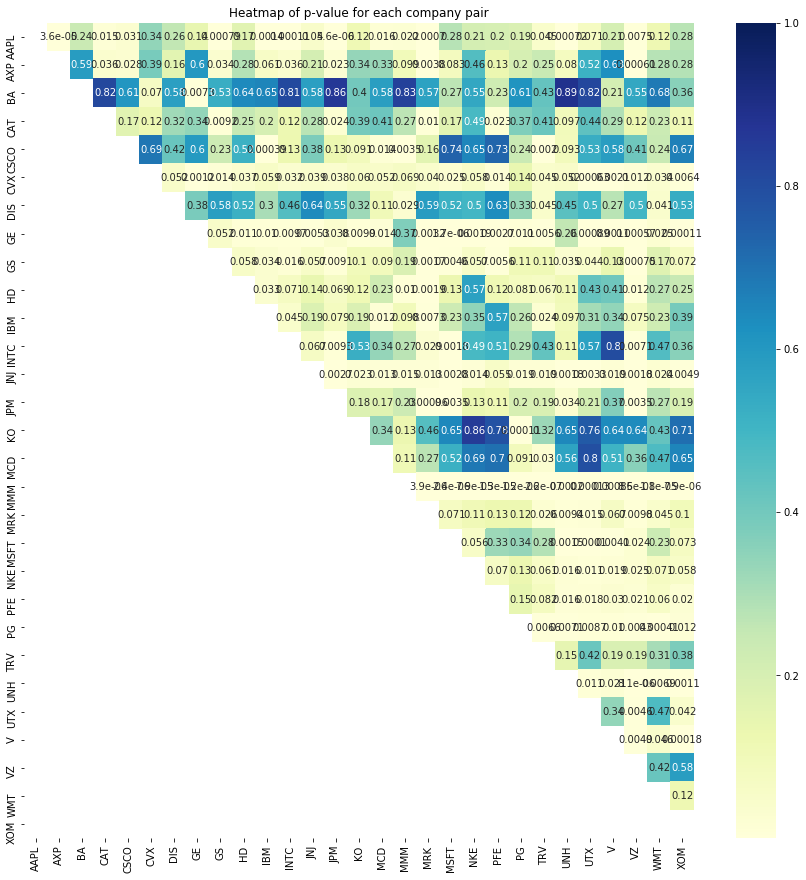

In [47]:
"""
# 新增testing data的pair trading
"""
from statsmodels.tsa.stattools import coint
import seaborn as sns

price_company = pd.DataFrame(columns = temp_c)
for c in temp_c:
    price_company[c] = np.hstack(price_and_return_for_test[c][0])[:trading_time]

# HD這間公司第一筆資料nan直接補0
price_company['HD'][0] = 0
# =============================================================================
# find_cointegrated_pairs
# =============================================================================
def find_cointegrated_pairs(data):
    n = data.shape[1]
    score_matrix = np.zeros((n, n))
    pvalue_matrix = np.ones((n, n))
    keys = data.keys()
    pairs = []
    for i in range(n):
        for j in range(i+1, n):
            S1 = data[keys[i]]
            S2 = data[keys[j]]
            result = coint(S1, S2)
            score = result[0]
            pvalue = result[1]
            score_matrix[i, j] = score
            pvalue_matrix[i, j] = pvalue
            if pvalue < 0.05:
                pairs.append((keys[i], keys[j]))
                
    return score_matrix, pvalue_matrix, pairs

# =============================================================================
# 用來確認temp_c這些公司是否符合cointegrate的假設檢定
# =============================================================================
print("Finding cointegrated pairs...")
scores, pvalues, pairs = find_cointegrated_pairs(price_company)
m = [0,0.2,0.4,0.6,0.8,1]

plt.figure(figsize=(15, 15))
sns.heatmap(pvalues, xticklabels = temp_c, 
                yticklabels = temp_c, cmap='YlGnBu', 
                mask = (pvalues >= 0.98), annot=True)
plt.title("Heatmap of p-value for each company pair")
plt.show()


In [48]:
# 所有符合cointegrated假設檢定(p-value < 0.05)的股票對
pairs

[('AAPL', 'AXP'),
 ('AAPL', 'CAT'),
 ('AAPL', 'CSCO'),
 ('AAPL', 'GS'),
 ('AAPL', 'IBM'),
 ('AAPL', 'INTC'),
 ('AAPL', 'JNJ'),
 ('AAPL', 'JPM'),
 ('AAPL', 'MCD'),
 ('AAPL', 'MMM'),
 ('AAPL', 'MRK'),
 ('AAPL', 'TRV'),
 ('AAPL', 'UNH'),
 ('AAPL', 'VZ'),
 ('AXP', 'CAT'),
 ('AXP', 'CSCO'),
 ('AXP', 'GS'),
 ('AXP', 'INTC'),
 ('AXP', 'JPM'),
 ('AXP', 'MRK'),
 ('AXP', 'VZ'),
 ('BA', 'GE'),
 ('CAT', 'GS'),
 ('CAT', 'JPM'),
 ('CAT', 'MRK'),
 ('CAT', 'PFE'),
 ('CSCO', 'IBM'),
 ('CSCO', 'MCD'),
 ('CSCO', 'MMM'),
 ('CSCO', 'TRV'),
 ('CVX', 'GE'),
 ('CVX', 'GS'),
 ('CVX', 'HD'),
 ('CVX', 'INTC'),
 ('CVX', 'JNJ'),
 ('CVX', 'JPM'),
 ('CVX', 'MRK'),
 ('CVX', 'MSFT'),
 ('CVX', 'PFE'),
 ('CVX', 'TRV'),
 ('CVX', 'UTX'),
 ('CVX', 'V'),
 ('CVX', 'VZ'),
 ('CVX', 'WMT'),
 ('CVX', 'XOM'),
 ('DIS', 'MMM'),
 ('DIS', 'TRV'),
 ('DIS', 'WMT'),
 ('GE', 'HD'),
 ('GE', 'IBM'),
 ('GE', 'INTC'),
 ('GE', 'JNJ'),
 ('GE', 'JPM'),
 ('GE', 'KO'),
 ('GE', 'MCD'),
 ('GE', 'MRK'),
 ('GE', 'MSFT'),
 ('GE', 'NKE'),
 ('GE', 'PFE'

# Draw Rule-based Trading buy and sell condition

In [49]:
def drawTradingCondition(c1, c2, price_and_return, day, window_l, window_s, trading_time, buy = 0, sell = 0, b_s = 0, s_s = 0, mode = 'rule'):
    # =============================================================================
    #  plot price ratio
    # =============================================================================
    c1_price = price_and_return[c1][0]
    c2_price = price_and_return[c2][0]
    S1 = c1_price[day,:trading_time]
    S2 = c2_price[day,:trading_time]
    
    print("Plot Price of %s and %s" % (c1, c2))
    plt.figure(figsize=(15,7))
    plt.plot(S1 - (np.mean(S1) - np.mean(S2)))
    plt.plot(S2)
    plt.title("Adjusted Price of %s and %s" % (c1, c2))
    plt.legend([c1,c2])
    plt.show()
    
    if mode == "rule":
        ratios = S1 / S2
        print("Plot Price ratio of %s and %s" % (c1, c2))
        plt.figure(figsize=(15,7))
        plt.plot(ratios)
        plt.axhline(ratios.mean(), color = 'r')
        plt.title("Price ratio of %s and %s" % (c1, c2))
        plt.legend(['Price Ratio'])
        plt.show()

        # =============================================================================
        #  plot z score of price ratio
        # =============================================================================
        z_ratio = (ratios - np.mean(ratios)) / np.std(ratios, dtype=np.float64)
        print("Plot z-score of price ratio of %s and %s" % (c1, c2))
        plt.figure(figsize=(15,7))
        #plt.plot(zscore(ratios))
        #plt.axhline(zscore(ratios).mean(), color='black')
        plt.plot(z_ratio)
        plt.axhline(np.mean(z_ratio), color='black')
        plt.axhline(1.0, color='red', linestyle='--')
        plt.axhline(-1.0, color='green', linestyle='--')
        plt.title("Z-score of price ratio of %s and %s" % (c1, c2))
        plt.legend(['Ratio z-score', 'Mean', '+1', '-1'])
        plt.show()

        # =============================================================================
        #  Pair-Trading : plot ratio and moving average (60 sec and 300 sec)
        # =============================================================================

        z_ratio = pd.DataFrame({'ratios':ratios})

        ratios_mavg_s = z_ratio.rolling(window = window_s, center = False).mean()

        ratios_mavg_l = z_ratio.rolling(window = window_l, center = False).mean()

        std_l = z_ratio.rolling(window = window_l, center = False).std()

        zscore_l_s = (ratios_mavg_s - ratios_mavg_l) / std_l

        print("Plot price ratio and its moving average of %s and %s" % (c1, c2))
        plt.figure(figsize=(15,7))
        plt.plot(z_ratio.index, z_ratio.values)
        plt.plot(ratios_mavg_s.index, ratios_mavg_s.values)
        plt.plot(ratios_mavg_l.index, ratios_mavg_l.values)
        plt.title("Price ratio and its moving average of %s and %s" % (c1, c2))
        plt.legend(['Ratio','%ss Ratio MA' % window_s, '%ss Ratio MA' % window_l])
        plt.ylabel('Ratio')
        plt.show()
        
        print("Plot z-score of long and short rolling price ratio of %s and %s" % (c1, c2))
        plt.figure(figsize=(15,7))
        plt.plot(zscore_l_s)
        plt.axhline(0, color='black')
        plt.axhline(1.0, color='red', linestyle='--')
        plt.axhline(-1.0, color='green', linestyle='--')
        plt.title("Z-score of long and short rolling price ratio of %s and %s" % (c1, c2))
        plt.legend(['Rolling Ratio z-Score', 'Mean', '+1', '-1'])
        plt.show()

        # =============================================================================
        # Plot the ratios and buy and sell signals from z score
        # =============================================================================
        print("Plot z-score and trading signal of price ratio of %s and %s" % (c1, c2))
        plt.figure(figsize=(15,7))
        plt.plot(z_ratio[window_l:])
        buy = z_ratio.copy()
        sell = z_ratio.copy()
        if isinstance(b_s, list):
            #buy.iloc[s_s] = 0
            #sell.iloc[b_s] = 0
            plt.plot(b_s, buy.iloc[b_s], color='g', linestyle='None', marker='^')
            plt.plot(s_s, sell.iloc[s_s], color='r', linestyle='None', marker='^')
        else:
            buy[zscore_l_s > -1] = 0
            sell[zscore_l_s < 1] = 0
            plt.plot(buy[window_l:],color='g', linestyle='None', marker='^')
            plt.plot(sell[window_l:],color='r', linestyle='None', marker='^')
        x1,x2,y1,y2 = plt.axis()
        plt.axis((x1,x2,ratios.min(),ratios.max()))
        plt.title("Z-score and trading signal of price ratio of %s and %s" % (c1, c2))
        plt.legend(['Ratio', 'Buy Signal', 'Sell Signal'])
        plt.show()

        # =============================================================================
        # Plot the prices and buy and sell signals from z score
        # =============================================================================
        print("Trading signal of %s and %s" % (c1, c2))
        plt.figure(figsize=(18,9))
        S1 = pd.DataFrame({c1: (S1 - (S1.mean()-S2.mean()))}) # 後面-55故意寫上去比較好看曲線
        S2 = pd.DataFrame({c2: S2}) 
        plt.plot(S1[window_l:],color='b')
        plt.plot(S2[window_l:],color='c')
        buyR = 0 * S1.copy()
        sellR = 0 * S1.copy()

        if isinstance(b_s, list):
            # When buying the ratio, buy S1 and sell S2
            buyR.iloc[b_s] = S1.iloc[b_s]
            sellR.iloc[b_s] = S2.iloc[b_s]
            # When selling the ratio, sell S1 and buy S2
            buyR.iloc[s_s] = S2.iloc[s_s]
            sellR.iloc[s_s] = S1.iloc[s_s]
            
        else:
            # When buying the ratio, buy S1 and sell S2
            flag_buy = np.where(np.array(buy).ravel() != 0)[0]
            buyR.iloc[flag_buy] = S1.iloc[flag_buy]
            sellR.iloc[flag_buy] = S2.iloc[flag_buy]
            # When selling the ratio, sell S1 and buy S2
            flag_sell = np.where(np.array(sell).ravel() != 0)[0]
            buyR.iloc[flag_sell] = S2.iloc[flag_sell]
            sellR.iloc[flag_sell] = S1.iloc[flag_sell]

        plt.plot(buyR[window_l:],color='g', linestyle='None', marker='^')
        plt.plot(sellR[window_l:],color='r', linestyle='None', marker='^')
        x1,x2,y1,y2 = plt.axis()
        plt.axis((x1,x2,min(S1.min()[0],S2.min()[0]),max(S1.max()[0],S2.max()[0])))
        plt.title("Adjusted Trading signal of %s and %s" % (c1, c2))
        plt.legend([c1, c2, 'Buy Signal', 'Sell Signal'])
        plt.show()
        
    # NN作圖
    else:
        ratios = S1 / S2
        z_ratio = pd.DataFrame({'ratios':ratios})
        # =============================================================================
        # Plot the ratios and buy and sell signals from z score
        # =============================================================================
        print("Plot z-score and trading signal of price ratio of %s and %s" % (c1, c2))
        plt.figure(figsize=(15,7))
        plt.plot(z_ratio)
        buyR = z_ratio.copy()
        sellR = z_ratio.copy()
        
#         plt.plot(buyR.index, buyR.iloc[np.where(buy == 0)[0]], color='g', linestyle='None', marker='^')
#         plt.plot(sellR.index, sell.iloc[np.where(sell == 0)[0]], color='r', linestyle='None', marker='^')
        plt.plot(buy, buyR.iloc[buy], color='g', linestyle='None', marker='^')
        plt.plot(sell, sellR.iloc[sell], color='r', linestyle='None', marker='^')
        x1,x2,y1,y2 = plt.axis()
        plt.axis((x1,x2,ratios.min(),ratios.max()))
        plt.title("Z-score and trading signal of price ratio of %s and %s" % (c1, c2))
        plt.legend(['Ratio', 'Buy Signal', 'Sell Signal'])
        plt.show()
        
        print("Trading signal of %s and %s for learning-based pair trading" % (c1, c2))
        plt.figure(figsize=(18,9))
        S1 = pd.DataFrame({c1: (S1 - (S1.mean() -  S2.mean()))})
        S2 = pd.DataFrame({c2: S2})
        plt.plot(S1,color='b')
        plt.plot(S2,color='c')
        buyR = 0 * S1.copy()
        sellR = 0 * S1.copy()
        
        '''
        # When buying the ratio, buy S1 and sell S2
        flag_buy = np.where(buy != 0)[0]
        buyR.iloc[flag_buy] = S1.iloc[flag_buy]
        sellR.iloc[flag_buy] = S2.iloc[flag_buy]
        # When selling the ratio, sell S1 and buy S2
        flag_sell = np.where(sell != 0)[0]
        buyR.iloc[flag_sell] = S2.iloc[flag_sell]
        sellR.iloc[flag_sell] = S1.iloc[flag_sell]
        '''
        # When buying the ratio, buy S1 and sell S2
        buyR.iloc[buy] = S1.iloc[buy]
        sellR.iloc[buy] = S2.iloc[buy]
        # When selling the ratio, sell S1 and buy S2
        buyR.iloc[sell] = S2.iloc[sell]
        sellR.iloc[sell] = S1.iloc[sell]

        plt.plot(buyR,color='g', linestyle='None', marker='^')
        plt.plot(sellR,color='r', linestyle='None', marker='^')
        x1,x2,y1,y2 = plt.axis()
        plt.axis((x1,x2,min(S1.min()[0],S2.min()[0]),max(S1.max()[0],S2.max()[0])))
        plt.title("Adjusted Trading signal of %s and %s for learning-based pair trading" % (c1, c2))
        plt.legend([c1, c2, 'Buy Signal', 'Sell Signal'])
        plt.show()
    

# Draw Accumulated Profit and Profit for each day

In [50]:
def draw_profit(profit_day, date_test_noyear, period, mode = "Rule-based", profit_Mode = 0):
    
    # 累積收益
    fig = plt.gcf()
    plt.figure(figsize=(15,7))
    if profit_Mode == 0:
        plt.plot(np.cumsum(profit_day))
    else:
        plt.plot(np.cumprod(profit_day))
    plt.xticks(range(day_test), date_test_noyear)
    plt.title('Accumulated Profit between %s and %s in Month %s by %s pair trading' % (p[0], p[1], period[0], mode))
    plt.style.use("bmh")
    plt.xlim(0,19)
    plt.xlabel('Day')
    plt.ylabel('Profit')
    plt.show()
    
    # 分開畫
    fig = plt.gcf()
    plt.figure(figsize=(15,7))
    plt.plot(profit_day)
    plt.xticks(range(day_test), date_test_noyear)
    plt.title('Profit between %s and %s for each trading day in Month %s by %s pair trading' % (p[0], p[1], period[0], mode))
    plt.style.use("bmh")
    plt.xlim(0,19)
    plt.xlabel('Day')
    plt.ylabel('Profit')
    plt.show()

# Rule-based Pair Trading
為了和NN的設定盡可能接近：
- 每Shift_length個時間點內最多只能持有一股，Shift_length時間到強制清算

<Figure size 432x288 with 0 Axes>

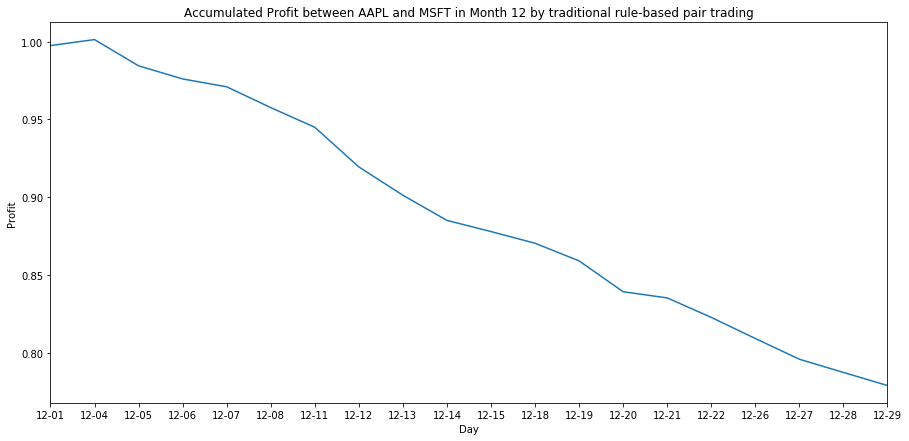

In [51]:
# 這邊是用price ratio來做策略
p = ['AAPL', 'MSFT']
#p = ['MRK', 'MSFT']
load_data = 1
# load back
if load_data == 0:
    profit_day = []
    for i in range(day_test):
        print("[Day %s]" % str(i+1))
        S1 = pd.DataFrame({p[0]: price_and_return_for_test[p[0]][0][i,:]})
        S2 = pd.DataFrame({p[1]: price_and_return_for_test[p[1]][0][i,:]})
        # lock長時間的window = 60
        #best_window = [zscore_trade_train(S1, S2, c1, c2, price_data_for_test, price_and_return_for_test, l, 60, day, profit_Mode = profit_Mode) for l in range(5, 60, 2)]
        profit, b_s, s_s = zscore_trade(S1, S2, p[0], p[1], price_data_for_test, price_and_return_for_test, window_s, window_l, i, show_print = 0, rollingMode = rollingMode, profit_Mode = profit_Mode)
        profit_day.append(profit)
        drawTradingCondition(p[0], p[1], price_and_return_for_test, i, window_l, window_s, trading_time, b_s = b_s, s_s = s_s)
else:
    profit_day = np.load("predictresult/profit_Rule-basedPairTrading_%s_%s_%s_%d_shiftlength%d.npy" % ("2019-07-26", p[0], p[1], period_test[0], shift_length))

# Plot profit
fig = plt.gcf()
plt.figure(figsize=(15,7))
if profit_Mode == 0:
    plt.plot(np.cumsum(profit_day))
else:
    plt.plot(np.cumprod(profit_day))
plt.xticks(range(day_test), date_test_noyear)
plt.title('Accumulated Profit between %s and %s in Month %s by traditional rule-based pair trading' % (p[0], p[1], period_test[0]))
plt.style.use("bmh")
plt.xlim(0,19)
plt.xlabel('Day')
plt.ylabel('Profit')
plt.show()

<Figure size 432x288 with 0 Axes>

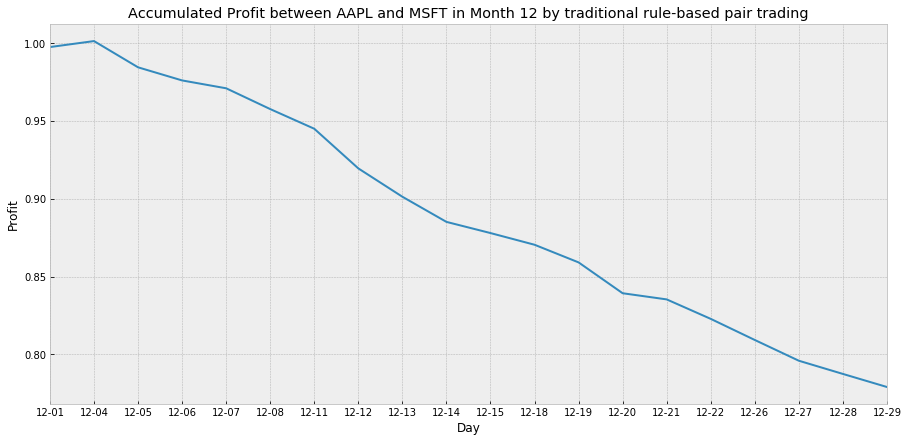

In [52]:
fig = plt.gcf()
plt.figure(figsize=(15,7))
if profit_Mode == 0:
    plt.plot(np.cumsum(profit_day))
else:
    plt.plot(np.cumprod(profit_day))
plt.xticks(range(day_test), date_test_noyear)
plt.title('Accumulated Profit between %s and %s in Month %s by traditional rule-based pair trading' % (p[0], p[1], period_test[0]))
plt.style.use("bmh")
plt.xlim(0,19)
plt.xlabel('Day')
plt.ylabel('Profit')
plt.show()

<Figure size 432x288 with 0 Axes>

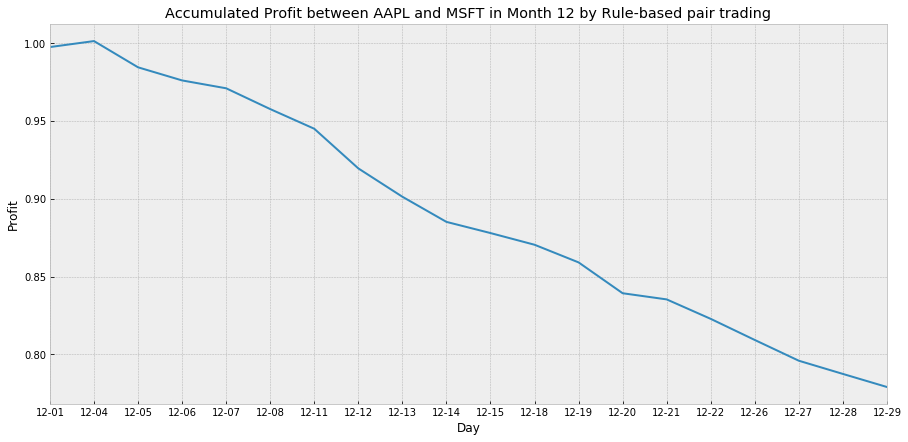

<Figure size 432x288 with 0 Axes>

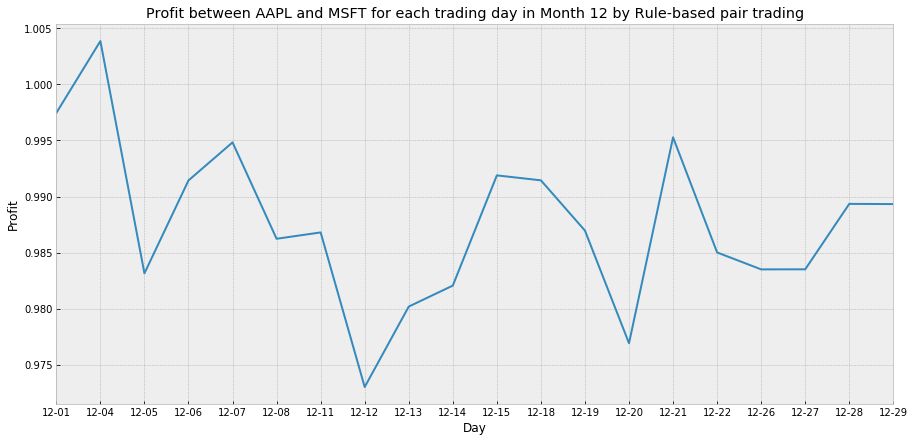

In [53]:
draw_profit(profit_day, date_test_noyear, period_test, profit_Mode = profit_Mode)

In [54]:
# """
# 測試rule-based pair trading背後的運作原理
# """
# t = 2000
# print("[Day %s]" % str(i+1))
# S1 = pd.DataFrame({p[0]: price_and_return_for_test[p[0]][0][i,:t]})
# S2 = pd.DataFrame({p[1]: price_and_return_for_test[p[1]][0][i,:t]})
# profit, b_s, s_s = zscore_trade(S1, S2, p[0], p[1], window_s, window_l, show_print = 1, profit_Mode = profit_Mode)
# drawTradingCondition(p[0], p[1], price_and_return_for_test, i, window_l, window_s, t, b_s = b_s, s_s = s_s)

In [55]:
# b_s # 測試的

# 設計improved GGNN的 pair trading

In [56]:
def predict(dataloader, net, is_train = 0, split_question = 0):
    if is_train == 0:
        net.eval()
    print("Predict Result....")
    loss = 0
    correct = 0
    pred_list = []
    
    # inference
    for i, (input_feature, question, adj_matrix) in enumerate(dataloader, 0):
        
        '''
        07/11更新，
        把question embedding處理
        '''
        if split_comques == 0:
            padding = torch.zeros(len(input_feature), state_dim - question_dim)
            question_padding = torch.cat((question, padding), -1)
        else:
            question_padding = question
        
        if cuda == 1:
#            init_input = init_input.cuda()
            input_feature = input_feature.cuda()
            adj_matrix = adj_matrix.cuda()
            question_padding = question_padding.cuda()
        '''
        input_feature = Variable(input_feature.double())
        adj_matrix = Variable(adj_matrix.double())
        question_padding = Variable(question_padding.double())
        '''
        if split_question == 0:
            test_output = net(input_feature, question_padding, adj_matrix)
            pred_y = torch.max(test_output, 1)[1].data.cpu().numpy()
            pred_list.append(pred_y)
        else:
            output_test_q1, output_test_q2, output_test_q3 = net(input_feature, question_padding, adj_matrix)
            pred_y_q1 = torch.max(output_test_q1, 1)[1].data.cpu().numpy()
            pred_y_q2 = torch.max(output_test_q2, 1)[1].data.cpu().numpy()
            pred_y_q3 = torch.max(output_test_q3, 1)[1].data.cpu().numpy()
            pred_list.append([pred_y_q1, pred_y_q2, pred_y_q3])
    
    # release memory for testing
    if split_question == 0:
        del test_output, input_feature, adj_matrix, question, question_padding
    else:
        del output_test_q1, output_test_q2, output_test_q3, input_feature, adj_matrix, question, question_padding
        
    torch.cuda.empty_cache()
    print("Prediction Finished !")
    
    #return predict result
    if split_question == 0:
        #return pred_y
        return pred_list
    else:
        #return (pred_y_q1, pred_y_q2, pred_y_q3)
        return pred_list

In [57]:
def predictDataloader(price_data, price_and_return, adjacency_matrix, all_com_pair_P, c1, c2, day, qtype, show_shape = 0, show_data = 0):
    '''
    pair trading的dataloader function
    ---
    生成帶有v, q, adj的dataloader
    v : test data
    q : 某個問題
    c1, c2 : 目標的兩間公司
    '''
    #vqa_pair_for_test = vqa_pair_efficient(all_com_pair_P, is_train = 0)
    #v_test, _, _ = generate_vqa(vqa_pair_for_test, "test")
    v_test = rolling(price_data, price_and_return, v_length, shift_length, day, mode = 'return')[0]
    print("v_test shape for day %s :" % str(day+1), v_test.shape)
    
    # 生成問題
    q_eye = np.eye(3)
    if qtype == 'Pairwise Price Change':
        q_test = np.concatenate([onehotCompany[str2companycode(c1)], onehotCompany[str2companycode(c2)], q_eye[0]])
    elif qtype == 'Strength':
        q_test = np.concatenate([onehotCompany[str2companycode(c1)], onehotCompany[str2companycode(c2)], q_eye[1]])
    else:
        q_test = np.concatenate([onehotCompany[str2companycode(c1)], onehotCompany[str2companycode(c2)], q_eye[2]])
    q_test = np.tile(q_test, (v_test.shape[0],1))
    #print(q_test.shape)
    
    # numpy to tensor
    v_testing = torch.Tensor(v_test)
    q_testing = torch.Tensor(q_test)
    adjacency_matrix_test = torch.Tensor(np.expand_dims(adjacency_matrix, 0)).repeat(v_testing.size(0),1,1)
        
    if show_shape == 1:
        print("v_test.shape = ", v_testing.shape)
        print("q_test.shape = ", q_testing.shape)
        print("adjacency_matrix.shape = " + str(adjacency_matrix_test.size()))

    # testing dataset
    djiaPredictDataset = torch.utils.data.TensorDataset(v_testing, q_testing, adjacency_matrix_test)
    djiaPredictDataLoader = torch.utils.data.DataLoader(djiaPredictDataset, batch_size = 32, shuffle = False)
    
    if show_data == 1:
        return djiaPredictDataLoader, (v_test, q_test)
    else:
        return djiaPredictDataLoader

In [58]:
load_m = 0
if load_m == 1:
    # load model back
    net, _, _ = loadGraphGRUModel(adjacency_matrix_Edge, split_question, show_layer = show_layer)
    net.load_state_dict(torch.load('/mnt/sda1/chia/model/twoPhaseGraphGRU_attentionOn_resampleOn_splitQuestion_2019-07-09_nstep5_stateDim64_nNode29_Epoch100_LinearOutput_allin_efficientVQA'))

In [59]:
#p = ['AAPL', 'CSCO']
#p = ['MRK', 'MSFT']
# 兩間公司三種問題的dataloader
predDataloader_q1, vq1_pairtrad = predictDataloader(price_data_for_test, price_and_return_for_test, adjacency_matrix_Edge_test, all_com_pair_P, p[0], p[1], 0, qtype[0], show_shape = 0, show_data = 1)
predDataloader_q2, vq2_pairtrad = predictDataloader(price_data_for_test, price_and_return_for_test, adjacency_matrix_Edge_test, all_com_pair_P, p[0], p[1], 0, qtype[1], show_shape = 0, show_data = 1)
predDataloader_q3, vq3_pairtrad = predictDataloader(price_data_for_test, price_and_return_for_test, adjacency_matrix_Edge_test, all_com_pair_P, p[0], p[1], 0, qtype[2], show_shape = 0, show_data = 1)

# 用NN預測問題
q1a = predict(predDataloader_q1, net, is_train = 0, split_question = split_question)
q2a = predict(predDataloader_q2, net, is_train = 0, split_question = split_question)
q3a = predict(predDataloader_q3, net, is_train = 0, split_question = split_question)

v_test shape for day 1 : (154, 29, 299)
v_test shape for day 1 : (154, 29, 299)
v_test shape for day 1 : (154, 29, 299)
Predict Result....
Random pick time step :  [  4   7  16  28  30  31  48  59  63  66  68  73  76  77  82  83  92  98
 101 108 118 130 138 141 144 147 148 149 169 171 172 176 182 184 187 191
 197 200 207 208 210 211 212 219 220 223 224 227 231 235 249 255 259 260
 264 265 268 269 270 274 277 281 285 290]
Random pick time step :  [  7  13  24  35  41  46  49  52  67  69  76  78  80  86  87  89  90  94
  98 105 106 107 108 114 119 120 122 126 141 154 164 168 171 174 178 187
 191 195 198 200 202 204 205 206 212 214 217 222 234 236 239 240 242 246
 251 261 282 284 286 289 290 293 297 298]
Random pick time step :  [  0   2   5  13  21  22  30  32  42  47  54  55  57  69  71  72  73  80
  90  93  94  95 100 103 108 109 124 130 131 134 136 138 139 140 148 154
 157 158 159 163 164 166 167 168 172 182 183 188 197 208 209 210 214 218
 222 226 228 234 238 255 256 263 287 292]
Ran

In [60]:
q1a1, q1a2, q1a3 = np.hstack([d[0] for d in q1a]), np.hstack([d[1] for d in q1a]), np.hstack([d[2] for d in q1a])
q2a1, q2a2, q2a3 = np.hstack([d[0] for d in q2a]), np.hstack([d[1] for d in q2a]), np.hstack([d[2] for d in q2a])
q3a1, q3a2, q3a3 = np.hstack([d[0] for d in q3a]), np.hstack([d[1] for d in q3a]), np.hstack([d[2] for d in q3a])

In [61]:
vq1_pairtrad[1][0], vq2_pairtrad[1][0], vq3_pairtrad[1][0]

(array([1., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.,
        0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.,
        0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 1., 0., 0., 0.,
        0., 0., 0., 0., 0., 0., 0., 1., 0., 0.]),
 array([1., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.,
        0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.,
        0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 1., 0., 0., 0.,
        0., 0., 0., 0., 0., 0., 0., 0., 1., 0.]),
 array([1., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.,
        0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.,
        0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 1., 0., 0., 0.,
        0., 0., 0., 0., 0., 0., 0., 0., 0., 1.]))

In [62]:
q1a1, q2a2, q3a3

(array([2, 2, 2, 2, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 1,
        2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 1, 2, 1, 2,
        1, 2, 3, 2, 2, 2, 3, 2, 2, 1, 2, 1, 2, 1, 1, 2, 2, 1, 2, 2, 2, 3,
        2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2,
        2, 2, 2, 2, 2, 2, 2, 2, 1, 2, 2, 2, 2, 2, 2, 2, 1, 2, 2, 2, 2, 1,
        2, 2, 2, 2, 2, 1, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 1, 2, 2, 2, 2, 2,
        2, 2, 2, 2, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2]),
 array([2, 1, 2, 2, 2, 2, 2, 2, 1, 2, 2, 2, 2, 1, 2, 2, 2, 2, 2, 2, 2, 2,
        2, 2, 2, 2, 2, 2, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 1, 1, 1, 1, 2, 1,
        2, 1, 1, 2, 2, 1, 1, 1, 2, 2, 2, 1, 1, 2, 1, 2, 2, 1, 2, 2, 2, 2,
        2, 2, 2, 2, 2, 2, 2, 2, 1, 2, 1, 2, 2, 1, 2, 2, 2, 2, 2, 2, 2, 2,
        2, 2, 2, 2, 1, 2, 2, 1, 1, 2, 2, 1, 2, 1, 2, 2, 2, 1, 2, 2, 2, 2,
        2, 2, 1, 2, 2, 2, 1, 2, 2, 2, 2, 1, 2, 2, 2, 2, 2, 1, 1, 1, 1, 2,
        1, 1, 1, 2, 2, 1, 1, 2, 1, 2

# Learning-based Pair Trading

In [63]:
# Trade using a simple strategy
def NN_trade(S1, S2, c1, c2, price_data, price_and_return, net, day, show_print = 0, fee = 0, profit_Mode = 0):
    ''' 
    buys 1 ratio (buy 1 AAPL stock and sell ratio x MSFT stock) when ratio is low, 
    sell 1 ratio (sell 1 AAPL stock and buy ratio x MSFT stock) when it's high, 
    and calculate PnL (profit and loss，損益) of these trades.
    '''

    # Compute rolling mean and rolling standard deviation
    ratios = pd.DataFrame({"ratios" : (S1.values/S2.values).ravel()})
    
    c1_idx = sorted(temp_c).index(c1)
    c2_idx = sorted(temp_c).index(c2)
    
    roll_pair = rolling(price_data, price_and_return, v_length, shift_length, day, mode = 'price')
    roll_v, roll_v_answer, position = roll_pair[0][:,[c1_idx,c2_idx],:], roll_pair[1][:,[c1_idx,c2_idx],:], roll_pair[2]
    position = sorted([list(x) for x in set(tuple(x) for x in position)])
    
    # 兩間公司三種問題的dataloader
    predDataloader_q1 = predictDataloader(price_data, price_and_return, adjacency_matrix_Edge_test, all_com_pair_P, c1, c2, day, qtype[0], show_shape = 0)
    predDataloader_q2 = predictDataloader(price_data, price_and_return, adjacency_matrix_Edge_test, all_com_pair_P, c1, c2, day, qtype[1], show_shape = 0)
    predDataloader_q3 = predictDataloader(price_data, price_and_return, adjacency_matrix_Edge_test, all_com_pair_P, c1, c2, day, qtype[2], show_shape = 0)
    
    # 用NN預測問題
    q1a = predict(predDataloader_q1, net, is_train = 0, split_question = split_question)
    q2a = predict(predDataloader_q2, net, is_train = 0, split_question = split_question)
    q3a = predict(predDataloader_q3, net, is_train = 0, split_question = split_question)

    if split_question == 1:
        # 分問題，理應只有q1a1, q2a2, q3a3有用
        q1a1, q1a2, q1a3 = np.hstack([d[0] for d in q1a]), np.hstack([d[1] for d in q1a]), np.hstack([d[2] for d in q1a])
        q2a1, q2a2, q2a3 = np.hstack([d[0] for d in q2a]), np.hstack([d[1] for d in q2a]), np.hstack([d[2] for d in q2a])
        q3a1, q3a2, q3a3 = np.hstack([d[0] for d in q3a]), np.hstack([d[1] for d in q3a]), np.hstack([d[2] for d in q3a])
    else:
        q1a1, q1a2, q1a3 = np.vstack(q1a)[:,:4], np.vstack(q1a)[:,4:7], np.vstack(q1a)[:,7:]
        q2a1, q2a2, q2a3 = np.vstack(q2a)[:,:4], np.vstack(q2a)[:,4:7], np.vstack(q2a)[:,7:]
        q3a1, q3a2, q3a3 = np.vstack(q3a)[:,:4], np.vstack(q3a)[:,4:7], np.vstack(q3a)[:,7:]
    
    # Learning-based trading
    # Start with no money and no positions
    if profit_Mode == 0:
        money = 0
    else:
        money = 1
    countS1 = 0
    countS2 = 0
    #buy = np.ones(len(ratios))
    #sell = np.ones(len(ratios))
    buy = []
    sell = []

    # 總共有v_test.shape[0]個決策點，一天的前300秒不做決策，每60秒做一次決策，一次買賣一口
    for i in range(roll_v.shape[0]):
        if show_print == 1:
            print("---------[Time = %s to %s]---------" % (position[i][2], position[i][3]))
            print("Current profit : ", " profit - ", money)
        # t0入場，t60出場
        S1_t0, S1_t60 = roll_v_answer[i][0][0], roll_v_answer[i][0][-1]
        S2_t0, S2_t60 = roll_v_answer[i][1][0], roll_v_answer[i][1][-1]
        entry_time = position[i][2]-1
        exit_time = position[i][3]-1
        
        # NN系列預測的策略
        
        '''
        # Sell short if Volatility1 < Volatility2
        if q3a3[i] == 2:    
            # 交易成本部分： 0.00231%的交易稅、各0.5%的手續費
            if fee == 1:
                money += S1_t0 - S2_t0 * ratios.iloc[entry_time][0] - 0.0000231 * S1_t0 - 0.005 * S1_t0 - 0.005 * S2_t0 * ratios.iloc[entry_time]
            else:
                money += S1_t0 - S2_t0 * ratios.iloc[entry_time][0]

            countS1 -= 1
            countS2 += ratios.iloc[entry_time][0]

            #sell[entry_time] = 0
            sell.append(entry_time)

            if show_print == 1:
                print('[Sell %s and Buy %s] profit %s | price ratios %s | C1 %s pos | C2 %s pos'% (c1, c2, money, ratios.iloc[entry_time][0], countS1, countS2))

        # Buy long if Volatility1 > Volatility2
        elif q3a3[i] == 1:    
            # 交易成本部分： 0.00231%的交易稅、各0.5%的手續費
            if fee == 1:
                money -= S1_t0 - S2_t0 * ratios.iloc[entry_time][0] - 0.0000231 * S2_t0 * ratios.iloc[entry_time][0] - 0.005 * S1_t0 - 0.005 * S2_t0 * ratios.iloc[entry_time][0]
            else:
                money -= S1_t0 - S2_t0 * ratios.iloc[entry_time][0]

            countS1 += 1
            countS2 -= ratios.iloc[entry_time][0]

            #buy[entry_time] = 0
            buy.append(entry_time)

            if show_print == 1:
                print('[Buy %s and Sell %s] profit %s | price ratios %s | C1 %s pos | C2 %s pos'% (c1, c2, money, ratios.iloc[entry_time][0], countS1, countS2))
        
        '''
        # if Pairwise Price Change BothRise
        if (q1a1[i] == 1):
            '''
            07/10更新，先把強弱勢註解掉
            因為同漲同跌這些跟強弱勢已經有點相同了，改用波動率
            '''
            # Sell short if Strength1 < Strength2
            # Sell short if Volatility1 < Volatility2
            #if q2a2[i] == 2:
            if q3a3[i] == 2:  
                # 交易成本部分： 0.00231%的交易稅、各0.5%的手續費
                ratio = S1_t0 / S2_t0
                #print(entry_time, ratios.iloc[entry_time][0])
                if profit_Mode == 0:
                    if fee == 1:
                        money += S1_t0 - S2_t0 * ratio - 0.0000231 * S1_t0 - 0.005 * S1_t0 - 0.005 * S2_t0 * ratio
                    else:
                        money += S1_t0 - S2_t0 * ratio

                countS1 -= 1
                countS2 += ratio
                
                #sell[entry_time] = 0
                sell.append(entry_time)
                
                if show_print == 1:
                    print("[Pairwise Price Change BothRise and Volatility1 < Volatility2]")
                    print('[Sell %s and Buy %s] profit %s | price ratios %s | C1 %s pos | C2 %s pos'% (c1, c2, money, ratio, countS1, countS2))
                    print('%s price - %s revenue - %s | %s price - %s payment - %s |' % (c1, S1_t0, S1_t0, c2, S2_t0, S2_t0 * ratio))
                    
            # Buy long if Strength1 > Strength2
            # Buy long if Volatility1 > Volatility2
            #elif q2a2[i] == 1:
            elif q3a3[i] == 1:    
                # 交易成本部分： 0.00231%的交易稅、各0.5%的手續費
                ratio = S1_t0 / S2_t0
                #print(entry_time, ratios.iloc[entry_time][0])
                if profit_Mode == 0:
                    if fee == 1:
                        money -= S1_t0 - S2_t0 * ratio - 0.0000231 * S2_t0 * ratio - 0.005 * S1_t0 - 0.005 * S2_t0 * ratio
                    else:
                        money -= S1_t0 - S2_t0 * ratio

                countS1 += 1
                countS2 -= ratio
                
                #buy[entry_time] = 0
                buy.append(entry_time)

                if show_print == 1:
                    print("[Pairwise Price Change BothRise and Volatility1 > Volatility2]")
                    print('[Buy %s and Sell %s] profit %s | price ratios %s | C1 %s pos | C2 %s pos'% (c1, c2, money, ratio, countS1, countS2))
                    print('%s price - %s payment - %s | %s price - %s revenue - %s |' % (c1, S1_t0, S1_t0, c2, S2_t0, S2_t0 * ratio))
                    
        # if Pairwise Price Change BothFall
        elif (q1a1[i] == 2):
            # Sell short if Strength1 < Strength2
            # Sell short if Volatility1 > Volatility2
            #if q2a2[i] == 2:
            if q3a3[i] == 1:
                # 交易成本部分： 0.00231%的交易稅、各0.5%的手續費
                ratio = S1_t0 / S2_t0
                #print(entry_time, ratios.iloc[entry_time][0])
                if profit_Mode == 0:
                    if fee == 1:
                        money += S1_t0 - S2_t0 * ratio - 0.0000231 * S1_t0 - 0.005 * S1_t0 - 0.005 * S2_t0 * ratio
                    else:
                        money += S1_t0 - S2_t0 * ratio

                countS1 -= 1
                countS2 += ratio
                
                #sell[entry_time] = 0
                sell.append(entry_time)
                
                if show_print == 1:
                    print("[Pairwise Price Change BothFall and Volatility1 > Volatility2]")
                    print('[Sell %s and Buy %s] profit %s | price ratios %s | C1 %s pos | C2 %s pos'% (c1, c2, money, ratio, countS1, countS2))
                    print('%s price - %s revenue - %s | %s price - %s payment - %s |' % (c1, S1_t0, S1_t0, c2, S2_t0, S2_t0 * ratio))
                    
            # Buy long if Strength1 > Strength2
            # Buy long if Volatility1 < Volatility2
            #elif q2a2[i] == 1:
            elif q3a3[i] == 2: 
                # 交易成本部分： 0.00231%的交易稅、各0.5%的手續費
                ratio = S1_t0 / S2_t0
                #print(entry_time, ratios.iloc[entry_time][0])
                if profit_Mode == 0:
                    if fee == 1:
                        money -= S1_t0 - S2_t0 * ratio - 0.0000231 * S2_t0 * ratio - 0.005 * S1_t0 - 0.005 * S2_t0 * ratio
                    else:
                        money -= S1_t0 - S2_t0 * ratio

                countS1 += 1
                countS2 -= ratio
                
                #buy[entry_time] = 0
                buy.append(entry_time)

                if show_print == 1:
                    print("[Pairwise Price Change BothFall and Volatility1 < Volatility2]")
                    print('[Buy %s and Sell %s] profit %s | price ratios %s | C1 %s pos | C2 %s pos'% (c1, c2, money, ratio, countS1, countS2))
                    print('%s price - %s payment - %s | %s price - %s revenue - %s |' % (c1, S1_t0, S1_t0, c2, S2_t0, S2_t0 * ratio))
        
        # Sell short if Pairwise Price Change Reverse and Strength1 < Strength2
        elif (q1a1[i] == 3 and q2a2[i] == 2):
            # 交易成本部分： 0.00231%的交易稅、各0.5%的手續費
            ratio = S1_t0 / S2_t0
            #print(entry_time, ratios.iloc[entry_time][0])
            if profit_Mode == 0:
                if fee == 1:
                    money += S1_t0 - S2_t0 * ratio - 0.0000231 * S1_t0 - 0.005 * S1_t0 - 0.005 * S2_t0 * ratio
                else:
                    money += S1_t0 - S2_t0 * ratio
                
            countS1 -= 1
            countS2 += ratio
            
            #sell[entry_time] = 0
            sell.append(entry_time)
            
            if show_print == 1:
                print("[Pairwise Price Change Reverse and Strength1 < Strength2]")
                print('[Sell %s and Buy %s] profit %s | price ratios %s | C1 %s pos | C2 %s pos'% (c1, c2, money, ratio, countS1, countS2))
                print('%s price - %s revenue - %s | %s price - %s payment - %s |' % (c1, S1_t0, S1_t0, c2, S2_t0, S2_t0 * ratio))
        
        # Buy long if Pairwise Price Change Reverse and Strength1 > Strength2
        elif (q1a1[i] == 3 and q2a2[i] == 1):
            # 交易成本部分： 0.00231%的交易稅、各0.5%的手續費
            ratio = S1_t0 / S2_t0
            #print(entry_time, ratios.iloc[entry_time][0])
            if profit_Mode == 0:
                if fee == 1:
                    money -= S1_t0 - S2_t0 * ratio - 0.0000231 * S2_t0 * ratio - 0.005 * S1_t0 - 0.005 * S2_t0 * ratio
                else:
                    money -= S1_t0 - S2_t0 * ratio
                
            countS1 += 1
            countS2 -= ratio
            
            #buy[entry_time] = 0
            buy.append(entry_time)
            
            if show_print == 1:
                print("[Pairwise Price Change Reverse and Strength1 > Strength2]")
                print('[Buy %s and Sell %s] profit %s | price ratios %s | C1 %s pos | C2 %s pos'% (c1, c2, money, ratio, countS1, countS2))
                print('%s price - %s payment - %s | %s price - %s revenue - %s |' % (c1, S1_t0, S1_t0, c2, S2_t0, S2_t0 * ratio))

        # Clear positions for each decision point  
        # 交易成本部分： 0.00231%的交易稅 、各0.5%的手續費
        ratio = S1_t0 / S2_t0
        #print(exit_time, ratios.iloc[exit_time][0])
        if profit_Mode == 0:
            if fee == 1:
                money += countS1 * S1_t60 + S2_t60 * countS2 - 0.0000231 * (countS1 * S1_t60 + countS2 * S2_t60) - 0.005 * (S1_t60 * countS1 + S2_t60 * countS2)
            else:
                money += countS1 * S1_t60 + S2_t60 * countS2
        else:    # profit rate
            if fee == 1:
                money *= 1 + (-countS1 * S1_t60 + S2_t60 * -countS2 - 0.0000231 * (abs(countS1) * S1_t60 + abs(countS2) * S2_t60) - 0.005 * (S1_t60 * abs(countS1) + S2_t60 * abs(countS2))) / (S1_t0 + S2_t0)
            else:
                money *= 1 + (-countS1 * S1_t60 + S2_t60 * -countS2) / (S1_t0 + S2_t0)

        if show_print == 1:
            print('[Exit position] profit %s | price ratios %s | C1 %s pos | C2 %s pos'% (money, ratio, -countS1, -countS2))
            print('%s price - %s, earn : %s | %s price - %s, earn : %s |' % (c1, S1_t60, -countS1 * S1_t60, c2, S2_t60, -countS2 * S2_t60))
        
        # clear position
        countS1, countS2 = 0, 0
        
    return money, buy, sell, (q1a1, q2a2, q3a3)

[Day 1]
v_test shape for day 1 : (154, 29, 299)
v_test shape for day 1 : (154, 29, 299)
v_test shape for day 1 : (154, 29, 299)
Predict Result....
Random pick time step :  [  2   6  12  13  16  18  21  26  29  32  34  46  49  50  53  61  62  68
  72  77  80  82  85  86  88  90  99 105 108 109 119 124 128 130 133 146
 152 161 166 171 179 183 187 192 197 198 204 205 207 209 210 212 214 221
 226 229 231 232 241 269 272 273 278 292]
Random pick time step :  [ 15  31  34  45  50  51  54  58  59  60  64  65  66  74  90  98 100 111
 112 126 129 137 145 146 159 160 161 162 164 167 170 172 176 182 186 188
 197 198 202 206 217 221 222 224 230 231 235 239 241 242 243 245 246 250
 257 262 263 266 269 280 285 286 293 296]
Random pick time step :  [  2   3   5   8  14  17  23  26  29  32  35  45  46  48  55  59  71  73
  75  81  87  90  92  99 102 103 116 117 118 119 136 141 145 155 161 166
 170 173 178 179 182 184 189 200 204 205 207 212 220 221 223 235 236 242
 244 249 255 256 265 267 288 291 294 

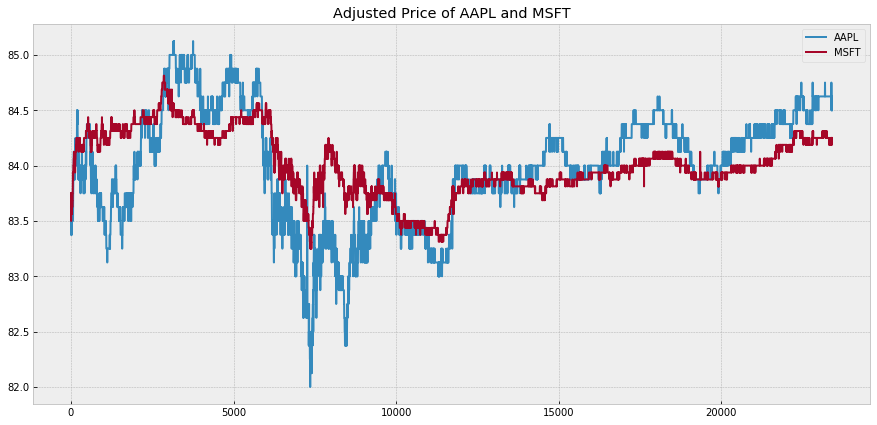

Plot z-score and trading signal of price ratio of AAPL and MSFT


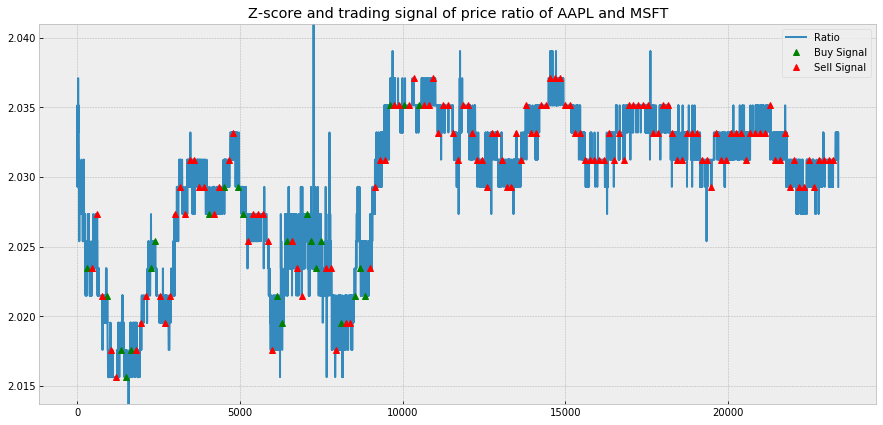

Trading signal of AAPL and MSFT for learning-based pair trading


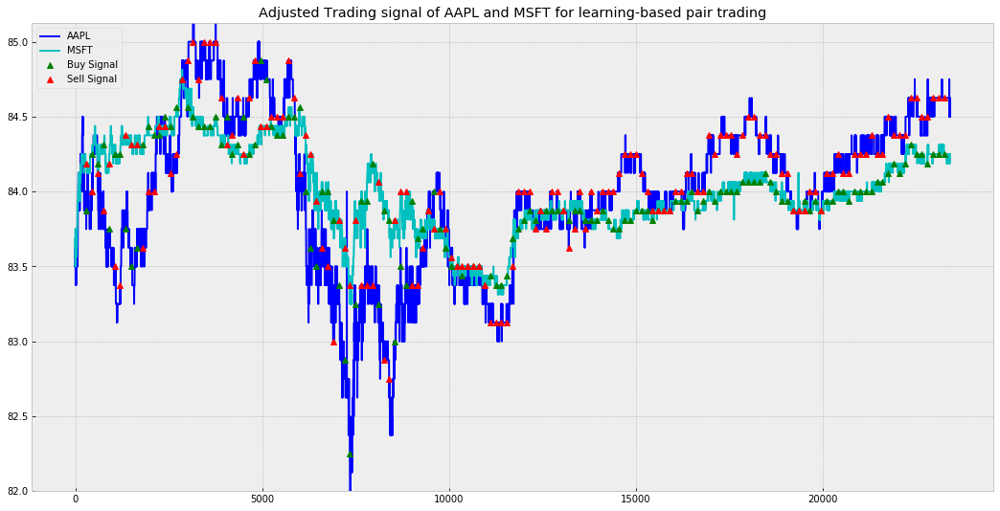

[Day 2]
v_test shape for day 2 : (154, 29, 299)
v_test shape for day 2 : (154, 29, 299)
v_test shape for day 2 : (154, 29, 299)
Predict Result....
Random pick time step :  [  5   6  14  15  16  18  22  24  30  31  32  35  38  39  46  49  52  65
  66  68  72  74  78  80  84  90  91 104 109 110 111 113 117 119 127 136
 140 149 157 165 168 173 177 179 187 191 195 203 207 208 213 216 220 222
 229 239 244 257 268 279 283 285 286 289]
Random pick time step :  [  4   5   8  14  17  25  29  31  37  38  42  44  45  49  50  76  88  89
  91  97 102 108 115 120 129 132 139 142 143 152 155 156 159 160 165 169
 171 173 176 181 182 195 199 200 207 212 215 217 233 234 235 239 244 254
 256 260 261 264 265 266 271 272 273 275]
Random pick time step :  [  3   4  17  22  25  30  33  43  48  60  61  65  66  67  70  80  81  82
  95  97 109 113 117 118 119 123 132 136 139 140 146 147 154 155 159 161
 169 170 171 178 185 188 200 202 210 218 224 226 229 230 232 236 244 248
 252 256 263 268 279 281 285 288 290 

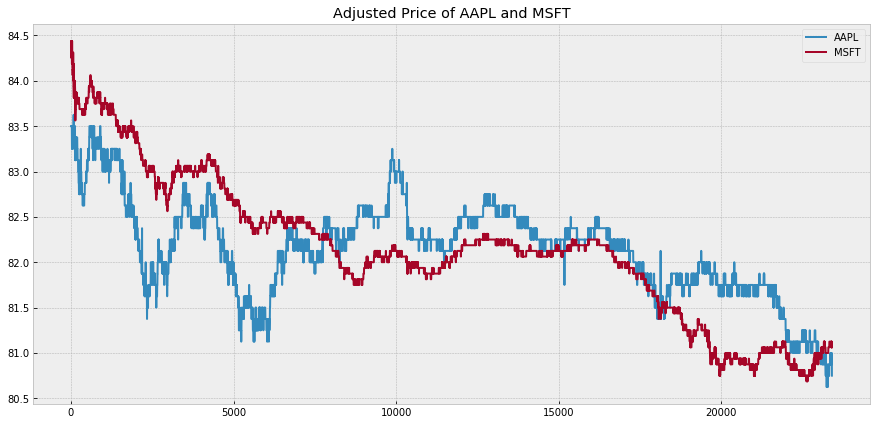

Plot z-score and trading signal of price ratio of AAPL and MSFT


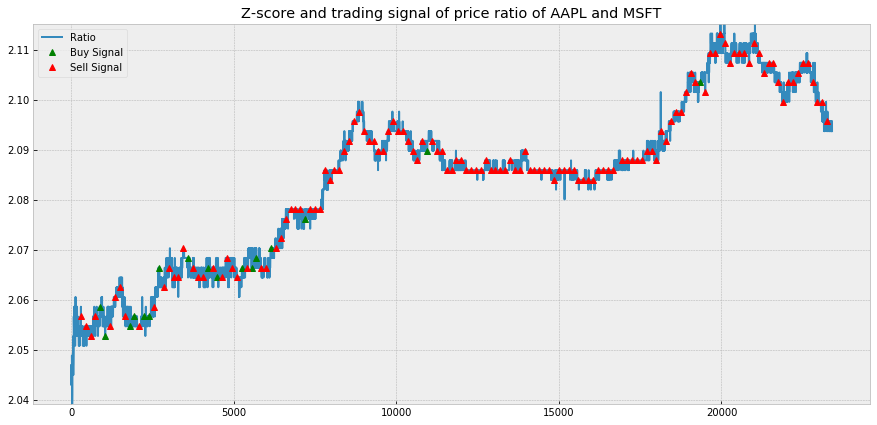

Trading signal of AAPL and MSFT for learning-based pair trading


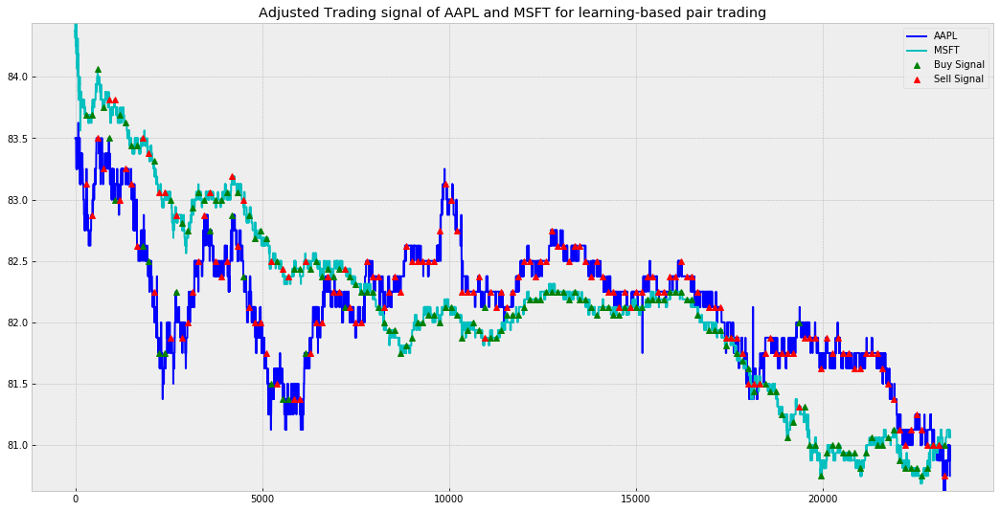

[Day 3]
v_test shape for day 3 : (154, 29, 299)
v_test shape for day 3 : (154, 29, 299)
v_test shape for day 3 : (154, 29, 299)
Predict Result....
Random pick time step :  [  0   1   6  11  14  15  22  27  44  47  49  58  66  67  68  70  73  75
  78  79  80  86  93  97 100 103 110 114 116 117 118 120 134 135 136 144
 145 153 160 162 166 171 174 177 178 190 192 205 210 214 215 216 228 235
 238 243 247 266 271 279 284 294 295 296]
Random pick time step :  [  5   6   9  13  17  20  22  24  32  34  40  46  68  74  86  88  90 111
 116 122 127 129 132 138 141 150 152 154 156 161 167 172 173 174 175 179
 183 185 192 193 194 200 202 204 206 212 219 228 229 234 235 236 237 247
 252 259 264 275 278 282 288 290 292 298]
Random pick time step :  [  1   3   6  11  19  22  24  31  36  57  58  61  67  70  73  75  76  86
  88  96  97  98  99 108 122 123 124 129 133 142 149 150 152 155 161 162
 165 169 188 189 192 196 197 198 199 200 208 214 220 221 223 233 242 247
 251 252 259 275 278 279 283 285 291 

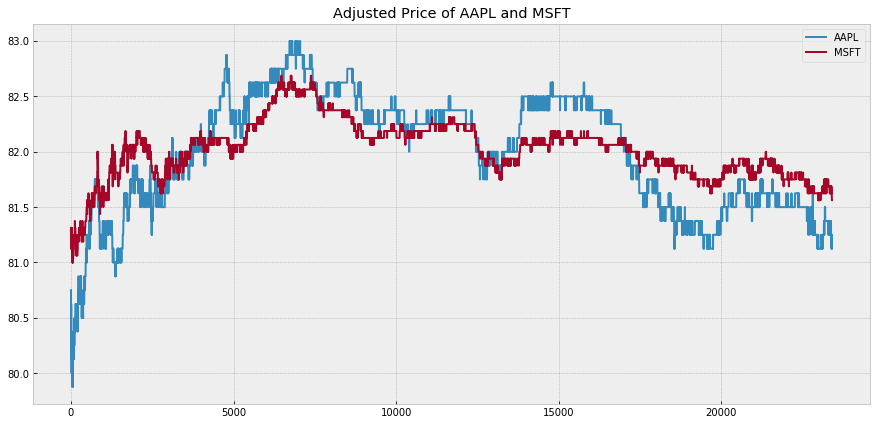

Plot z-score and trading signal of price ratio of AAPL and MSFT


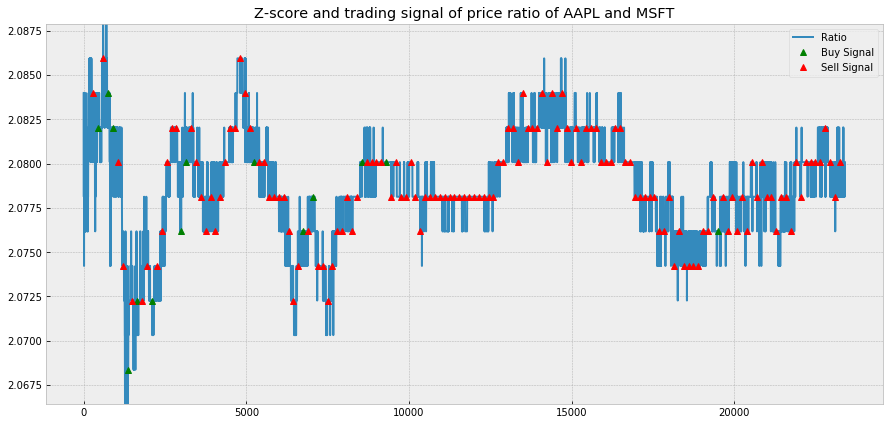

Trading signal of AAPL and MSFT for learning-based pair trading


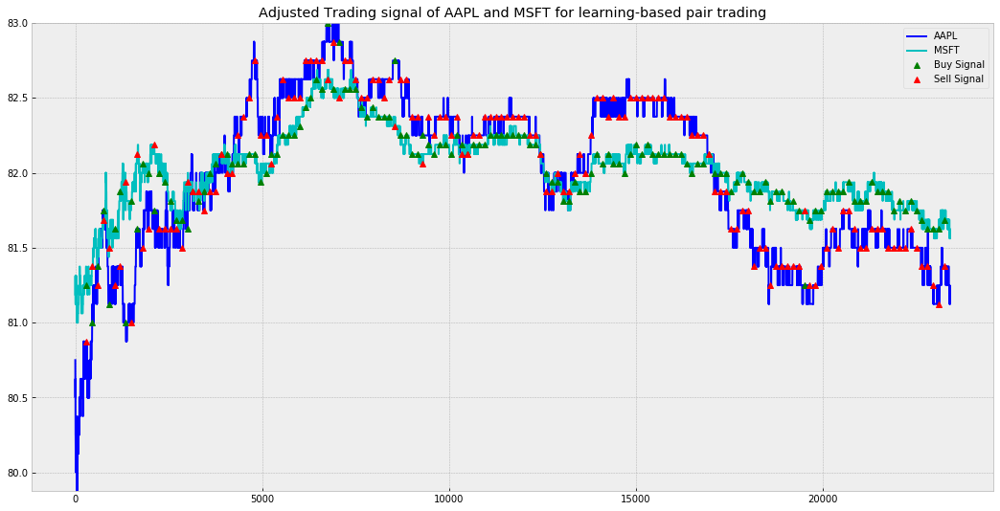

[Day 4]
v_test shape for day 4 : (154, 29, 299)
v_test shape for day 4 : (154, 29, 299)
v_test shape for day 4 : (154, 29, 299)
Predict Result....
Random pick time step :  [  1   7   8  10  12  13  14  20  22  32  33  34  41  56  61  62  63  67
  68  71  74  76  80  85  91  92 101 102 107 124 128 131 135 136 138 140
 141 144 146 147 148 150 152 163 164 166 176 181 185 196 219 234 238 240
 246 247 250 266 267 271 273 274 287 293]
Random pick time step :  [  1   9  16  17  19  28  32  37  47  65  67  70  76  79  80  84  87  88
  90  99 107 111 114 118 120 124 128 131 139 141 142 157 164 170 176 180
 187 204 211 214 215 218 223 225 228 232 247 248 251 255 256 266 268 269
 272 274 276 278 281 285 288 289 296 298]
Random pick time step :  [  1  16  20  21  36  39  44  45  47  51  54  57  66  75  77  79  82  88
  91 101 103 105 112 118 119 131 134 140 147 148 151 155 158 159 161 166
 169 180 181 184 185 189 196 201 205 210 213 222 223 234 235 238 244 253
 254 258 264 266 268 273 274 277 280 

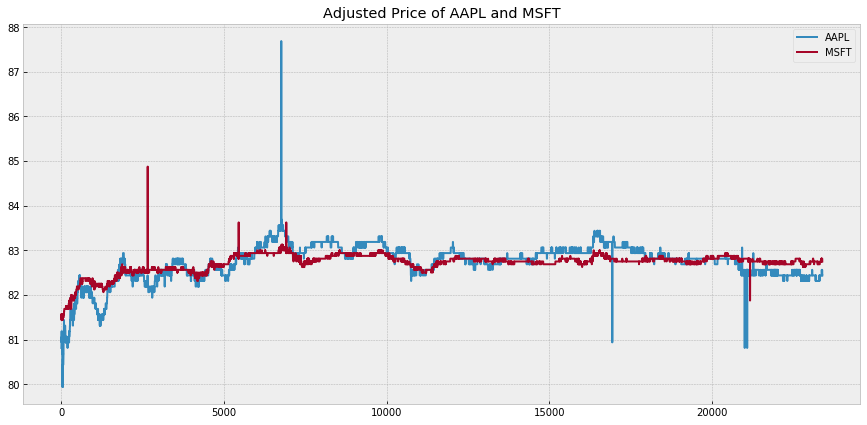

Plot z-score and trading signal of price ratio of AAPL and MSFT


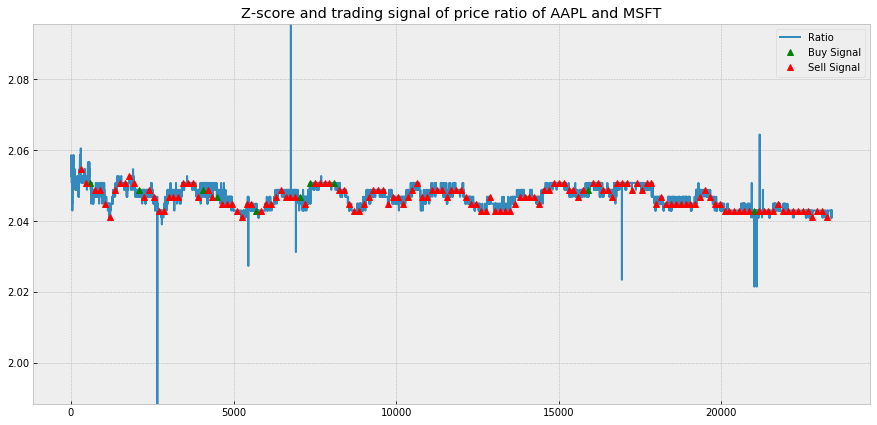

Trading signal of AAPL and MSFT for learning-based pair trading


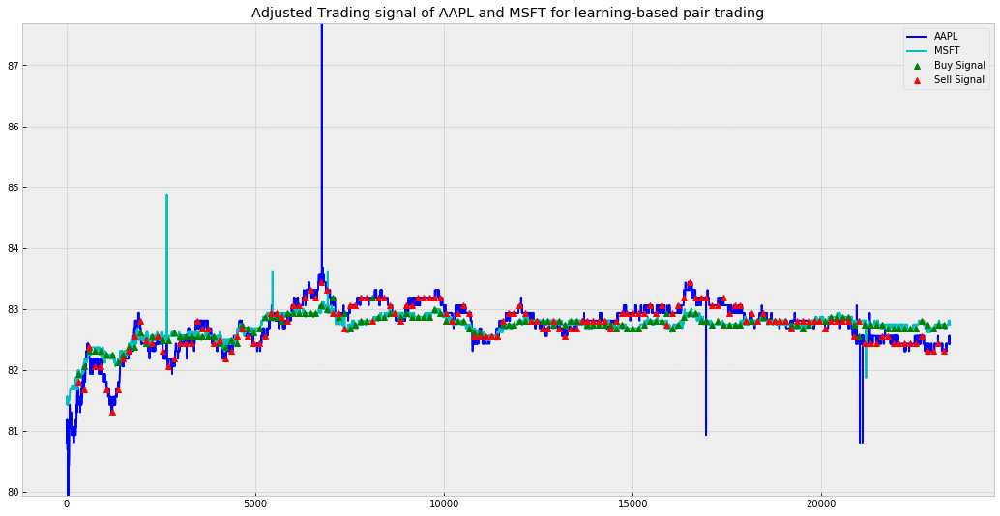

[Day 5]
v_test shape for day 5 : (154, 29, 299)
v_test shape for day 5 : (154, 29, 299)
v_test shape for day 5 : (154, 29, 299)
Predict Result....
Random pick time step :  [  4  12  15  19  20  21  27  44  48  55  60  61  78  81  86  92  98 102
 106 108 113 114 115 122 123 128 131 140 141 145 146 147 148 150 151 155
 167 174 179 180 188 189 193 198 199 203 211 217 221 224 226 230 232 244
 246 258 261 262 268 270 271 276 278 281]
Random pick time step :  [  1   5   6   7  13  14  20  26  27  29  30  52  53  56  57  58  59  64
  67  81  84  87  88  92  93  96  99 121 123 132 134 135 143 147 151 154
 156 170 174 178 180 181 184 189 193 213 215 218 224 226 230 242 244 247
 250 251 260 270 273 277 278 281 282 295]
Random pick time step :  [  1   2   5   8  22  25  29  32  33  45  54  57  58  64  68  78  95  97
 100 103 109 110 113 114 119 123 124 126 130 131 132 140 141 145 148 161
 165 167 170 178 179 180 185 189 195 200 207 225 226 227 236 239 249 253
 258 259 260 267 268 269 277 278 291 

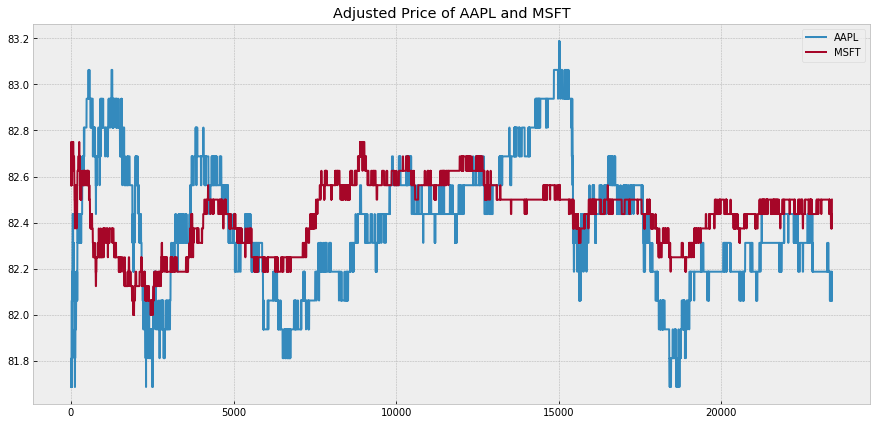

Plot z-score and trading signal of price ratio of AAPL and MSFT


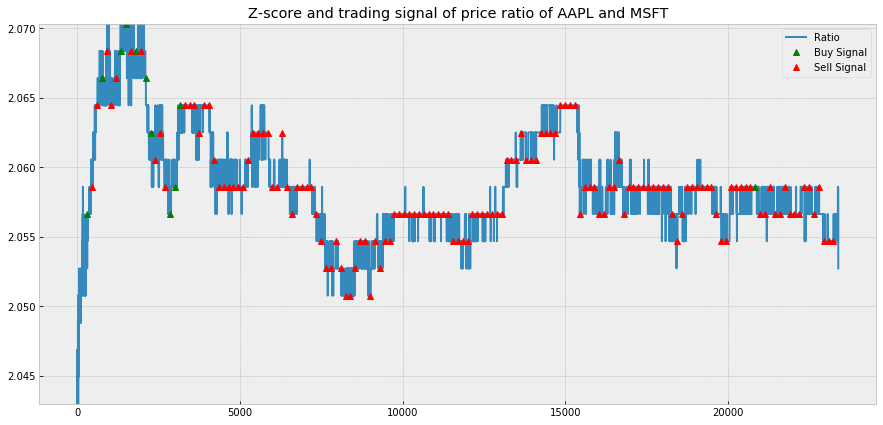

Trading signal of AAPL and MSFT for learning-based pair trading


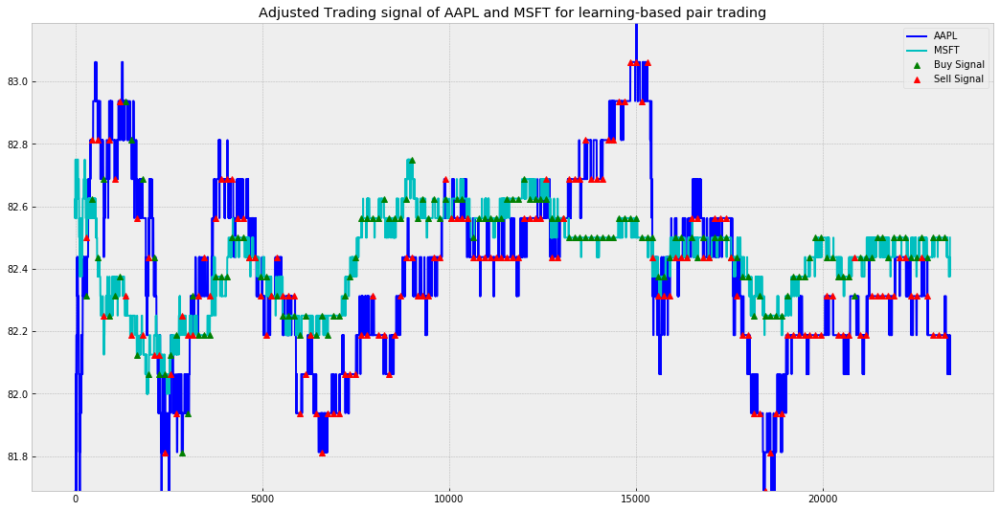

[Day 6]
v_test shape for day 6 : (154, 29, 299)
v_test shape for day 6 : (154, 29, 299)
v_test shape for day 6 : (154, 29, 299)
Predict Result....
Random pick time step :  [  9  10  14  17  23  30  34  42  47  49  51  55  59  66  69  73  78  87
  88  92  93  98 100 105 114 115 117 132 136 137 144 148 154 155 156 162
 164 165 170 176 185 188 189 199 200 207 215 217 219 221 226 228 235 242
 243 246 250 252 259 266 269 287 296 297]
Random pick time step :  [  0   2   4  10  13  19  28  31  32  35  40  43  44  45  47  48  50  58
  59  63  68  73  77  82  83  84  88  93  98 104 105 121 136 139 149 150
 152 158 165 185 196 200 202 209 212 214 219 220 225 229 232 237 238 248
 251 255 258 259 262 267 272 273 284 286]
Random pick time step :  [  1   4   6  20  27  30  32  33  34  39  47  52  60  66  97  99 102 103
 110 126 133 136 140 142 143 154 161 162 163 164 165 167 171 183 189 191
 196 197 198 201 204 205 207 216 217 218 219 220 229 234 238 241 245 248
 249 252 254 261 262 266 268 271 285 

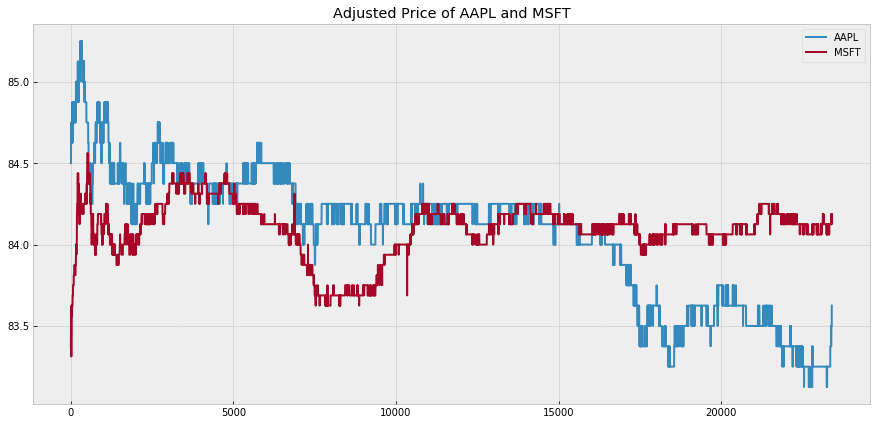

Plot z-score and trading signal of price ratio of AAPL and MSFT


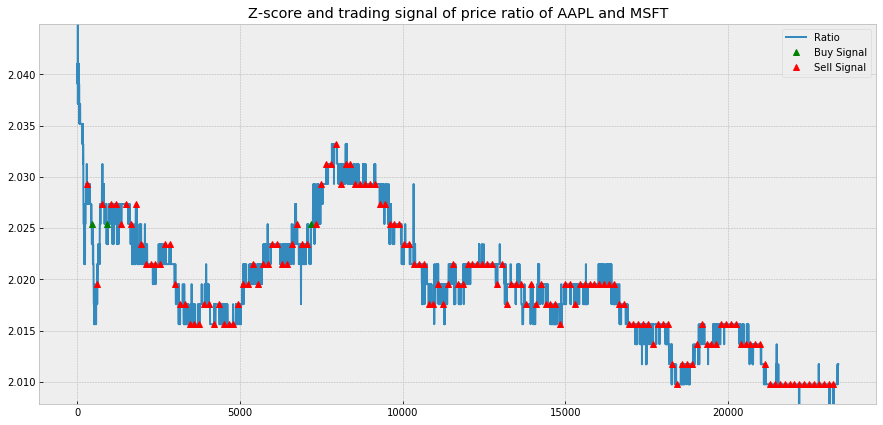

Trading signal of AAPL and MSFT for learning-based pair trading


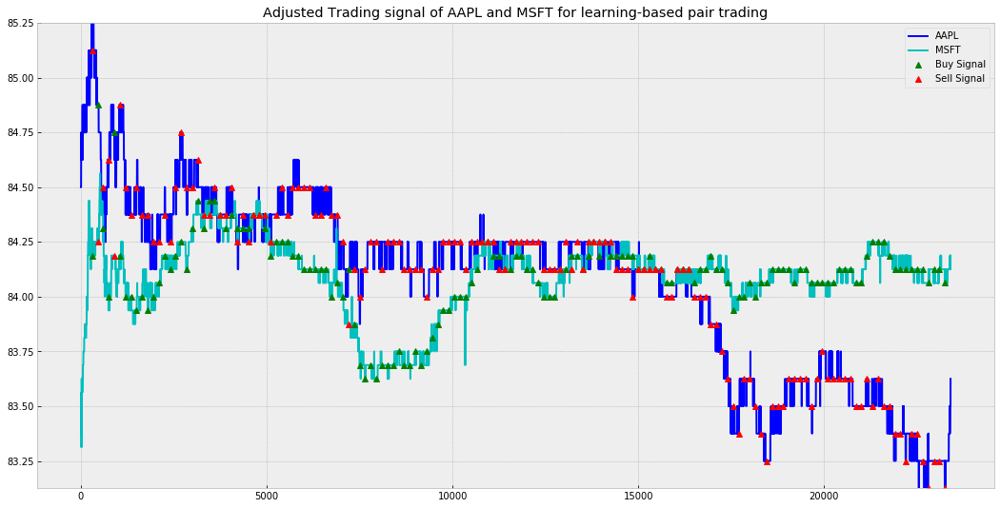

[Day 7]
v_test shape for day 7 : (154, 29, 299)
v_test shape for day 7 : (154, 29, 299)
v_test shape for day 7 : (154, 29, 299)
Predict Result....
Random pick time step :  [  8  11  18  21  23  39  41  43  47  50  60  66  67  68  69  70  71  76
  78  83  85 102 111 117 119 122 124 133 134 140 141 142 145 147 149 150
 153 160 164 195 201 203 209 216 219 221 225 229 230 234 242 244 254 255
 262 267 269 276 280 281 286 291 292 294]
Random pick time step :  [  4   8  10  12  27  30  31  44  46  47  54  62  64  68  69  70  72  76
  78  85  88  89  90  92  94  95  98 108 109 120 121 124 130 131 145 148
 156 159 161 162 175 189 193 196 199 207 208 210 219 229 230 235 237 240
 241 248 249 252 273 274 289 291 294 298]
Random pick time step :  [  0   7  11  12  20  21  32  36  37  38  41  45  55  66  69  76  77  82
  92  96 101 105 108 115 123 140 141 149 157 160 163 169 174 178 180 187
 191 192 194 195 197 203 208 210 227 231 232 235 248 253 255 262 269 271
 274 277 280 282 284 286 290 291 293 

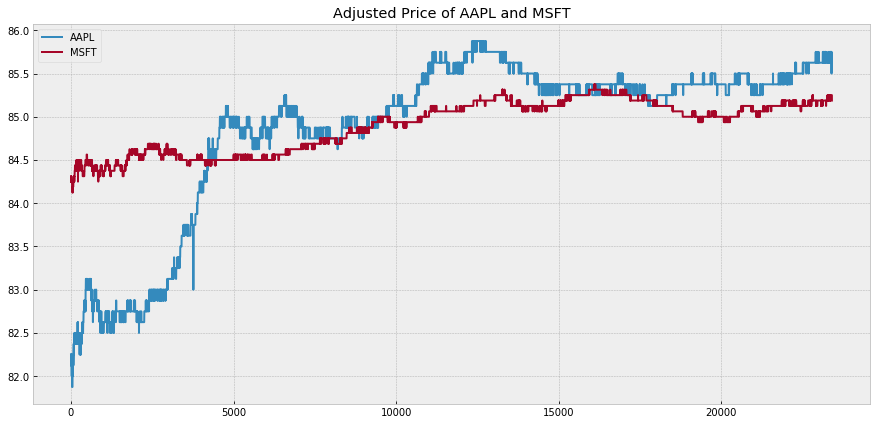

Plot z-score and trading signal of price ratio of AAPL and MSFT


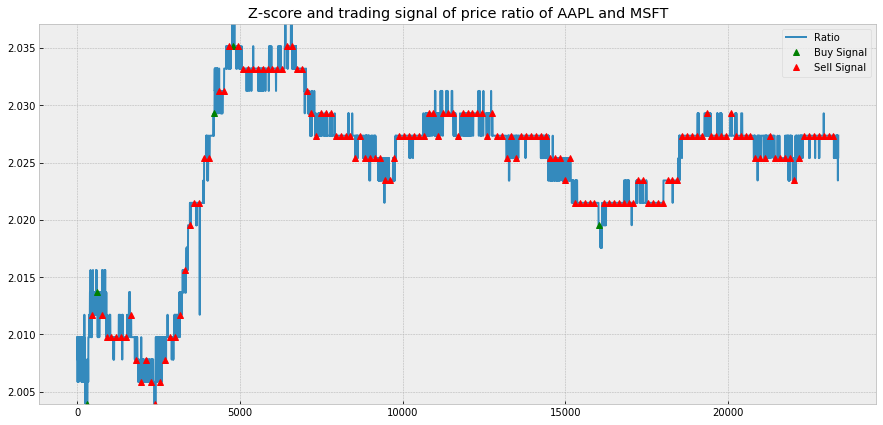

Trading signal of AAPL and MSFT for learning-based pair trading


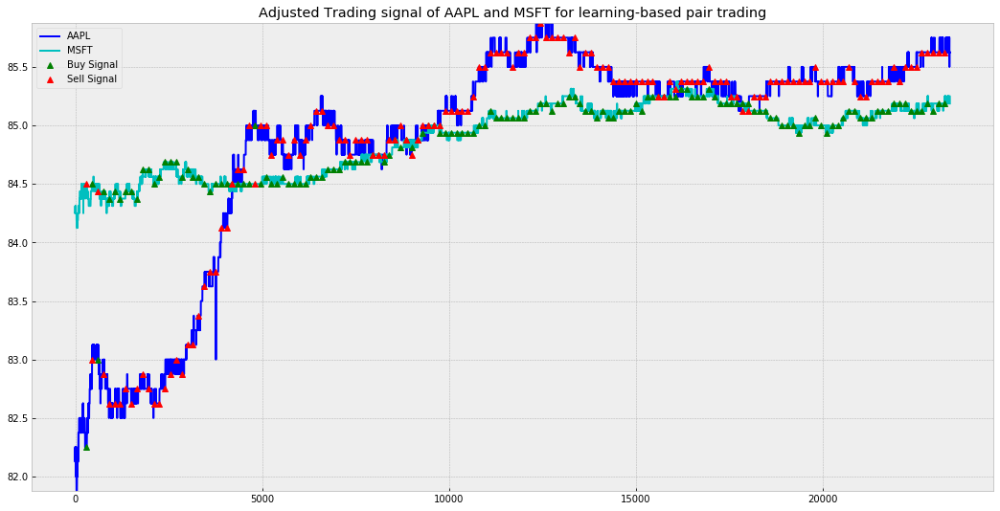

[Day 8]
v_test shape for day 8 : (154, 29, 299)
v_test shape for day 8 : (154, 29, 299)
v_test shape for day 8 : (154, 29, 299)
Predict Result....
Random pick time step :  [  2   4   8  12  14  16  18  24  28  42  45  47  48  51  54  60  78  82
  89 105 111 115 116 125 126 128 130 133 134 148 151 161 169 171 173 175
 180 184 185 189 190 192 200 202 208 212 220 225 229 252 255 256 258 261
 271 272 279 282 284 285 287 291 295 296]
Random pick time step :  [  1   2   6   9  22  24  28  33  34  45  46  50  54  59  62  67  69  77
  81  84  96 101 108 113 115 116 118 121 130 131 134 143 144 146 157 163
 169 170 175 178 186 196 203 204 206 210 215 216 218 221 224 238 243 246
 254 267 270 274 278 279 287 290 291 294]
Random pick time step :  [  9  11  13  15  16  21  31  32  34  35  38  45  48  51  52  56  59  62
  63  70  74  75  77  83  89  95  97 100 106 109 110 114 116 122 123 129
 136 140 144 156 161 164 165 166 167 173 174 176 182 193 194 205 207 210
 211 215 228 243 258 284 285 287 290 

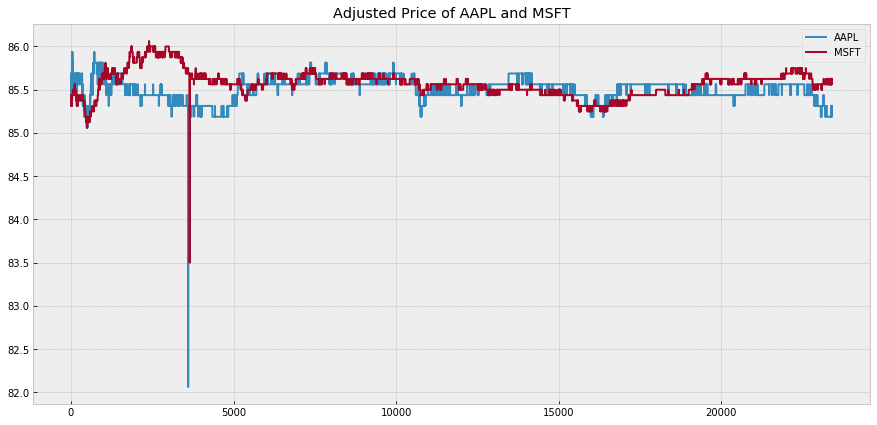

Plot z-score and trading signal of price ratio of AAPL and MSFT


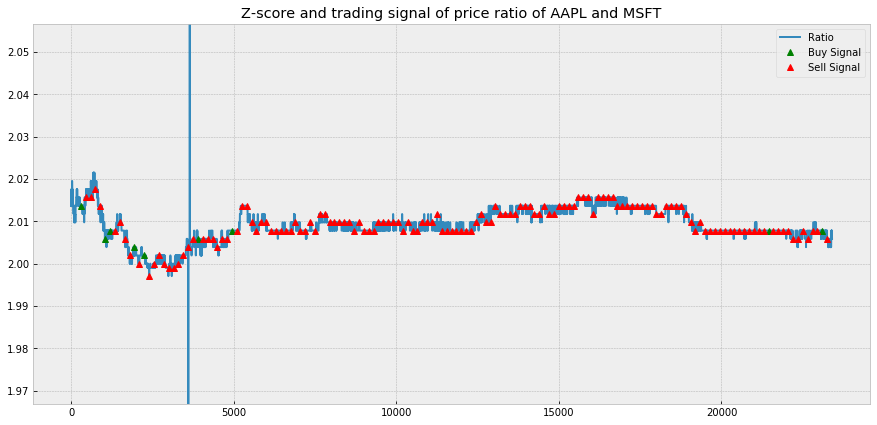

Trading signal of AAPL and MSFT for learning-based pair trading


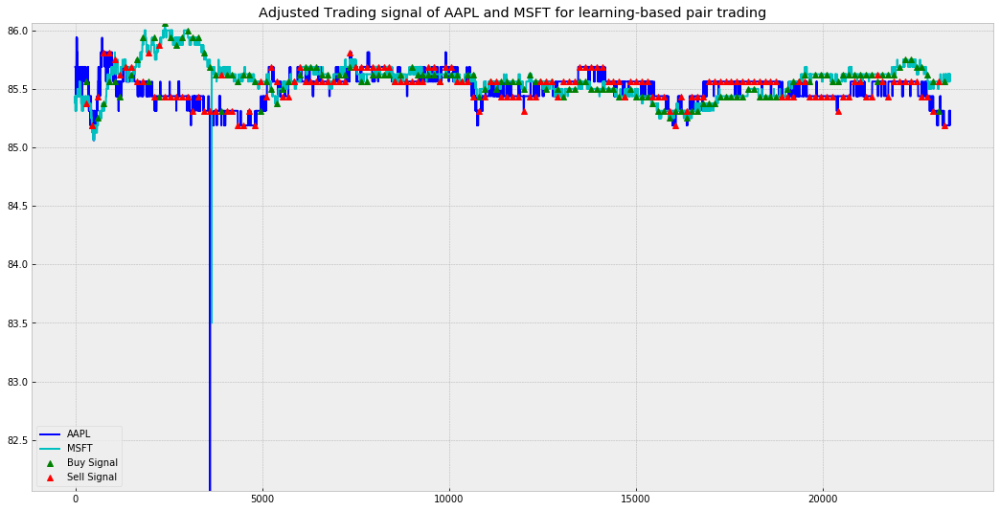

[Day 9]
v_test shape for day 9 : (154, 29, 299)
v_test shape for day 9 : (154, 29, 299)
v_test shape for day 9 : (154, 29, 299)
Predict Result....
Random pick time step :  [  0   6   7   9  10  17  19  21  22  31  32  35  38  39  42  43  56  59
  63  65  68  69  72  81  86  91  97 105 107 120 127 140 142 155 156 158
 163 173 174 176 187 209 211 212 214 219 220 229 230 235 236 238 241 249
 253 262 264 265 267 271 280 288 289 297]
Random pick time step :  [  5  16  25  32  38  39  40  46  49  52  62  65  68  70  76  78  81  82
  83  85  91  95 101 118 119 122 128 134 137 150 160 161 163 165 173 185
 189 190 193 201 217 222 224 230 231 234 244 247 250 251 253 254 266 268
 274 277 283 287 288 292 293 294 295 298]
Random pick time step :  [  2  10  11  16  22  25  26  52  60  62  70  75  77  83  86  92  96  97
  99 104 111 112 113 116 121 123 124 125 135 138 146 147 148 152 157 160
 163 165 167 171 177 178 186 196 199 204 221 223 227 229 230 236 238 239
 245 250 253 266 278 281 288 289 297 

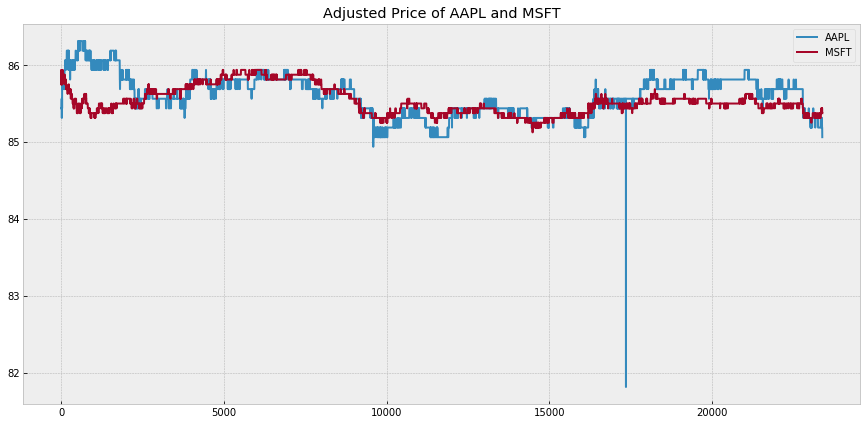

Plot z-score and trading signal of price ratio of AAPL and MSFT


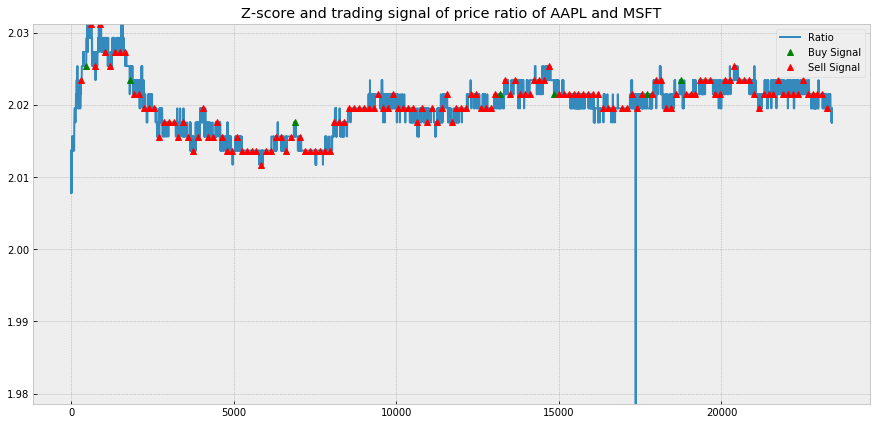

Trading signal of AAPL and MSFT for learning-based pair trading


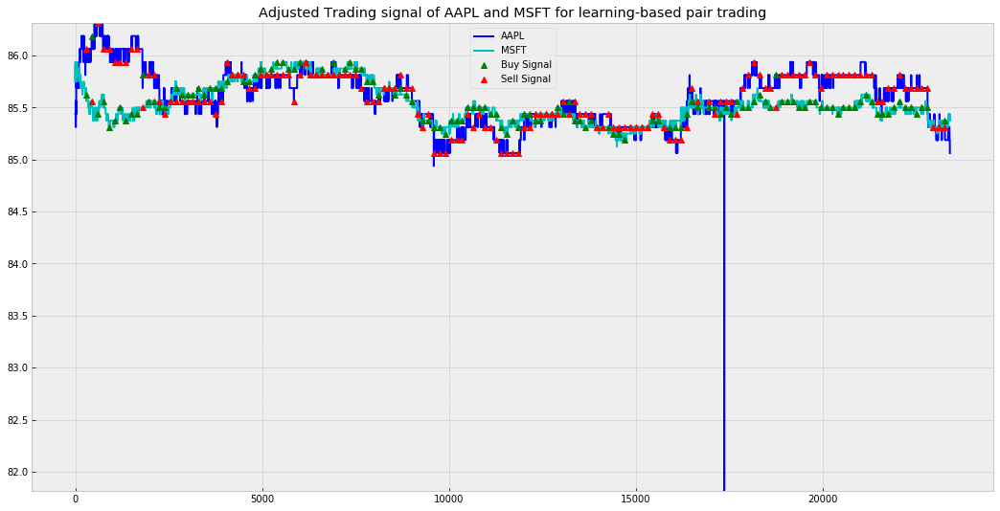

[Day 10]
v_test shape for day 10 : (154, 29, 299)
v_test shape for day 10 : (154, 29, 299)
v_test shape for day 10 : (154, 29, 299)
Predict Result....
Random pick time step :  [  3   4   5   8  17  23  25  31  32  56  58  59  64  66  76  85  92  98
 104 111 128 130 142 145 146 147 158 159 160 162 170 172 174 176 177 178
 185 187 192 198 199 211 212 215 217 219 227 230 232 234 235 240 250 252
 257 263 265 268 270 272 278 281 292 297]
Random pick time step :  [  4  11  30  37  38  44  53  55  58  59  60  61  65  66  70  76  80  81
  82  83  85  95  98 103 110 114 115 124 133 136 143 153 156 157 170 171
 177 182 184 190 193 194 199 201 205 210 224 225 233 235 242 256 269 271
 274 275 277 279 282 285 289 290 291 292]
Random pick time step :  [ 24  25  33  38  40  49  52  54  67  69  70  79  80  82  96  97 110 113
 117 124 125 126 129 140 153 156 164 165 168 169 170 171 176 178 179 186
 194 201 202 203 208 223 225 232 233 241 244 250 252 253 254 256 268 269
 270 271 277 279 281 283 289 292 

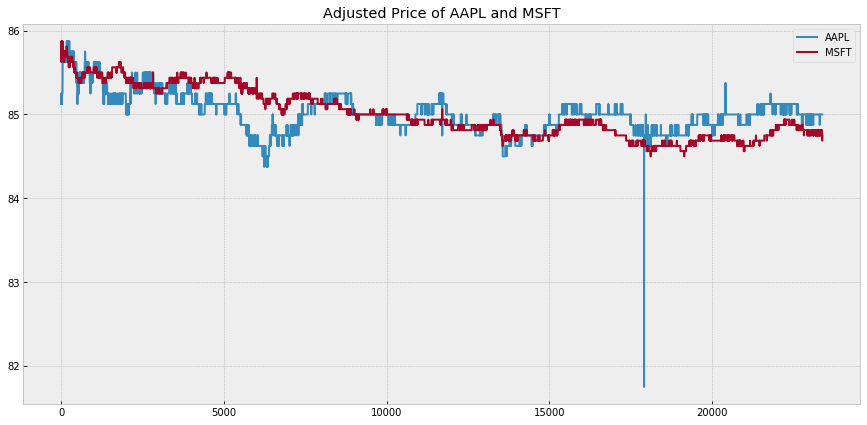

Plot z-score and trading signal of price ratio of AAPL and MSFT


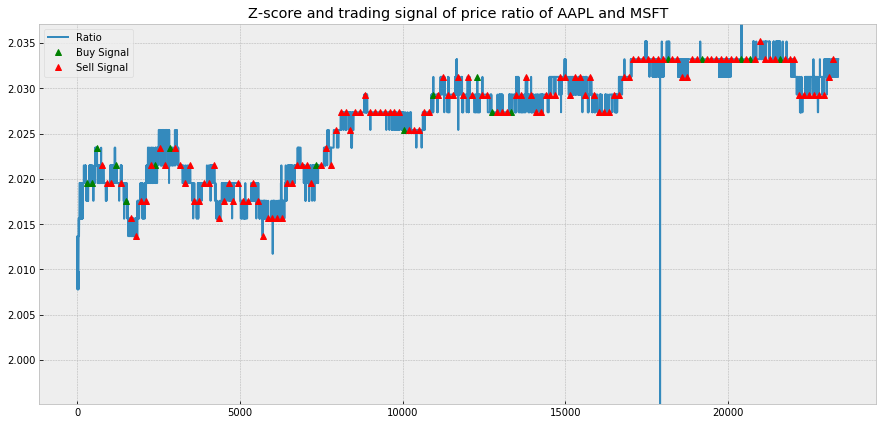

Trading signal of AAPL and MSFT for learning-based pair trading


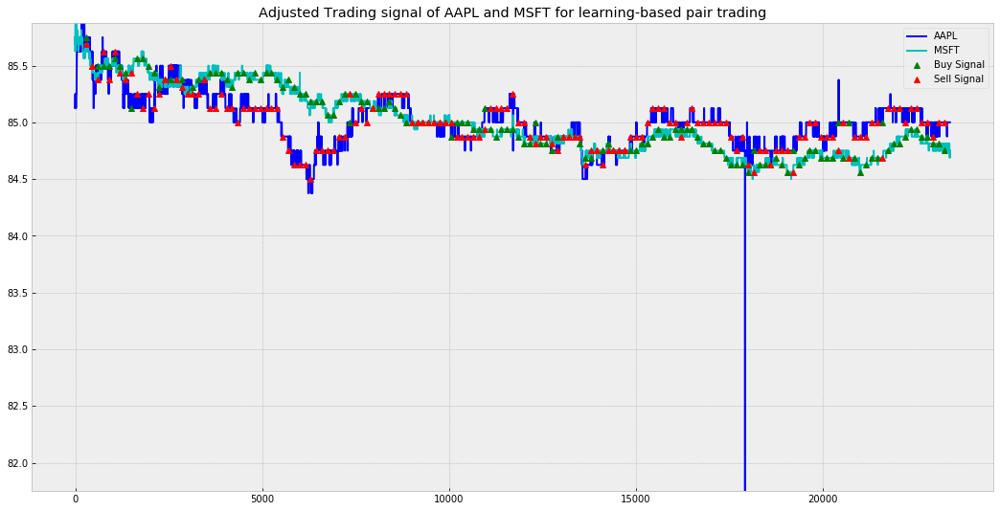

[Day 11]
v_test shape for day 11 : (154, 29, 299)
v_test shape for day 11 : (154, 29, 299)
v_test shape for day 11 : (154, 29, 299)
Predict Result....
Random pick time step :  [  0   4   7  12  13  16  22  24  27  32  37  52  53  65  66  68  74  75
  76  79  82  83  84  86  93 105 107 108 112 121 122 126 127 130 135 140
 147 150 152 157 162 174 175 179 185 195 197 199 204 205 207 212 213 219
 222 231 238 247 248 252 253 255 258 293]
Random pick time step :  [  1   4   6   8  10  16  19  22  23  41  58  60  65  67  72  82  84  89
  94 103 106 113 114 116 136 145 146 148 153 155 157 164 165 168 172 173
 178 179 182 184 185 187 208 210 213 214 219 222 223 224 227 233 235 255
 256 258 261 279 280 281 282 284 285 288]
Random pick time step :  [  0  13  27  41  45  51  57  61  70  80  86  89  92  96 104 106 108 109
 110 115 121 123 125 130 131 133 135 137 139 144 146 148 149 160 161 162
 167 184 186 188 190 192 193 197 198 201 206 212 221 225 227 239 251 260
 271 273 279 281 284 287 288 292 

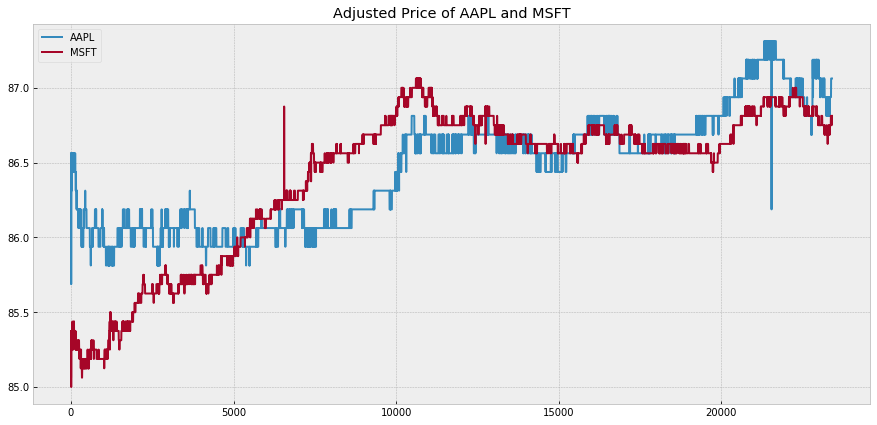

Plot z-score and trading signal of price ratio of AAPL and MSFT


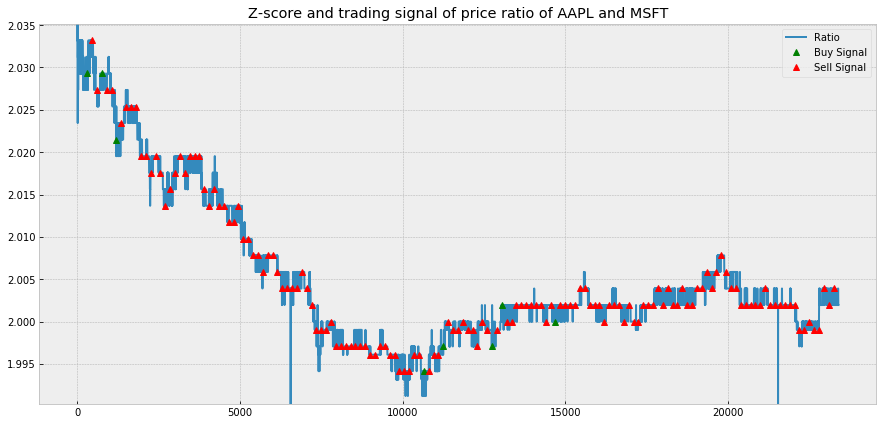

Trading signal of AAPL and MSFT for learning-based pair trading


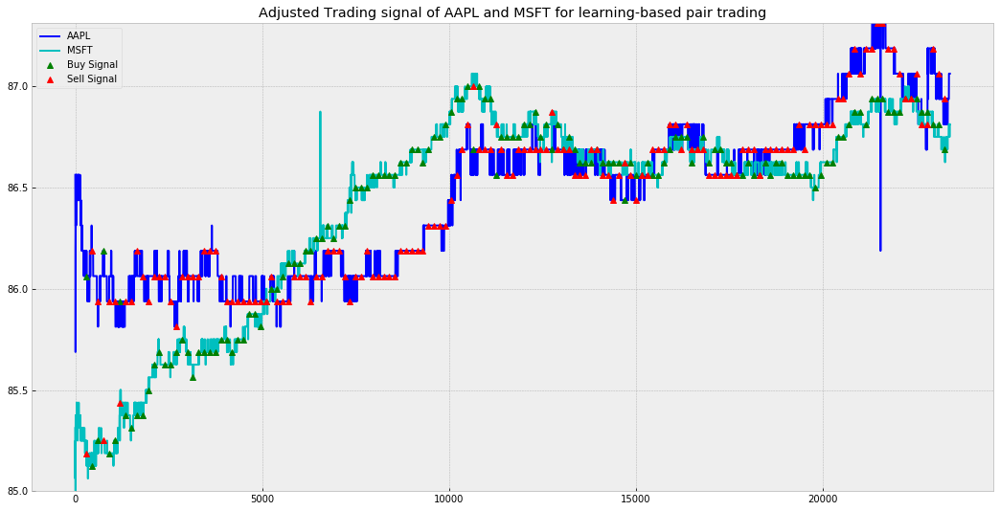

[Day 12]
v_test shape for day 12 : (154, 29, 299)
v_test shape for day 12 : (154, 29, 299)
v_test shape for day 12 : (154, 29, 299)
Predict Result....
Random pick time step :  [  9  10  11  13  23  25  27  29  31  34  48  54  56  57  58  72  76  77
  79  81  84  87  88  89  91  99 103 104 105 107 117 121 130 132 135 149
 150 152 161 163 166 169 172 174 177 183 184 190 194 195 198 203 210 219
 220 232 238 242 243 245 269 273 277 297]
Random pick time step :  [  1   9  12  14  19  21  25  28  32  40  46  51  54  57  61  83  85 101
 102 104 108 110 111 113 115 120 122 126 127 128 131 138 140 143 144 150
 156 161 165 174 184 185 188 194 197 198 202 205 207 218 227 232 234 236
 241 247 248 249 255 259 268 288 289 291]
Random pick time step :  [  2   8   9  10  13  15  16  17  19  20  25  29  41  44  45  50  52  60
  69  74  75  77  79  81  82  83  93  94  96  98 100 110 119 123 124 127
 130 131 139 151 153 158 162 164 165 169 178 185 198 206 207 212 218 219
 225 228 232 234 236 241 280 283 

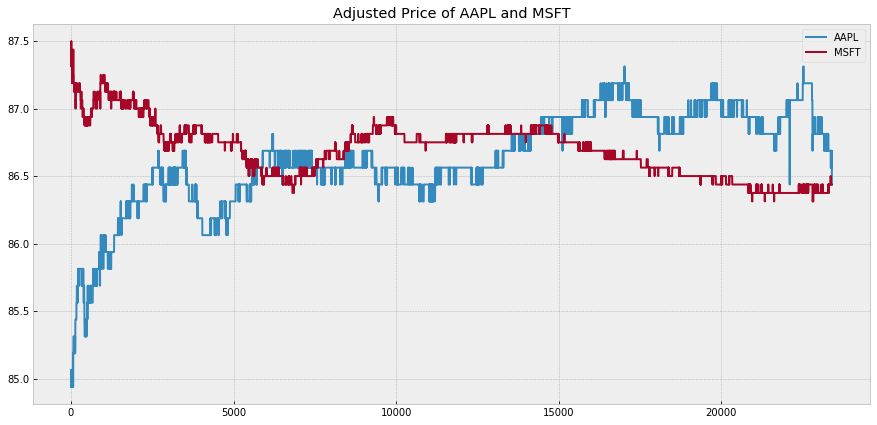

Plot z-score and trading signal of price ratio of AAPL and MSFT


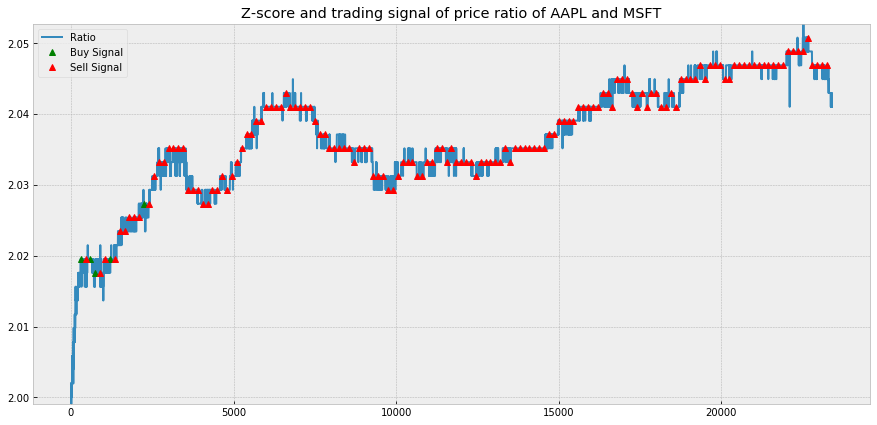

Trading signal of AAPL and MSFT for learning-based pair trading


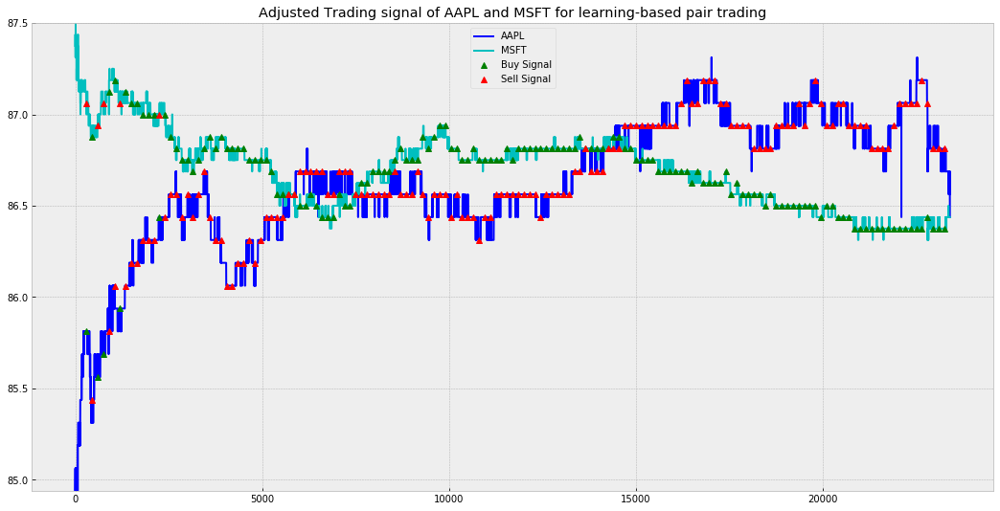

[Day 13]
v_test shape for day 13 : (154, 29, 299)
v_test shape for day 13 : (154, 29, 299)
v_test shape for day 13 : (154, 29, 299)
Predict Result....
Random pick time step :  [  8  11  22  24  28  32  38  41  43  51  59  73  74  75  80  90  92  93
 107 108 109 113 116 122 126 134 140 144 150 151 153 160 163 164 171 182
 183 184 188 192 197 204 205 206 207 215 216 217 219 221 223 232 241 245
 257 268 269 276 280 287 289 292 295 298]
Random pick time step :  [  2   5  13  15  17  25  28  33  39  46  63  66  68  69  74  78  85  86
  90 100 104 112 117 134 135 136 147 150 157 159 165 167 168 176 180 192
 207 211 213 214 216 219 222 223 224 225 232 233 237 239 242 246 247 249
 254 258 260 265 267 269 273 279 282 288]
Random pick time step :  [  0   5   6  10  12  29  31  39  47  53  54  67  68  72  80  81  84  87
  90  95 100 103 115 118 129 131 144 158 160 162 165 166 170 175 178 179
 184 188 189 191 192 199 200 203 209 217 227 238 241 243 246 248 252 254
 258 259 260 263 270 278 281 283 

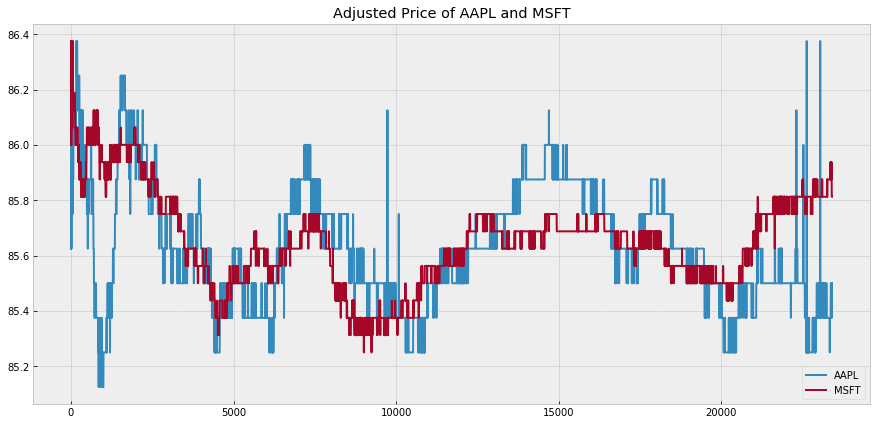

Plot z-score and trading signal of price ratio of AAPL and MSFT


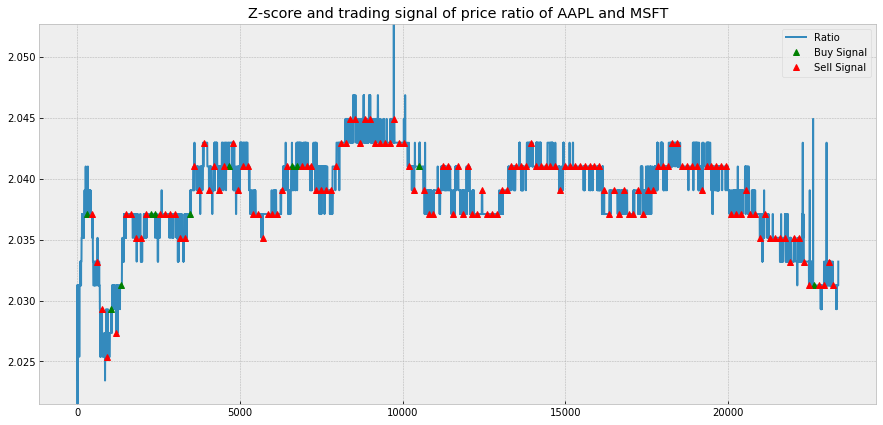

Trading signal of AAPL and MSFT for learning-based pair trading


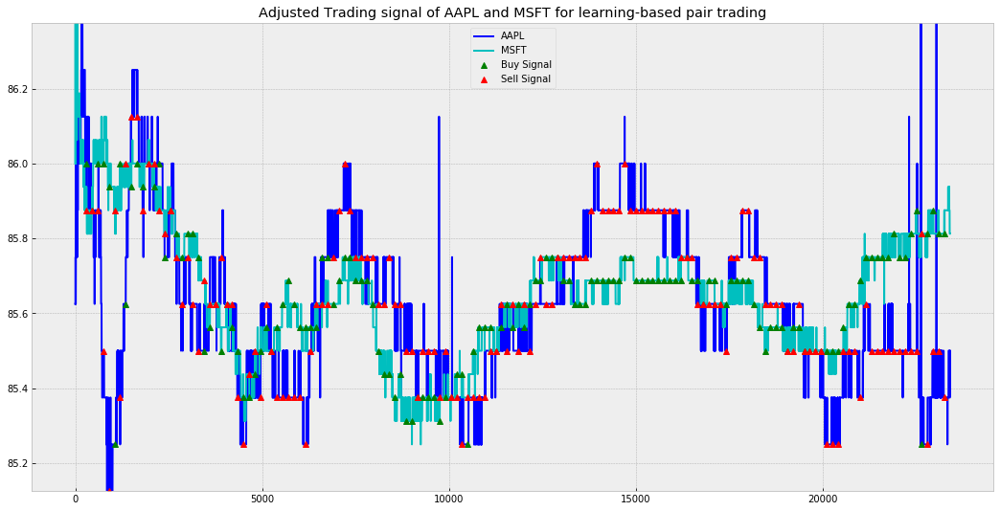

[Day 14]
v_test shape for day 14 : (154, 29, 299)
v_test shape for day 14 : (154, 29, 299)
v_test shape for day 14 : (154, 29, 299)
Predict Result....
Random pick time step :  [ 20  26  38  39  42  43  44  52  53  59  65  66  75  89  92  94  96  99
 101 102 104 109 111 112 114 116 117 128 131 134 136 138 144 150 153 154
 157 160 161 164 174 176 194 209 214 216 220 226 234 239 241 249 256 263
 267 269 271 272 276 279 281 290 291 294]
Random pick time step :  [  0   9  11  21  23  25  27  28  29  32  34  40  56  59  65  66  67  68
  73  84  91  94  95  99 102 105 109 114 116 129 137 142 143 148 153 170
 174 182 186 189 190 202 217 222 223 225 226 227 230 233 236 240 243 244
 246 251 252 257 269 287 289 290 291 297]
Random pick time step :  [ 16  21  25  27  32  36  38  40  42  46  49  57  64  67  70  72  73  76
  77  82  88  91  94  98 100 106 113 123 128 129 132 143 146 150 163 165
 168 169 182 191 210 211 213 215 216 223 225 229 248 249 251 253 257 258
 259 261 262 264 266 267 277 282 

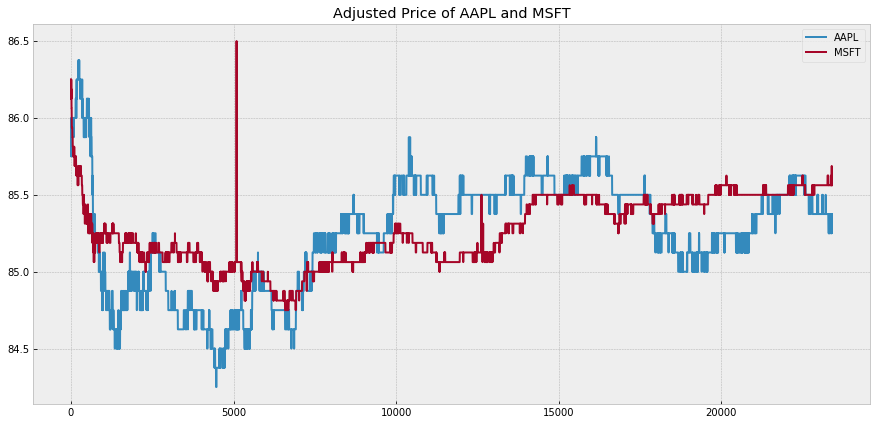

Plot z-score and trading signal of price ratio of AAPL and MSFT


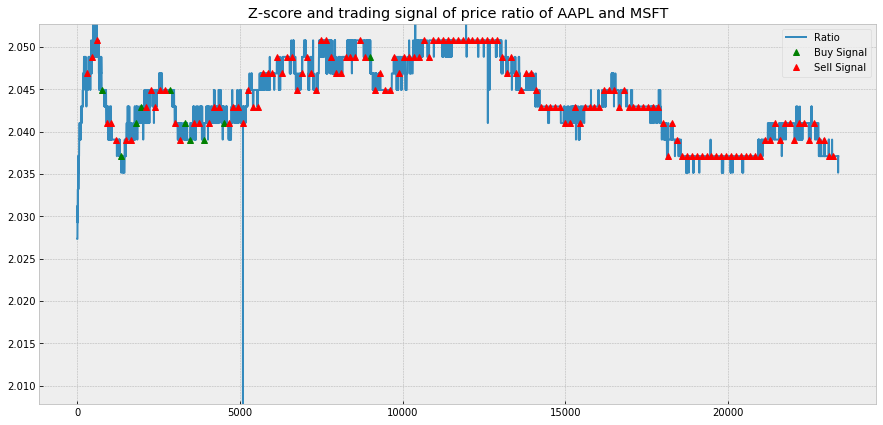

Trading signal of AAPL and MSFT for learning-based pair trading


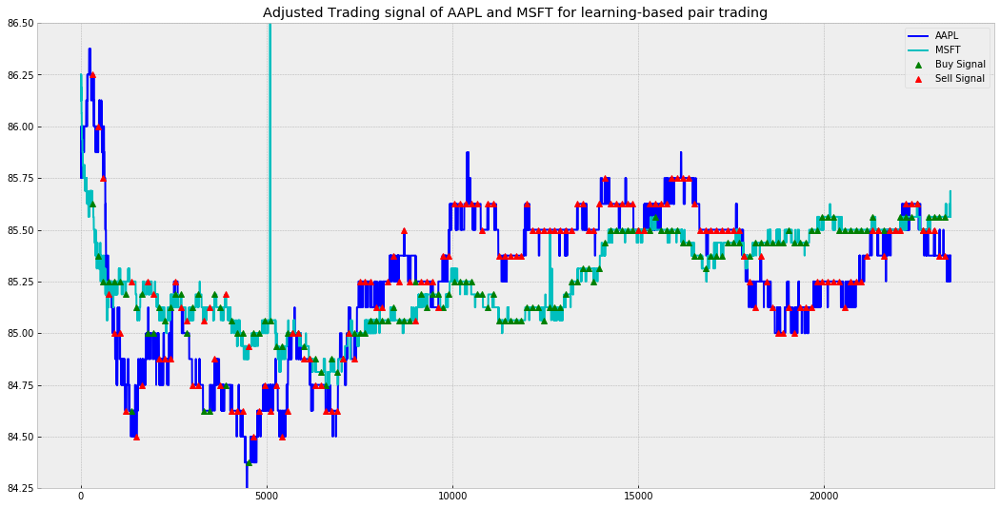

[Day 15]
v_test shape for day 15 : (154, 29, 299)
v_test shape for day 15 : (154, 29, 299)
v_test shape for day 15 : (154, 29, 299)
Predict Result....
Random pick time step :  [  3   6  20  25  32  33  35  37  38  40  44  48  49  53  54  60  67  74
  87  93  99 104 105 121 122 130 132 133 134 141 142 149 162 168 176 178
 179 182 186 190 203 204 206 207 219 223 230 233 235 242 247 257 260 263
 264 266 273 277 278 282 288 291 293 294]
Random pick time step :  [  6   9  10  13  16  27  35  39  41  44  48  64  69  72  73  78  79  83
 101 103 107 109 112 114 115 126 131 132 139 140 150 153 154 165 167 179
 191 192 193 203 204 209 210 213 224 226 230 233 234 235 236 237 248 252
 253 256 258 264 266 268 279 289 293 296]
Random pick time step :  [  0   7   8  13  16  17  24  25  38  39  42  44  51  54  57  59  66  72
  73  74  79  85  86  92 105 114 128 129 132 151 152 157 163 166 178 181
 183 186 189 193 194 196 199 203 207 215 220 224 226 227 229 231 244 249
 250 258 259 265 266 274 287 295 

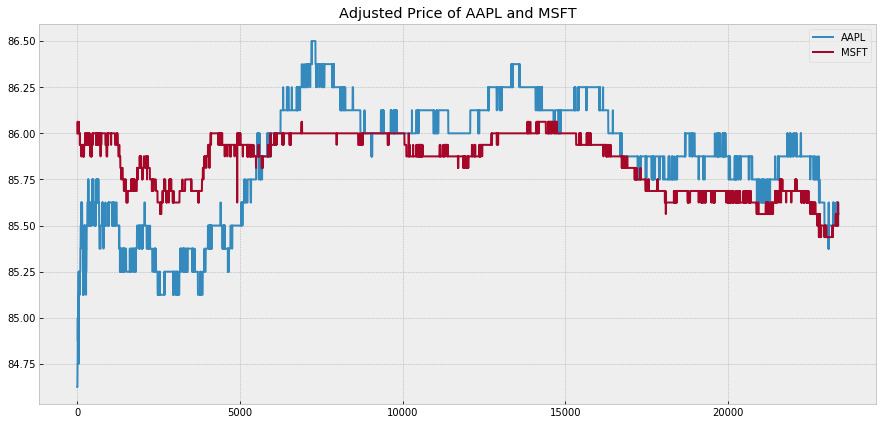

Plot z-score and trading signal of price ratio of AAPL and MSFT


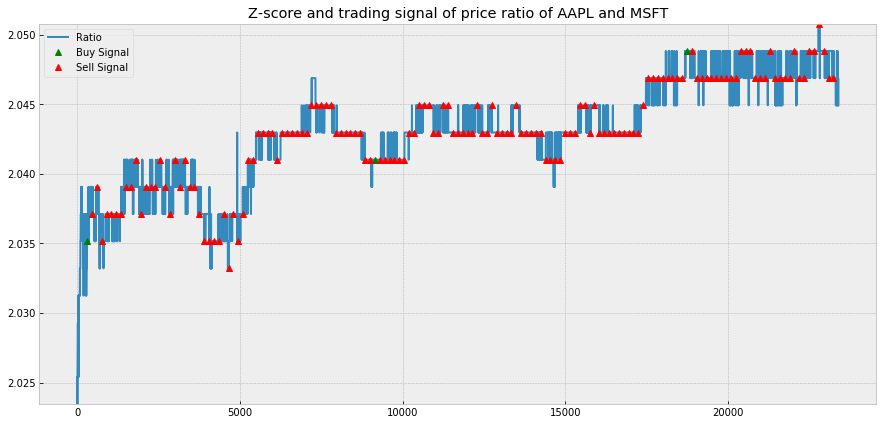

Trading signal of AAPL and MSFT for learning-based pair trading


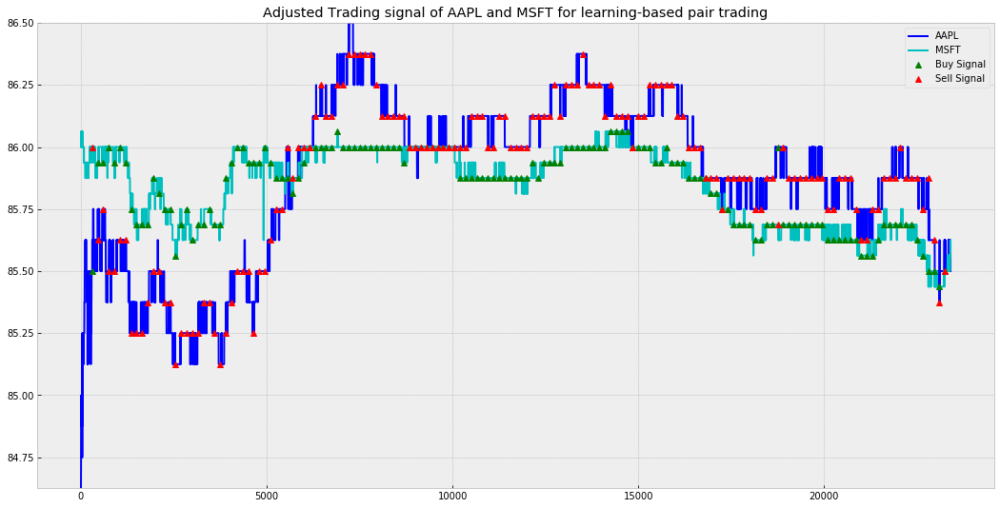

[Day 16]
v_test shape for day 16 : (154, 29, 299)
v_test shape for day 16 : (154, 29, 299)
v_test shape for day 16 : (154, 29, 299)
Predict Result....
Random pick time step :  [  0   8  14  18  24  32  38  41  51  53  59  60  61  67  68  69  71  77
  79  85  88  91  93  98 100 102 103 106 107 114 124 128 130 146 148 156
 157 162 164 181 183 186 190 203 205 216 219 225 237 245 248 249 251 255
 262 266 267 268 272 277 280 284 285 296]
Random pick time step :  [  2   4  13  19  22  28  51  52  53  60  61  69  74  76  81  93  94  96
 100 105 106 108 109 117 124 126 128 129 131 132 134 135 148 156 163 166
 167 172 181 186 192 198 201 206 210 216 221 224 229 231 232 234 240 244
 250 258 259 264 265 266 271 284 293 294]
Random pick time step :  [  2   6  10  17  21  23  29  35  42  45  46  49  58  61  63  65  66  68
  79  83  87  88  95  97 105 106 108 109 138 142 147 150 151 154 163 167
 168 191 198 202 211 214 216 218 220 227 235 237 242 243 246 253 256 258
 262 264 267 268 271 273 283 288 

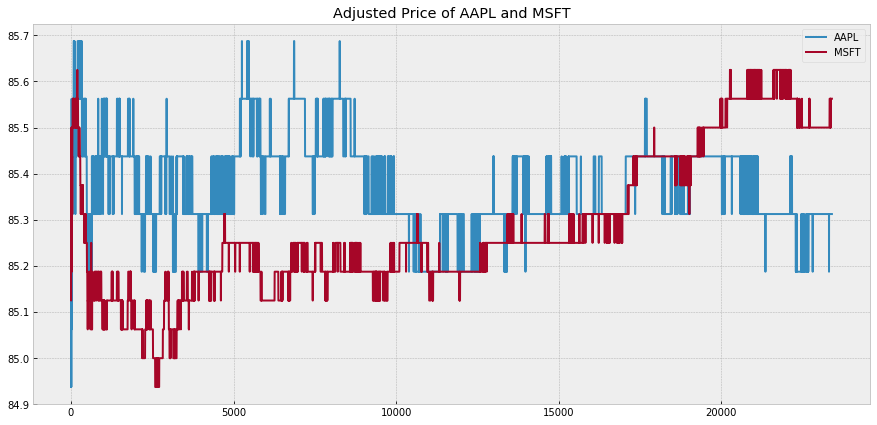

Plot z-score and trading signal of price ratio of AAPL and MSFT


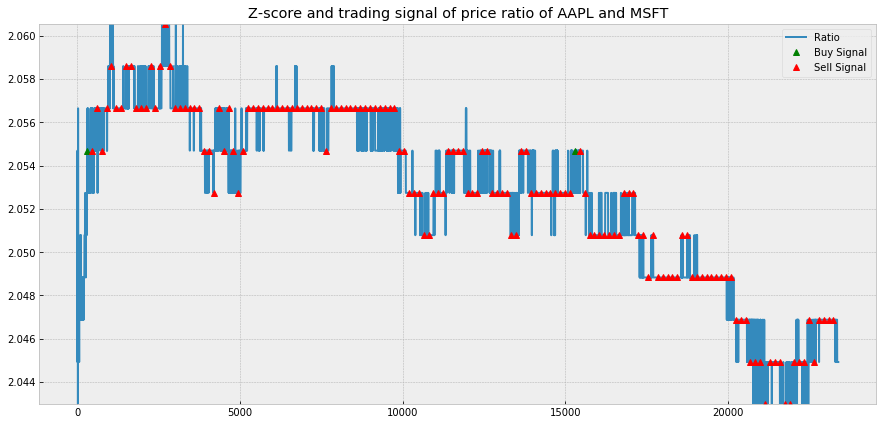

Trading signal of AAPL and MSFT for learning-based pair trading


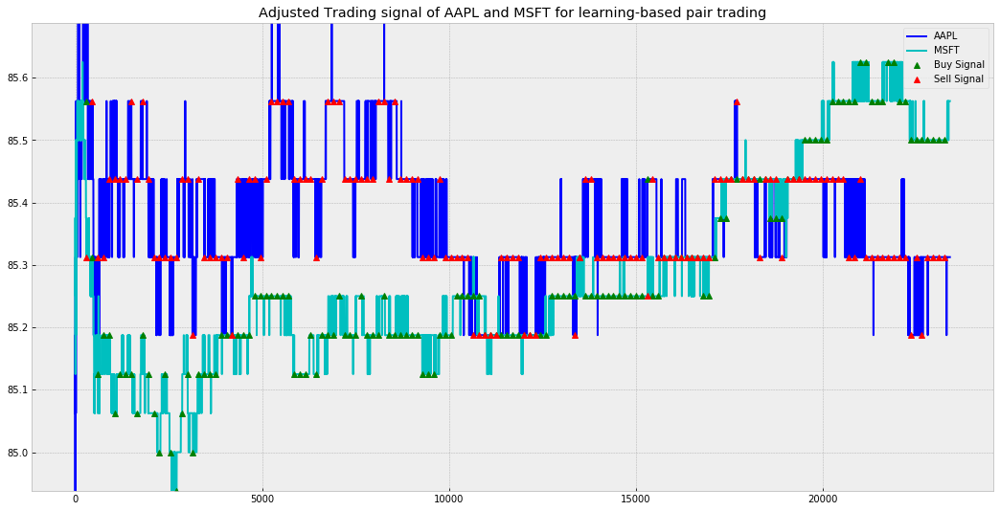

[Day 17]
v_test shape for day 17 : (154, 29, 299)
v_test shape for day 17 : (154, 29, 299)
v_test shape for day 17 : (154, 29, 299)
Predict Result....
Random pick time step :  [  2   7   9  14  16  20  35  36  45  51  55  58  62  64  65  66  68  69
  72  74  78  80 101 103 106 110 114 120 127 145 146 149 163 165 171 175
 176 178 180 185 186 188 189 193 194 195 208 218 219 222 231 236 238 240
 242 248 263 264 265 273 279 293 294 296]
Random pick time step :  [  8   9  14  18  19  20  30  32  34  39  40  45  51  59  60  66  70  71
  72  82  85  92  96  97 100 102 112 113 121 122 124 127 132 135 139 146
 154 159 160 175 185 192 213 217 220 224 225 226 227 234 245 247 249 252
 255 256 258 262 265 266 273 277 287 297]
Random pick time step :  [ 10  18  26  39  45  48  50  52  54  64  68  69  70  79  88  90  91  92
  97  99 101 106 107 111 113 119 123 131 140 155 158 164 167 168 177 179
 180 182 183 184 189 193 201 203 210 211 214 222 229 231 232 233 234 235
 236 237 244 254 259 261 275 277 

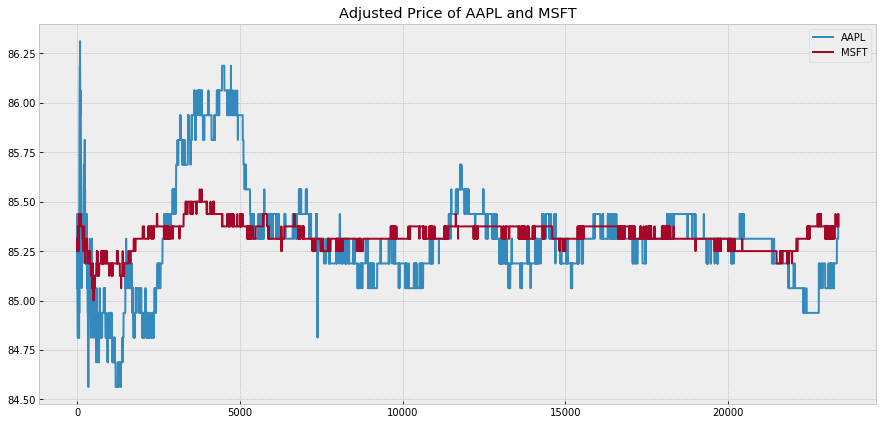

Plot z-score and trading signal of price ratio of AAPL and MSFT


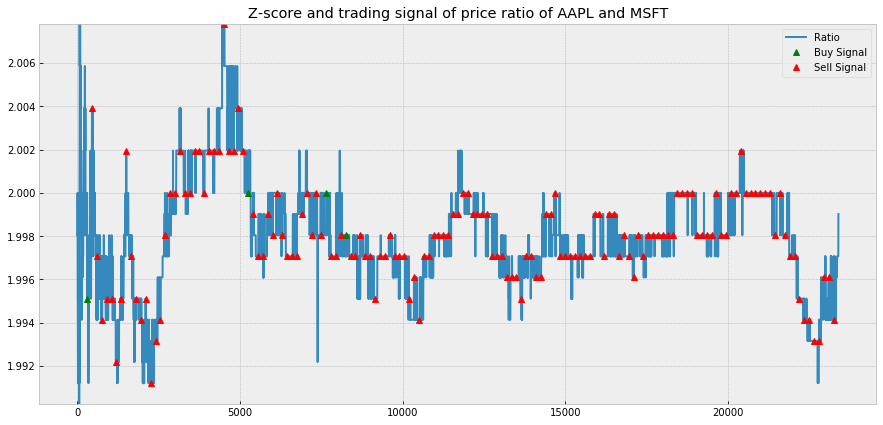

Trading signal of AAPL and MSFT for learning-based pair trading


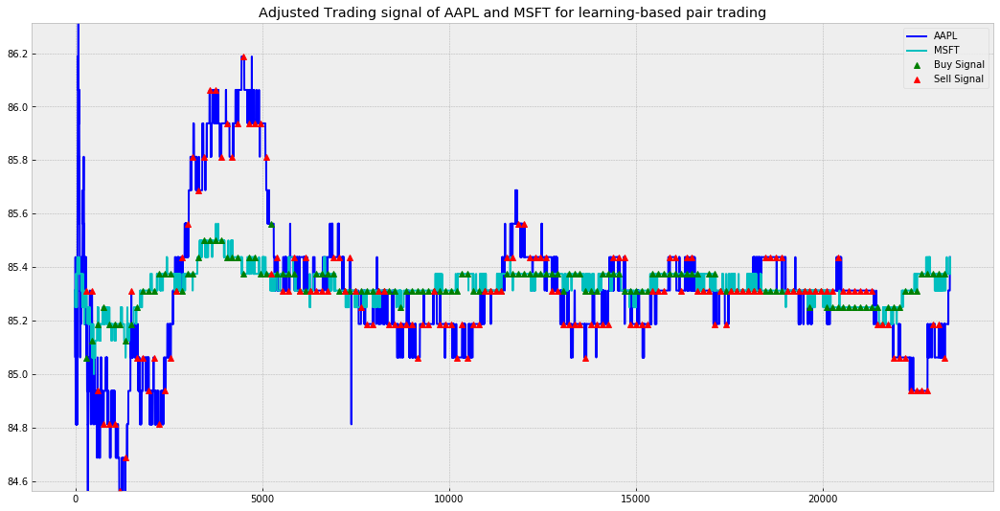

[Day 18]
v_test shape for day 18 : (154, 29, 299)
v_test shape for day 18 : (154, 29, 299)
v_test shape for day 18 : (154, 29, 299)
Predict Result....
Random pick time step :  [  2  11  12  13  30  32  33  42  46  48  67  75  76  85  87  90  92 101
 110 111 112 114 118 122 126 129 136 137 147 155 164 170 174 176 178 179
 185 187 189 190 192 200 204 208 211 219 228 233 237 243 251 252 254 256
 261 264 265 271 272 273 280 282 293 297]
Random pick time step :  [  2   4   5   7  12  14  18  23  24  28  29  37  39  44  54  61  77  81
  89  90  93  94 109 115 119 131 135 140 142 146 152 154 158 160 162 163
 164 165 166 168 181 182 190 193 194 195 196 200 206 208 213 218 230 231
 232 235 242 246 249 266 271 275 295 298]
Random pick time step :  [  1   9  11  15  23  26  30  32  33  47  52  54  55  59  61  66  69  76
  81  89  90  93  94  97 103 105 107 112 120 125 126 127 132 145 147 148
 149 154 155 167 171 172 179 180 185 197 200 211 217 218 220 221 230 237
 245 248 250 255 261 266 270 274 

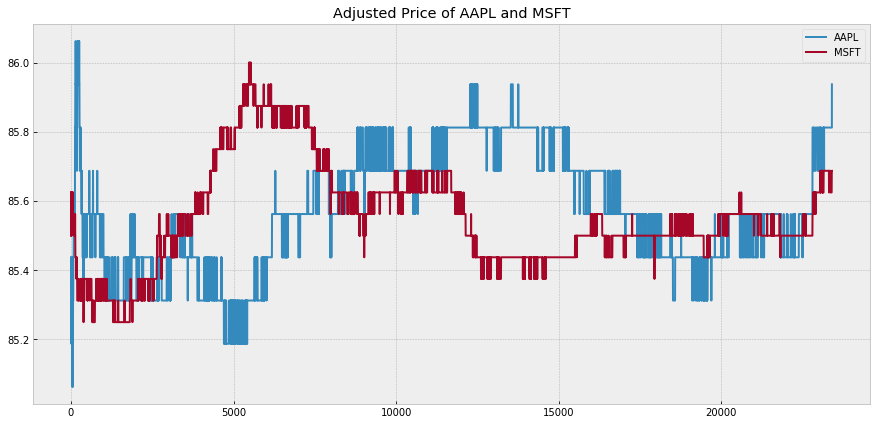

Plot z-score and trading signal of price ratio of AAPL and MSFT


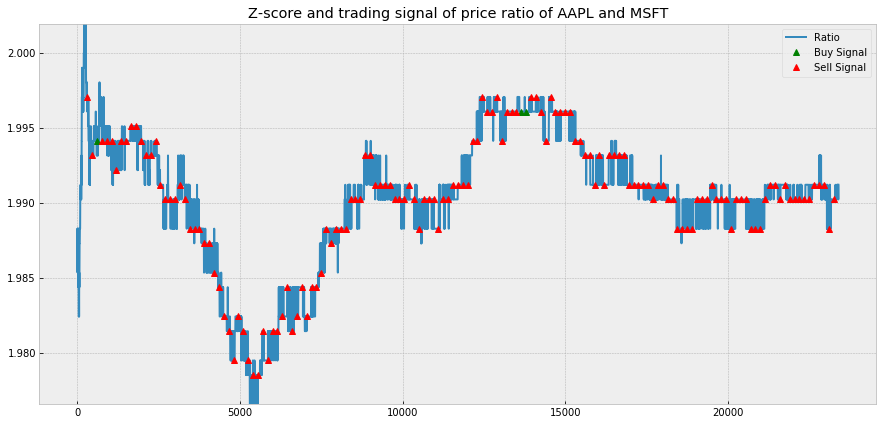

Trading signal of AAPL and MSFT for learning-based pair trading


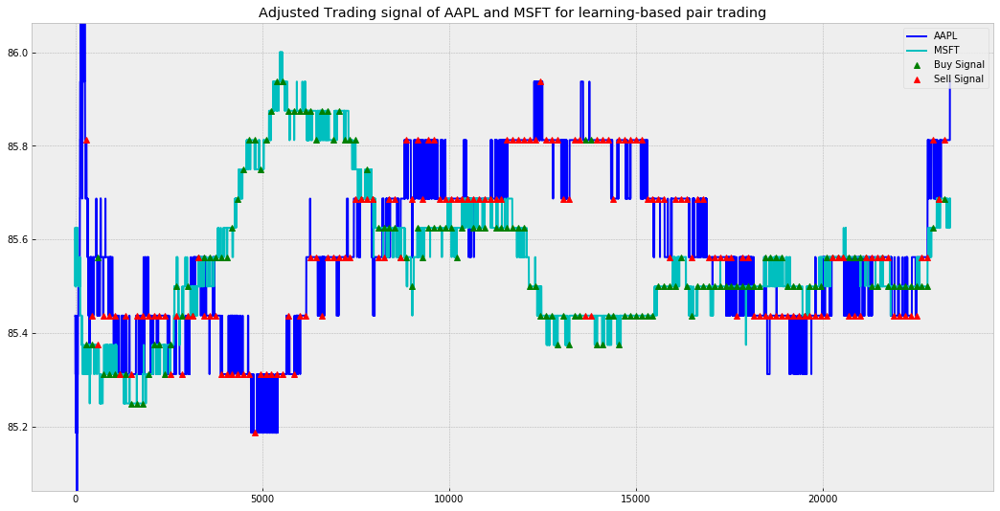

[Day 19]
v_test shape for day 19 : (154, 29, 299)
v_test shape for day 19 : (154, 29, 299)
v_test shape for day 19 : (154, 29, 299)
Predict Result....
Random pick time step :  [  5   9  19  22  24  32  35  37  48  53  56  60  66  68  71  75  77  79
  87  90  92  98  99 103 106 111 112 121 124 128 133 134 142 143 146 151
 157 161 163 164 170 173 176 179 187 188 189 192 195 202 211 215 216 220
 228 239 240 245 263 266 277 278 290 295]
Random pick time step :  [  0   3  20  24  31  35  46  48  50  52  55  62  64  69  70  73  74  89
  90  91  94 100 107 109 111 113 118 122 123 126 136 137 138 142 146 152
 155 161 162 187 188 192 196 204 205 212 213 218 225 227 233 240 243 251
 254 255 259 263 265 274 280 282 284 289]
Random pick time step :  [  5  10  12  20  26  29  41  51  54  62  65  68  72  81  91  93  99 103
 112 116 134 136 137 140 146 147 148 155 159 166 171 180 183 184 185 188
 196 201 205 208 210 211 212 213 218 221 231 232 234 250 253 256 257 259
 260 267 270 276 277 278 281 286 

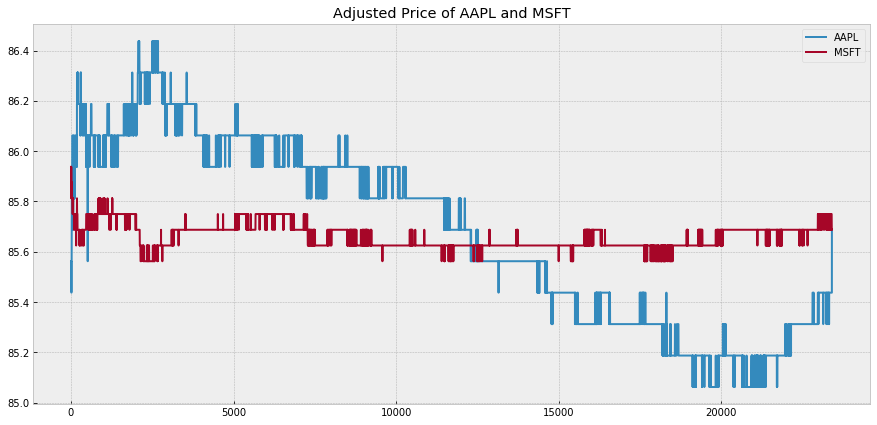

Plot z-score and trading signal of price ratio of AAPL and MSFT


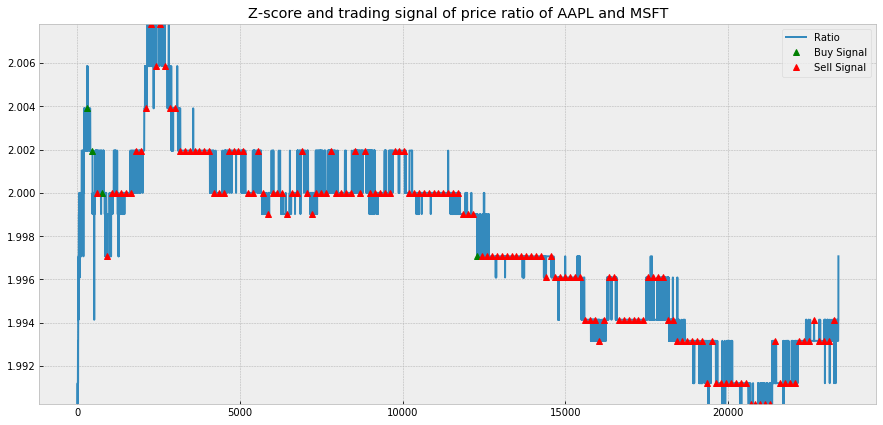

Trading signal of AAPL and MSFT for learning-based pair trading


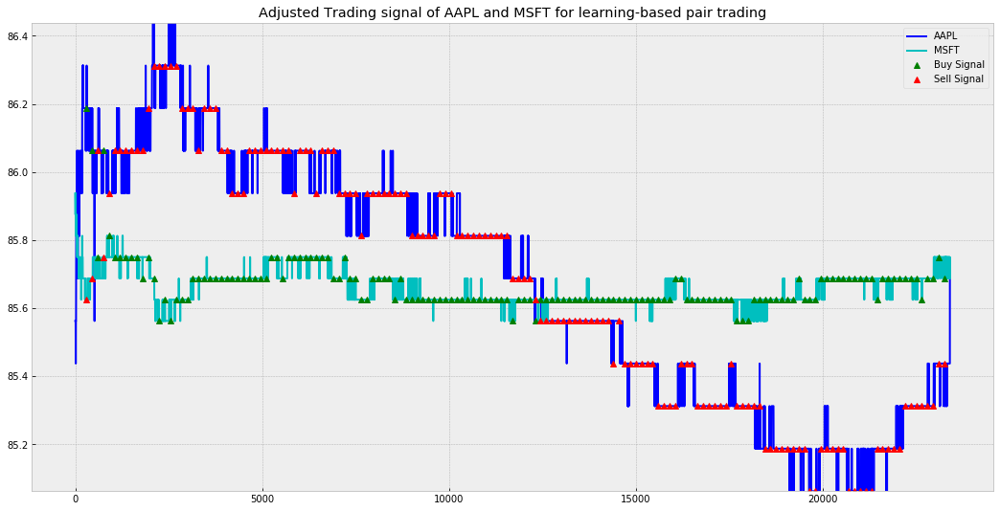

[Day 20]
v_test shape for day 20 : (154, 29, 299)
v_test shape for day 20 : (154, 29, 299)
v_test shape for day 20 : (154, 29, 299)
Predict Result....
Random pick time step :  [  3  11  13  15  19  23  24  26  33  37  55  59  62  64  67  68  69  75
  76  77  80  83  85  86  91  92  93 107 124 127 132 140 147 151 155 167
 170 174 178 181 186 201 207 209 223 237 240 247 248 249 250 253 255 257
 261 262 269 274 275 277 287 288 289 294]
Random pick time step :  [  2   4   9  17  21  33  38  42  53  60  62  63  64  73  75  77  79  83
  84  93  95 100 103 107 108 111 112 116 118 119 129 131 132 138 140 145
 153 156 172 173 174 179 181 182 190 193 198 201 202 207 216 217 221 228
 234 237 239 240 245 258 265 274 282 289]
Random pick time step :  [ 10  11  13  33  34  37  39  46  47  52  73  75  85  87 117 119 120 122
 130 133 141 143 146 149 152 154 155 157 162 170 171 175 181 182 187 190
 197 212 213 216 224 229 235 242 244 245 246 247 249 252 264 267 268 269
 272 273 274 284 286 287 289 290 

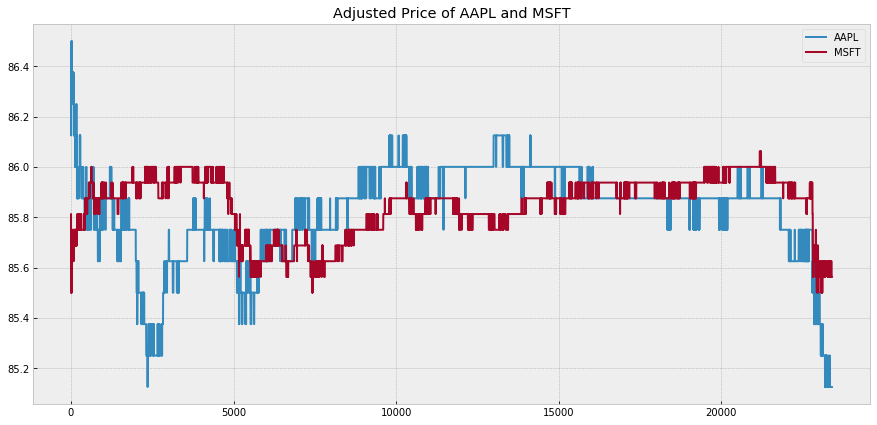

Plot z-score and trading signal of price ratio of AAPL and MSFT


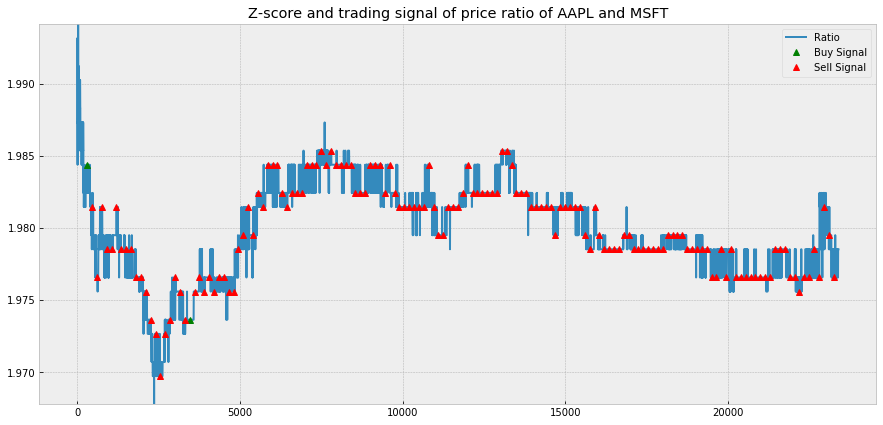

Trading signal of AAPL and MSFT for learning-based pair trading


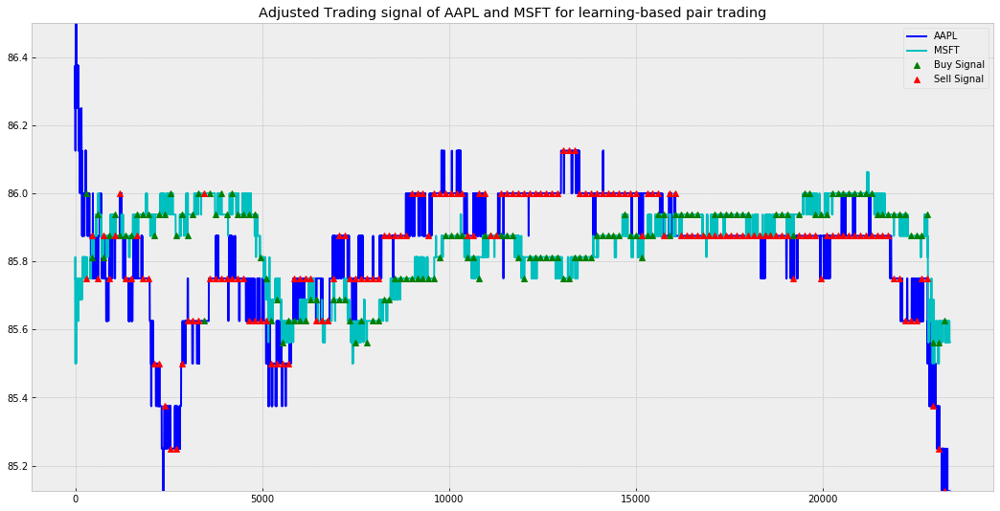

<Figure size 432x288 with 0 Axes>

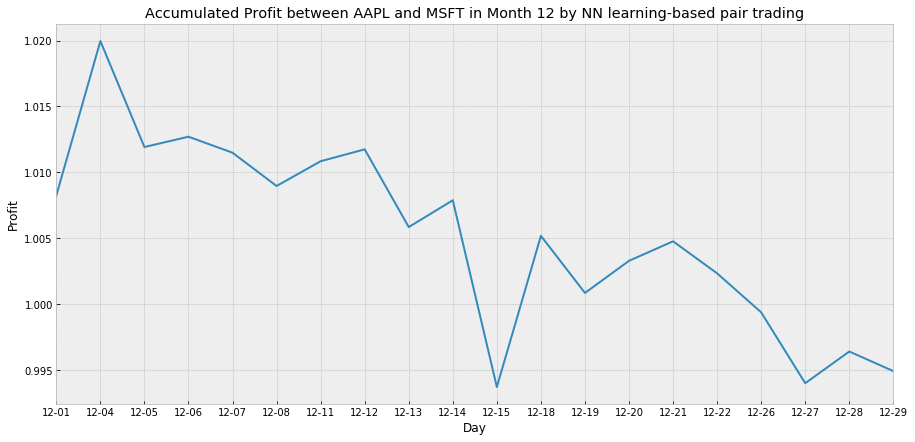

In [64]:
# 這邊是用NN prediction 來做策略
#p = ['AAPL', 'CSCO']
#p = ['MRK', 'MSFT']
profit_day_NN = []
signal = []
price_day_avg = []
predict_result = {}
profit_Mode = 1
for i in range(day_test):
    print("[Day %s]" % str(i+1))
    S1 = pd.DataFrame({p[0]: price_and_return_for_test[p[0]][0][i,:]})
    S2 = pd.DataFrame({p[1]: price_and_return_for_test[p[1]][0][i,:]})
    price_day_avg.append(np.mean(S1.values) + np.mean(S2.values))
    result = NN_trade(S1, S2, p[0], p[1], price_data_for_test, price_and_return_for_test, net, i, show_print = 1, fee = 0, profit_Mode = profit_Mode)
    profit_day_NN.append(result[0])
    signal.append([result[1], result[2]])
    predict_result[i+1] = result[3]
    drawTradingCondition(p[0], p[1], price_and_return_for_test, i, window_l, window_s, trading_time, result[1], result[2], mode = 'NN')

# Plot profit
fig = plt.gcf()
plt.figure(figsize=(15,7))
if profit_Mode == 0:
    plt.plot(np.cumsum(profit_day_NN))
else:
    plt.plot(np.cumprod(profit_day_NN))
plt.xticks(range(day_test), date_test_noyear)
plt.title('Accumulated Profit between %s and %s in Month %s by NN learning-based pair trading' % (p[0], p[1], period_test[0]))
plt.style.use("bmh")
plt.xlim(0,19)
plt.xlabel('Day')
plt.ylabel('Profit')
plt.show()

In [65]:
predict_result

{1: (array([3, 2, 2, 2, 3, 2, 2, 1, 2, 1, 2, 2, 2, 1, 1, 2, 2, 2, 2, 2, 2, 2,
         2, 2, 2, 3, 2, 2, 1, 2, 2, 1, 1, 2, 2, 2, 2, 2, 2, 2, 1, 1, 2, 1,
         2, 1, 1, 1, 3, 1, 2, 2, 2, 2, 3, 1, 1, 1, 1, 2, 2, 2, 3, 2, 2, 2,
         2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2,
         2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2,
         2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2,
         2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2]),
  array([1, 1, 2, 2, 1, 1, 2, 1, 2, 2, 2, 2, 2, 2, 1, 2, 2, 1, 2, 1, 2, 2,
         2, 1, 2, 1, 1, 2, 1, 2, 1, 2, 2, 2, 2, 2, 2, 2, 2, 1, 2, 1, 2, 2,
         1, 2, 2, 2, 1, 1, 2, 2, 2, 2, 2, 2, 1, 2, 1, 2, 2, 2, 1, 2, 2, 2,
         2, 2, 2, 2, 2, 2, 1, 1, 2, 2, 2, 1, 2, 2, 2, 2, 2, 2, 2, 1, 2, 1,
         2, 2, 2, 1, 2, 2, 1, 2, 1, 2, 2, 2, 2, 1, 2, 1, 1, 2, 1, 2, 2, 2,
         2, 1, 2, 1, 2, 2, 2, 2, 2, 2, 2, 2, 1, 2, 2, 1, 2, 2, 2, 1, 1, 2,
         2, 2, 2, 2,

<Figure size 432x288 with 0 Axes>

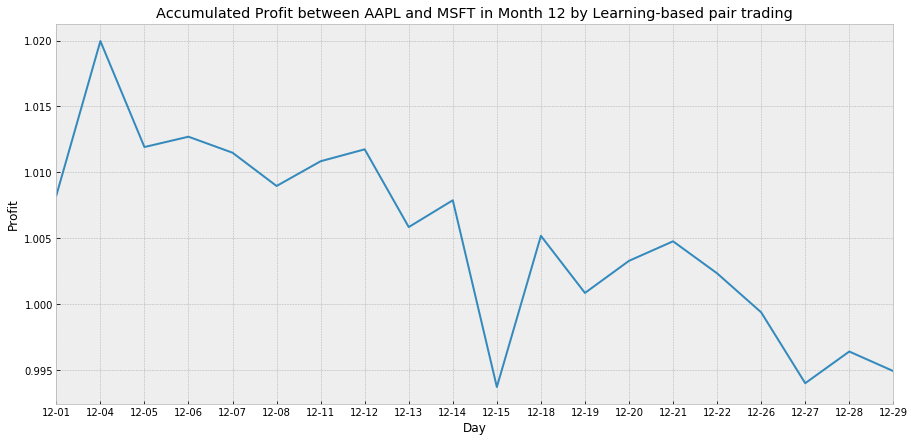

<Figure size 432x288 with 0 Axes>

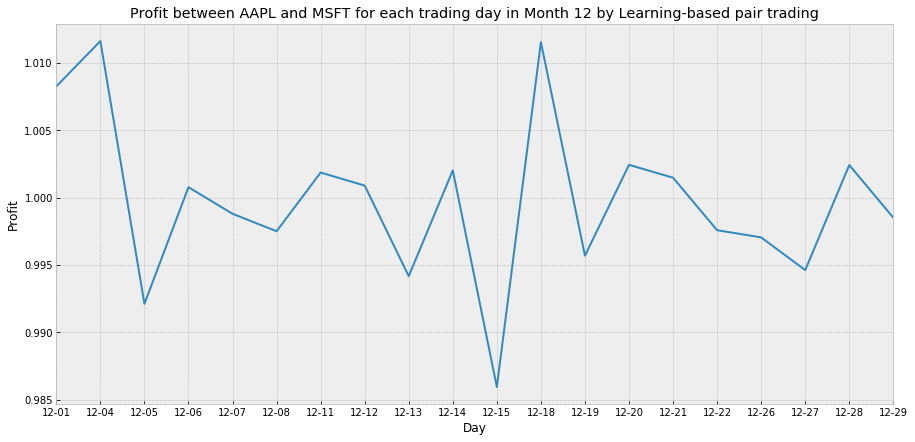

In [66]:
draw_profit(profit_day_NN, date_test_noyear, period_test, mode = 'Learning-based', profit_Mode = profit_Mode)

In [67]:
profit_day_NN

[1.008250948830772,
 1.011612796779338,
 0.9921221670017346,
 1.0007739560427689,
 0.9988011757434047,
 0.9975054641537355,
 1.0018611857987443,
 1.0008920482839756,
 0.9941736485530734,
 1.0020207186105212,
 0.9859508462339514,
 1.011534601388519,
 0.9956932505836871,
 1.0024323972395104,
 1.0014758626050686,
 0.9975822268132875,
 0.9970506919569775,
 0.9946213397990006,
 1.0024170884448258,
 0.9985105137891422]

1.0808134468590405


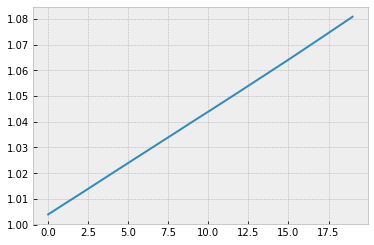

In [68]:
# 先算每天總收益，再拉出來用單日兩間公司的平均價算收益率的版本
profit_day_NN_avgrate = np.array(profit_day_NN) / np.array(price_day_avg)
print(np.cumprod(np.add(profit_day_NN_avgrate, 1))[-1])
plt.plot(np.cumprod(np.add(profit_day_NN_avgrate, 1)))

0.9949336955708569


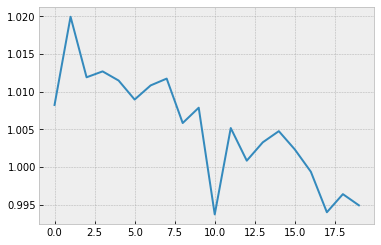

In [69]:
# profit rate直接在交易過程就算好的版本
print(np.cumprod(profit_day_NN)[-1])
plt.plot(np.cumprod(profit_day_NN))

# Learning-based Pairs Trading 
## 這下面的做法把同漲同跌的部分改成兩支股票一起做多或做空而不是一多一空

In [70]:
# Trade using a simple strategy
def NN_trade_v2(S1, S2, c1, c2, price_data, price_and_return, net, day, show_print = 0, fee = 0, profit_Mode = 0):
    ''' 
    buys 1 ratio (buy 1 AAPL stock and sell ratio x MSFT stock) when ratio is low, 
    sell 1 ratio (sell 1 AAPL stock and buy ratio x MSFT stock) when it's high, 
    and calculate PnL (profit and loss，損益) of these trades.
    '''

    # Compute rolling mean and rolling standard deviation
    ratios = pd.DataFrame({"ratios" : (S1.values/S2.values).ravel()})
    
    c1_idx = sorted(temp_c).index(c1)
    c2_idx = sorted(temp_c).index(c2)
    
    roll_pair = rolling(price_data, price_and_return, v_length, shift_length, day, mode = 'price')
    roll_v, roll_v_answer, position = roll_pair[0][:,[c1_idx,c2_idx],:], roll_pair[1][:,[c1_idx,c2_idx],:], roll_pair[2]
    position = sorted([list(x) for x in set(tuple(x) for x in position)])
    
    # 兩間公司三種問題的dataloader
    predDataloader_q1 = predictDataloader(price_data, price_and_return, adjacency_matrix_Edge_test, all_com_pair_P, c1, c2, day, qtype[0], show_shape = 0)
    predDataloader_q2 = predictDataloader(price_data, price_and_return, adjacency_matrix_Edge_test, all_com_pair_P, c1, c2, day, qtype[1], show_shape = 0)
    predDataloader_q3 = predictDataloader(price_data, price_and_return, adjacency_matrix_Edge_test, all_com_pair_P, c1, c2, day, qtype[2], show_shape = 0)
    
    # 用NN預測問題
    q1a = predict(predDataloader_q1, net, is_train = 0, split_question = split_question)
    q2a = predict(predDataloader_q2, net, is_train = 0, split_question = split_question)
    q3a = predict(predDataloader_q3, net, is_train = 0, split_question = split_question)

    if split_question == 1:
        # 分問題，理應只有q1a1, q2a2, q3a3有用
        q1a1, q1a2, q1a3 = np.hstack([d[0] for d in q1a]), np.hstack([d[1] for d in q1a]), np.hstack([d[2] for d in q1a])
        q2a1, q2a2, q2a3 = np.hstack([d[0] for d in q2a]), np.hstack([d[1] for d in q2a]), np.hstack([d[2] for d in q2a])
        q3a1, q3a2, q3a3 = np.hstack([d[0] for d in q3a]), np.hstack([d[1] for d in q3a]), np.hstack([d[2] for d in q3a])
    else:
        q1a1, q1a2, q1a3 = np.vstack(q1a)[:,:4], np.vstack(q1a)[:,4:7], np.vstack(q1a)[:,7:]
        q2a1, q2a2, q2a3 = np.vstack(q2a)[:,:4], np.vstack(q2a)[:,4:7], np.vstack(q2a)[:,7:]
        q3a1, q3a2, q3a3 = np.vstack(q3a)[:,:4], np.vstack(q3a)[:,4:7], np.vstack(q3a)[:,7:]
    
    # Learning-based trading
    # Start with no money and no positions
    if profit_Mode == 0:
        money = 0
    else:
        money = 1
    countS1 = 0
    countS2 = 0
    #buy = np.ones(len(ratios))
    #sell = np.ones(len(ratios))
    buy = []
    sell = []

    # 總共有v_test.shape[0]個決策點，一天的前300秒不做決策，每60秒做一次決策，一次買賣一口
    for i in range(roll_v.shape[0]):
        if show_print == 1:
            print("---------[Time = %s to %s]---------" % (position[i][2], position[i][3]))
            print("Current profit : ", " profit - ", money)
        # t0入場，t60出場
        S1_t0, S1_t60 = roll_v_answer[i][0][0], roll_v_answer[i][0][-1]
        S2_t0, S2_t60 = roll_v_answer[i][1][0], roll_v_answer[i][1][-1]
        entry_time = position[i][2]-1
        exit_time = position[i][3]-1
        
        # NN系列預測的策略
        
        '''
        # Sell short if Volatility1 < Volatility2
        if q3a3[i] == 2:    
            # 交易成本部分： 0.00231%的交易稅、各0.5%的手續費
            if fee == 1:
                money += S1_t0 - S2_t0 * ratios.iloc[entry_time][0] - 0.0000231 * S1_t0 - 0.005 * S1_t0 - 0.005 * S2_t0 * ratios.iloc[entry_time]
            else:
                money += S1_t0 - S2_t0 * ratios.iloc[entry_time][0]

            countS1 -= 1
            countS2 += ratios.iloc[entry_time][0]

            #sell[entry_time] = 0
            sell.append(entry_time)

            if show_print == 1:
                print('[Sell %s and Buy %s] profit %s | price ratios %s | C1 %s pos | C2 %s pos'% (c1, c2, money, ratios.iloc[entry_time][0], countS1, countS2))

        # Buy long if Volatility1 > Volatility2
        elif q3a3[i] == 1:    
            # 交易成本部分： 0.00231%的交易稅、各0.5%的手續費
            if fee == 1:
                money -= S1_t0 - S2_t0 * ratios.iloc[entry_time][0] - 0.0000231 * S2_t0 * ratios.iloc[entry_time][0] - 0.005 * S1_t0 - 0.005 * S2_t0 * ratios.iloc[entry_time][0]
            else:
                money -= S1_t0 - S2_t0 * ratios.iloc[entry_time][0]

            countS1 += 1
            countS2 -= ratios.iloc[entry_time][0]

            #buy[entry_time] = 0
            buy.append(entry_time)

            if show_print == 1:
                print('[Buy %s and Sell %s] profit %s | price ratios %s | C1 %s pos | C2 %s pos'% (c1, c2, money, ratios.iloc[entry_time][0], countS1, countS2))
        
        '''
        # if Pairwise Price Change BothRise
        if (q1a1[i] == 1):
            '''
            08/05更新，這裡一起做多
            07/10更新，先把強弱勢註解掉
            因為同漲同跌這些跟強弱勢已經有點相同了，改用波動率
            '''
            # 交易成本部分： 0.00231%的交易稅、各0.5%的手續費
            ratio = S1_t0 / S2_t0
            #print(entry_time, ratios.iloc[entry_time][0])
            if profit_Mode == 0:
                if fee == 1:
                    money += -S1_t0 - S2_t0 * ratio - 0.0000231 * S1_t0 - 0.005 * S1_t0 - 0.005 * S2_t0 * ratio
                else:
                    money += -S1_t0 - S2_t0 * ratio

            countS1 += 1
            countS2 += ratio

            #sell[entry_time] = 0
            buy.append(entry_time)

            if show_print == 1:
                print("[Pairwise Price Change BothRise，Both Buy]")
                print('[Buy %s and Buy %s] profit %s | price ratios %s | C1 %s pos | C2 %s pos'% (c1, c2, money, ratio, countS1, countS2))
                print('%s price - %s payment - %s | %s price - %s payment - %s |' % (c1, S1_t0, S1_t0, c2, S2_t0, S2_t0 * ratio))
                    
        # if Pairwise Price Change BothFall
        elif (q1a1[i] == 2):
            # 交易成本部分： 0.00231%的交易稅、各0.5%的手續費
            ratio = S1_t0 / S2_t0
            #print(entry_time, ratios.iloc[entry_time][0])
            if profit_Mode == 0:
                if fee == 1:
                    money += S1_t0 + S2_t0 * ratio - 0.0000231 * S1_t0 - 0.005 * S1_t0 - 0.005 * S2_t0 * ratio
                else:
                    money += S1_t0 + S2_t0 * ratio

            countS1 -= 1
            countS2 -= ratio

            #sell[entry_time] = 0
            sell.append(entry_time)

            if show_print == 1:
                print("[Pairwise Price Change BothFall，Both Sell]")
                print('[Sell %s and Sell %s] profit %s | price ratios %s | C1 %s pos | C2 %s pos'% (c1, c2, money, ratio, countS1, countS2))
                print('%s price - %s revenue - %s | %s price - %s revenue - %s |' % (c1, S1_t0, S1_t0, c2, S2_t0, S2_t0 * ratio))
        
        # Sell short if Pairwise Price Change Reverse and Strength1 < Strength2
        elif (q1a1[i] == 3 and q2a2[i] == 2):
            # 交易成本部分： 0.00231%的交易稅、各0.5%的手續費
            ratio = S1_t0 / S2_t0
            #print(entry_time, ratios.iloc[entry_time][0])
            if profit_Mode == 0:
                if fee == 1:
                    money += S1_t0 - S2_t0 * ratio - 0.0000231 * S1_t0 - 0.005 * S1_t0 - 0.005 * S2_t0 * ratio
                else:
                    money += S1_t0 - S2_t0 * ratio
                
            countS1 -= 1
            countS2 += ratio
            
            #sell[entry_time] = 0
            sell.append(entry_time)
            
            if show_print == 1:
                print("[Pairwise Price Change Reverse and Strength1 < Strength2]")
                print('[Sell %s and Buy %s] profit %s | price ratios %s | C1 %s pos | C2 %s pos'% (c1, c2, money, ratio, countS1, countS2))
                print('%s price - %s revenue - %s | %s price - %s payment - %s |' % (c1, S1_t0, S1_t0, c2, S2_t0, S2_t0 * ratio))
        
        # Buy long if Pairwise Price Change Reverse and Strength1 > Strength2
        elif (q1a1[i] == 3 and q2a2[i] == 1):
            # 交易成本部分： 0.00231%的交易稅、各0.5%的手續費
            ratio = S1_t0 / S2_t0
            #print(entry_time, ratios.iloc[entry_time][0])
            if profit_Mode == 0:
                if fee == 1:
                    money -= S1_t0 - S2_t0 * ratio - 0.0000231 * S2_t0 * ratio - 0.005 * S1_t0 - 0.005 * S2_t0 * ratio
                else:
                    money -= S1_t0 - S2_t0 * ratio
                
            countS1 += 1
            countS2 -= ratio
            
            #buy[entry_time] = 0
            buy.append(entry_time)
            
            if show_print == 1:
                print("[Pairwise Price Change Reverse and Strength1 > Strength2]")
                print('[Buy %s and Sell %s] profit %s | price ratios %s | C1 %s pos | C2 %s pos'% (c1, c2, money, ratio, countS1, countS2))
                print('%s price - %s payment - %s | %s price - %s revenue - %s |' % (c1, S1_t0, S1_t0, c2, S2_t0, S2_t0 * ratio))

        # Clear positions for each decision point  
        # 交易成本部分： 0.00231%的交易稅 、各0.5%的手續費
        ratio = S1_t0 / S2_t0
        if profit_Mode == 0:
            if fee == 1:
                money += countS1 * S1_t60 + S2_t60 * countS2 - 0.0000231 * (countS1 * S1_t60 + countS2 * S2_t60) - 0.005 * (S1_t60 * countS1 + S2_t60 * countS2)
            else:
                money += countS1 * S1_t60 + S2_t60 * countS2
        else:    # profit rate
            # 這裡是為了確認同漲同跌同時做空做多的情況
            if countS1 * countS2 > 0:
                if fee == 1:
                    money *= 1 + (countS1 * (S1_t60-S1_t0) + (S2_t60-S2_t0) * countS2 - 0.0000231 * (abs(countS1) * S1_t60 + abs(countS2) * S2_t60) - 0.005 * (S1_t60 * abs(countS1) + S2_t60 * abs(countS2))) / (S1_t0 + S2_t0)
                else:
                    money *= 1 + (countS1 * (S1_t60-S1_t0) + (S2_t60-S2_t0) * countS2) / (S1_t0 + S2_t0)
            else:
                if fee == 1:
                    money *= 1 + (-countS1 * S1_t60 + S2_t60 * -countS2 - 0.0000231 * (abs(countS1) * S1_t60 + abs(countS2) * S2_t60) - 0.005 * (S1_t60 * abs(countS1) + S2_t60 * abs(countS2))) / (S1_t0 + S2_t0)
                else:
                    money *= 1 + (-countS1 * S1_t60 + S2_t60 * -countS2) / (S1_t0 + S2_t0)

        if show_print == 1:
            print('[Exit position] profit %s | price ratios %s | C1 %s pos | C2 %s pos'% (money, ratio, -countS1, -countS2))
            print('%s price - %s, earn : %s | %s price - %s, earn : %s |' % (c1, S1_t60, -countS1 * S1_t60, c2, S2_t60, -countS2 * S2_t60))
        
        # clear position
        countS1, countS2 = 0, 0
        
    return money, buy, sell, (q1a1, q2a2, q3a3)

[Day 1]
v_test shape for day 1 : (154, 29, 299)
v_test shape for day 1 : (154, 29, 299)
v_test shape for day 1 : (154, 29, 299)
Predict Result....
Random pick time step :  [  4  19  20  22  26  28  30  31  34  47  49  53  59  60  65  73  76  81
  84  85  88  95  98  99 100 106 112 123 127 132 136 139 141 143 151 152
 158 160 164 169 175 178 184 191 196 198 200 203 207 210 216 219 235 241
 245 250 253 259 260 268 271 277 283 296]
Random pick time step :  [  6   9  12  19  20  26  31  34  36  43  52  58  60  61  71  74  81  87
  89  91 104 107 108 110 114 115 116 118 121 129 130 133 135 143 148 151
 155 157 161 164 166 167 182 188 196 209 214 221 231 232 237 238 245 255
 265 268 276 282 283 284 287 292 297 298]
Random pick time step :  [  0   2   8  11  25  27  45  51  53  56  59  62  67  70  71  83  84  86
  87  90  95 119 124 125 128 129 130 132 146 148 151 153 165 182 186 193
 196 197 200 202 209 214 215 216 230 238 240 241 247 257 260 263 266 268
 271 273 277 278 279 281 283 288 290 

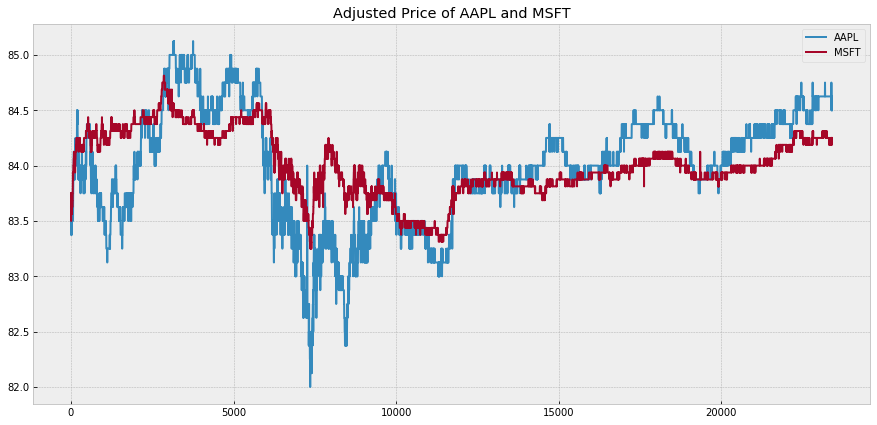

Plot z-score and trading signal of price ratio of AAPL and MSFT


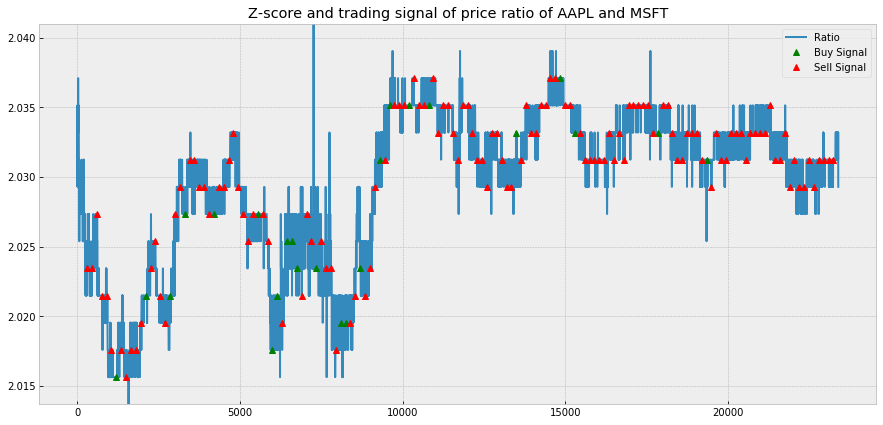

Trading signal of AAPL and MSFT for learning-based pair trading


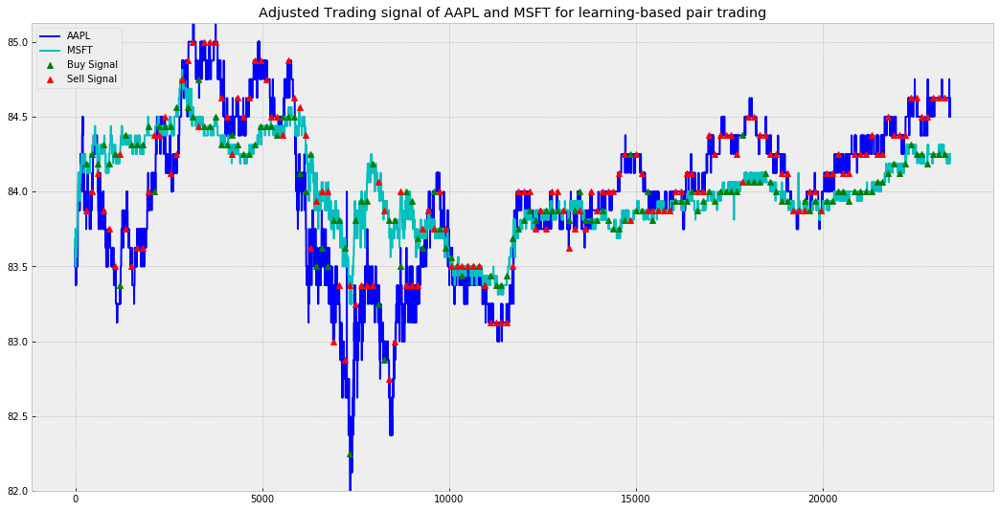

[Day 2]
v_test shape for day 2 : (154, 29, 299)
v_test shape for day 2 : (154, 29, 299)
v_test shape for day 2 : (154, 29, 299)
Predict Result....
Random pick time step :  [ 10  18  20  21  24  26  35  36  37  38  40  45  52  59  60  65  70  72
  74  84  90  93  98 101 104 108 111 116 119 121 135 138 139 140 146 156
 166 169 176 183 186 195 203 207 211 219 229 235 236 237 249 256 259 260
 263 265 266 267 270 274 275 281 286 288]
Random pick time step :  [  0   1   6   8  12  16  22  25  37  41  43  44  45  48  51  62  64  66
  68  71  72  77  78  84  95  96  97  99 104 125 126 127 129 138 140 143
 144 145 148 150 158 162 163 166 167 186 187 192 193 210 214 229 230 245
 248 249 252 255 265 275 282 284 290 297]
Random pick time step :  [  1   5   6   8  11  22  23  24  26  28  31  37  43  46  49  50  54  58
  59  60  61  64  69  73  76  78  83  88  91  92 100 113 117 130 138 144
 147 148 150 151 153 162 170 191 197 198 199 205 215 216 220 223 225 228
 232 233 238 245 251 259 265 269 274 

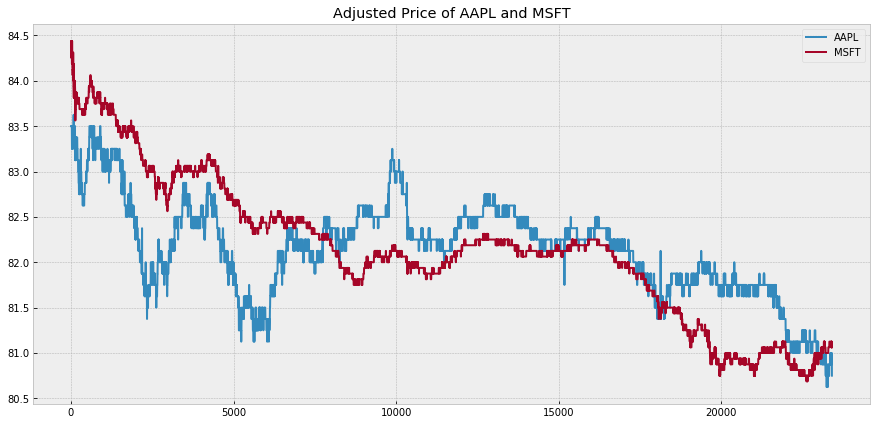

Plot z-score and trading signal of price ratio of AAPL and MSFT


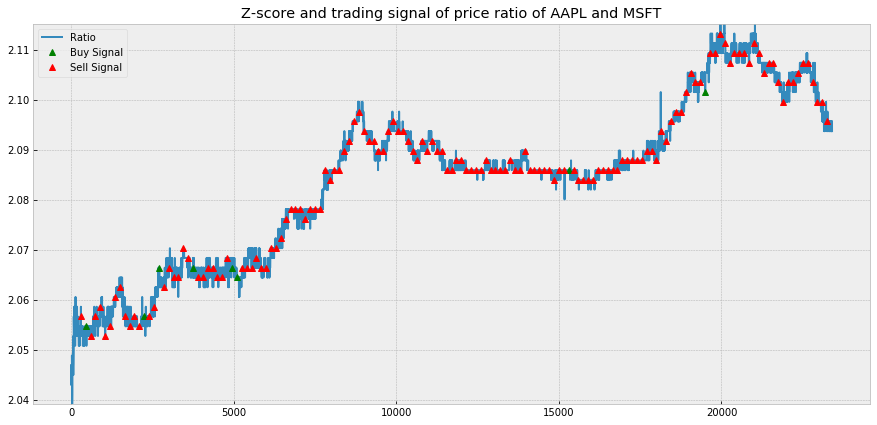

Trading signal of AAPL and MSFT for learning-based pair trading


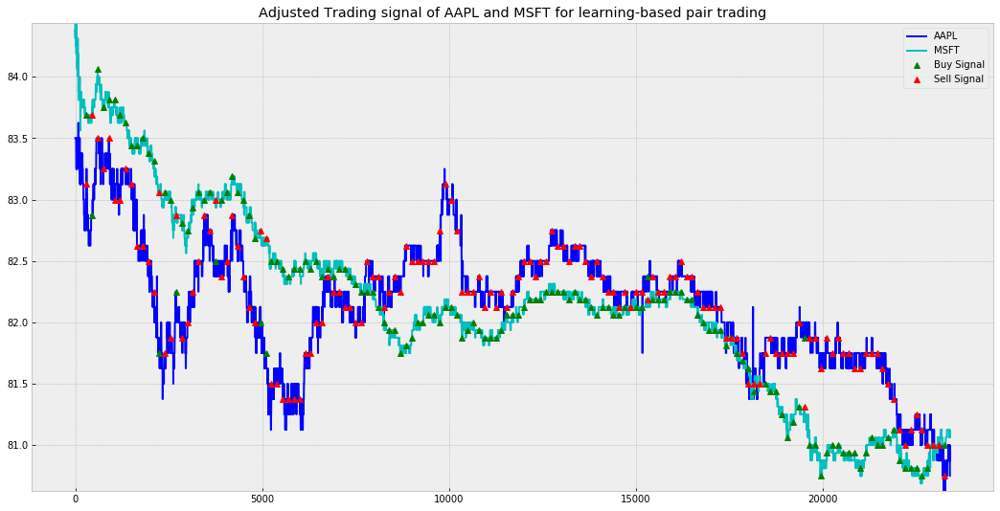

[Day 3]
v_test shape for day 3 : (154, 29, 299)
v_test shape for day 3 : (154, 29, 299)
v_test shape for day 3 : (154, 29, 299)
Predict Result....
Random pick time step :  [  1   3   4   7  10  11  19  20  22  27  30  45  48  69  72  73  75  77
  78  80  84  90  91  95 100 102 103 104 108 110 126 135 139 144 146 149
 153 155 156 172 177 183 186 189 192 193 201 203 206 207 212 221 223 229
 235 244 245 257 261 265 270 278 280 286]
Random pick time step :  [ 13  15  20  23  26  27  29  35  38  46  48  60  61  63  69  72  82  88
  94  98 101 102 103 104 107 114 118 119 122 123 132 133 140 141 143 149
 155 161 165 174 180 182 188 189 191 221 223 225 227 228 236 239 244 247
 253 259 261 262 274 281 288 290 292 296]
Random pick time step :  [  0   1   6  17  18  23  24  34  47  48  53  65  70  75  80  83  90  91
  94  99 100 105 117 119 125 131 138 141 151 152 154 160 166 168 185 186
 190 194 200 201 212 215 220 224 225 227 234 235 251 254 258 259 264 266
 267 268 270 272 273 283 284 288 294 

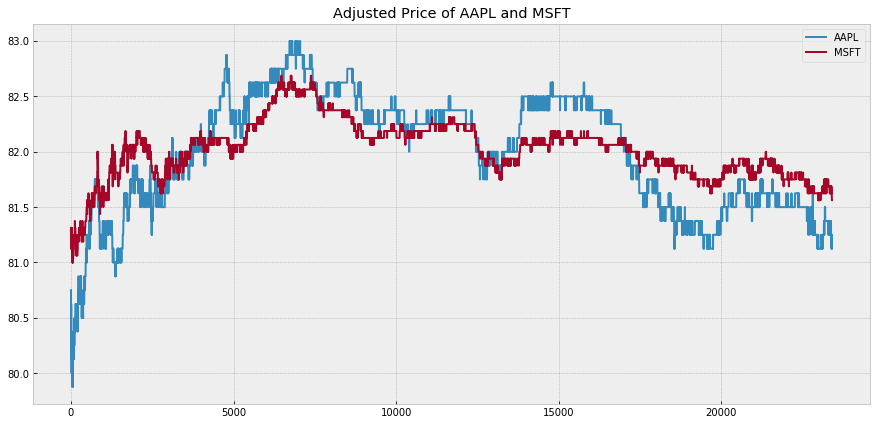

Plot z-score and trading signal of price ratio of AAPL and MSFT


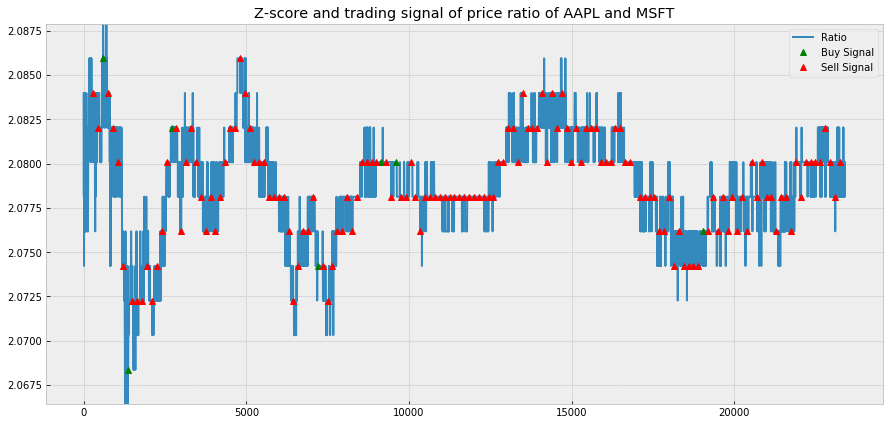

Trading signal of AAPL and MSFT for learning-based pair trading


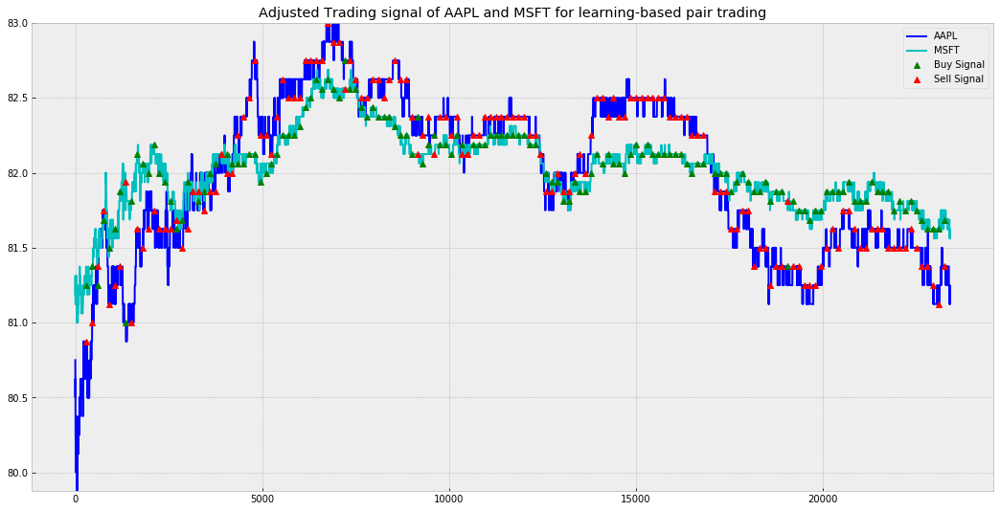

[Day 4]
v_test shape for day 4 : (154, 29, 299)
v_test shape for day 4 : (154, 29, 299)
v_test shape for day 4 : (154, 29, 299)
Predict Result....
Random pick time step :  [  2  10  14  19  21  23  33  38  40  59  67  69  75  76  77  78  80  87
  89 106 114 122 123 139 141 142 143 147 149 152 154 158 159 162 166 167
 169 172 176 178 184 185 188 195 196 199 206 218 223 225 226 227 237 243
 247 254 260 261 266 272 279 283 284 286]
Random pick time step :  [  1   2   9  13  20  23  31  35  44  50  58  59  65  67  74  75  80  85
  86  88  94  95  97 100 101 104 107 109 112 114 120 125 130 136 139 146
 152 155 157 160 165 169 188 193 199 211 219 221 222 227 230 235 237 240
 244 248 265 270 275 277 278 280 284 288]
Random pick time step :  [  0   4   8  33  37  41  43  48  54  65  71  75  77  79  84  91  96  98
 106 111 115 116 117 121 123 133 142 145 149 154 156 161 168 173 176 177
 179 183 186 191 200 203 208 212 214 219 230 231 232 234 237 239 244 247
 248 257 271 274 275 278 283 286 288 

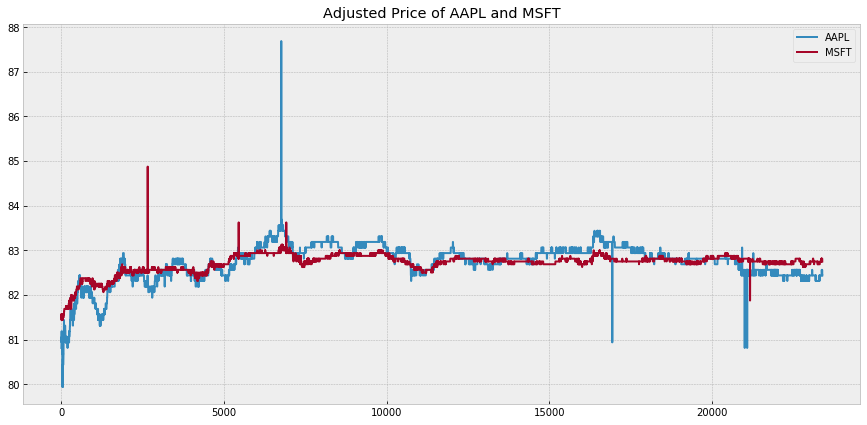

Plot z-score and trading signal of price ratio of AAPL and MSFT


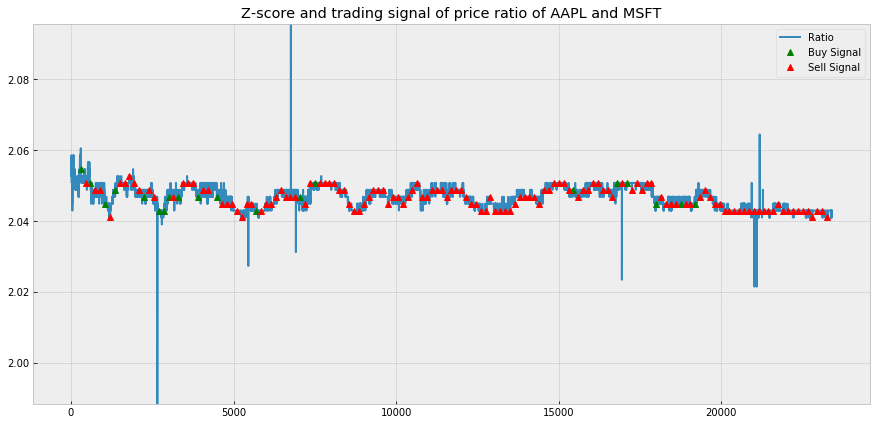

Trading signal of AAPL and MSFT for learning-based pair trading


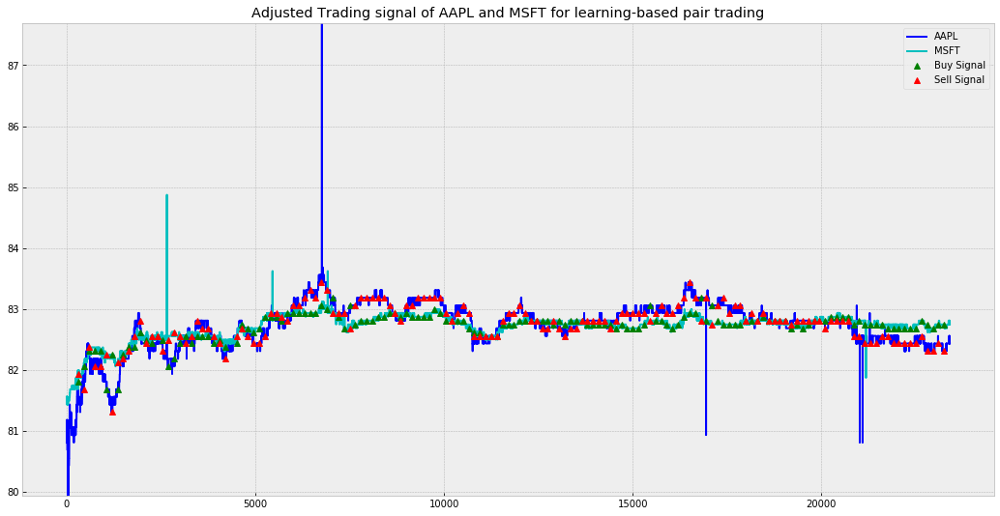

[Day 5]
v_test shape for day 5 : (154, 29, 299)
v_test shape for day 5 : (154, 29, 299)
v_test shape for day 5 : (154, 29, 299)
Predict Result....
Random pick time step :  [  2  14  17  24  25  27  32  40  45  46  60  63  74  77  79  86  96  98
 100 114 116 122 130 134 140 142 144 152 157 158 162 163 164 170 177 179
 184 186 194 195 198 209 210 211 212 218 219 224 230 231 238 240 243 250
 253 255 257 259 278 280 281 283 290 297]
Random pick time step :  [  4   5   6   7  12  14  15  26  27  35  40  51  52  54  55  56  62  65
  77  82  83  87  89  91  92  93  96 101 102 113 118 119 121 129 133 147
 149 158 170 178 191 196 201 202 204 222 225 226 232 238 239 241 242 245
 250 255 266 279 287 290 292 294 297 298]
Random pick time step :  [  3   5   7   9  14  23  26  32  49  51  55  64  67  85  86  93  94 101
 104 109 111 113 116 118 120 125 127 131 133 134 148 149 159 170 173 175
 176 178 179 180 182 183 186 189 199 203 206 208 211 212 214 218 221 224
 231 243 244 249 251 253 269 275 284 

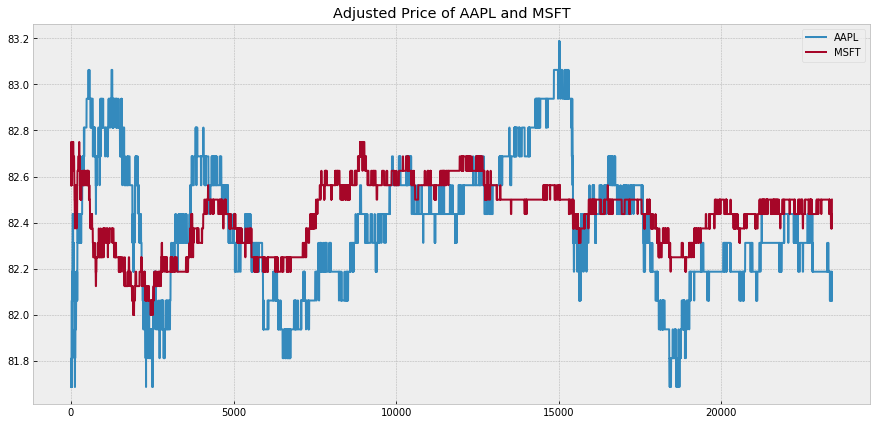

Plot z-score and trading signal of price ratio of AAPL and MSFT


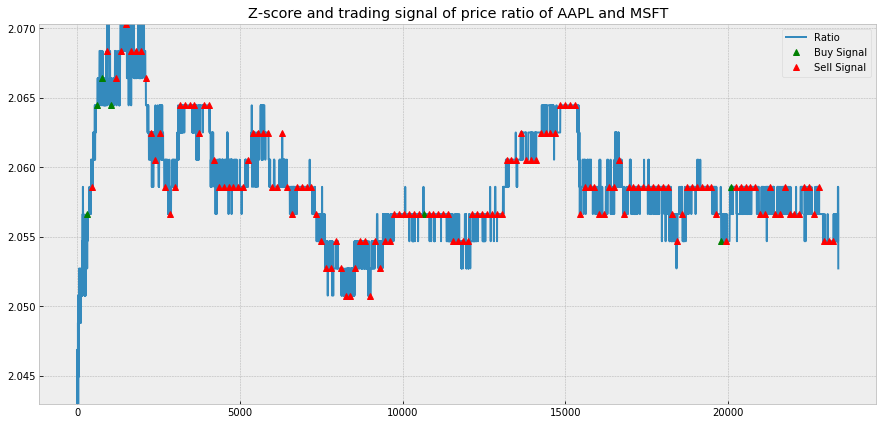

Trading signal of AAPL and MSFT for learning-based pair trading


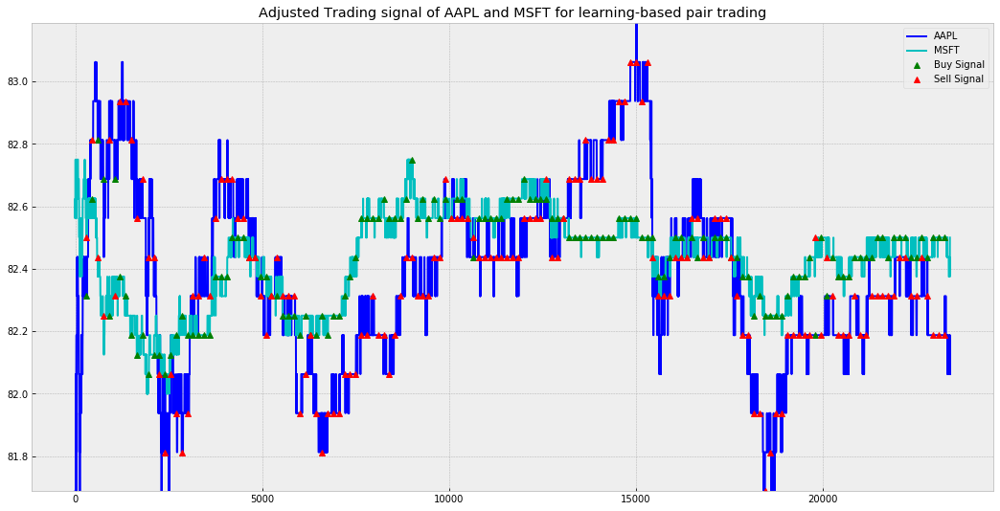

[Day 6]
v_test shape for day 6 : (154, 29, 299)
v_test shape for day 6 : (154, 29, 299)
v_test shape for day 6 : (154, 29, 299)
Predict Result....
Random pick time step :  [  9  11  13  14  17  20  23  30  32  36  37  38  49  51  57  70  73  74
  85  88  96 101 103 105 107 110 117 131 140 144 165 173 174 175 181 185
 190 195 203 209 215 230 231 235 239 240 241 243 244 245 246 249 252 260
 262 267 271 276 279 280 281 282 295 297]
Random pick time step :  [  5  11  14  18  19  22  26  27  44  48  51  53  58  70  76  87  96  98
 101 108 111 119 122 129 134 137 138 139 144 145 147 167 174 181 182 183
 187 192 196 198 204 207 220 231 235 236 239 245 247 255 257 258 259 260
 264 265 269 271 283 286 289 290 293 298]
Random pick time step :  [  9  11  16  20  21  26  28  35  39  41  42  47  61  65  69  73  77  78
  82  83  85  87  89  94  96 105 116 118 121 129 130 135 141 143 145 147
 148 152 154 157 161 173 175 180 182 189 190 192 195 212 217 219 221 232
 237 247 263 265 266 277 291 292 293 

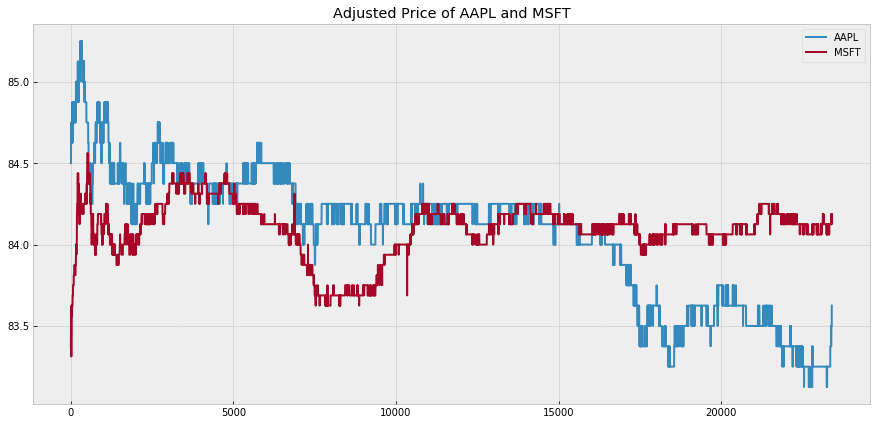

Plot z-score and trading signal of price ratio of AAPL and MSFT


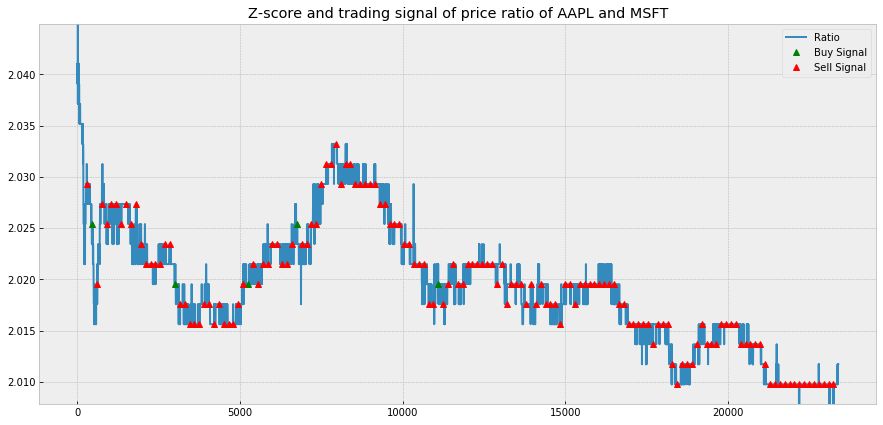

Trading signal of AAPL and MSFT for learning-based pair trading


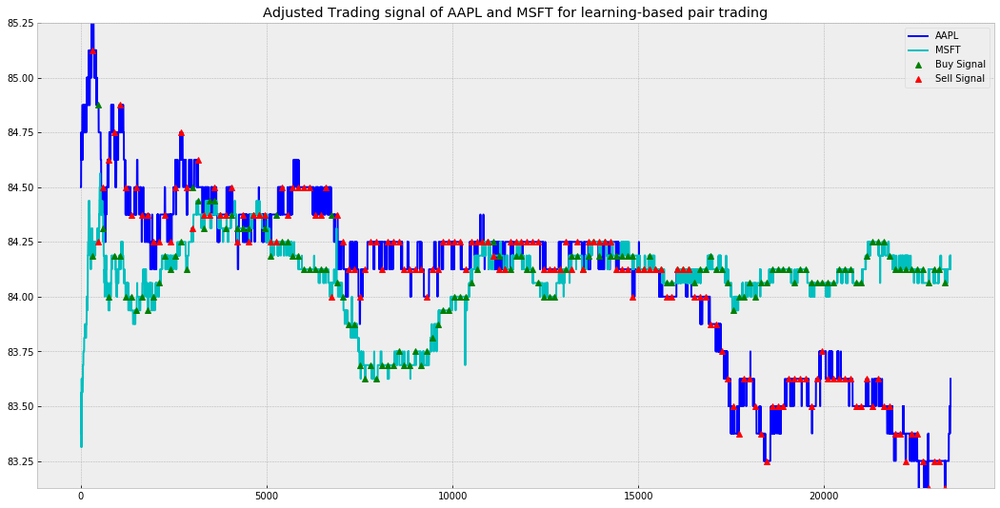

[Day 7]
v_test shape for day 7 : (154, 29, 299)
v_test shape for day 7 : (154, 29, 299)
v_test shape for day 7 : (154, 29, 299)
Predict Result....
Random pick time step :  [  4  10  12  21  24  44  46  53  76  79  83  86  87  89  92  94  95  99
 101 107 108 115 118 119 122 130 132 136 137 151 154 165 172 178 182 186
 188 197 201 209 211 215 234 243 244 247 248 250 253 256 263 265 267 270
 271 273 274 275 277 281 283 292 294 298]
Random pick time step :  [  1   2  10  13  24  28  29  33  34  39  41  45  48  66  72  79  83  89
  93  95  97 101 105 111 112 113 114 118 123 124 134 135 137 144 145 156
 157 165 171 187 190 191 198 200 204 205 209 222 223 225 232 236 237 239
 246 247 252 261 268 270 281 283 293 296]
Random pick time step :  [  4  20  30  32  33  34  36  43  48  52  56  68  80  85  91  94  95  97
  99 108 109 110 117 136 138 141 150 151 158 160 166 172 180 181 184 186
 190 194 196 200 209 211 219 227 228 230 233 237 246 256 257 259 261 262
 264 268 270 274 276 281 282 285 290 

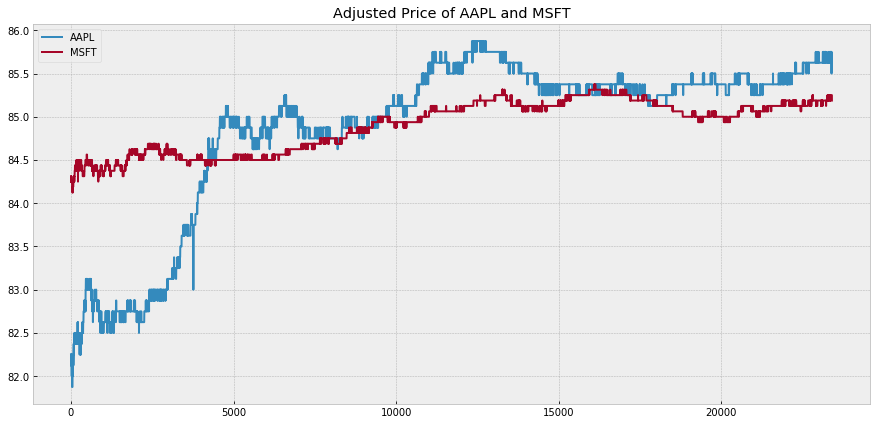

Plot z-score and trading signal of price ratio of AAPL and MSFT


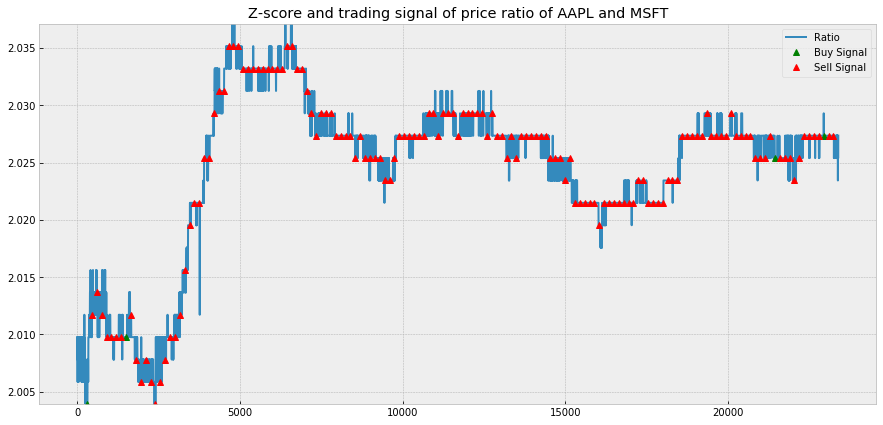

Trading signal of AAPL and MSFT for learning-based pair trading


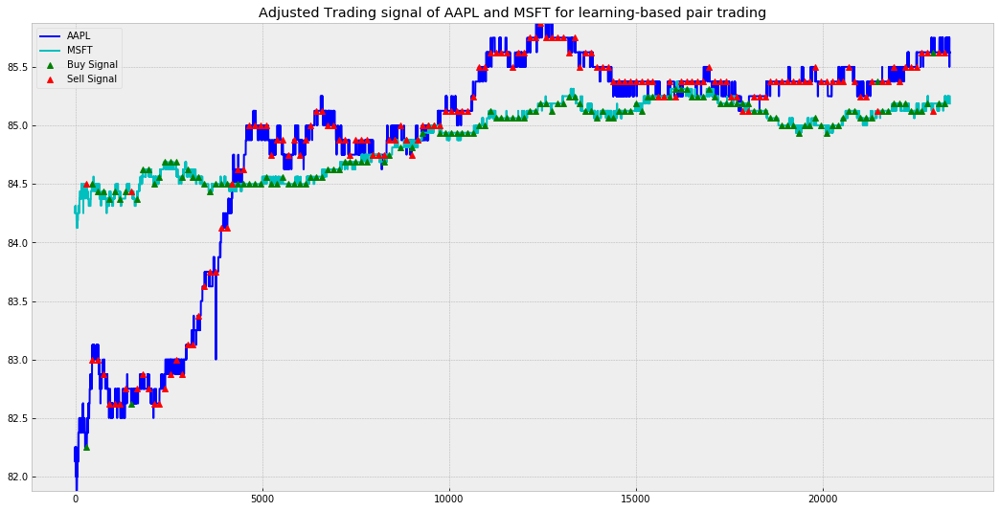

[Day 8]
v_test shape for day 8 : (154, 29, 299)
v_test shape for day 8 : (154, 29, 299)
v_test shape for day 8 : (154, 29, 299)
Predict Result....
Random pick time step :  [  1   2   3   5   9  12  13  18  20  28  33  34  36  48  56  60  61  68
  83  89  90  91  92  95 110 115 122 123 130 131 132 133 141 144 145 151
 152 159 164 165 176 179 191 194 195 197 198 205 210 211 218 223 226 236
 237 238 246 250 255 257 273 274 281 282]
Random pick time step :  [  1  12  17  30  32  35  44  45  52  63  68  69  70  75  76  86  88  91
 100 101 108 113 115 120 121 127 138 140 145 149 155 159 162 170 172 173
 175 181 184 187 188 195 196 200 202 211 214 220 226 230 231 233 237 248
 253 256 265 266 275 289 290 292 294 297]
Random pick time step :  [  1   4  10  11  14  16  22  29  31  35  38  44  58  65  72  83  88  89
  94  95  97  98  99 108 109 113 114 117 133 134 135 140 141 144 149 155
 158 164 166 174 181 186 188 190 192 195 199 207 209 218 220 227 235 238
 248 250 261 263 267 268 276 277 281 

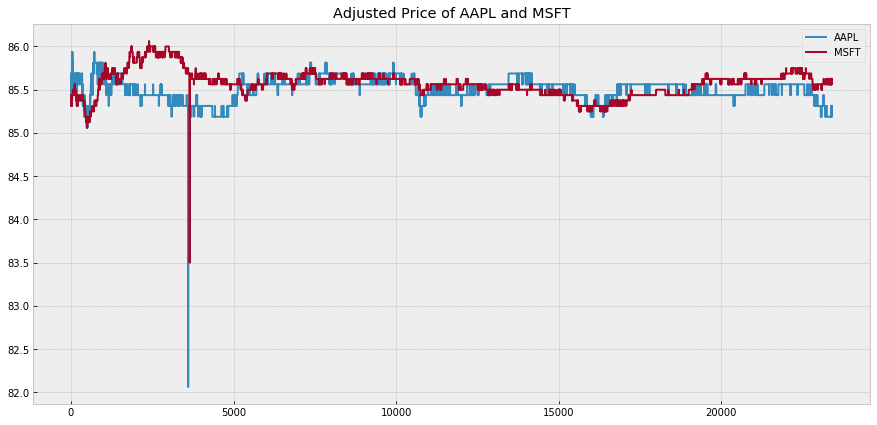

Plot z-score and trading signal of price ratio of AAPL and MSFT


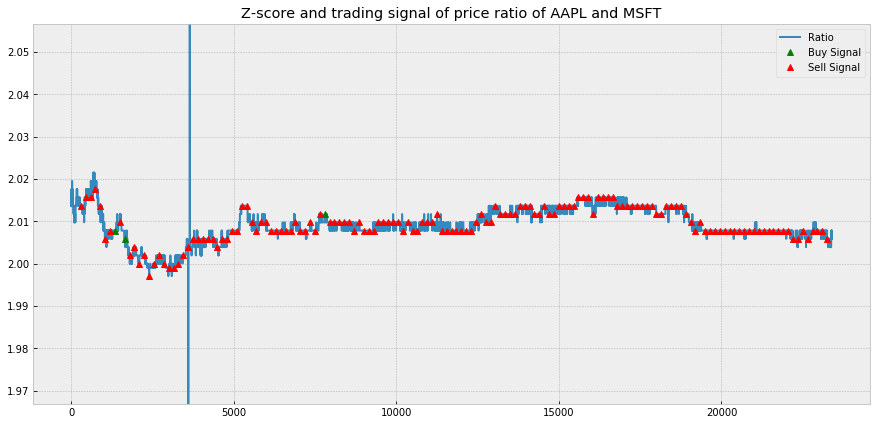

Trading signal of AAPL and MSFT for learning-based pair trading


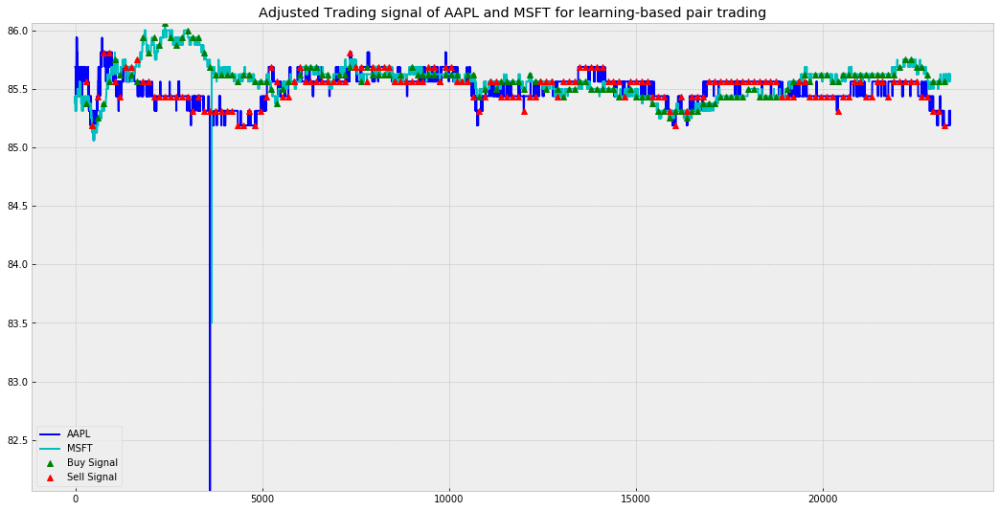

[Day 9]
v_test shape for day 9 : (154, 29, 299)
v_test shape for day 9 : (154, 29, 299)
v_test shape for day 9 : (154, 29, 299)
Predict Result....
Random pick time step :  [  4   9  15  17  23  28  30  32  34  35  42  43  49  63  67  68  78  79
  81  82  85  90  91  96 100 108 115 121 122 124 130 138 144 147 159 165
 168 170 171 183 190 192 198 199 203 210 211 212 216 219 224 230 231 233
 234 237 244 249 255 256 277 279 280 297]
Random pick time step :  [ 12  19  20  21  22  25  29  39  42  47  52  61  63  71  72  74  84  85
  94  96 100 111 113 117 120 124 127 139 145 146 149 152 154 156 159 162
 164 168 169 173 175 179 183 185 186 194 203 206 224 226 236 243 244 246
 262 268 270 271 280 285 286 291 292 293]
Random pick time step :  [  1  10  12  13  26  32  33  36  42  46  47  51  52  62  63  66  80  87
 107 115 123 131 132 133 134 139 140 147 148 149 151 156 161 171 177 178
 183 186 187 193 194 195 200 218 220 221 222 233 234 242 246 247 251 252
 253 256 257 269 270 274 284 287 294 

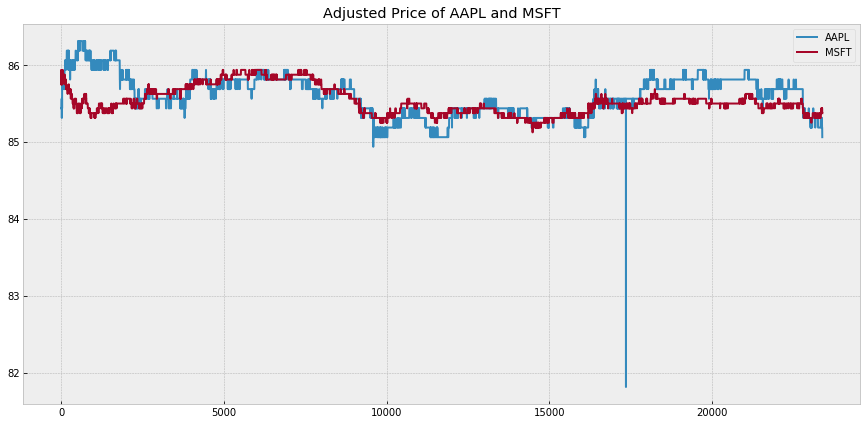

Plot z-score and trading signal of price ratio of AAPL and MSFT


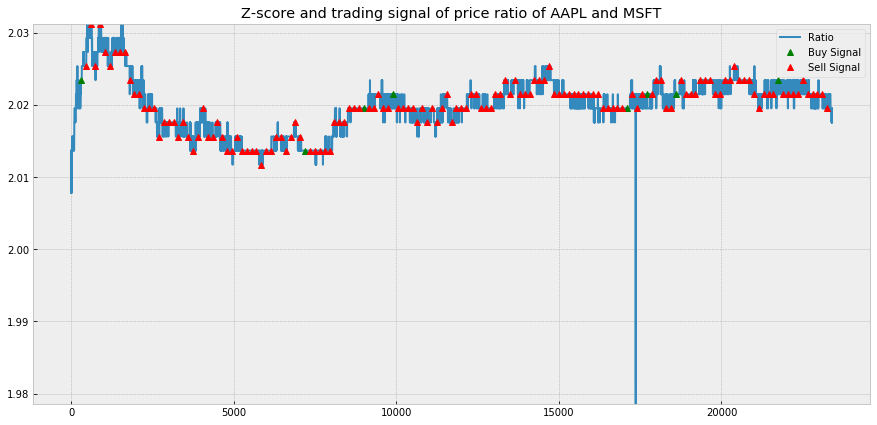

Trading signal of AAPL and MSFT for learning-based pair trading


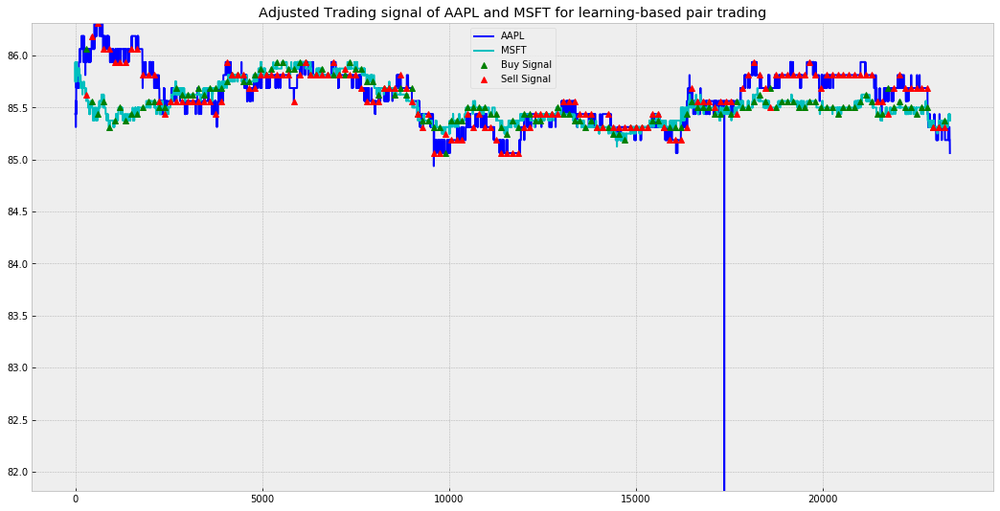

[Day 10]
v_test shape for day 10 : (154, 29, 299)
v_test shape for day 10 : (154, 29, 299)
v_test shape for day 10 : (154, 29, 299)
Predict Result....
Random pick time step :  [ 11  15  16  25  30  36  39  41  45  54  59  72  79  92  95  97 106 113
 119 121 123 127 138 143 144 148 149 151 163 164 167 168 170 171 176 179
 181 187 189 190 191 197 203 212 213 224 226 227 228 232 236 242 252 255
 260 263 273 282 283 288 290 291 293 297]
Random pick time step :  [  2   6   7  14  16  17  21  22  31  35  38  42  48  49  50  51  53  61
  63  95 100 102 105 107 114 128 137 138 140 141 143 150 151 152 156 160
 168 169 171 173 180 181 194 195 196 198 205 210 213 218 227 229 235 237
 243 248 249 255 256 262 268 270 276 295]
Random pick time step :  [  1   3   4  11  13  15  32  45  51  55  58  60  67  83  84  86  87  94
  95 101 108 110 113 129 132 133 134 139 140 143 145 149 162 166 169 170
 173 186 197 206 207 211 214 219 220 226 230 232 238 243 251 257 261 264
 265 270 271 276 281 282 285 292 

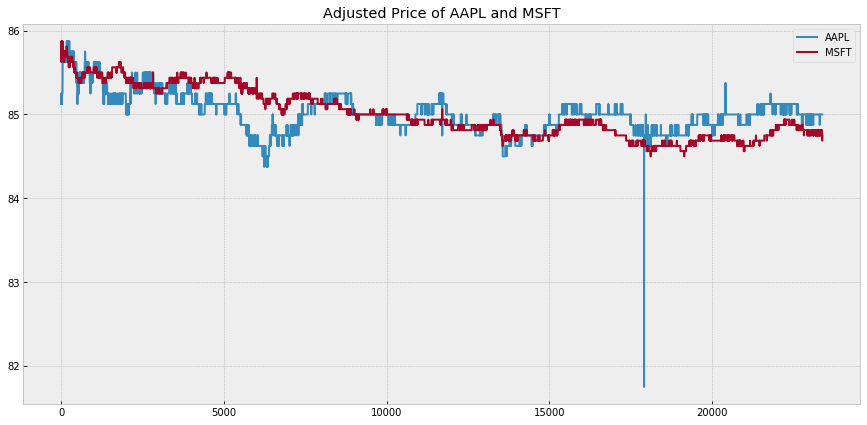

Plot z-score and trading signal of price ratio of AAPL and MSFT


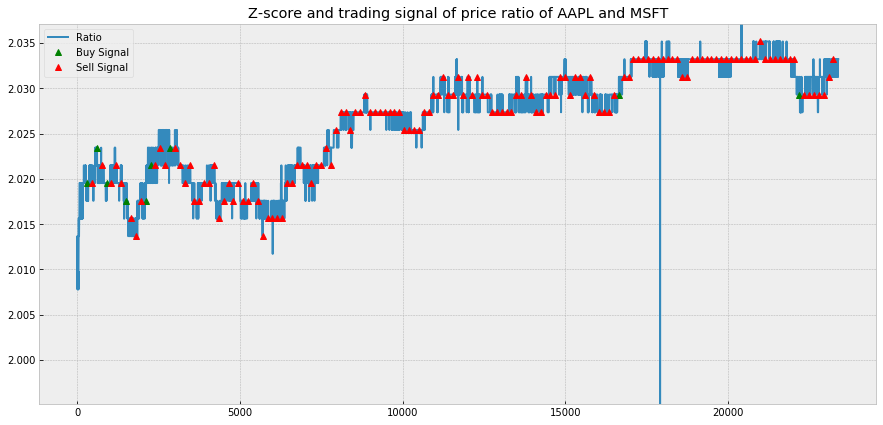

Trading signal of AAPL and MSFT for learning-based pair trading


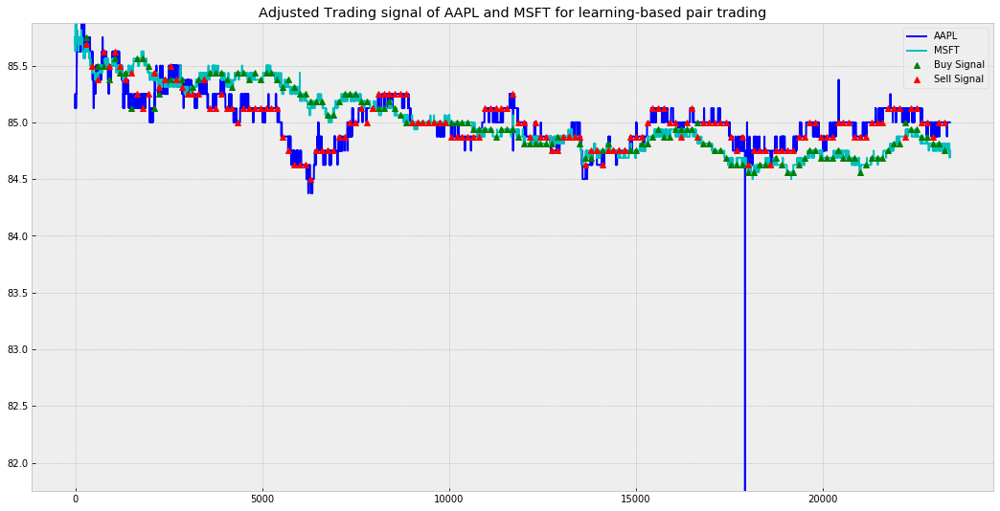

[Day 11]
v_test shape for day 11 : (154, 29, 299)
v_test shape for day 11 : (154, 29, 299)
v_test shape for day 11 : (154, 29, 299)
Predict Result....
Random pick time step :  [  0   3   7  10  11  27  29  30  31  39  62  63  65  68  86 101 103 107
 109 110 119 120 123 126 129 139 145 148 149 150 151 156 157 161 162 166
 169 170 173 174 176 185 186 188 189 194 196 204 217 218 229 231 232 237
 242 243 261 262 267 273 275 277 286 290]
Random pick time step :  [ 11  14  21  31  32  34  40  43  50  52  53  55  56  58  61  66  75  79
  87  91  98  99 108 109 112 114 120 123 130 131 137 153 154 166 172 175
 176 178 179 182 186 195 198 208 215 217 239 240 241 243 254 255 258 262
 266 273 275 276 280 283 285 286 291 295]
Random pick time step :  [  2   4  19  20  21  25  26  32  42  43  44  51  52  56  57  62  71  74
  75  82  84  91  94  95  99 101 118 124 127 131 132 133 143 147 148 151
 152 156 159 163 174 177 178 179 191 197 201 202 207 214 218 238 243 247
 267 269 272 275 276 278 286 288 

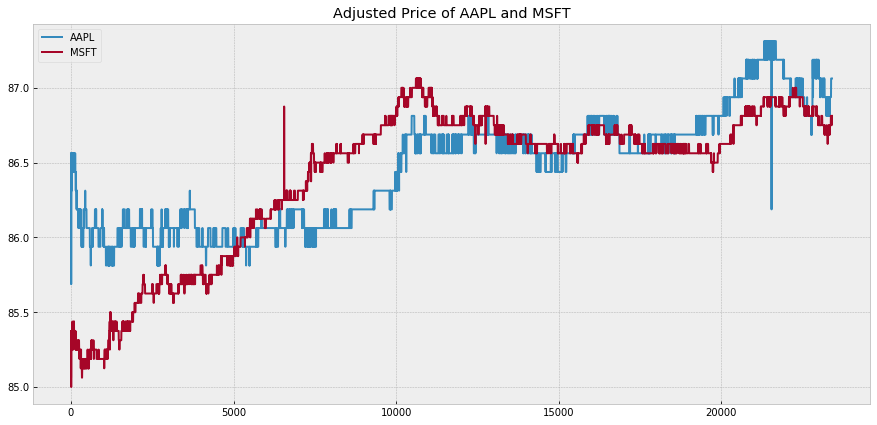

Plot z-score and trading signal of price ratio of AAPL and MSFT


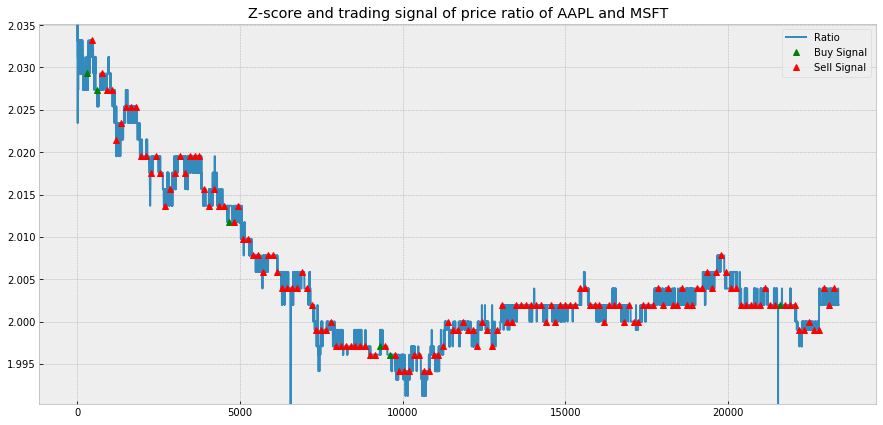

Trading signal of AAPL and MSFT for learning-based pair trading


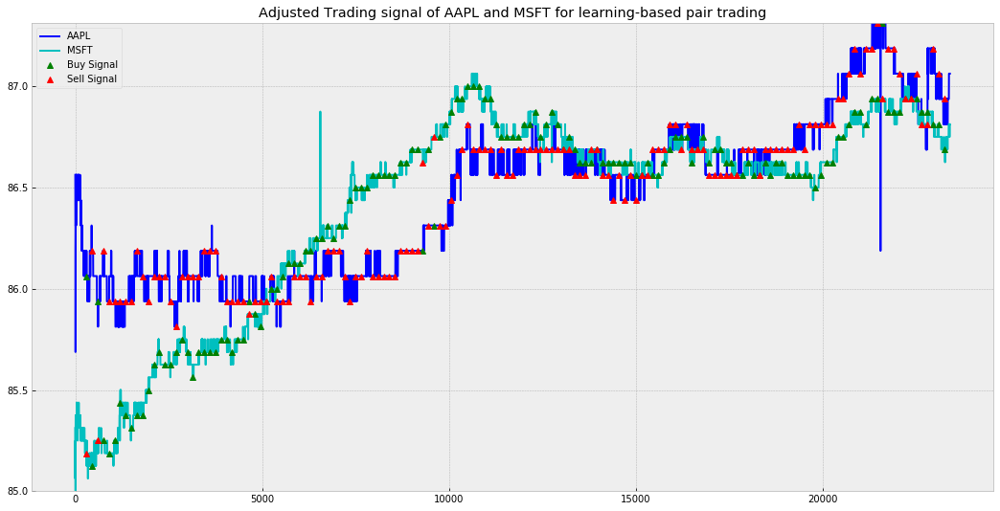

[Day 12]
v_test shape for day 12 : (154, 29, 299)
v_test shape for day 12 : (154, 29, 299)
v_test shape for day 12 : (154, 29, 299)
Predict Result....
Random pick time step :  [  1  13  14  15  18  20  29  32  33  44  45  48  55  62  63  66  73  80
  82  87  91 102 105 113 117 119 129 131 135 136 139 142 151 156 162 166
 169 172 173 176 181 184 191 206 211 213 220 221 222 224 232 235 243 248
 251 256 257 265 268 276 280 282 294 295]
Random pick time step :  [  9  13  14  18  23  25  28  29  35  40  41  45  54  59  63  64  67  71
  72  73  76  87  90 106 107 113 118 119 134 138 143 158 164 176 177 182
 185 193 198 204 213 217 220 221 231 238 242 243 249 257 261 262 264 265
 267 275 279 281 283 285 288 293 297 298]
Random pick time step :  [ 19  23  35  36  38  43  44  46  49  51  52  57  59  63  67  69  75  77
  79  80  86  88  92  98 108 110 119 124 126 136 143 145 146 147 153 155
 156 160 166 167 168 172 175 177 182 191 200 204 224 227 232 234 237 238
 241 243 249 251 255 268 282 283 

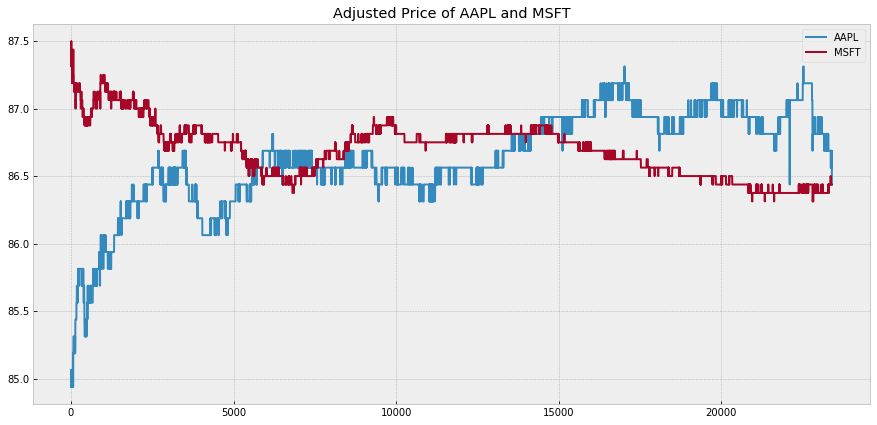

Plot z-score and trading signal of price ratio of AAPL and MSFT


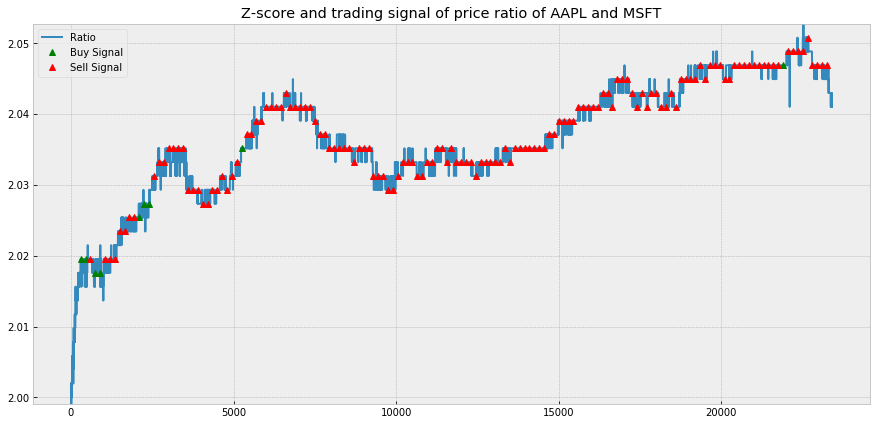

Trading signal of AAPL and MSFT for learning-based pair trading


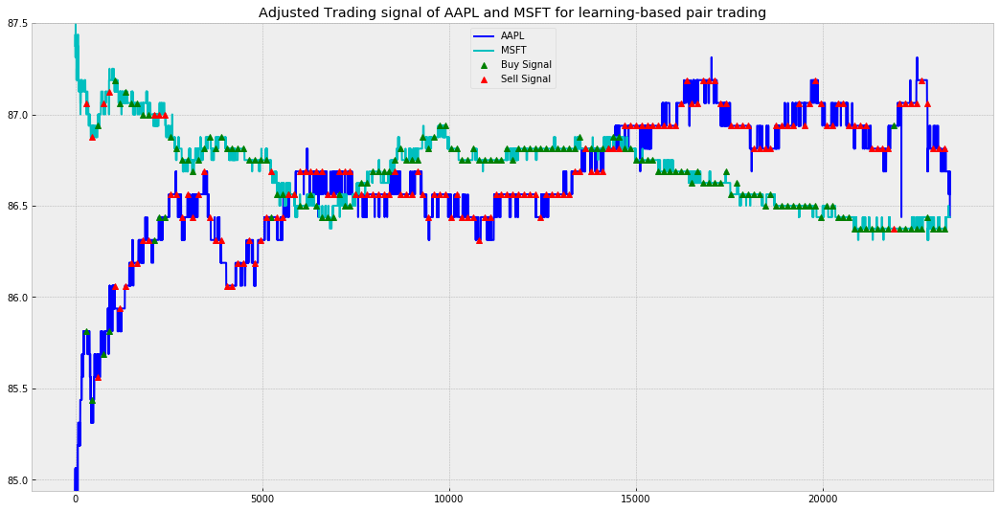

[Day 13]
v_test shape for day 13 : (154, 29, 299)
v_test shape for day 13 : (154, 29, 299)
v_test shape for day 13 : (154, 29, 299)
Predict Result....
Random pick time step :  [  0   3  12  18  22  24  25  26  31  35  37  41  42  45  46  48  60  63
  66  73  78  82  86  94  97 100 103 106 114 119 122 126 127 128 135 139
 140 144 151 161 162 163 170 178 179 183 185 200 207 216 221 227 232 233
 236 238 246 249 252 254 278 280 283 294]
Random pick time step :  [  1   4   6   9  15  16  18  27  28  30  37  40  41  42  49  51  53  64
  69  73  77  78  85  91  92 100 118 119 125 131 133 139 143 155 164 165
 169 172 173 190 191 194 195 203 204 206 209 216 218 221 243 247 255 257
 258 259 260 263 269 272 278 288 292 297]
Random pick time step :  [ 11  13  14  17  18  22  23  27  28  31  32  35  44  56  57  58  63  68
  71  76  78  89  96 108 111 117 120 123 130 158 160 161 166 168 177 179
 186 188 189 201 203 205 208 210 214 217 227 228 229 234 239 241 242 246
 252 257 258 269 272 275 278 284 

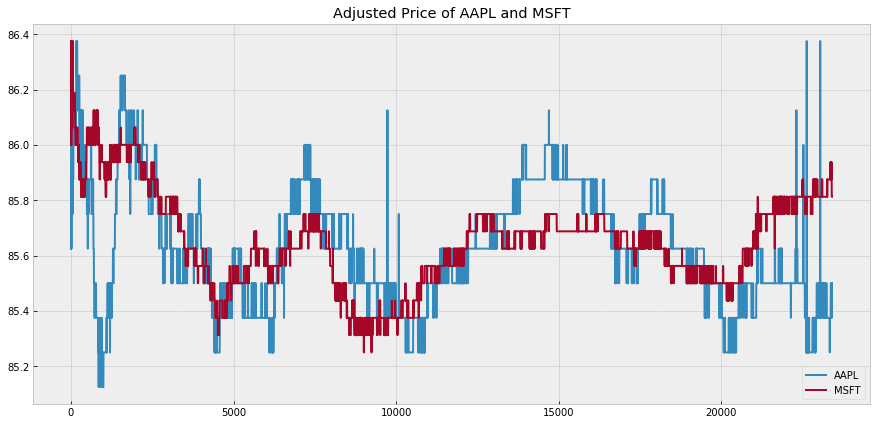

Plot z-score and trading signal of price ratio of AAPL and MSFT


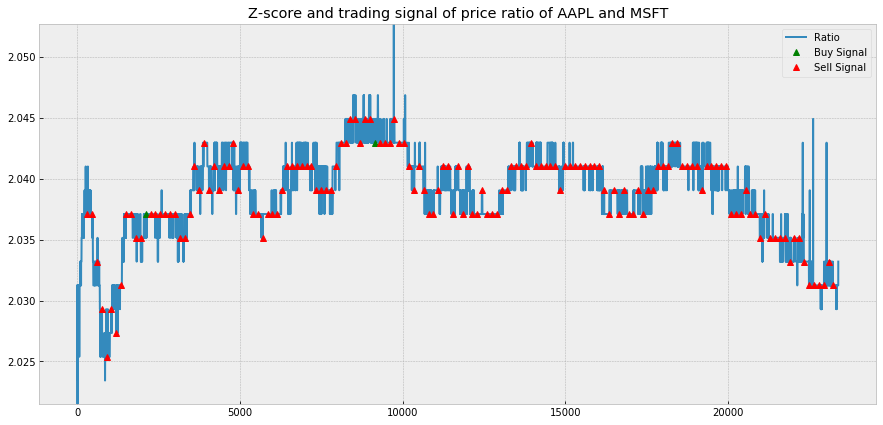

Trading signal of AAPL and MSFT for learning-based pair trading


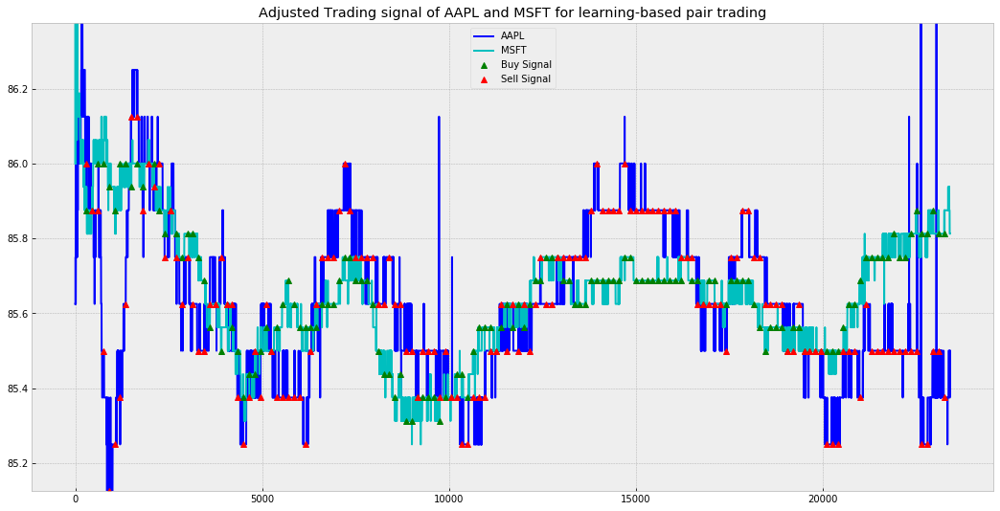

[Day 14]
v_test shape for day 14 : (154, 29, 299)
v_test shape for day 14 : (154, 29, 299)
v_test shape for day 14 : (154, 29, 299)
Predict Result....
Random pick time step :  [  0   2   3  12  14  16  17  20  23  25  26  30  32  45  53  71  79 102
 107 115 116 119 124 125 126 127 129 137 140 147 152 157 158 161 166 168
 170 177 187 190 191 194 195 196 200 202 206 208 211 216 217 227 230 231
 234 235 247 252 261 281 282 283 289 293]
Random pick time step :  [  0   3  11  14  16  18  19  21  23  25  31  38  49  54  58  62  63  66
  68  69  72  73  74  75  77  85  88 101 102 109 114 119 121 125 127 138
 139 142 145 153 155 157 163 164 180 184 189 193 199 207 220 228 231 232
 250 256 269 274 277 279 286 288 291 297]
Random pick time step :  [  2   9  15  18  19  20  24  28  32  40  43  45  63  71  74  80  84  88
  96 104 107 110 112 114 115 126 127 128 134 141 144 145 148 153 154 156
 159 163 164 169 171 180 181 201 209 211 220 221 227 234 236 240 244 247
 250 254 255 262 271 286 288 293 

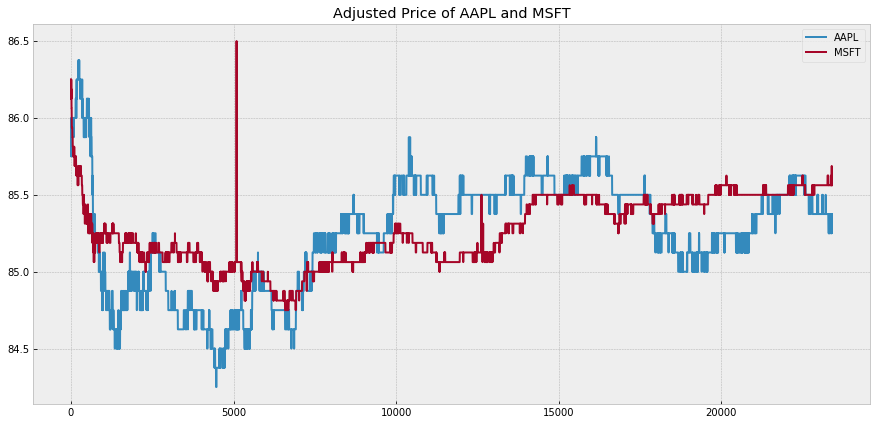

Plot z-score and trading signal of price ratio of AAPL and MSFT


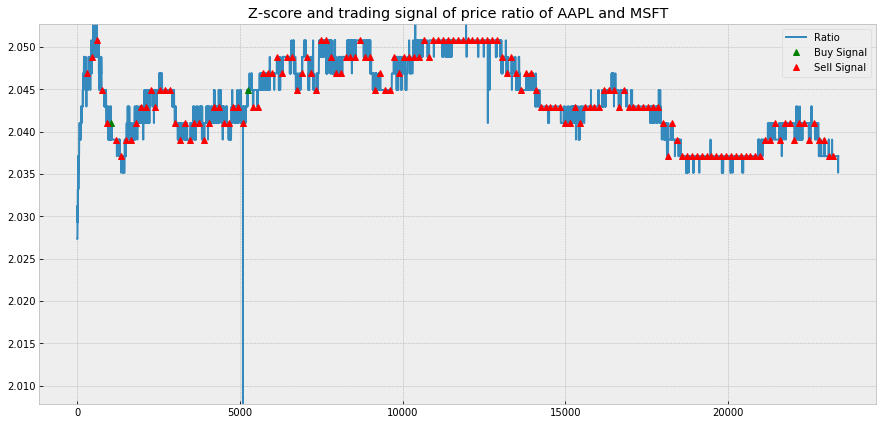

Trading signal of AAPL and MSFT for learning-based pair trading


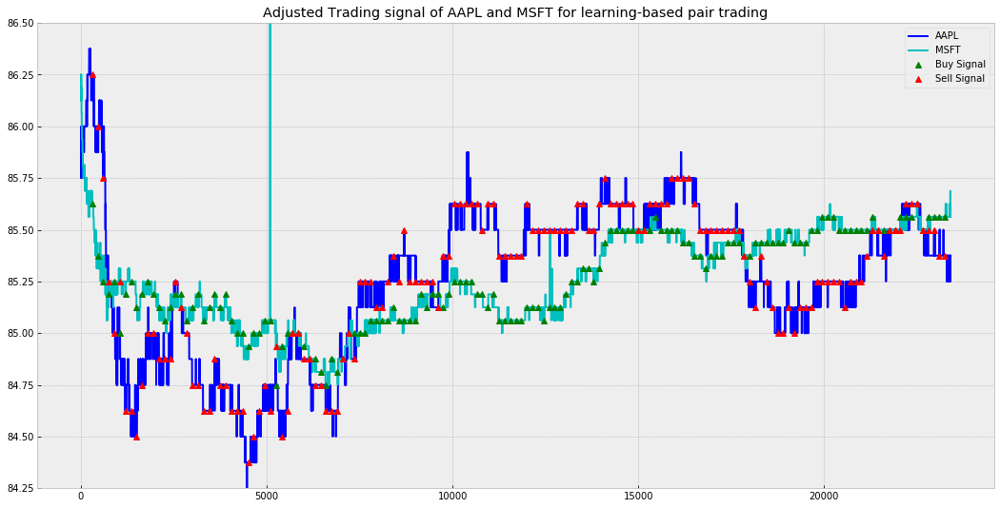

[Day 15]
v_test shape for day 15 : (154, 29, 299)
v_test shape for day 15 : (154, 29, 299)
v_test shape for day 15 : (154, 29, 299)
Predict Result....
Random pick time step :  [  0   3   6  13  19  22  24  41  42  52  70  73  78  87  89  96  97  99
 101 104 110 114 121 122 137 142 145 147 157 158 160 165 173 174 189 190
 193 199 206 212 217 220 233 237 245 246 253 254 255 257 259 260 262 265
 266 270 276 277 280 281 284 285 292 295]
Random pick time step :  [  1  11  13  14  15  18  21  23  25  27  28  32  34  36  38  39  48  49
  53  63  78  82  84  86 101 102 112 115 117 139 146 148 151 153 159 160
 167 168 172 176 178 187 201 204 214 217 223 230 236 239 243 244 246 250
 251 252 267 274 275 278 281 289 290 293]
Random pick time step :  [ 17  28  45  48  66  74  75  78  86  87  90  91  93  97  98 102 103 109
 110 121 122 124 125 126 133 135 143 145 147 148 150 153 154 160 165 167
 181 187 188 189 196 198 206 215 216 217 221 223 225 226 233 234 239 244
 246 260 261 264 272 281 286 287 

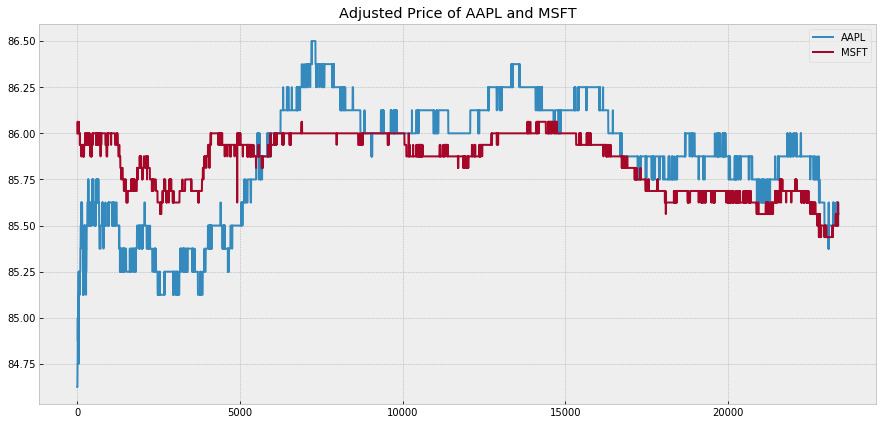

Plot z-score and trading signal of price ratio of AAPL and MSFT


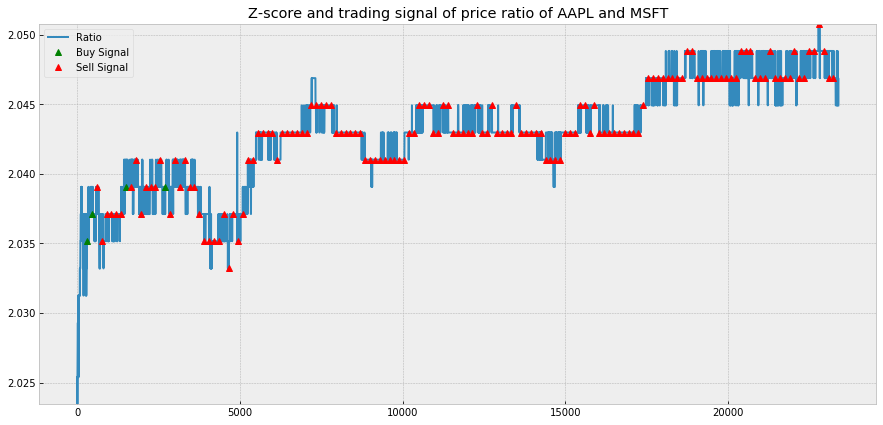

Trading signal of AAPL and MSFT for learning-based pair trading


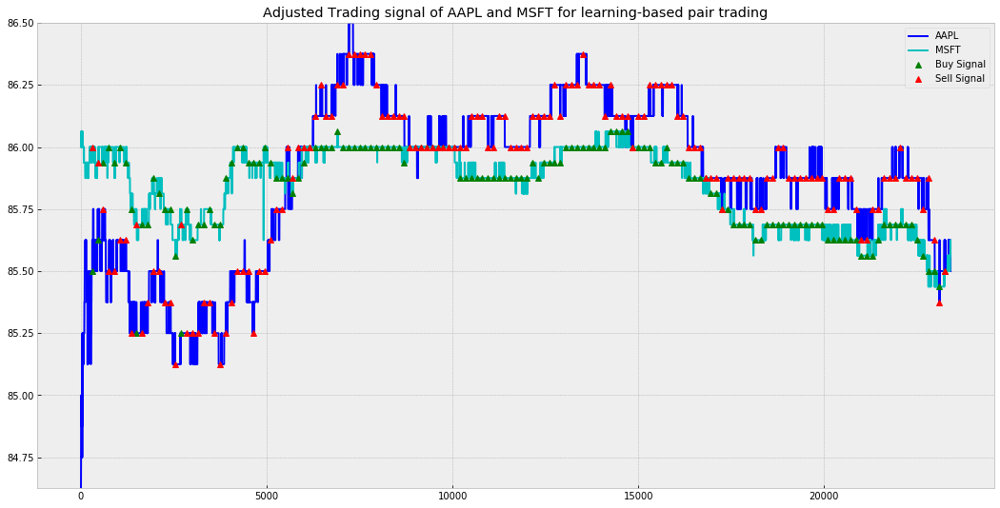

[Day 16]
v_test shape for day 16 : (154, 29, 299)
v_test shape for day 16 : (154, 29, 299)
v_test shape for day 16 : (154, 29, 299)
Predict Result....
Random pick time step :  [  1   2   4  13  17  22  24  27  39  42  48  56  59  62  66  72  77  78
  79  82  90  93 107 111 113 117 122 128 130 145 147 148 153 159 161 162
 167 170 176 179 188 190 193 196 200 203 206 211 212 216 222 228 235 236
 238 239 242 245 247 251 266 269 283 293]
Random pick time step :  [  1   5  20  21  24  30  34  41  47  50  62  71  75  76  78  80  84  88
  92  94  96 104 110 113 115 116 122 123 142 144 149 158 161 164 166 169
 171 176 184 185 192 196 200 208 209 214 217 220 232 233 234 236 243 250
 265 269 271 274 277 279 286 293 296 298]
Random pick time step :  [  3   4   7  14  21  22  26  27  32  34  38  40  41  51  57  59  60  67
  70  72  76  79  82  84  86  87  92 100 103 110 120 121 122 126 133 137
 140 142 153 155 172 174 175 179 180 181 184 191 192 195 210 212 216 223
 225 229 234 245 246 261 269 278 

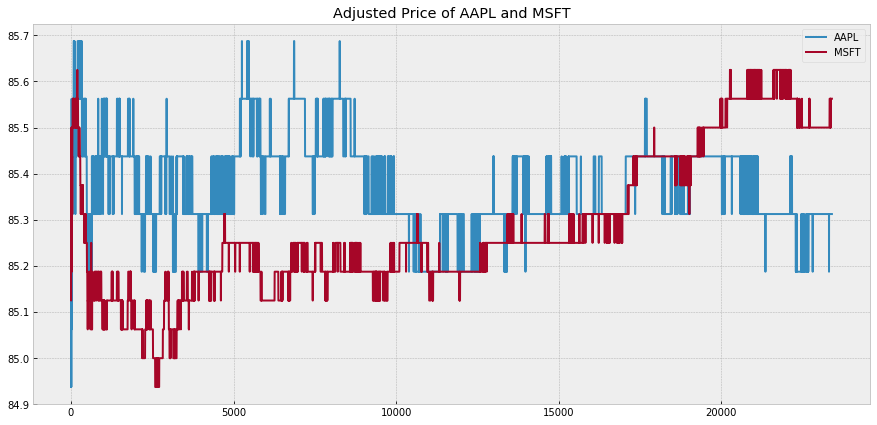

Plot z-score and trading signal of price ratio of AAPL and MSFT


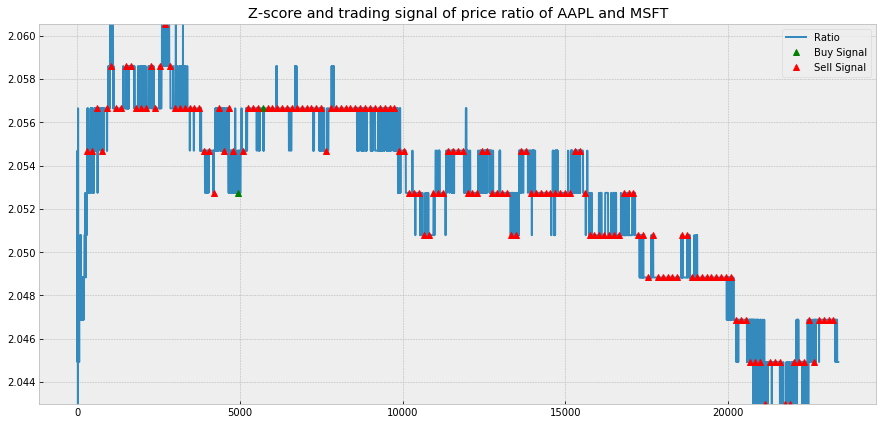

Trading signal of AAPL and MSFT for learning-based pair trading


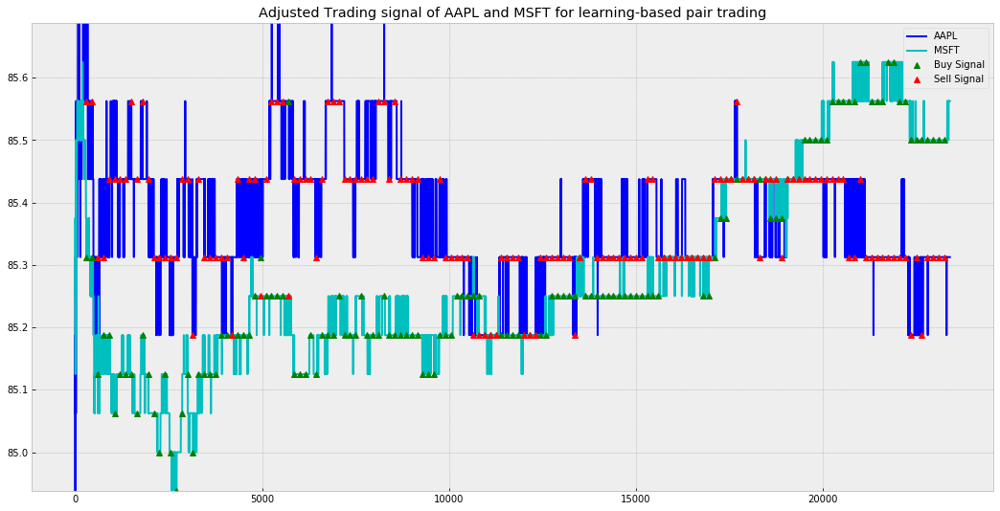

[Day 17]
v_test shape for day 17 : (154, 29, 299)
v_test shape for day 17 : (154, 29, 299)
v_test shape for day 17 : (154, 29, 299)
Predict Result....
Random pick time step :  [  2  33  34  39  41  53  55  61  64  65  71  73  76  77  84  85 101 108
 114 115 117 119 128 129 132 136 140 143 144 148 152 155 162 163 165 167
 168 169 174 176 177 178 180 182 184 194 195 197 199 202 221 223 224 235
 262 263 275 276 279 282 290 292 293 294]
Random pick time step :  [  2   6   7   9  10  14  15  17  20  25  27  36  47  56  67  68  76  79
  80  82  86  89  93  95 103 105 109 122 124 128 129 133 141 144 146 150
 180 183 186 187 191 200 201 203 208 214 226 229 234 235 244 245 248 249
 253 258 260 269 275 285 286 291 295 298]
Random pick time step :  [ 11  15  16  18  21  23  24  31  40  42  45  53  57  58  59  63  67  69
  76  84  85  87  89  92  93  98 102 105 107 109 116 125 126 134 140 162
 165 177 179 181 186 189 198 199 202 206 207 211 215 223 227 229 232 241
 248 254 257 265 272 274 283 286 

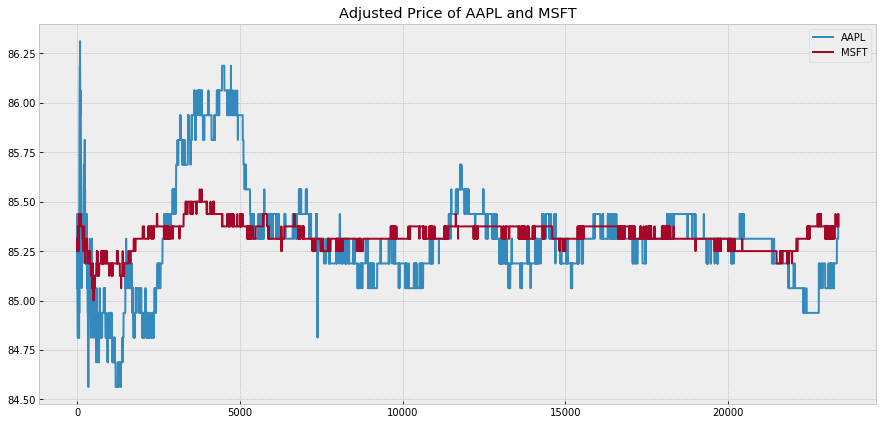

Plot z-score and trading signal of price ratio of AAPL and MSFT


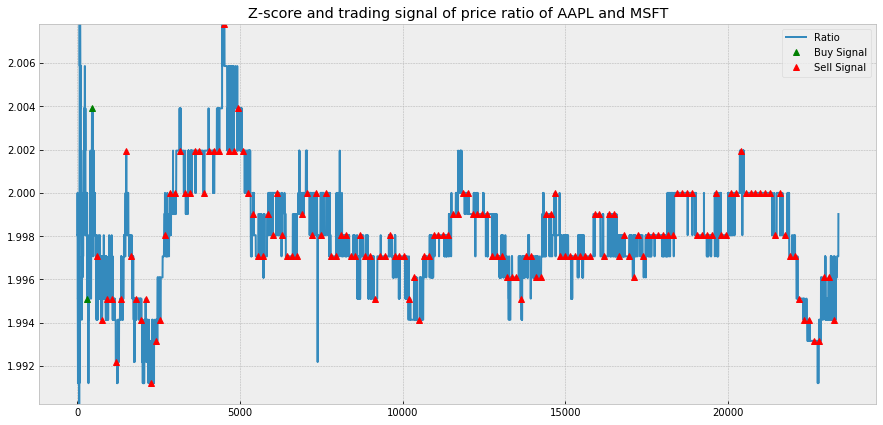

Trading signal of AAPL and MSFT for learning-based pair trading


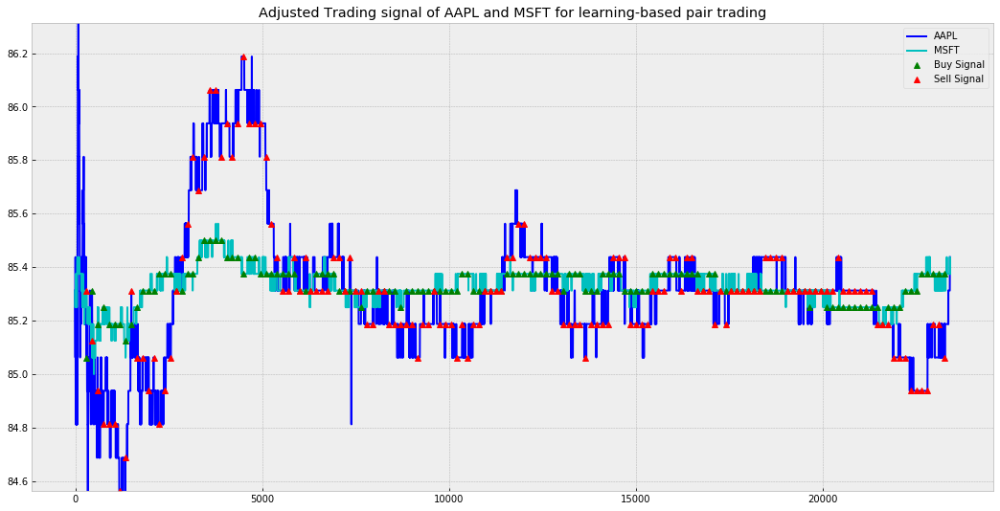

[Day 18]
v_test shape for day 18 : (154, 29, 299)
v_test shape for day 18 : (154, 29, 299)
v_test shape for day 18 : (154, 29, 299)
Predict Result....
Random pick time step :  [  6   8  10  11  19  31  34  38  39  40  41  43  45  54  57  65  68  72
  73  74  78  82  87  91 100 105 108 109 119 120 122 123 124 128 133 142
 149 152 158 160 161 168 191 195 197 205 211 214 218 227 231 233 238 256
 257 262 263 265 275 277 278 280 281 286]
Random pick time step :  [ 15  16  18  22  27  31  48  49  53  60  74  85  86  89  94 102 103 107
 110 113 116 125 126 133 134 146 148 151 152 157 163 170 172 179 185 186
 189 190 199 205 212 213 214 218 219 220 227 230 231 234 238 242 244 245
 248 251 253 254 265 272 279 282 290 297]
Random pick time step :  [  5   6  15  16  17  18  21  23  29  35  42  46  50  52  58  60  65  66
  72  81  82  85 103 104 106 116 117 118 119 131 149 153 157 158 159 177
 182 184 198 199 202 203 214 215 216 220 226 228 229 239 240 258 261 262
 269 273 275 283 284 287 289 290 

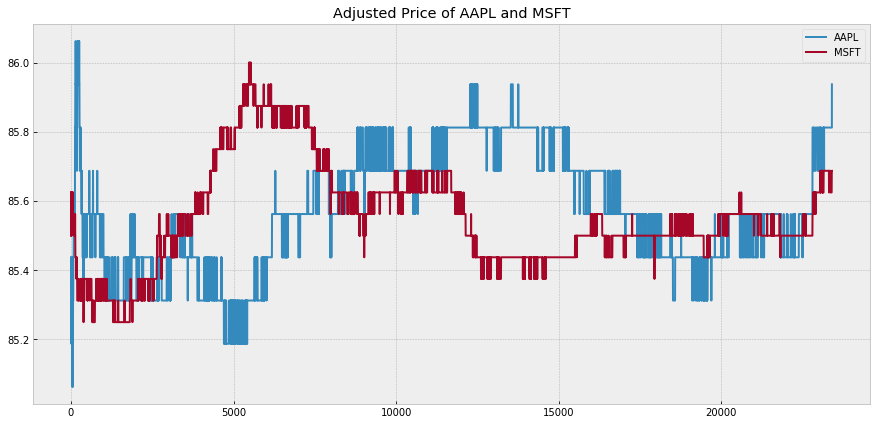

Plot z-score and trading signal of price ratio of AAPL and MSFT


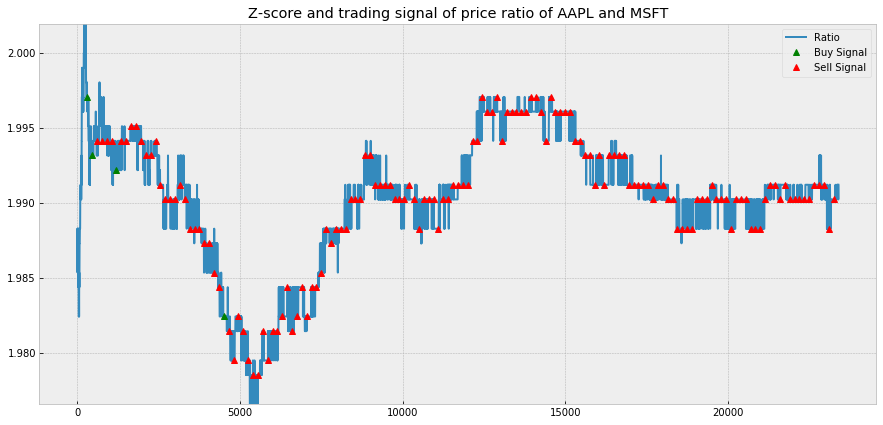

Trading signal of AAPL and MSFT for learning-based pair trading


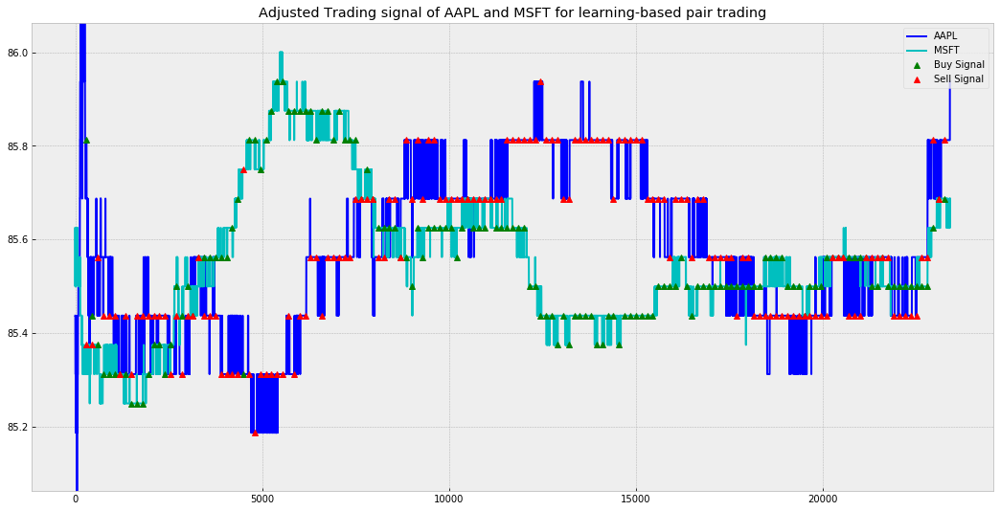

[Day 19]
v_test shape for day 19 : (154, 29, 299)
v_test shape for day 19 : (154, 29, 299)
v_test shape for day 19 : (154, 29, 299)
Predict Result....
Random pick time step :  [  4   7  13  18  20  22  24  28  36  43  45  47  52  54  59  72  75  79
  84  85  94  99 112 115 116 124 131 132 136 137 142 150 152 163 166 170
 174 175 180 181 185 190 193 194 201 206 208 213 215 217 233 234 239 246
 252 253 256 264 275 279 284 286 288 291]
Random pick time step :  [ 12  14  20  32  37  38  43  50  56  63  65  81  82  90  93  94  98  99
 106 108 117 124 125 127 136 144 145 147 150 157 159 168 173 174 175 178
 183 186 191 192 193 198 203 207 210 211 218 219 226 238 241 245 252 259
 264 267 268 273 275 280 284 288 294 298]
Random pick time step :  [ 10  14  16  18  26  31  39  40  47  48  51  58  59  61  62  63  70  73
  75  81  86  89  92  99 102 105 114 116 130 131 149 150 151 153 154 159
 166 169 174 180 185 191 195 198 206 210 227 229 238 241 245 246 248 265
 266 267 271 272 273 286 293 294 

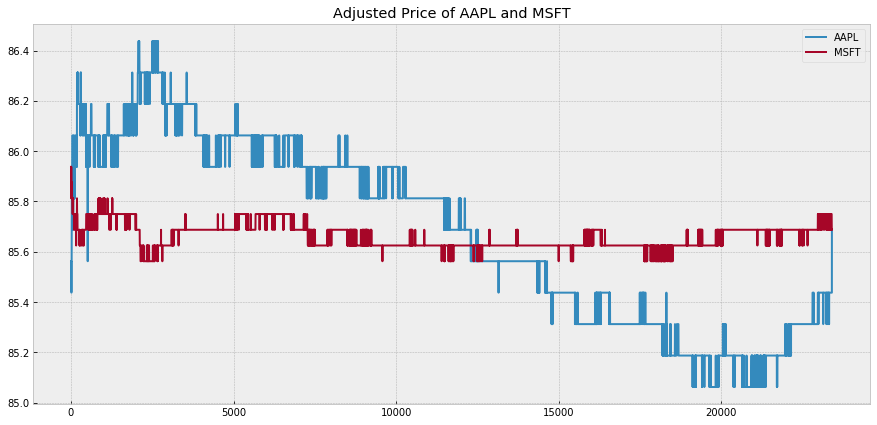

Plot z-score and trading signal of price ratio of AAPL and MSFT


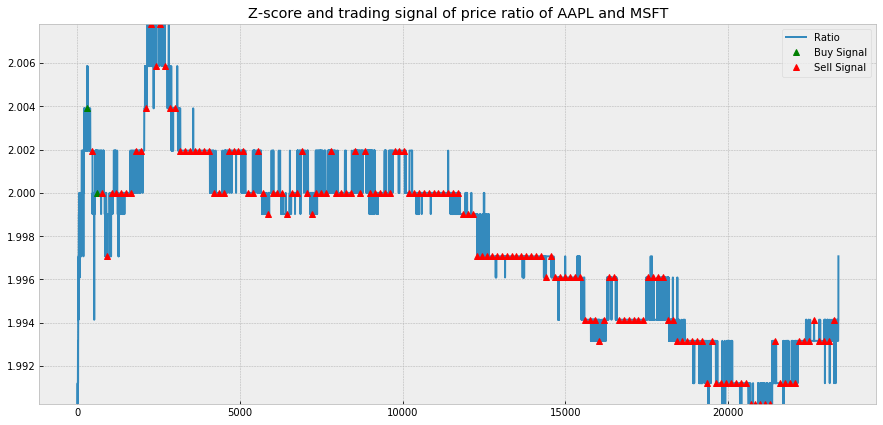

Trading signal of AAPL and MSFT for learning-based pair trading


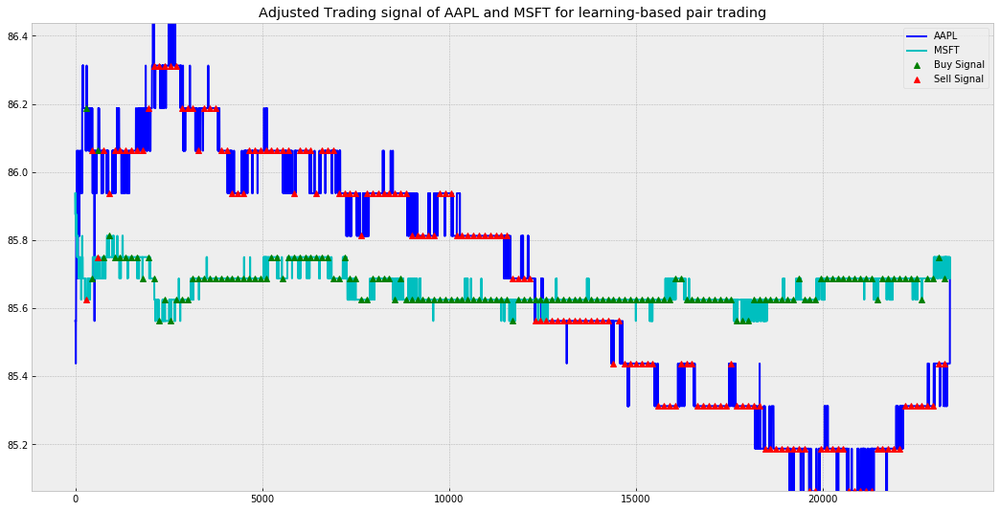

[Day 20]
v_test shape for day 20 : (154, 29, 299)
v_test shape for day 20 : (154, 29, 299)
v_test shape for day 20 : (154, 29, 299)
Predict Result....
Random pick time step :  [  4   6   8  12  14  15  34  35  40  61  64  65  74  75  78  94  97 101
 105 106 108 110 113 125 131 138 143 144 147 155 158 161 166 180 182 186
 200 207 211 212 213 214 216 232 235 236 237 238 242 244 251 261 266 268
 271 274 277 280 282 284 286 291 294 297]
Random pick time step :  [  1   5   8  10  15  16  20  22  24  28  33  36  37  42  47  53  55  56
  57  65  66  71  72  73  91  94  95 100 106 111 117 138 141 143 171 172
 176 177 180 190 196 197 200 202 205 213 214 220 223 228 229 233 235 238
 239 267 271 276 282 283 288 291 292 296]
Random pick time step :  [  9  27  28  33  34  39  42  44  48  50  57  61  64  65  71  74  85  95
 109 112 125 128 130 133 138 147 152 153 156 170 177 180 181 185 195 198
 199 200 201 216 224 225 227 242 249 250 251 254 255 256 262 272 273 274
 275 276 278 279 282 284 289 291 

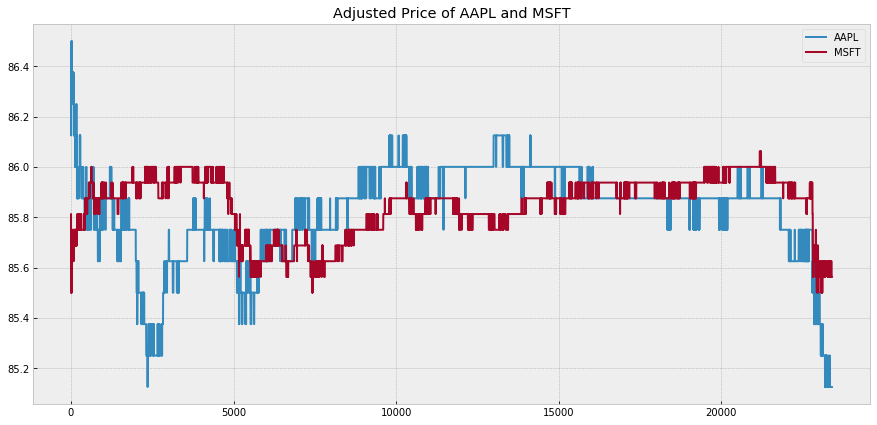

Plot z-score and trading signal of price ratio of AAPL and MSFT


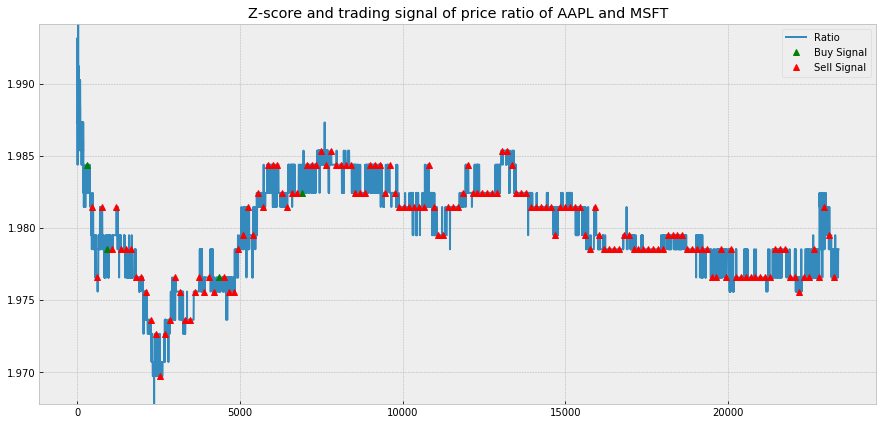

Trading signal of AAPL and MSFT for learning-based pair trading


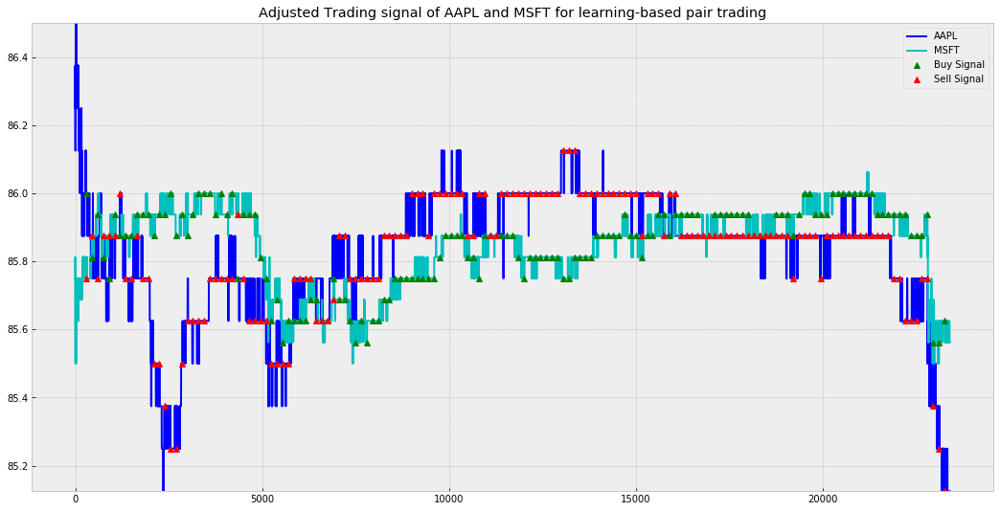

<Figure size 432x288 with 0 Axes>

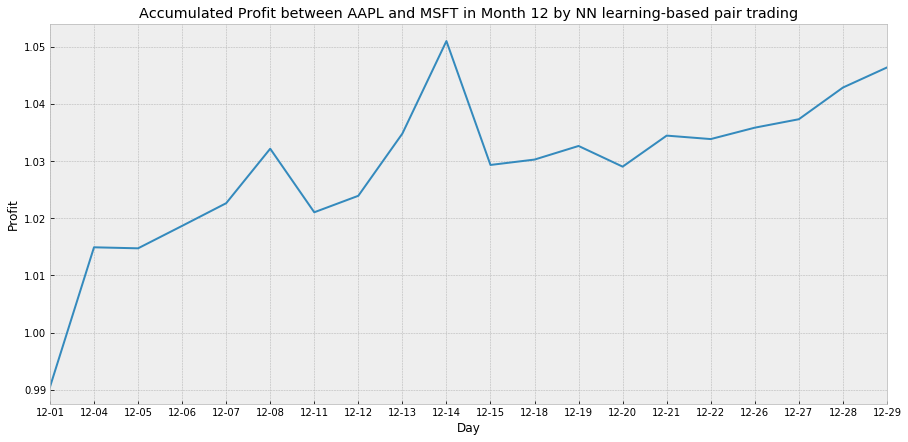

In [71]:
profit_day_NN_v2 = []
signal_v2 = []
price_day_avg_v2 = []
predict_result_v2 = {}
profit_Mode = 1
for i in range(day_test):
    print("[Day %s]" % str(i+1))
    S1 = pd.DataFrame({p[0]: price_and_return_for_test[p[0]][0][i,:]})
    S2 = pd.DataFrame({p[1]: price_and_return_for_test[p[1]][0][i,:]})
    price_day_avg_v2.append(np.mean(S1.values) + np.mean(S2.values))
    result = NN_trade_v2(S1, S2, p[0], p[1], price_data_for_test, price_and_return_for_test, net, i, show_print = 1, fee = 0, profit_Mode = profit_Mode)
    profit_day_NN_v2.append(result[0])
    signal_v2.append([result[1], result[2]])
    predict_result_v2[i+1] = result[3]
    drawTradingCondition(p[0], p[1], price_and_return_for_test, i, window_l, window_s, trading_time, result[1], result[2], mode = 'NN')

# Plot profit
fig = plt.gcf()
plt.figure(figsize=(15,7))
if profit_Mode == 0:
    plt.plot(np.cumsum(profit_day_NN_v2))
else:
    plt.plot(np.cumprod(profit_day_NN_v2))
plt.xticks(range(day_test), date_test_noyear)
plt.title('Accumulated Profit between %s and %s in Month %s by NN learning-based pair trading' % (p[0], p[1], period_test[0]))
plt.style.use("bmh")
plt.xlim(0,day_test-1)
plt.xlabel('Day')
plt.ylabel('Profit')
plt.show()

In [72]:
predict_result_v2

{1: (array([3, 2, 2, 2, 2, 2, 1, 2, 2, 3, 2, 2, 1, 2, 2, 2, 2, 1, 2, 2, 3, 2,
         2, 2, 2, 2, 1, 2, 2, 2, 2, 2, 2, 2, 2, 1, 2, 2, 1, 1, 2, 1, 1, 1,
         2, 2, 3, 1, 2, 2, 2, 2, 1, 1, 2, 2, 1, 2, 2, 2, 1, 2, 1, 2, 2, 2,
         1, 2, 2, 2, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2,
         1, 2, 2, 2, 2, 2, 2, 2, 2, 1, 2, 2, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2,
         2, 2, 2, 2, 2, 2, 2, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 1, 2, 2, 2, 2,
         2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2]),
  array([2, 1, 2, 1, 2, 2, 2, 2, 2, 2, 2, 2, 1, 2, 1, 2, 2, 2, 2, 2, 1, 1,
         2, 2, 2, 2, 1, 1, 2, 1, 2, 2, 1, 2, 2, 2, 2, 2, 2, 2, 2, 1, 2, 1,
         2, 2, 2, 2, 1, 1, 1, 2, 2, 2, 1, 2, 2, 2, 2, 2, 1, 1, 2, 2, 2, 2,
         1, 2, 2, 2, 2, 2, 2, 2, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2,
         2, 2, 2, 2, 1, 2, 2, 2, 2, 1, 2, 1, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2,
         1, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 1, 2, 1, 2, 2, 2, 2,
         2, 2, 2, 2,

<Figure size 432x288 with 0 Axes>

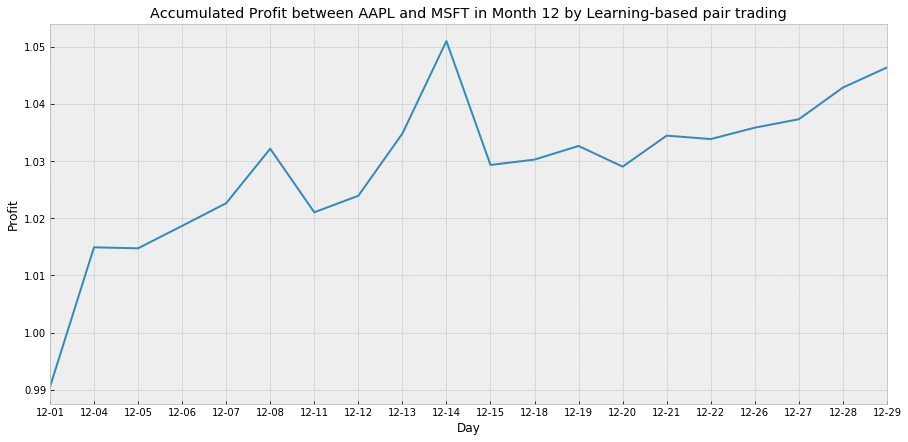

<Figure size 432x288 with 0 Axes>

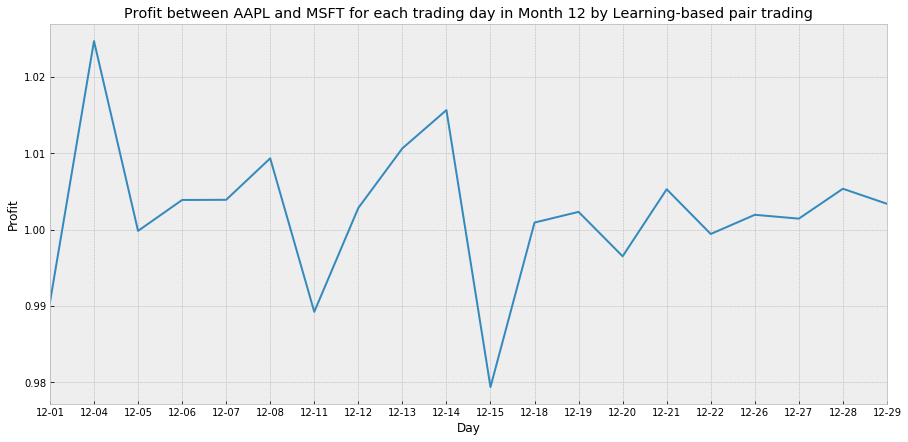

In [73]:
draw_profit(profit_day_NN_v2, date_test_noyear, period_test, mode = 'Learning-based', profit_Mode = profit_Mode)

In [74]:
profit_day_NN_v2

[0.9904567317357404,
 1.0246985761199714,
 0.9998233039273929,
 1.0038734257880861,
 1.0038955449252247,
 1.009331184116315,
 0.9892177621971828,
 1.002826332208612,
 1.0106374322291245,
 1.0156536898914825,
 0.9793620644316261,
 1.0009152878979113,
 1.0023121482679518,
 0.9964945329299738,
 1.005279329136764,
 0.9994152490790945,
 1.0019300968152502,
 1.0014275990061807,
 1.0053443106104112,
 1.0033738989030432]

# training回測

[Day 1]
v_test shape for day 1 : (154, 29, 299)
v_test shape for day 1 : (154, 29, 299)
v_test shape for day 1 : (154, 29, 299)
Predict Result....
Random pick time step :  [ 10  11  12  16  40  45  49  55  60  62  63  65  67  68  79  85  91  93
  94  95  97 100 114 118 119 120 131 135 138 160 165 171 176 181 183 184
 188 190 191 196 205 209 212 213 217 219 221 232 237 241 242 245 247 249
 250 260 262 268 274 277 278 289 294 297]
Random pick time step :  [  3  13  15  16  19  50  57  58  59  71  76  79  81  83  85  90  93  95
  99 103 110 116 120 126 128 131 133 134 143 145 146 148 151 158 162 169
 170 174 176 185 186 195 196 198 202 209 213 214 218 224 227 229 231 234
 236 242 251 252 261 264 269 275 278 297]
Random pick time step :  [  5  11  13  18  26  28  29  32  33  40  42  45  48  57  61  62  63  67
  68  69  82  87  93  94 100 107 109 111 113 115 120 139 141 143 155 158
 161 162 163 178 182 184 186 188 195 198 200 202 204 219 223 226 235 239
 253 263 266 267 268 269 271 280 286 

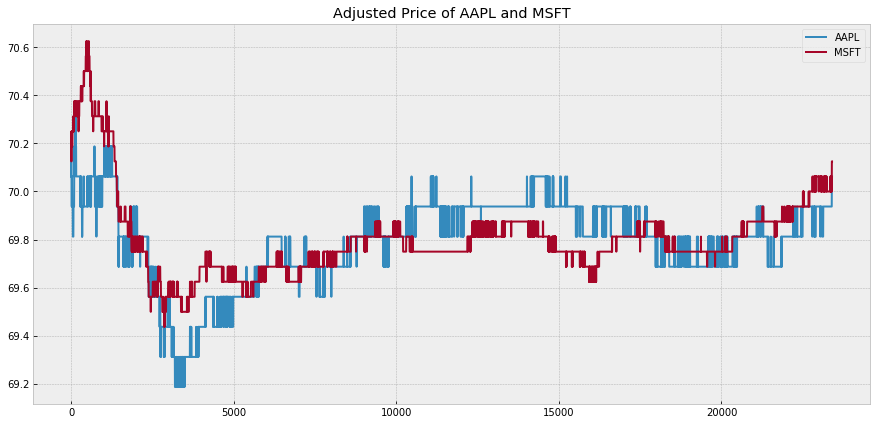

Plot z-score and trading signal of price ratio of AAPL and MSFT


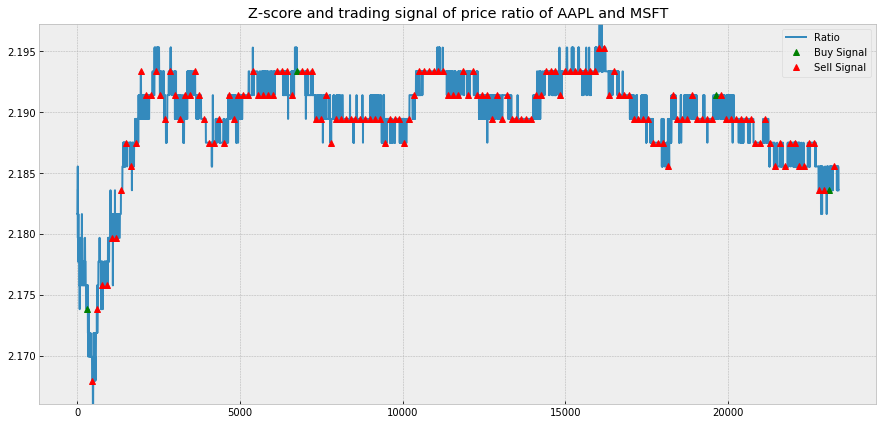

Trading signal of AAPL and MSFT for learning-based pair trading


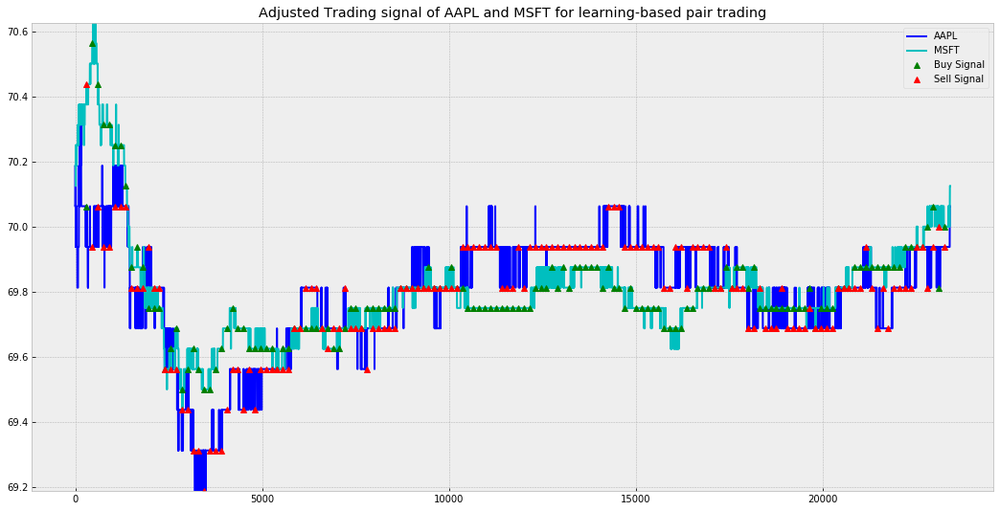

[Day 2]
v_test shape for day 2 : (154, 29, 299)
v_test shape for day 2 : (154, 29, 299)
v_test shape for day 2 : (154, 29, 299)
Predict Result....
Random pick time step :  [  2   9  13  16  17  18  31  32  34  35  36  38  41  44  50  52  59  73
  75  78  84  86  91  92  93 113 122 129 132 139 145 147 148 150 152 160
 162 164 175 183 189 191 193 200 210 211 216 217 223 226 239 240 241 244
 245 260 264 265 273 289 292 293 294 297]
Random pick time step :  [  0   3  12  13  16  20  21  22  24  27  29  31  36  41  43  45  46  50
  57  61  62  67  75  77  85  87  90  99 103 113 114 123 127 132 134 142
 147 151 162 169 171 182 183 190 195 196 201 211 221 225 226 230 252 255
 258 260 263 266 267 271 273 285 287 294]
Random pick time step :  [  2   7  15  18  27  44  48  51  53  55  59  60  62  69  74  76  92  95
  97 100 103 105 106 116 118 119 120 124 126 127 129 131 142 147 162 169
 170 174 180 181 184 195 196 206 207 210 222 232 238 241 248 249 252 255
 261 266 273 278 281 283 285 288 291 

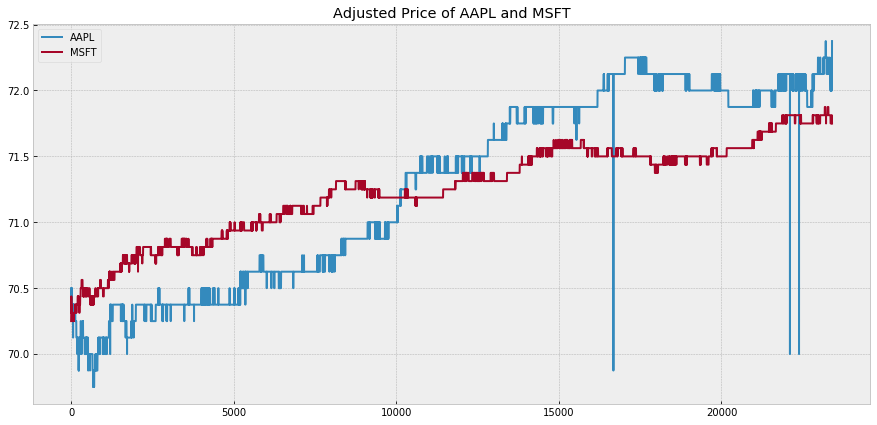

Plot z-score and trading signal of price ratio of AAPL and MSFT


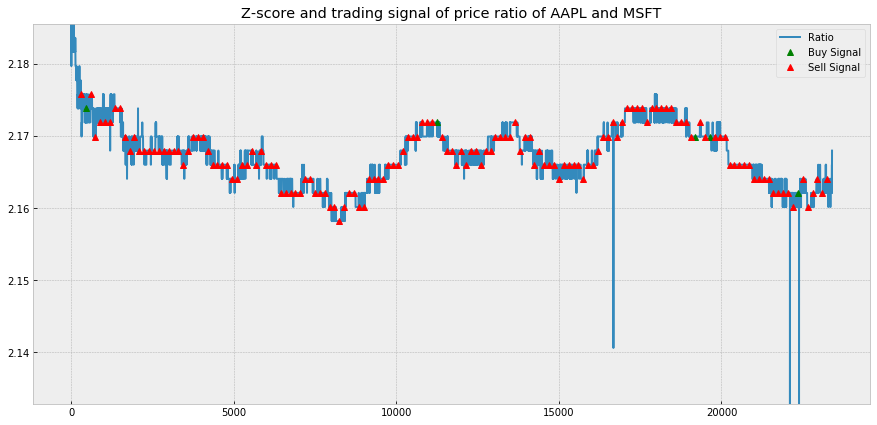

Trading signal of AAPL and MSFT for learning-based pair trading


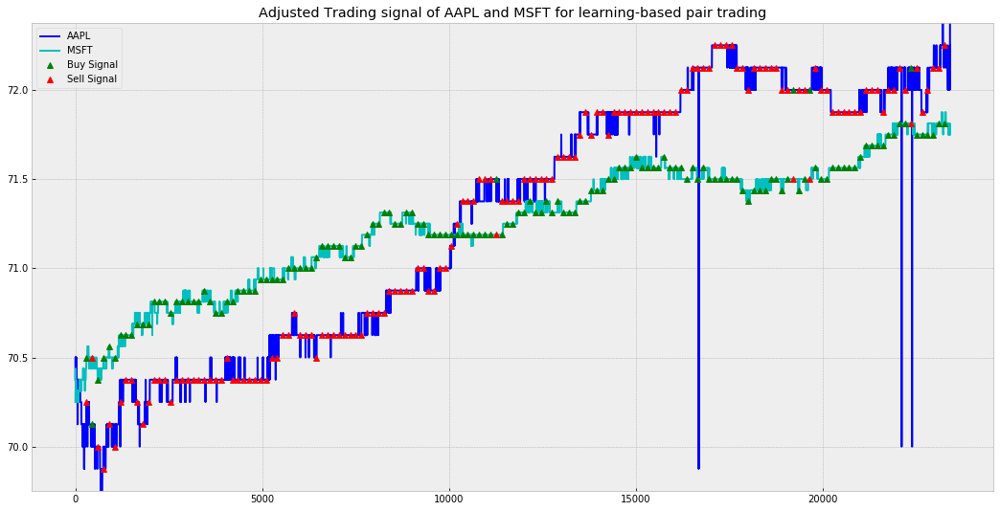

[Day 3]
v_test shape for day 3 : (154, 29, 299)
v_test shape for day 3 : (154, 29, 299)
v_test shape for day 3 : (154, 29, 299)
Predict Result....
Random pick time step :  [  1   4   8  18  21  24  31  34  36  39  41  45  52  53  56  59  65  67
  71  73  74  76  81  85  91  98 101 102 103 104 105 110 115 117 125 128
 134 137 149 151 154 170 172 174 176 183 184 185 195 205 221 222 225 226
 230 237 243 245 254 270 281 286 291 293]
Random pick time step :  [  2   5   7   8  21  24  34  35  36  41  42  43  45  49  51  53  54  55
  56  58  62  63  74  81  97 102 110 115 130 134 154 162 167 168 174 176
 181 189 195 204 210 212 214 215 226 231 234 241 249 251 257 263 267 269
 273 274 275 277 281 285 287 288 289 293]
Random pick time step :  [  6  10  11  17  23  28  34  36  39  44  52  56  62  68  70  74  80  81
  84  87  88  97 100 114 116 117 119 126 139 153 155 156 157 158 163 165
 166 169 171 173 176 177 178 190 195 211 214 215 220 223 240 245 254 264
 269 274 278 283 284 287 291 294 296 

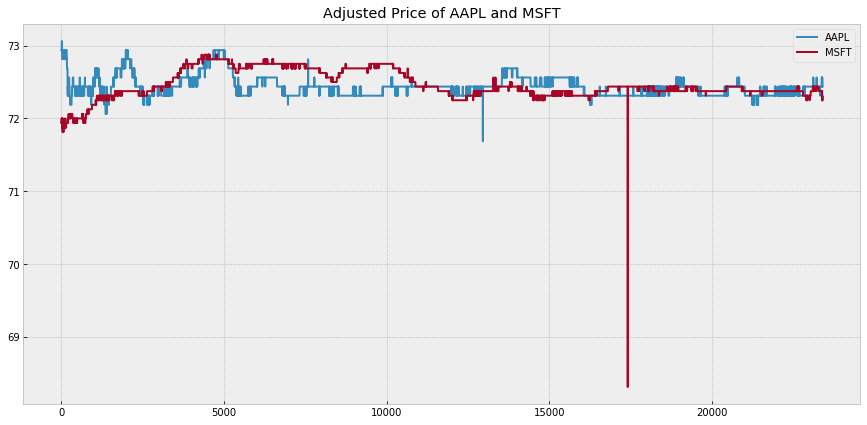

Plot z-score and trading signal of price ratio of AAPL and MSFT


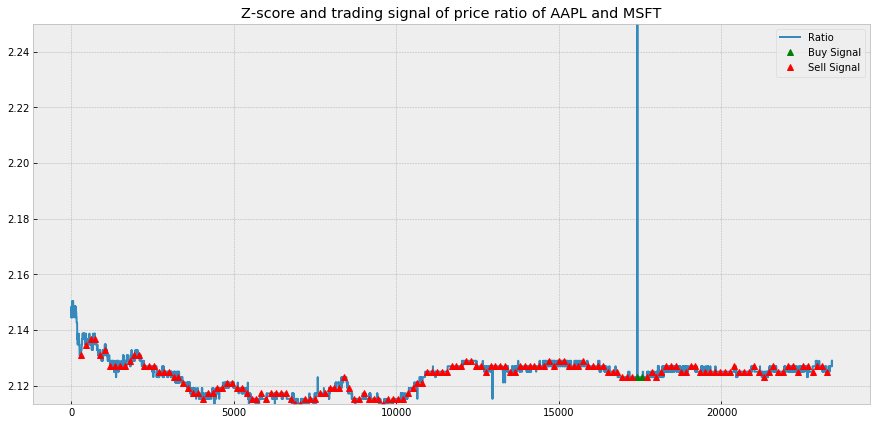

Trading signal of AAPL and MSFT for learning-based pair trading


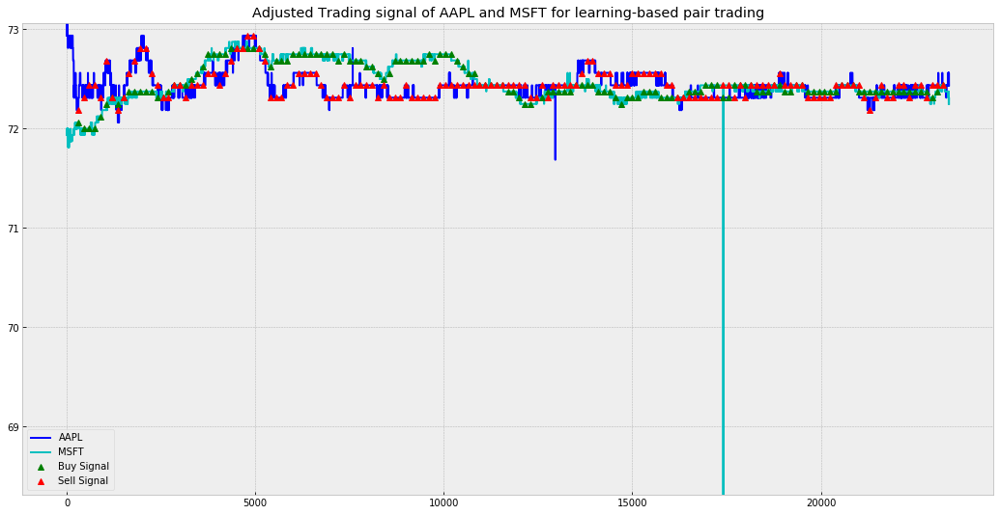

[Day 4]
v_test shape for day 4 : (154, 29, 299)
v_test shape for day 4 : (154, 29, 299)
v_test shape for day 4 : (154, 29, 299)
Predict Result....
Random pick time step :  [  0   2   3   4  10  13  24  38  44  48  54  55  65  66  68  70  73 102
 105 110 118 119 127 128 149 160 161 163 164 170 171 172 182 184 189 195
 198 199 204 207 209 214 215 223 225 229 230 241 242 245 247 248 257 261
 265 267 275 279 289 291 293 294 296 298]
Random pick time step :  [ 16  17  20  24  28  30  36  40  43  48  55  67  70  71  76  84  85  87
  90  94  96 100 103 108 111 113 114 118 121 123 127 130 144 145 147 151
 157 163 164 175 178 180 208 214 229 230 240 241 242 254 256 257 260 261
 266 269 270 271 275 282 284 291 294 297]
Random pick time step :  [ 13  16  22  31  36  41  42  49  51  52  53  59  64  65  71  74  82  84
  86  90  95  98 104 113 115 118 119 121 126 128 134 145 155 156 160 165
 170 173 184 189 191 196 200 204 207 215 218 229 234 235 238 240 245 248
 249 252 253 254 263 276 277 289 290 

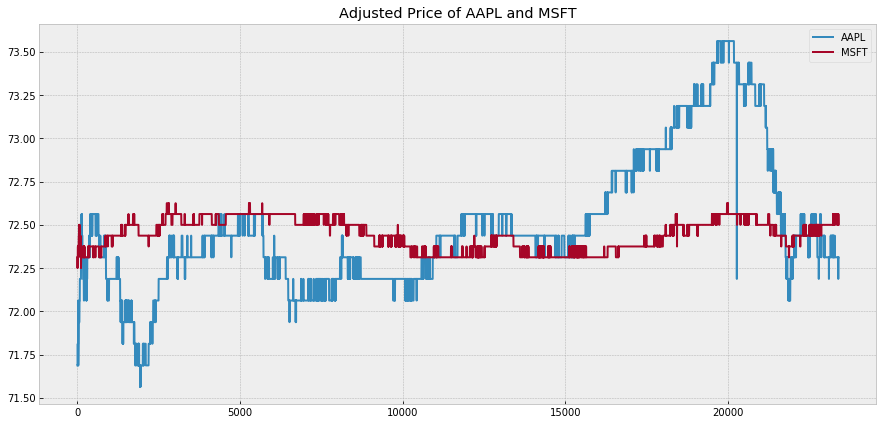

Plot z-score and trading signal of price ratio of AAPL and MSFT


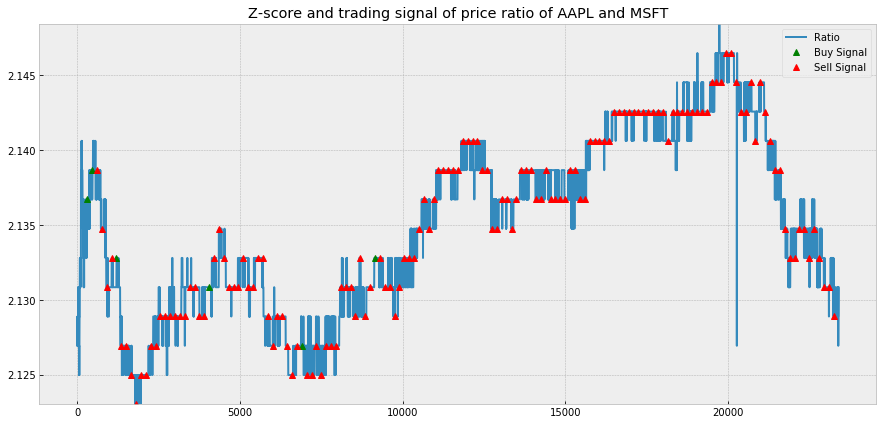

Trading signal of AAPL and MSFT for learning-based pair trading


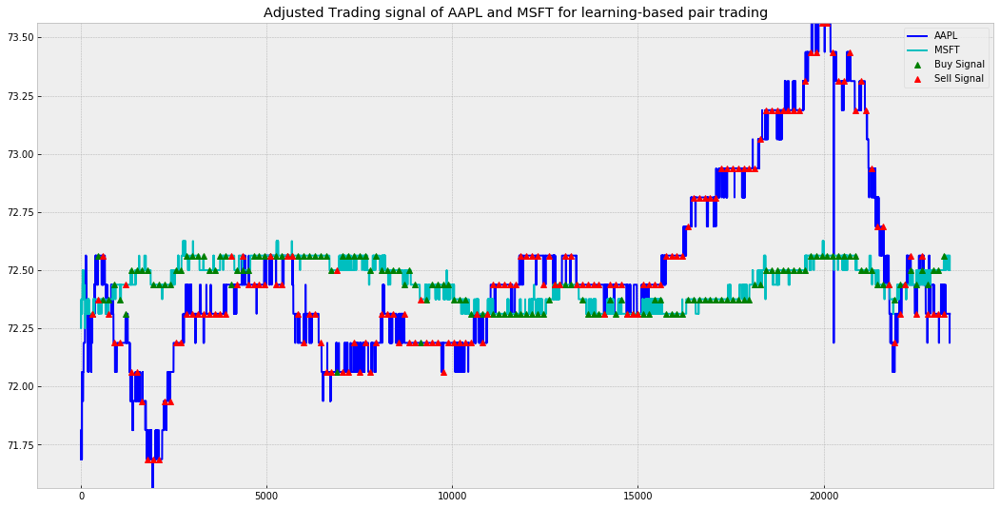

[Day 5]
v_test shape for day 5 : (154, 29, 299)
v_test shape for day 5 : (154, 29, 299)
v_test shape for day 5 : (154, 29, 299)
Predict Result....
Random pick time step :  [  1   2   5  11  14  16  19  23  24  34  35  41  45  48  49  55  58  61
  65  84  93  96  98 100 101 102 104 115 117 123 124 127 128 129 132 133
 142 153 154 160 162 168 180 182 187 207 217 220 222 224 225 240 247 253
 260 266 273 280 283 284 285 289 290 295]
Random pick time step :  [  0   3  13  16  19  27  36  37  39  41  47  56  58  59  66  69  70  75
  76  78  81  82  85  88  94 100 110 111 113 120 136 138 144 149 152 156
 160 162 164 167 172 177 180 184 192 196 205 211 217 220 229 230 236 237
 238 242 244 256 264 267 285 286 287 291]
Random pick time step :  [  3   8  16  27  29  30  31  39  43  48  55  61  65  68  70  72  78  85
  86  88 101 105 107 110 117 125 129 135 138 145 148 156 161 169 172 175
 176 177 180 182 186 188 189 192 196 199 202 208 209 216 227 230 234 244
 245 247 257 284 289 292 294 295 296 

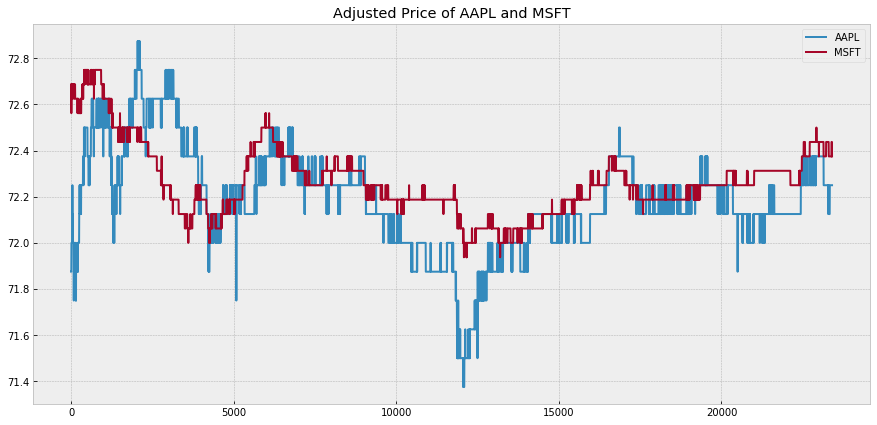

Plot z-score and trading signal of price ratio of AAPL and MSFT


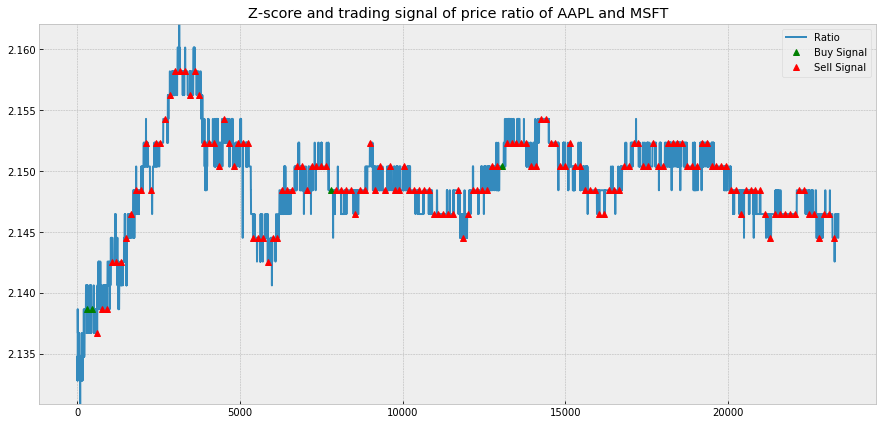

Trading signal of AAPL and MSFT for learning-based pair trading


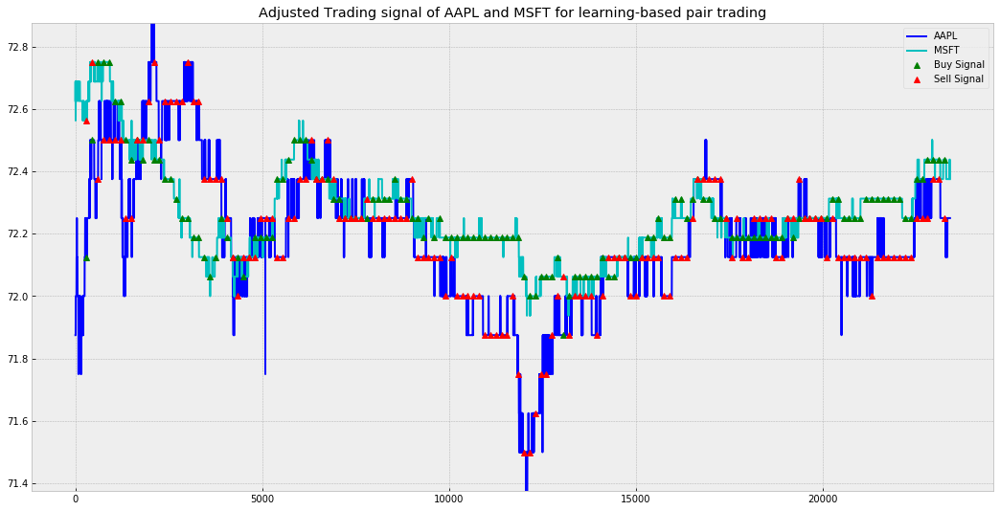

[Day 6]
v_test shape for day 6 : (154, 29, 299)
v_test shape for day 6 : (154, 29, 299)
v_test shape for day 6 : (154, 29, 299)
Predict Result....
Random pick time step :  [  2   5  19  37  45  57  60  63  67  68  71  73  77  78  80  97 100 103
 105 106 108 119 129 131 132 136 140 141 144 148 157 158 176 179 187 194
 202 203 205 207 208 210 217 222 223 224 230 240 241 244 250 257 267 272
 275 278 284 286 287 290 291 294 296 298]
Random pick time step :  [  7  12  16  21  34  37  39  42  45  48  49  51  52  53  58  61  62  63
  74  77  79  88  92  93  98 111 112 118 126 131 137 150 155 157 159 163
 164 165 166 170 176 179 180 183 194 202 207 227 231 239 240 253 254 266
 267 268 270 271 274 277 278 280 285 293]
Random pick time step :  [  0   8   9  12  19  24  26  31  34  43  44  46  49  51  54  59  63  64
  70  76  80  84  92  94  96 107 114 117 128 141 149 156 160 161 165 176
 185 192 198 202 206 208 214 222 223 228 235 240 241 246 250 254 255 257
 266 269 271 274 275 277 283 285 287 

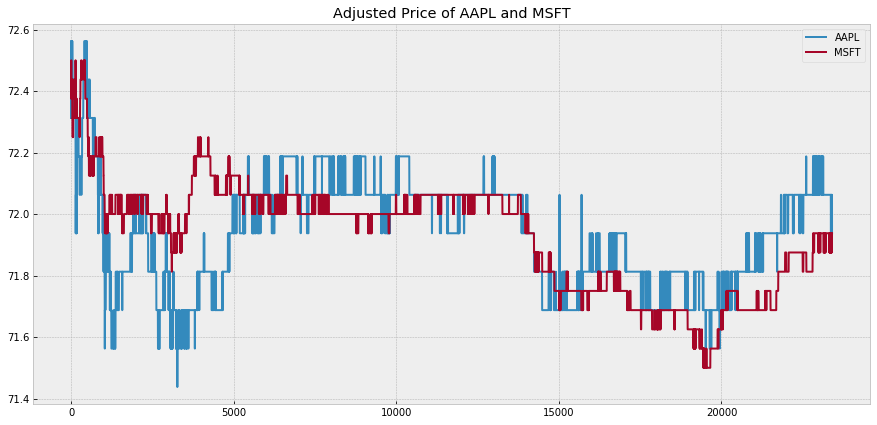

Plot z-score and trading signal of price ratio of AAPL and MSFT


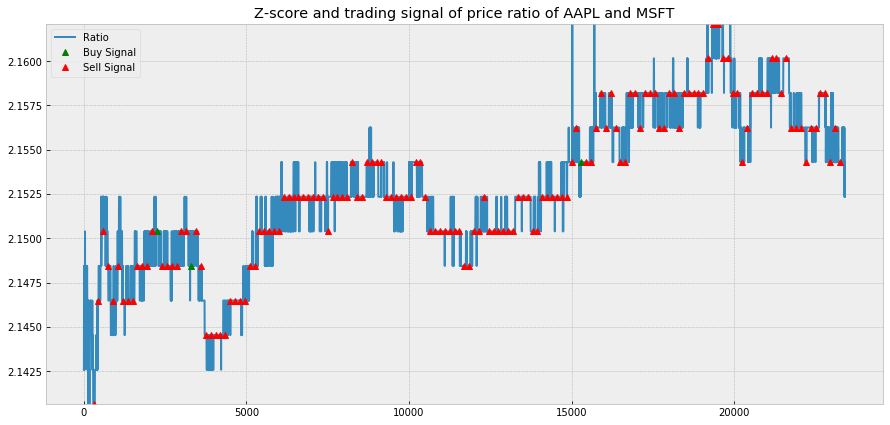

Trading signal of AAPL and MSFT for learning-based pair trading


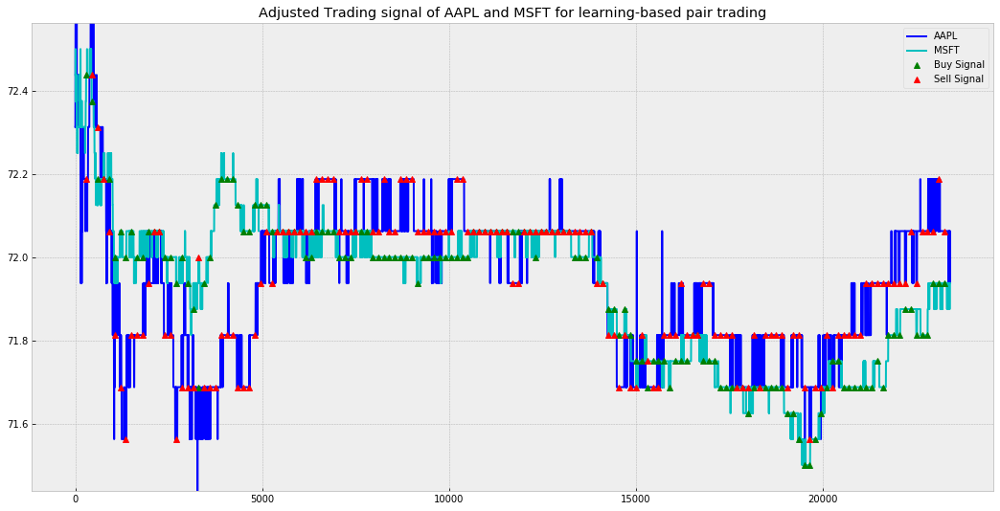

[Day 7]
v_test shape for day 7 : (154, 29, 299)
v_test shape for day 7 : (154, 29, 299)
v_test shape for day 7 : (154, 29, 299)
Predict Result....
Random pick time step :  [  0   7   9  13  17  25  28  29  32  37  39  42  50  52  53  55  63  64
  78  83  88  95 102 106 109 122 126 129 138 152 157 165 166 170 172 174
 176 177 184 188 192 197 200 202 217 219 220 221 222 233 238 250 251 253
 255 261 263 266 271 273 278 282 289 291]
Random pick time step :  [  3   5   6   8  10  20  26  31  38  42  43  44  48  61  67  70  72  81
  85  88  89  90 103 110 113 117 118 121 125 126 129 131 132 139 143 144
 148 178 183 187 189 194 198 199 201 213 214 216 219 233 237 238 243 252
 254 262 271 273 275 277 280 282 284 286]
Random pick time step :  [  2   6   9  10  21  22  26  34  47  64  80  81  83  85  92  93  97  99
 103 105 110 112 118 121 125 128 129 131 132 133 137 146 149 157 159 161
 181 183 184 192 196 199 213 219 220 221 222 223 225 228 229 233 238 240
 242 244 247 251 255 256 267 268 274 

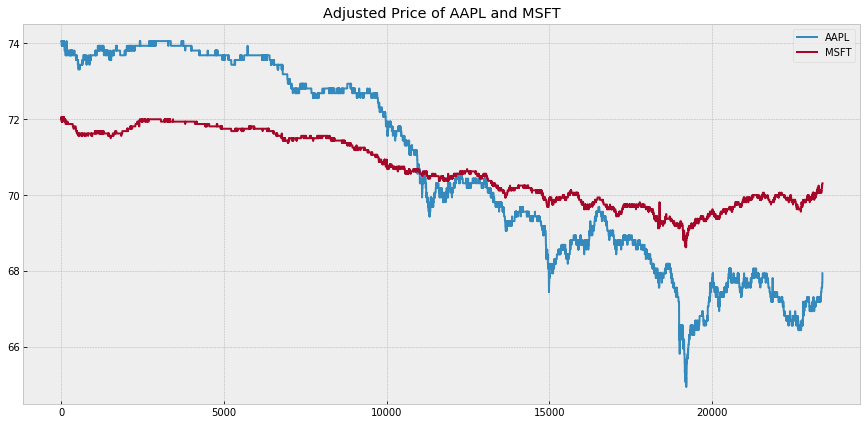

Plot z-score and trading signal of price ratio of AAPL and MSFT


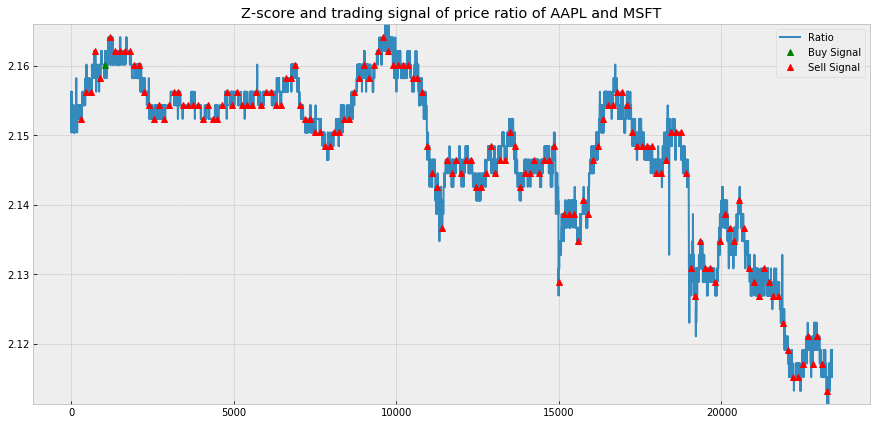

Trading signal of AAPL and MSFT for learning-based pair trading


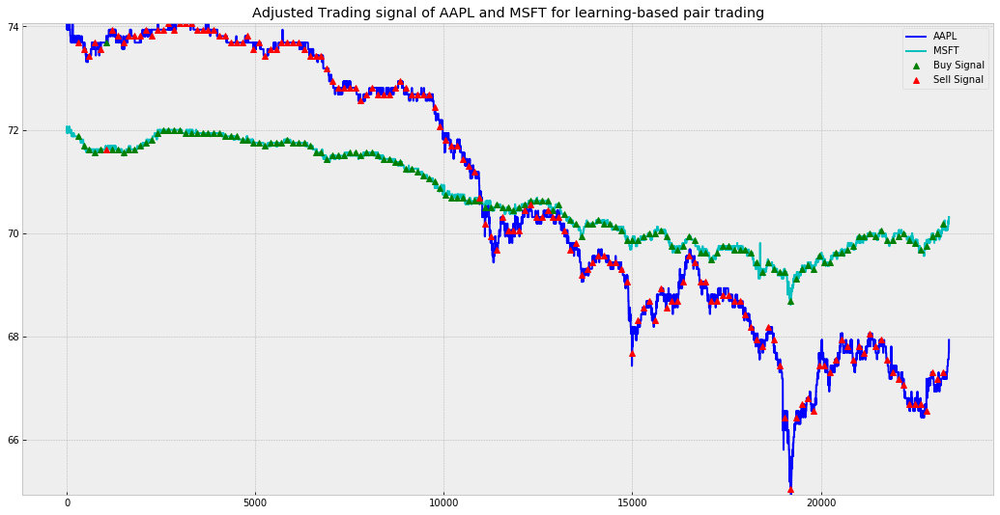

[Day 8]
v_test shape for day 8 : (154, 29, 299)
v_test shape for day 8 : (154, 29, 299)
v_test shape for day 8 : (154, 29, 299)
Predict Result....
Random pick time step :  [  2  10  15  18  20  30  34  35  38  40  44  46  52  69  72  78  83  93
  95 103 108 109 123 126 127 129 131 132 133 136 141 145 151 155 159 163
 164 167 171 178 179 181 185 187 192 194 199 201 202 204 207 224 228 235
 243 249 259 265 268 271 276 278 280 286]
Random pick time step :  [  2   4   7  18  19  25  30  41  50  52  54  65  77  78  83  93 104 109
 110 117 123 124 127 128 129 130 132 133 135 150 154 157 164 165 166 170
 172 194 198 200 201 205 207 208 219 220 222 223 225 228 234 241 246 247
 254 267 269 276 277 280 283 292 297 298]
Random pick time step :  [  3   9  12  15  33  35  39  40  45  46  50  52  61  73  76  78  81  91
  92  96 109 117 119 120 121 124 127 130 131 134 137 141 145 151 154 157
 162 163 171 173 174 188 190 195 197 200 202 203 206 219 221 225 235 246
 252 255 257 270 272 273 274 275 281 

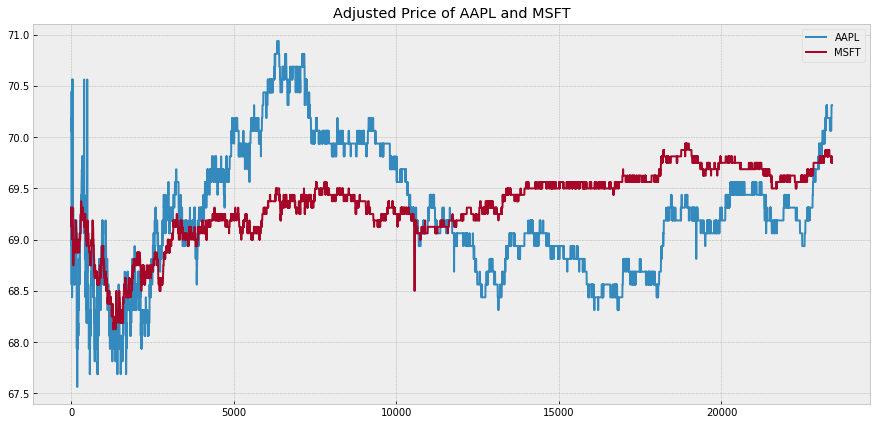

Plot z-score and trading signal of price ratio of AAPL and MSFT


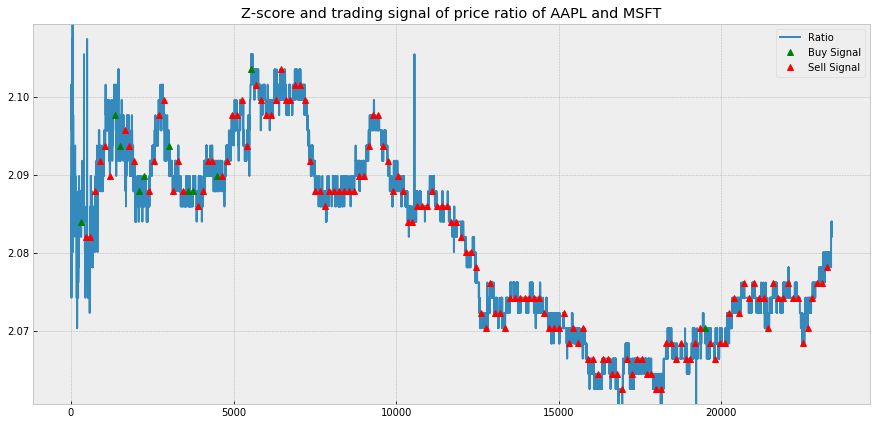

Trading signal of AAPL and MSFT for learning-based pair trading


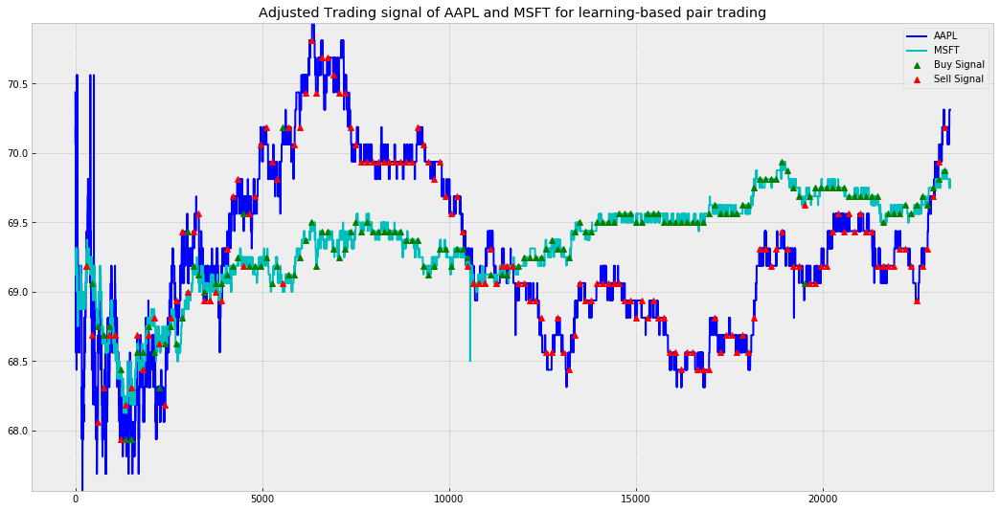

[Day 9]
v_test shape for day 9 : (154, 29, 299)
v_test shape for day 9 : (154, 29, 299)
v_test shape for day 9 : (154, 29, 299)
Predict Result....
Random pick time step :  [ 17  19  25  26  32  38  44  46  51  53  68  70  80  87  93  94  95 100
 103 112 113 115 117 124 129 133 139 142 147 148 149 155 164 166 168 169
 174 175 186 190 192 193 195 200 201 205 228 231 242 243 245 246 249 250
 267 272 275 276 281 283 287 289 294 295]
Random pick time step :  [  6   9  11  13  15  17  25  31  36  43  49  50  51  55  56  62  65  69
  74  76  77  81  93  95 101 105 114 120 124 131 137 139 145 146 149 151
 154 160 173 182 191 197 198 200 202 210 216 218 220 222 223 224 236 238
 239 246 250 252 254 263 270 275 283 291]
Random pick time step :  [  1   3   8  11  12  17  19  21  28  33  35  59  61  65  66  70  72  78
  81  88  92  98  99 103 104 105 108 114 116 122 126 135 144 157 165 172
 173 176 177 178 196 198 204 208 218 223 224 225 232 234 237 241 243 244
 248 251 253 258 278 279 281 282 292 

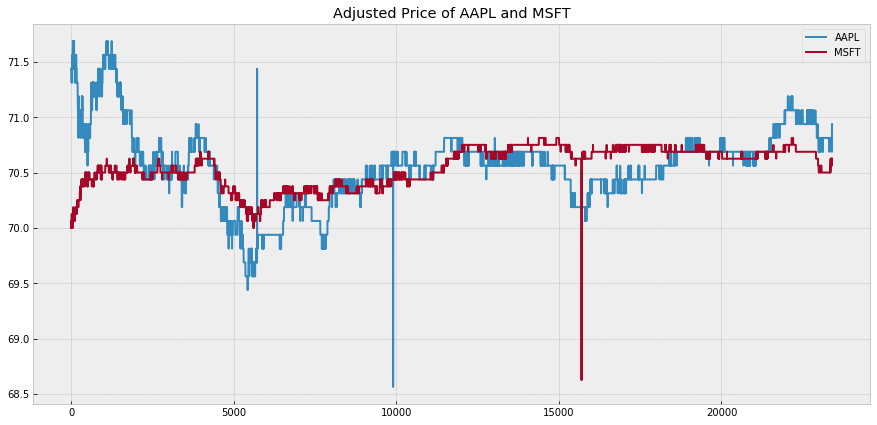

Plot z-score and trading signal of price ratio of AAPL and MSFT


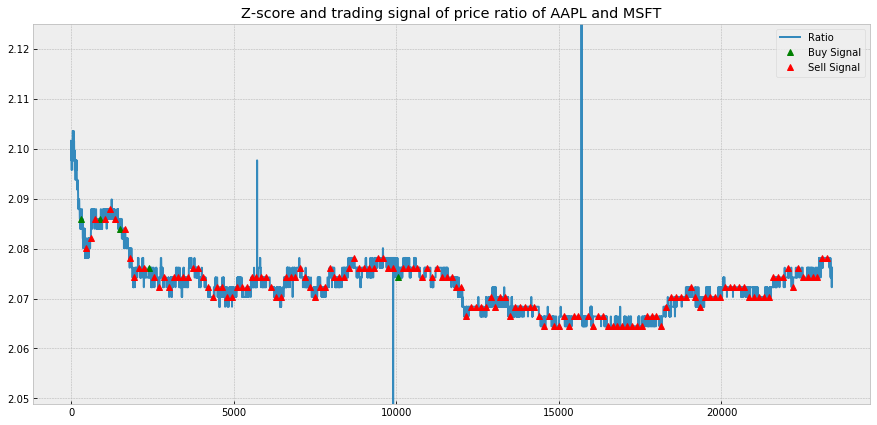

Trading signal of AAPL and MSFT for learning-based pair trading


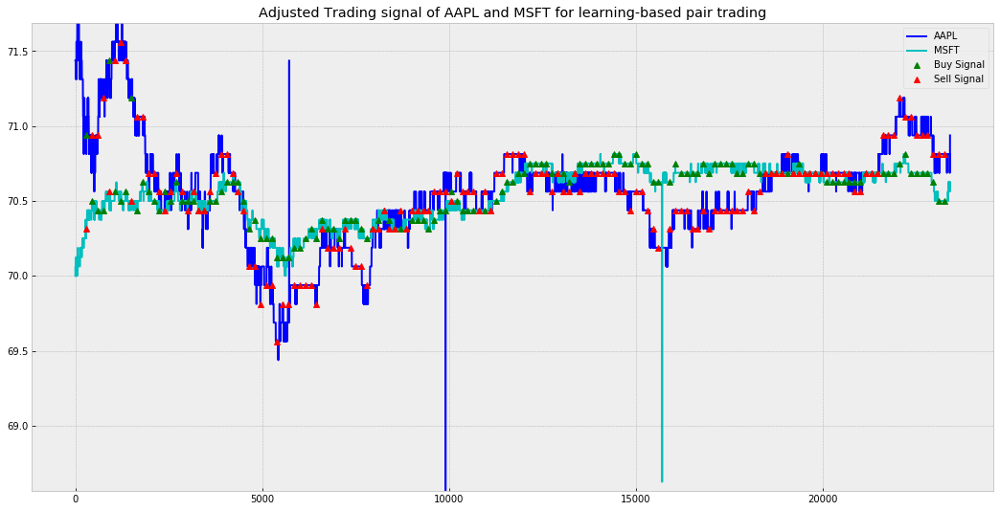

[Day 10]
v_test shape for day 10 : (154, 29, 299)
v_test shape for day 10 : (154, 29, 299)
v_test shape for day 10 : (154, 29, 299)
Predict Result....
Random pick time step :  [  4   6  12  14  15  21  23  24  28  30  37  45  48  58  69  70  82  85
  91 101 102 104 109 111 115 116 117 119 135 140 145 148 154 157 160 164
 175 182 186 190 193 194 206 207 210 218 238 240 242 249 251 252 254 260
 263 268 270 271 273 276 290 292 297 298]
Random pick time step :  [  7   9  11  16  18  20  23  36  40  43  44  45  46  47  48  53  63  64
  66  68  80  81  88  93  95  97 105 114 119 129 130 132 134 135 143 147
 151 153 154 168 174 181 193 195 198 199 204 210 217 220 223 226 229 238
 248 252 255 257 261 266 270 289 295 298]
Random pick time step :  [  9  12  18  19  21  25  31  39  41  43  46  51  54  58  60  65  76  81
  91 102 111 117 125 128 130 135 140 148 155 162 168 174 177 183 185 188
 194 199 202 203 205 209 215 220 229 230 232 237 239 243 250 254 259 263
 267 268 269 279 283 285 286 287 

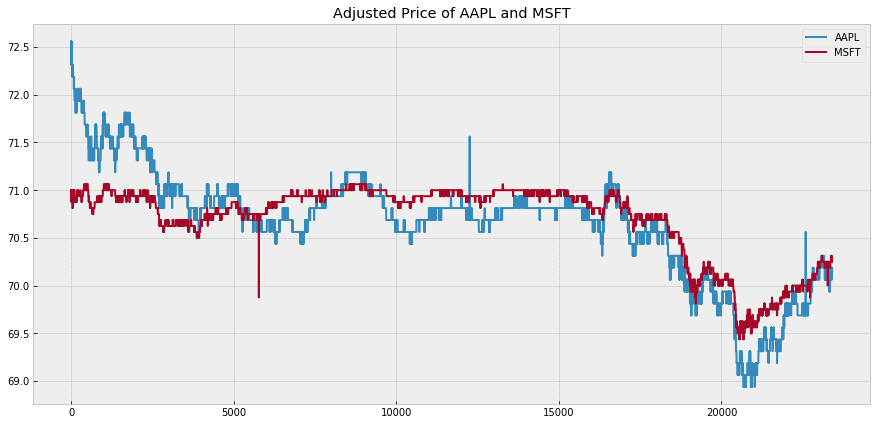

Plot z-score and trading signal of price ratio of AAPL and MSFT


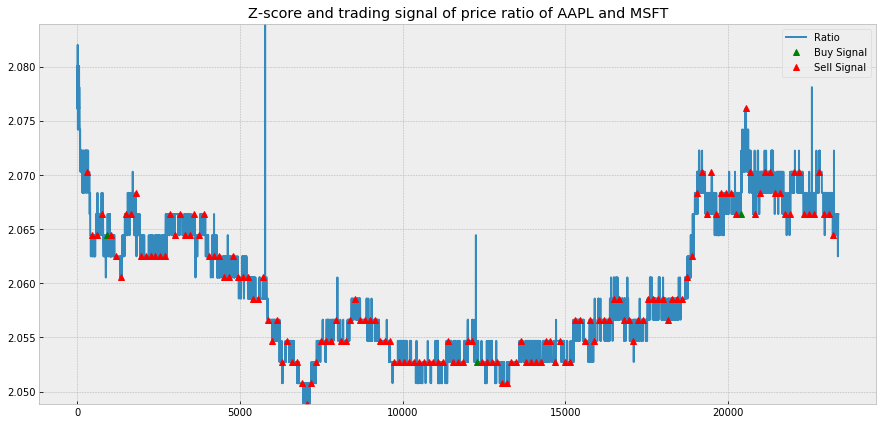

Trading signal of AAPL and MSFT for learning-based pair trading


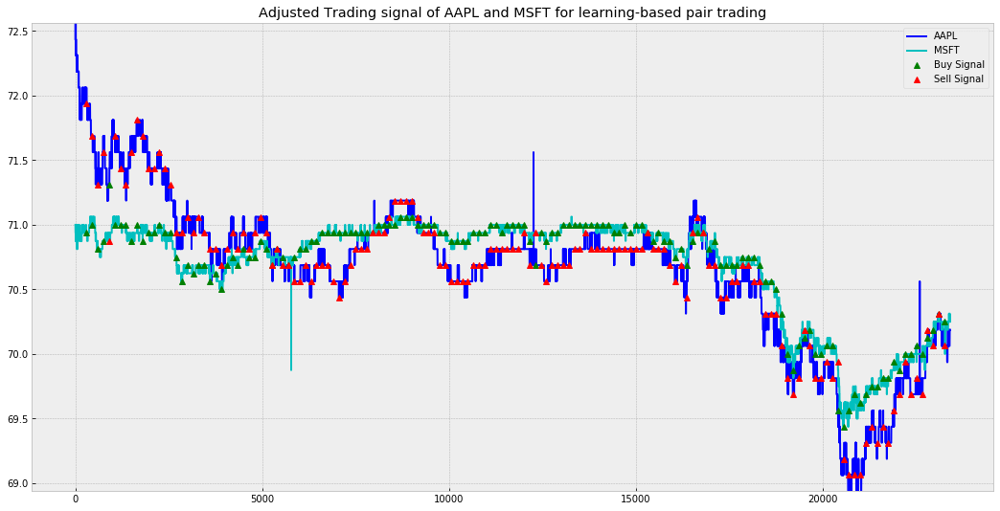

[Day 11]
v_test shape for day 11 : (154, 29, 299)
v_test shape for day 11 : (154, 29, 299)
v_test shape for day 11 : (154, 29, 299)
Predict Result....
Random pick time step :  [ 26  30  40  44  46  53  56  57  58  61  62  67  68  70  72  76  78  87
  95  97 102 110 115 125 126 130 132 134 136 139 142 144 145 156 167 170
 171 186 190 193 197 202 207 209 212 214 216 217 226 230 237 251 254 259
 262 263 272 278 280 285 287 291 295 298]
Random pick time step :  [  0   4  11  17  25  30  39  40  44  48  50  51  61  71  72  73  75  76
  81  96 107 110 111 121 132 137 153 161 168 173 176 177 182 185 186 188
 189 193 195 205 208 210 214 216 217 225 228 232 233 242 243 248 250 254
 255 257 264 276 277 285 288 289 292 297]
Random pick time step :  [  4   5  10  18  19  23  26  28  30  35  38  41  46  49  54  64  70  71
  73  76  78  88  96  98 100 103 110 111 114 126 130 136 141 146 152 157
 167 173 178 179 185 186 191 200 207 212 216 218 227 231 233 235 247 248
 250 257 258 259 264 266 267 279 

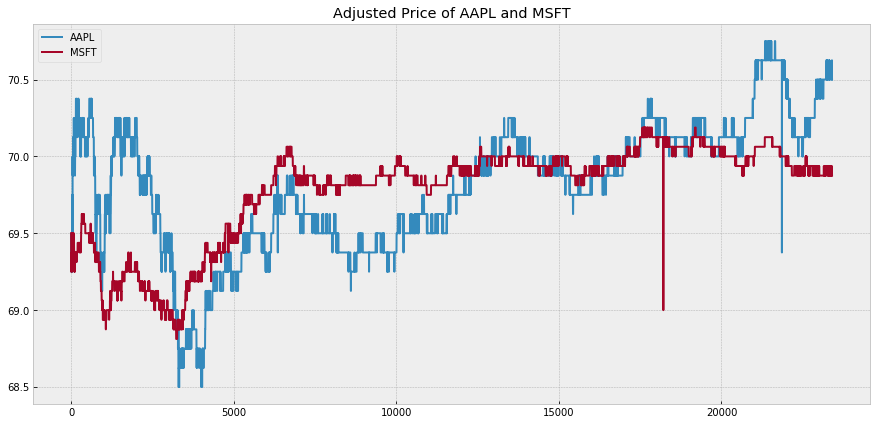

Plot z-score and trading signal of price ratio of AAPL and MSFT


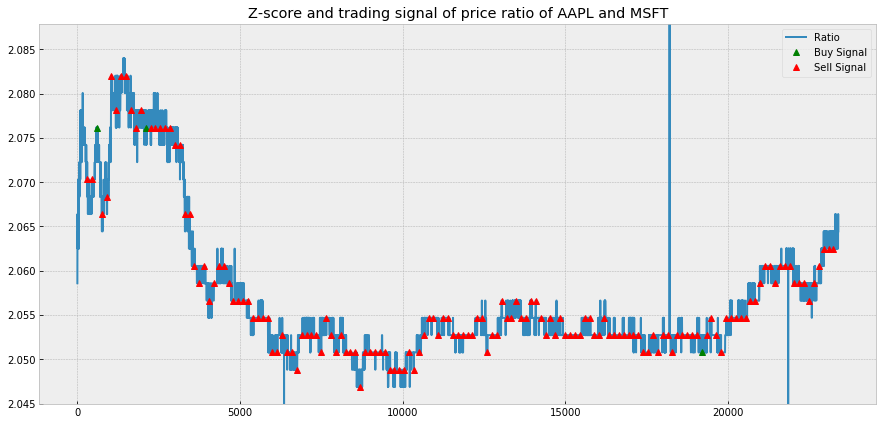

Trading signal of AAPL and MSFT for learning-based pair trading


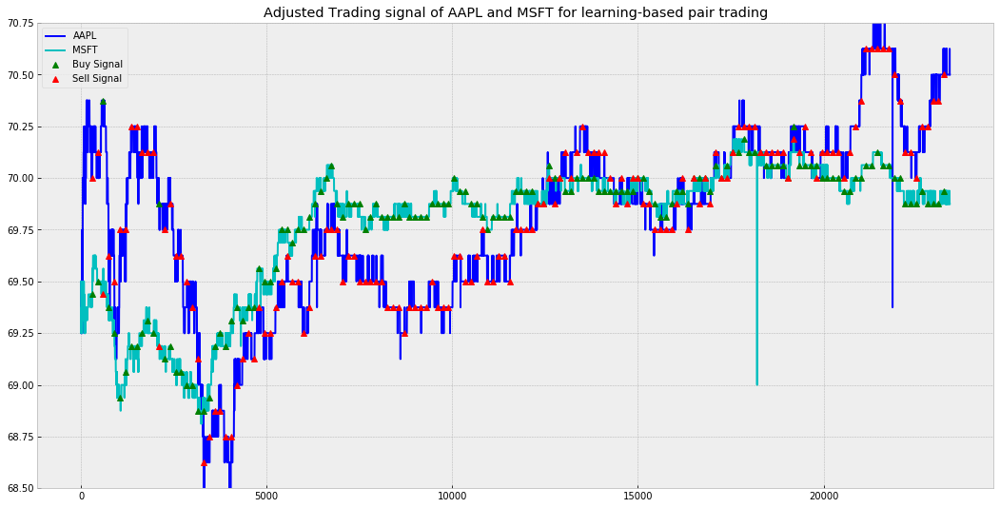

[Day 12]
v_test shape for day 12 : (154, 29, 299)
v_test shape for day 12 : (154, 29, 299)
v_test shape for day 12 : (154, 29, 299)
Predict Result....
Random pick time step :  [  2   3   4   7   8  12  16  17  21  24  28  29  32  33  34  36  39  42
  48  49  51  62  76  79  80  82  85  92 100 104 111 124 139 141 152 160
 165 167 170 172 176 178 198 205 206 209 217 221 223 230 235 238 252 256
 262 263 268 272 273 277 279 284 287 297]
Random pick time step :  [  3   6  10  12  30  33  36  43  45  46  49  60  61  64  77  85  86  90
  91  98 102 121 124 135 138 143 149 151 152 155 156 164 173 174 177 182
 192 193 195 199 203 204 213 215 216 219 227 228 230 232 233 237 239 248
 254 256 262 263 264 273 274 275 279 281]
Random pick time step :  [  3  19  27  30  34  41  43  47  50  56  62  67  69  70  80  90  95  98
 106 109 116 119 123 124 127 134 139 141 144 145 146 149 152 158 161 165
 169 174 175 187 188 194 198 199 200 206 214 218 221 223 225 227 228 231
 248 251 257 263 269 273 276 278 

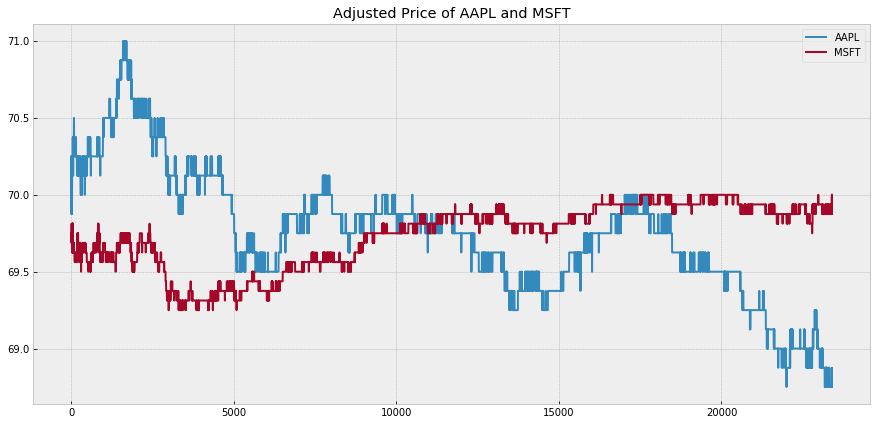

Plot z-score and trading signal of price ratio of AAPL and MSFT


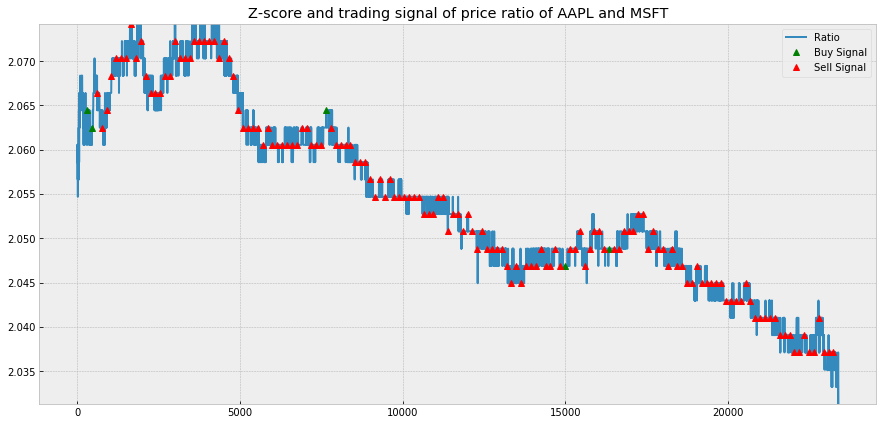

Trading signal of AAPL and MSFT for learning-based pair trading


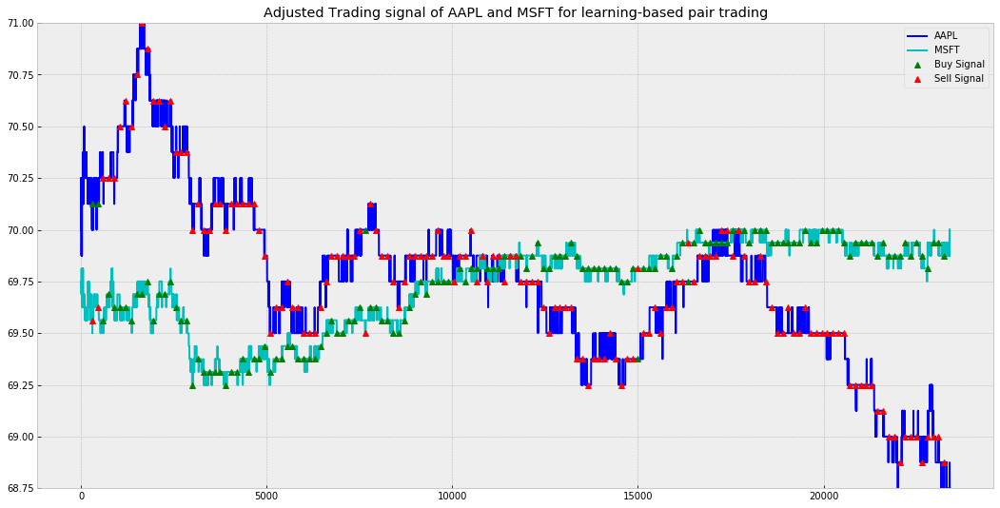

[Day 13]
v_test shape for day 13 : (154, 29, 299)
v_test shape for day 13 : (154, 29, 299)
v_test shape for day 13 : (154, 29, 299)
Predict Result....
Random pick time step :  [  4   7  19  27  36  37  45  49  54  56  57  61  62  67  70  82  85  94
 101 109 113 120 124 125 130 131 132 142 144 159 167 169 174 185 192 196
 198 199 206 208 209 211 212 216 223 229 237 244 249 250 252 263 266 273
 274 278 279 283 287 289 290 291 296 297]
Random pick time step :  [  0  13  25  26  30  35  39  40  54  64  65  66  68  71  77  79  80  85
  86  90  91  98  99 103 104 109 110 113 116 124 136 139 140 143 149 158
 171 173 174 179 182 185 191 192 195 201 203 204 216 221 230 232 234 238
 249 253 262 271 281 283 284 286 289 293]
Random pick time step :  [  3  10  12  17  25  35  36  41  44  45  51  63  64  65  67  68  77  79
  84  97 103 104 109 112 118 120 125 130 134 136 144 146 148 161 173 177
 185 186 187 188 189 191 193 197 199 200 202 208 215 220 228 229 232 241
 249 256 266 271 274 276 280 284 

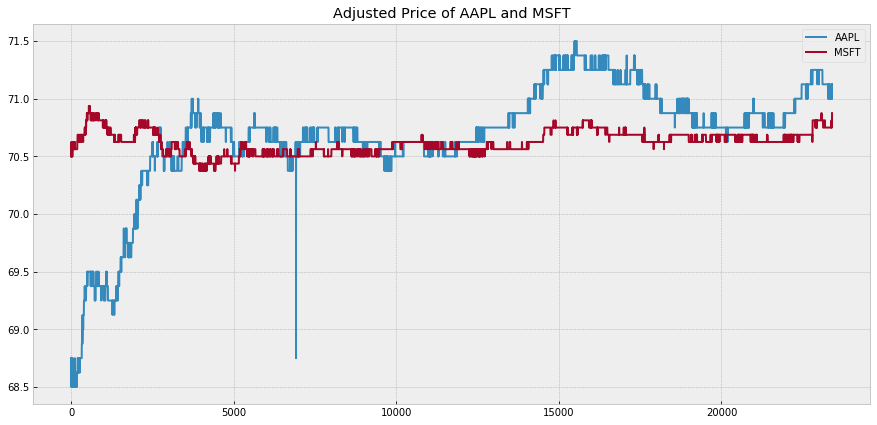

Plot z-score and trading signal of price ratio of AAPL and MSFT


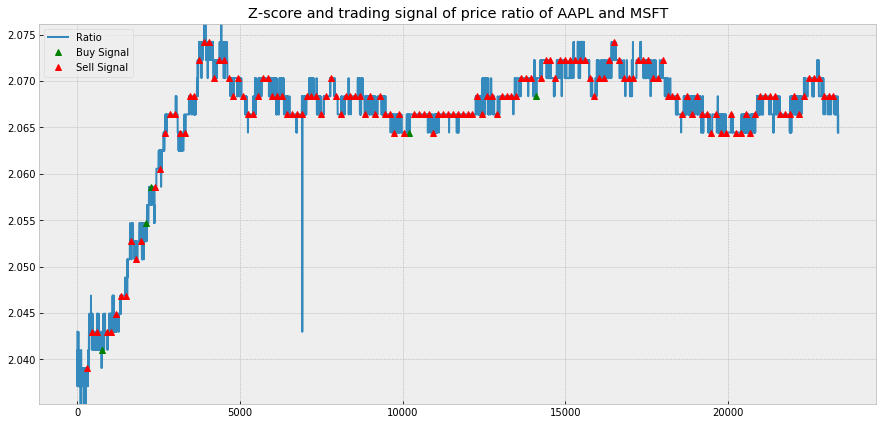

Trading signal of AAPL and MSFT for learning-based pair trading


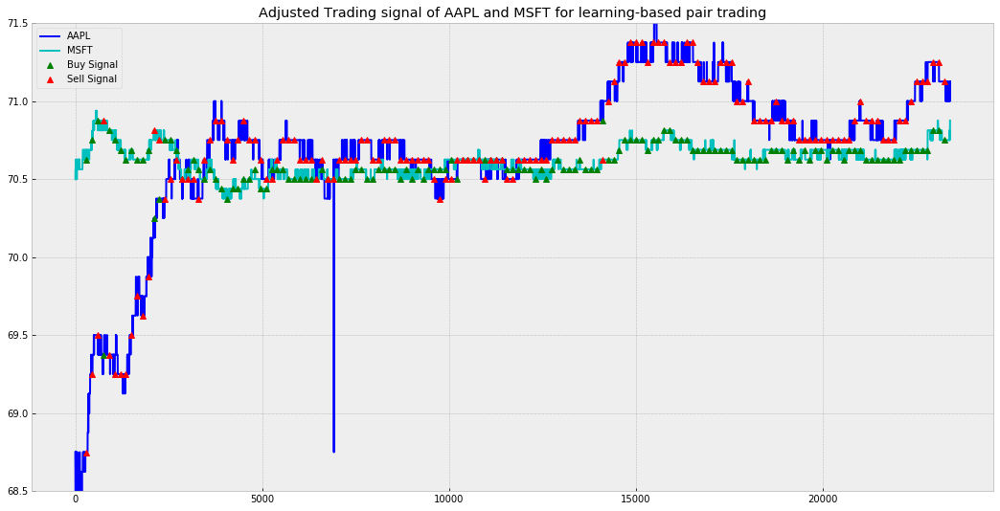

[Day 14]
v_test shape for day 14 : (154, 29, 299)
v_test shape for day 14 : (154, 29, 299)
v_test shape for day 14 : (154, 29, 299)
Predict Result....
Random pick time step :  [  6   8   9  10  15  32  34  44  56  67  71  73  74  78  79  80  83  85
  88  91  95  96  97 101 106 107 116 118 129 140 144 153 159 162 163 166
 176 177 185 188 191 193 203 208 209 212 214 218 235 236 237 251 252 256
 258 260 262 267 271 285 286 287 291 295]
Random pick time step :  [ 19  21  24  28  40  42  44  46  47  51  53  54  55  59  64  69  71  73
  74  75  79  87  91  92  93  94  98 104 111 114 116 117 124 125 127 130
 132 133 135 137 146 158 167 172 174 186 188 190 193 203 208 212 218 222
 230 232 244 262 269 274 277 287 290 294]
Random pick time step :  [  4  15  16  36  38  42  43  44  55  58  60  65  68  71  76  77  78  80
  82  89  96  97 108 115 117 127 128 129 130 131 133 135 141 146 147 156
 158 164 166 175 189 190 197 199 206 208 210 222 227 235 242 243 252 253
 257 259 263 265 268 270 275 281 

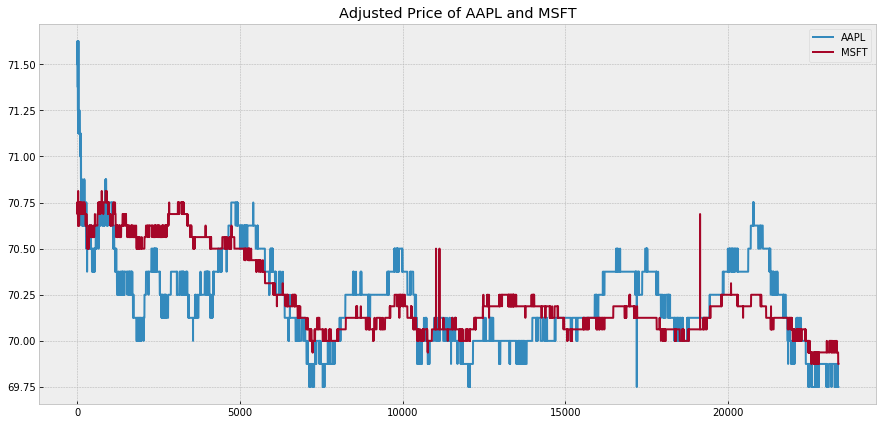

Plot z-score and trading signal of price ratio of AAPL and MSFT


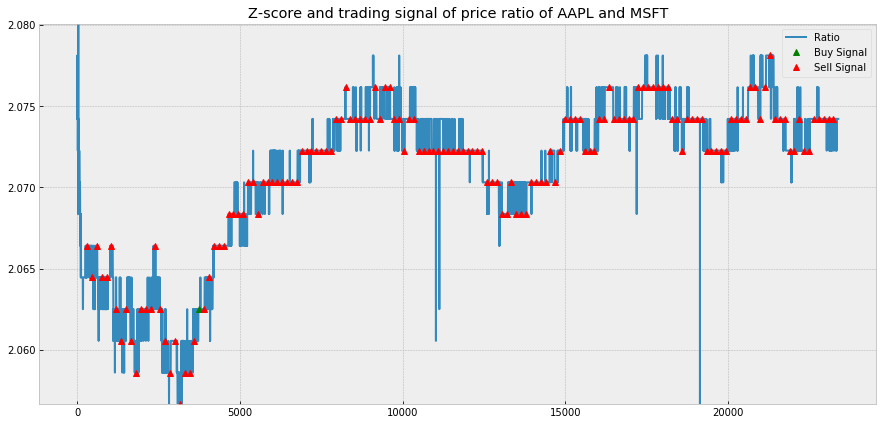

Trading signal of AAPL and MSFT for learning-based pair trading


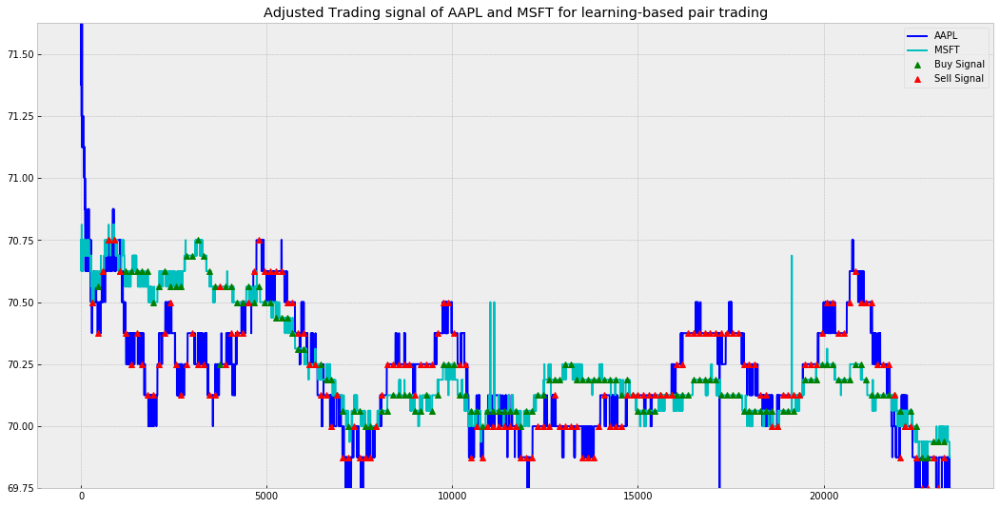

[Day 15]
v_test shape for day 15 : (154, 29, 299)
v_test shape for day 15 : (154, 29, 299)
v_test shape for day 15 : (154, 29, 299)
Predict Result....
Random pick time step :  [  0   3   5   7   9  17  21  27  35  36  37  42  50  51  60  66  76  80
  83  89  90  98 100 105 107 111 113 114 115 121 122 127 133 144 149 151
 152 163 164 176 177 182 186 190 192 201 215 218 229 235 237 240 245 250
 252 260 264 269 270 286 287 288 294 295]
Random pick time step :  [  6  10  13  15  19  21  22  33  35  40  47  48  51  54  57  71  73  77
  78  80  90  97  99 100 102 103 109 117 122 141 151 154 166 176 177 179
 180 186 192 195 199 203 208 212 213 219 234 238 239 250 252 253 256 260
 261 265 268 272 281 282 294 295 296 297]
Random pick time step :  [  1   8   9  11  17  19  26  27  37  39  41  45  46  47  53  55  57  62
  63  66  67  69  71  79  80  87  88  91  93  98 106 109 110 111 130 136
 137 140 149 154 161 163 165 189 191 204 224 227 233 242 249 250 253 261
 262 266 271 275 276 278 283 285 

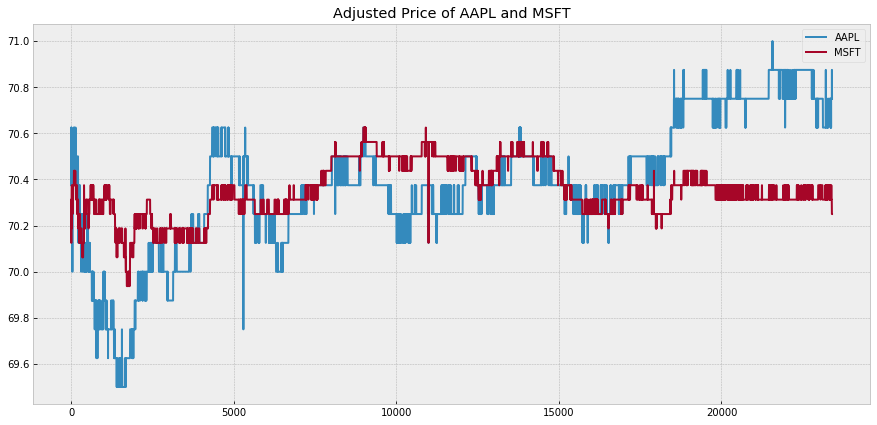

Plot z-score and trading signal of price ratio of AAPL and MSFT


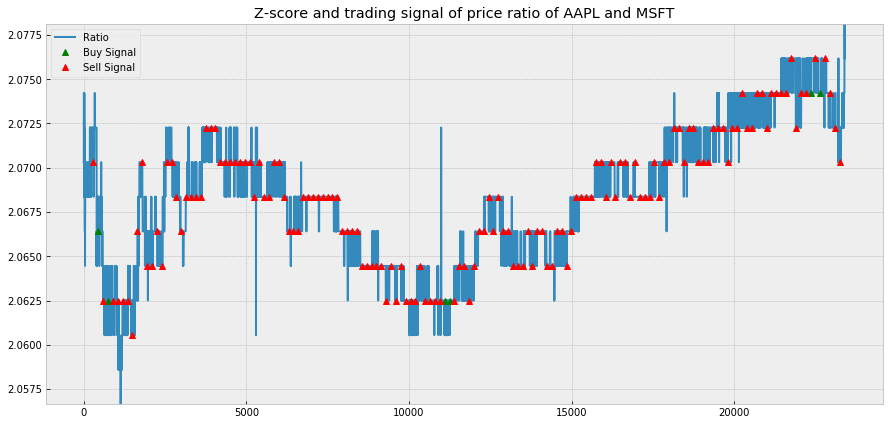

Trading signal of AAPL and MSFT for learning-based pair trading


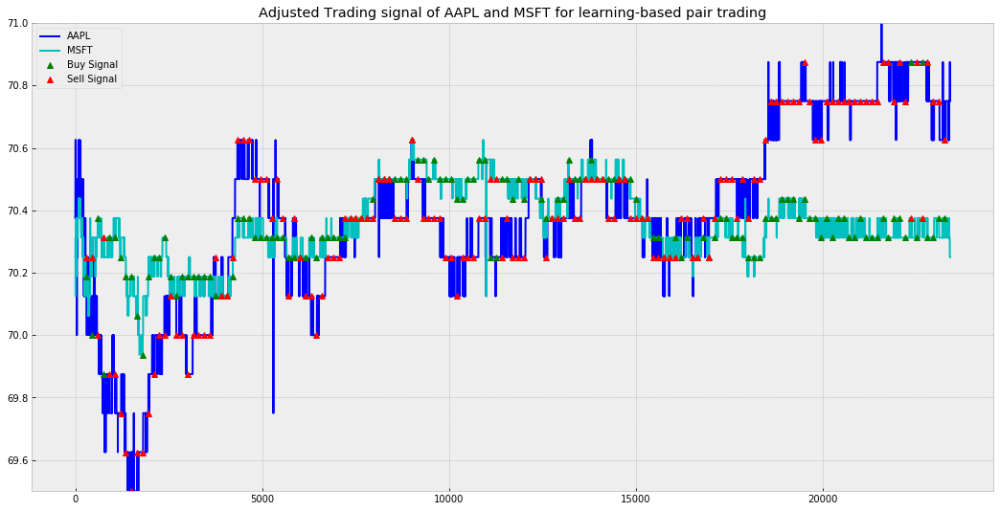

[Day 16]
v_test shape for day 16 : (154, 29, 299)
v_test shape for day 16 : (154, 29, 299)
v_test shape for day 16 : (154, 29, 299)
Predict Result....
Random pick time step :  [  5   7   8  12  13  16  20  21  24  26  31  42  49  50  54  56  57  60
  68  70  82  85  87  90  96  99 116 118 119 125 126 130 135 136 140 143
 144 147 149 151 155 156 157 158 168 169 175 177 180 187 188 199 211 221
 230 231 234 254 256 259 263 276 280 291]
Random pick time step :  [  3   4   6  10  13  18  22  23  27  29  34  35  46  50  54  61  62  67
  68  70  75  82  84  86  88  89  95 105 113 114 117 125 127 134 142 151
 152 157 161 162 163 168 171 177 179 190 191 195 196 197 200 202 206 211
 218 219 226 229 235 242 248 259 271 280]
Random pick time step :  [  3  20  22  27  28  29  31  39  50  64  65  67  69  75  76  82  84  85
  88  91  94 109 114 129 132 133 145 147 150 154 164 167 169 171 173 182
 185 186 187 200 202 203 205 208 210 215 233 235 236 239 241 242 251 256
 258 260 263 278 281 283 293 294 

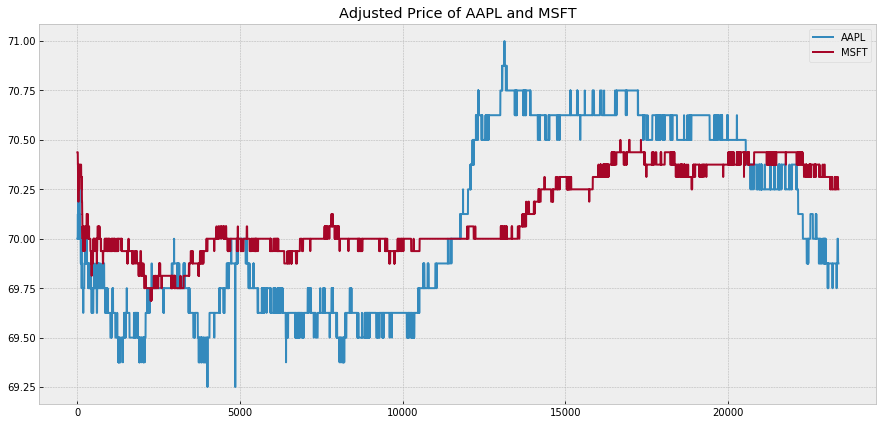

Plot z-score and trading signal of price ratio of AAPL and MSFT


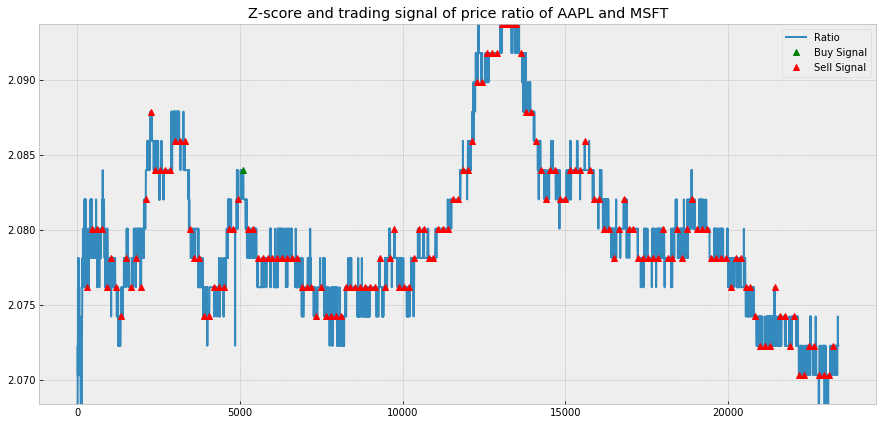

Trading signal of AAPL and MSFT for learning-based pair trading


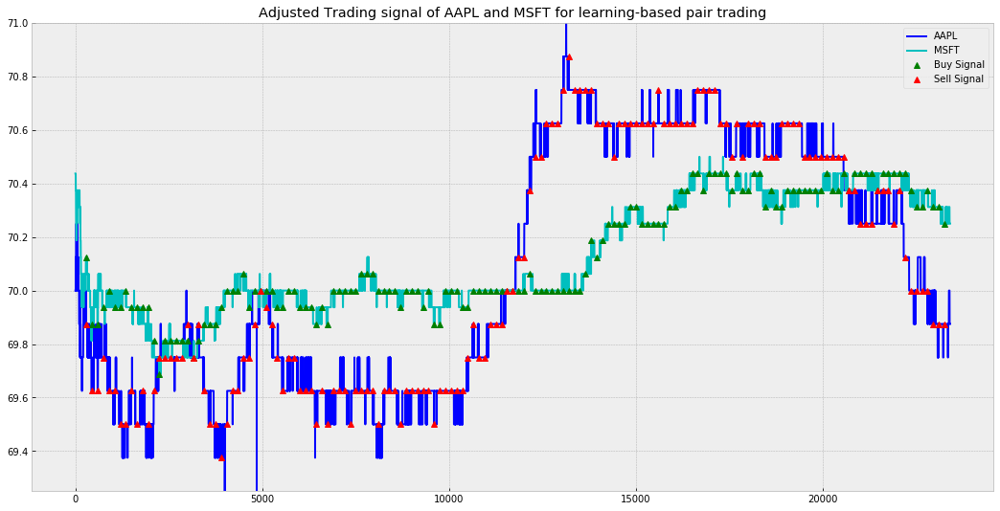

[Day 17]
v_test shape for day 17 : (154, 29, 299)
v_test shape for day 17 : (154, 29, 299)
v_test shape for day 17 : (154, 29, 299)
Predict Result....
Random pick time step :  [  6   7  17  32  42  47  61  65  68  70  71  81  98 102 105 109 110 113
 116 119 127 130 134 138 141 148 150 151 153 155 160 164 171 173 181 182
 183 189 197 199 205 207 209 214 215 218 219 221 228 233 234 237 246 250
 255 260 261 270 273 277 288 290 291 296]
Random pick time step :  [  9  10  11  12  19  20  30  34  36  42  50  54  55  58  62  68  70  72
  86  98 102 112 113 115 121 123 132 137 138 143 149 150 152 159 160 162
 164 169 174 175 179 183 186 188 195 197 200 207 208 209 210 212 217 219
 232 256 260 261 276 277 282 288 293 294]
Random pick time step :  [  1   3  14  20  24  25  28  47  49  56  61  65  71  72  76  77  80  81
  85  93  95  99 103 104 118 124 136 137 145 146 151 157 160 163 165 170
 172 180 185 193 197 201 204 210 216 217 218 221 222 223 232 239 241 246
 255 267 268 270 272 279 286 291 

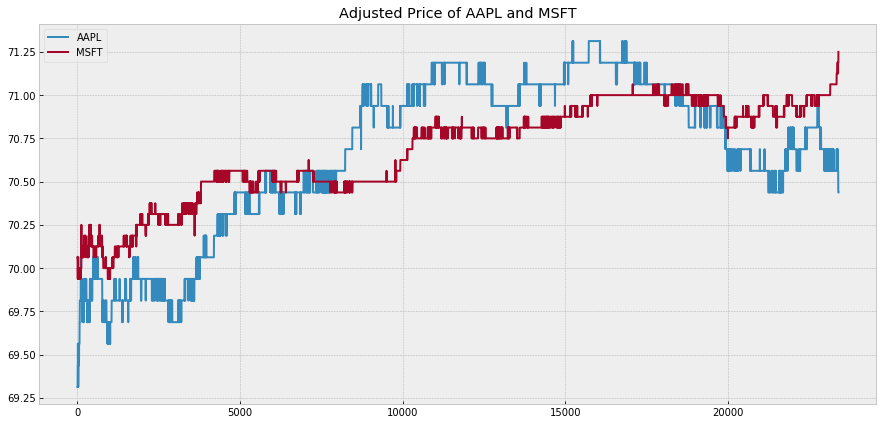

Plot z-score and trading signal of price ratio of AAPL and MSFT


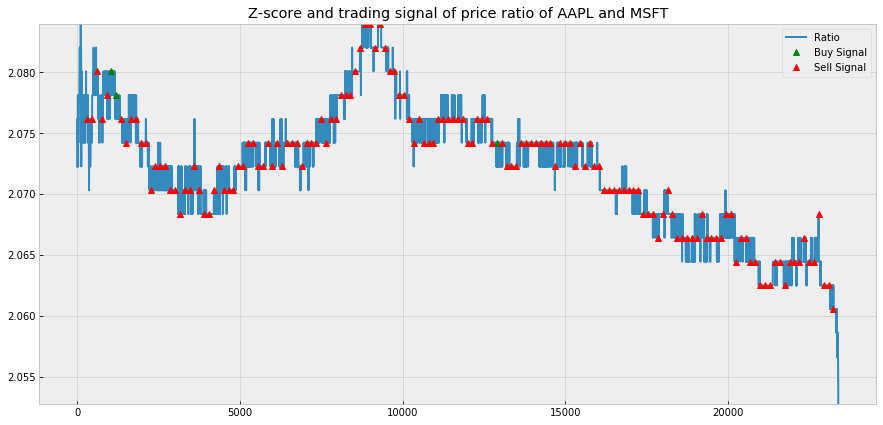

Trading signal of AAPL and MSFT for learning-based pair trading


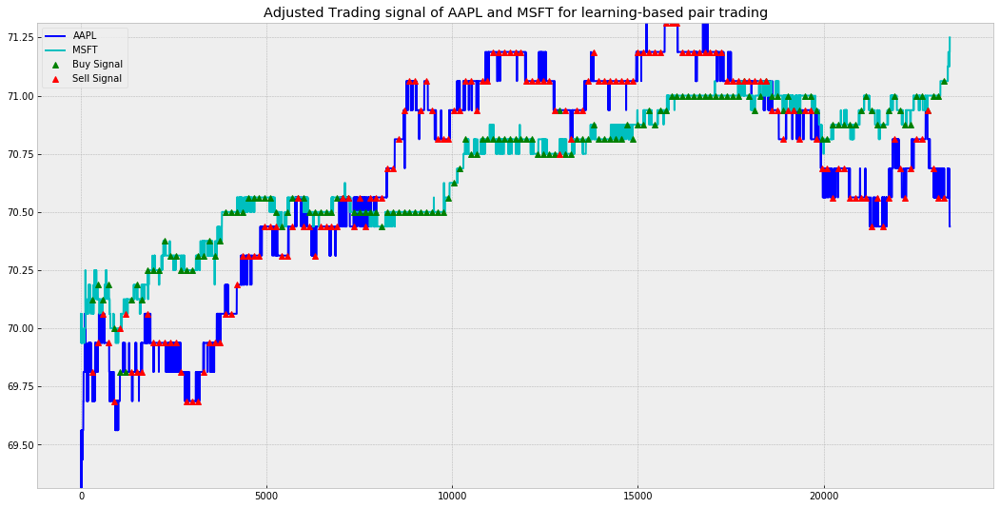

[Day 18]
v_test shape for day 18 : (154, 29, 299)
v_test shape for day 18 : (154, 29, 299)
v_test shape for day 18 : (154, 29, 299)
Predict Result....
Random pick time step :  [  5   9  11  15  18  19  25  28  29  31  37  38  39  43  44  46  47  52
  57  62  80  83  89  96  98  99 100 109 110 116 126 127 128 132 138 144
 146 147 149 152 154 170 184 188 193 223 228 234 236 240 243 251 253 255
 263 266 267 272 276 281 283 288 294 295]
Random pick time step :  [  1  10  14  18  20  28  30  34  35  39  47  55  59  62  64  65  73  76
  84  91 100 101 102 105 110 111 115 124 138 140 142 143 155 161 163 170
 174 175 178 187 194 198 206 209 211 218 221 225 228 229 233 235 237 242
 249 251 252 255 260 264 267 271 273 293]
Random pick time step :  [ 22  25  28  31  37  38  45  46  49  50  53  69  71  72  80  87  91  95
  97 103 104 108 111 112 113 114 122 123 133 142 143 145 155 168 169 170
 173 182 185 187 189 194 198 202 204 205 211 218 224 227 230 232 240 244
 245 248 253 254 258 261 267 272 

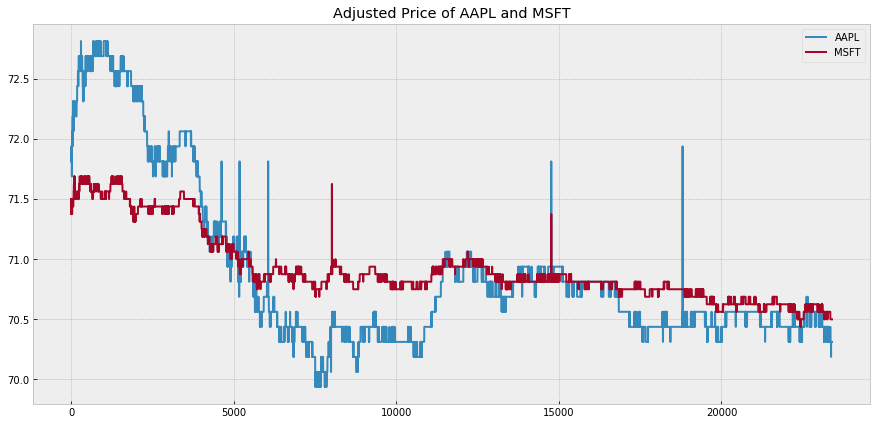

Plot z-score and trading signal of price ratio of AAPL and MSFT


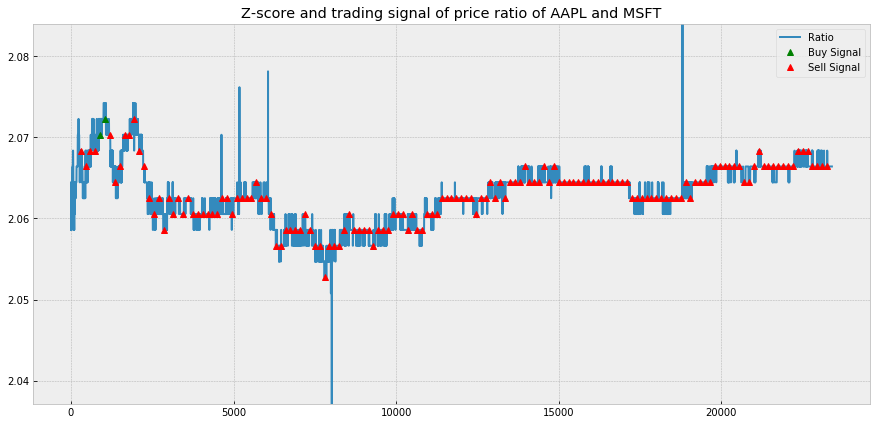

Trading signal of AAPL and MSFT for learning-based pair trading


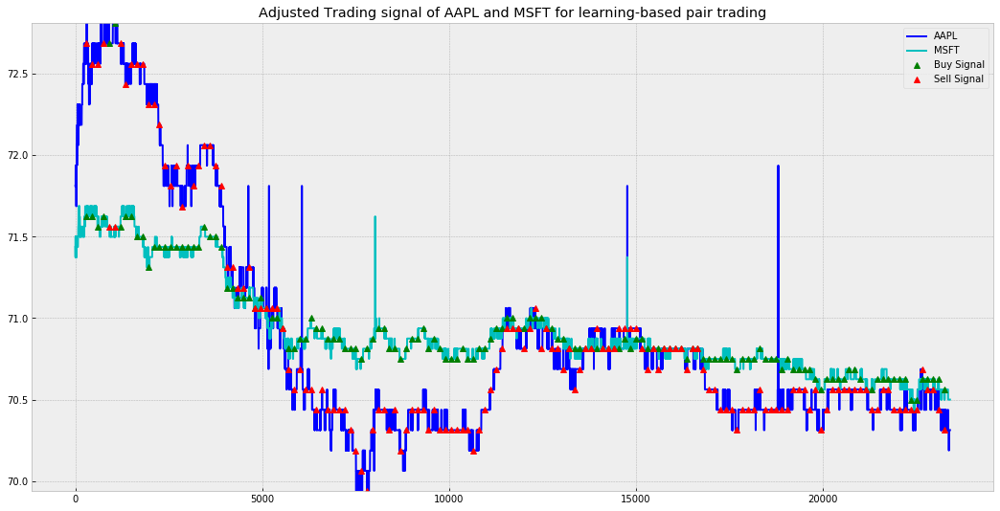

[Day 19]
v_test shape for day 19 : (154, 29, 299)
v_test shape for day 19 : (154, 29, 299)
v_test shape for day 19 : (154, 29, 299)
Predict Result....
Random pick time step :  [  0   7  21  25  45  47  64  66  71  73  83  87  91  98 105 109 111 116
 119 126 132 143 146 148 152 155 158 160 168 169 176 178 182 184 186 189
 191 197 204 211 213 216 217 220 224 227 228 231 241 246 250 251 255 267
 269 273 277 278 279 282 286 288 293 296]
Random pick time step :  [  1   5   9  10  12  18  26  41  47  50  53  54  60  61  64  68  73  82
  83  84  85  91  92  94 103 105 111 113 116 118 120 125 126 139 145 147
 157 159 160 167 168 169 173 191 192 204 211 215 219 221 222 226 232 240
 241 248 254 258 264 266 269 279 294 298]
Random pick time step :  [  3   4  13  18  23  24  35  38  43  47  48  49  54  62  63  64  67  70
  72  79  86  87  93  94  98  99 105 106 109 126 129 130 133 143 151 153
 155 161 162 167 176 177 182 184 188 192 193 212 213 215 216 232 233 238
 246 256 257 266 269 274 276 280 

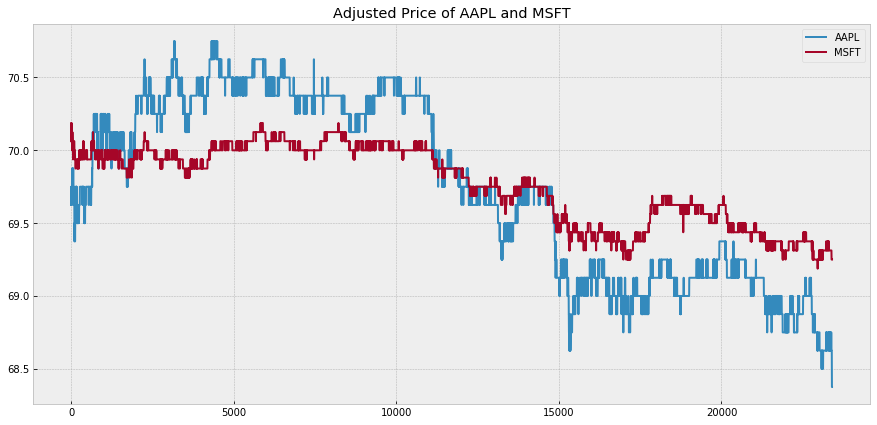

Plot z-score and trading signal of price ratio of AAPL and MSFT


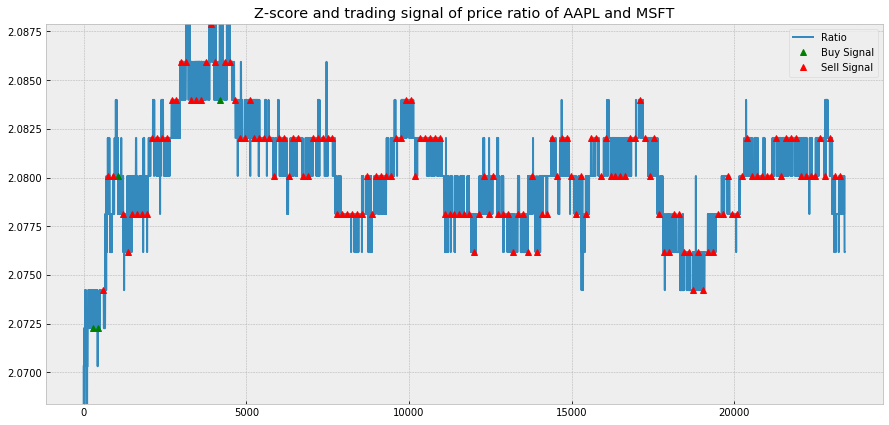

Trading signal of AAPL and MSFT for learning-based pair trading


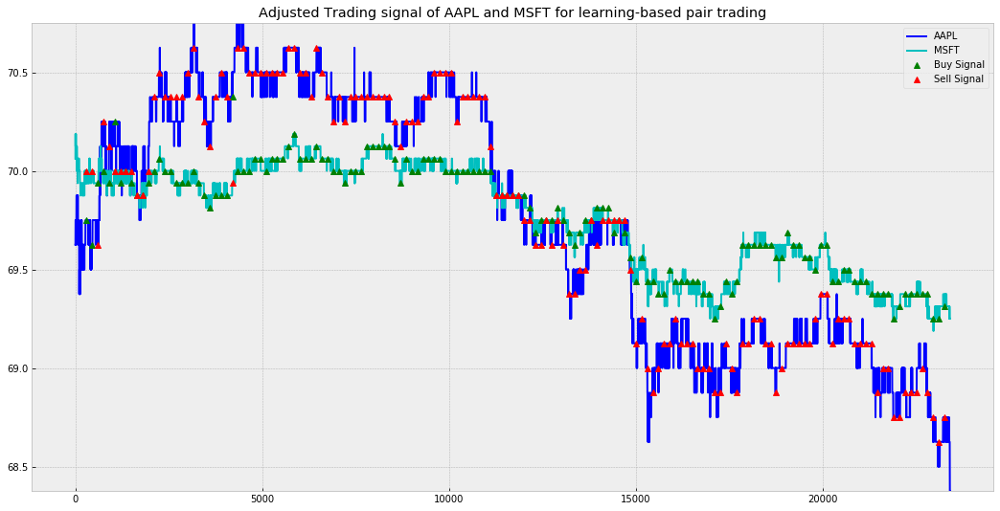

[Day 20]
v_test shape for day 20 : (154, 29, 299)
v_test shape for day 20 : (154, 29, 299)
v_test shape for day 20 : (154, 29, 299)
Predict Result....
Random pick time step :  [  8  16  20  23  26  32  39  43  46  51  56  57  64  67  71  74  86  87
  97  98  99 105 113 115 117 121 131 134 135 139 140 142 143 147 157 158
 160 175 177 178 195 198 206 207 210 216 218 219 221 224 231 232 245 246
 251 257 267 283 286 292 293 294 295 298]
Random pick time step :  [  5   7  11  16  21  24  26  30  34  38  41  42  43  48  49  59  69  71
  75  88 100 114 119 121 127 129 133 135 142 155 156 164 166 169 170 183
 185 186 188 190 201 203 209 224 226 231 235 236 238 244 248 253 256 265
 267 268 269 272 278 284 285 292 293 295]
Random pick time step :  [  3   4   7   8  19  21  24  31  35  40  43  51  59  61  65  70  72  74
  83  90  97 100 102 105 110 126 131 132 134 136 142 143 145 152 156 158
 159 162 165 168 172 173 186 189 190 192 204 212 213 215 217 226 228 249
 256 259 265 271 273 276 281 290 

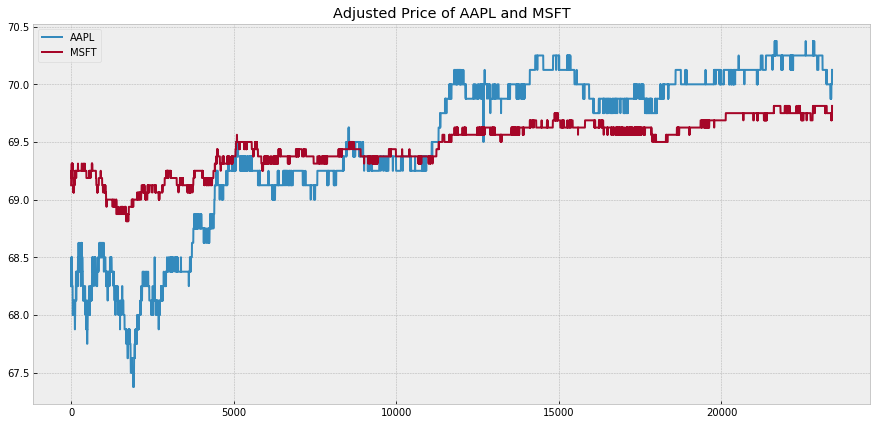

Plot z-score and trading signal of price ratio of AAPL and MSFT


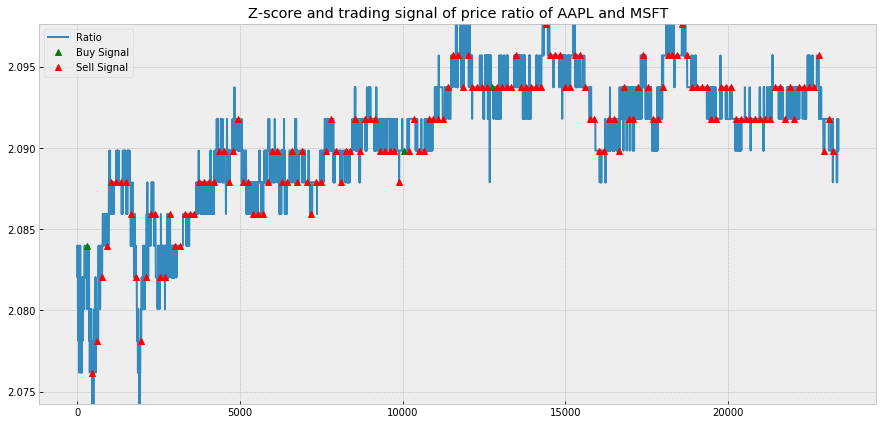

Trading signal of AAPL and MSFT for learning-based pair trading


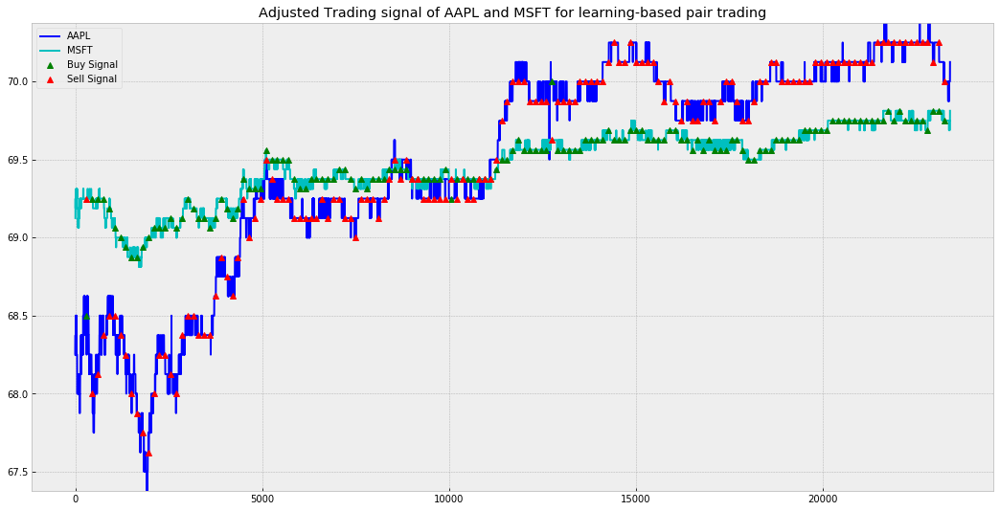

<Figure size 432x288 with 0 Axes>

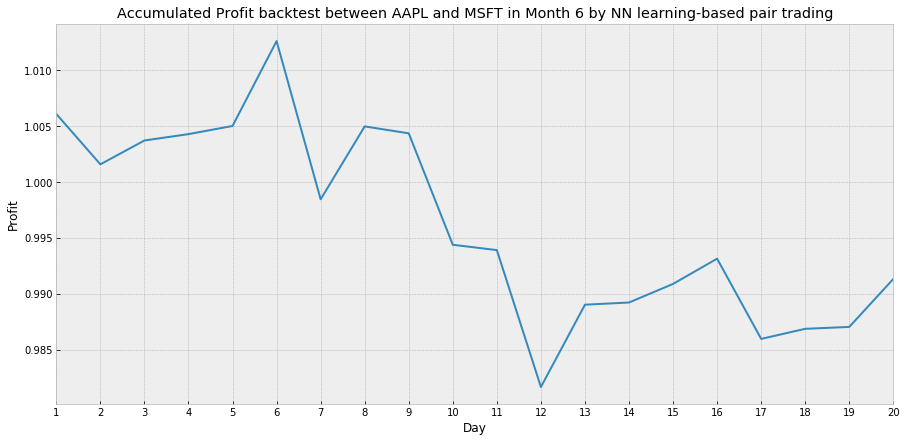

In [75]:
# 這邊是用NN prediction 來做策略
#p = ['AAPL', 'CSCO']
#p = ['MRK', 'MSFT']
profit_day_NN_b = []
signal = []
predict_result_b = {}
for i in range(20):
    print("[Day %s]" % str(i+1))
    S1 = pd.DataFrame({p[0]: price_and_return[p[0]][0][i,:]})
    S2 = pd.DataFrame({p[1]: price_and_return[p[1]][0][i,:]})
    result = NN_trade(S1, S2, p[0], p[1], price_data, price_and_return, net, i, show_print = 1, fee = 0, profit_Mode = profit_Mode)
    profit_day_NN_b.append(result[0])
    signal.append([result[1], result[2]])
    predict_result_b[i+1] = result[3]
    drawTradingCondition(p[0], p[1], price_and_return, i, window_l, window_s, trading_time, result[1], result[2], mode = 'NN')

# Plot profit
fig = plt.gcf()
plt.figure(figsize=(15,7))
if profit_Mode == 0:
    plt.plot(np.cumsum(profit_day_NN_b))
else:
    plt.plot(np.cumprod(profit_day_NN_b))
plt.xticks(range(20), np.arange(20)+1)
plt.title('Accumulated Profit backtest between %s and %s in Month %s by NN learning-based pair trading' % (p[0], p[1], period[0]))
plt.style.use("bmh")
plt.xlim(0,19)
plt.xlabel('Day')
plt.ylabel('Profit')
plt.show()

<Figure size 432x288 with 0 Axes>

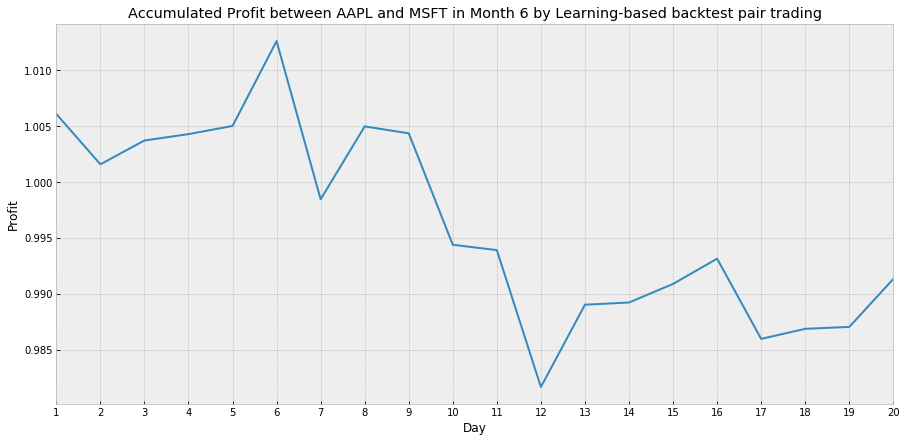

<Figure size 432x288 with 0 Axes>

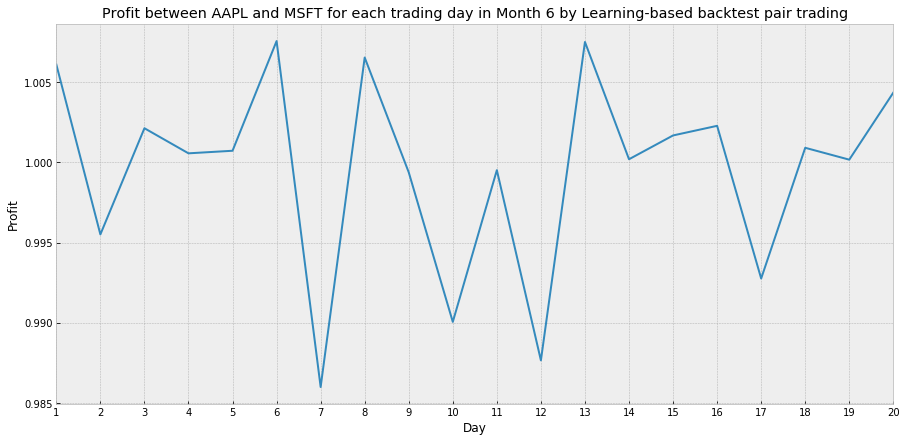

In [76]:
draw_profit(profit_day_NN_b, np.arange(20)+1, period, mode = 'Learning-based backtest', profit_Mode = profit_Mode)

In [77]:
qa_whole = np.load("qa_pair/QA_pair_company%d_%dto%d_shift_length%d_train.npy" % (company_num, period[0], period[-1], shift_length))
qa_whole_val = np.load("qa_pair/QA_pair_company%d_%dto%d_shift_length%d_val.npy" % (company_num, period[0], period[-1], shift_length))
qa_whole_test = np.load("qa_pair/QA_pair_company%d_%dto%d_shift_length%d_test.npy" % (company_num, period[0], period[-1], shift_length))
# load
print("[Train QA pair load completed!]")
print("[Validation QA pair load completed!]")
print("[Testing QA pair load completed!]")

[Train QA pair load completed!]
[Validation QA pair load completed!]
[Testing QA pair load completed!]


In [78]:
qa_whole_test.shape

(7502880, 71)

In [79]:
v_test.shape

(3080, 29, 299)

# 挑出每個問題的正確答案 and 算預測的準確度

In [80]:
qa_test_for_pairtrading = []
for i in range(154):
    qa_test_for_pairtrading.append(qa_whole_test[i*len(all_com_pair_P)*len(qtype):(i+1)*len(all_com_pair_P)*len(qtype),:])
qa_test_for_pairtrading = np.vstack(qa_test_for_pairtrading)
xxx = qa_test_for_pairtrading[:,:-10]
q1_idx = np.where(np.all(xxx  == np.repeat(np.expand_dims(vq1_pairtrad[1][0],0), xxx.shape[0], axis = 0), axis = 1).astype(int) == 1)[0]
q2_idx = np.where(np.all(xxx  == np.repeat(np.expand_dims(vq2_pairtrad[1][0],0), xxx.shape[0], axis = 0), axis = 1).astype(int) == 1)[0]
q3_idx = np.where(np.all(xxx  == np.repeat(np.expand_dims(vq3_pairtrad[1][0],0), xxx.shape[0], axis = 0), axis = 1).astype(int) == 1)[0]

In [81]:
qa1_true = qa_test_for_pairtrading[q1_idx]
qa2_true = qa_test_for_pairtrading[q2_idx]
qa3_true = qa_test_for_pairtrading[q3_idx]

In [82]:
a1_true = qa1_true[:,-10:-6]
a2_true = qa2_true[:,-6:-3]
a3_true = qa3_true[:,-3:]

In [83]:
np.argmax(a1_true, 1)

array([0, 3, 3, 2, 3, 0, 1, 2, 0, 0, 1, 2, 1, 0, 0, 1, 1, 3, 3, 2, 0, 0,
       0, 2, 0, 2, 1, 2, 0, 1, 1, 0, 0, 0, 0, 1, 0, 3, 2, 2, 2, 0, 0, 2,
       1, 2, 2, 1, 1, 0, 3, 2, 2, 2, 1, 1, 0, 0, 0, 1, 1, 0, 0, 2, 2, 0,
       0, 0, 0, 0, 2, 3, 0, 0, 0, 1, 1, 0, 0, 2, 1, 0, 0, 0, 0, 2, 1, 0,
       2, 0, 0, 1, 3, 0, 0, 1, 0, 0, 0, 0, 2, 0, 0, 0, 1, 0, 0, 0, 2, 0,
       1, 2, 1, 0, 0, 0, 1, 0, 0, 0, 0, 2, 0, 0, 0, 2, 0, 0, 3, 0, 2, 1,
       0, 1, 0, 0, 1, 0, 0, 0, 0, 0, 1, 3, 0, 0, 1, 3, 0, 0, 0, 0, 0, 0])

In [84]:
predict_result[1][0].astype(int)

array([3, 2, 2, 2, 3, 2, 2, 1, 2, 1, 2, 2, 2, 1, 1, 2, 2, 2, 2, 2, 2, 2,
       2, 2, 2, 3, 2, 2, 1, 2, 2, 1, 1, 2, 2, 2, 2, 2, 2, 2, 1, 1, 2, 1,
       2, 1, 1, 1, 3, 1, 2, 2, 2, 2, 3, 1, 1, 1, 1, 2, 2, 2, 3, 2, 2, 2,
       2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2,
       2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2,
       2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2,
       2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2])

In [85]:
np.argmax(a2_true, 1)

array([2, 1, 2, 1, 2, 2, 1, 2, 1, 0, 2, 1, 1, 1, 2, 2, 1, 1, 1, 2, 1, 0,
       2, 1, 2, 1, 1, 1, 1, 1, 2, 2, 2, 1, 0, 1, 2, 2, 1, 1, 1, 1, 2, 2,
       1, 2, 2, 1, 2, 0, 2, 1, 1, 2, 1, 1, 2, 1, 1, 1, 2, 1, 0, 1, 1, 0,
       1, 0, 0, 0, 1, 2, 1, 0, 2, 2, 1, 2, 2, 2, 2, 2, 1, 0, 0, 2, 2, 1,
       2, 1, 2, 2, 1, 1, 1, 2, 0, 2, 2, 2, 1, 2, 2, 0, 2, 0, 1, 2, 1, 2,
       1, 1, 2, 0, 0, 0, 2, 1, 0, 2, 2, 1, 1, 1, 0, 2, 0, 2, 1, 2, 1, 1,
       0, 2, 2, 1, 2, 0, 0, 1, 2, 0, 1, 2, 1, 2, 2, 1, 2, 1, 0, 0, 0, 2])

In [86]:
predict_result[1][1]

array([1, 1, 2, 2, 1, 1, 2, 1, 2, 2, 2, 2, 2, 2, 1, 2, 2, 1, 2, 1, 2, 2,
       2, 1, 2, 1, 1, 2, 1, 2, 1, 2, 2, 2, 2, 2, 2, 2, 2, 1, 2, 1, 2, 2,
       1, 2, 2, 2, 1, 1, 2, 2, 2, 2, 2, 2, 1, 2, 1, 2, 2, 2, 1, 2, 2, 2,
       2, 2, 2, 2, 2, 2, 1, 1, 2, 2, 2, 1, 2, 2, 2, 2, 2, 2, 2, 1, 2, 1,
       2, 2, 2, 1, 2, 2, 1, 2, 1, 2, 2, 2, 2, 1, 2, 1, 1, 2, 1, 2, 2, 2,
       2, 1, 2, 1, 2, 2, 2, 2, 2, 2, 2, 2, 1, 2, 2, 1, 2, 2, 2, 1, 1, 2,
       2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 1, 1, 2, 2, 1, 2, 2, 1, 2, 2])

In [87]:
np.argmax(a3_true, 1)

array([1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,
       1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,
       1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,
       1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,
       1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,
       1, 1, 2, 1, 1, 2, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 2, 1, 1, 1, 1, 1,
       1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 2, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1])

In [88]:
predict_result[1][2]

array([2, 1, 1, 1, 1, 1, 1, 1, 2, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,
       1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 2, 1, 1, 1, 2,
       1, 1, 1, 1, 1, 2, 1, 1, 2, 1, 1, 1, 1, 1, 2, 1, 1, 1, 1, 1, 1, 2,
       1, 1, 2, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,
       1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,
       1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,
       1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1])

In [89]:
np.sum((np.argmax(a1_true, 1) == predict_result[1][0]).astype(int)) / a1_true.shape[0]

0.16233766233766234

In [90]:
np.sum((np.argmax(a2_true, 1) == predict_result[1][1]).astype(int)) / a2_true.shape[0]

0.4090909090909091

In [91]:
np.sum((np.argmax(a3_true, 1) == predict_result[1][2]).astype(int)) / a3_true.shape[0]

0.9155844155844156

# Test 一整個月每天三個問題的真實命中率

In [92]:
def cal_predict_true_acc(all_com_pair_P, qtype, day):
    
    real_acc = {}
    for d in range(day):
        print("Day %s" % str(d+1))
        day_start = d * int(v_test.shape[0] / day) * len(all_com_pair_P) * len(qtype)
        print("Index of day start : ", day_start)
        qa_test_for_pairtrading = []
        for i in range(int(v_test.shape[0] / day)):
            qa_test_for_pairtrading.append(qa_whole_test[day_start + i*len(all_com_pair_P)*len(qtype):day_start + (i+1)*len(all_com_pair_P)*len(qtype),:])
        qa_test_for_pairtrading = np.vstack(qa_test_for_pairtrading)
        xxx = qa_test_for_pairtrading[:,:-10]
        q1_idx = np.where(np.all(xxx  == np.repeat(np.expand_dims(vq1_pairtrad[1][0],0), xxx.shape[0], axis = 0), axis = 1).astype(int) == 1)[0]
        q2_idx = np.where(np.all(xxx  == np.repeat(np.expand_dims(vq2_pairtrad[1][0],0), xxx.shape[0], axis = 0), axis = 1).astype(int) == 1)[0]
        q3_idx = np.where(np.all(xxx  == np.repeat(np.expand_dims(vq3_pairtrad[1][0],0), xxx.shape[0], axis = 0), axis = 1).astype(int) == 1)[0]
        
        # 真實的label
        a1_true = qa_test_for_pairtrading[q1_idx][:,-10:-6]
        a2_true = qa_test_for_pairtrading[q2_idx][:,-6:-3]
        a3_true = qa_test_for_pairtrading[q3_idx][:,-3:]
        
        # 真實命中率
        q1_acc = np.sum((np.argmax(a1_true, 1) == predict_result[d+1][0]).astype(int)) / a1_true.shape[0]
        q2_acc = np.sum((np.argmax(a2_true, 1) == predict_result[d+1][1]).astype(int)) / a2_true.shape[0]
        q3_acc = np.sum((np.argmax(a3_true, 1) == predict_result[d+1][2]).astype(int)) / a3_true.shape[0]
        
        print("Q1 real accuracy : ", q1_acc)
        print("Q2 real accuracy : ", q2_acc)
        print("Q3 real accuracy : ", q3_acc)
        
        real_acc[d+1] = [q1_acc, q2_acc, q3_acc]
        
    return real_acc

In [93]:
test_realacc = cal_predict_true_acc(all_com_pair_P, qtype, day_test)

Day 1
Index of day start :  0
Q1 real accuracy :  0.16233766233766234
Q2 real accuracy :  0.4090909090909091
Q3 real accuracy :  0.9155844155844156
Day 2
Index of day start :  375144
Q1 real accuracy :  0.18831168831168832
Q2 real accuracy :  0.4090909090909091
Q3 real accuracy :  0.9285714285714286
Day 3
Index of day start :  750288
Q1 real accuracy :  0.14935064935064934
Q2 real accuracy :  0.38311688311688313
Q3 real accuracy :  0.8181818181818182
Day 4
Index of day start :  1125432
Q1 real accuracy :  0.12987012987012986
Q2 real accuracy :  0.42207792207792205
Q3 real accuracy :  0.7142857142857143
Day 5
Index of day start :  1500576
Q1 real accuracy :  0.14285714285714285
Q2 real accuracy :  0.33766233766233766
Q3 real accuracy :  0.9025974025974026
Day 6
Index of day start :  1875720
Q1 real accuracy :  0.15584415584415584
Q2 real accuracy :  0.44155844155844154
Q3 real accuracy :  0.8896103896103896
Day 7
Index of day start :  2250864
Q1 real accuracy :  0.07792207792207792
Q2 r

# Pair Trading累積收益圖

<Figure size 432x288 with 0 Axes>

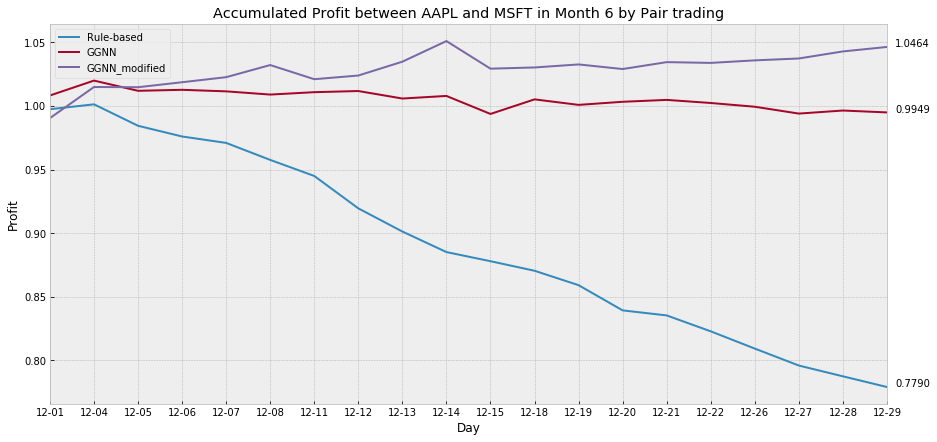

In [94]:
fig = plt.gcf()
plt.figure(figsize=(15,7))
plt.plot(np.cumprod(profit_day), label = 'Rule-based')
plt.plot(np.cumprod(profit_day_NN), label = 'GGNN')
plt.plot(np.cumprod(profit_day_NN_v2), label = 'GGNN_modified')
plt.xticks(range(day_test), date_test_noyear)
for var in (np.cumprod(profit_day), np.cumprod(profit_day_NN), np.cumprod(profit_day_NN_v2)):
    plt.annotate('%.4f' % var[-1], xy=(1, var[-1]), xytext=(8, 0), 
                 xycoords=('axes fraction', 'data'), textcoords='offset points')
plt.title('Accumulated Profit between %s and %s in Month %s by Pair trading' % (p[0], p[1], period[0]))
plt.style.use("bmh")
plt.xlim(0,profit_day.shape[0]-1)
plt.legend()
plt.xlabel('Day')
plt.ylabel('Profit')
plt.show()

# Pair Trading各交易日收益圖

<Figure size 432x288 with 0 Axes>

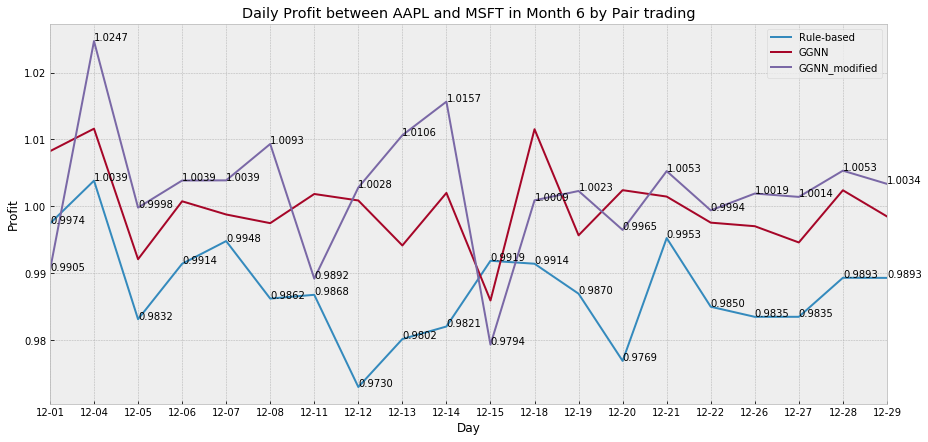

In [95]:
fig = plt.gcf()
plt.figure(figsize=(15,7))
plt.plot(profit_day, label = 'Rule-based')
plt.plot(profit_day_NN, label = 'GGNN')
plt.plot(profit_day_NN_v2, label = 'GGNN_modified')
plt.xticks(range(day_test), date_test_noyear)
plt.title('Daily Profit between %s and %s in Month %s by Pair trading' % (p[0], p[1], period[0]))
plt.style.use("bmh")
profit_list = ['profit_day','profit_day_NN','profit_day_NN_v2']
for k in range(len(profit_list)):
    for i,j in zip(np.arange(day_test) , eval(profit_list[k])):
        if profit_list[k] == 'profit_day_NN_v2' or profit_list[k] == 'profit_day':
            plt.annotate(str('%.4f'% j), xy=(i,j))
plt.xlim(0,profit_day.shape[0]-1)
plt.legend()
plt.xlabel('Day')
plt.ylabel('Profit')
plt.show()

In [96]:
profit_list = ['profit_day','profit_day_NN','profit_day_NN_v2']
for i in range(len(profit_list)):
    print(np.where(np.array(eval(profit_list[i])) > 1)[0])

[1]
[ 0  1  3  6  7  9 11 13 14 18]
[ 1  3  4  5  7  8  9 11 12 14 16 17 18 19]


# List all parameter in net

In [97]:
for name, param in net.named_parameters():
    if param.requires_grad:
        print(name, param.data, param.shape)

in_0.weight_ih_l0 tensor([[-0.0124,  0.0010, -0.0363,  ..., -0.0152,  0.0767,  0.0718],
        [-0.1076,  0.1102,  0.1620,  ...,  0.1437,  0.0993,  0.0762],
        [-0.1687, -0.1097,  0.0937,  ..., -0.1287,  0.0038, -0.1254],
        ...,
        [-0.1352, -0.1765, -0.0117,  ...,  0.1837, -0.1300,  0.0448],
        [ 0.1711, -0.0299, -0.0111,  ..., -0.1360, -0.0920,  0.1640],
        [ 0.1182,  0.1338, -0.0986,  ..., -0.1596,  0.1815, -0.0334]],
       device='cuda:0') torch.Size([87, 29])
in_0.weight_hh_l0 tensor([[ 0.0025,  0.1327,  0.1709,  ...,  0.0615,  0.0635,  0.0746],
        [ 0.0090, -0.1216,  0.0846,  ..., -0.1131, -0.0161, -0.1204],
        [ 0.1484,  0.1768, -0.0184,  ...,  0.1069, -0.0892, -0.0088],
        ...,
        [ 0.1788,  0.1837, -0.1537,  ...,  0.0223, -0.1459, -0.0346],
        [ 0.0874, -0.0338,  0.1038,  ..., -0.0134,  0.1028,  0.0114],
        [-0.1354, -0.1152,  0.0772,  ..., -0.0872, -0.0759, -0.0887]],
       device='cuda:0') torch.Size([87, 29])
in_0.b

gru.bias_ih_l0 tensor([-0.0183, -0.0368,  0.0971, -0.0751,  0.0535, -0.0897,  0.0150,  0.0606,
        -0.1174, -0.1070, -0.0907, -0.0748, -0.0544, -0.0656,  0.0686, -0.0736,
        -0.0090,  0.0329,  0.1239, -0.0761, -0.1207, -0.1205,  0.0212,  0.0197,
         0.1178, -0.0130, -0.0748,  0.0896, -0.0231, -0.0347,  0.0037,  0.0354,
         0.0130,  0.0164,  0.0154,  0.0067,  0.0426,  0.0544, -0.1129,  0.0319,
         0.0059,  0.1192,  0.0518, -0.0452, -0.0024,  0.0401, -0.0637, -0.0048,
        -0.0602, -0.0986,  0.1036, -0.0206,  0.1100, -0.0612,  0.0062,  0.0571,
         0.1135, -0.0088,  0.0345, -0.0935, -0.1113, -0.1188,  0.0507,  0.0912,
         0.0612,  0.0219,  0.0309,  0.0506, -0.0040,  0.0099, -0.0081, -0.0674,
         0.0366,  0.0437, -0.1039,  0.0516, -0.0038, -0.0515,  0.0133, -0.0273,
         0.1226, -0.0199,  0.1110, -0.1227, -0.0702,  0.0491, -0.0828,  0.0644,
         0.1144,  0.0525, -0.1062,  0.0024,  0.0499, -0.1197,  0.0885,  0.0877,
        -0.0449,  0.0891,

# Save all predicted result

In [98]:
'''
Save NN predict result
'''
import pickle

time = str(datetime.datetime.now()).split(' ')[0]
fname = 'predictresult/history_%s_period%dto%d_shiftlength%d.pickle' % (time, period[0], period[-1], shift_length)

with open(fname, 'wb') as handle:
    pickle.dump(history, handle, protocol=pickle.HIGHEST_PROTOCOL)
print('Save "%s" successful !' % fname)

np.save("predictresult/profit_Rule-basedPairTrading_%s_%dto%d_shiftlength%d.npy" % (time, period[0], period[-1], shift_length), profit_day)
np.save("predictresult/profit_NN-basedPairTrading_%s_%dto%d_shiftlength%d.npy" % (time, period[0], period[-1], shift_length), profit_day_NN)
np.save("predictresult/profit_NN-basedPairTrading_backtest_%s_%dto%d_shiftlength%d.npy" % (time, period[0], period[-1], shift_length), profit_day_NN_b)
# save
print("[profit_Rule-basedPairTrading save completed ! ]")
print("[profit_NN-basedPairTrading save completed ! ]")
print("[profit_NN-basedPairTrading_backtest save completed ! ]")

load_data = 0
# load back
if load_data == 1:
    with open(fname, 'rb') as handle:
        history_b = pickle.load(handle)
    print('Open "%s" successful !' % fname)

Save "predictresult/history_2019-08-20_period6to11_shiftlength150.pickle" successful !
[profit_Rule-basedPairTrading save completed ! ]
[profit_NN-basedPairTrading save completed ! ]
[profit_NN-basedPairTrading_backtest save completed ! ]


# Classification Report and Confusion matrix
* 計算Precision, recall, F1等 classification report : https://www.cnblogs.com/178mz/p/8558435.html
* confusion matrix : https://scikit-learn.org/stable/modules/generated/sklearn.metrics.confusion_matrix.html

In [99]:
from sklearn.metrics import classification_report

def classification_report_andf1test(all_com_pair_P, qtype, day, predict_result):
    q1_true, q2_true, q3_true = [], [], []
    q1_pred, q2_pred, q3_pred = [], [], []
    
    for d in range(day):
        print("Day %s" % str(d+1) + " processing...")
        day_start = d * int(v_test.shape[0] / day) * len(all_com_pair_P) * len(qtype)
        #print("Index of day start : ", day_start)
        qa_test_for_pairtrading = []
        for i in range(int(v_test.shape[0] / day)):
            qa_test_for_pairtrading.append(qa_whole_test[day_start + i*len(all_com_pair_P)*len(qtype):day_start + (i+1)*len(all_com_pair_P)*len(qtype),:])
        qa_test_for_pairtrading = np.vstack(qa_test_for_pairtrading)
        xxx = qa_test_for_pairtrading[:,:-10]
        q1_idx = np.where(np.all(xxx  == np.repeat(np.expand_dims(vq1_pairtrad[1][0],0), xxx.shape[0], axis = 0), axis = 1).astype(int) == 1)[0]
        q2_idx = np.where(np.all(xxx  == np.repeat(np.expand_dims(vq2_pairtrad[1][0],0), xxx.shape[0], axis = 0), axis = 1).astype(int) == 1)[0]
        q3_idx = np.where(np.all(xxx  == np.repeat(np.expand_dims(vq3_pairtrad[1][0],0), xxx.shape[0], axis = 0), axis = 1).astype(int) == 1)[0]
        
        # 真實的label
        a1_true = qa_test_for_pairtrading[q1_idx][:,-10:-6]
        a2_true = qa_test_for_pairtrading[q2_idx][:,-6:-3]
        a3_true = qa_test_for_pairtrading[q3_idx][:,-3:]
        
        # 真實命中率
        q1_acc = np.sum((np.argmax(a1_true, 1) == predict_result[d+1][0]).astype(int)) / a1_true.shape[0]
        q2_acc = np.sum((np.argmax(a2_true, 1) == predict_result[d+1][1]).astype(int)) / a2_true.shape[0]
        q3_acc = np.sum((np.argmax(a3_true, 1) == predict_result[d+1][2]).astype(int)) / a3_true.shape[0]
        
        q1_true.append(np.argmax(a1_true, 1))
        q2_true.append(np.argmax(a2_true, 1))
        q3_true.append(np.argmax(a3_true, 1))
        q1_pred.append(predict_result[d+1][0])
        q2_pred.append(predict_result[d+1][1])
        q3_pred.append(predict_result[d+1][2])
    
    q1_true = np.stack(q1_true).flatten()
    q2_true = np.stack(q2_true).flatten()
    q3_true = np.stack(q3_true).flatten()
    q1_pred = np.stack(q1_pred).flatten()
    q2_pred = np.stack(q2_pred).flatten()
    q3_pred = np.stack(q3_pred).flatten()
    print("Total prediction amount :", q1_true.shape)
    print(len(np.where(q1_true == 0)[0]))
        
    print("-----------The classification report-----------")
    target_names = ['NoChange','BothRise','BothFall','Reverse','Same','Strong','Weak','Same','Big','Small']
    print("[Q1]")
    print(classification_report(q1_true, q1_pred, target_names=target_names[:4]))
    print("[Q2]")
    print(classification_report(q2_true, q2_pred, target_names=target_names[4:7]))
    print("[Q3]")
    target_names_q3 = list(np.array(target_names)[np.add(np.unique(np.argmax(a3_true, 1)),7)])
    print(target_names_q3)
    print(classification_report(q3_true, q3_pred, target_names=target_names_q3, labels = np.unique(np.argmax(a3_true, 1))))

In [100]:
qa_whole_test = np.load("qa_pair/QA_pair_company%d_%dto%d_shift_length%d_test.npy" % (company_num, period[0], period[-1], shift_length))
# load
print("[Testing QA pair load completed!]")
print("TwoPhaseGraphGRU")
classification_report_andf1test(all_com_pair_P, qtype, day_test, predict_result)

[Testing QA pair load completed!]
TwoPhaseGraphGRU
Day 1 processing...
Day 2 processing...
Day 3 processing...
Day 4 processing...
Day 5 processing...
Day 6 processing...
Day 7 processing...
Day 8 processing...
Day 9 processing...
Day 10 processing...
Day 11 processing...
Day 12 processing...
Day 13 processing...
Day 14 processing...
Day 15 processing...
Day 16 processing...
Day 17 processing...
Day 18 processing...
Day 19 processing...
Day 20 processing...
Total prediction amount : (3080,)
2231
-----------The classification report-----------
[Q1]
              precision    recall  f1-score   support

    NoChange       0.50      0.00      0.00      2231
    BothRise       0.12      0.05      0.07       311
    BothFall       0.10      0.90      0.18       326
     Reverse       0.17      0.02      0.03       212

    accuracy                           0.10      3080
   macro avg       0.22      0.24      0.07      3080
weighted avg       0.40      0.10      0.03      3080

[Q2]
      